# Classification

In [1]:
# libraries

import pandas as pd
import numpy as np
import bz2
pd.set_option('display.max_columns', None)
import statistics
import matplotlib.pyplot as plt
import seaborn as sns
import math
import pingouin as pg
import statsmodels.api as sm
import matplotlib as mpl
from scipy import stats
from distfit import distfit
import scikit_posthocs as sp
import datetime as dt

pd.options.display.float_format = '{:.2f}'.format

import warnings
warnings.filterwarnings('ignore')

plt.rcParams["image.cmap"] = "Pastel2"

# import gower
import plotly.graph_objects as go
from sklearn_extra.cluster import KMedoids
from sklearn.neighbors import NearestNeighbors
from random import sample
from numpy.random import uniform
import numpy as np
from math import isnan
from sklearn.metrics import silhouette_score

from sklearn.metrics import davies_bouldin_score

from sklearn import metrics

from sklearn.metrics import calinski_harabasz_score

from scipy.cluster.hierarchy import linkage
from scipy.cluster.hierarchy import dendrogram
from scipy.cluster.hierarchy import cut_tree

from sklearn.cluster import AgglomerativeClustering
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans,DBSCAN,MiniBatchKMeans
from matplotlib.colors import ListedColormap

from sklearn.cluster import DBSCAN

from scipy.spatial.distance import euclidean

from yellowbrick.classifier import ClassPredictionError

/home/evida-monika/anaconda3/envs/mhunters/lib/python3.10/site-packages/outdated/utils.py:14: OutdatedPackageWarning: The package pingouin is out of date. Your version is 0.5.2, the latest is 0.5.3.
Set the environment variable OUTDATED_IGNORE=1 to disable these warnings.
  return warn(


In [2]:
# planting seed

import random

random.seed(10)

In [3]:
# frequency table definition

def my_freq_table(data, var, sort = True, cumul_percent = False):
    myFreqTable = data[var].value_counts()
    myFreqTable = pd.DataFrame({var: myFreqTable.keys(), 'Frequency': myFreqTable.values})
    myFreqTable = myFreqTable.astype({'Frequency': 'int32'})
    
    if sort == True:
        myFreqTable = myFreqTable.sort_values(by=[var])
        myFreqTable = myFreqTable.reset_index(drop=True)
    
    myFreqTable['Percent'] = myFreqTable['Frequency']/myFreqTable['Frequency'].sum()*100
    
    sum_row1 = myFreqTable['Frequency'].sum()
    sum_row2 = myFreqTable['Percent'].sum()
    sum_row2 = sum_row2.round(2).astype('str') + '%'
    
    myFreqTable['Percent'] = myFreqTable['Percent'].round(2).astype('str') + '%'
    
    if cumul_percent == True:
        myFreqTable['Cumulative Percent'] = myFreqTable['Frequency'].cumsum() / myFreqTable['Frequency'].sum() * 100
        myFreqTable['Cumulative Percent'] = myFreqTable['Cumulative Percent'].round(2).astype('str') + '%'
        sum_row_c = '-'
    
    '''
    if valid_percent == True:
    
        myMissingCategory = [np.NaN]

        myFreqTable2 = myFreqTable
        isNonmisAr = np.array([])

        for i in data[var]:
            isNotMissing=1
            for j in myMissingCategory:
                if i==j:
                    isNotMissing=0
            isNonmisAr = np.append(isNonmisAr, [isNotMissing])
        
        validSum = sum(myFreqTable2['Frequency']*isNonmisAr)
        validPerc = myFreqTable2['Frequency']/validSum*isNonmisAr*100
        
        for i in range(len(validPerc)):
            if isNonmisAr[i]==0:
                validPerc[i]=np.nan
        
        myFreqTable2['Valid Percent'] = validPerc
        
        if cumul_percent == True:
            myFreqTable2['Cumulative Valid Percent'] = myFreqTable2['Valid Percent'].cumsum()
            
            sum_c_2 = '-'
            
            myFreqTable2['Cumulative Valid Percent'] = myFreqTable2['Cumulative Valid Percent'].round(2).astype('str') + '%'
        
        sum_valid_percent = myFreqTable2['Valid Percent'].sum()
        
        myFreqTable2['Valid Percent'] = myFreqTable2['Valid Percent'].round(2).astype('str') + '%'
        
        sum_valid_percent = sum_valid_percent.round(2).astype('str') + '%'
        
        #myFreqTable2 = myFreqTable2.set_index(var)
        
        # return(myFreqTable2)
    
       
    if (valid_percent == True) and (cumul_percent == True):
        new_rows = {'Frequency': sum_row1, 'Percent': sum_row2, 
                    'Cumulative Percent': sum_row_c, 
                    'Valid Percent': sum_valid_percent,
                    'Cumulative Valid Percent': sum_c_2}
        
    elif (valid_percent == False) and (cumul_percent == True):
        new_rows = {'Frequency': sum_row1, 'Percent': sum_row2, 
                    'Cumulative Percent': sum_row_c}
        
    elif (valid_percent == True) and (cumul_percent == False):
        new_rows = {'Frequency': sum_row1, 'Percent': sum_row2,
                    'Valid Percent': sum_valid_percent}
            
    else: new_rows = {'Frequency': sum_row1, 'Percent': sum_row2}
    
    if valid_percent == True:
        myFreqTable = myFreqTable2
    '''
    
    if cumul_percent == True:
        new_rows = {'Frequency': sum_row1, 'Percent': sum_row2, 
                    'Cumulative Percent': sum_row_c}
    else: new_rows = {'Frequency': sum_row1, 'Percent': sum_row2}
    
    myFreqTable = myFreqTable.append(new_rows, ignore_index=True)
    cats = data[var].cat.add_categories(['Total'])
    myFreqTable.set_index(cats.cat.categories, inplace = True)
    
    cols = myFreqTable.columns
    
    for col in cols:
        if col == var:
            myFreqTable = myFreqTable.drop(var, axis = 1)
    #myFreqTable.rename(index = {'NaN': 'Total'}, inplace = True)
    
    return(myFreqTable)
    

In [4]:
# density and count plot definition

def density_count_plot(df, var):
    ax = sns.distplot(df[var], kde=False, bins=int(180/1), color = 'blue',
             hist_kws={'edgecolor':'black'})
    ax.set(ylabel='Count')
    ax2 = plt.twinx()
    ax2 = sns.distplot(df[var], kde=True, hist=False, ax=ax2, color = 'blue')
    ax2.set_ylabel('Density')
    plt.show()

In [5]:
# importing data

df = pd.read_csv("/home/evida-monika/mhunters/final_data_5.csv.bz2", compression="bz2", sep=",")
# df = pd.read_csv("C:/Users/admin/Desktop/mhunters/final_data_4.csv.bz2", compression="bz2", sep=",")

# this is cleaned dataset
# we need to delete another user - ID = 235, because it has 274 sessions in 4 weeks - impossible.

df = df[df['id_users'] != 235]

In [6]:
# changing types of data

cols = ['name_en_exercises','discarded_session_execution', 'code_name_sessions', 
        'name_en_sessions', 'active_user_programs', 'completed_user_programs',
        'pro_programs', 'available_programs', 'name_en_programs', 
        'gender', 
        'activity_level', 'goal', 'body_type', 'newsletter_subscription', 'notifications_setting',
        'language', 'scientific_data_usage', 'BMI_category', 'name_en_implements', 'cluster']

for col in cols:
    df[col] = df[col].astype('category')
    
col_date = ['updated_at_ex_ex', 'created_at_exercises', 'updated_at_exercises',
            'updated_at_session_execution', 'created_at_user_programs', 'updated_at_user_programs',
            'created_at_programs', 'updated_at_programs', 'created_at_users', 'updated_at_users',
            'date_of_birth']

for col in col_date:
    df[col] = pd.to_datetime(df[col])#.dt.strftime("%Y-%m-%d %H:%M:%S")

cat_names = {
    'gender': {1: 'male', 0: 'female'},
    'activity_level': {0: 'very active', 1: 'active', 2: 'sedentary'},
    'goal': {0: 'lose', 1: 'gain', 2: 'antiaging'},
    'body_type': {0: 'thin', 1: 'mid', 2: 'strong'}
}

df = df.replace(cat_names)


In [7]:
# dataset only for users

df_users_only_once = df.drop_duplicates(subset=['id_users'], keep='first')

In [8]:
# here dropping all of the columns that are not relevant for users

df_users_only = df_users_only_once.loc[:, ['id_users', 'created_at_users', 'updated_at_users', 'gender',
       'date_of_birth', 'height', 'weight', 'activity_level', 'goal',
       'body_type', 'body_fat', 'newsletter_subscription',
       'notifications_setting', 'training_days_setting', 'language', 'points',
       'scientific_data_usage', 'best_weekly_streak_users', 'BMI', 'BMI_category', 'total_sessions_users2',
                                          'total_time_users2', 'total_reps_users2', 'reps_per_session_users2',
                                          'total_calories_users2', 'kcal_per_session_users2', 
                                           'exercises_per_user', 'exercises_without_rest_per_user', 'cluster']]

In [9]:
# dataset for only one of id_session_execution

df_session_exe_only_once = df.drop_duplicates(subset=['id_session_execution'], keep='first')

In [10]:
# here dropping all of the columns that are not relevant for session_execution

df_session_exe = df_session_exe_only_once.loc[:, ['id_session_execution', 
                                                  'difficulty_feedback_session_execution',
       'enjoyment_feedback_session_execution',
       'reps_executed_session_execution', 'updated_at_session_execution',
       'discarded_session_execution', 'id_sessions', 'order_sessions',
       'time_duration_sessions', 'code_name_sessions', 'name_en_sessions',
       'id_user_programs', 'created_at_user_programs',
       'updated_at_user_programs', 'active_user_programs',
       'current_session_id_user_programs', 'completed_user_programs',
       'id_programs', 'created_at_programs', 'updated_at_programs',
       'pro_programs', 'available_programs', 'strength_programs',
       'endurance_programs', 'technique_programs', 'flexibility_programs',
       'intensity_programs', 'name_en_programs', 'description_en_programs',
       'id_users', 'created_at_users', 'updated_at_users', 'gender',
       'date_of_birth', 'height', 'weight', 'activity_level', 'goal',
       'body_type', 'body_fat', 'newsletter_subscription',
       'notifications_setting', 'training_days_setting', 'language', 'points', 'cluster',
       'scientific_data_usage', 'best_weekly_streak_users', 'BMI', 'BMI_category', 'total_sessions_users2',
       'total_time_session_execution', 'total_reps_session_execution',
       'total_time_users2', 'total_reps_users2', 'reps_per_session_users2',
       'total_time_session_execution_min', 'reps_per_min_session_execution',
       'exercise_execution_time_min', 'calories_session_execution',
       'total_calories_users2', 'kcal_per_session_users2',
                                          'YYYY/WW',
                                                 'number_exercises_in_session',
       'number_exercises_without_rest_in_session']]

In [11]:
# Creating a variable where there are 1 when it is the first time that user did a session in a day and 0 if the user already did a session that day

df_session_exe_copy = df_session_exe.copy()

df_session_exe_copy = df_session_exe_copy.sort_values(['id_users', 'updated_at_session_execution'])

df_session_exe_copy['days_a_week_session_exe'] = np.where((df_session_exe_copy['YYYY/WW'] == df_session_exe_copy['YYYY/WW'].shift()) &
                                                (df_session_exe_copy['updated_at_session_execution'].dt.year == df_session_exe_copy['updated_at_session_execution'].dt.year.shift()) &
                                                (df_session_exe_copy['updated_at_session_execution'].dt.month == df_session_exe_copy['updated_at_session_execution'].dt.month.shift()) &
                                                (df_session_exe_copy['updated_at_session_execution'].dt.day == df_session_exe_copy['updated_at_session_execution'].dt.day.shift()) & 
                                                (df_session_exe_copy['id_users'] == df_session_exe_copy['id_users'].shift()),
                                                0,1)


In [12]:
# grouped table with calculation of days trained a week for every user and training days setting by the user

df_session_exe_copy2 = df_session_exe_copy.loc[:, ['id_users', 'YYYY/WW', 'days_a_week_session_exe']]

df_session_exe_days_setting = df_session_exe_copy2.groupby(['id_users', 'YYYY/WW'])['days_a_week_session_exe'].sum().reset_index()


df_users_training_days_setting = df_users_only.loc[:, ['id_users', 'training_days_setting']]

df_session_exe_days_setting = df_session_exe_days_setting.merge(df_users_training_days_setting, how = 'left', 
                                                                left_on = 'id_users', right_on = 'id_users')


In [13]:
# new column that says if user achieved weekly training goal (1) or not (0)

df_session_exe_days_setting['training_days_setting'] = df_session_exe_days_setting['training_days_setting'].astype('int64')

df_session_exe_days_setting['training_days_goal_achieved'] = np.where(df_session_exe_days_setting['days_a_week_session_exe'] >= df_session_exe_days_setting['training_days_setting'], 1, 0)


In [14]:
for i in range(len(df_users_only.columns)):
    if (df_users_only.dtypes[i] == float) or (df_users_only.dtypes[i] == int):
        print(df_users_only.columns[i])

id_users
height
weight
body_fat
training_days_setting
points
best_weekly_streak_users
BMI
total_sessions_users2
total_time_users2
total_reps_users2
reps_per_session_users2
total_calories_users2
kcal_per_session_users2
exercises_per_user
exercises_without_rest_per_user


## Introduction

What is a classification? Classification is about predicting a label, by identifying which category an object belongs to based on different parameters. 

There are 6 algorithms of classification taken into consideration. Each will be tested by *GridSearchCV* function from *sklearn* library to find best parameters for each classification algorithm. Then we will calculate accuracy, precision, etc and evaluate given results. 

First, Stochastic Gradient Descent (SGD) is a optimization algorithm used to find the values of parameters/coefficients of functions that minimize a cost function.  In other words, it is used for discriminative learning of linear classifiers under convex loss functions such as SVM and Logistic regression.

**SGD Classifier** implements a plain SGD learning routine supporting various loss functions and penalties for classification.

source: (https://www.tutorialspoint.com/scikit_learn/scikit_learn_stochastic_gradient_descent.htm)

**Logistic Regression (LR)** - a classification algorithm, that is used where the response variable is categorical. The idea of Logistic Regression is to find a relationship between features and probability of particular outcome. It can be binomial (2 classes to be predicted) or multinomial (3 or more classes to be predicted).

(https://www.kdnuggets.com/2022/04/logistic-regression-classification.html, https://medium.com/data-science-group-iitr/logistic-regression-simplified-9b4efe801389, https://www.kdnuggets.com/2022/07/logistic-regression-work.html)

**Decision Trees** are a non-parametric supervised learning method used for classification and regression. The goal is to create a model that predicts the value of a target variable by learning simple decision rules inferred from the data features. A tree can be seen as a piecewise constant approximation.
Decision tree builds classification or regression models in the form of a tree structure. It breaks down a data set into smaller and smaller subsets while at the same time an associated decision tree is incrementally developed. The final result is a tree with decision nodes and leaf nodes. A decision node has two or more branches. Leaf node represents a classification or decision. The topmost decision node in a tree which corresponds to the best predictor called root node. Decision trees can handle both categorical and numerical data.

(https://scikit-learn.org/stable/modules/tree.html, https://chirag-sehra.medium.com/decision-trees-explained-easily-28f23241248)

**Random Forest** - a supervised learning algorithm. The "forest" it builds is an ensemble of decision trees, usually trained with the “bagging” method. The general idea of the bagging method is that a combination of learning models increases the overall result.

**Bagging** (Bootstrap Aggregation) - It creates a different training subset from sample training data with replacement & the final output is based on majority voting. In other words, bagging chooses a random sample/random subset from the entire data set. Hence each model is generated from the samples (Bootstrap Samples) provided by the Original Data with replacement known as row sampling. This step of row sampling with replacement is called bootstrap. Now each model is trained independently, which generates results. The final output is based on majority voting after combining the results of all models. This step which involves combining all the results and generating output based on majority voting, is known as aggregation.


(https://builtin.com/data-science/random-forest-algorithm, https://www.analyticsvidhya.com/blog/2021/06/understanding-random-forest/)

**AdaBoost** - short for Adaptive Boosting, is a Boosting technique used as an Ensemble Method in Machine Learning. It is called Adaptive Boosting as the weights are re-assigned to each instance, with higher weights assigned to incorrectly classified instances. Boosting is used to reduce bias as well as variance for supervised learning. It works on the principle of learners growing sequentially.

It makes *n* number of decision trees during the data training period. As the first decision tree/model is made, the incorrectly classified record in the first model is given priority. Only these records are sent as input for the second model. This process is repeated until the specified condition is met (for example number of base learners we want to create). 

In steps:

1. Initially, Adaboost selects a training subset randomly.
2. It iteratively trains the AdaBoost machine learning model by selecting the training set based on the accurate prediction of the last training.
3. It assigns the higher weight to wrong classified observations so that in the next iteration these observations will get the high probability for classification.
4.  Also, It assigns the weight to the trained classifier in each iteration according to the accuracy of the classifier. The more accurate classifier will get high weight.
5. This process iterate until the complete training data fits without any error or until reached to the specified maximum number of estimators.
6. To classify, perform a "vote" across all of the learning algorithms you built.


(https://www.mygreatlearning.com/blog/adaboost-algorithm/, https://www.datacamp.com/tutorial/adaboost-classifier-python)

**GradientBoost** - a group of machine learning algorithms that combine many weak learning models together to create a strong predictive model. Decision trees are usually used when doing gradient boosting. 
It is used to minimize bias error of the model. It relies on the intuition that the best possible next model, when combined with previous models, minimizes the overall prediction error. The key idea is to set the target outcomes for this next model in order to minimize the error. The target outcome for each case in the data depends on how much changing that case's prediction impacts the overall prediction error:
* If a small change in the prediction for a case causes a large drop in error, then next target outcome of the case is a high value. Predictions from the new model that are close to its targets will reduce the error.
* If a small change in the prediction for a case causes no change in error, then next target outcome of the case is zero. Changing this prediction does not decrease the error.

Each new model takes a step in the direction that minimizes prediction error, in the space of possible predictions for each training case.

(https://www.displayr.com/gradient-boosting-the-coolest-kid-on-the-machine-learning-block/, https://stackabuse.com/gradient-boosting-classifiers-in-python-with-scikit-learn/)

Now, for the evaluation measures will be:

* **Accuracy** - percent of correctly classified labels,
* **Balanced accuracy** - accuracy that deals with imbalanced datasets, it is defined as the average of recall obtained on each class.
* **Precision** - percent of diagnosed positive cases, it can be done in 3 ways:
    - *micro* - calculate metrics globally by counting the total true positives, false negatives and false positives,
    - *macro* - calculate metrics for each label, and find their unweighted mean. This does not take label imbalance into account,
    - *weighted* - calculate metrics for each label, and find their average weighted by support (the number of true instances for each label). This alters *macro* to account for label imbalance; it can result in an F-score that is not between precision and recall,
* **Recall** - intuitively the ability of the classifier to find all the positive samples (in percent), again it comes in 3 versions (the explanations are the same as above),
    - *micro*,
    - *macro*,
    - *weighted*,
* **Cohen's Kappa** - a measure of compliance with a random classifier. Takes values in the range -1 to +1.  A value of 0 means a random classifier. Positive values means that the classifier is better than random,
* **Matthews correlation coefficient** (MCC) - the correlation coefficient between the observed and predicted classifications. A coefficient of +1 represents a perfect prediction, 0 is similar to a random prediction and -1 indicates an inverse prediction,
* **ROC Curve** (Receiver Operating Characteristic) - shows the true positive and false positive rate for every probability threshold of a classifier, The ROC curve is often used as a tool for evaluating and comparing models with each other classification,
* **AUC** (Area Under Curve) - it is Area Under ROC Curve, evaluates the overall quality of a model, takes values from the interval [0, 1] and the larger it is, the better the model.


For **feature selection**, there are 4 methods considered:

* **Univariate feature selection** - works by selecting the best features based on univariate statistical tests like ANOVA, Kruskal-Wallis or chi-square. We take those tests with respect of every variable vs the target variable. If p-value is less than 0.05, then the variable should be taken into consideration when it comes to features selected.

* **Sequential Feature Selector (forward)** - in this procedure algorithm finds the best new feature to add the set of selected ones. Concretely, we initially start with zero features and find the one feature that maximizes a cross-validated score when an estimator is trained on this single feature. Once that first feature is selected, we repeat the procedure by adding a new feature to the set of selected features.

* **Recursive feature elimination with cross-validation (RFECV)** - the goal is to select features by recursively considering smaller and smaller sets of features. First, the estimator is trained on the initial set of features and the importance of each feature is obtained through any specific attribute (such as coef_, feature_importances_). Then, the least important features are pruned from current set of features. That procedure is recursively repeated on the pruned set until the desired number of features (best number of features) to select is eventually reached. Here, it is done in cross-validation loop to find optimal number of features.

* **Select From Model** - The features are considered unimportant and removed if the corresponding importance of the feature values are below the provided threshold parameter (here, the threshold value is median of features importances). 

https://scikit-learn.org/stable/modules/feature_selection.html#

In [15]:
seed = 42

In [16]:
# additional libraries

from sklearn import tree
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import GridSearchCV
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split

from sklearn.model_selection import StratifiedShuffleSplit, GridSearchCV, train_test_split
from sklearn.linear_model import SGDClassifier, LogisticRegression
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier, GradientBoostingClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.neural_network import MLPClassifier


from sklearn.metrics import classification_report, accuracy_score, confusion_matrix, balanced_accuracy_score
from sklearn.metrics import precision_score, recall_score, f1_score, cohen_kappa_score, matthews_corrcoef

from sklearn.multiclass import OneVsRestClassifier
from sklearn.metrics import precision_recall_curve, roc_curve

from yellowbrick.classifier import ROCAUC
from sklearn.preprocessing import OrdinalEncoder, LabelEncoder, OneHotEncoder

from mlxtend.feature_selection import SequentialFeatureSelector
from sklearn.pipeline import Pipeline
from sklearn.feature_selection import SequentialFeatureSelector as SFS
from sklearn.feature_selection import RFECV
from sklearn.feature_selection import SelectFromModel

from scipy.stats import f_oneway
from scipy.stats import chi2_contingency
from scipy import stats

In [17]:
# Definition of training dataset and evaluation

def train(X, y, grid_params, seed, feature_selection = False, feature_sel_type = ['UNI', 'SFS', 'RFECV', 'SFM']):
    scaler = StandardScaler()
    
    # The models dict has same keys as grid_params 
    # pointing to the grid search of each classifier
    
    models = {
        "SGD": SGDClassifier(),
        "Logistic Regression": LogisticRegression(),
        "Decision Tree": DecisionTreeClassifier(),
        "Random Forest": RandomForestClassifier(), 
        "AdaBoost": AdaBoostClassifier(), 
        "GradientBoost": GradientBoostingClassifier()
    }
    
    best_estimators = dict.fromkeys(models.keys())
    features = dict.fromkeys(models.keys())            
    
    y_cat = pd.DataFrame(y, columns = ['y_tr']).astype('category')
    
    df = pd.concat([X.reset_index(),y_cat], axis = 1)
    
    if (feature_selection == True) and (feature_sel_type == 'UNI'):
        feature_list = []
        for i in range(len(X.columns)):
            var_name = X.columns[i]
            if (X.dtypes[i] == float) or (X.dtypes[i] == int):
                if len(np.unique(y_cat)) == 4:
                    p_val = stats.kruskal(df[df['y_tr'] == 0][var_name],
                                          df[df['y_tr'] == 1][var_name],
                                          df[df['y_tr'] == 2][var_name],
                                          df[df['y_tr'] == 3][var_name])[1]
                    if p_val < 0.05:
                        feature_list.append(i)
                elif len(np.unique(y_cat)) == 3:
                    p_val = stats.kruskal(df[df['y_tr'] == 0][var_name],
                                          df[df['y_tr'] == 1][var_name],
                                          df[df['y_tr'] == 2][var_name])[1]
                    if p_val < 0.05:
                        feature_list.append(i)
                elif len(np.unique(y_cat)) == 2:
                    p_val = stats.kruskal(df[df['y_tr'] == 0][var_name],
                                          df[df['y_tr'] == 1][var_name])[1]
                    if p_val < 0.05:
                        feature_list.append(i)
            elif X.dtypes[i] == 'category':
                cross_tab = pd.crosstab(index=df['y_tr'], columns=df[var_name])
                p_val = chi2_contingency(cross_tab)[1]
                
                if p_val < 0.05:
                    feature_list.append(i)
                    
        X = X.iloc[:, feature_list]
    
    X_scaled = scaler.fit_transform(X)

    X_train, X_test, y_train, y_test = train_test_split(X_scaled, y, 
                                                      test_size=0.3, 
                                                      random_state=seed,
                                                      stratify=y)

    X_test_inv = scaler.inverse_transform(X_test)
    
    for model_name in models:
        
        base_clf = models[model_name]
        params = grid_params[model_name]
        
        if (feature_selection == True) and ((feature_sel_type == 'SFS') or (feature_sel_type == 'RFECV') or (feature_sel_type == 'SFM')):
            
            if feature_sel_type == 'SFS':
            
                sel = SequentialFeatureSelector(base_clf, k_features = 'best', forward=True, n_jobs = -1)
                sel.fit(X_train, y_train)
                features_list = list(sel.k_feature_names_)
                features_list = list(map(int, features_list))
                feature_importance = []
                
            elif feature_sel_type == 'RFECV':
                sel = RFECV(base_clf, scoring = 'accuracy')
                sel.fit(X_train, y_train)
                features_list = list(sel.support_)
                features_list = [i for i, x in enumerate(features_list) if x]
                
            elif feature_sel_type == 'SFM':
                sel = SelectFromModel(base_clf, threshold = 'median')
                sel.fit(X_train, y_train)
                features_list = list(sel.get_support())
                features_list = [i for i, x in enumerate(features_list) if x]
                '''
                if (model_name == 'SGD') or (model_name == 'Logistic Regression'):
                    feature_importance = sum(abs(model.best_estimator_.coef_))
                elif (model_name == 'Decision Tree') or (model_name == 'Random Forest') or (model_name == 'AdaBoost') or (model_name == 'GradientBoost'):
                    feature_importance = list(sel.estimator_.feature_importances_)
                '''

            features_names = X.iloc[:,features_list].columns
            X_train_feature_selection = sel.transform(X_train)
            
            print("[INFO] Performing Grid-Search CV ---- {}".format(model_name))
            model = GridSearchCV(base_clf, params, scoring='accuracy', cv=5, n_jobs=-1,verbose=0)
            
            model.fit(X_train_feature_selection, y_train)
            
            print("[{}] Features selected: {}".format(model_name, features_names))
            
            if (feature_sel_type == 'RFECV') or (feature_sel_type == 'SFM'):
                
                if (model_name == 'SGD') or (model_name == 'Logistic Regression'):
                    feature_importance = sum(abs(model.best_estimator_.coef_)) # https://community.rstudio.com/t/interpreting-variable-importance-for-multinomial-logistic-regression-nnet-multinom-and-caret-varimp/54613
                elif (model_name == 'Decision Tree') or (model_name == 'Random Forest') or (model_name == 'AdaBoost') or (model_name == 'GradientBoost'):
                    feature_importance = list(model.best_estimator_.feature_importances_)
                
                print("[{}] Features importances: {}".format(model_name, feature_importance))
                
                feat_imp = pd.DataFrame({'features names': np.array(features_names), 
                                         'feature importance': feature_importance})

                feat_imp.sort_values(by = 'feature importance', ascending = False, inplace = True)

                plt.figure(figsize=(10,6))

                ax = sns.barplot(x=feat_imp['feature importance'], y=feat_imp['features names'])
                ax.bar_label(ax.containers[0])
                plt.title("{} feature importance plot with {}".format(model_name, feature_sel_type))
                plt.show()
            
            '''
            # base_clf.fit(X_train[features], y_train)
            
            features = list(fs.k_feature_names_)
            features = list(map(int, features))
            
            features_names = X.iloc[:,features].columns
            
            print("[{}] Features selected: {}".format(model_name, features_names))
            
            sfs = SFS(estimator = base_clf, direction = 'forward')
            model = GridSearchCV(estimator=sfs, param_grid=params, cv= 5, scoring = 'accuracy', 
                                 verbose=0, n_jobs = -1)
            sfs.fit(X_train, y_train)
            
            print("Optimal number of features : %d" % sfs.n_features_)
            
            features=list(X.columns[model.best_estimator_.support_])
            
            print("[{}] Features selected: {}".format(model_name, features))
            
            
            rfecv = RFECV(estimator=base_clf, step=1, scoring='accuracy')
            
            print("[INFO] Performing Grid-Search CV ---- {}".format(model_name))
            
            mod = GridSearchCV(estimator=base_clf, param_grid=params, cv= 5, scoring = 'accuracy', 
                               verbose=0, n_jobs = -1)
            model  = Pipeline([('feature_selected', rfecv),('model', mod)])
            model.fit(X_train, y_train)
            features=list(X.columns[model.feature_selected.support_])
            
            print("Optimal number of features : %d" % rfecv.n_features_)
            
            print("[{}] Features selected: {}".format(model_name, features))
            
            '''
        else: 
            if (feature_selection == True) and (feature_sel_type == 'UNI'):
                features_list = feature_list
                
                print("[INFO] Performing Grid-Search CV ---- {}".format(model_name))
                model = GridSearchCV(base_clf, params, scoring='accuracy', cv=5, n_jobs=-1, 
                                     verbose=0)
                model.fit(X_train, y_train)
                print("[{}] Features selected: {}".format(model_name, X.columns))
                '''
                if (model_name == 'SGD') or (model_name == 'Logistic Regression'):
                    feature_importance = sum(abs(model.best_estimator_.coef_))                
                elif (model_name == 'Decision Tree') or (model_name == 'Random Forest') or (model_name == 'AdaBoost') or (model_name == 'GradientBoost'):
                    feature_importance = list(model.estimator_.feature_importances_)
                
                print("[{}] Features importances: {}".format(model_name, feature_importance))
                feat_imp = pd.DataFrame({'features names': np.array(X.columns), 
                                         'feature importance': feature_importance})

                feat_imp.sort_values(by = 'feature importance', ascending = False, inplace = True)

                plt.figure(figsize=(15,5))

                ax = sns.barplot(y=feat_imp['feature importance'], x=feat_imp['features names'])
                ax.bar_label(ax.containers[0])
                plt.title("{} feature importance plot".format(model_name))
                plt.show()
                '''
            else:    
                features_list = []
                print("[INFO] Performing Grid-Search CV ---- {}".format(model_name))
                model = GridSearchCV(base_clf, params, scoring='accuracy', cv=5, n_jobs=-1, 
                                     verbose=0)
                model.fit(X_train, y_train)
                
            if (model_name == 'SGD') or (model_name == 'Logistic Regression'):
                feature_importance = sum(abs(model.best_estimator_.coef_))
                                                                     
            elif (model_name == 'Decision Tree') or (model_name == 'Random Forest') or (model_name == 'AdaBoost') or (model_name == 'GradientBoost'):
                feature_importance = list(model.best_estimator_.feature_importances_)
                
            print("[{}] Features importances: {}".format(model_name, feature_importance))
            feat_imp = pd.DataFrame({'features names': np.array(X.columns), 
                                     'feature importance': feature_importance})

            feat_imp.sort_values(by = 'feature importance', ascending = False, inplace = True)

            plt.figure(figsize=(10,6))

            ax = sns.barplot(x=feat_imp['feature importance'], y=feat_imp['features names'])
            ax.bar_label(ax.containers[0])
            plt.title("{} feature importance plot".format(model_name))
            plt.show()
        
        '''
        if feature_selection == True:
            model.fit(X_train[features], y_train)
        else: model.fit(X_train, y_train)
        '''
        
        best_estimators[model_name] = model.best_estimator_
        features[model_name] = features_list

        print("[{}] Best parameters are {}".format(model_name, model.best_params_))

    return best_estimators, X_test, y_test, X_train, y_train, X_test_inv, features


def evaluate_multiclass(models, X_test, y_test, no_of_labels, features, features_selected = False, feature_sel_type = ['UNI', 'SFS', 'RFECV', 'SFM']):
    
    if no_of_labels > 2:
    
        results = pd.DataFrame(columns=["Overall Accuracy", "Balanced Accuracy", "Adj Balanced Accuracy",
                                        "Precision micro", 
                                        "Precision macro", "Precision weighted",
                                        "Recall micro", "Recall macro", 
                                        "Recall weighted", "Cohen's kappa",
                                        "Mathews Correlation Coefficient"], index=models.keys())

        for model_name, model in models.items():
            
            if (features_selected == True) and (feature_sel_type != 'UNI') :
                X_test_sel = X_test.copy()
                X_test_sel = np.array(pd.DataFrame(X_test_sel)[features.get(model_name)])
            
            else: X_test_sel = X_test.copy()
            
            n_samples = len(y_test)
            y_pred = model.predict(X_test_sel)

            overall_accuracy = np.sum(y_pred == y_test) / n_samples
            balanced_accuracy = balanced_accuracy_score(y_test, y_pred, adjusted = False)
            adj_balanced_accuracy = balanced_accuracy_score(y_test, y_pred, adjusted = True)
            precision_micro = precision_score(y_test, y_pred, average = 'micro') 
            precision_macro = precision_score(y_test, y_pred, average = 'macro')
            precision_weighted = precision_score(y_test, y_pred, average = 'weighted')
            recall_micro = recall_score(y_test, y_pred, average='micro')
            recall_macro = recall_score(y_test, y_pred, average='macro')
            recall_weighted = recall_score(y_test, y_pred, average='weighted')
            #f1 = f1_score(y_test, y_pred)
            cohen = cohen_kappa_score(y_test, y_pred)
            matthew = matthews_corrcoef(y_test, y_pred)

            results.loc[model_name, :] = overall_accuracy, balanced_accuracy, adj_balanced_accuracy, precision_micro, precision_macro,precision_weighted, recall_micro, recall_macro, recall_weighted, cohen, matthew
        
            # print("{}: classification report: ".format(model_name), "\n", classification_report(y_test, y_pred))

    elif no_of_labels == 2:
        
        results = pd.DataFrame(columns=["Overall Accuracy", "Balanced Accuracy", "Adj Balanced Accuracy", "Precision", 
                                        "Recall", "Cohen's kappa",
                                        "Mathews Correlation Coefficient"], index=models.keys())

        for model_name, model in models.items():
            
            if features_selected == True:
                X_test_sel = X_test.copy()
                X_test_sel = np.array(pd.DataFrame(X_test_sel)[features.get(model_name)])
            
            else: X_test_sel = X_test.copy()
            
            n_samples = len(y_test)
            y_pred = model.predict(X_test_sel)

            overall_accuracy = np.sum(y_pred == y_test) / n_samples
            balanced_accuracy = balanced_accuracy_score(y_test, y_pred, adjusted = False)
            adj_balanced_accuracy = balanced_accuracy_score(y_test, y_pred, adjusted = True)
            precision = precision_score(y_test, y_pred, average = 'binary') 
            recall = recall_score(y_test, y_pred, average = 'binary')
            #f1 = f1_score(y_test, y_pred)
            cohen = cohen_kappa_score(y_test, y_pred)
            matthew = matthews_corrcoef(y_test, y_pred)

            results.loc[model_name, :] = overall_accuracy, balanced_accuracy, adj_balanced_accuracy, precision, recall, cohen, matthew
        
            # print("{}: classification report: ".format(model_name), "\n", classification_report(y_test, y_pred))

    
    
    return results


def ROC_curves(models, X_train, y_train, X_test, y_test, labels, features,
               features_selected = False,
               name = ['SGD', 'Logistic Regression',
                                                                 'Decision Tree', 'Random Forest',
                                                                 'AdaBoost', 'GradientBoost', 
                                                                 'all'],
               feature_sel_type = ['UNI', 'SFS', 'RFECV', 'SFM']):

    # plt.figure(figsize=(10,10))
    
    if name == 'SGD':
        visualizer = ROCAUC(models.get('SGD'), classes=labels, micro = False, macro = False)
        if features_selected == True:
            X_train_sel = X_train.copy()
            X_train_sel = np.array(pd.DataFrame(X_train_sel)[features.get('SGD')])
            X_test_sel = X_test.copy()
            X_test_sel = np.array(pd.DataFrame(X_test_sel)[features.get('SGD')])
            
        else: 
            X_test_sel = X_test.copy()
            X_train_sel = X_train.copy()
        visualizer.fit(X_train_sel, y_train)
        visualizer.score(X_test_sel, y_test)
        
    elif name == 'Logistic Regression':
        visualizer = ROCAUC(models.get('Logistic Regression'), classes=labels, micro = False, macro = False)
        if features_selected == True:
            X_train_sel = X_train.copy()
            X_train_sel = np.array(pd.DataFrame(X_train_sel)[features.get('Logistic Regression')])
            X_test_sel = X_test.copy()
            X_test_sel = np.array(pd.DataFrame(X_test_sel)[features.get('Logistic Regression')])
            
        else:
            X_test_sel = X_test.copy()
            X_train_sel = X_train.copy()
        visualizer.fit(X_train_sel, y_train)
        visualizer.score(X_test_sel, y_test)
        
    elif name == 'Decision Tree':
        visualizer = ROCAUC(models.get('Decision Tree'), classes=labels, micro = False, macro = False)
        if features_selected == True:
            X_train_sel = X_train.copy()
            X_train_sel = np.array(pd.DataFrame(X_train_sel)[features.get('Decision Tree')])
            X_test_sel = X_test.copy()
            X_test_sel = np.array(pd.DataFrame(X_test_sel)[features.get('Decision Tree')])
            
        else: 
            X_test_sel = X_test.copy()
            X_train_sel = X_train.copy()
        visualizer.fit(X_train_sel, y_train)
        visualizer.score(X_test_sel, y_test) 
        
    elif name == 'Random Forest':
        visualizer = ROCAUC(models.get('Random Forest'), classes=labels, micro = False, macro = False)
        if features_selected == True:
            X_train_sel = X_train.copy()
            X_train_sel = np.array(pd.DataFrame(X_train_sel)[features.get('Random Forest')])
            X_test_sel = X_test.copy()
            X_test_sel = np.array(pd.DataFrame(X_test_sel)[features.get('Random Forest')])
            
        else: 
            X_test_sel = X_test.copy()        
            X_train_sel = X_train.copy()
        visualizer.fit(X_train_sel, y_train)
        visualizer.score(X_test_sel, y_test)
        
    elif name == 'AdaBoost':
        visualizer = ROCAUC(models.get('AdaBoost'), classes=labels, micro = False, macro = False)
        if features_selected == True:
            X_train_sel = X_train.copy()
            X_train_sel = np.array(pd.DataFrame(X_train_sel)[features.get('AdaBoost')])
            X_test_sel = X_test.copy()
            X_test_sel = np.array(pd.DataFrame(X_test_sel)[features.get('AdaBoost')])
            
        else: 
            X_test_sel = X_test.copy()
            X_train_sel = X_train.copy()
        visualizer.fit(X_train_sel, y_train)
        visualizer.score(X_test_sel, y_test)
        
    elif name == 'GradientBoost':
        visualizer = ROCAUC(models.get('GradientBoost'), classes=labels, micro = False, macro = False)
        if features_selected == True:
            X_train_sel = X_train.copy()
            X_train_sel = np.array(pd.DataFrame(X_train_sel)[features.get('GradientBoost')])
            X_test_sel = X_test.copy()
            X_test_sel = np.array(pd.DataFrame(X_test_sel)[features.get('GradientBoost')])
            
        else: 
            X_test_sel = X_test.copy()
            X_train_sel = X_train.copy()
        visualizer.fit(X_train_sel, y_train)
        visualizer.score(X_test_sel, y_test) 
    
    elif name == 'all':
        
        plt.figure(figsize=(10,10))
    
        for i, (model_name, model) in enumerate(models.items(),1):
            
            if (features_selected == True) and (feature_sel_type != 'UNI'):
                X_train_sel = X_train.copy()
                X_train_sel = np.array(pd.DataFrame(X_train_sel)[features.get(model_name)])
                X_test_sel = X_test.copy()
                X_test_sel = np.array(pd.DataFrame(X_test_sel)[features.get(model_name)])

            else: 
                X_test_sel = X_test.copy()
                X_train_sel = X_train.copy()
            
            axi = plt.subplot(3,2,i)

            visualizer = ROCAUC(model, classes=labels, ax = axi, micro = False, macro = False)
            visualizer.fit(X_train_sel, y_train)
            visualizer.score(X_test_sel, y_test)
            plt.legend()
            plt.title(model_name)
            plt.suptitle("ROC Curves for")
            plt.tight_layout()
        
    return visualizer.show()

labels=['sr','og','^b']
colors=['r','g','b']
cmap_light = ListedColormap(['#FFAAAA', '#AAFFAA', '#AAAAFF'])


def decision_tree(model, X, y):#, X_train, y_train):
    
    feat_names = X.columns
    target_name = y.name
    clf = model.get('Decision Tree')
    # clf.fit(X_train, y_train)
    
    # plt.figure(figsize = (9,6))
    
    tree.plot_tree(clf, feature_names=feat_names,
                   class_names = target_name, filled = True)
    
    return plt.show()


def prediction_for_one_user(model, X_test, y_test, X_test_inv, var_names, out_names, features, name = ['SGD', 
                                                                                            'Logistic Regression',
                                                                                            'Decision Tree', 
                                                                                            'Random Forest',
                                                                                            'AdaBoost', 
                                                                                            'GradientBoost'],
                           features_selected = False, feature_sel_type = ['UNI', 'SFS', 'RFECV', 'SFM']):
    
    
    clf = model.get(name)
    X = pd.DataFrame(X_test, columns = var_names)
    y = pd.DataFrame(y_test, columns = out_names)
    
    if features_selected == True:
        
        var_names_sel = var_names[features.get(name)]
        X_sel = X.copy()
        X_sel = X_sel.iloc[:, features.get(name)]
        X_test_inv_sel = X_test_inv.copy()
        X_test_inv_sel = np.array(pd.DataFrame(X_test_inv_sel)[features.get(name)])
        
        
    else:
        var_names_sel = var_names.copy()
        X_sel = X.copy()
        X_test_inv_sel = X_test_inv.copy()
        
    
    X_in = X_sel.sample(random_state = seed).index
    y_in = y.iloc[X_in,:].index
    
    X_row = X_sel.iloc[X_in, :]
    y_row = y.iloc[y_in, :]

    
    X_to_show = pd.DataFrame(X_test_inv_sel, columns = var_names_sel)
    X_row_to_show = X_to_show.iloc[X_in, :]
    
    y_pred = clf.predict(X_row)
    
    X_y_tog = pd.concat([X_row_to_show, y_row], axis = 1)
    y_pr = pd.DataFrame(y_pred, columns = [y_row.columns[0] + '_prediction']).set_index(y_in)
    
    data_with_pred = pd.concat([X_y_tog, y_pr], axis = 1)
    
    return data_with_pred
    
    

def prediction_error_plot(model, X_train, y_train, X_test, y_test, labels,features,
                          name = ['SGD', 'Logistic Regression',
                                                                         'Decision Tree', 
                                                                         'Random Forest','AdaBoost', 
                                                                         'GradientBoost', 'all'], 
                          features_selected = False,
                          feature_sel_type = ['UNI', 'SFS', 'RFECV', 'SFM']):
    if (name == 'SGD') | (name == 'Logistic Regression') | (name == 'Decision Tree') | (name == 'Random Forest') | (name == 'AdaBoost') | (name == 'GradientBoost'):
        clf = model.get(name)
        
        if (features_selected == True) and (feature_sel_type != 'UNI'):
            X_train_sel = X_train.copy()
            X_train_sel = np.array(pd.DataFrame(X_train_sel)[features.get(name)])
            X_test_sel = X_test.copy()
            X_test_sel = np.array(pd.DataFrame(X_test_sel)[features.get(name)])

        else: 
            X_test_sel = X_test.copy()
            X_train_sel = X_train.copy()

        visualizer = ClassPredictionError(clf, classes = labels) 
        visualizer.fit(X_train_sel, y_train) 
        visualizer.score(X_test_sel, y_test)
    
    elif name == 'all':
        
        plt.figure(figsize=(12,12))
    
        for i, (model_name, model) in enumerate(model.items(),1):
            if (features_selected == True) and (feature_sel_type != 'UNI'):
                X_train_sel = X_train.copy()
                X_train_sel = np.array(pd.DataFrame(X_train_sel)[features.get(model_name)])
                X_test_sel = X_test.copy()
                X_test_sel = np.array(pd.DataFrame(X_test_sel)[features.get(model_name)])

            else: 
                X_test_sel = X_test.copy()
                X_train_sel = X_train.copy()
                
            axi = plt.subplot(4,2,i)

            visualizer = ClassPredictionError(model, ax = axi, classes = labels)
            visualizer.fit(X_train_sel, y_train)
            visualizer.score(X_test_sel, y_test)
            #plt.legend()
            plt.title(model_name)
            plt.suptitle("Class Prediction Error for")
            plt.tight_layout()
    
    return visualizer.show()


In [18]:
# parameters

grid_params_multiclass = {
    "SGD": {
        "penalty": ["l1", "l2", "elasticnet"],
        "alpha": np.linspace(1e-5, 1e-3, 5),
        "learning_rate": ["optimal", "invscaling", "adaptive"],
        "eta0": np.linspace(1e-4, 1e-1, 5),
        "random_state": [seed]
    },
    "Logistic Regression": {
        "penalty": ["l1", "l2"],
        "C": [1, 2, 4, 5],
        "solver": ["liblinear"],
        "random_state": [seed]
    },
    "Decision Tree": {
        "criterion": ["gini", "entropy"],
        "max_depth": np.linspace(3, 12, 4, dtype=np.int64),
        "random_state": [seed]
    },
    "Random Forest": {    
        "criterion": ["gini", "entropy"],
        "max_depth": np.linspace(3, 12, 4, dtype=np.int64),
        "min_samples_split": np.linspace(0.1, 0.5, 6),
        "min_samples_leaf": np.linspace(0.1, 0.5, 6),
        "max_features":["log2","sqrt"],
        "random_state": [seed]
    }, 
    "AdaBoost": {
        "base_estimator": [DecisionTreeClassifier(max_depth=1),
                           DecisionTreeClassifier(max_depth=2),
                           DecisionTreeClassifier(max_depth=3),
                           DecisionTreeClassifier(max_depth=4),
                           DecisionTreeClassifier(max_depth=5)],
        "learning_rate": [0.01, 0.025, 0.05, 0.075, 0.1],
        "n_estimators": np.linspace(20, 80, 4, dtype=np.int64),
        "random_state": [seed]
    },
    "GradientBoost": {    
        "loss":["deviance"],
        "learning_rate": [0.01, 0.025, 0.05, 0.075],
        "min_samples_split": np.linspace(0.1, 0.5, 5),
        "min_samples_leaf": np.linspace(0.1, 0.5, 5),
        "max_depth":[3, 5, 8],
        "max_features":["log2","sqrt"],
        "criterion": ["friedman_mse"],
        "subsample":[0.5, 0.618, 0.85],
        "n_estimators":[5, 10, 15],
        "random_state": [seed]
    }
} 

## For users demographics

### Predicting activity level - very active vs active vs sedentary

First, we'll start with users demographics and classification of *activity_level* label.

Class 0 is equivalent to *active*, 1 to *very active* and 2 to *sedentary*.

For this we are taking into consideration variables:

* gender,
* body_type,
* newsletter_subscription,
* height,
* weight,
* body_fat.

In [19]:
X_demo = df_users_only.loc[:, ['gender', 'body_type', 'newsletter_subscription', 
                                             'height', 'weight', 'body_fat']]

# X_demo.replace({'male':1, 'female':0, 'False': 0, 'True': 1, 'thin': 0, 'mid': 1, 'strong': 2}, inplace = True)

# X_demo = pd.DataFrame()

cat_cols = ['gender', 'body_type', 'newsletter_subscription']
X_demo = pd.get_dummies(X_demo, columns = cat_cols, drop_first = True)

    

y_demo = []

for act in df_users_only['activity_level']:
    if act == 'active':
        y_demo.append(0)
    elif act == 'very active':
        y_demo.append(1)
    elif act == 'sedentary':
        y_demo.append(2)

y_demo = np.array(y_demo)

y_dem = pd.DataFrame(y_demo, columns = ['activity_level'])

[INFO] Performing Grid-Search CV ---- SGD
[SGD] Features importances: [0.18689152 0.74563225 0.62716106 0.55640948 0.29731006 0.37461354
 0.3284544 ]


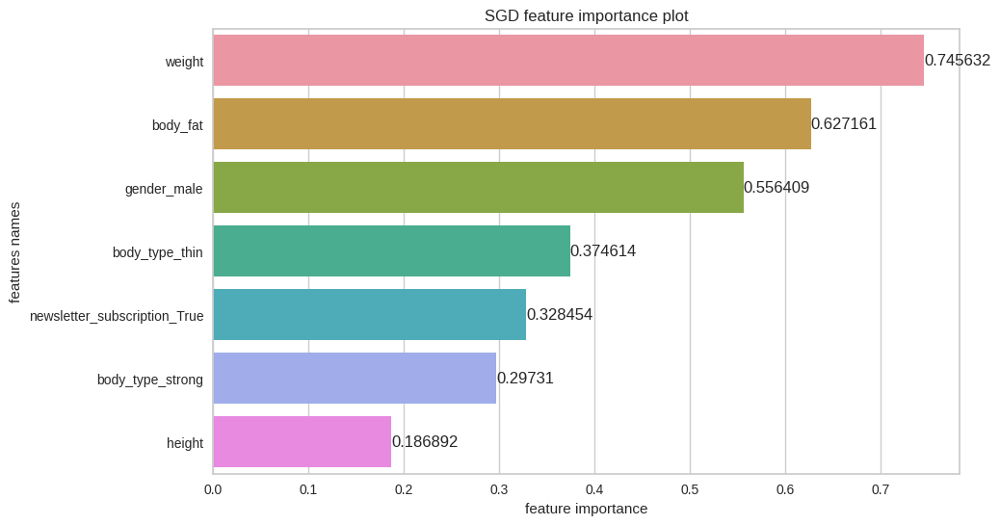

[SGD] Best parameters are {'alpha': 0.001, 'eta0': 0.0001, 'learning_rate': 'optimal', 'penalty': 'l2', 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Logistic Regression
[Logistic Regression] Features importances: [0.32177226 0.61814012 1.56034593 1.11556012 0.09798292 0.524001
 0.32456376]


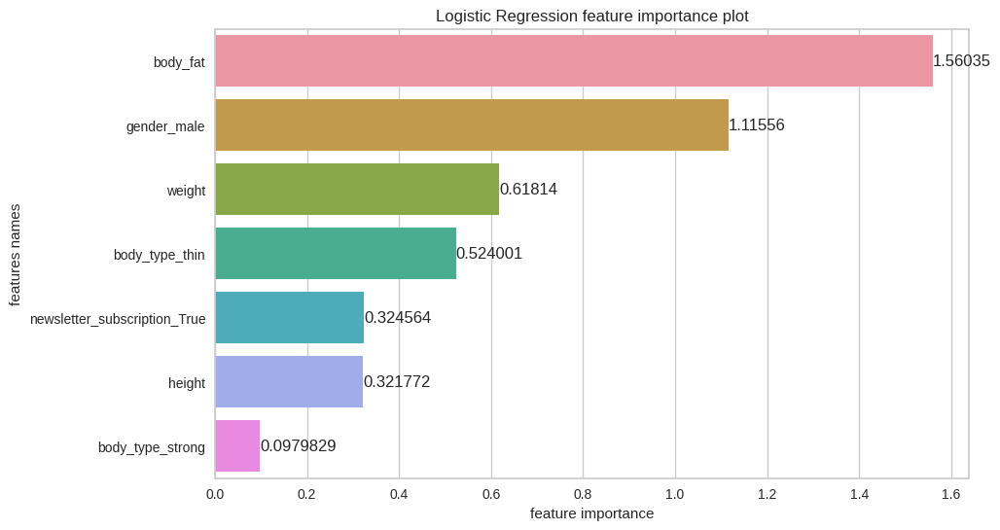

[Logistic Regression] Best parameters are {'C': 1, 'penalty': 'l2', 'random_state': 42, 'solver': 'liblinear'}
[INFO] Performing Grid-Search CV ---- Decision Tree
[Decision Tree] Features importances: [0.01585795029237763, 0.04081628523636544, 0.6682268277912975, 0.27509893667995944, 0.0, 0.0, 0.0]


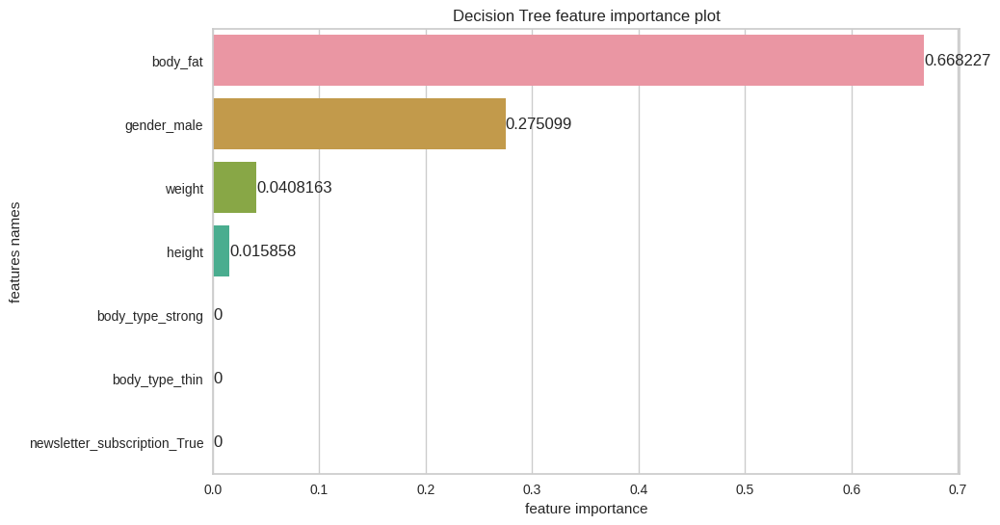

[Decision Tree] Best parameters are {'criterion': 'entropy', 'max_depth': 3, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Random Forest
[Random Forest] Features importances: [0.14669905199157124, 0.2557621065441129, 0.42305423173600226, 0.12447012194431954, 0.0, 0.03647798456977445, 0.013536503214219653]


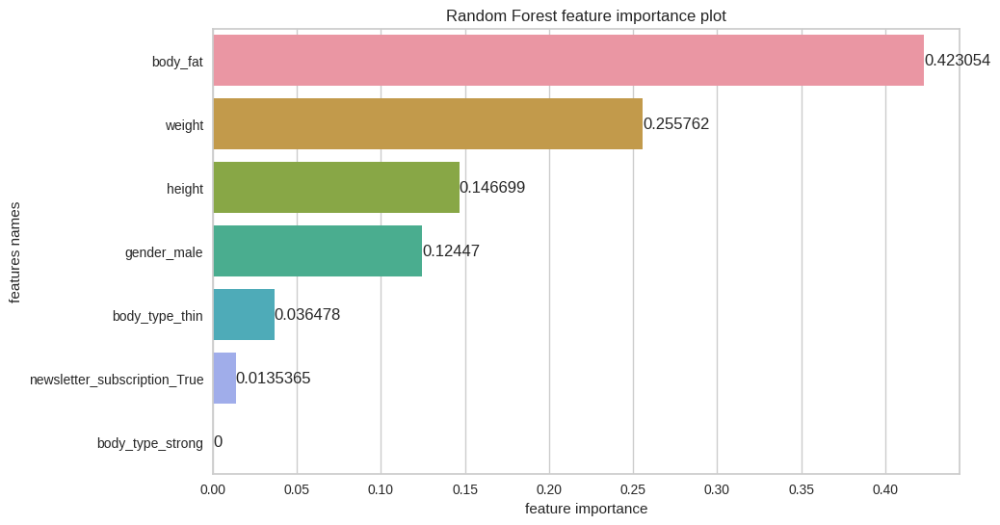

[Random Forest] Best parameters are {'criterion': 'gini', 'max_depth': 3, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- AdaBoost
[AdaBoost] Features importances: [0.1, 0.2, 0.375, 0.175, 0.0, 0.05, 0.1]


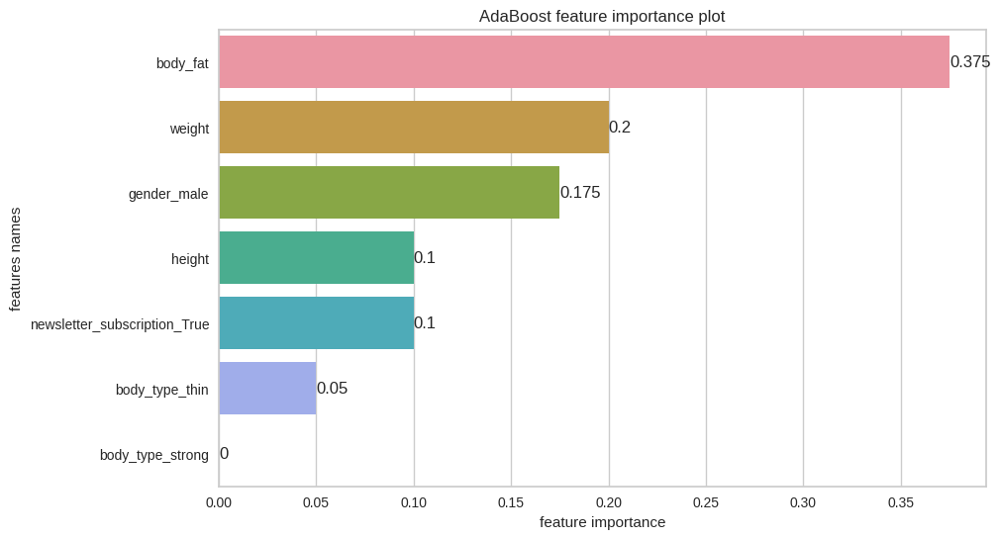

[AdaBoost] Best parameters are {'base_estimator': DecisionTreeClassifier(max_depth=1), 'learning_rate': 0.1, 'n_estimators': 80, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- GradientBoost
[GradientBoost] Features importances: [0.05722140854970346, 0.1563958526893124, 0.5777556107618984, 0.16168607156282616, 0.0, 0.04033131144755998, 0.0066097449886994095]


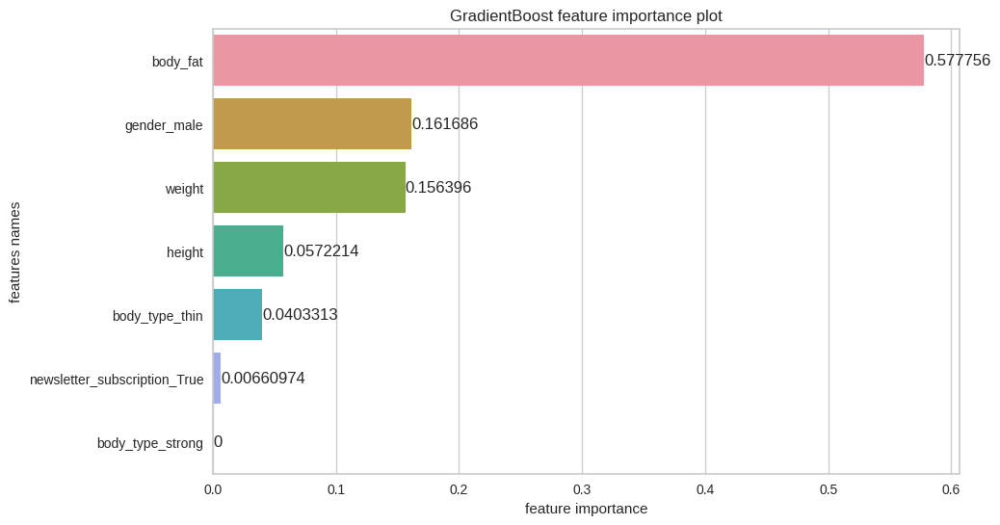

[GradientBoost] Best parameters are {'criterion': 'friedman_mse', 'learning_rate': 0.075, 'loss': 'deviance', 'max_depth': 3, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'n_estimators': 15, 'random_state': 42, 'subsample': 0.85}


In [160]:
estimators_multiclass, X_test, y_test, X_train, y_train, X_test_inv, features_try = train(X_demo, y_demo, 
                                                         grid_params_multiclass, 
                                                         seed)

In [116]:
evaluation_table = evaluate_multiclass(estimators_multiclass, X_test, y_test, no_of_labels = 3, features_selected = False, features = features_try)


In [117]:
evaluation_table

,Overall Accuracy,Balanced Accuracy,Adj Balanced Accuracy,Precision micro,Precision macro,Precision weighted,Recall micro,Recall macro,Recall weighted,Cohen's kappa,Mathews Correlation Coefficient
SGD,0.60,0.39,0.09,0.60,0.42,0.56,0.60,0.39,0.60,0.15,0.20
Logistic Regression,0.59,0.40,0.09,0.59,0.40,0.53,0.59,0.40,0.59,0.16,0.18
Decision Tree,0.59,0.40,0.11,0.59,0.38,0.52,0.59,0.40,0.59,0.17,0.18
Random Forest,0.57,0.35,0.02,0.57,0.41,0.54,0.57,0.35,0.57,0.04,0.10
AdaBoost,0.60,0.39,0.09,0.60,0.41,0.54,0.60,0.39,0.60,0.15,0.19
GradientBoost,0.58,0.37,0.06,0.58,0.39,0.52,0.58,0.37,0.58,0.10,0.14


The best classification model here (by the majority rule) is SGD with alpha equal to 0.001, eta0 equal to 0.0001, optimal learning rate and l2 penalty. Overall accuracy is 60%. Micro precision is also 60%, macro precision is 42% and weighted precision is 56%. When it comes to recall, micro is and weighted is 60% and macro is 39%. Cohen's Kappa is 0.15 and MCC is 0.20. AUC for class 0 (*active*) is 0.58, class 1 (*very active*) is 0.62 and class 2 (*sedentary*) is 0.71. The results are not too good and promising.

Below there are classification for one random user, ROC curves and prediction error plots.

In [24]:
prediction_for_one_user(estimators_multiclass, X_test, y_test, X_test_inv, X_demo.columns, y_dem.columns, name = 'SGD')


,height,weight,body_fat,gender_male,body_type_strong,body_type_thin,newsletter_subscription_True,activity_level,activity_level_prediction
704,177.00,88.00,45.00,1.00,1.00,0.00,1.00,2,2


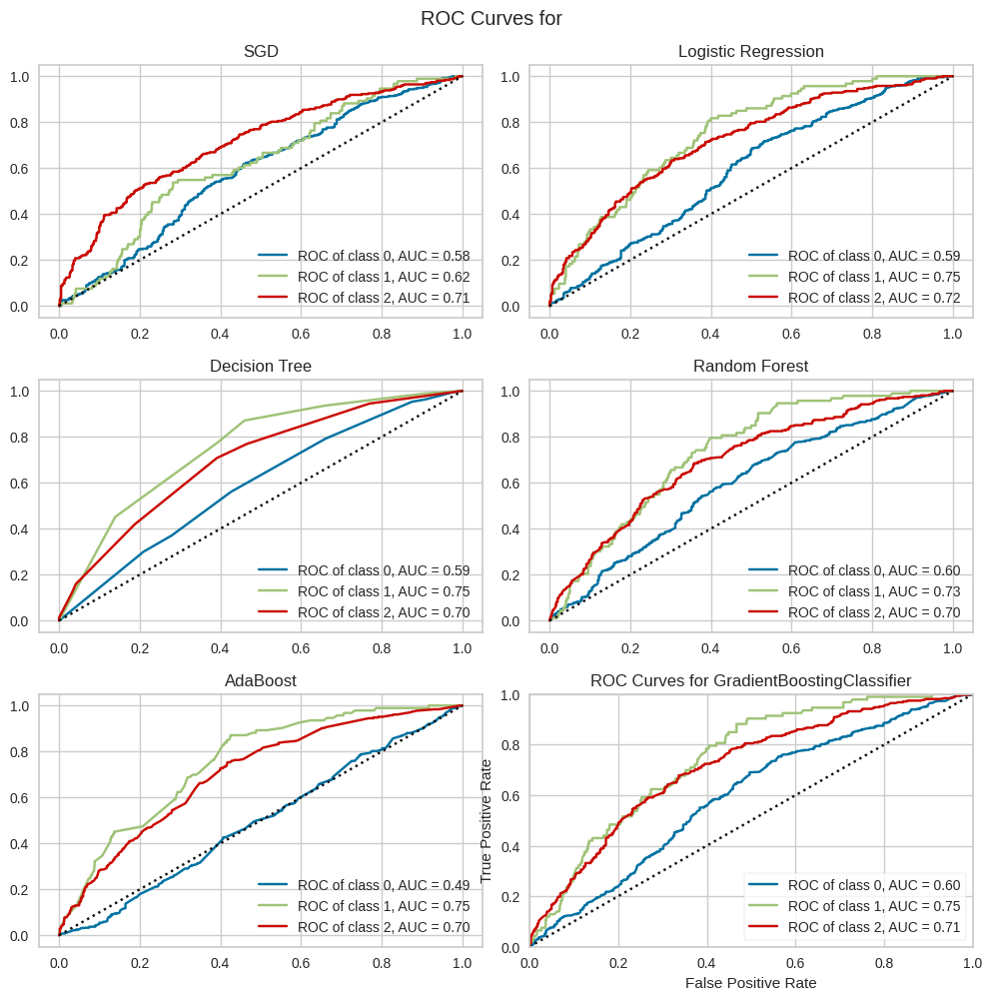

<AxesSubplot: title={'center': 'ROC Curves for GradientBoostingClassifier'}, xlabel='False Positive Rate', ylabel='True Positive Rate'>

In [23]:
ROC_curves(estimators_multiclass, X_train, y_train, X_test, y_test, np.unique(y_demo), name = 'all', features_selected = False, features = features_try)


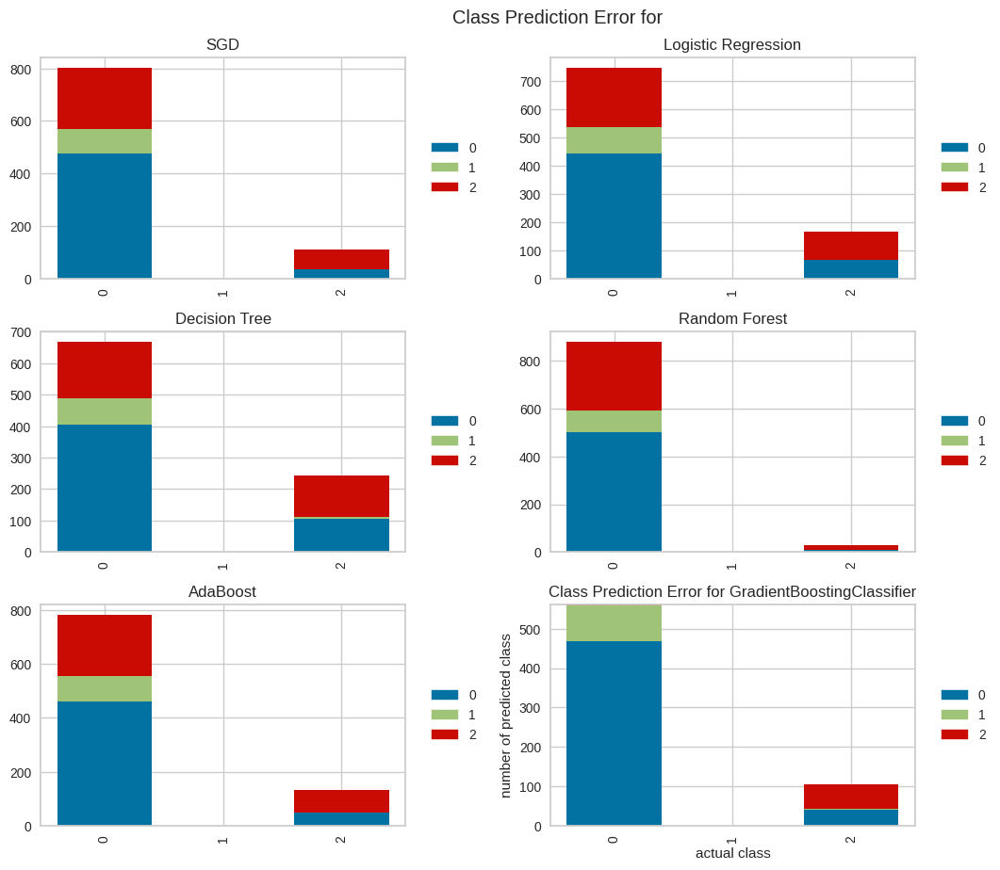

<AxesSubplot: title={'center': 'Class Prediction Error for GradientBoostingClassifier'}, xlabel='actual class', ylabel='number of predicted class'>

In [24]:
prediction_error_plot(estimators_multiclass, X_train, y_train, X_test, y_test, np.unique(y_demo), name =  'all', features_selected = False, features = features_try)


#### With feature selection (Univariate - Kruskall - Wallis test (instead of ANOVA) and chi-square)

[INFO] Performing Grid-Search CV ---- SGD
[SGD] Features selected: Index(['height', 'weight', 'body_fat'], dtype='object')
[SGD] Features importances: [0.00410246 0.00503861 0.01377861]


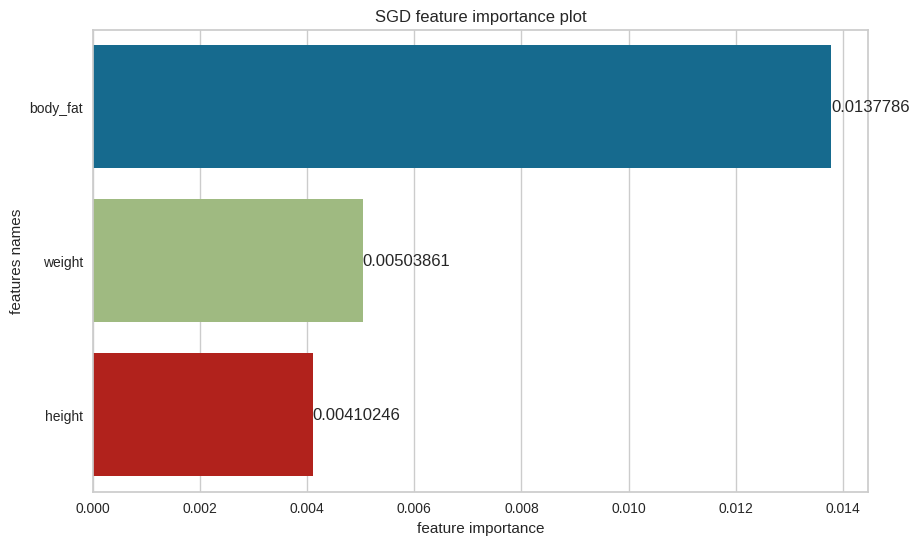

[SGD] Best parameters are {'alpha': 0.001, 'eta0': 0.0001, 'learning_rate': 'invscaling', 'penalty': 'l1', 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Logistic Regression
[Logistic Regression] Features selected: Index(['height', 'weight', 'body_fat'], dtype='object')
[Logistic Regression] Features importances: [0.60283298 0.51746949 1.64455087]


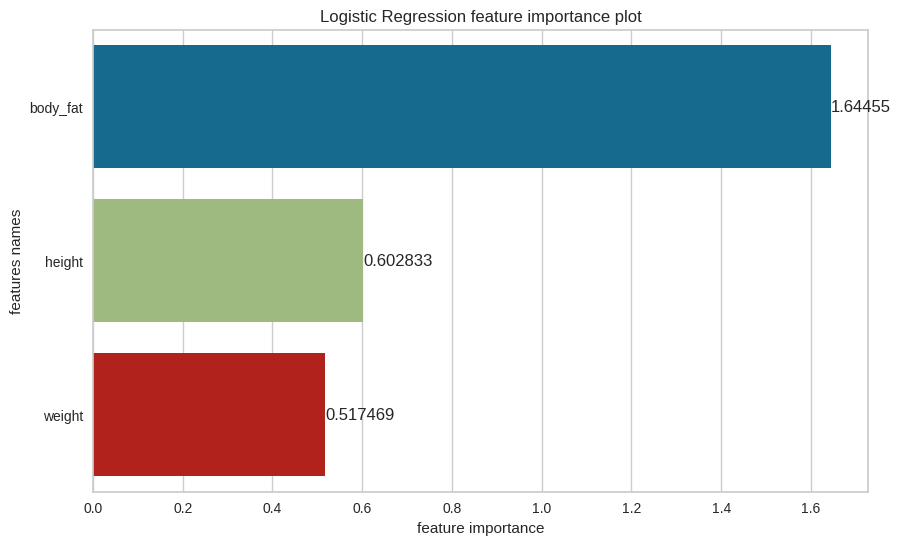

[Logistic Regression] Best parameters are {'C': 1, 'penalty': 'l2', 'random_state': 42, 'solver': 'liblinear'}
[INFO] Performing Grid-Search CV ---- Decision Tree
[Decision Tree] Features selected: Index(['height', 'weight', 'body_fat'], dtype='object')
[Decision Tree] Features importances: [0.1154928572862031, 0.16654144332465748, 0.7179656993891395]


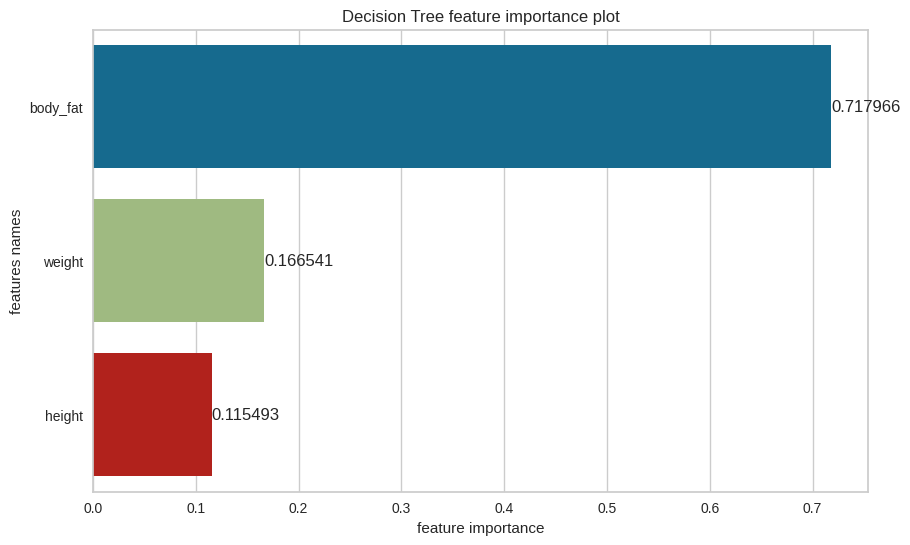

[Decision Tree] Best parameters are {'criterion': 'entropy', 'max_depth': 3, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Random Forest
[Random Forest] Features selected: Index(['height', 'weight', 'body_fat'], dtype='object')
[Random Forest] Features importances: [0.25150266223162704, 0.3076905643257408, 0.44080677344263214]


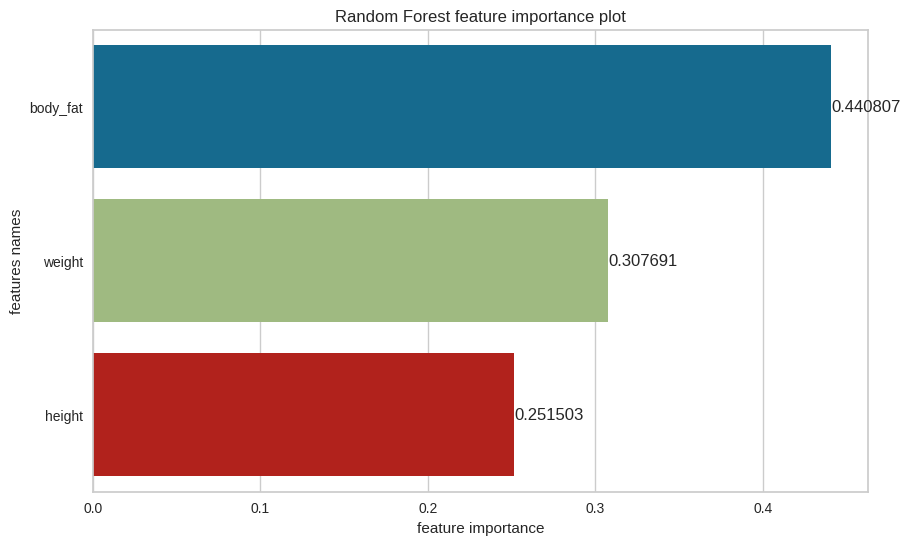

[Random Forest] Best parameters are {'criterion': 'entropy', 'max_depth': 3, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- AdaBoost
[AdaBoost] Features selected: Index(['height', 'weight', 'body_fat'], dtype='object')
[AdaBoost] Features importances: [0.0, 0.0, 1.0]


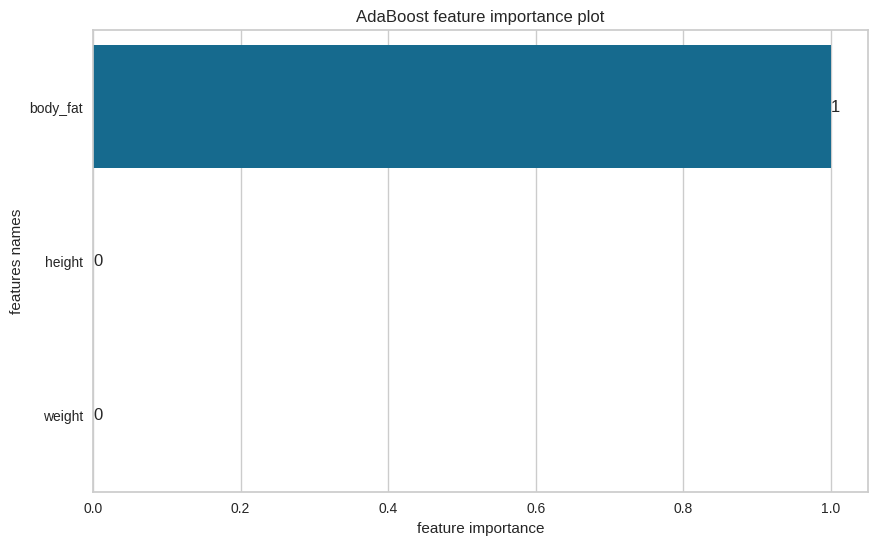

[AdaBoost] Best parameters are {'base_estimator': DecisionTreeClassifier(max_depth=1), 'learning_rate': 0.01, 'n_estimators': 20, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- GradientBoost
[GradientBoost] Features selected: Index(['height', 'weight', 'body_fat'], dtype='object')
[GradientBoost] Features importances: [0.15818092550763205, 0.19831826819175133, 0.6435008063006167]


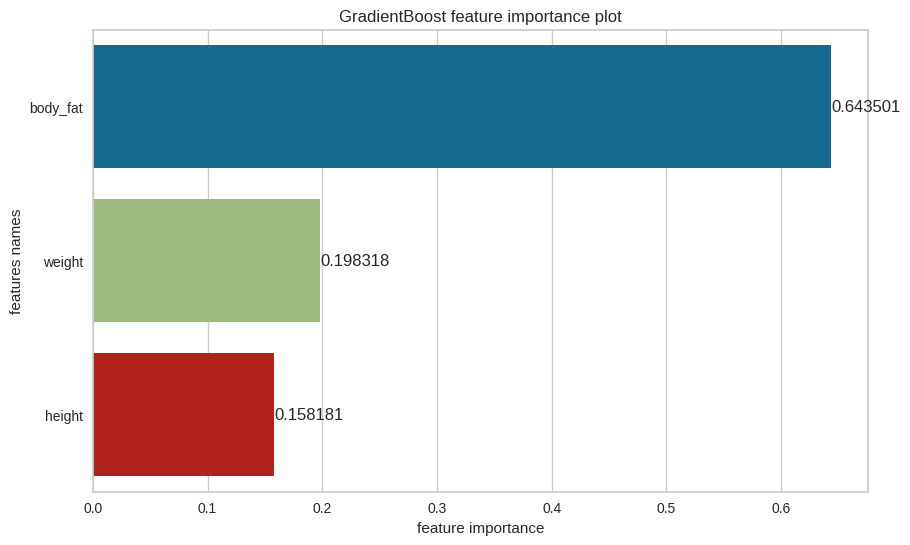

[GradientBoost] Best parameters are {'criterion': 'friedman_mse', 'learning_rate': 0.075, 'loss': 'deviance', 'max_depth': 5, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'n_estimators': 15, 'random_state': 42, 'subsample': 0.85}


In [161]:
estimators_multiclass_s_u, X_test_s_u, y_test_s_u, X_trains_u, y_trains_u, X_test_invs_u, features_trys_u = train(X_demo, y_demo, 
                                                         grid_params_multiclass, 
                                                         seed, feature_selection = True, 
                                                         feature_sel_type = 'UNI')

In [162]:
evaluation_table_s_u = evaluate_multiclass(estimators_multiclass_s_u, X_test_s_u, y_test_s_u, no_of_labels = 3, features_selected = True, features = features_trys_u, feature_sel_type = 'UNI')


In [119]:
evaluation_table_s_u

,Overall Accuracy,Balanced Accuracy,Adj Balanced Accuracy,Precision micro,Precision macro,Precision weighted,Recall micro,Recall macro,Recall weighted,Cohen's kappa,Mathews Correlation Coefficient
SGD,0.58,0.38,0.08,0.58,0.38,0.52,0.58,0.38,0.58,0.13,0.15
Logistic Regression,0.59,0.38,0.08,0.59,0.40,0.54,0.59,0.38,0.59,0.13,0.17
Decision Tree,0.59,0.40,0.11,0.59,0.38,0.52,0.59,0.40,0.59,0.17,0.18
Random Forest,0.57,0.36,0.05,0.57,0.37,0.50,0.57,0.36,0.57,0.08,0.10
AdaBoost,0.59,0.40,0.11,0.59,0.38,0.52,0.59,0.40,0.59,0.17,0.18
GradientBoost,0.58,0.37,0.06,0.58,0.39,0.52,0.58,0.37,0.58,0.10,0.14


#### With feature selection (by SequentialFeatureSelector)

In [163]:
estimators_multiclass_sel, X_test_sel, y_test_sel, X_train_sel, y_train_sel, X_test_inv_sel, features_sel = train(X_demo, y_demo, 
                                                         grid_params_multiclass, 
                                                         seed, feature_selection = True, 
                                                         feature_sel_type = 'SFS')

[INFO] Performing Grid-Search CV ---- SGD
[SGD] Features selected: Index(['body_fat', 'newsletter_subscription_True'], dtype='object')
[SGD] Best parameters are {'alpha': 1e-05, 'eta0': 0.0001, 'learning_rate': 'invscaling', 'penalty': 'l1', 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Logistic Regression
[Logistic Regression] Features selected: Index(['height', 'weight', 'body_fat', 'gender_male', 'body_type_strong'], dtype='object')
[Logistic Regression] Best parameters are {'C': 1, 'penalty': 'l1', 'random_state': 42, 'solver': 'liblinear'}
[INFO] Performing Grid-Search CV ---- Decision Tree
[Decision Tree] Features selected: Index(['body_fat', 'body_type_thin'], dtype='object')
[Decision Tree] Best parameters are {'criterion': 'entropy', 'max_depth': 6, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Random Forest
[Random Forest] Features selected: Index(['body_fat', 'body_type_thin'], dtype='object')
[Random Forest] Best parameters are {'criterion': 'gini', 

In [164]:
evaluation_table_sel = evaluate_multiclass(estimators_multiclass_sel, X_test_sel, y_test_sel, no_of_labels = 3, features_selected = True, features = features_sel, feature_sel_type = 'SFS')


In [165]:
evaluation_table_sel

,Overall Accuracy,Balanced Accuracy,Adj Balanced Accuracy,Precision micro,Precision macro,Precision weighted,Recall micro,Recall macro,Recall weighted,Cohen's kappa,Mathews Correlation Coefficient
SGD,0.59,0.38,0.07,0.59,0.39,0.53,0.59,0.38,0.59,0.11,0.15
Logistic Regression,0.60,0.40,0.10,0.60,0.41,0.55,0.60,0.40,0.60,0.17,0.20
Decision Tree,0.59,0.39,0.09,0.59,0.47,0.55,0.59,0.39,0.59,0.14,0.16
Random Forest,0.58,0.40,0.10,0.58,0.38,0.52,0.58,0.40,0.58,0.17,0.18
AdaBoost,0.59,0.40,0.11,0.59,0.38,0.52,0.59,0.40,0.59,0.17,0.18
GradientBoost,0.59,0.38,0.07,0.59,0.39,0.53,0.59,0.38,0.59,0.11,0.15


#### With feature selection (by Recursive feature elimination with cross-validation - RFECV) 

[INFO] Performing Grid-Search CV ---- SGD
[SGD] Features selected: Index(['height', 'weight', 'body_fat', 'gender_male', 'body_type_strong',
       'body_type_thin', 'newsletter_subscription_True'],
      dtype='object')
[SGD] Features importances: [0.18689152 0.74563225 0.62716106 0.55640948 0.29731006 0.37461354
 0.3284544 ]


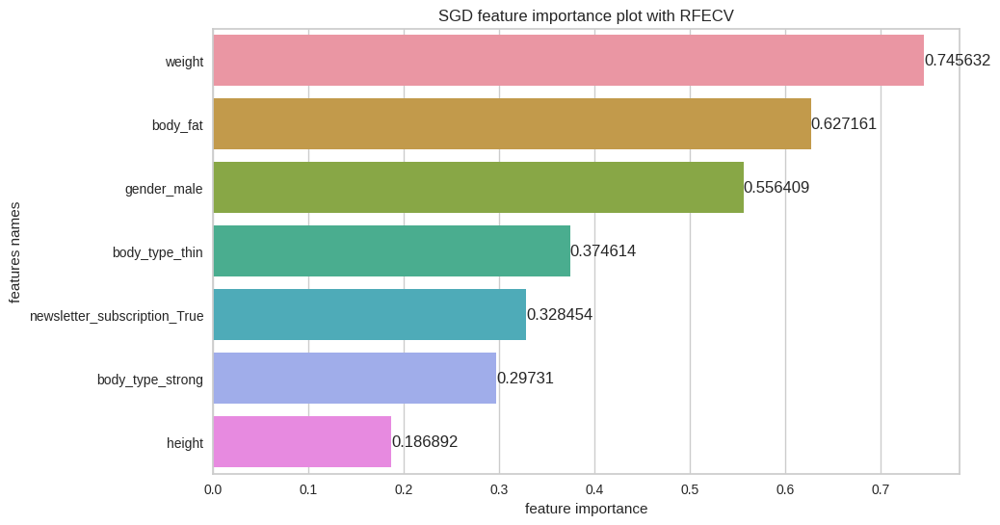

[SGD] Best parameters are {'alpha': 0.001, 'eta0': 0.0001, 'learning_rate': 'optimal', 'penalty': 'l2', 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Logistic Regression
[Logistic Regression] Features selected: Index(['body_fat', 'gender_male'], dtype='object')
[Logistic Regression] Features importances: [1.71014866 1.02518655]


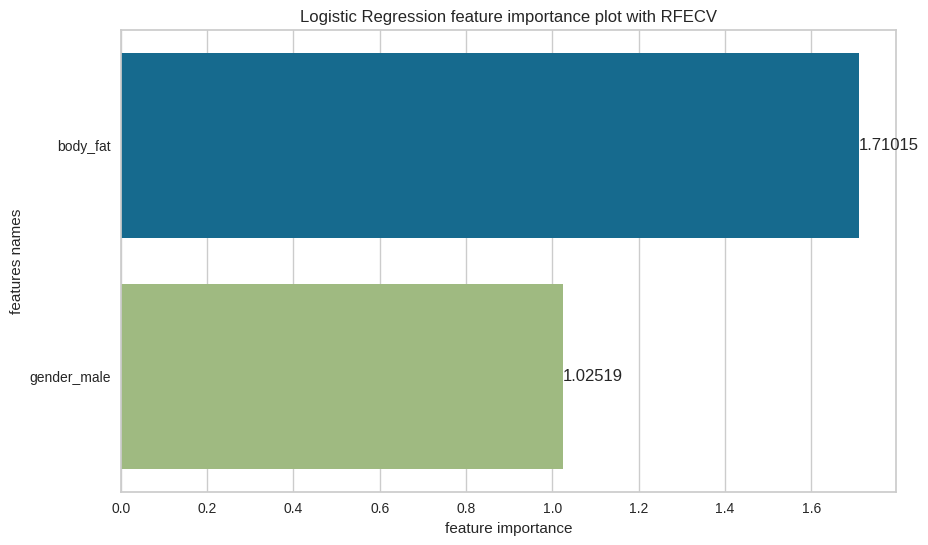

[Logistic Regression] Best parameters are {'C': 1, 'penalty': 'l1', 'random_state': 42, 'solver': 'liblinear'}
[INFO] Performing Grid-Search CV ---- Decision Tree
[Decision Tree] Features selected: Index(['weight'], dtype='object')
[Decision Tree] Features importances: [1.0]


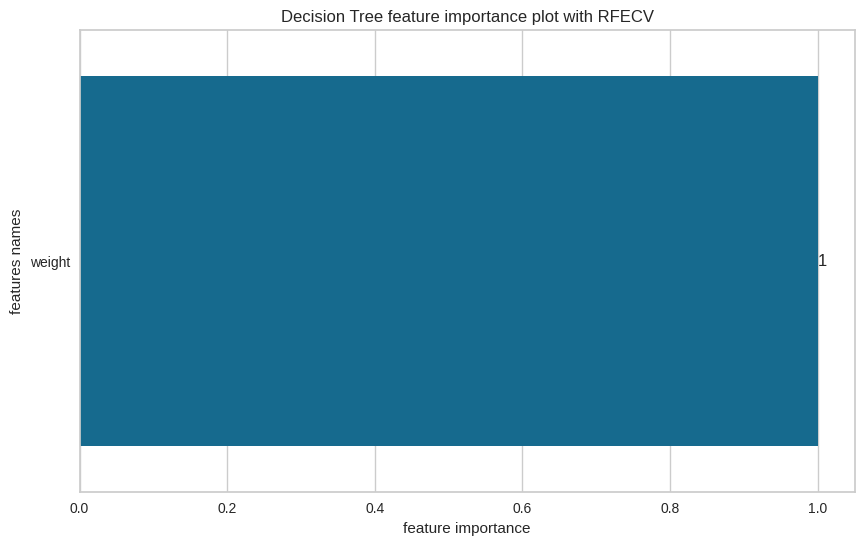

[Decision Tree] Best parameters are {'criterion': 'entropy', 'max_depth': 3, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Random Forest
[Random Forest] Features selected: Index(['weight'], dtype='object')
[Random Forest] Features importances: [1.0]


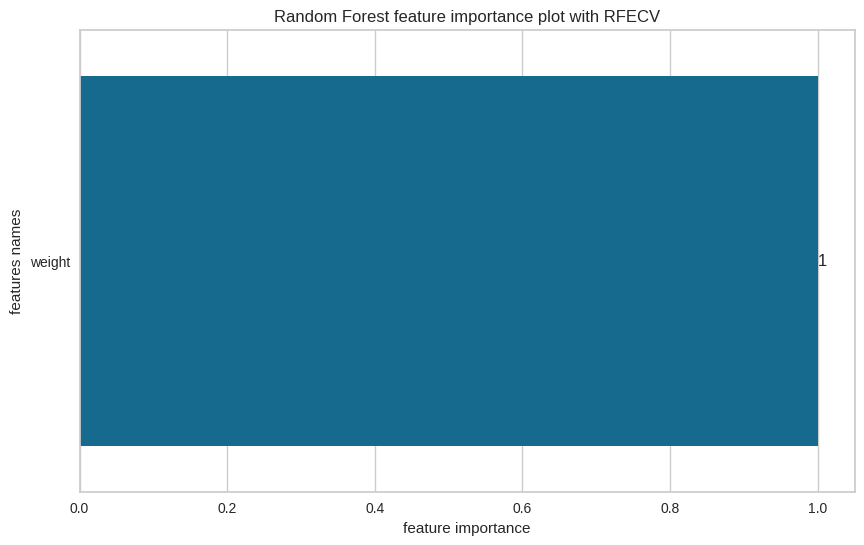

[Random Forest] Best parameters are {'criterion': 'entropy', 'max_depth': 3, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- AdaBoost
[AdaBoost] Features selected: Index(['height', 'weight', 'body_fat', 'gender_male', 'body_type_thin',
       'newsletter_subscription_True'],
      dtype='object')
[AdaBoost] Features importances: [0.1, 0.2, 0.375, 0.175, 0.05, 0.1]


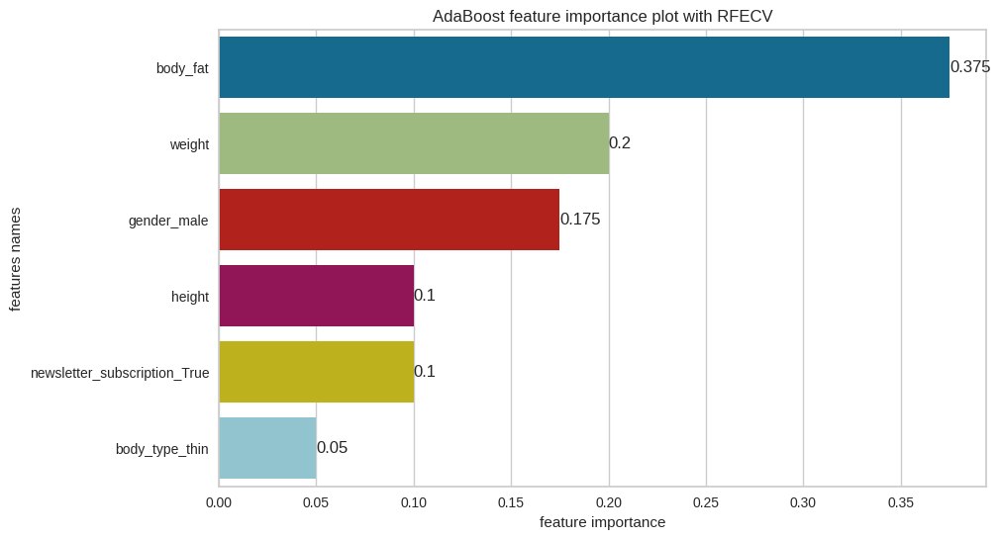

[AdaBoost] Best parameters are {'base_estimator': DecisionTreeClassifier(max_depth=1), 'learning_rate': 0.1, 'n_estimators': 80, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- GradientBoost
[GradientBoost] Features selected: Index(['weight', 'body_fat'], dtype='object')
[GradientBoost] Features importances: [0.3279505511375461, 0.6720494488624539]


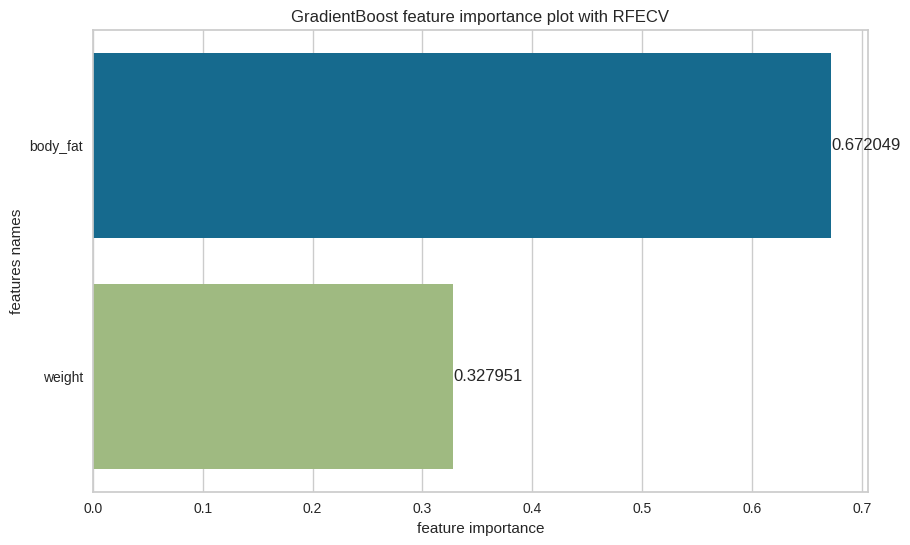

[GradientBoost] Best parameters are {'criterion': 'friedman_mse', 'learning_rate': 0.075, 'loss': 'deviance', 'max_depth': 3, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.4, 'n_estimators': 15, 'random_state': 42, 'subsample': 0.5}


In [166]:
estimators_multiclass_sel_rfecv, X_test_sel_rfecv, y_test_sel_rfecv, X_train_sel_rfecv, y_train_sel_rfecv, X_test_inv_sel_rfecv, features_sel_rfecv = train(X_demo, y_demo, 
                                                         grid_params_multiclass, 
                                                         seed, feature_selection = True, 
                                                         feature_sel_type = 'RFECV')

In [167]:
evaluation_table_sel_rfecv = evaluate_multiclass(estimators_multiclass_sel_rfecv, X_test_sel_rfecv, y_test_sel_rfecv, no_of_labels = 3, features_selected = True, features = features_sel_rfecv, feature_sel_type = 'RFECV')


In [168]:
evaluation_table_sel_rfecv

,Overall Accuracy,Balanced Accuracy,Adj Balanced Accuracy,Precision micro,Precision macro,Precision weighted,Recall micro,Recall macro,Recall weighted,Cohen's kappa,Mathews Correlation Coefficient
SGD,0.60,0.39,0.09,0.60,0.42,0.56,0.60,0.39,0.60,0.15,0.20
Logistic Regression,0.60,0.39,0.09,0.60,0.41,0.55,0.60,0.39,0.60,0.15,0.19
Decision Tree,0.57,0.35,0.02,0.57,0.38,0.51,0.57,0.35,0.57,0.04,0.08
Random Forest,0.55,0.36,0.04,0.55,0.34,0.47,0.55,0.36,0.55,0.07,0.08
AdaBoost,0.60,0.39,0.09,0.60,0.41,0.54,0.60,0.39,0.60,0.15,0.19
GradientBoost,0.57,0.36,0.05,0.57,0.36,0.49,0.57,0.36,0.57,0.08,0.10


#### With feature selection (by SelectFromModel) 

[INFO] Performing Grid-Search CV ---- SGD
[SGD] Features selected: Index(['weight', 'body_fat', 'body_type_thin'], dtype='object')
[SGD] Features importances: [0.27331995 0.88398453 0.32641409]


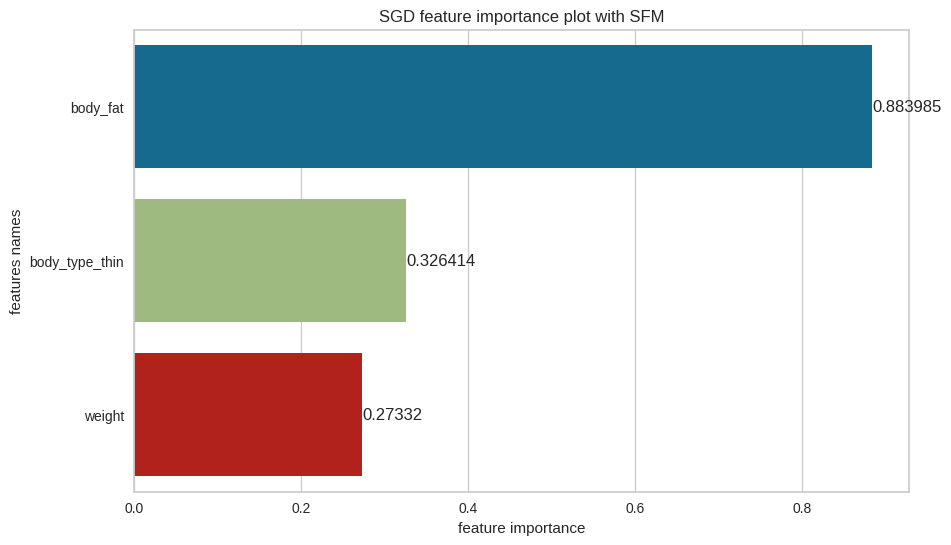

[SGD] Best parameters are {'alpha': 1e-05, 'eta0': 0.025075, 'learning_rate': 'invscaling', 'penalty': 'l2', 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Logistic Regression
[Logistic Regression] Features selected: Index(['body_fat', 'gender_male'], dtype='object')
[Logistic Regression] Features importances: [1.71014866 1.02518655]


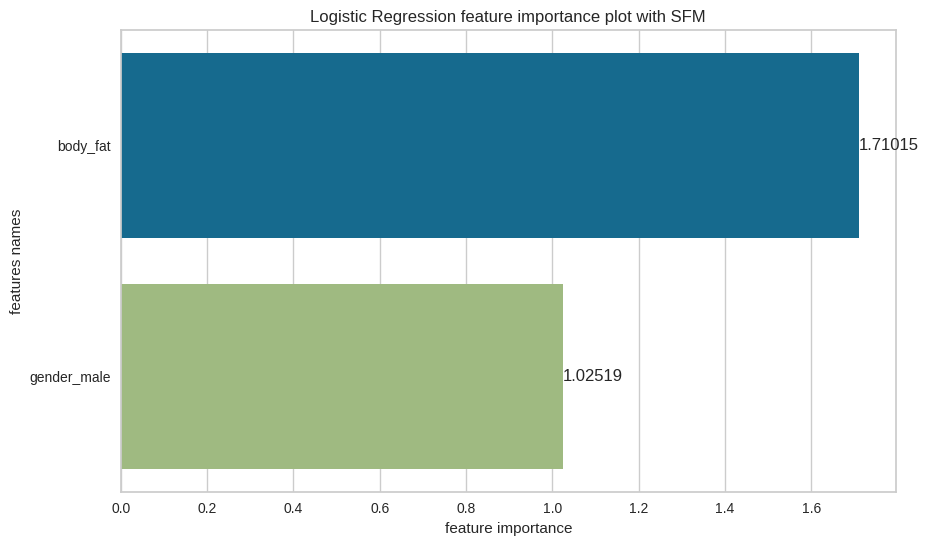

[Logistic Regression] Best parameters are {'C': 1, 'penalty': 'l1', 'random_state': 42, 'solver': 'liblinear'}
[INFO] Performing Grid-Search CV ---- Decision Tree
[Decision Tree] Features selected: Index(['height', 'weight', 'body_fat'], dtype='object')
[Decision Tree] Features importances: [0.1154928572862031, 0.16654144332465748, 0.7179656993891395]


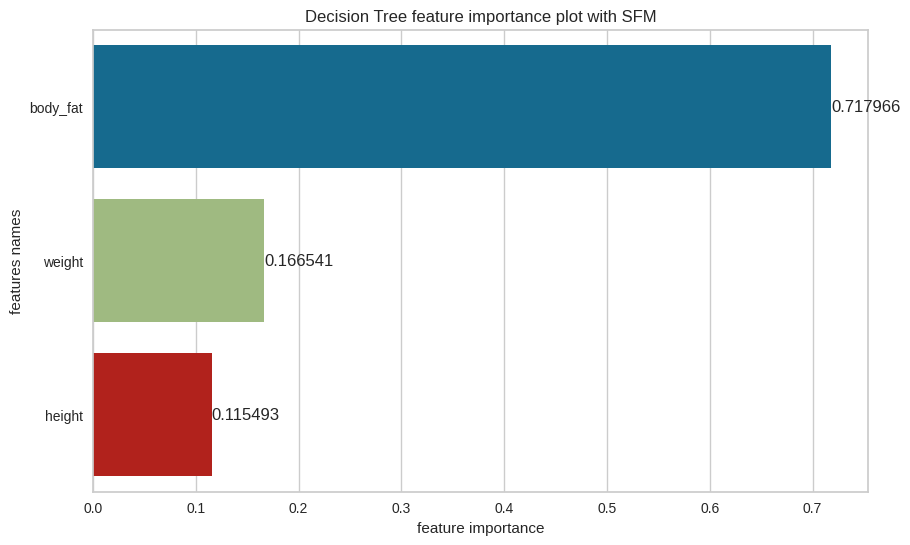

[Decision Tree] Best parameters are {'criterion': 'entropy', 'max_depth': 3, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Random Forest
[Random Forest] Features selected: Index(['height', 'weight', 'body_fat'], dtype='object')
[Random Forest] Features importances: [0.25150266223162704, 0.3076905643257408, 0.44080677344263214]


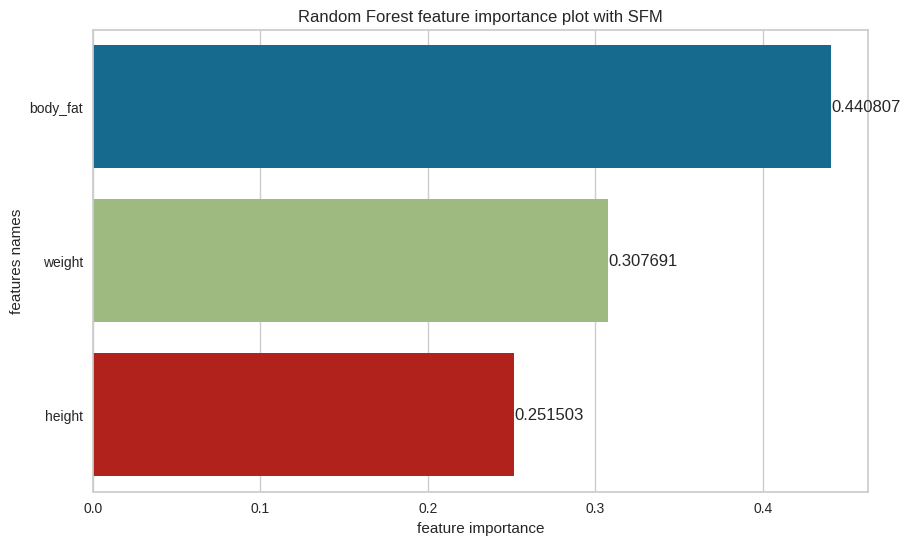

[Random Forest] Best parameters are {'criterion': 'entropy', 'max_depth': 3, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- AdaBoost
[AdaBoost] Features selected: Index(['height', 'weight'], dtype='object')
[AdaBoost] Features importances: [0.4212891046644091, 0.5787108953355906]


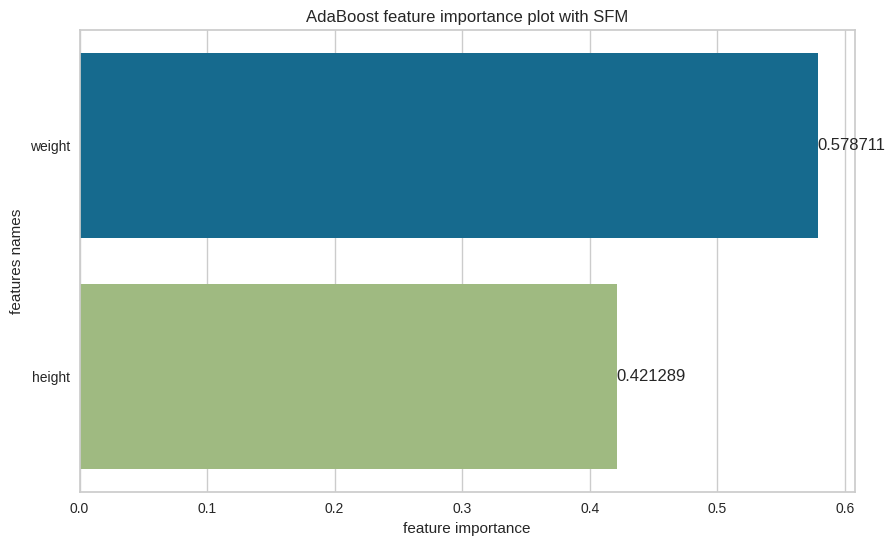

[AdaBoost] Best parameters are {'base_estimator': DecisionTreeClassifier(max_depth=2), 'learning_rate': 0.075, 'n_estimators': 20, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- GradientBoost
[GradientBoost] Features selected: Index(['height', 'weight', 'body_fat'], dtype='object')
[GradientBoost] Features importances: [0.15818092550763205, 0.19831826819175133, 0.6435008063006167]


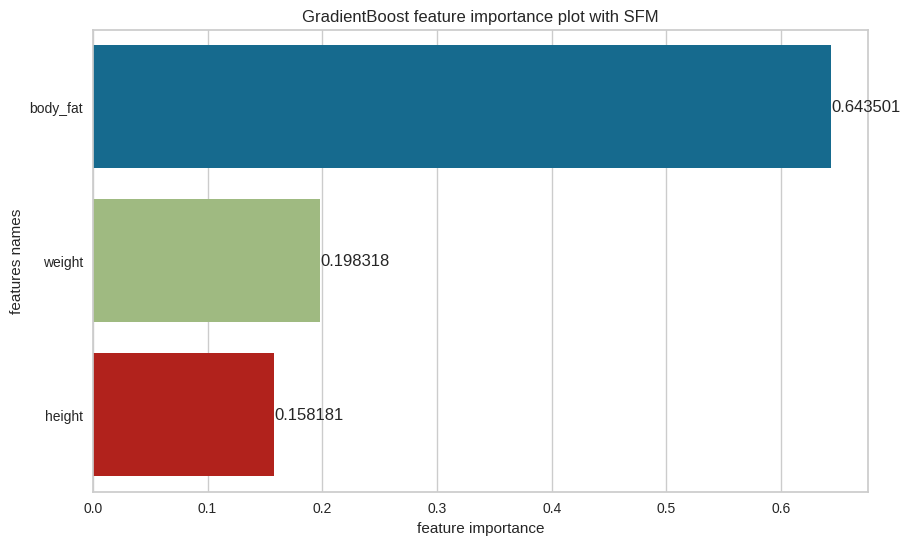

[GradientBoost] Best parameters are {'criterion': 'friedman_mse', 'learning_rate': 0.075, 'loss': 'deviance', 'max_depth': 5, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'n_estimators': 15, 'random_state': 42, 'subsample': 0.85}


In [169]:
estimators_multiclass_sel_sfm, X_test_sel_sfm, y_test_sel_sfm, X_train_sel_sfm, y_train_sel_sfm, X_test_inv_sel_sfm, features_sel_sfm = train(X_demo, y_demo, 
                                                         grid_params_multiclass, 
                                                         seed, feature_selection = True, 
                                                         feature_sel_type = 'SFM')

In [170]:
evaluation_table_sel_sfm = evaluate_multiclass(estimators_multiclass_sel_sfm, X_test_sel_sfm, y_test_sel_sfm, no_of_labels = 3, features_selected = True, features = features_sel_sfm, feature_sel_type = 'SFM')


In [132]:
evaluation_table_sel_sfm

,Overall Accuracy,Balanced Accuracy,Adj Balanced Accuracy,Precision micro,Precision macro,Precision weighted,Recall micro,Recall macro,Recall weighted,Cohen's kappa,Mathews Correlation Coefficient
SGD,0.59,0.39,0.09,0.59,0.39,0.52,0.59,0.39,0.59,0.14,0.17
Logistic Regression,0.60,0.39,0.09,0.60,0.41,0.55,0.60,0.39,0.60,0.15,0.19
Decision Tree,0.59,0.40,0.11,0.59,0.38,0.52,0.59,0.40,0.59,0.17,0.18
Random Forest,0.57,0.36,0.05,0.57,0.37,0.50,0.57,0.36,0.57,0.08,0.10
AdaBoost,0.58,0.36,0.04,0.58,0.40,0.54,0.58,0.36,0.58,0.07,0.13
GradientBoost,0.58,0.37,0.06,0.58,0.39,0.52,0.58,0.37,0.58,0.10,0.14


#### Summary

There is no big difference between

### Predicting activity level - very active + active vs sedentary

Now, we'll try to do binary classification. 

Class 0 is equivalent to *active* and *very active* and 1 to *sedentary*.

For this we are taking into consideration variables:

* gender,
* body_type,
* newsletter_subscription,
* height,
* weight,
* body_fat.

In [133]:
X_demo2 = df_users_only.loc[:, ['gender', 'body_type', 'newsletter_subscription', 
                                             'height', 'weight', 'body_fat']]

# X_demo.replace({'male':1, 'female':0, 'False': 0, 'True': 1, 'thin': 0, 'mid': 1, 'strong': 2}, inplace = True)

cat_col = ['gender', 'body_type', 'newsletter_subscription']
X_demo2 = pd.get_dummies(X_demo2, columns = cat_cols, drop_first = True)


y_demo2 = []

for act in df_users_only['activity_level']:
    if (act == 'active') | (act == 'very active'):
        y_demo2.append(0)
    elif act == 'sedentary':
        y_demo2.append(1)

y_demo2 = np.array(y_demo2)

y_dem2 = pd.DataFrame(y_demo2, columns = ['activity_level'])

[INFO] Performing Grid-Search CV ---- SGD
[SGD] Features importances: [0.001986   0.00236804 0.00645037 0.00283376 0.00185182 0.00068516
 0.00028081]


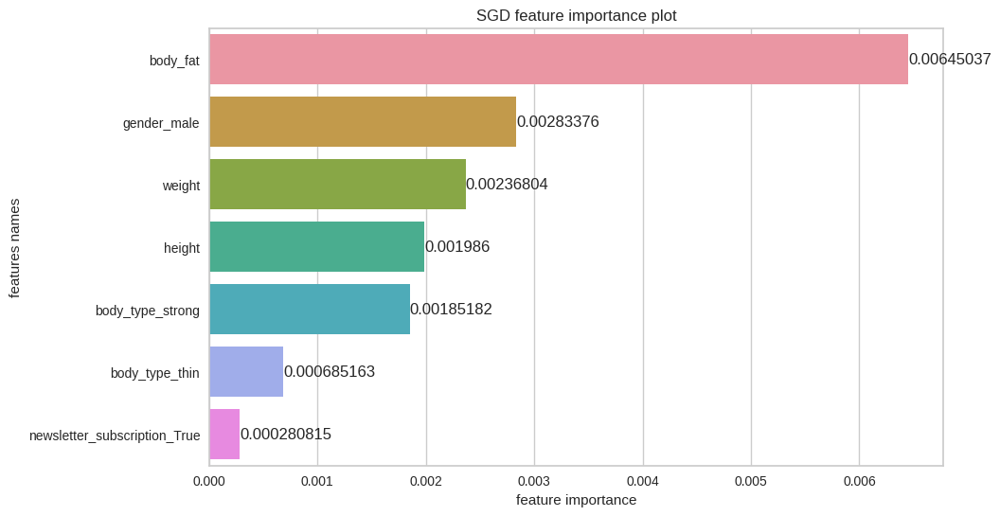

[SGD] Best parameters are {'alpha': 0.000505, 'eta0': 0.0001, 'learning_rate': 'invscaling', 'penalty': 'l1', 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Logistic Regression
[Logistic Regression] Features importances: [0.07239023 0.17873721 0.59442116 0.389809   0.0802699  0.2087352
 0.0655307 ]


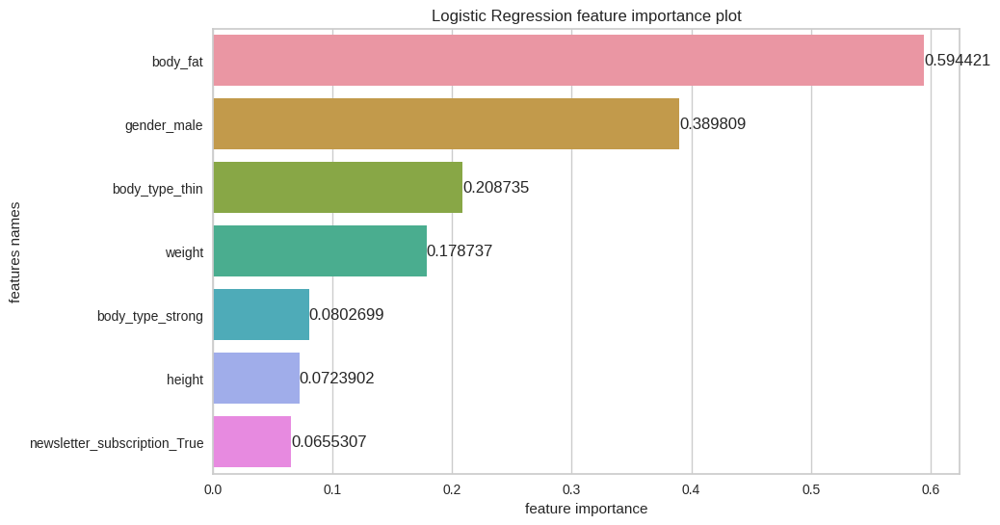

[Logistic Regression] Best parameters are {'C': 4, 'penalty': 'l2', 'random_state': 42, 'solver': 'liblinear'}
[INFO] Performing Grid-Search CV ---- Decision Tree
[Decision Tree] Features importances: [0.059091770312674353, 0.054804672929387545, 0.6210672686193855, 0.26503628813855257, 0.0, 0.0, 0.0]


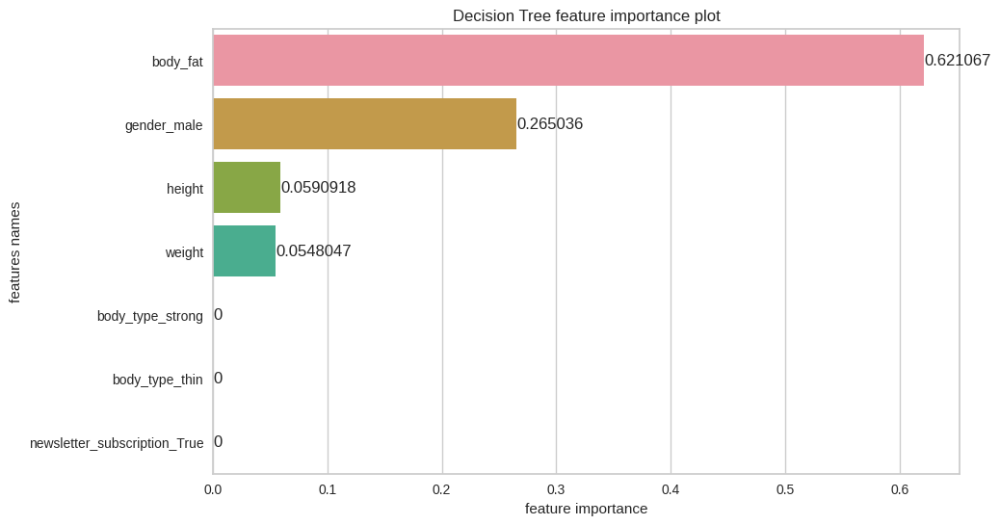

[Decision Tree] Best parameters are {'criterion': 'entropy', 'max_depth': 3, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Random Forest
[Random Forest] Features importances: [0.1873047495158443, 0.21599004901138452, 0.4235659417237112, 0.14689947239590043, 0.0, 0.01657908441917751, 0.009660702933982033]


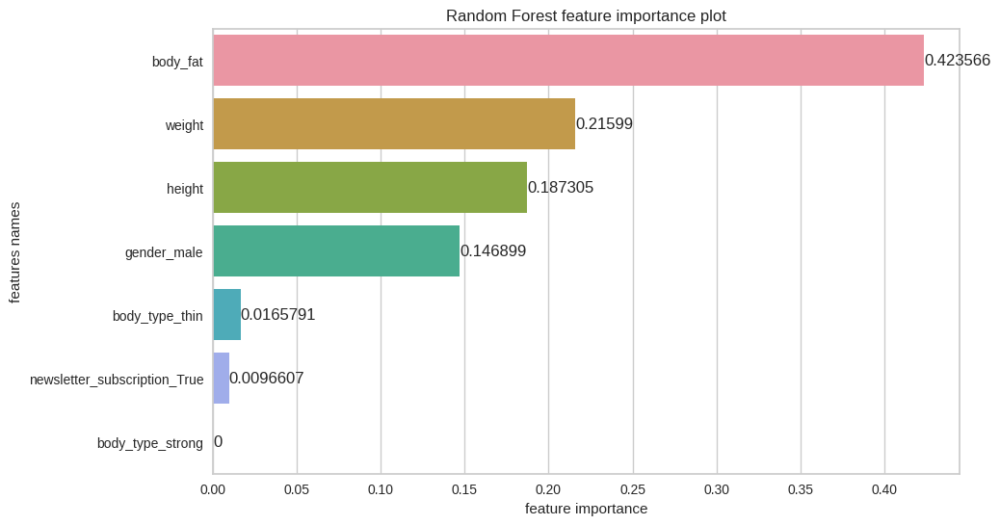

[Random Forest] Best parameters are {'criterion': 'gini', 'max_depth': 3, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- AdaBoost
[AdaBoost] Features importances: [0.12810303043484783, 0.21217222403118044, 0.45501969792862507, 0.1649722881794234, 0.0, 0.032235248627938, 0.007497510797985154]


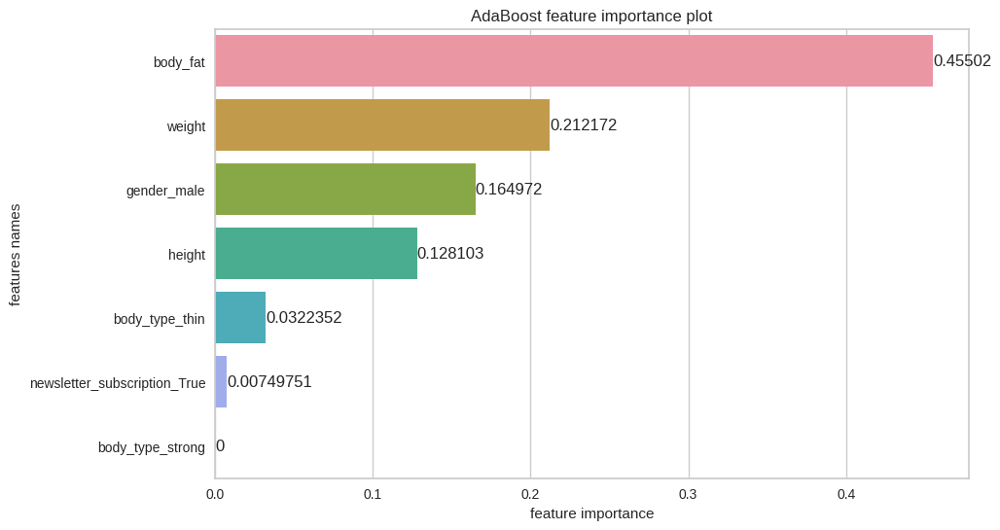

[AdaBoost] Best parameters are {'base_estimator': DecisionTreeClassifier(max_depth=3), 'learning_rate': 0.075, 'n_estimators': 20, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- GradientBoost
[GradientBoost] Features importances: [0.09798849648470664, 0.1734403837620753, 0.5196159451784248, 0.16254832668850233, 0.0, 0.02619583145260074, 0.020211016433690325]


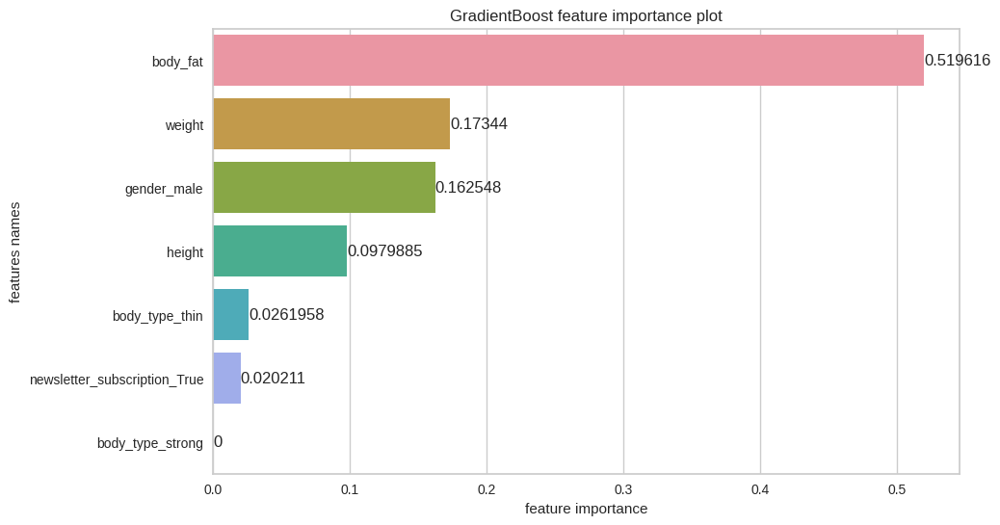

[GradientBoost] Best parameters are {'criterion': 'friedman_mse', 'learning_rate': 0.075, 'loss': 'deviance', 'max_depth': 3, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'n_estimators': 15, 'random_state': 42, 'subsample': 0.85}


In [171]:
estimators_multiclass2, X_test2, y_test2, X_train2, y_train2, X_test_inv2, features2 = train(X_demo2, y_demo2, 
                                                         grid_params_multiclass, 
                                                         seed)

evaluation_table2 = evaluate_multiclass(estimators_multiclass2, X_test2, y_test2, no_of_labels = 2, features_selected = False, features = features2)


In [172]:
evaluation_table2

,Overall Accuracy,Balanced Accuracy,Adj Balanced Accuracy,Precision,Recall,Cohen's kappa,Mathews Correlation Coefficient
SGD,0.72,0.63,0.25,0.65,0.35,0.29,0.31
Logistic Regression,0.71,0.61,0.23,0.64,0.32,0.26,0.29
Decision Tree,0.70,0.62,0.23,0.59,0.36,0.26,0.27
Random Forest,0.66,0.50,0.00,0.00,0.00,0.00,0.00
AdaBoost,0.68,0.58,0.17,0.57,0.27,0.19,0.22
GradientBoost,0.67,0.50,0.01,1.00,0.01,0.01,0.08


According to majority rule, the best classifier is SGD with alpha equal to 0.000505, eta0 equal to 0.0001, invscaling learning rate and l1 penalty. It has 72% of overall accuracy, 65% of precision, 35% of recall. Cohen's kappa is 0.29 and MCC is 0.31, which is not too high value. The AUC values are 0.68 for both groups, but according to AUC, logistic regression better.

Below there are example for one random user, ROC Curves, Class Prediction Errors and decision tree.

In [40]:
prediction_for_one_user(estimators_multiclass2, X_test2, y_test2, X_test_inv2, X_demo2.columns, y_dem2.columns, name = 'Decision Tree')


,height,weight,body_fat,gender_male,body_type_strong,body_type_thin,newsletter_subscription_True,activity_level,activity_level_prediction
704,183.00,84.00,15.00,1.00,0.00,1.00,1.00,0,0


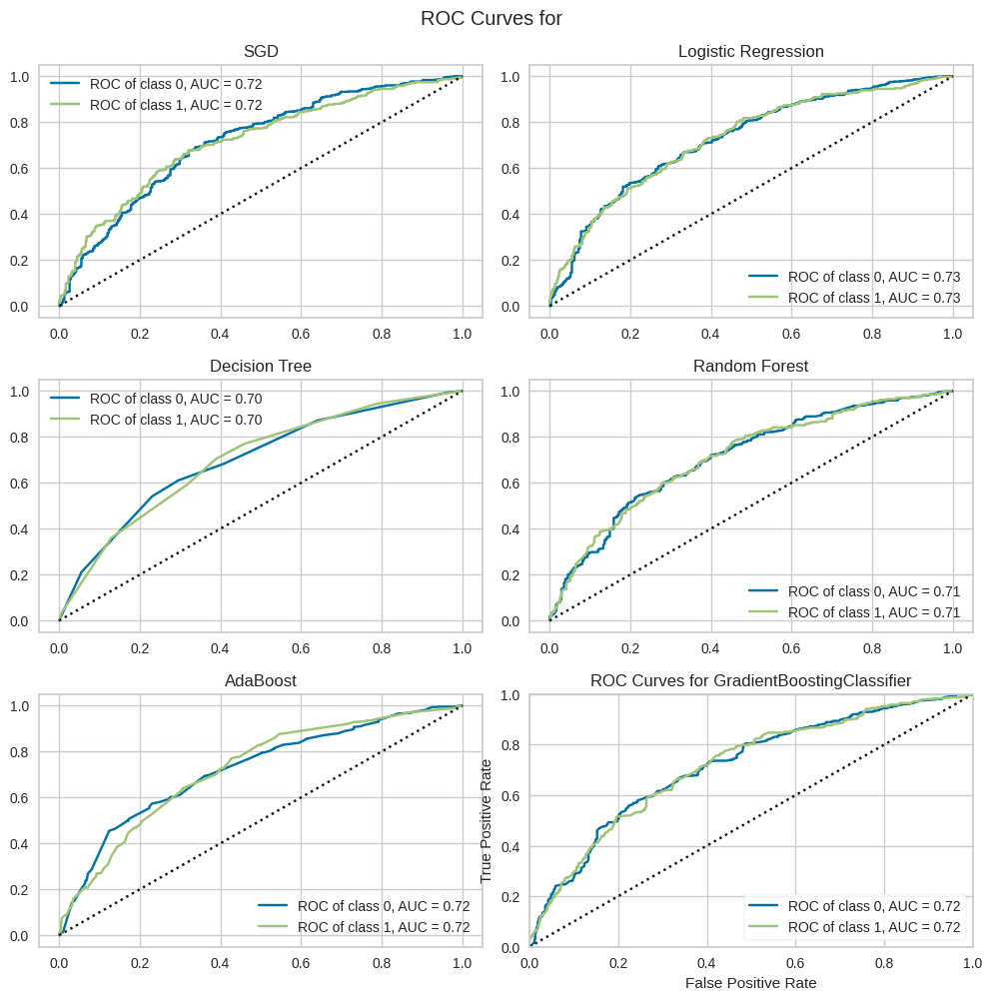

<AxesSubplot: title={'center': 'ROC Curves for GradientBoostingClassifier'}, xlabel='False Positive Rate', ylabel='True Positive Rate'>

In [41]:
ROC_curves(estimators_multiclass2, X_train2, y_train2, X_test2, y_test2, np.unique(y_demo2), name = 'all', features_selected = False, features = features2)

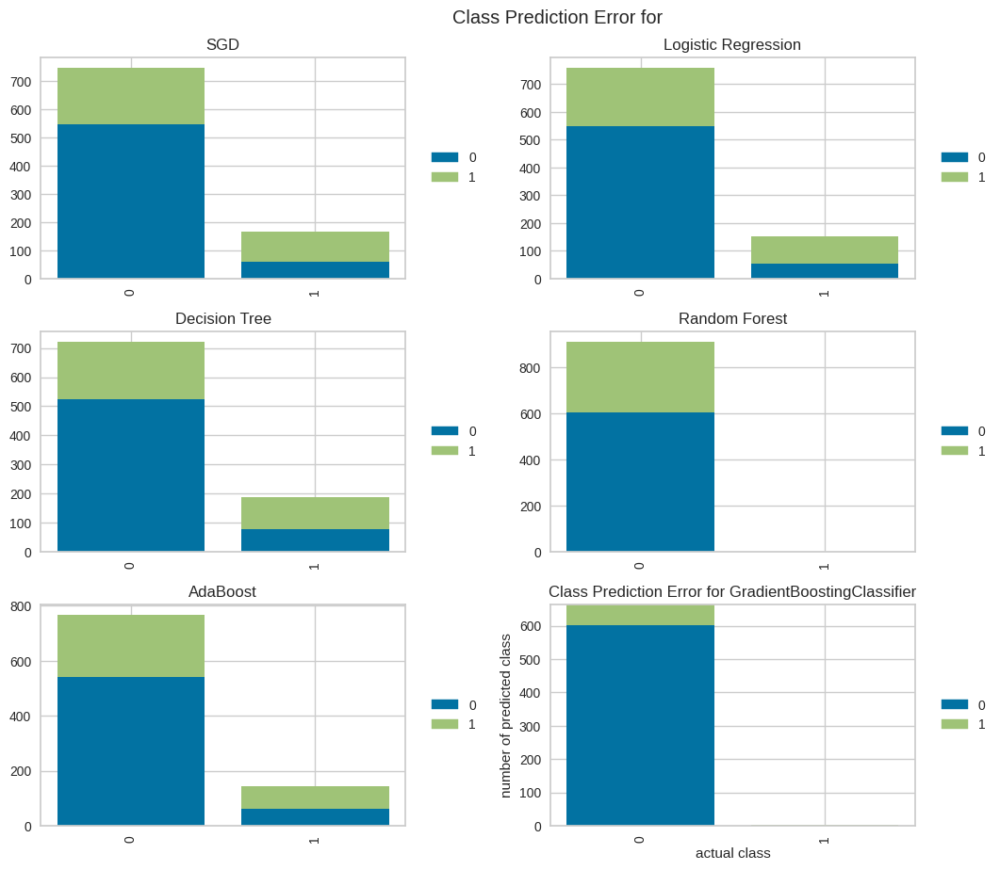

<AxesSubplot: title={'center': 'Class Prediction Error for GradientBoostingClassifier'}, xlabel='actual class', ylabel='number of predicted class'>

In [42]:
prediction_error_plot(estimators_multiclass2, X_train2, y_train2, X_test2, y_test2, np.unique(y_demo2), name = 'all', features_selected = False, features = features2)

In [ ]:
'''
decision_tree(estimators_multiclass2, df_users_only[['gender', 'body_type', 'newsletter_subscription', 
                                             'height', 'weight', 'body_fat']],
             pd.DataFrame(y_demo2, columns = ['activity_level'])['activity_level'])
'''

#### With feature selection (Univariate - Kruskall - Wallis test (instead of ANOVA) and chi-square)

[INFO] Performing Grid-Search CV ---- SGD
[SGD] Features selected: Index(['height', 'weight', 'body_fat'], dtype='object')
[SGD] Features importances: [0.35852039 0.         0.2242423 ]


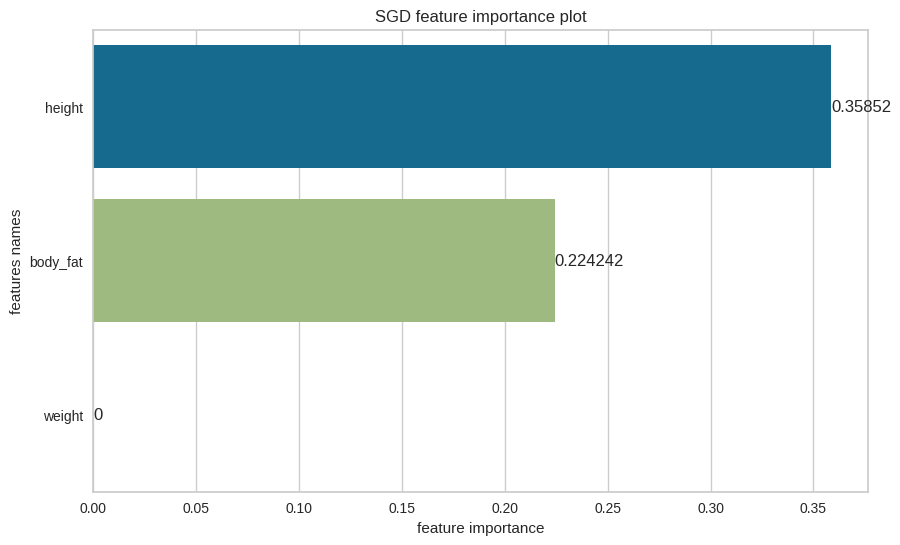

[SGD] Best parameters are {'alpha': 0.0002575, 'eta0': 0.0001, 'learning_rate': 'optimal', 'penalty': 'elasticnet', 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Logistic Regression
[Logistic Regression] Features selected: Index(['height', 'weight', 'body_fat'], dtype='object')
[Logistic Regression] Features importances: [0.26151569 0.02411923 0.59881833]


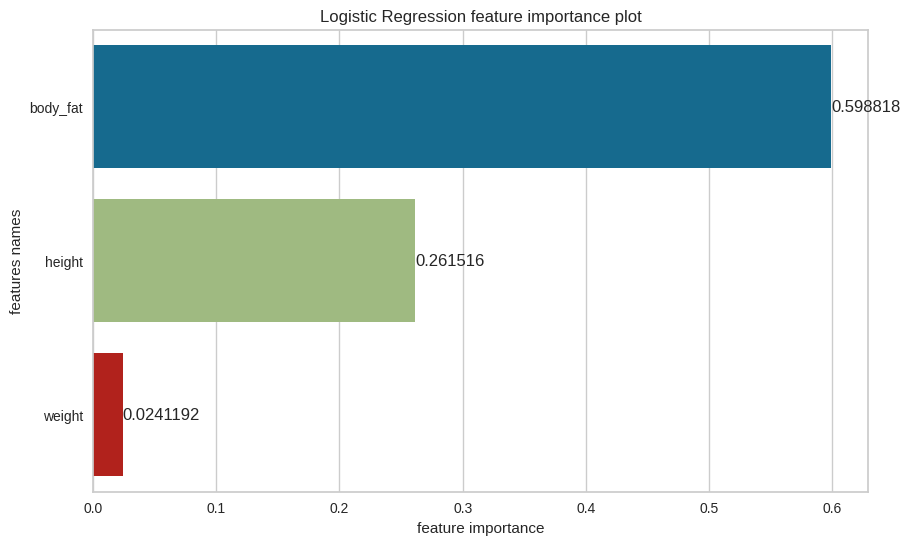

[Logistic Regression] Best parameters are {'C': 1, 'penalty': 'l1', 'random_state': 42, 'solver': 'liblinear'}
[INFO] Performing Grid-Search CV ---- Decision Tree
[Decision Tree] Features selected: Index(['height', 'weight', 'body_fat'], dtype='object')
[Decision Tree] Features importances: [0.13959890664531305, 0.17449171309014955, 0.6859093802645374]


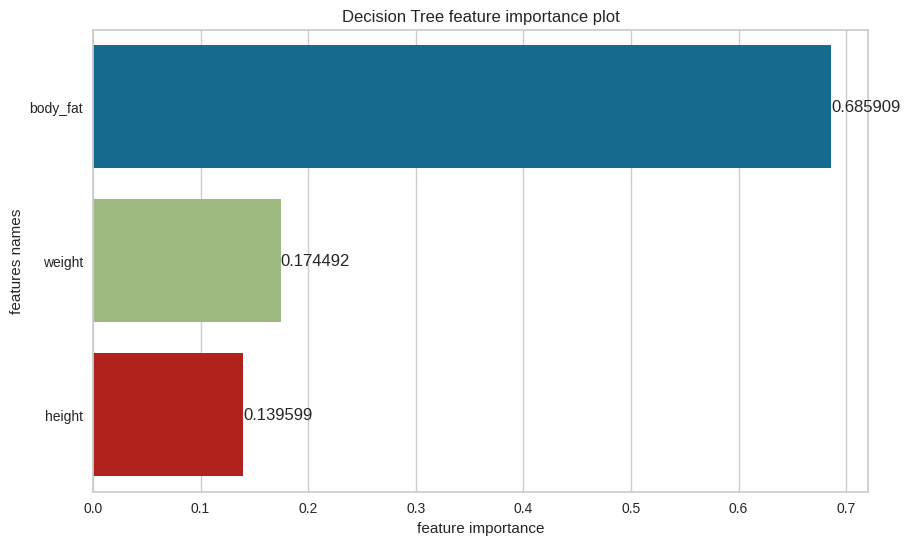

[Decision Tree] Best parameters are {'criterion': 'entropy', 'max_depth': 3, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Random Forest
[Random Forest] Features selected: Index(['height', 'weight', 'body_fat'], dtype='object')
[Random Forest] Features importances: [0.28169327901327457, 0.28580059159248034, 0.43250612939424504]


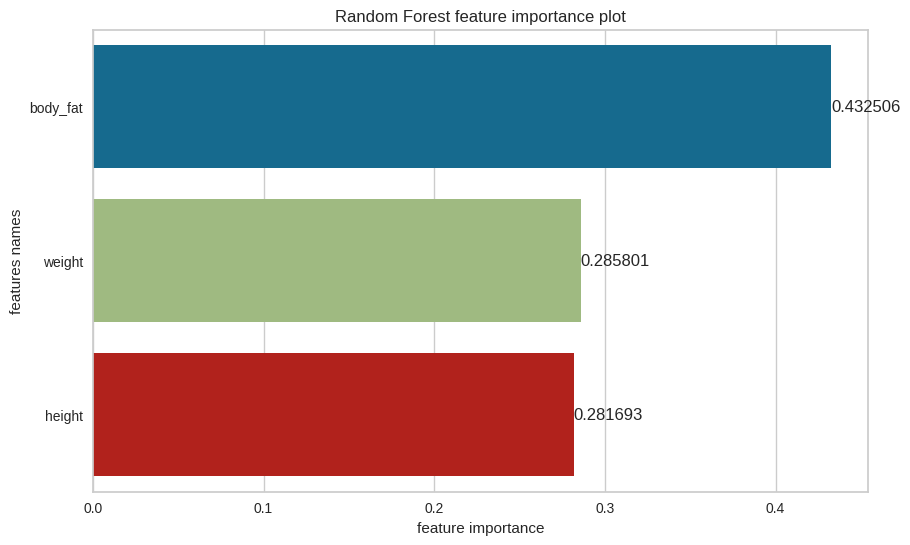

[Random Forest] Best parameters are {'criterion': 'gini', 'max_depth': 3, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- AdaBoost
[AdaBoost] Features selected: Index(['height', 'weight', 'body_fat'], dtype='object')
[AdaBoost] Features importances: [0.20173272919585356, 0.12352908633063656, 0.6747381844735099]


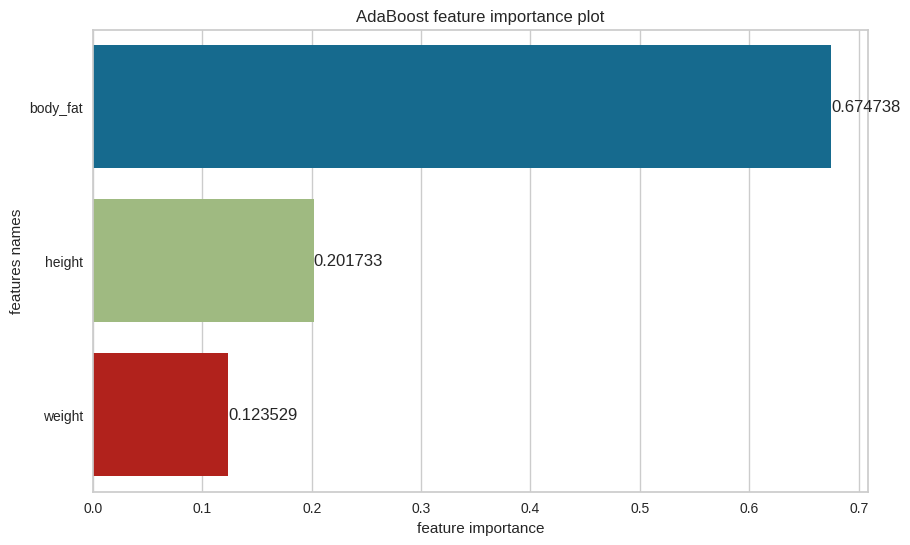

[AdaBoost] Best parameters are {'base_estimator': DecisionTreeClassifier(max_depth=3), 'learning_rate': 0.025, 'n_estimators': 40, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- GradientBoost
[GradientBoost] Features selected: Index(['height', 'weight', 'body_fat'], dtype='object')
[GradientBoost] Features importances: [0.14290317572441952, 0.15480834897136364, 0.7022884753042169]


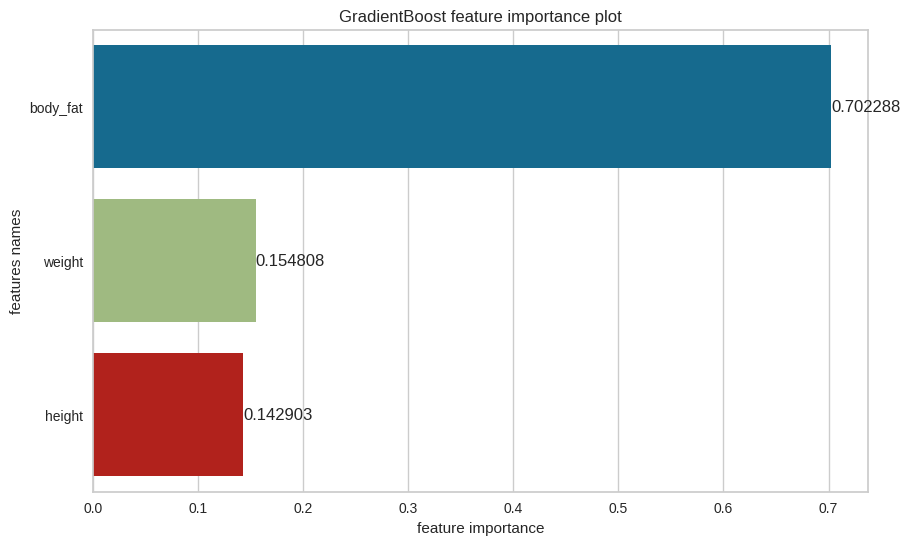

[GradientBoost] Best parameters are {'criterion': 'friedman_mse', 'learning_rate': 0.075, 'loss': 'deviance', 'max_depth': 5, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'n_estimators': 15, 'random_state': 42, 'subsample': 0.85}


In [173]:
estimators_multiclass2_sel_u, X_test2_sel_u, y_test2_sel_u, X_train2_sel_u, y_train2_sel_u, X_test_inv2_sel_u, features2_sel_u = train(X_demo2, y_demo2, 
                                                         grid_params_multiclass, 
                                                         seed, feature_selection = True, 
                                                         feature_sel_type = 'UNI')

In [174]:
evaluation_table2_sel_u = evaluate_multiclass(estimators_multiclass2_sel_u, X_test2_sel_u, y_test2_sel_u, no_of_labels = 2, features_selected = True, features = features2_sel_u, feature_sel_type = 'UNI')


In [175]:
evaluation_table2_sel_u

,Overall Accuracy,Balanced Accuracy,Adj Balanced Accuracy,Precision,Recall,Cohen's kappa,Mathews Correlation Coefficient
SGD,0.68,0.53,0.07,0.62,0.10,0.09,0.14
Logistic Regression,0.70,0.59,0.18,0.63,0.26,0.21,0.24
Decision Tree,0.70,0.62,0.23,0.59,0.36,0.26,0.27
Random Forest,0.66,0.50,0.00,0.00,0.00,0.00,0.00
AdaBoost,0.69,0.59,0.18,0.61,0.26,0.21,0.24
GradientBoost,0.67,0.52,0.04,0.76,0.04,0.05,0.12


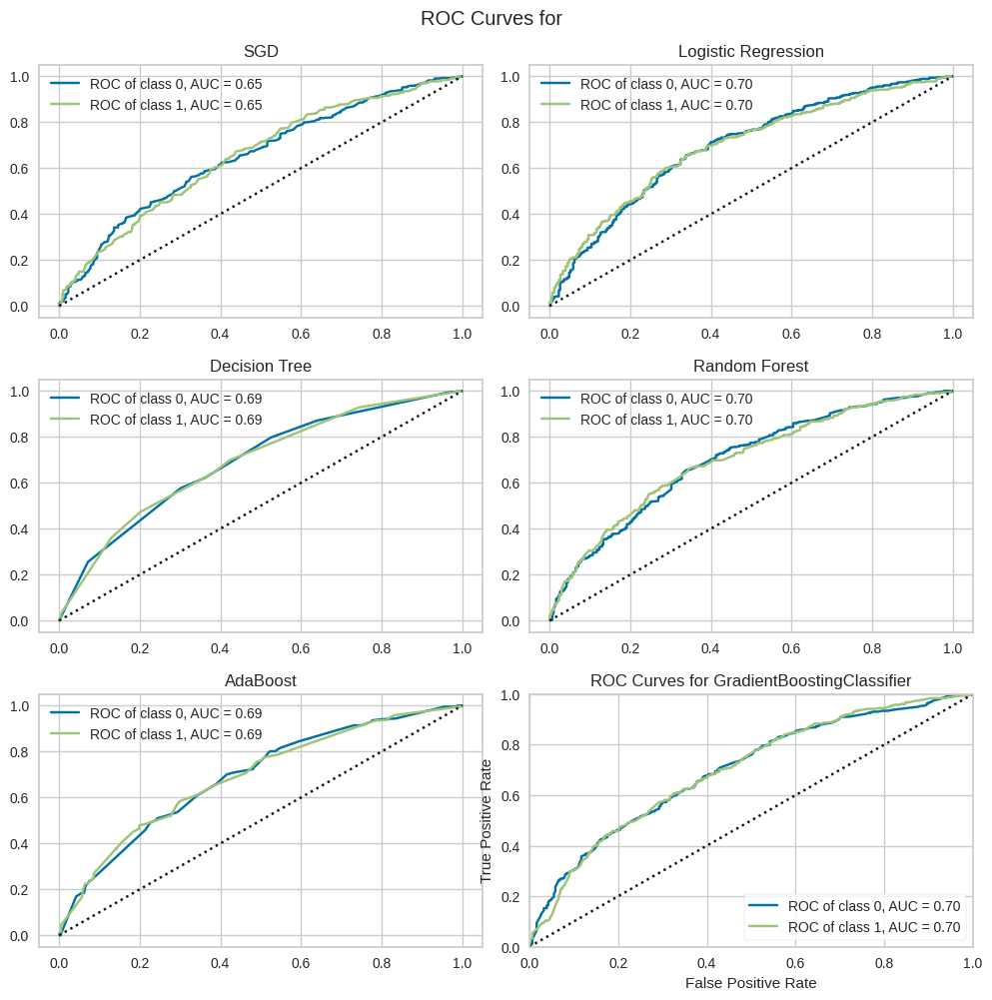

<AxesSubplot: title={'center': 'ROC Curves for GradientBoostingClassifier'}, xlabel='False Positive Rate', ylabel='True Positive Rate'>

In [46]:
ROC_curves(estimators_multiclass2_sel_u, X_train2_sel_u, y_train2_sel_u, X_test2_sel_u, y_test2_sel_u, np.unique(y_demo2), name = 'all', features_selected = True, features = features2_sel_u, feature_sel_type = 'UNI')


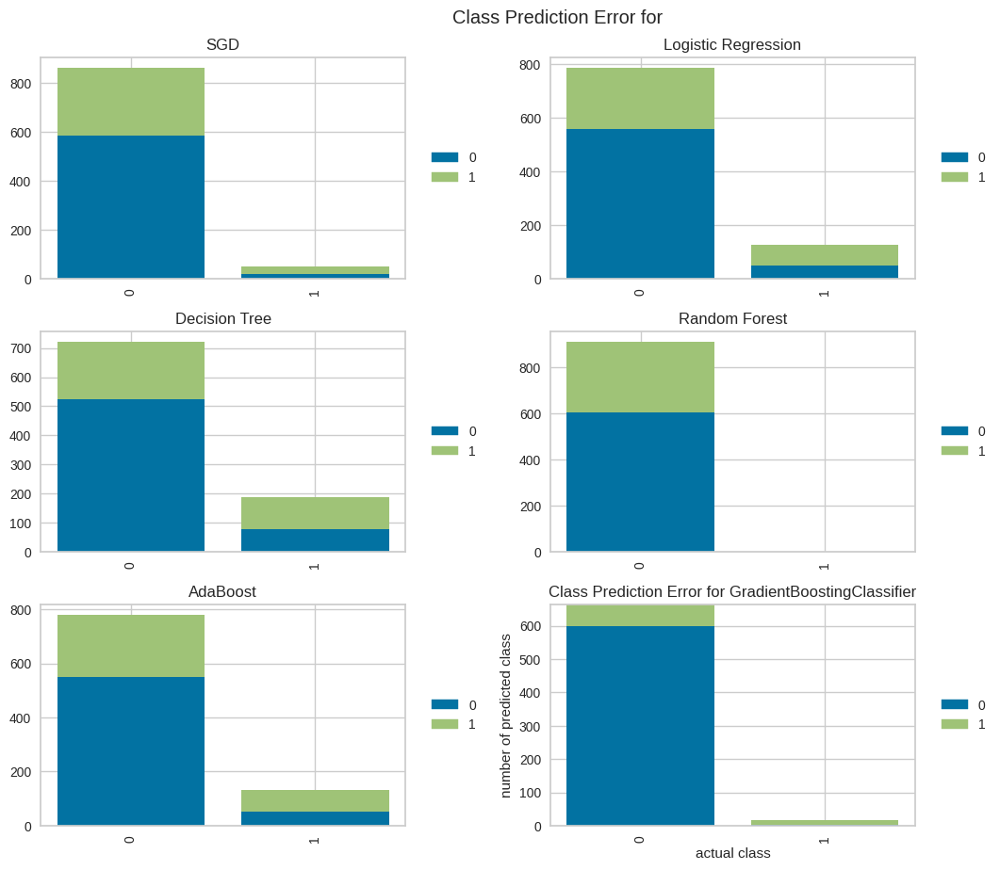

<AxesSubplot: title={'center': 'Class Prediction Error for GradientBoostingClassifier'}, xlabel='actual class', ylabel='number of predicted class'>

In [47]:
prediction_error_plot(estimators_multiclass2_sel_u, X_train2_sel_u, y_train2_sel_u, X_test2_sel_u, y_test2_sel_u, np.unique(y_demo2), name = 'all', features_selected = True, features = features2_sel_u, feature_sel_type = 'UNI')


#### With feature selection (by SequentialFeatureSelector)

In [176]:
estimators_multiclass2_sel, X_test2_sel, y_test2_sel, X_train2_sel, y_train2_sel, X_test_inv2_sel, features2_sel = train(X_demo2, y_demo2, 
                                                         grid_params_multiclass, 
                                                         seed, feature_selection = True, 
                                                         feature_sel_type = 'SFS')

[INFO] Performing Grid-Search CV ---- SGD
[SGD] Features selected: Index(['body_fat'], dtype='object')
[SGD] Best parameters are {'alpha': 1e-05, 'eta0': 0.0001, 'learning_rate': 'invscaling', 'penalty': 'l1', 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Logistic Regression
[Logistic Regression] Features selected: Index(['height', 'body_fat', 'newsletter_subscription_True'], dtype='object')
[Logistic Regression] Best parameters are {'C': 1, 'penalty': 'l2', 'random_state': 42, 'solver': 'liblinear'}
[INFO] Performing Grid-Search CV ---- Decision Tree
[Decision Tree] Features selected: Index(['body_fat', 'body_type_thin'], dtype='object')
[Decision Tree] Best parameters are {'criterion': 'entropy', 'max_depth': 6, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Random Forest
[Random Forest] Features selected: Index(['body_fat', 'body_type_thin'], dtype='object')
[Random Forest] Best parameters are {'criterion': 'gini', 'max_depth': 3, 'max_features': 'log2', 'min_

In [177]:
evaluation_table2_sel = evaluate_multiclass(estimators_multiclass2_sel, X_test2_sel, y_test2_sel, no_of_labels = 2, features_selected = True, features = features2_sel, feature_sel_type = 'SFS')


In [178]:
evaluation_table2_sel

,Overall Accuracy,Balanced Accuracy,Adj Balanced Accuracy,Precision,Recall,Cohen's kappa,Mathews Correlation Coefficient
SGD,0.69,0.58,0.16,0.59,0.25,0.19,0.22
Logistic Regression,0.69,0.59,0.17,0.61,0.26,0.20,0.24
Decision Tree,0.69,0.60,0.20,0.56,0.32,0.22,0.23
Random Forest,0.68,0.60,0.20,0.55,0.34,0.22,0.23
AdaBoost,0.69,0.60,0.20,0.59,0.30,0.22,0.25
GradientBoost,0.69,0.58,0.16,0.59,0.25,0.19,0.22


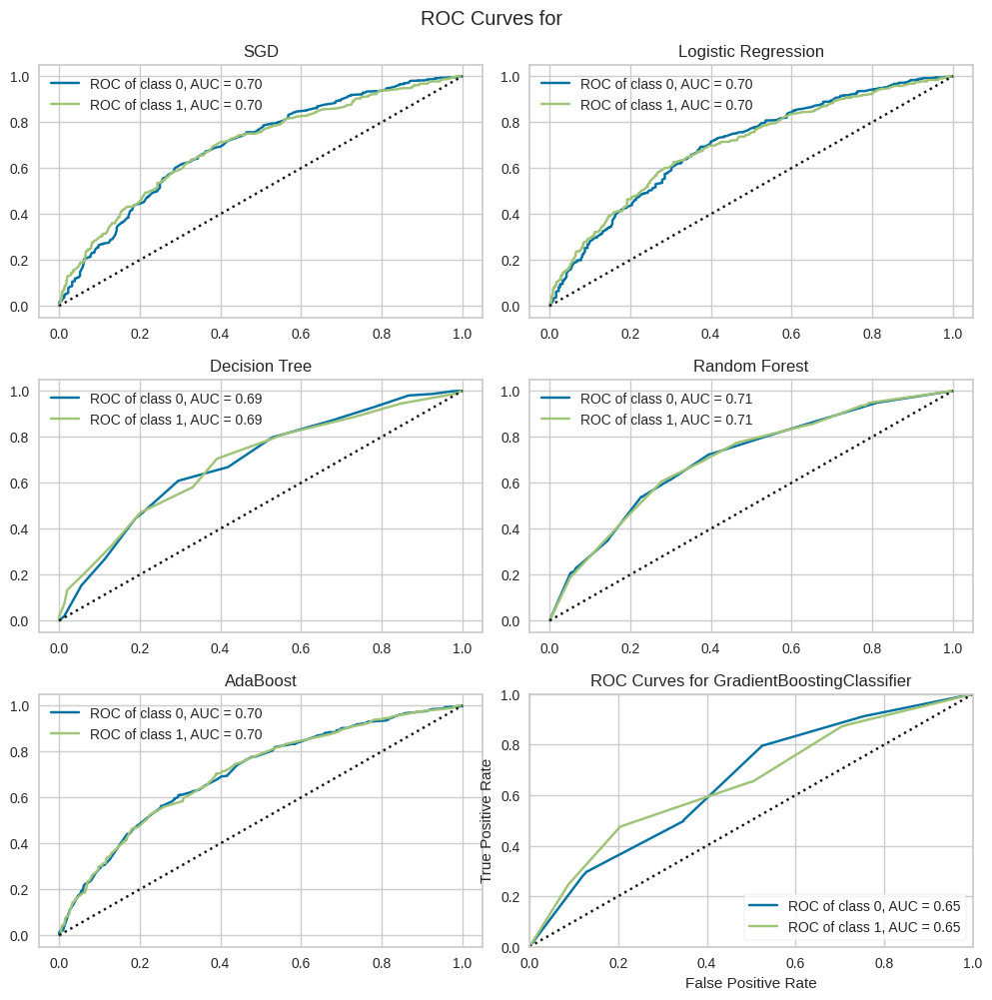

<AxesSubplot: title={'center': 'ROC Curves for GradientBoostingClassifier'}, xlabel='False Positive Rate', ylabel='True Positive Rate'>

In [51]:
ROC_curves(estimators_multiclass2_sel, X_train2_sel, y_train2_sel, X_test2_sel, y_test2_sel, np.unique(y_demo2), name = 'all', features_selected = True, features = features2_sel, feature_sel_type = 'SFS')


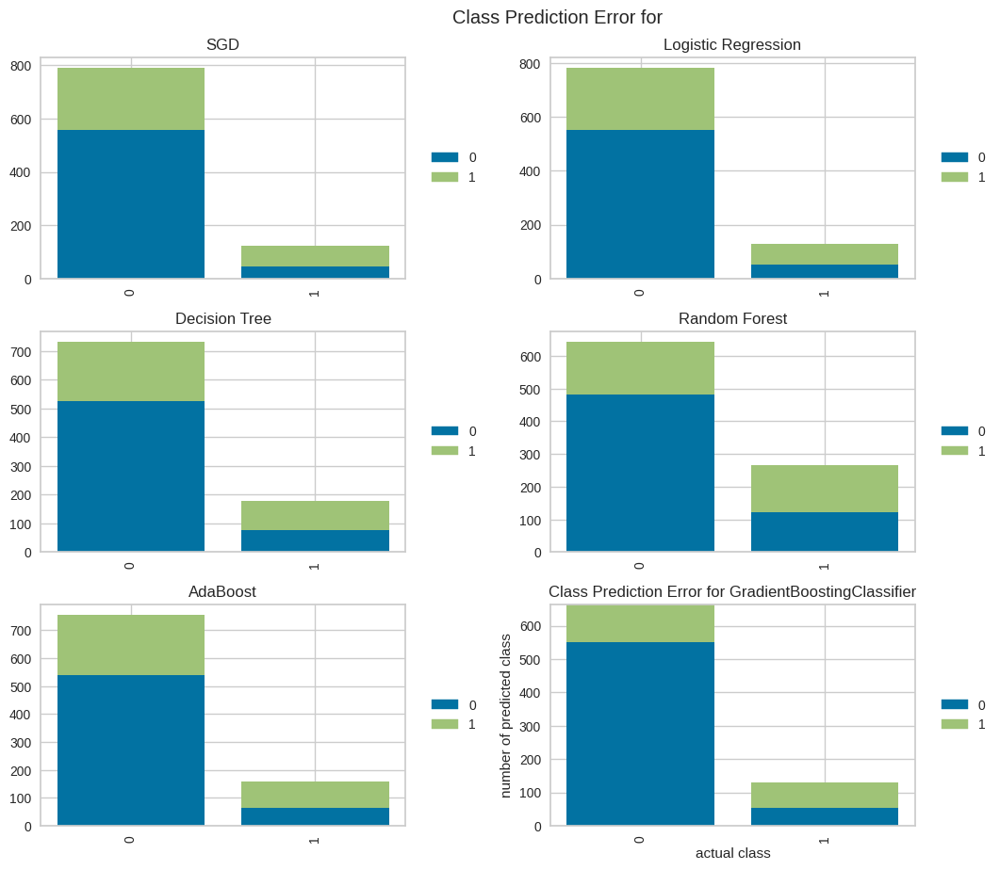

<AxesSubplot: title={'center': 'Class Prediction Error for GradientBoostingClassifier'}, xlabel='actual class', ylabel='number of predicted class'>

In [52]:
prediction_error_plot(estimators_multiclass2_sel, X_train2_sel, y_train2_sel, X_test2_sel, y_test2_sel, np.unique(y_demo2), name = 'all', features_selected = True, features = features2_sel, feature_sel_type = 'SFS')


#### With feature selection (by Recursive feature elimination with cross-validation - RFECV) 

[INFO] Performing Grid-Search CV ---- SGD
[SGD] Features selected: Index(['height', 'weight', 'body_fat', 'gender_male', 'body_type_strong',
       'body_type_thin'],
      dtype='object')
[SGD] Features importances: [0.001986   0.00236804 0.00645037 0.00283376 0.00185182 0.00068516]


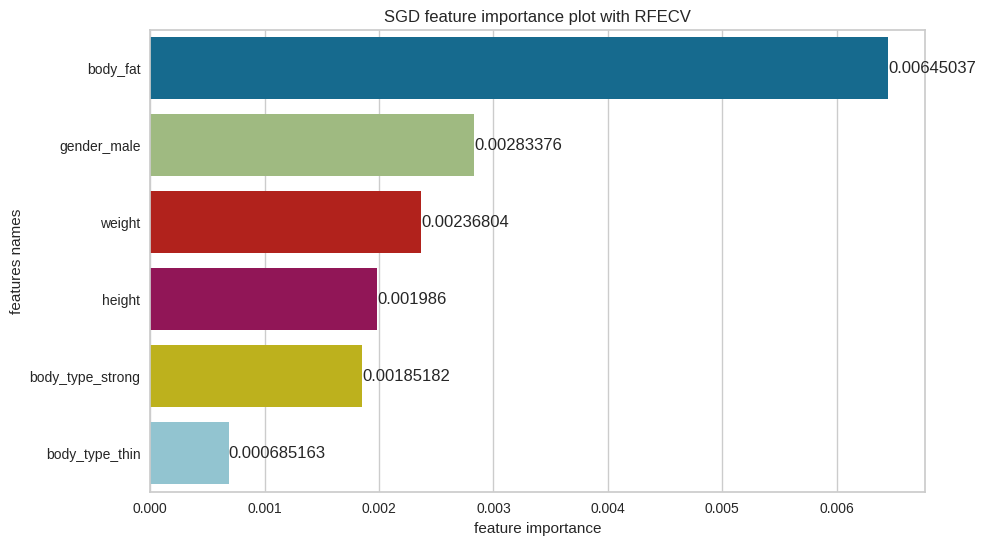

[SGD] Best parameters are {'alpha': 0.000505, 'eta0': 0.0001, 'learning_rate': 'invscaling', 'penalty': 'l1', 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Logistic Regression
[Logistic Regression] Features selected: Index(['body_fat'], dtype='object')
[Logistic Regression] Features importances: [0.59597874]


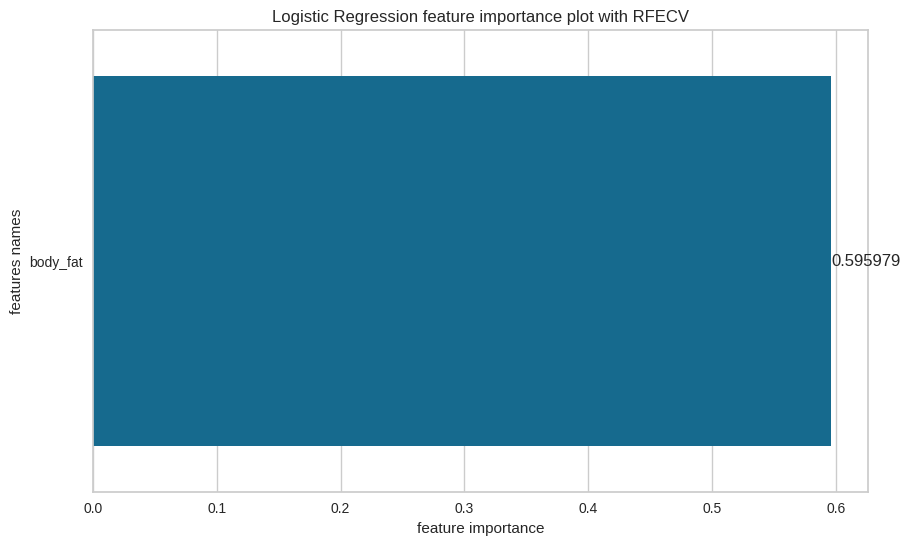

[Logistic Regression] Best parameters are {'C': 1, 'penalty': 'l1', 'random_state': 42, 'solver': 'liblinear'}
[INFO] Performing Grid-Search CV ---- Decision Tree
[Decision Tree] Features selected: Index(['weight'], dtype='object')
[Decision Tree] Features importances: [1.0]


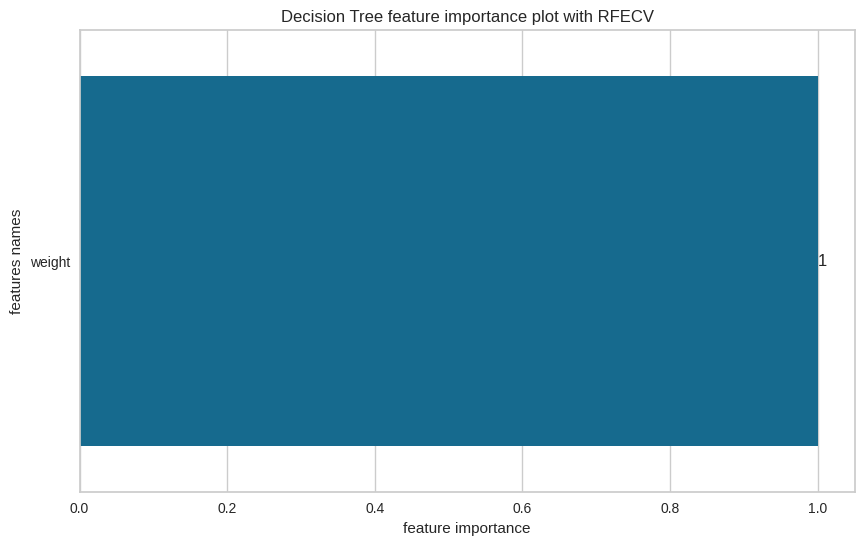

[Decision Tree] Best parameters are {'criterion': 'gini', 'max_depth': 3, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Random Forest
[Random Forest] Features selected: Index(['weight'], dtype='object')
[Random Forest] Features importances: [1.0]


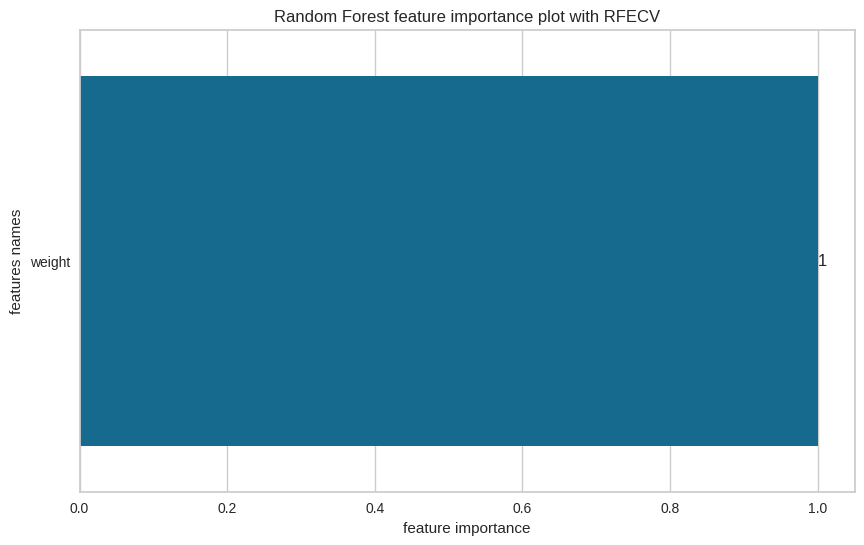

[Random Forest] Best parameters are {'criterion': 'gini', 'max_depth': 3, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- AdaBoost
[AdaBoost] Features selected: Index(['height', 'weight', 'body_fat'], dtype='object')
[AdaBoost] Features importances: [0.20173272919585356, 0.12352908633063656, 0.6747381844735099]


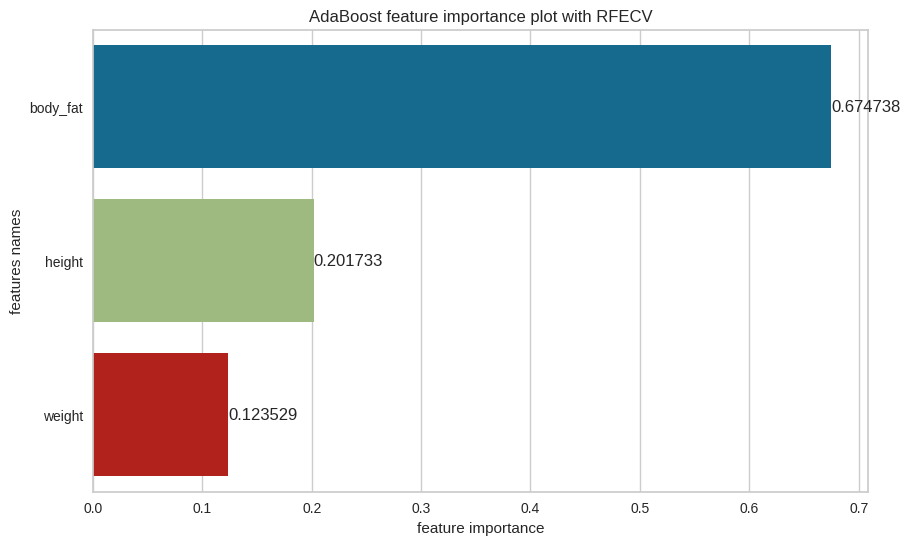

[AdaBoost] Best parameters are {'base_estimator': DecisionTreeClassifier(max_depth=3), 'learning_rate': 0.025, 'n_estimators': 40, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- GradientBoost
[GradientBoost] Features selected: Index(['body_fat'], dtype='object')
[GradientBoost] Features importances: [1.0]


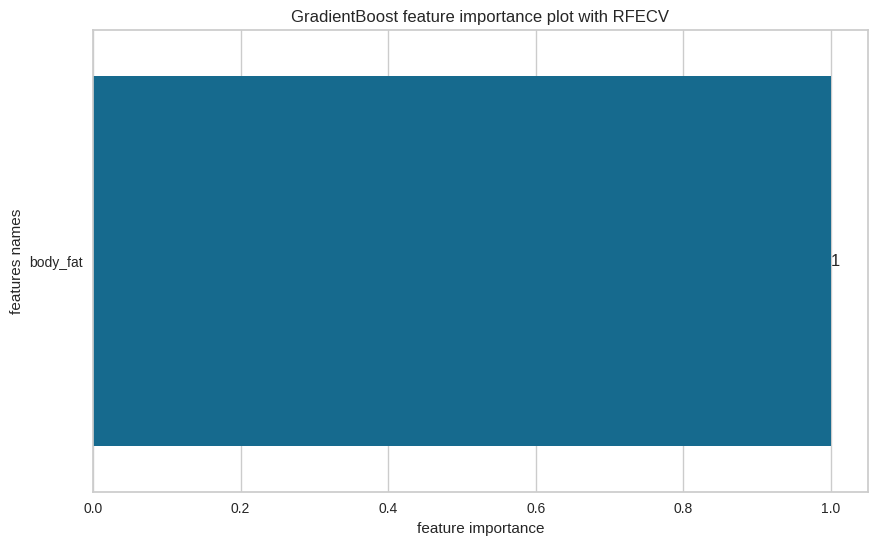

[GradientBoost] Best parameters are {'criterion': 'friedman_mse', 'learning_rate': 0.075, 'loss': 'deviance', 'max_depth': 3, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'n_estimators': 15, 'random_state': 42, 'subsample': 0.85}


In [179]:
estimators_multiclass2_sel_rfecv, X_test2_sel_rfecv, y_test2_sel_rfecv, X_train2_sel_rfecv, y_train2_sel_rfecv, X_test_inv2_sel_rfecv, features2_sel_rfecv = train(X_demo2, y_demo2, 
                                                         grid_params_multiclass, 
                                                         seed, feature_selection = True, 
                                                         feature_sel_type = 'RFECV')

In [180]:
evaluation_table2_sel_rfecv = evaluate_multiclass(estimators_multiclass2_sel_rfecv, X_test2_sel_rfecv, y_test2_sel_rfecv, no_of_labels = 2, features_selected = True, features = features2_sel_rfecv, feature_sel_type = 'RFECV')


In [181]:
evaluation_table2_sel_rfecv

,Overall Accuracy,Balanced Accuracy,Adj Balanced Accuracy,Precision,Recall,Cohen's kappa,Mathews Correlation Coefficient
SGD,0.72,0.63,0.25,0.65,0.35,0.28,0.31
Logistic Regression,0.69,0.58,0.16,0.59,0.25,0.19,0.22
Decision Tree,0.68,0.54,0.07,0.69,0.09,0.09,0.16
Random Forest,0.66,0.50,0.00,0.00,0.00,0.00,0.00
AdaBoost,0.69,0.59,0.18,0.61,0.26,0.21,0.24
GradientBoost,0.69,0.58,0.16,0.59,0.25,0.19,0.22


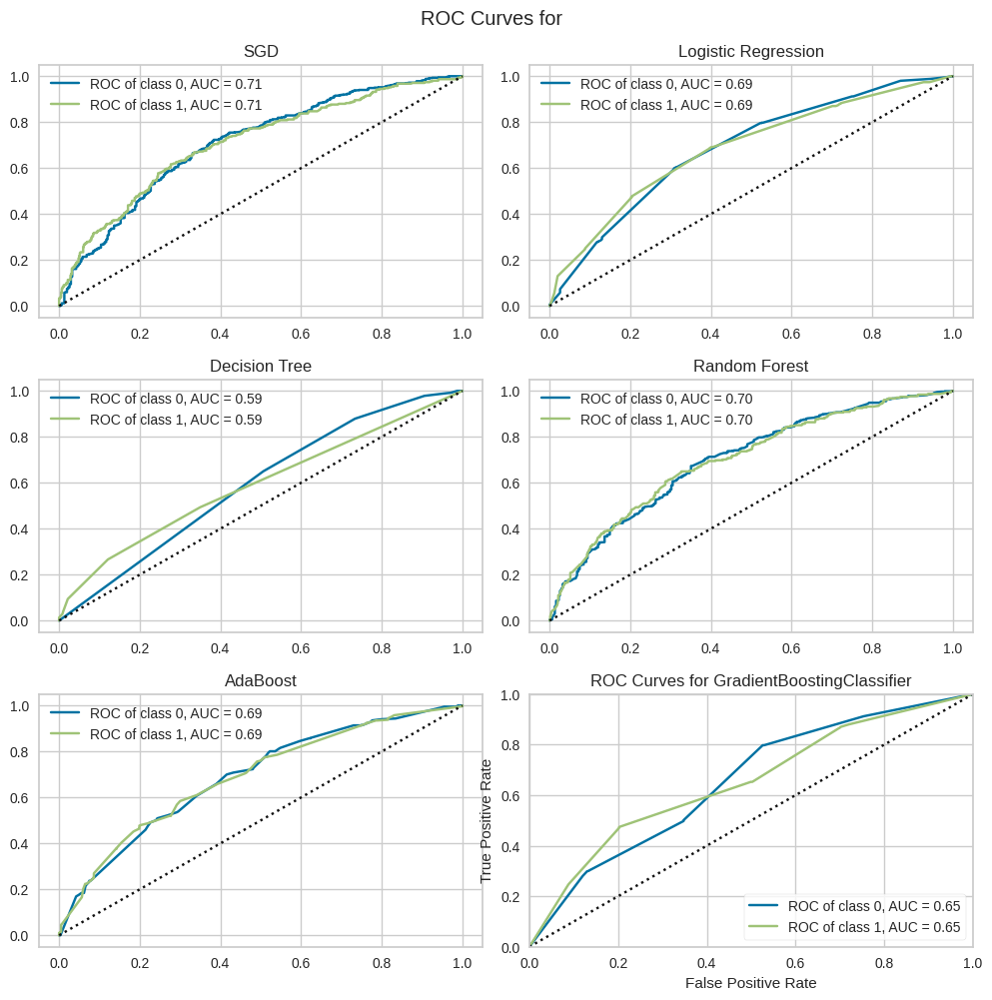

<AxesSubplot: title={'center': 'ROC Curves for GradientBoostingClassifier'}, xlabel='False Positive Rate', ylabel='True Positive Rate'>

In [56]:
ROC_curves(estimators_multiclass2_sel_rfecv, X_train2_sel_rfecv, y_train2_sel_rfecv, X_test2_sel_rfecv, y_test2_sel_rfecv, np.unique(y_demo2), name = 'all', features_selected = True, features = features2_sel_rfecv, feature_sel_type = 'RFECV')


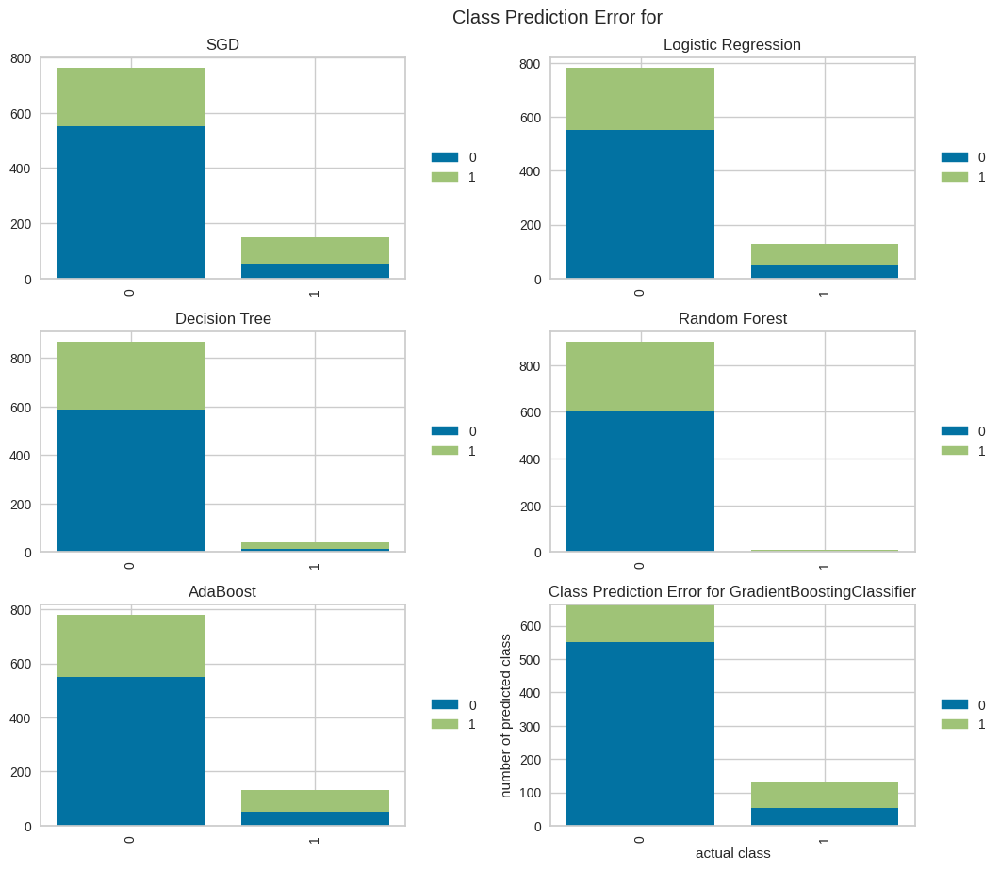

<AxesSubplot: title={'center': 'Class Prediction Error for GradientBoostingClassifier'}, xlabel='actual class', ylabel='number of predicted class'>

In [57]:
prediction_error_plot(estimators_multiclass2_sel_rfecv, X_train2_sel_rfecv, y_train2_sel_rfecv, X_test2_sel_rfecv, y_test2_sel_rfecv, np.unique(y_demo2), name = 'all', features_selected = True, features = features2_sel_rfecv, feature_sel_type = 'RFECV')


#### With feature selection (by SelectFromModel) 

[INFO] Performing Grid-Search CV ---- SGD
[SGD] Features selected: Index(['weight', 'body_fat', 'gender_male'], dtype='object')
[SGD] Features importances: [0.15213845 0.42442281 0.26355272]


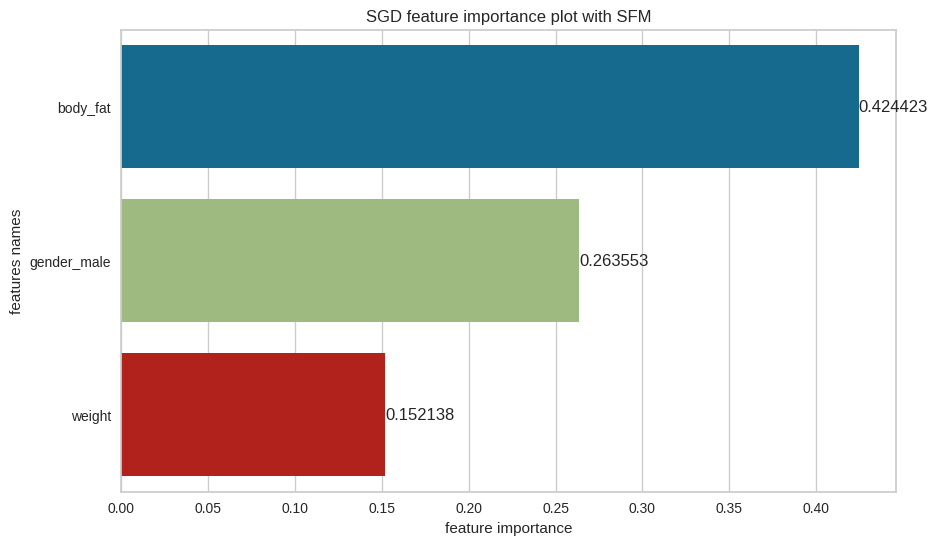

[SGD] Best parameters are {'alpha': 0.0002575, 'eta0': 0.0001, 'learning_rate': 'adaptive', 'penalty': 'l1', 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Logistic Regression
[Logistic Regression] Features selected: Index(['body_fat', 'gender_male'], dtype='object')
[Logistic Regression] Features importances: [0.64729184 0.38040244]


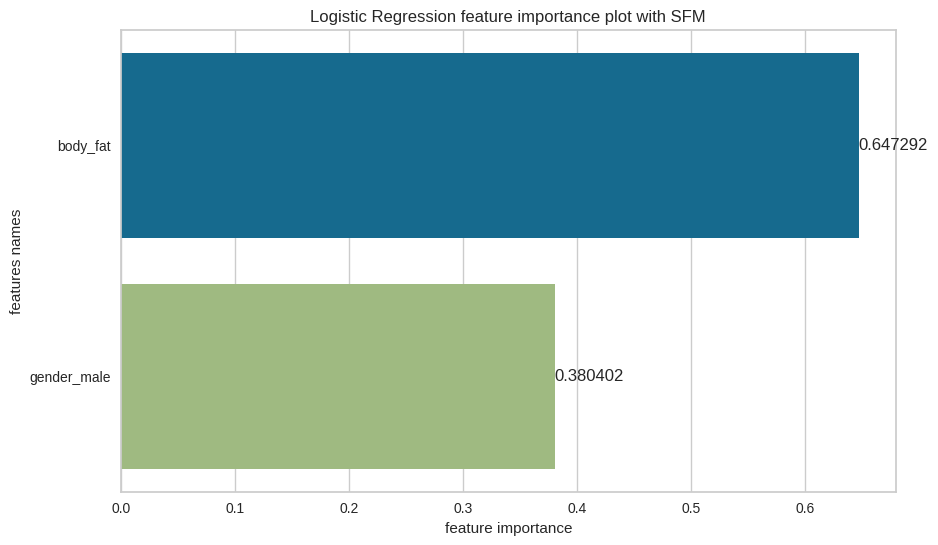

[Logistic Regression] Best parameters are {'C': 1, 'penalty': 'l1', 'random_state': 42, 'solver': 'liblinear'}
[INFO] Performing Grid-Search CV ---- Decision Tree
[Decision Tree] Features selected: Index(['height', 'weight', 'body_fat'], dtype='object')
[Decision Tree] Features importances: [0.13959890664531305, 0.17449171309014955, 0.6859093802645374]


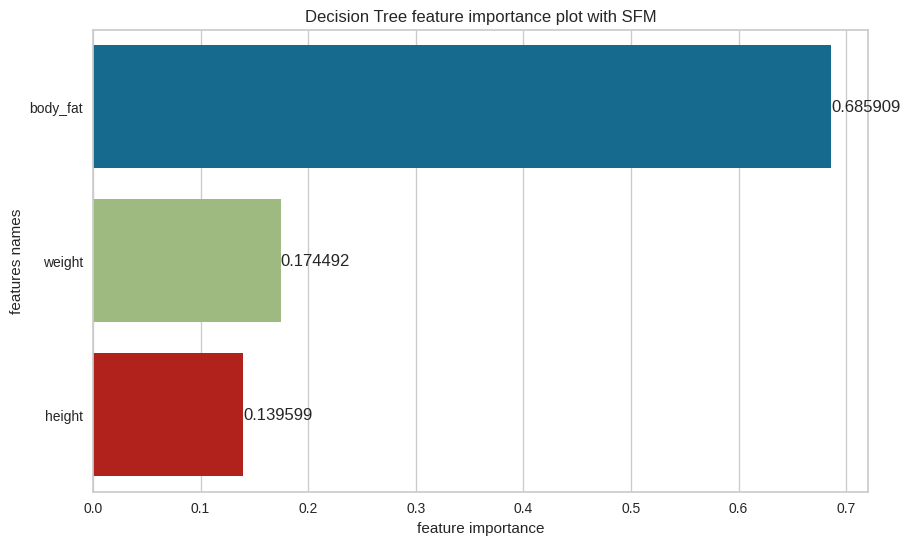

[Decision Tree] Best parameters are {'criterion': 'entropy', 'max_depth': 3, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Random Forest
[Random Forest] Features selected: Index(['height', 'weight', 'body_fat'], dtype='object')
[Random Forest] Features importances: [0.28169327901327457, 0.28580059159248034, 0.43250612939424504]


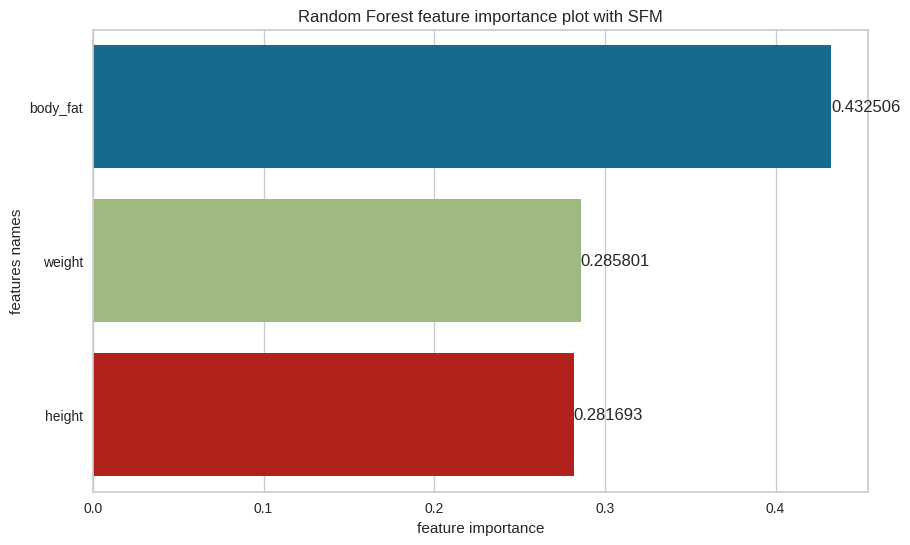

[Random Forest] Best parameters are {'criterion': 'gini', 'max_depth': 3, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- AdaBoost
[AdaBoost] Features selected: Index(['height', 'weight', 'body_fat'], dtype='object')
[AdaBoost] Features importances: [0.20173272919585356, 0.12352908633063656, 0.6747381844735099]


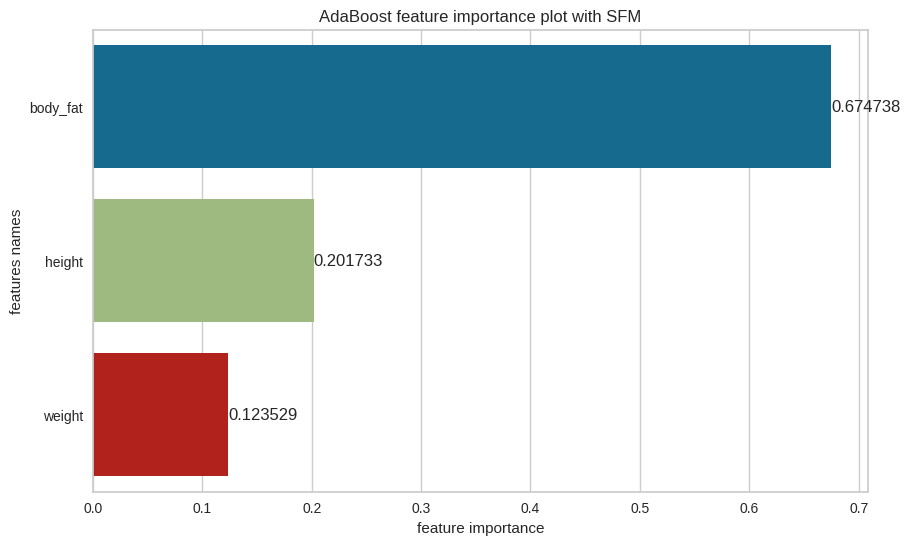

[AdaBoost] Best parameters are {'base_estimator': DecisionTreeClassifier(max_depth=3), 'learning_rate': 0.025, 'n_estimators': 40, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- GradientBoost
[GradientBoost] Features selected: Index(['height', 'weight', 'body_fat'], dtype='object')
[GradientBoost] Features importances: [0.14290317572441952, 0.15480834897136364, 0.7022884753042169]


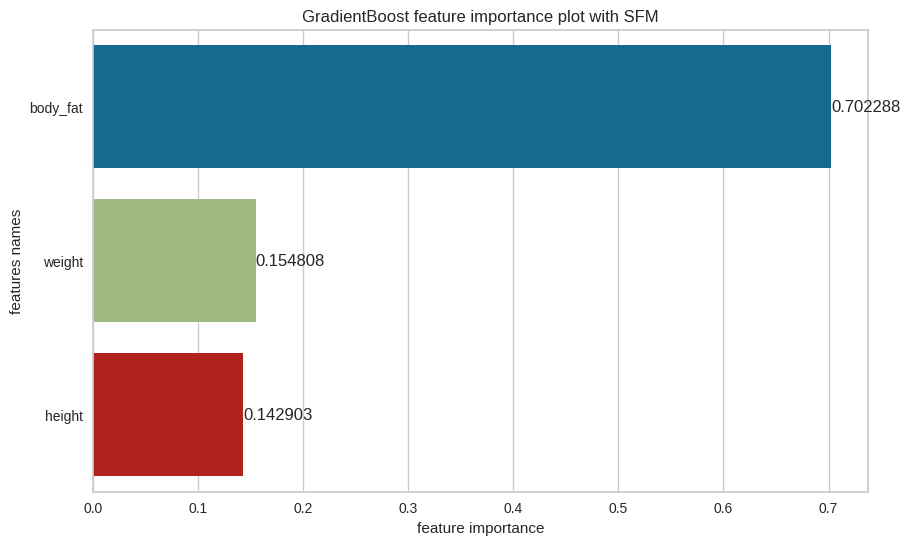

[GradientBoost] Best parameters are {'criterion': 'friedman_mse', 'learning_rate': 0.075, 'loss': 'deviance', 'max_depth': 5, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'n_estimators': 15, 'random_state': 42, 'subsample': 0.85}


In [182]:
estimators_multiclass2_sel_sfm, X_test2_sel_sfm, y_test2_sel_sfm, X_train2_sel_sfm, y_train2_sel_sfm, X_test_inv2_sel_sfm, features2_sel_sfm = train(X_demo2, y_demo2, 
                                                         grid_params_multiclass, 
                                                         seed, feature_selection = True, 
                                                         feature_sel_type = 'SFM')

In [183]:
evaluation_table2_sel_sfm = evaluate_multiclass(estimators_multiclass2_sel_sfm, X_test2_sel_sfm, y_test2_sel_sfm, no_of_labels = 2, features_selected = True, features = features2_sel_sfm, feature_sel_type = 'SFM')


In [184]:
evaluation_table2_sel_sfm

,Overall Accuracy,Balanced Accuracy,Adj Balanced Accuracy,Precision,Recall,Cohen's kappa,Mathews Correlation Coefficient
SGD,0.70,0.57,0.15,0.69,0.19,0.18,0.24
Logistic Regression,0.71,0.60,0.21,0.67,0.28,0.24,0.28
Decision Tree,0.70,0.62,0.23,0.59,0.36,0.26,0.27
Random Forest,0.66,0.50,0.00,0.00,0.00,0.00,0.00
AdaBoost,0.69,0.59,0.18,0.61,0.26,0.21,0.24
GradientBoost,0.67,0.52,0.04,0.76,0.04,0.05,0.12


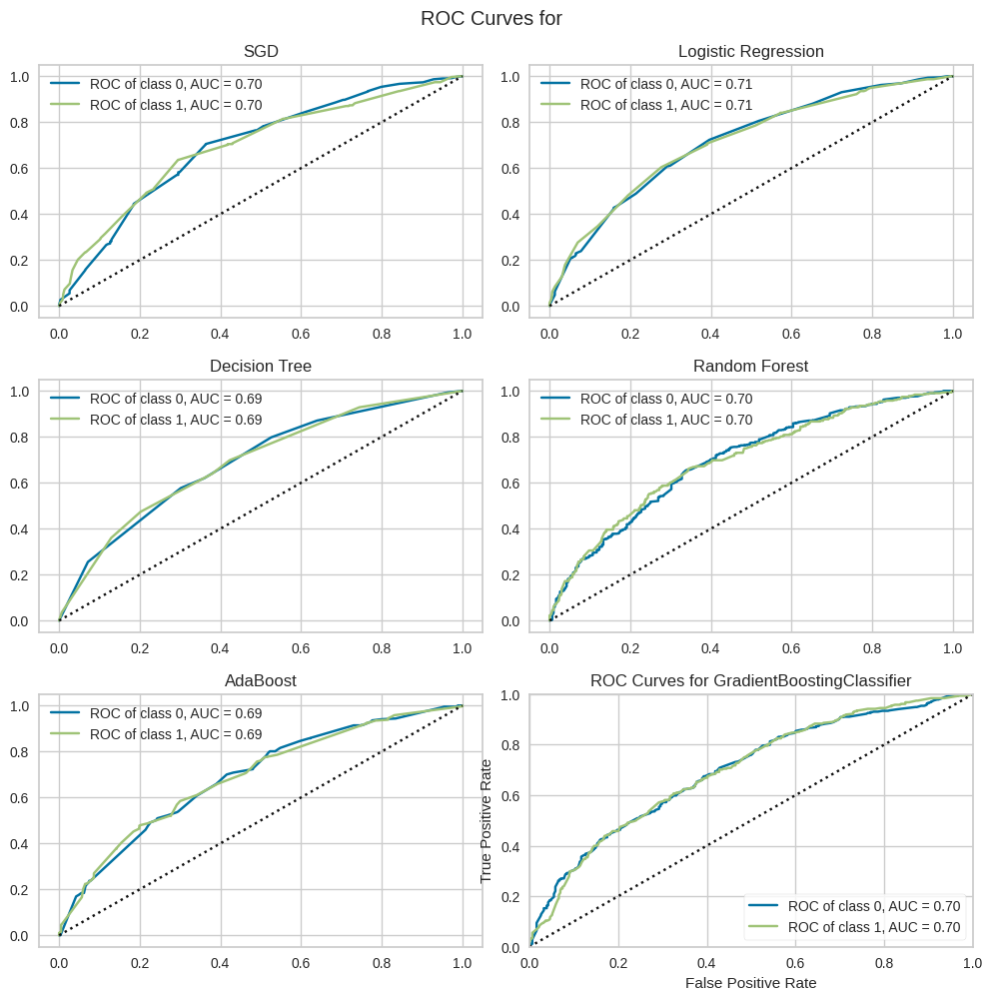

<AxesSubplot: title={'center': 'ROC Curves for GradientBoostingClassifier'}, xlabel='False Positive Rate', ylabel='True Positive Rate'>

In [61]:
ROC_curves(estimators_multiclass2_sel_sfm, X_train2_sel_sfm, y_train2_sel_sfm, X_test2_sel_sfm, y_test2_sel_sfm, np.unique(y_demo2), name = 'all', features_selected = True, features = features2_sel_sfm, feature_sel_type = 'SFM')


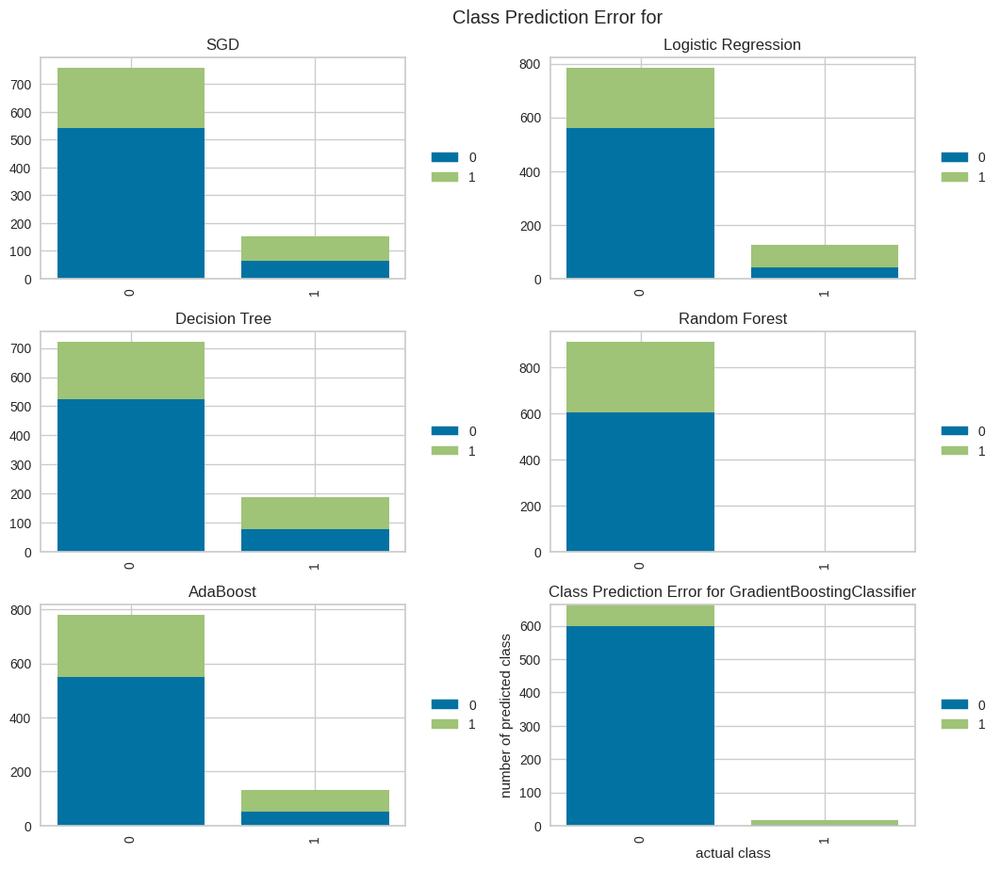

<AxesSubplot: title={'center': 'Class Prediction Error for GradientBoostingClassifier'}, xlabel='actual class', ylabel='number of predicted class'>

In [62]:
prediction_error_plot(estimators_multiclass2_sel_sfm, X_train2_sel_sfm, y_train2_sel_sfm, X_test2_sel_sfm, y_test2_sel_sfm, np.unique(y_demo2), name = 'all', features_selected = True, features = features2_sel_sfm, feature_sel_type = 'SFM')


### Predicting activity level with BMI and clusters (3 levels)

In [19]:
X_demo_clus = df_users_only.loc[:, ['gender', 'body_type', 'newsletter_subscription', 
                                             'BMI', 'body_fat', 'cluster']]

# X_demo.replace({'male':1, 'female':0, 'False': 0, 'True': 1, 'thin': 0, 'mid': 1, 'strong': 2}, inplace = True)

# X_demo = pd.DataFrame()

cat_cols = ['gender', 'body_type', 'newsletter_subscription', 'cluster']
X_demo_clus = pd.get_dummies(X_demo_clus, columns = cat_cols, drop_first = True)

    

y_demo_clus = []

for act in df_users_only['activity_level']:
    if act == 'active':
        y_demo_clus.append(0)
    elif act == 'very active':
        y_demo_clus.append(1)
    elif act == 'sedentary':
        y_demo_clus.append(2)

y_demo_clus = np.array(y_demo_clus)

y_dem_clus = pd.DataFrame(y_demo_clus, columns = ['activity_level'])

[INFO] Performing Grid-Search CV ---- SGD
[SGD] Features importances: [0.69064175 0.64112434 0.22346849 0.335172   0.32168647 0.11393441
 0.32399952 0.09035748 0.73041942 0.23837165 0.04342665 0.30084945
 0.08084335 0.19584679 0.36855772 0.03011587 0.49377818]


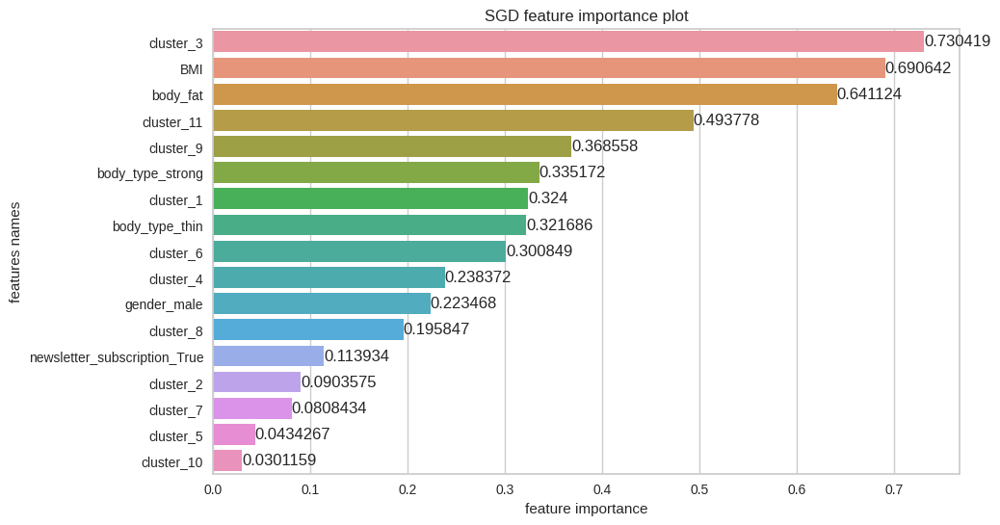

[SGD] Best parameters are {'alpha': 0.0007525, 'eta0': 0.0001, 'learning_rate': 'optimal', 'penalty': 'l2', 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Logistic Regression
[Logistic Regression] Features importances: [0.51761686 1.56155304 0.4937438  0.36492251 0.29910858 0.31350829
 0.30763066 0.26807305 0.367109   0.22238394 0.16159145 0.22734865
 0.21402982 0.45083519 0.23674001 0.1944105  0.15803357]


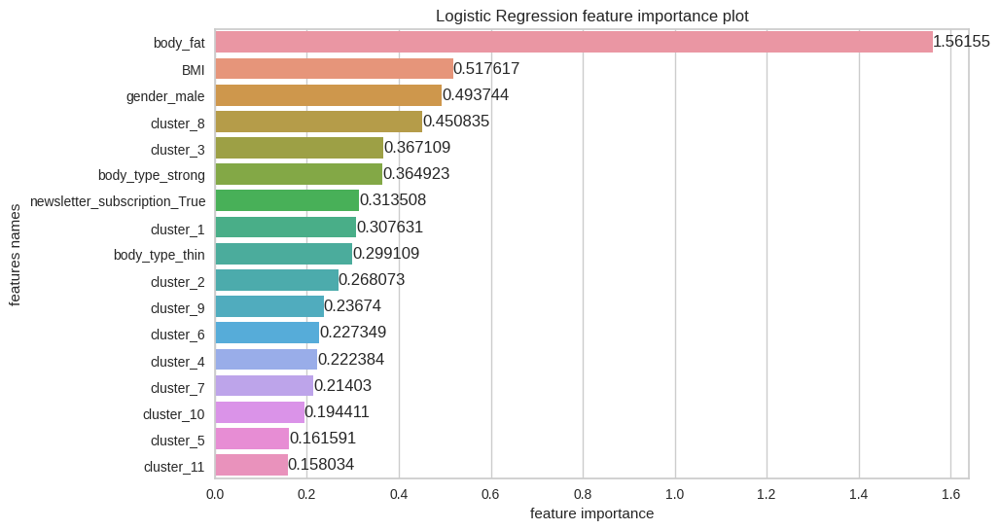

[Logistic Regression] Best parameters are {'C': 1, 'penalty': 'l2', 'random_state': 42, 'solver': 'liblinear'}
[INFO] Performing Grid-Search CV ---- Decision Tree
[Decision Tree] Features importances: [0.2322910137599923, 0.5170844094552232, 0.18139941100033435, 0.0, 0.0, 0.0, 0.06104759792982645, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.008177567854623646]


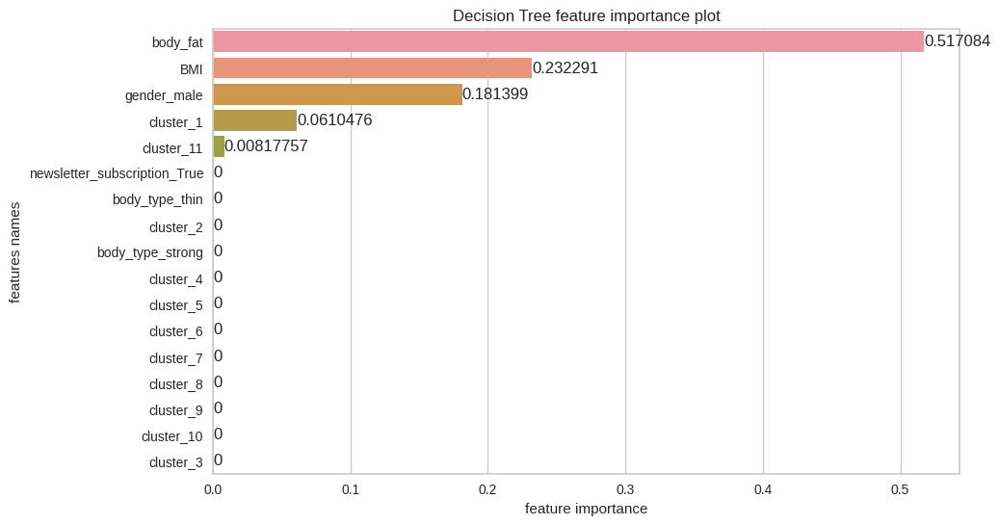

[Decision Tree] Best parameters are {'criterion': 'gini', 'max_depth': 3, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Random Forest
[Random Forest] Features importances: [0.29887650319513404, 0.3566081373077832, 0.19804504810002863, 0.0, 0.07452427285543665, 0.009604340451089691, 0.0, 0.06234169809052776, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


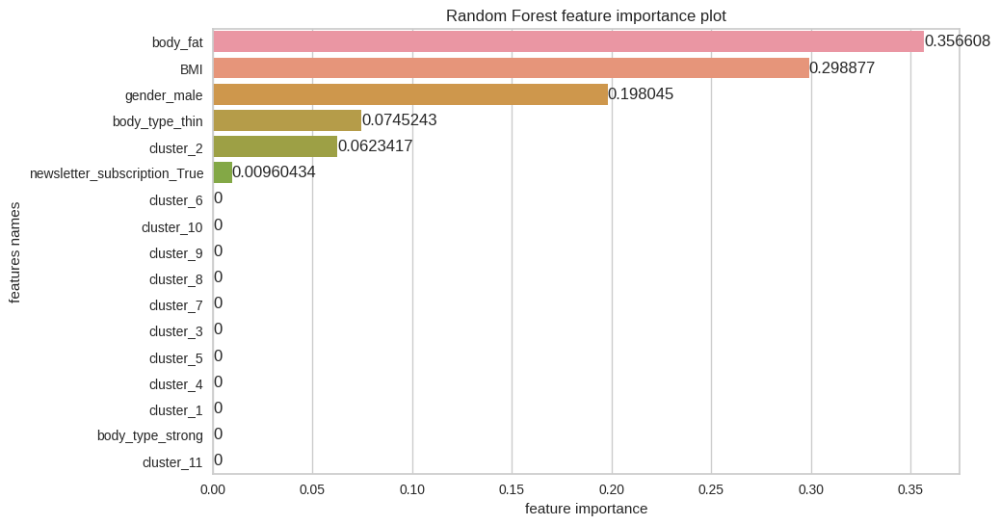

[Random Forest] Best parameters are {'criterion': 'gini', 'max_depth': 3, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- AdaBoost
[AdaBoost] Features importances: [0.15337826692792317, 0.6325347324554567, 0.21408700061662045, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


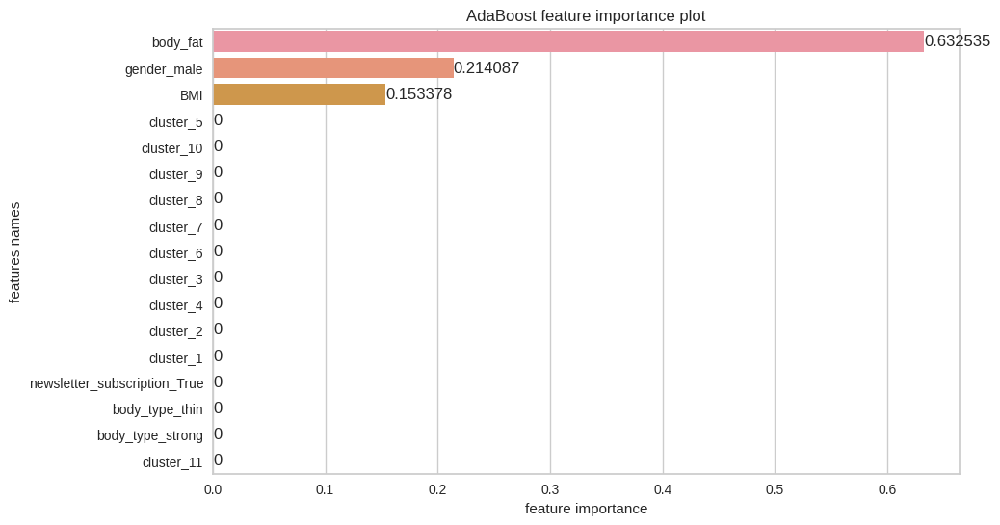

[AdaBoost] Best parameters are {'base_estimator': DecisionTreeClassifier(max_depth=2), 'learning_rate': 0.025, 'n_estimators': 20, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- GradientBoost
[GradientBoost] Features importances: [0.42148546511220625, 0.31982107614750144, 0.12450508125285882, 0.0, 0.041024432115662354, 0.01429538415360138, 0.0, 0.04062811292334432, 0.0, 0.023242443584510303, 0.014998004710315168, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


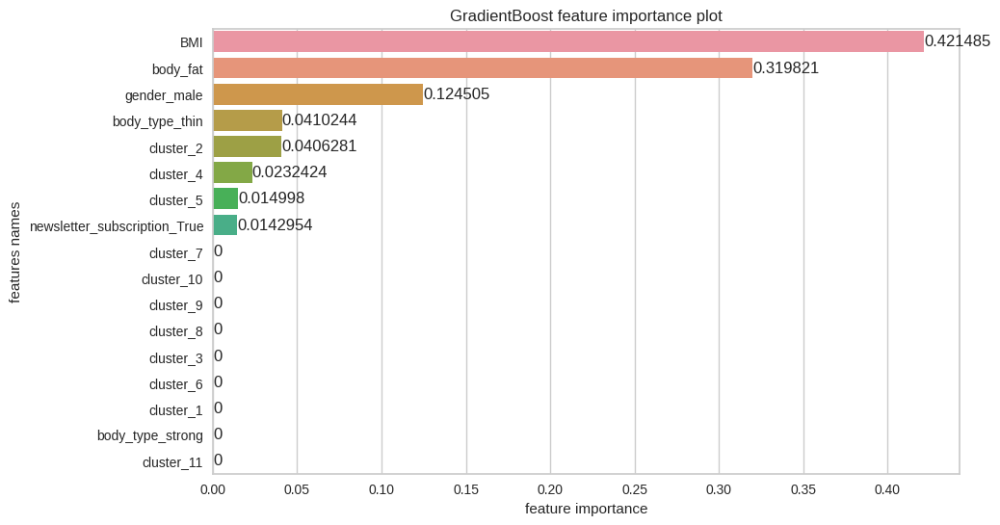

[GradientBoost] Best parameters are {'criterion': 'friedman_mse', 'learning_rate': 0.075, 'loss': 'deviance', 'max_depth': 8, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'n_estimators': 15, 'random_state': 42, 'subsample': 0.85}


In [20]:
estimators_multiclass_clus, X_test_clus, y_test_clus, X_train_clus, y_train_clus, X_test_inv_clus, features_try_clus = train(X_demo_clus, y_demo_clus, 
                                                         grid_params_multiclass, 
                                                         seed)

In [21]:
evaluation_table_clus = evaluate_multiclass(estimators_multiclass_clus, X_test_clus, y_test_clus, no_of_labels = 3, features_selected = False, features = features_try_clus)


In [22]:
evaluation_table_clus

,Overall Accuracy,Balanced Accuracy,Adj Balanced Accuracy,Precision micro,Precision macro,Precision weighted,Recall micro,Recall macro,Recall weighted,Cohen's kappa,Mathews Correlation Coefficient
SGD,0.58,0.38,0.06,0.58,0.38,0.52,0.58,0.38,0.58,0.11,0.14
Logistic Regression,0.60,0.40,0.10,0.60,0.40,0.54,0.60,0.40,0.60,0.17,0.20
Decision Tree,0.58,0.38,0.06,0.58,0.38,0.52,0.58,0.38,0.58,0.11,0.14
Random Forest,0.58,0.36,0.04,0.58,0.43,0.56,0.58,0.36,0.58,0.07,0.14
AdaBoost,0.59,0.38,0.07,0.59,0.39,0.53,0.59,0.38,0.59,0.11,0.15
GradientBoost,0.59,0.37,0.06,0.59,0.41,0.54,0.59,0.37,0.59,0.10,0.15


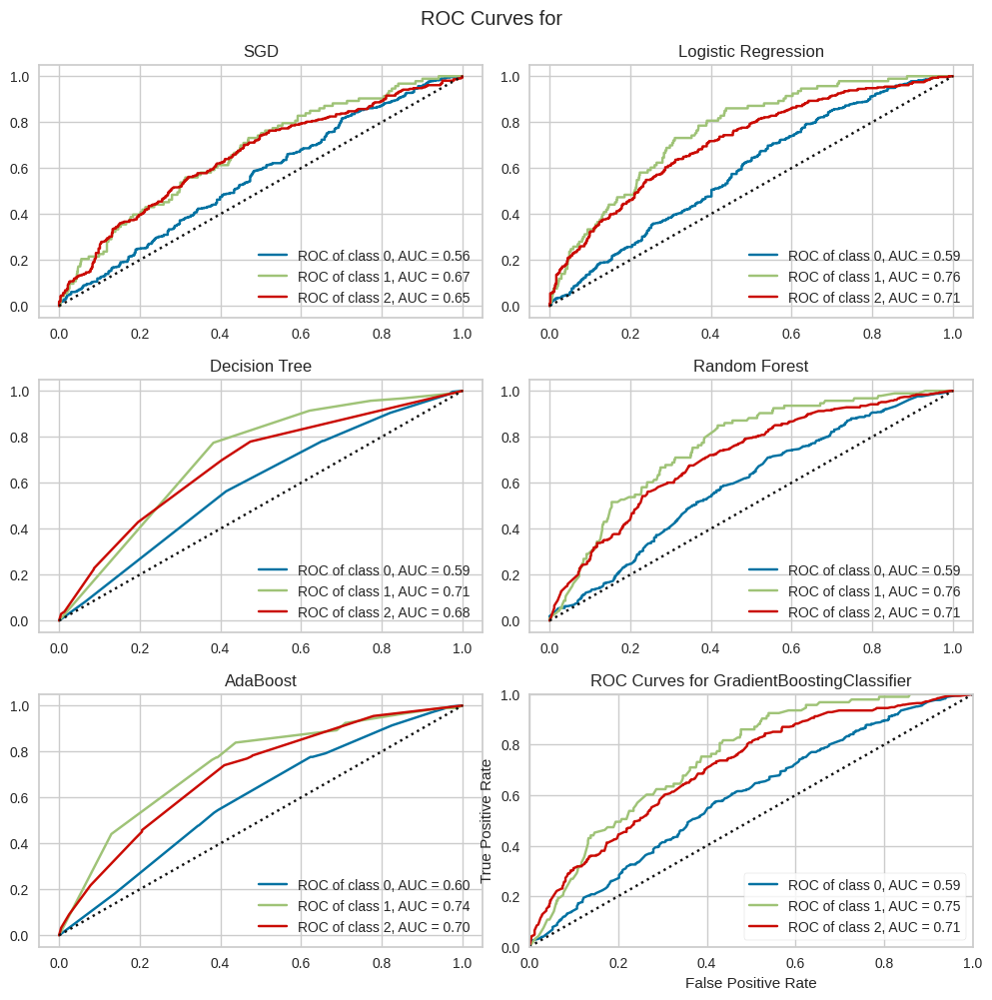

<AxesSubplot: title={'center': 'ROC Curves for GradientBoostingClassifier'}, xlabel='False Positive Rate', ylabel='True Positive Rate'>

In [23]:
ROC_curves(estimators_multiclass_clus, X_train_clus, y_train_clus, X_test_clus, y_test_clus, 
           np.unique(y_demo_clus), 
           name = 'all', features_selected = False, features = features_try_clus)


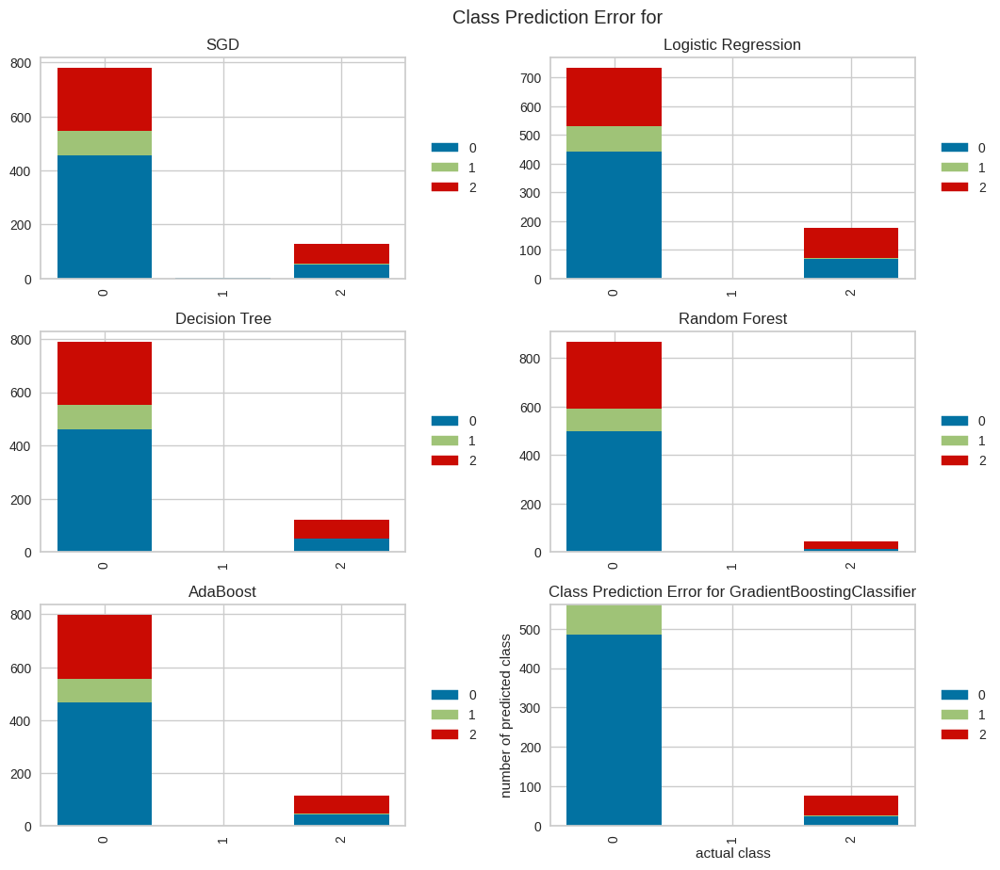

<AxesSubplot: title={'center': 'Class Prediction Error for GradientBoostingClassifier'}, xlabel='actual class', ylabel='number of predicted class'>

In [24]:
prediction_error_plot(estimators_multiclass_clus, X_train_clus, y_train_clus, X_test_clus, y_test_clus, 
                      np.unique(y_demo_clus), name =  'all', features_selected = False, 
                      features = features_try_clus)

#### With feature selection (Univariate - Kruskall - Wallis test (instead of ANOVA) and chi-square)

[INFO] Performing Grid-Search CV ---- SGD
[SGD] Features selected: Index(['BMI', 'body_fat'], dtype='object')
[SGD] Features importances: [0.42203414 0.70319576]


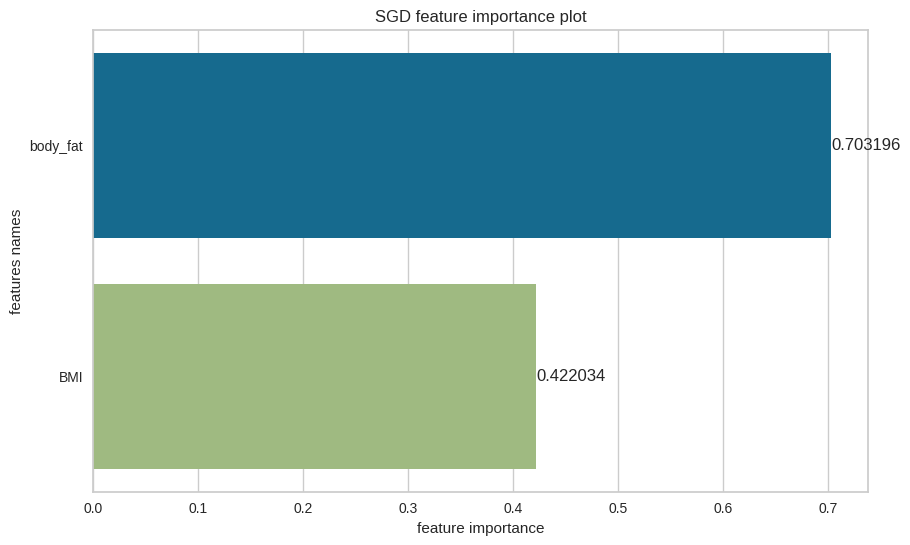

[SGD] Best parameters are {'alpha': 0.0007525, 'eta0': 0.0001, 'learning_rate': 'adaptive', 'penalty': 'elasticnet', 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Logistic Regression
[Logistic Regression] Features selected: Index(['BMI', 'body_fat'], dtype='object')
[Logistic Regression] Features importances: [0.42041292 1.72189987]


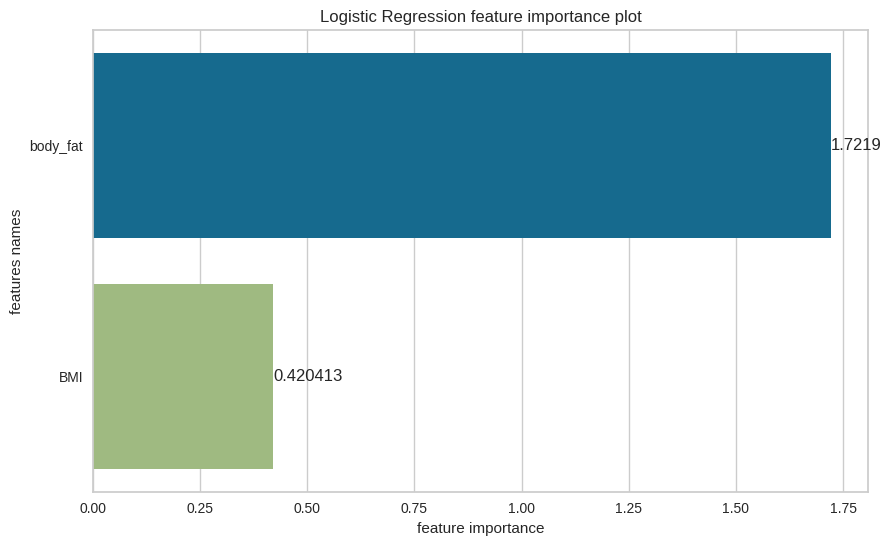

[Logistic Regression] Best parameters are {'C': 1, 'penalty': 'l1', 'random_state': 42, 'solver': 'liblinear'}
[INFO] Performing Grid-Search CV ---- Decision Tree
[Decision Tree] Features selected: Index(['BMI', 'body_fat'], dtype='object')
[Decision Tree] Features importances: [0.3416074952516416, 0.6583925047483584]


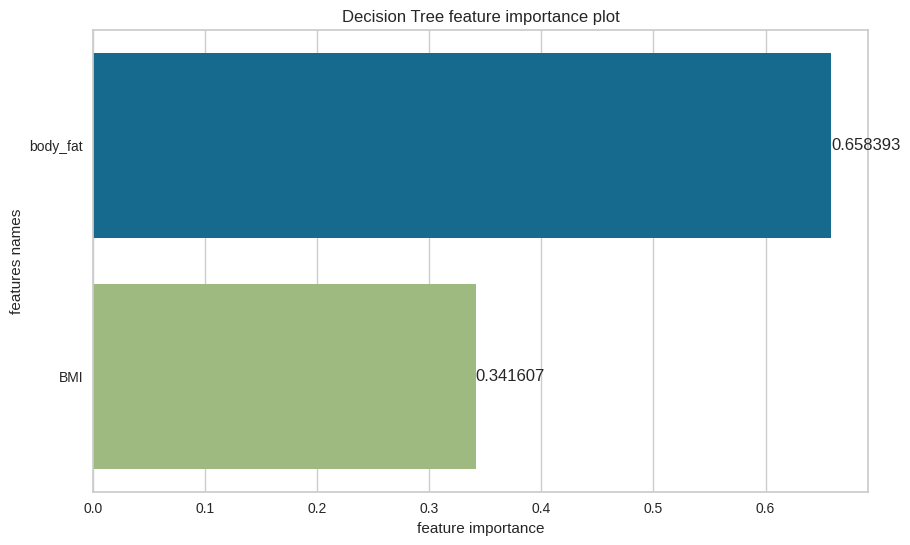

[Decision Tree] Best parameters are {'criterion': 'gini', 'max_depth': 3, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Random Forest
[Random Forest] Features selected: Index(['BMI', 'body_fat'], dtype='object')
[Random Forest] Features importances: [0.4200589547108472, 0.5799410452891528]


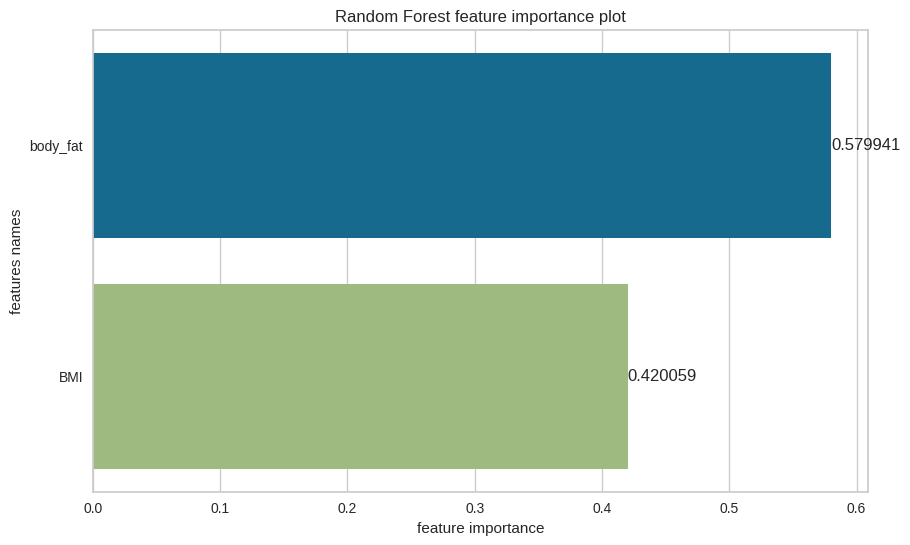

[Random Forest] Best parameters are {'criterion': 'entropy', 'max_depth': 3, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.5, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- AdaBoost
[AdaBoost] Features selected: Index(['BMI', 'body_fat'], dtype='object')
[AdaBoost] Features importances: [0.3839378645793551, 0.6160621354206449]


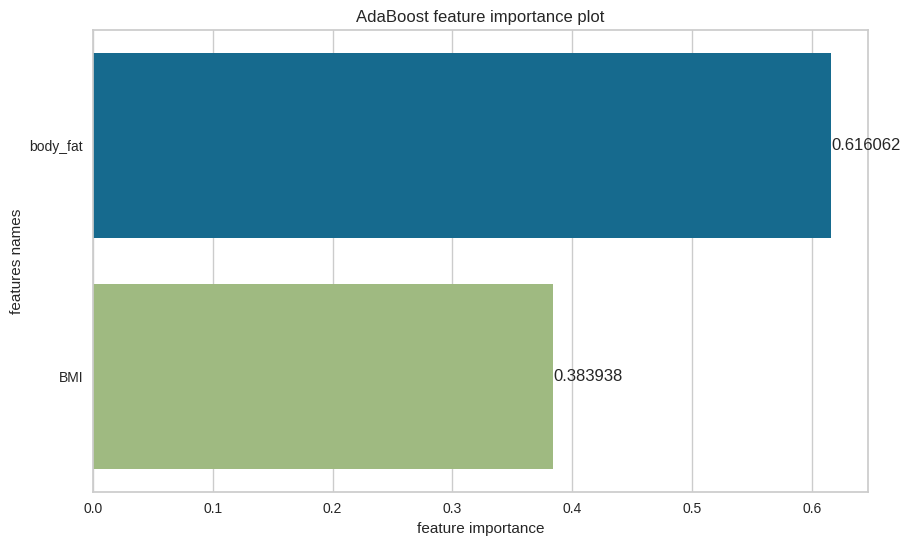

[AdaBoost] Best parameters are {'base_estimator': DecisionTreeClassifier(max_depth=2), 'learning_rate': 0.075, 'n_estimators': 20, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- GradientBoost
[GradientBoost] Features selected: Index(['BMI', 'body_fat'], dtype='object')
[GradientBoost] Features importances: [0.4802816609872357, 0.5197183390127643]


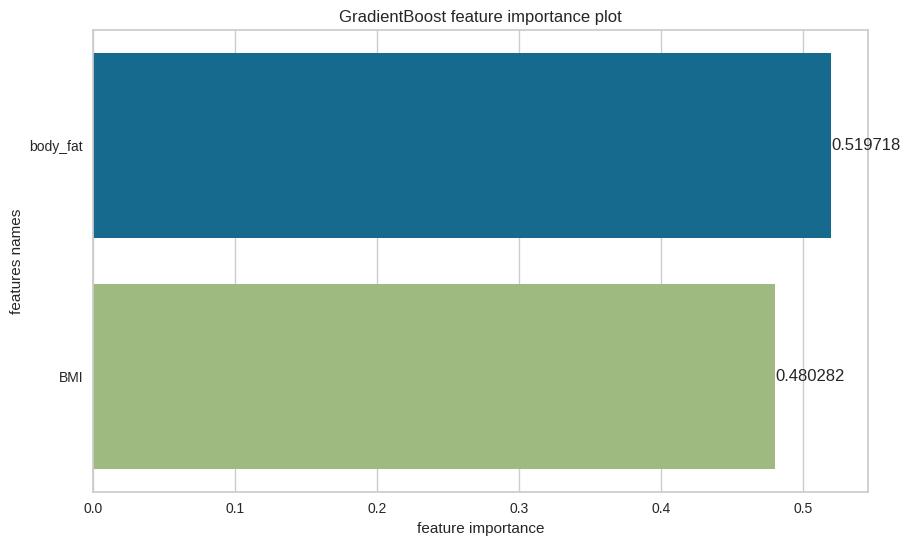

[GradientBoost] Best parameters are {'criterion': 'friedman_mse', 'learning_rate': 0.05, 'loss': 'deviance', 'max_depth': 5, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'n_estimators': 15, 'random_state': 42, 'subsample': 0.85}


,Overall Accuracy,Balanced Accuracy,Adj Balanced Accuracy,Precision micro,Precision macro,Precision weighted,Recall micro,Recall macro,Recall weighted,Cohen's kappa,Mathews Correlation Coefficient
SGD,0.58,0.37,0.05,0.58,0.39,0.53,0.58,0.37,0.58,0.09,0.14
Logistic Regression,0.58,0.37,0.06,0.58,0.39,0.52,0.58,0.37,0.58,0.10,0.14
Decision Tree,0.59,0.38,0.07,0.59,0.39,0.53,0.59,0.38,0.59,0.11,0.15
Random Forest,0.58,0.38,0.06,0.58,0.39,0.52,0.58,0.38,0.58,0.11,0.15
AdaBoost,0.59,0.38,0.07,0.59,0.39,0.53,0.59,0.38,0.59,0.11,0.15
GradientBoost,0.58,0.37,0.06,0.58,0.39,0.53,0.58,0.37,0.58,0.11,0.15


In [25]:
estimators_multiclass_s_u_clus, X_test_s_u_clus, y_test_s_u_clus, X_trains_u_clus, y_trains_u_clus, X_test_invs_u_clus, features_trys_u_clus = train(X_demo_clus, y_demo_clus, 
                                                         grid_params_multiclass, 
                                                         seed, feature_selection = True, 
                                                         feature_sel_type = 'UNI')

evaluation_table_s_u_clus = evaluate_multiclass(estimators_multiclass_s_u_clus, 
                                                X_test_s_u_clus, y_test_s_u_clus, 
                                                no_of_labels = 3, features_selected = True, 
                                                features = features_trys_u_clus, feature_sel_type = 'UNI')


evaluation_table_s_u_clus

#### With feature selection (by SequentialFeatureSelector)

In [26]:
estimators_multiclass_sel_clus, X_test_sel_clus, y_test_sel_clus, X_train_sel_clus, y_train_sel_clus, X_test_inv_sel_clus, features_sel_clus = train(X_demo_clus, y_demo_clus, 
                                                         grid_params_multiclass, 
                                                         seed, feature_selection = True, 
                                                         feature_sel_type = 'SFS')

evaluation_table_sel_clus = evaluate_multiclass(estimators_multiclass_sel_clus, X_test_sel_clus, 
                                                y_test_sel_clus, no_of_labels = 3,
                                                features_selected = True, 
                                                features = features_sel_clus, feature_sel_type = 'SFS')


evaluation_table_sel_clus

[INFO] Performing Grid-Search CV ---- SGD
[SGD] Features selected: Index(['body_fat', 'cluster_5'], dtype='object')
[SGD] Best parameters are {'alpha': 1e-05, 'eta0': 0.0001, 'learning_rate': 'invscaling', 'penalty': 'l1', 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Logistic Regression
[Logistic Regression] Features selected: Index(['BMI', 'body_fat', 'gender_male', 'body_type_strong', 'cluster_3',
       'cluster_4', 'cluster_8', 'cluster_10', 'cluster_11'],
      dtype='object')
[Logistic Regression] Best parameters are {'C': 1, 'penalty': 'l1', 'random_state': 42, 'solver': 'liblinear'}
[INFO] Performing Grid-Search CV ---- Decision Tree
[Decision Tree] Features selected: Index(['body_fat', 'body_type_thin', 'cluster_3', 'cluster_6'], dtype='object')
[Decision Tree] Best parameters are {'criterion': 'gini', 'max_depth': 6, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Random Forest
[Random Forest] Features selected: Index(['body_fat', 'body_type_thin', 'clu

,Overall Accuracy,Balanced Accuracy,Adj Balanced Accuracy,Precision micro,Precision macro,Precision weighted,Recall micro,Recall macro,Recall weighted,Cohen's kappa,Mathews Correlation Coefficient
SGD,0.59,0.38,0.07,0.59,0.39,0.53,0.59,0.38,0.59,0.11,0.15
Logistic Regression,0.60,0.40,0.10,0.60,0.40,0.54,0.60,0.40,0.60,0.17,0.19
Decision Tree,0.58,0.40,0.10,0.58,0.50,0.55,0.58,0.40,0.58,0.15,0.16
Random Forest,0.56,0.33,0.00,0.56,0.19,0.31,0.56,0.33,0.56,0.00,0.00
AdaBoost,0.60,0.40,0.11,0.60,0.41,0.55,0.60,0.40,0.60,0.18,0.21
GradientBoost,0.59,0.38,0.06,0.59,0.40,0.53,0.59,0.38,0.59,0.11,0.15


#### With feature selection (by Recursive feature elimination with cross-validation - RFECV) 

[INFO] Performing Grid-Search CV ---- SGD
[SGD] Features selected: Index(['BMI', 'body_fat', 'gender_male', 'body_type_strong', 'body_type_thin',
       'cluster_3', 'cluster_4', 'cluster_5', 'cluster_10', 'cluster_11'],
      dtype='object')
[SGD] Features importances: [0.00960744 0.01429425 0.00670286 0.0037506  0.00343631 0.00440118
 0.00266535 0.00287453 0.00306444 0.00086803]


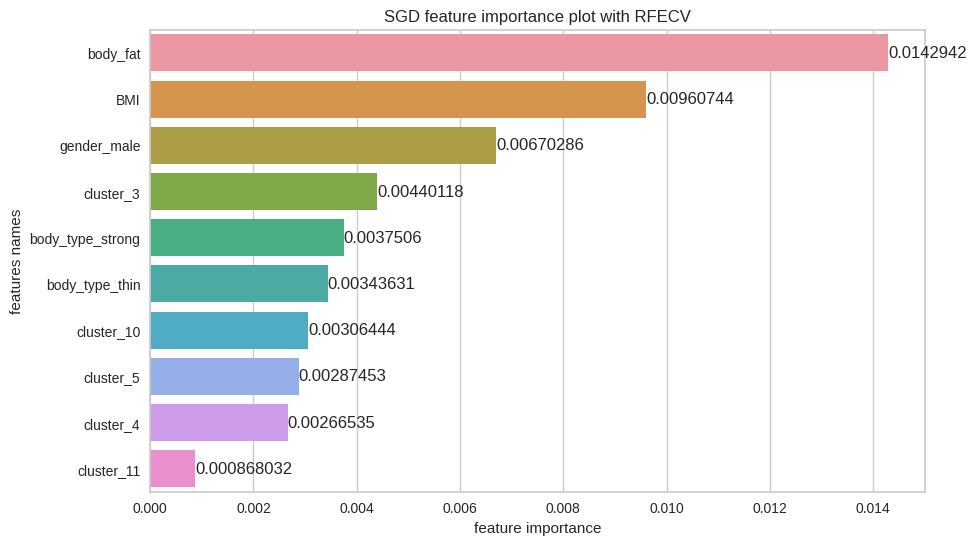

[SGD] Best parameters are {'alpha': 0.000505, 'eta0': 0.0001, 'learning_rate': 'invscaling', 'penalty': 'l1', 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Logistic Regression
[Logistic Regression] Features selected: Index(['BMI', 'body_fat', 'gender_male', 'newsletter_subscription_True',
       'cluster_1', 'cluster_2', 'cluster_3', 'cluster_6', 'cluster_7',
       'cluster_8', 'cluster_11'],
      dtype='object')
[Logistic Regression] Features importances: [0.47369162 1.57117961 0.92622926 0.86741111 0.60297273 0.34645139
 0.45097326 0.25964697 0.3069166  0.10908268 0.18919423]


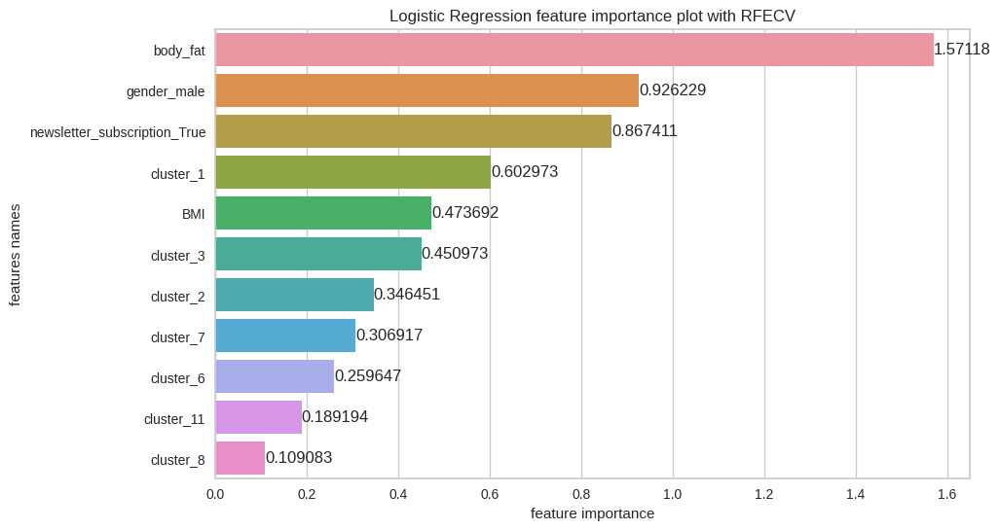

[Logistic Regression] Best parameters are {'C': 2, 'penalty': 'l1', 'random_state': 42, 'solver': 'liblinear'}
[INFO] Performing Grid-Search CV ---- Decision Tree
[Decision Tree] Features selected: Index(['BMI'], dtype='object')
[Decision Tree] Features importances: [1.0]


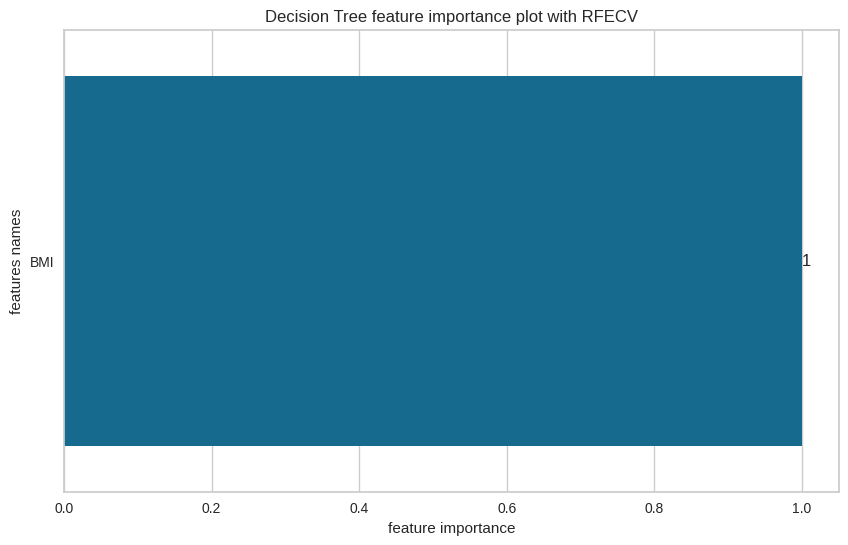

[Decision Tree] Best parameters are {'criterion': 'entropy', 'max_depth': 3, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Random Forest
[Random Forest] Features selected: Index(['BMI'], dtype='object')
[Random Forest] Features importances: [1.0]


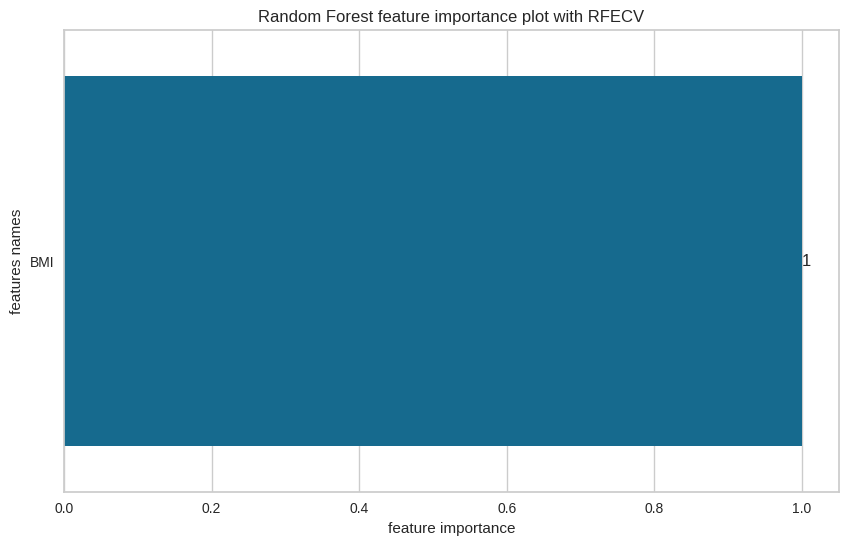

[Random Forest] Best parameters are {'criterion': 'gini', 'max_depth': 3, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- AdaBoost
[AdaBoost] Features selected: Index(['BMI', 'body_fat', 'gender_male', 'body_type_thin',
       'newsletter_subscription_True', 'cluster_1', 'cluster_7', 'cluster_8',
       'cluster_10'],
      dtype='object')
[AdaBoost] Features importances: [0.1533782669279337, 0.6325347324554523, 0.21408700061661387, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


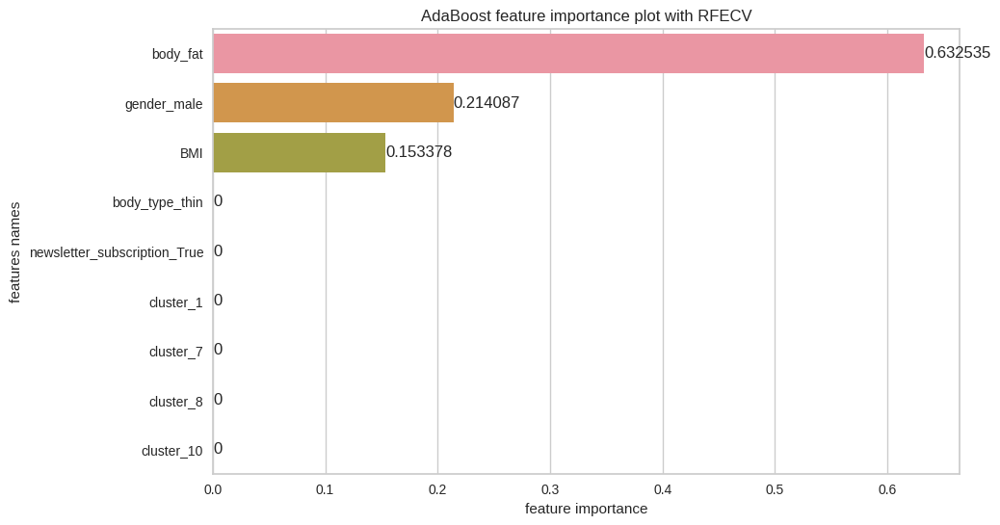

[AdaBoost] Best parameters are {'base_estimator': DecisionTreeClassifier(max_depth=2), 'learning_rate': 0.025, 'n_estimators': 20, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- GradientBoost
[GradientBoost] Features selected: Index(['BMI', 'body_fat'], dtype='object')
[GradientBoost] Features importances: [0.4802816609872357, 0.5197183390127643]


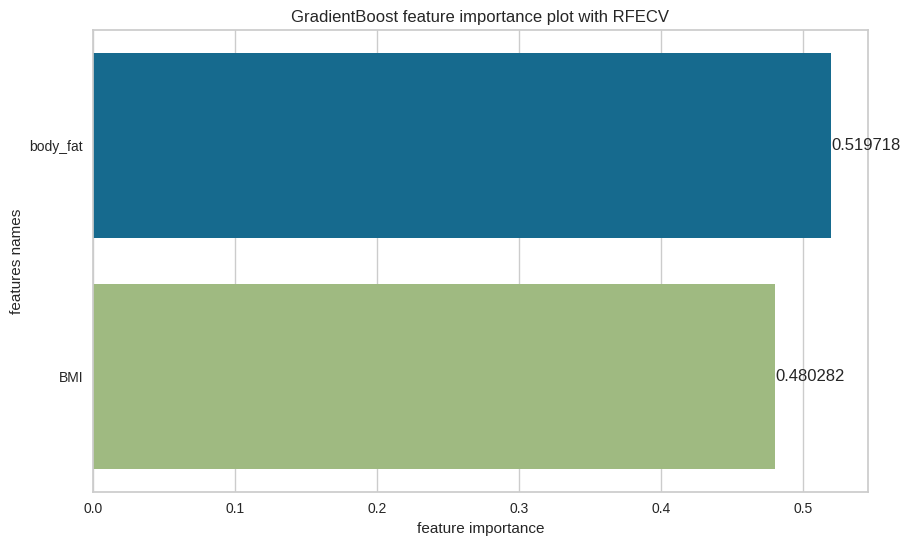

[GradientBoost] Best parameters are {'criterion': 'friedman_mse', 'learning_rate': 0.05, 'loss': 'deviance', 'max_depth': 5, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'n_estimators': 15, 'random_state': 42, 'subsample': 0.85}


,Overall Accuracy,Balanced Accuracy,Adj Balanced Accuracy,Precision micro,Precision macro,Precision weighted,Recall micro,Recall macro,Recall weighted,Cohen's kappa,Mathews Correlation Coefficient
SGD,0.60,0.41,0.12,0.60,0.39,0.54,0.60,0.41,0.60,0.19,0.21
Logistic Regression,0.61,0.41,0.11,0.61,0.41,0.55,0.61,0.41,0.61,0.18,0.21
Decision Tree,0.58,0.37,0.06,0.58,0.38,0.51,0.58,0.37,0.58,0.10,0.13
Random Forest,0.58,0.38,0.06,0.58,0.38,0.51,0.58,0.38,0.58,0.11,0.14
AdaBoost,0.59,0.38,0.07,0.59,0.39,0.53,0.59,0.38,0.59,0.11,0.15
GradientBoost,0.58,0.37,0.06,0.58,0.39,0.53,0.58,0.37,0.58,0.11,0.15


In [27]:
estimators_multiclass_sel_rfecv_clus, X_test_sel_rfecv_clus, y_test_sel_rfecv_clus, X_train_sel_rfecv_clus, y_train_sel_rfecv_clus, X_test_inv_sel_rfecv_clus, features_sel_rfecv_clus = train(X_demo_clus, y_demo_clus, 
                                                         grid_params_multiclass, 
                                                         seed, feature_selection = True, 
                                                         feature_sel_type = 'RFECV')

evaluation_table_sel_rfecv_clus = evaluate_multiclass(estimators_multiclass_sel_rfecv_clus, 
                                                      X_test_sel_rfecv_clus, y_test_sel_rfecv_clus, 
                                                      no_of_labels = 3, features_selected = True, 
                                                      features = features_sel_rfecv_clus, 
                                                      feature_sel_type = 'RFECV')


evaluation_table_sel_rfecv_clus

#### With feature selection (by SelectFromModel) 

[INFO] Performing Grid-Search CV ---- SGD
[SGD] Features selected: Index(['BMI', 'body_fat', 'gender_male', 'cluster_2', 'cluster_6', 'cluster_8',
       'cluster_9', 'cluster_10', 'cluster_11'],
      dtype='object')
[SGD] Features importances: [0.41478293 0.53331841 0.22815572 0.10810967 0.0142963  0.
 0.06394866 0.         0.23046565]


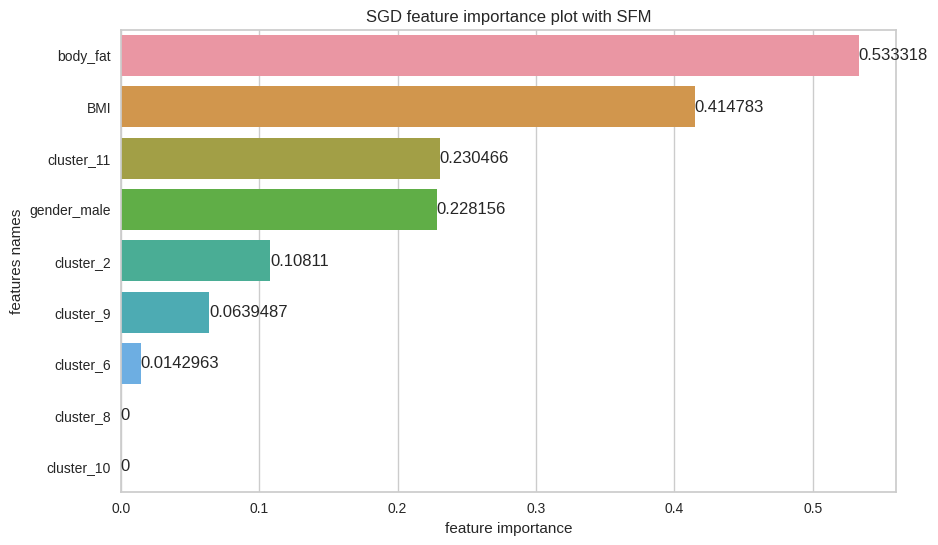

[SGD] Best parameters are {'alpha': 0.0007525, 'eta0': 0.0001, 'learning_rate': 'optimal', 'penalty': 'elasticnet', 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Logistic Regression
[Logistic Regression] Features selected: Index(['BMI', 'body_fat', 'gender_male', 'body_type_strong',
       'newsletter_subscription_True', 'cluster_3', 'cluster_7', 'cluster_8',
       'cluster_11'],
      dtype='object')
[Logistic Regression] Features importances: [0.37951954 1.55989493 0.96636782 0.2627797  0.314208   0.29665556
 0.07965487 0.3111798  0.15026961]


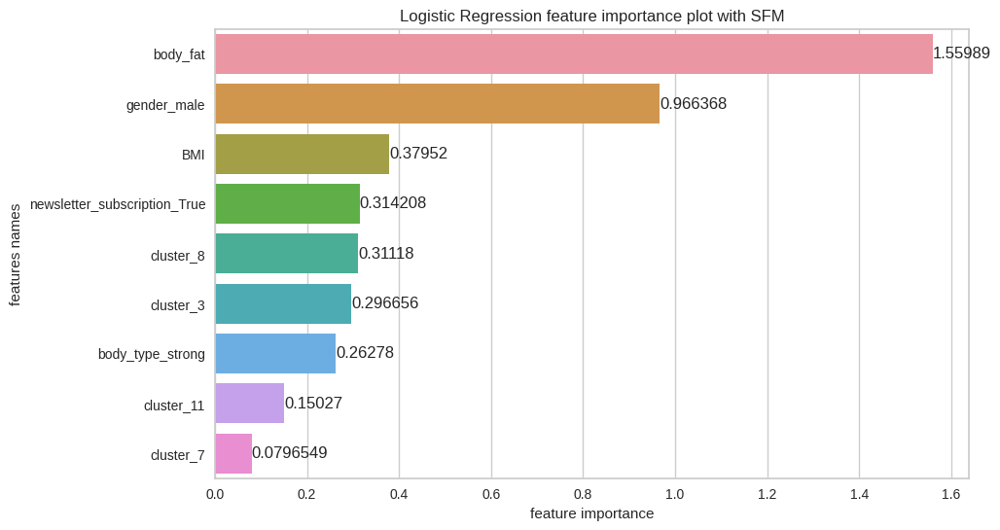

[Logistic Regression] Best parameters are {'C': 2, 'penalty': 'l1', 'random_state': 42, 'solver': 'liblinear'}
[INFO] Performing Grid-Search CV ---- Decision Tree
[Decision Tree] Features selected: Index(['BMI', 'body_fat', 'gender_male', 'body_type_strong', 'body_type_thin',
       'newsletter_subscription_True', 'cluster_2', 'cluster_4', 'cluster_7'],
      dtype='object')
[Decision Tree] Features importances: [0.2403158815797839, 0.5274033621423908, 0.18501942333364876, 0.0, 0.047261332944176684, 0.0, 0.0, 0.0, 0.0]


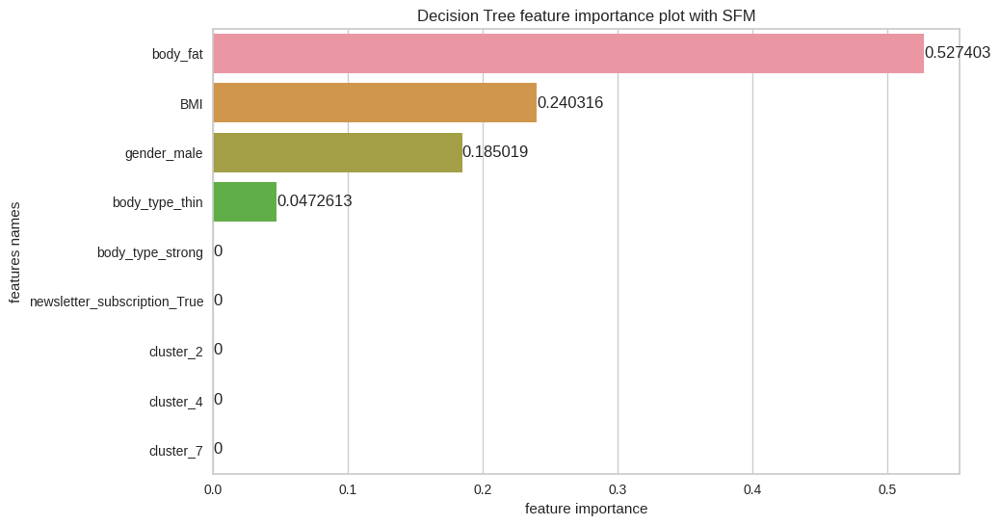

[Decision Tree] Best parameters are {'criterion': 'gini', 'max_depth': 3, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Random Forest
[Random Forest] Features selected: Index(['BMI', 'body_fat', 'gender_male', 'body_type_strong', 'body_type_thin',
       'newsletter_subscription_True', 'cluster_2', 'cluster_3', 'cluster_4'],
      dtype='object')
[Random Forest] Features importances: [0.2803651782223011, 0.46286326743509654, 0.15789896699404168, 0.0, 0.04919118863817292, 0.004259650831312677, 0.04542174787907514, 0.0, 0.0]


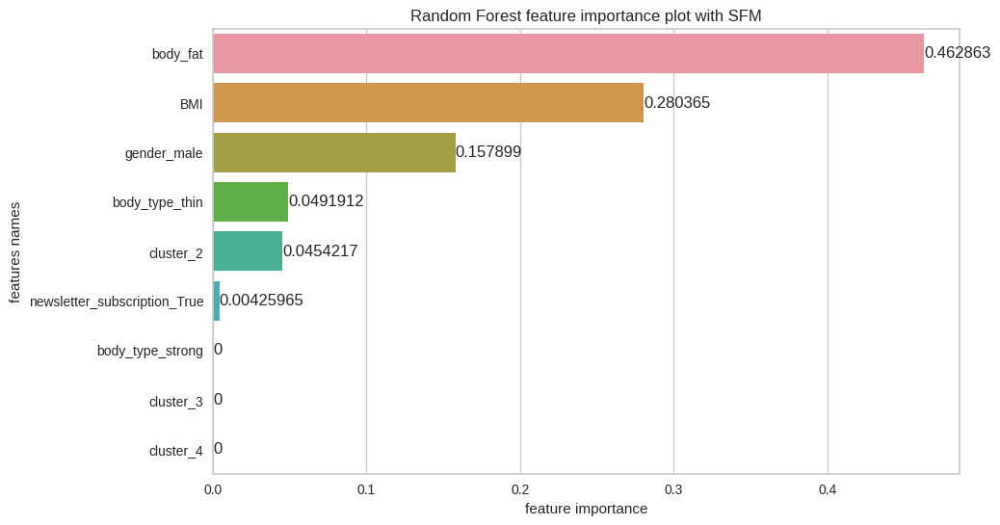

[Random Forest] Best parameters are {'criterion': 'gini', 'max_depth': 6, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- AdaBoost
[AdaBoost] Features selected: Index(['BMI', 'body_fat', 'gender_male', 'body_type_thin',
       'newsletter_subscription_True', 'cluster_1', 'cluster_7', 'cluster_8',
       'cluster_10'],
      dtype='object')
[AdaBoost] Features importances: [0.1533782669279337, 0.6325347324554523, 0.21408700061661387, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


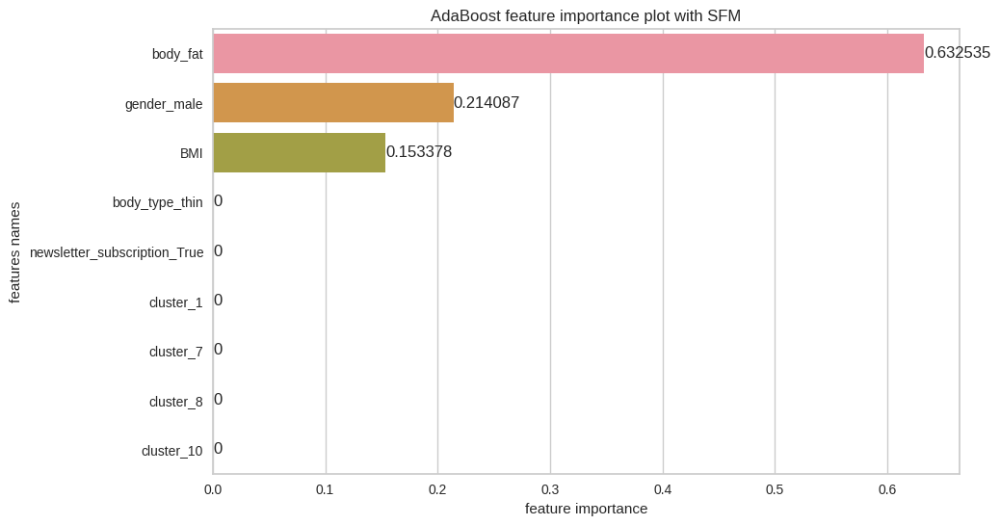

[AdaBoost] Best parameters are {'base_estimator': DecisionTreeClassifier(max_depth=2), 'learning_rate': 0.025, 'n_estimators': 20, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- GradientBoost
[GradientBoost] Features selected: Index(['BMI', 'body_fat', 'gender_male', 'body_type_thin',
       'newsletter_subscription_True', 'cluster_1', 'cluster_3', 'cluster_5',
       'cluster_6'],
      dtype='object')
[GradientBoost] Features importances: [0.2285996726238276, 0.5476406792984571, 0.16829817461960367, 0.05005092378609624, 0.0054105496720153945, 0.0, 0.0, 0.0, 0.0]


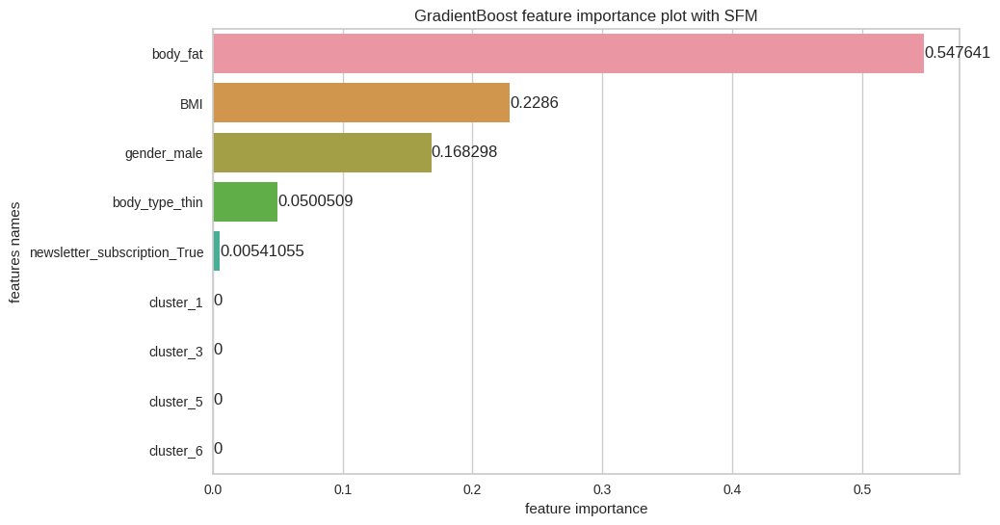

[GradientBoost] Best parameters are {'criterion': 'friedman_mse', 'learning_rate': 0.075, 'loss': 'deviance', 'max_depth': 5, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'n_estimators': 15, 'random_state': 42, 'subsample': 0.618}


,Overall Accuracy,Balanced Accuracy,Adj Balanced Accuracy,Precision micro,Precision macro,Precision weighted,Recall micro,Recall macro,Recall weighted,Cohen's kappa,Mathews Correlation Coefficient
SGD,0.58,0.36,0.04,0.58,0.41,0.55,0.58,0.36,0.58,0.08,0.14
Logistic Regression,0.61,0.40,0.11,0.61,0.41,0.55,0.61,0.40,0.61,0.18,0.21
Decision Tree,0.58,0.38,0.07,0.58,0.39,0.52,0.58,0.38,0.58,0.11,0.15
Random Forest,0.59,0.38,0.07,0.59,0.39,0.53,0.59,0.38,0.59,0.13,0.16
AdaBoost,0.59,0.38,0.07,0.59,0.39,0.53,0.59,0.38,0.59,0.11,0.15
GradientBoost,0.59,0.38,0.07,0.59,0.39,0.53,0.59,0.38,0.59,0.12,0.15


In [28]:
estimators_multiclass_sel_sfm_clus, X_test_sel_sfm_clus, y_test_sel_sfm_clus, X_train_sel_sfm_clus, y_train_sel_sfm_clus, X_test_inv_sel_sfm_clus, features_sel_sfm_clus = train(X_demo_clus, y_demo_clus, 
                                                         grid_params_multiclass, 
                                                         seed, feature_selection = True, 
                                                         feature_sel_type = 'SFM')

evaluation_table_sel_sfm_clus = evaluate_multiclass(estimators_multiclass_sel_sfm_clus, 
                                                    X_test_sel_sfm_clus, y_test_sel_sfm_clus, 
                                                    no_of_labels = 3, features_selected = True, 
                                                    features = features_sel_sfm_clus, feature_sel_type = 'SFM')


evaluation_table_sel_sfm_clus

## For Users

In this subsection we'll use users demographics and after-workout information to prepare classification of *total_sessions* label, which we created from a thresholds.

Features are:
* gender,
* height,
* weight,
* BMI,
* activity level,
* body type,
* newsletter subscription,
* body fat,
* training days setting,
* total time users,
* total reps users,
* total calories users,
* exercises per user,
* exercises without rest per user.

We divided the total sessions into 4 groups:

* Group 0 - total number of sessions is less or equal to 5 (1562 users),
* Group 1 - total number of sessions is bigger than 5 and less or equal to 10 (391 users),
* Group 2 - total number of sessions is bigger than 10 and less or equal to 20 (380 users),
* Group 3 - total number of sessions is bigger than 20 (701 users).


In [147]:
X_users = df_users_only.loc[:, ['gender', 'activity_level', 'body_type', 'newsletter_subscription',
                                   'height', 'weight', 'BMI', 'body_fat', 'training_days_setting', 
                                'total_time_users2', 'total_reps_users2',
                                        'total_calories_users2', 'exercises_per_user', 
                                        'exercises_without_rest_per_user']]
'''
X_users.replace({'male':1, 'female':0, 'False': 0, 'True': 1, 'thin': 0, 'mid': 1, 'strong': 2,
                 'active': 0, 'very active': 1, 'sedentary': 2, 
                 'training_days_setting': 1, 'training_days_setting': 2, 'training_days_setting': 3,
                 'training_days_setting': 4, 'training_days_setting': 5,
                 'training_days_setting':6, 'training_days_setting':7}, inplace = True)
'''

cat_cols = ['gender', 'body_type', 'newsletter_subscription', 'activity_level', 'training_days_setting']
X_users = pd.get_dummies(X_users, columns = cat_cols, drop_first = True)


y_users = []

for sess in df_users_only['total_sessions_users2']:
    if sess <= 5:
        y_users.append(0)
    elif sess <= 10:
        y_users.append(1)
    elif sess <= 20:
        y_users.append(2)
    elif sess > 20:
        y_users.append(3)

y_users = np.array(y_users)

y_user = pd.DataFrame(y_users, columns = ['total_sessions_users_group'])

[INFO] Performing Grid-Search CV ---- SGD
[SGD] Features importances: [ 0.41289408  0.34515369  0.23700998  0.39423448 10.79269793 11.77485555
  7.15514669  4.61768644  3.26239032  0.43298481  0.19304053  0.28114612
  0.02389544  0.60267328  0.39868938  0.29035403  0.6309615   0.31159731
  0.23785655  0.0935628   0.31249174]


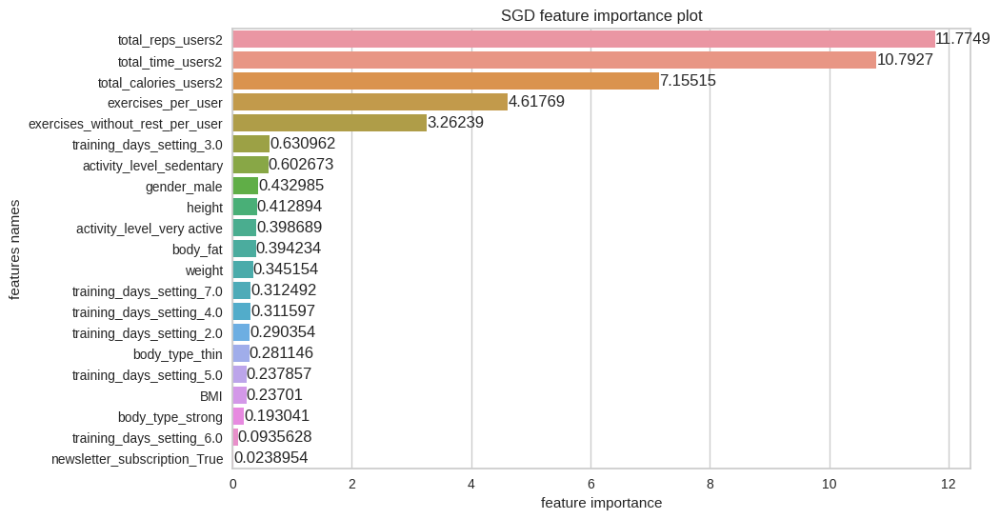

[SGD] Best parameters are {'alpha': 1e-05, 'eta0': 0.050050000000000004, 'learning_rate': 'adaptive', 'penalty': 'l1', 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Logistic Regression
[Logistic Regression] Features importances: [ 0.93791383  2.8048278   1.02361685  0.81121405 41.15534821 31.01824541
 15.25515695 14.51567758 13.91225994  0.93343605  0.32280884  0.50865653
  0.07209209  1.07717242  0.80646159  0.58489853  1.3625736   0.732783
  0.53981409  0.1125752   0.44820943]


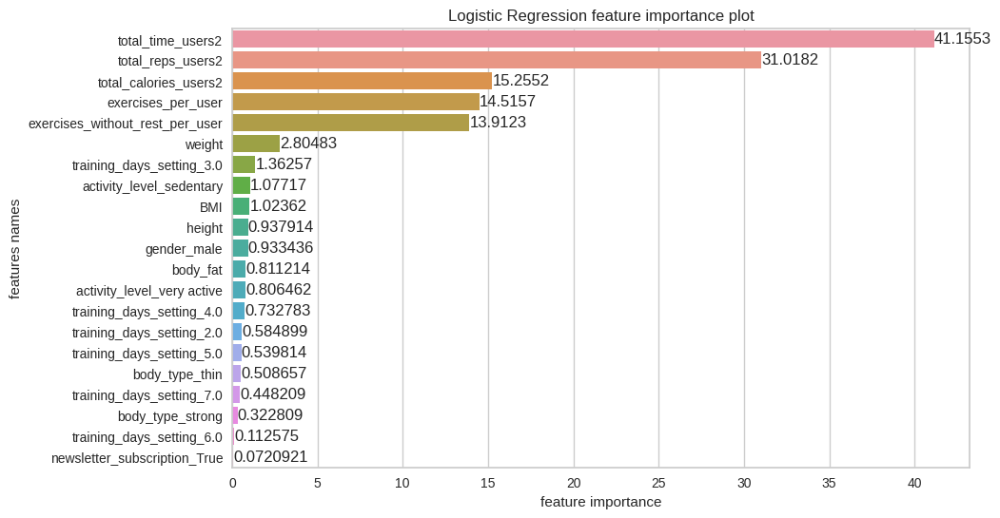

[Logistic Regression] Best parameters are {'C': 5, 'penalty': 'l1', 'random_state': 42, 'solver': 'liblinear'}
[INFO] Performing Grid-Search CV ---- Decision Tree
[Decision Tree] Features importances: [0.001137987159316678, 0.0042785942658598594, 0.007532312842512525, 0.001543436130324949, 0.7992851508603879, 0.14093011635143618, 0.005127391514724648, 0.016342960602467288, 0.014350447922387682, 0.0, 0.0, 0.0, 0.0, 0.00947160235058237, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


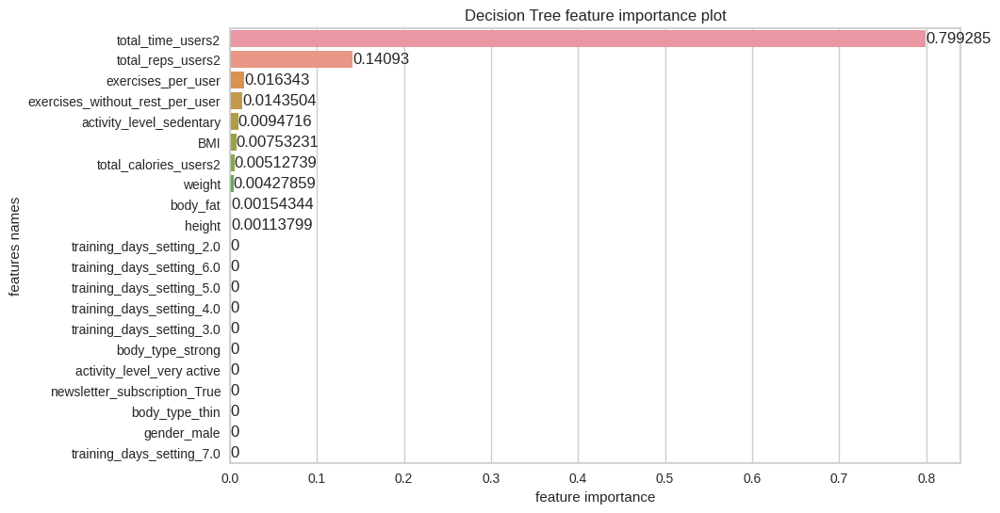

[Decision Tree] Best parameters are {'criterion': 'entropy', 'max_depth': 6, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Random Forest
[Random Forest] Features importances: [0.0013099976125487247, 0.0009523366048828768, 0.0019467441308896954, 0.0023170213446209492, 0.34153943125496644, 0.18294274710577005, 0.1869612524062515, 0.13557515280056298, 0.1378320767821114, 0.0026423252651265453, 0.0, 9.775006926976033e-05, 0.0, 0.005203937522701539, 0.0, 0.0, 0.0004776912930684945, 0.0002015358072291176, 0.0, 0.0, 0.0]


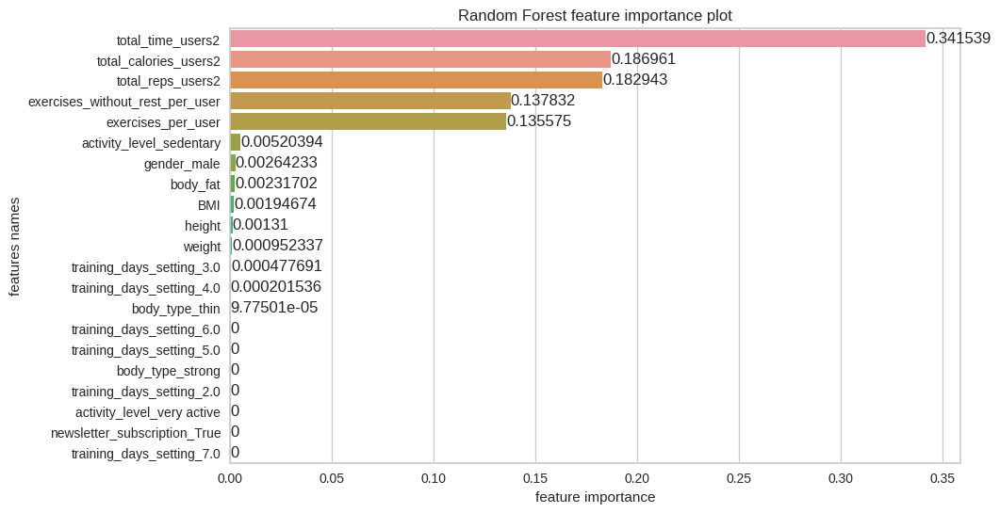

[Random Forest] Best parameters are {'criterion': 'entropy', 'max_depth': 6, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- AdaBoost
[AdaBoost] Features importances: [0.005608829612929903, 0.009511007431942529, 0.04319158012789368, 0.01767335942331939, 0.698837979188959, 0.09467947526677412, 0.021278691524624367, 0.03309085498018797, 0.04645019398535484, 0.00033629409700593215, 0.00040385369715379934, 0.00016344850268775287, 3.5520276170717336e-05, 0.020373563977836226, 0.0009079635706202547, 2.384305478041267e-05, 0.00029600424168609203, 0.00010825251457035035, 0.0010384909225641024, 0.005796645393901223, 0.00019414820903751044]


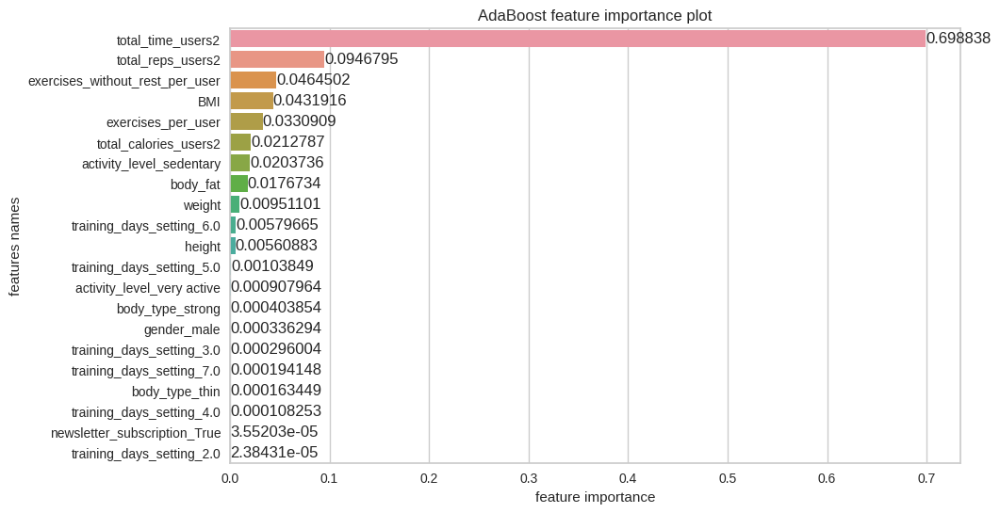

[AdaBoost] Best parameters are {'base_estimator': DecisionTreeClassifier(max_depth=5), 'learning_rate': 0.01, 'n_estimators': 60, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- GradientBoost
[GradientBoost] Features importances: [0.0006854765744239902, 0.0006498299583352824, 0.0010745057160343506, 0.0019651883744450055, 0.40660242099173227, 0.18096433915095328, 0.16591778166505528, 0.17565582092431317, 0.06313554688928052, 0.002075867233076676, 0.0, 0.00023596694826674808, 4.471841137506621e-06, 0.0008549070921150062, 0.0, 0.0, 0.00015452322716591937, 0.0, 2.3353413665098993e-05, 0.0, 0.0]


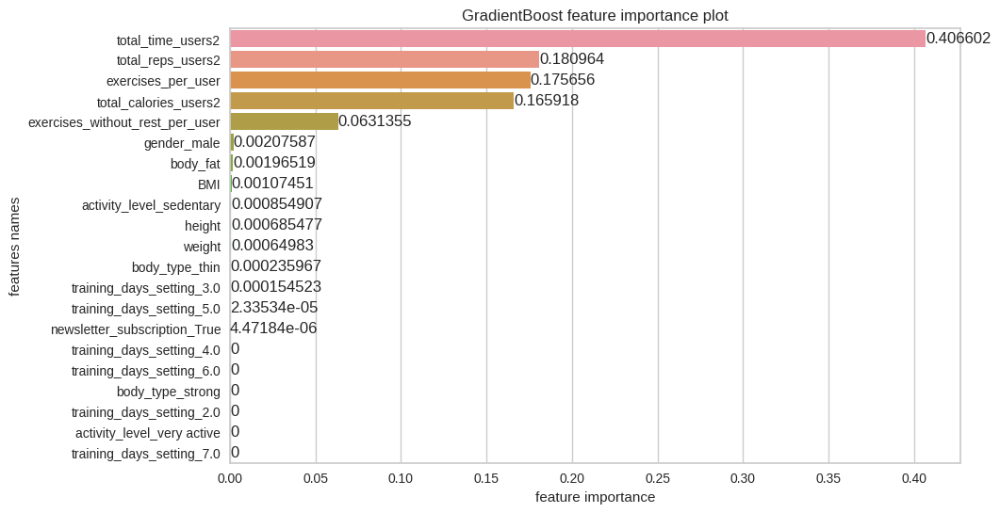

[GradientBoost] Best parameters are {'criterion': 'friedman_mse', 'learning_rate': 0.075, 'loss': 'deviance', 'max_depth': 3, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'n_estimators': 15, 'random_state': 42, 'subsample': 0.85}


In [185]:
estimators_multiclass_u, X_test_u, y_test_u, X_train_u, y_train_u, X_test_inv_u, features_u = train(X_users, y_users, 
                                                         grid_params_multiclass, 
                                                         seed)

In [186]:
evaluation_table_u = evaluate_multiclass(estimators_multiclass_u, X_test_u, y_test_u, no_of_labels = 4, features_selected = False, features = features_u)


In [187]:
evaluation_table_u

,Overall Accuracy,Balanced Accuracy,Adj Balanced Accuracy,Precision micro,Precision macro,Precision weighted,Recall micro,Recall macro,Recall weighted,Cohen's kappa,Mathews Correlation Coefficient
SGD,0.82,0.64,0.52,0.82,0.67,0.78,0.82,0.64,0.82,0.70,0.71
Logistic Regression,0.83,0.67,0.56,0.83,0.71,0.80,0.83,0.67,0.83,0.73,0.73
Decision Tree,0.90,0.85,0.79,0.90,0.84,0.90,0.90,0.85,0.90,0.84,0.84
Random Forest,0.84,0.69,0.59,0.84,0.86,0.86,0.84,0.69,0.84,0.74,0.76
AdaBoost,0.92,0.88,0.84,0.92,0.88,0.92,0.92,0.88,0.92,0.87,0.87
GradientBoost,0.89,0.82,0.76,0.89,0.85,0.89,0.89,0.82,0.89,0.83,0.84


By the majority rule, the best algorithm with classification here is AdaBoost with base estimator as Decision Tree Classifier, with depth equal to 5, learning rate equal to 0.01 and number of estimators equal to 60. The overall accuracy is 92% which is a very good accuracy. Micro and weighted precision is 92% and macro precision is 88%. Micro and weighted recall is 92% and macro recall is 88%. Cohen's Kappa is 0.87 and MCC is also 0.87. ROC Curves look really good and AUC scores for each class show good quality of the model. The scores are very good.

In [63]:
prediction_for_one_user(estimators_multiclass_u, X_test_u, y_test_u, X_test_inv_u, X_users.columns, y_user.columns, name = 'AdaBoost')


,height,weight,BMI,body_fat,total_time_users2,total_reps_users2,total_calories_users2,exercises_per_user,exercises_without_rest_per_user,gender_male,body_type_strong,body_type_thin,newsletter_subscription_True,activity_level_sedentary,activity_level_very active,training_days_setting_2.0,training_days_setting_3.0,training_days_setting_4.0,training_days_setting_5.0,training_days_setting_6.0,training_days_setting_7.0,total_sessions_users_group,total_sessions_users_group_prediction
704,175.00,66.00,21.55,15.00,2739.00,488.00,157.13,4418.00,2632.00,1.00,0.00,1.00,1.00,1.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,0,0


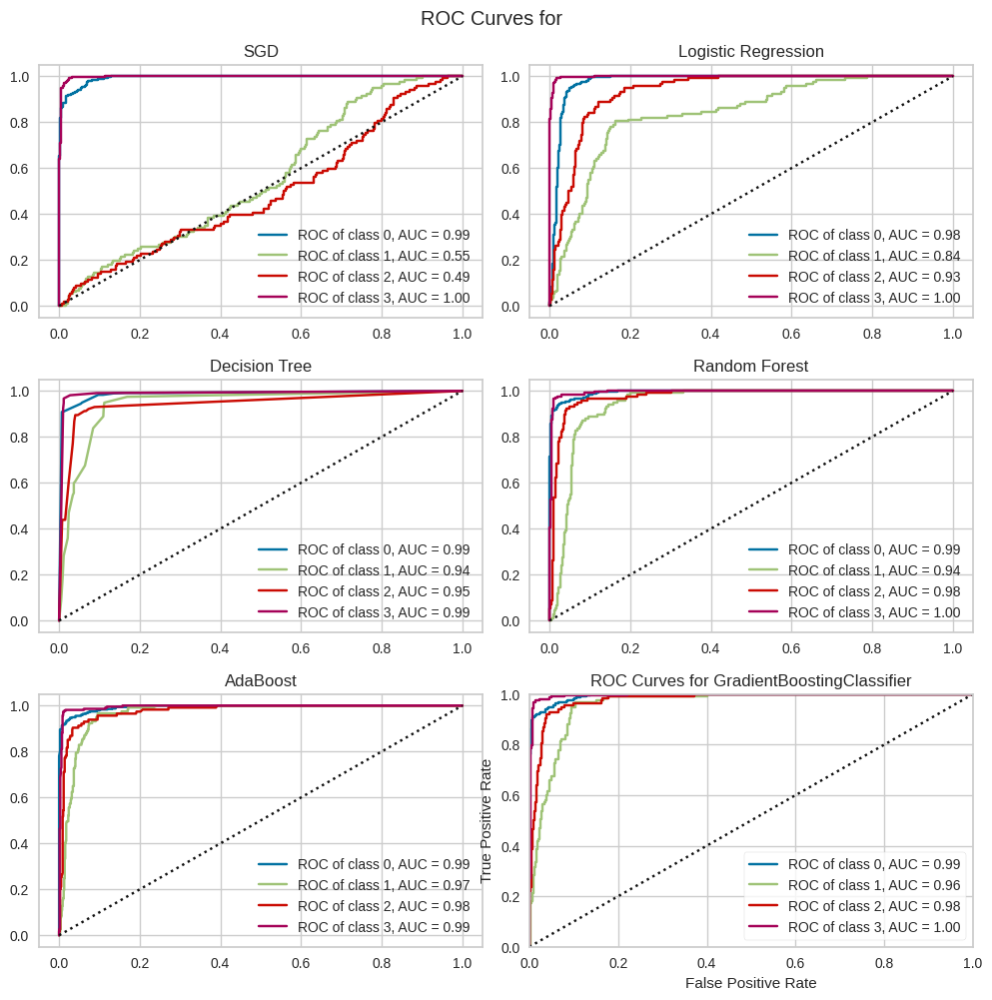

<AxesSubplot: title={'center': 'ROC Curves for GradientBoostingClassifier'}, xlabel='False Positive Rate', ylabel='True Positive Rate'>

In [204]:
ROC_curves(estimators_multiclass_u, X_train_u, y_train_u, X_test_u, y_test_u, np.unique(y_users), name = 'all',  features_selected = False, features = features_u)

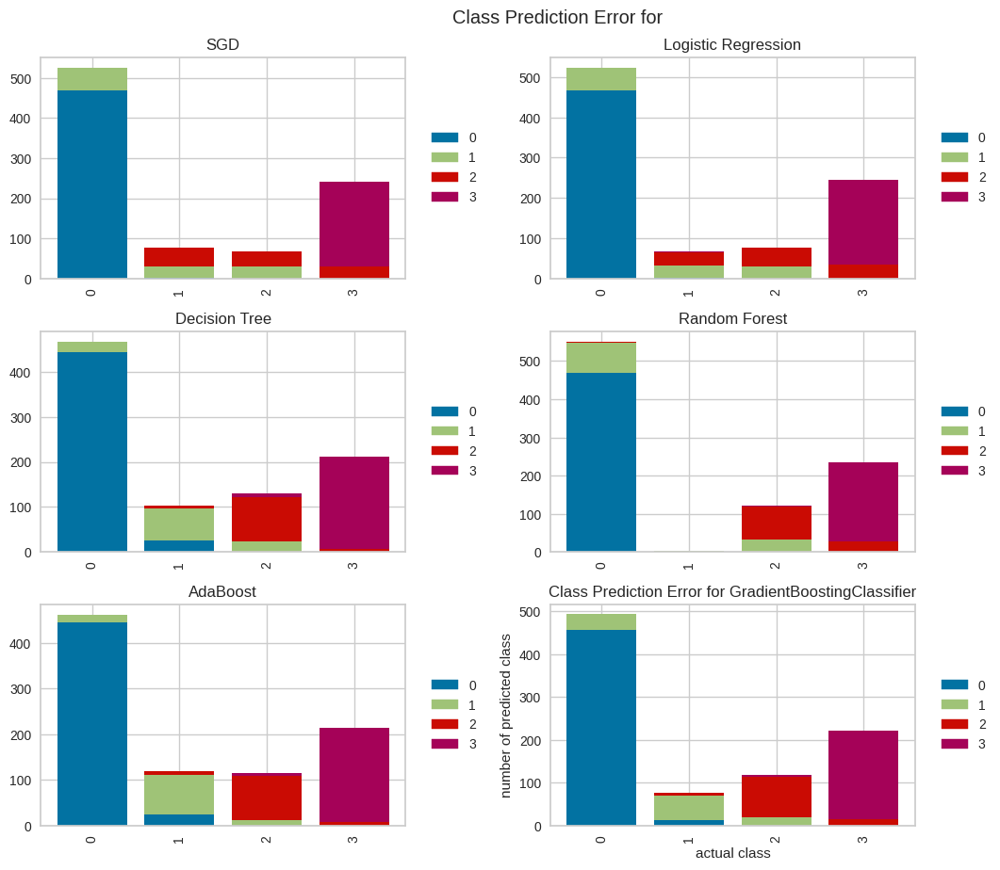

<AxesSubplot: title={'center': 'Class Prediction Error for GradientBoostingClassifier'}, xlabel='actual class', ylabel='number of predicted class'>

In [68]:
prediction_error_plot(estimators_multiclass_u, X_train_u, y_train_u, X_test_u, y_test_u, np.unique(y_users), name = 'all',  features_selected = False, features = features_u)

### With feature selection (Univariate - Kruskall - Wallis test (instead of ANOVA) and chi-square)

[INFO] Performing Grid-Search CV ---- SGD
[SGD] Features selected: Index(['height', 'BMI', 'body_fat', 'total_time_users2', 'total_reps_users2',
       'total_calories_users2', 'exercises_per_user',
       'exercises_without_rest_per_user'],
      dtype='object')
[SGD] Features importances: [ 0.33427393  0.11914526  0.66000585 10.23911373 10.83652744  6.22478124
  3.50506368  2.22409623]


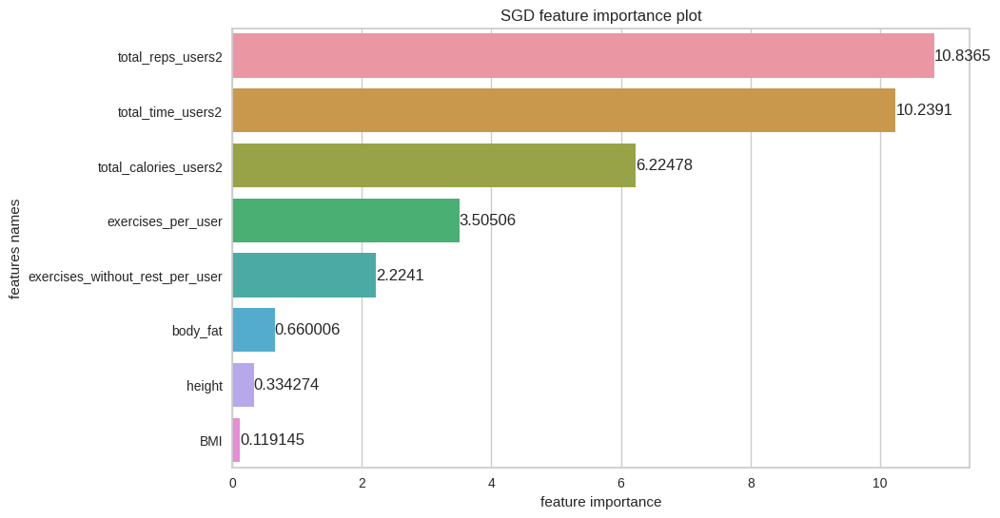

[SGD] Best parameters are {'alpha': 1e-05, 'eta0': 0.07502500000000001, 'learning_rate': 'adaptive', 'penalty': 'l2', 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Logistic Regression
[Logistic Regression] Features selected: Index(['height', 'BMI', 'body_fat', 'total_time_users2', 'total_reps_users2',
       'total_calories_users2', 'exercises_per_user',
       'exercises_without_rest_per_user'],
      dtype='object')
[Logistic Regression] Features importances: [ 0.25432889  0.54724288  1.11725535 34.64881838 26.75464624 10.43947315
  7.43116446  7.35024628]


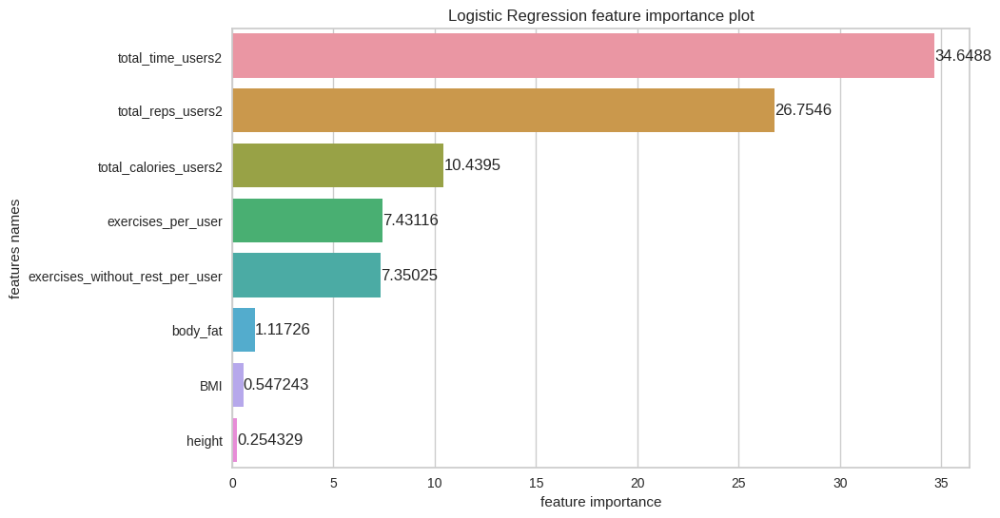

[Logistic Regression] Best parameters are {'C': 4, 'penalty': 'l1', 'random_state': 42, 'solver': 'liblinear'}
[INFO] Performing Grid-Search CV ---- Decision Tree
[Decision Tree] Features selected: Index(['height', 'BMI', 'body_fat', 'total_time_users2', 'total_reps_users2',
       'total_calories_users2', 'exercises_per_user',
       'exercises_without_rest_per_user'],
      dtype='object')
[Decision Tree] Features importances: [0.0146555659646358, 0.02474952953412281, 0.018466814159005064, 0.7089009966152126, 0.1436188915221388, 0.031163966193670605, 0.027704696989209, 0.030739539022005408]


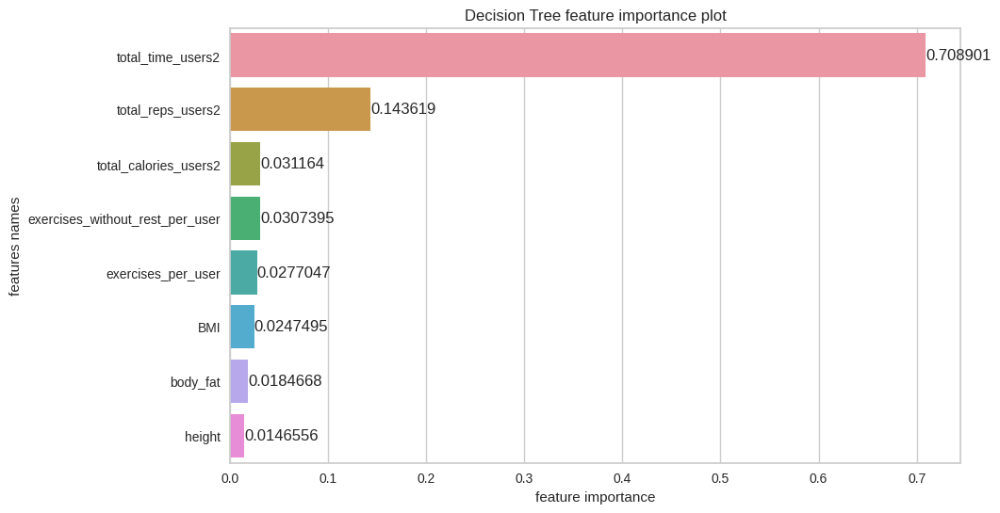

[Decision Tree] Best parameters are {'criterion': 'entropy', 'max_depth': 12, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Random Forest
[Random Forest] Features selected: Index(['height', 'BMI', 'body_fat', 'total_time_users2', 'total_reps_users2',
       'total_calories_users2', 'exercises_per_user',
       'exercises_without_rest_per_user'],
      dtype='object')
[Random Forest] Features importances: [0.000201666142855399, 5.161832190052736e-05, 0.0006880338593457459, 0.32518490798653416, 0.32460541489058997, 0.14913250413630338, 0.114036243005628, 0.0860996116568429]


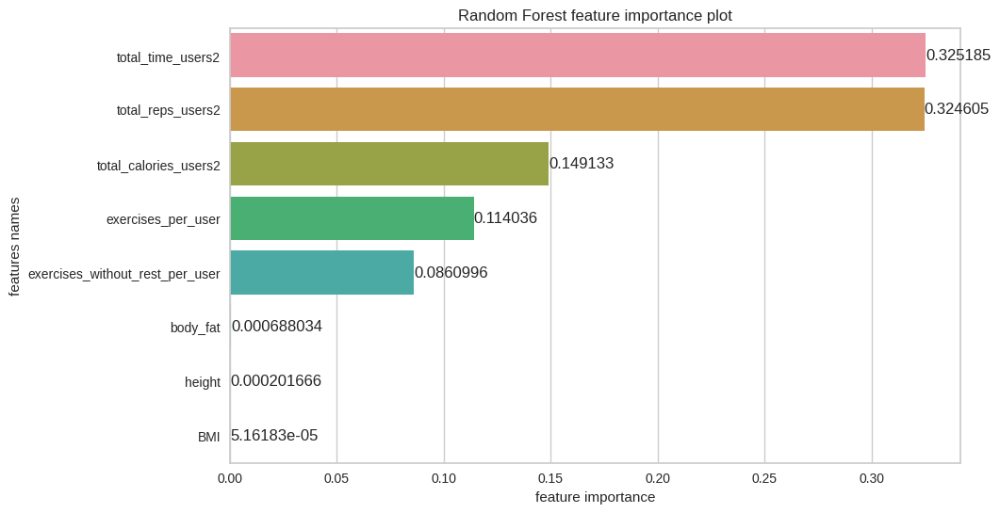

[Random Forest] Best parameters are {'criterion': 'entropy', 'max_depth': 3, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- AdaBoost
[AdaBoost] Features selected: Index(['height', 'BMI', 'body_fat', 'total_time_users2', 'total_reps_users2',
       'total_calories_users2', 'exercises_per_user',
       'exercises_without_rest_per_user'],
      dtype='object')
[AdaBoost] Features importances: [0.03317628769992827, 0.02026950567704011, 0.018891854933815497, 0.40556061139292304, 0.39181693627698555, 0.04053485321630615, 0.02660477270773426, 0.06314517809526708]


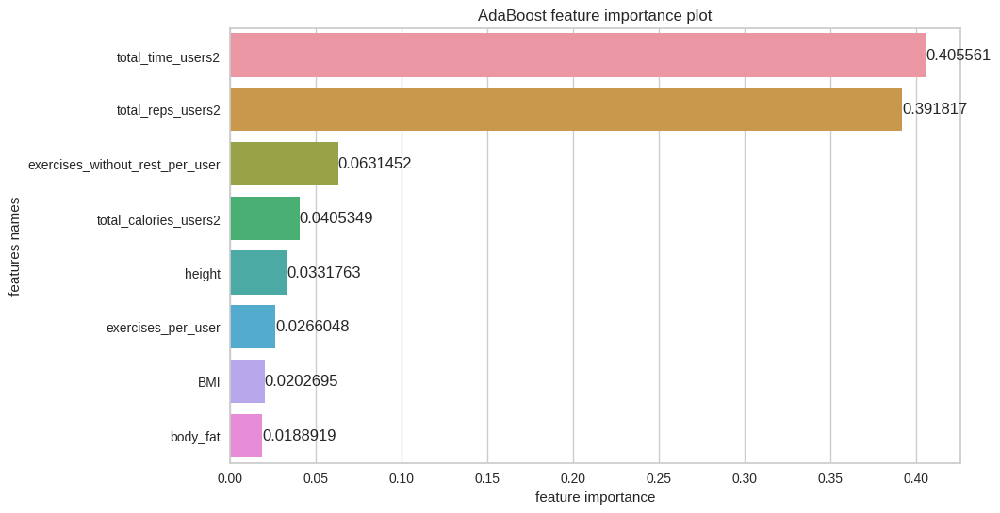

[AdaBoost] Best parameters are {'base_estimator': DecisionTreeClassifier(max_depth=5), 'learning_rate': 0.05, 'n_estimators': 40, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- GradientBoost
[GradientBoost] Features selected: Index(['height', 'BMI', 'body_fat', 'total_time_users2', 'total_reps_users2',
       'total_calories_users2', 'exercises_per_user',
       'exercises_without_rest_per_user'],
      dtype='object')
[GradientBoost] Features importances: [0.0, 1.495704733701174e-05, 0.0005110101071733058, 0.3146336071735055, 0.3920467103171158, 0.0783735326730689, 0.1794486753385633, 0.03497150734323611]


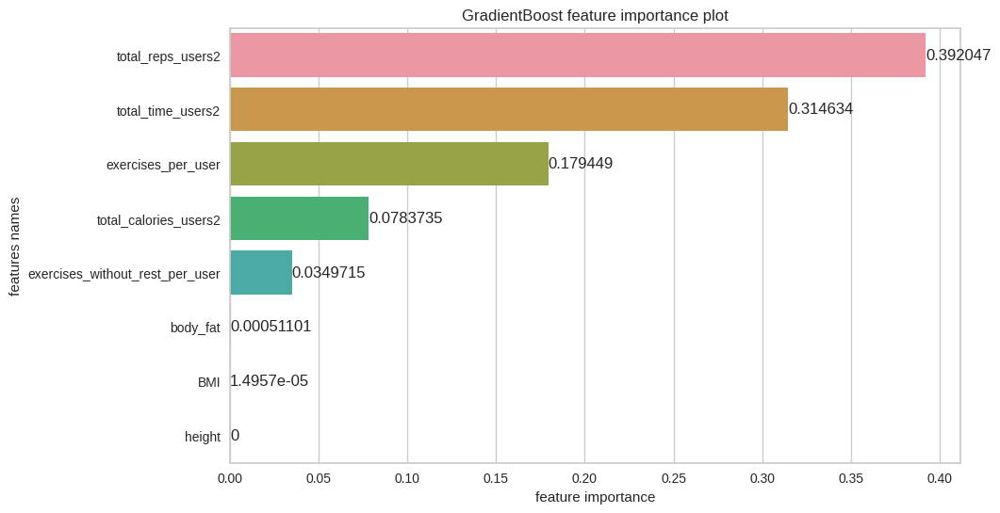

[GradientBoost] Best parameters are {'criterion': 'friedman_mse', 'learning_rate': 0.075, 'loss': 'deviance', 'max_depth': 3, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.5, 'n_estimators': 15, 'random_state': 42, 'subsample': 0.85}


In [195]:
estimators_multiclass_u_sel_u, X_test_u_sel_u, y_test_u_sel_u, X_train_u_sel_u, y_train_u_sel_u, X_test_inv_u_sel_u, features_u_sel_u = train(X_users, y_users, 
                                                         grid_params_multiclass, 
                                                         seed, feature_selection = True, 
                                                         feature_sel_type = 'UNI')

In [196]:
evaluation_table_u_sel_u = evaluate_multiclass(estimators_multiclass_u_sel_u, X_test_u_sel_u, y_test_u_sel_u, no_of_labels = 4, features_selected = True, features = features_u_sel_u, feature_sel_type = 'UNI')


In [197]:
evaluation_table_u_sel_u

,Overall Accuracy,Balanced Accuracy,Adj Balanced Accuracy,Precision micro,Precision macro,Precision weighted,Recall micro,Recall macro,Recall weighted,Cohen's kappa,Mathews Correlation Coefficient
SGD,0.84,0.69,0.58,0.84,0.74,0.81,0.84,0.69,0.84,0.74,0.75
Logistic Regression,0.83,0.67,0.56,0.83,0.72,0.80,0.83,0.67,0.83,0.73,0.74
Decision Tree,0.89,0.82,0.75,0.89,0.83,0.89,0.89,0.82,0.89,0.83,0.83
Random Forest,0.87,0.76,0.68,0.87,0.85,0.88,0.87,0.76,0.87,0.80,0.81
AdaBoost,0.90,0.87,0.82,0.90,0.85,0.91,0.90,0.87,0.90,0.85,0.85
GradientBoost,0.89,0.81,0.75,0.89,0.84,0.88,0.89,0.81,0.89,0.83,0.83


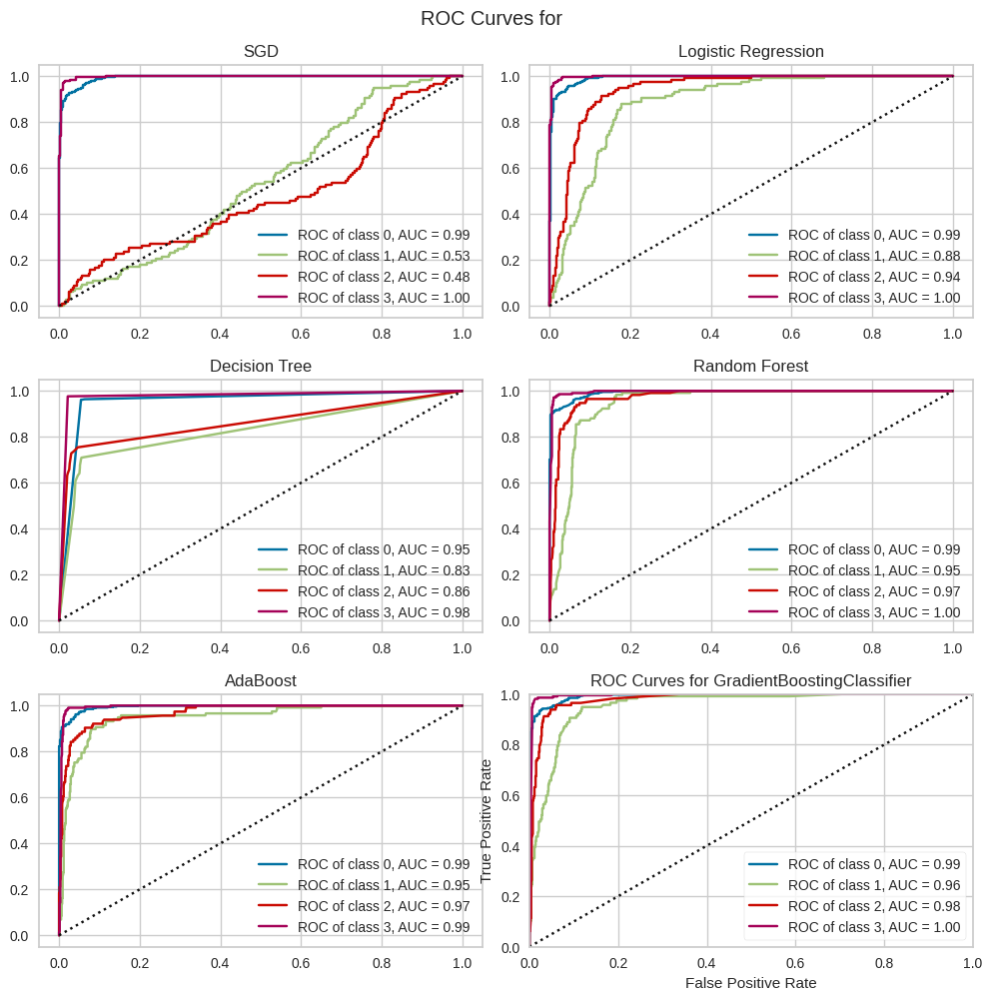

<AxesSubplot: title={'center': 'ROC Curves for GradientBoostingClassifier'}, xlabel='False Positive Rate', ylabel='True Positive Rate'>

In [72]:
ROC_curves(estimators_multiclass_u_sel_u, X_train_u_sel_u, y_train_u_sel_u, X_test_u_sel_u, y_test_u_sel_u, np.unique(y_users), name = 'all', features_selected = True, features = features_u_sel_u, feature_sel_type = 'UNI')

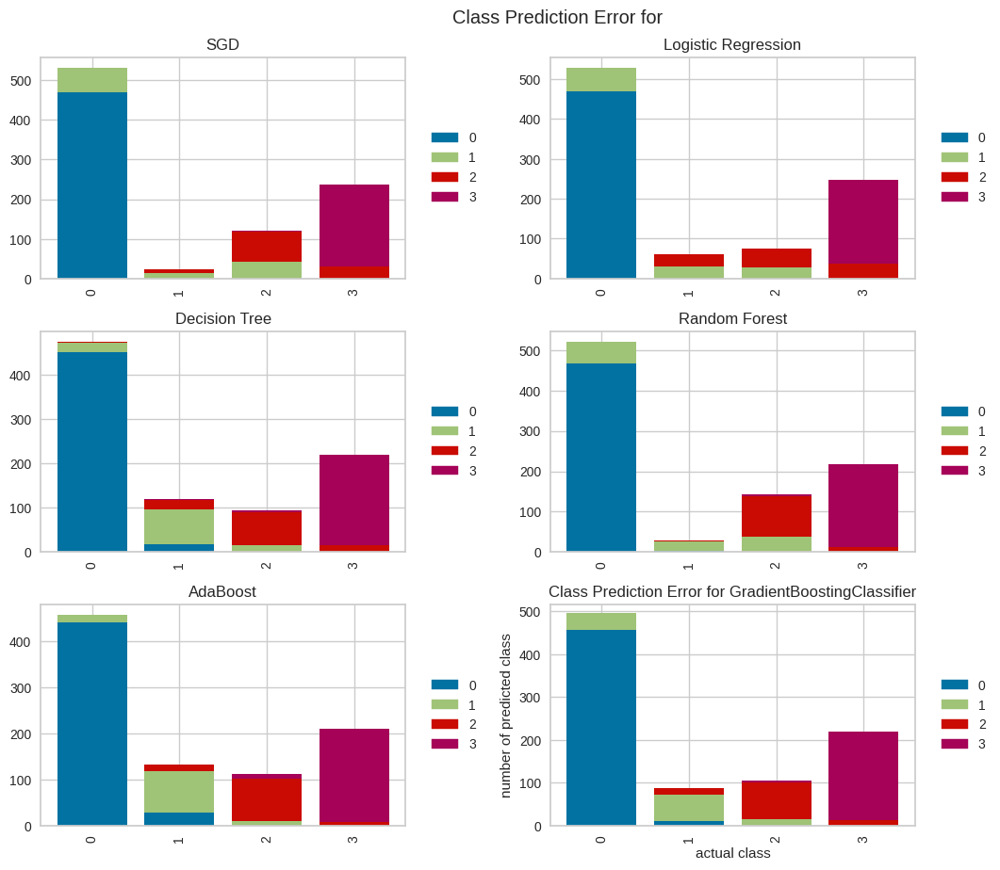

<AxesSubplot: title={'center': 'Class Prediction Error for GradientBoostingClassifier'}, xlabel='actual class', ylabel='number of predicted class'>

In [73]:
prediction_error_plot(estimators_multiclass_u_sel_u, X_train_u_sel_u, y_train_u_sel_u, X_test_u_sel_u, y_test_u_sel_u, np.unique(y_users), name = 'all', features_selected = True, features = features_u_sel_u, feature_sel_type = 'UNI')

### With feature selection (by SequentialFeatureSelector)

In [188]:
estimators_multiclass_u_sel, X_test_u_sel, y_test_u_sel, X_train_u_sel, y_train_u_sel, X_test_inv_u_sel, features_u_sel = train(X_users, y_users, 
                                                         grid_params_multiclass, 
                                                         seed, feature_selection = True, 
                                                         feature_sel_type = 'SFS')

[INFO] Performing Grid-Search CV ---- SGD
[SGD] Features selected: Index(['total_time_users2', 'total_reps_users2', 'activity_level_sedentary',
       'training_days_setting_6.0', 'training_days_setting_7.0'],
      dtype='object')
[SGD] Best parameters are {'alpha': 1e-05, 'eta0': 0.1, 'learning_rate': 'adaptive', 'penalty': 'elasticnet', 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Logistic Regression
[Logistic Regression] Features selected: Index(['BMI', 'total_time_users2', 'total_reps_users2', 'body_type_thin',
       'activity_level_sedentary', 'activity_level_very active',
       'training_days_setting_7.0'],
      dtype='object')
[Logistic Regression] Best parameters are {'C': 5, 'penalty': 'l1', 'random_state': 42, 'solver': 'liblinear'}
[INFO] Performing Grid-Search CV ---- Decision Tree
[Decision Tree] Features selected: Index(['total_reps_users2', 'exercises_per_user',
       'exercises_without_rest_per_user', 'gender_male',
       'training_days_setting_2.0'],

In [198]:
evaluation_table_u_sel = evaluate_multiclass(estimators_multiclass_u_sel, X_test_u_sel, y_test_u_sel, no_of_labels = 4, features_selected = True, features = features_u_sel, feature_sel_type = 'SFS')


In [199]:
evaluation_table_u_sel

,Overall Accuracy,Balanced Accuracy,Adj Balanced Accuracy,Precision micro,Precision macro,Precision weighted,Recall micro,Recall macro,Recall weighted,Cohen's kappa,Mathews Correlation Coefficient
SGD,0.84,0.69,0.58,0.84,0.59,0.73,0.84,0.69,0.84,0.74,0.75
Logistic Regression,0.83,0.67,0.56,0.83,0.71,0.80,0.83,0.67,0.83,0.72,0.73
Decision Tree,0.89,0.82,0.76,0.89,0.82,0.89,0.89,0.82,0.89,0.83,0.83
Random Forest,0.85,0.71,0.61,0.85,0.83,0.85,0.85,0.71,0.85,0.76,0.77
AdaBoost,0.89,0.82,0.77,0.89,0.84,0.89,0.89,0.82,0.89,0.82,0.82
GradientBoost,0.91,0.85,0.80,0.91,0.87,0.90,0.91,0.85,0.91,0.85,0.86


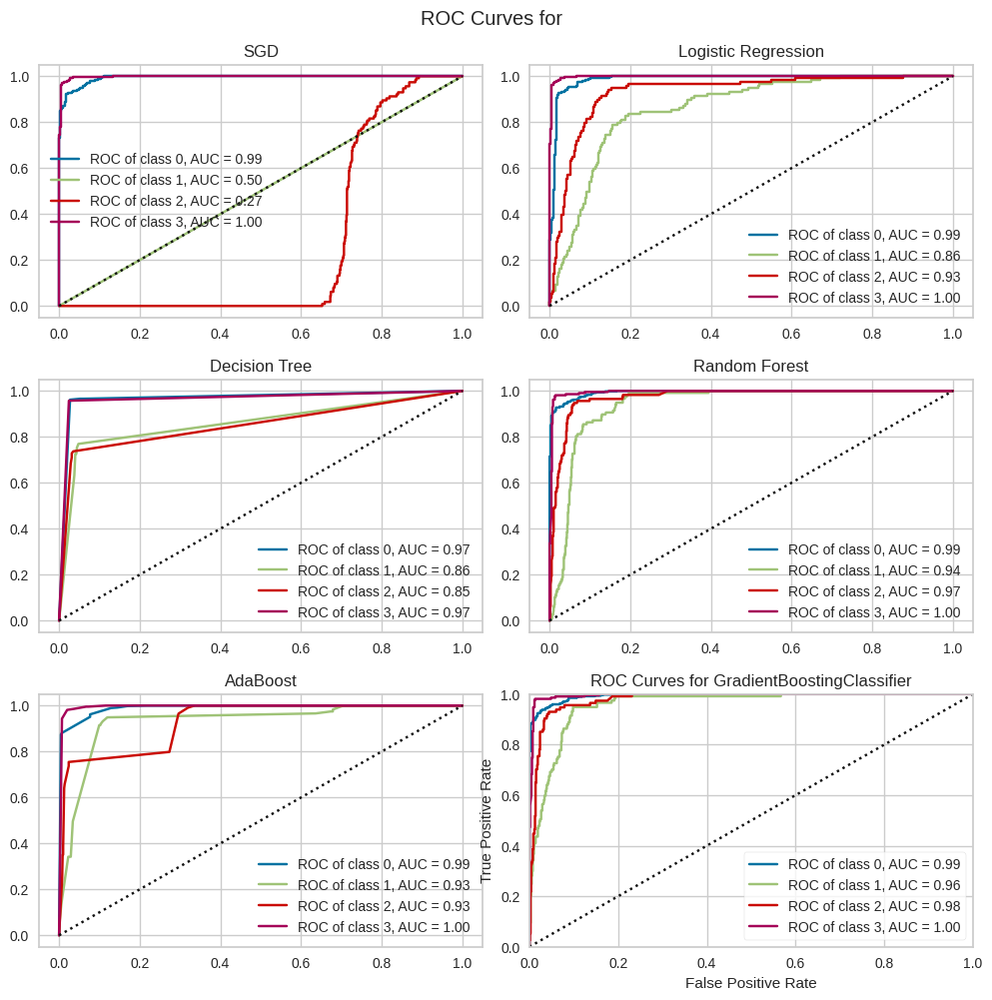

<AxesSubplot: title={'center': 'ROC Curves for GradientBoostingClassifier'}, xlabel='False Positive Rate', ylabel='True Positive Rate'>

In [77]:
ROC_curves(estimators_multiclass_u_sel, X_train_u_sel, y_train_u_sel, X_test_u_sel, y_test_u_sel, np.unique(y_users), name = 'all', features_selected = True, features = features_u_sel, feature_sel_type = 'SFS')


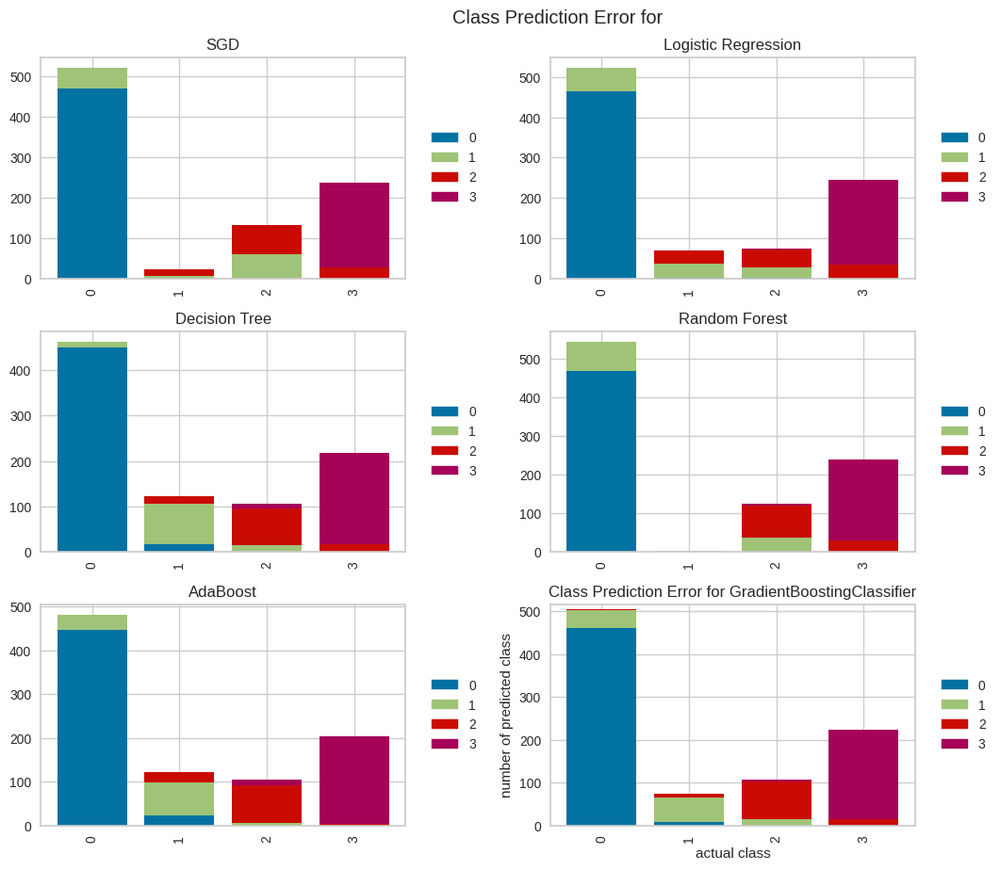

<AxesSubplot: title={'center': 'Class Prediction Error for GradientBoostingClassifier'}, xlabel='actual class', ylabel='number of predicted class'>

In [78]:
prediction_error_plot(estimators_multiclass_u_sel, X_train_u_sel, y_train_u_sel, X_test_u_sel, y_test_u_sel, np.unique(y_users), name = 'all', features_selected = True, features = features_u_sel, feature_sel_type = 'SFS')

### With feature selection (by Recursive feature elimination with cross-validation - RFECV) 

[INFO] Performing Grid-Search CV ---- SGD
[SGD] Features selected: Index(['height', 'weight', 'BMI', 'body_fat', 'total_time_users2',
       'total_reps_users2', 'total_calories_users2', 'exercises_per_user',
       'exercises_without_rest_per_user', 'body_type_thin',
       'activity_level_sedentary', 'activity_level_very active',
       'training_days_setting_2.0', 'training_days_setting_7.0'],
      dtype='object')
[SGD] Features importances: [ 0.53937272  0.          0.          0.96611053 27.84366221 32.34883411
 15.99654253 11.55752202  8.80739881  0.48918575  1.87337223  0.70477988
  0.17761799  0.13427183]


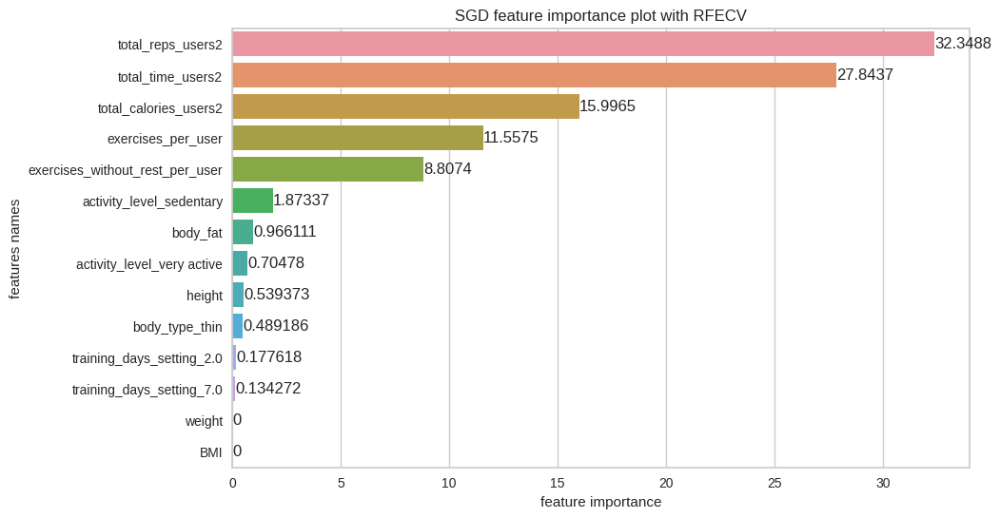

[SGD] Best parameters are {'alpha': 0.0007525, 'eta0': 0.0001, 'learning_rate': 'optimal', 'penalty': 'l1', 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Logistic Regression
[Logistic Regression] Features selected: Index(['total_time_users2', 'total_reps_users2', 'total_calories_users2',
       'exercises_per_user'],
      dtype='object')
[Logistic Regression] Features importances: [24.15281168 21.39601005  0.2069449   0.7766549 ]


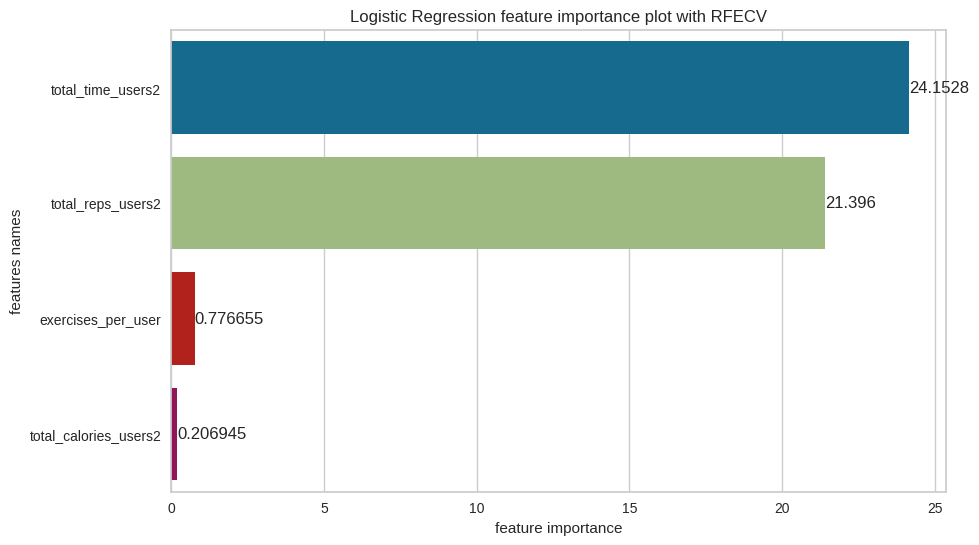

[Logistic Regression] Best parameters are {'C': 2, 'penalty': 'l1', 'random_state': 42, 'solver': 'liblinear'}
[INFO] Performing Grid-Search CV ---- Decision Tree
[Decision Tree] Features selected: Index(['BMI', 'total_time_users2', 'total_reps_users2', 'exercises_per_user',
       'exercises_without_rest_per_user'],
      dtype='object')
[Decision Tree] Features importances: [0.039938432078627864, 0.7113076629827204, 0.16323149672623147, 0.03481685197900361, 0.050705556233416535]


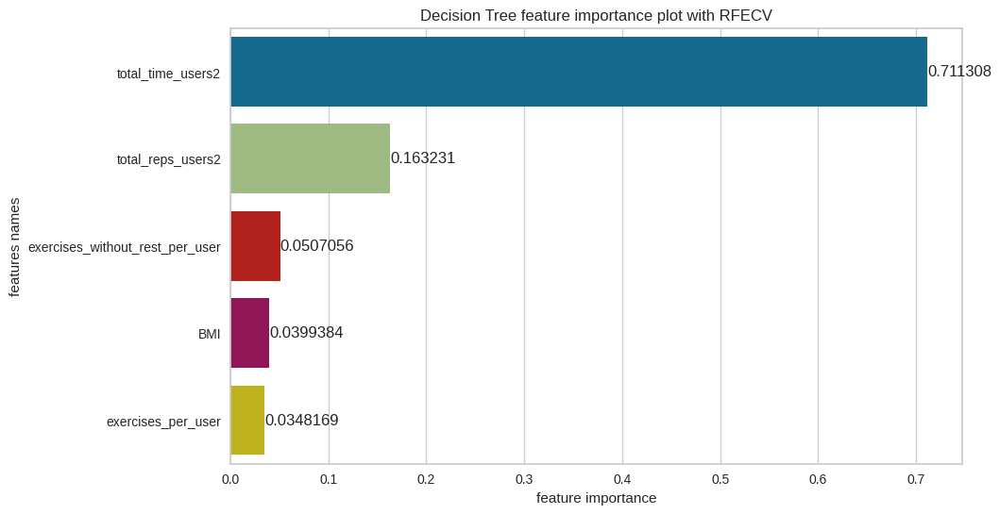

[Decision Tree] Best parameters are {'criterion': 'entropy', 'max_depth': 12, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Random Forest
[Random Forest] Features selected: Index(['height', 'weight', 'BMI', 'body_fat', 'total_time_users2',
       'total_reps_users2', 'total_calories_users2', 'exercises_per_user',
       'exercises_without_rest_per_user', 'gender_male',
       'activity_level_sedentary'],
      dtype='object')
[Random Forest] Features importances: [0.0008950487518565586, 0.00039842594615626303, 0.0007803021599718096, 0.0009149292538670306, 0.2811577468785862, 0.21488672355855243, 0.18207501490579284, 0.15998289302959098, 0.15156303938572946, 0.0003822892480860053, 0.006963586881810423]


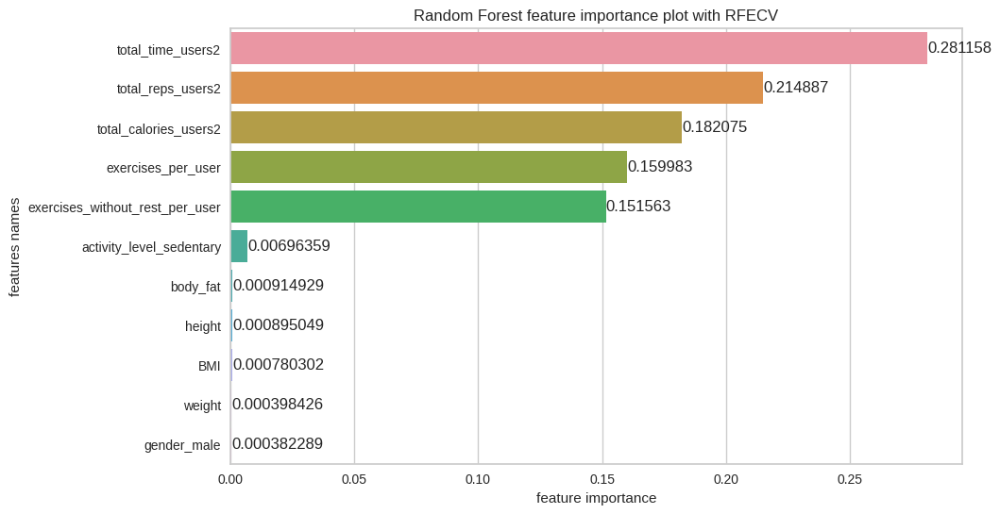

[Random Forest] Best parameters are {'criterion': 'entropy', 'max_depth': 6, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- AdaBoost
[AdaBoost] Features selected: Index(['total_reps_users2'], dtype='object')
[AdaBoost] Features importances: [1.0]


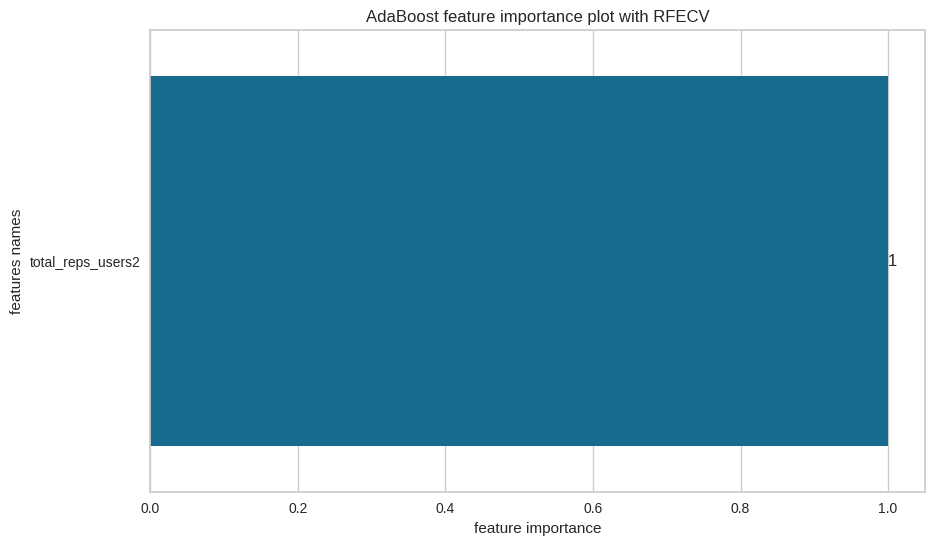

[AdaBoost] Best parameters are {'base_estimator': DecisionTreeClassifier(max_depth=2), 'learning_rate': 0.01, 'n_estimators': 80, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- GradientBoost
[GradientBoost] Features selected: Index(['height', 'BMI', 'body_fat', 'total_time_users2', 'total_reps_users2',
       'total_calories_users2', 'exercises_per_user',
       'exercises_without_rest_per_user', 'activity_level_sedentary'],
      dtype='object')
[GradientBoost] Features importances: [0.0003593914964820361, 0.0004942052081230902, 0.0, 0.40821696974724786, 0.23487072814090174, 0.09504895389262716, 0.16742868980794304, 0.09348132005283845, 9.974165383671637e-05]


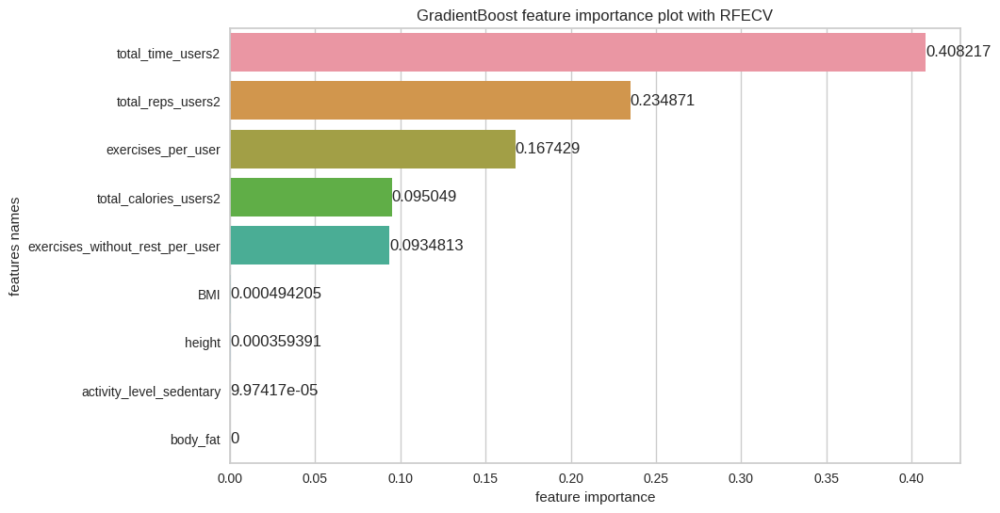

[GradientBoost] Best parameters are {'criterion': 'friedman_mse', 'learning_rate': 0.075, 'loss': 'deviance', 'max_depth': 3, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.30000000000000004, 'n_estimators': 15, 'random_state': 42, 'subsample': 0.5}


In [189]:
estimators_multiclass_u_sel_rfecv, X_test_u_sel_rfecv, y_test_u_sel_rfecv, X_train_u_sel_rfecv, y_train_u_sel_rfecv, X_test_inv_u_sel_rfecv, features_u_sel_rfecv = train(X_users, y_users, 
                                                         grid_params_multiclass, 
                                                         seed, feature_selection = True, 
                                                         feature_sel_type = 'RFECV')

In [190]:
evaluation_table_u_sel_rfecv = evaluate_multiclass(estimators_multiclass_u_sel_rfecv, X_test_u_sel_rfecv, y_test_u_sel_rfecv, no_of_labels = 4, features_selected = True, features = features_u_sel_rfecv, feature_sel_type = 'RFECV')

In [191]:
evaluation_table_u_sel_rfecv

,Overall Accuracy,Balanced Accuracy,Adj Balanced Accuracy,Precision micro,Precision macro,Precision weighted,Recall micro,Recall macro,Recall weighted,Cohen's kappa,Mathews Correlation Coefficient
SGD,0.84,0.71,0.61,0.84,0.77,0.85,0.84,0.71,0.84,0.75,0.76
Logistic Regression,0.85,0.70,0.61,0.85,0.80,0.83,0.85,0.70,0.85,0.75,0.76
Decision Tree,0.88,0.80,0.74,0.88,0.82,0.88,0.88,0.80,0.88,0.82,0.82
Random Forest,0.87,0.75,0.67,0.87,0.85,0.87,0.87,0.75,0.87,0.79,0.80
AdaBoost,0.89,0.82,0.77,0.89,0.84,0.89,0.89,0.82,0.89,0.82,0.82
GradientBoost,0.89,0.82,0.76,0.89,0.85,0.89,0.89,0.82,0.89,0.84,0.84


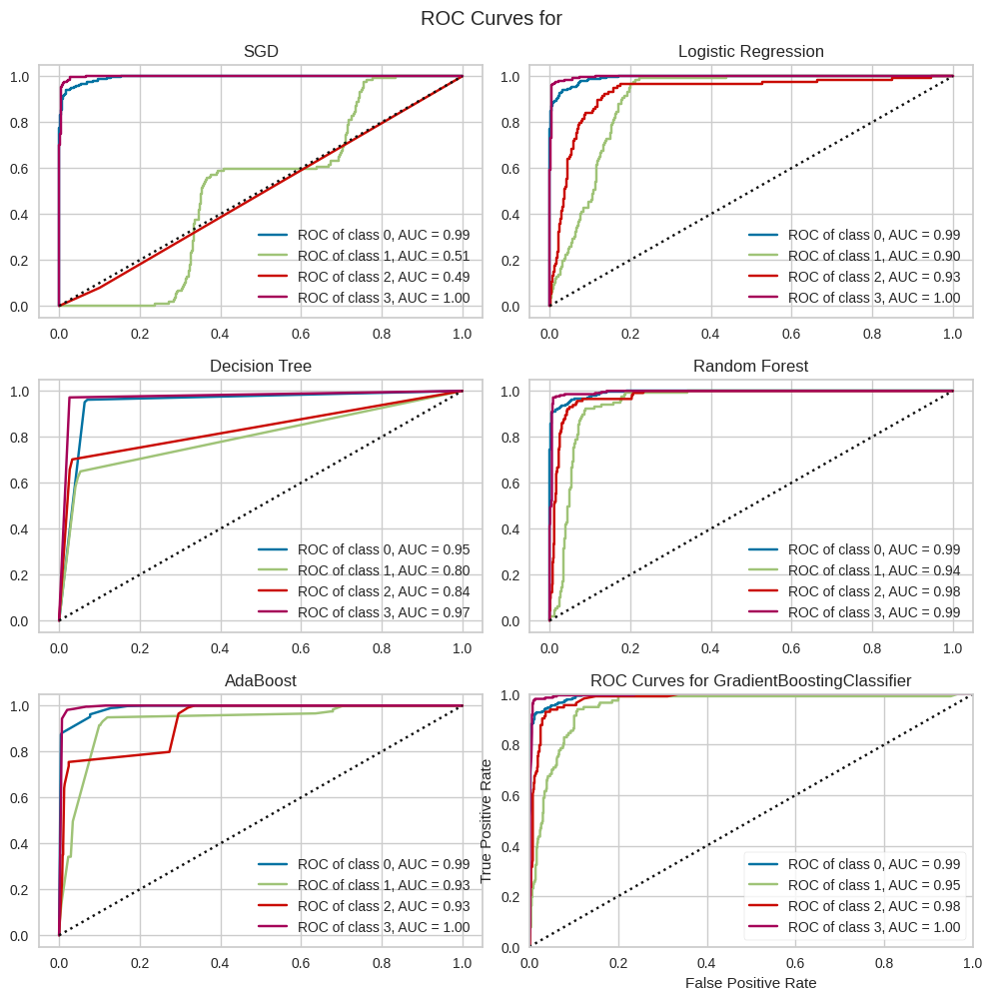

<AxesSubplot: title={'center': 'ROC Curves for GradientBoostingClassifier'}, xlabel='False Positive Rate', ylabel='True Positive Rate'>

In [200]:
ROC_curves(estimators_multiclass_u_sel_rfecv, X_train_u_sel_rfecv, y_train_u_sel_rfecv, X_test_u_sel_rfecv, y_test_u_sel_rfecv, np.unique(y_users), name = 'all', features_selected = True, features = features_u_sel_rfecv, feature_sel_type = 'RFECV')


### With feature selection (by SelectFromModel) 

[INFO] Performing Grid-Search CV ---- SGD
[SGD] Features selected: Index(['total_time_users2', 'total_reps_users2', 'total_calories_users2',
       'exercises_per_user', 'exercises_without_rest_per_user'],
      dtype='object')
[SGD] Features importances: [10.2735815  10.84331618  4.61852731  2.89472433  1.42842018]


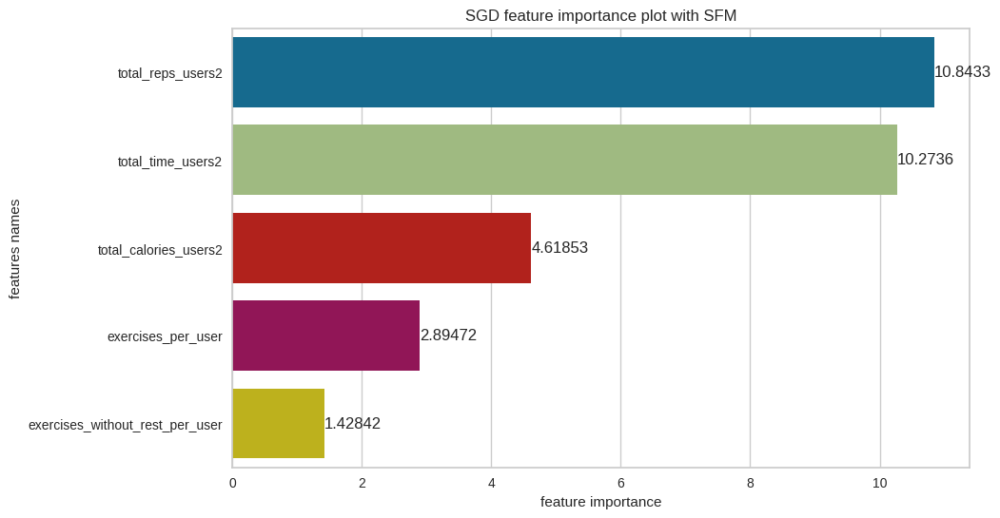

[SGD] Best parameters are {'alpha': 1e-05, 'eta0': 0.1, 'learning_rate': 'adaptive', 'penalty': 'elasticnet', 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Logistic Regression
[Logistic Regression] Features selected: Index(['total_time_users2', 'total_reps_users2', 'total_calories_users2',
       'exercises_per_user', 'exercises_without_rest_per_user'],
      dtype='object')
[Logistic Regression] Features importances: [25.57725241 24.05258519  0.55141189  8.65349382  9.81371388]


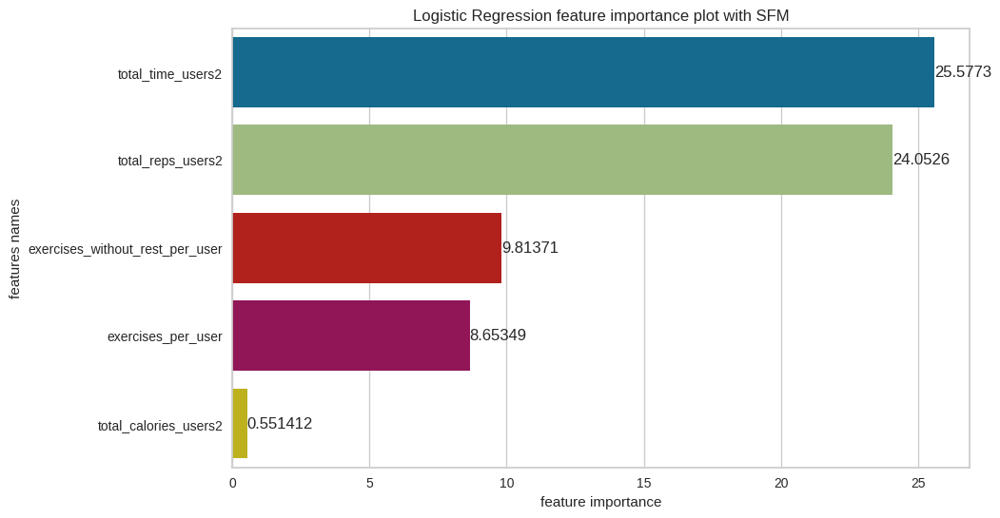

[Logistic Regression] Best parameters are {'C': 5, 'penalty': 'l1', 'random_state': 42, 'solver': 'liblinear'}
[INFO] Performing Grid-Search CV ---- Decision Tree
[Decision Tree] Features selected: Index(['total_time_users2', 'total_reps_users2'], dtype='object')
[Decision Tree] Features importances: [0.8345161144059624, 0.16548388559403757]


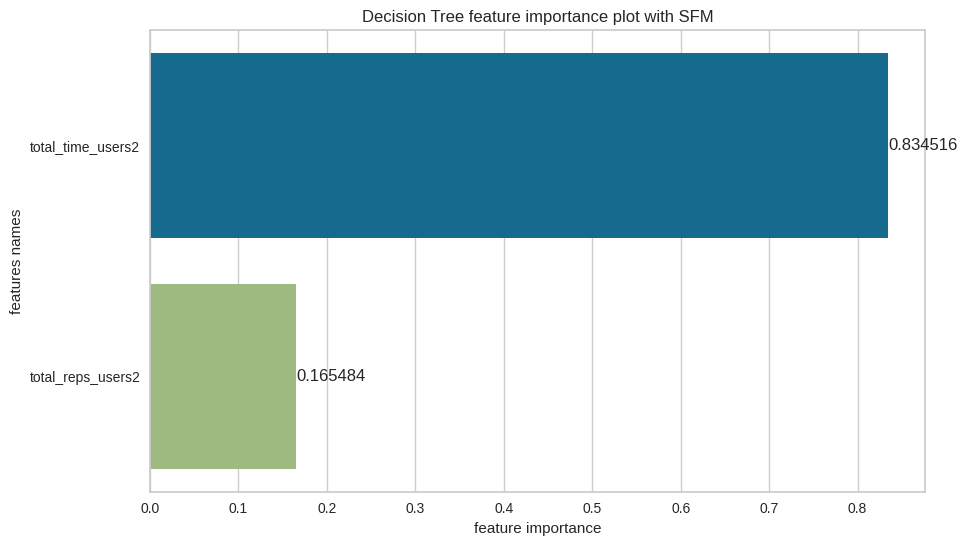

[Decision Tree] Best parameters are {'criterion': 'entropy', 'max_depth': 6, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Random Forest
[Random Forest] Features selected: Index(['total_time_users2', 'total_reps_users2', 'total_calories_users2',
       'exercises_per_user', 'exercises_without_rest_per_user'],
      dtype='object')
[Random Forest] Features importances: [0.351077990351435, 0.32199263847519116, 0.1782138099947063, 0.08423080429896511, 0.06448475687970251]


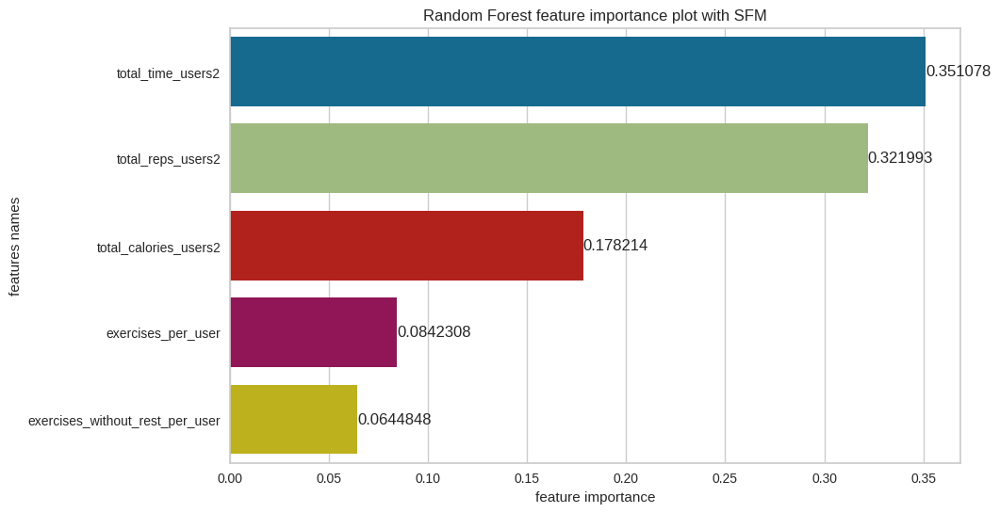

[Random Forest] Best parameters are {'criterion': 'entropy', 'max_depth': 3, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- AdaBoost
[AdaBoost] Features selected: Index(['height', 'BMI', 'total_time_users2', 'total_reps_users2',
       'total_calories_users2'],
      dtype='object')
[AdaBoost] Features importances: [0.006105329981736506, 0.0, 0.5258134675871788, 0.45820172586753893, 0.009879476563545906]


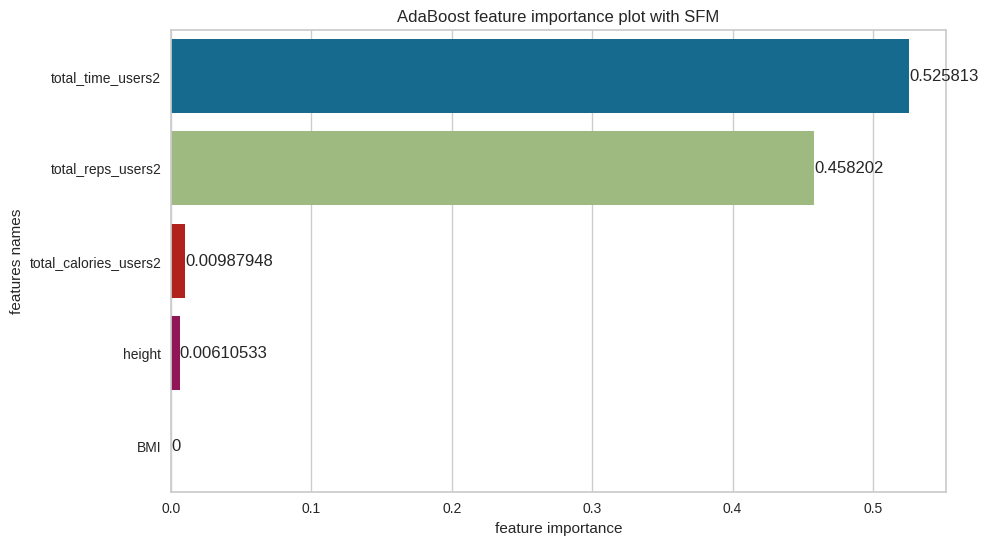

[AdaBoost] Best parameters are {'base_estimator': DecisionTreeClassifier(max_depth=2), 'learning_rate': 0.025, 'n_estimators': 20, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- GradientBoost
[GradientBoost] Features selected: Index(['total_time_users2', 'total_reps_users2'], dtype='object')
[GradientBoost] Features importances: [0.6425221585903952, 0.3574778414096048]


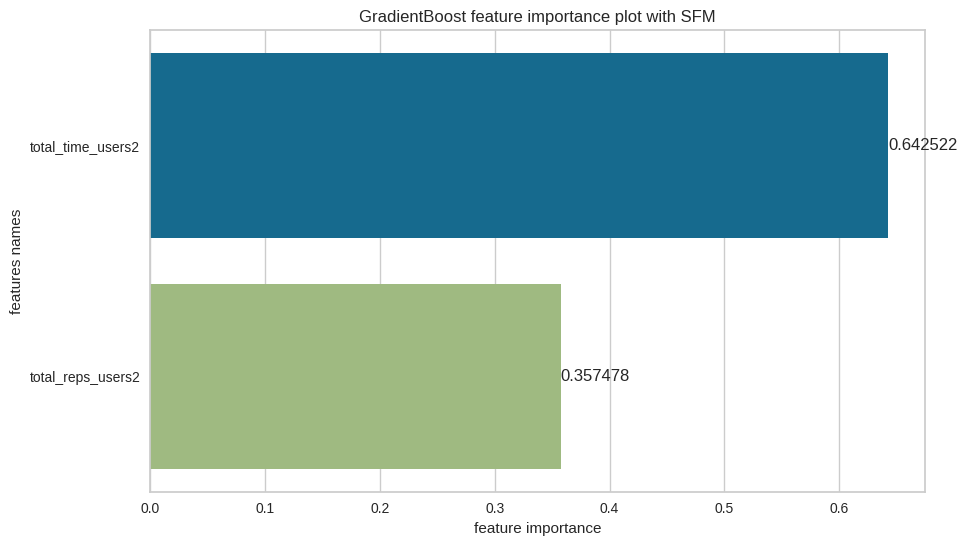

[GradientBoost] Best parameters are {'criterion': 'friedman_mse', 'learning_rate': 0.075, 'loss': 'deviance', 'max_depth': 3, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'n_estimators': 15, 'random_state': 42, 'subsample': 0.85}


In [192]:
estimators_multiclass_u_sel_sfm, X_test_u_sel_sfm, y_test_u_sel_sfm, X_train_u_sel_sfm, y_train_u_sel_sfm, X_test_inv_u_sel_sfm, features_u_sel_sfm = train(X_users, y_users, 
                                                         grid_params_multiclass, 
                                                         seed, feature_selection = True, 
                                                         feature_sel_type = 'SFM')

In [193]:
evaluation_table_u_sel_sfm = evaluate_multiclass(estimators_multiclass_u_sel_sfm, X_test_u_sel_sfm, y_test_u_sel_sfm, no_of_labels = 4, features_selected = True, features = features_u_sel_sfm, feature_sel_type = 'SFM')

In [194]:
evaluation_table_u_sel_sfm

,Overall Accuracy,Balanced Accuracy,Adj Balanced Accuracy,Precision micro,Precision macro,Precision weighted,Recall micro,Recall macro,Recall weighted,Cohen's kappa,Mathews Correlation Coefficient
SGD,0.81,0.63,0.51,0.81,0.67,0.77,0.81,0.63,0.81,0.69,0.70
Logistic Regression,0.85,0.70,0.60,0.85,0.79,0.83,0.85,0.70,0.85,0.75,0.76
Decision Tree,0.88,0.82,0.76,0.88,0.83,0.89,0.88,0.82,0.88,0.82,0.82
Random Forest,0.87,0.76,0.68,0.87,0.84,0.87,0.87,0.76,0.87,0.80,0.81
AdaBoost,0.91,0.86,0.81,0.91,0.87,0.91,0.91,0.86,0.91,0.86,0.86
GradientBoost,0.91,0.85,0.80,0.91,0.87,0.90,0.91,0.85,0.91,0.86,0.86


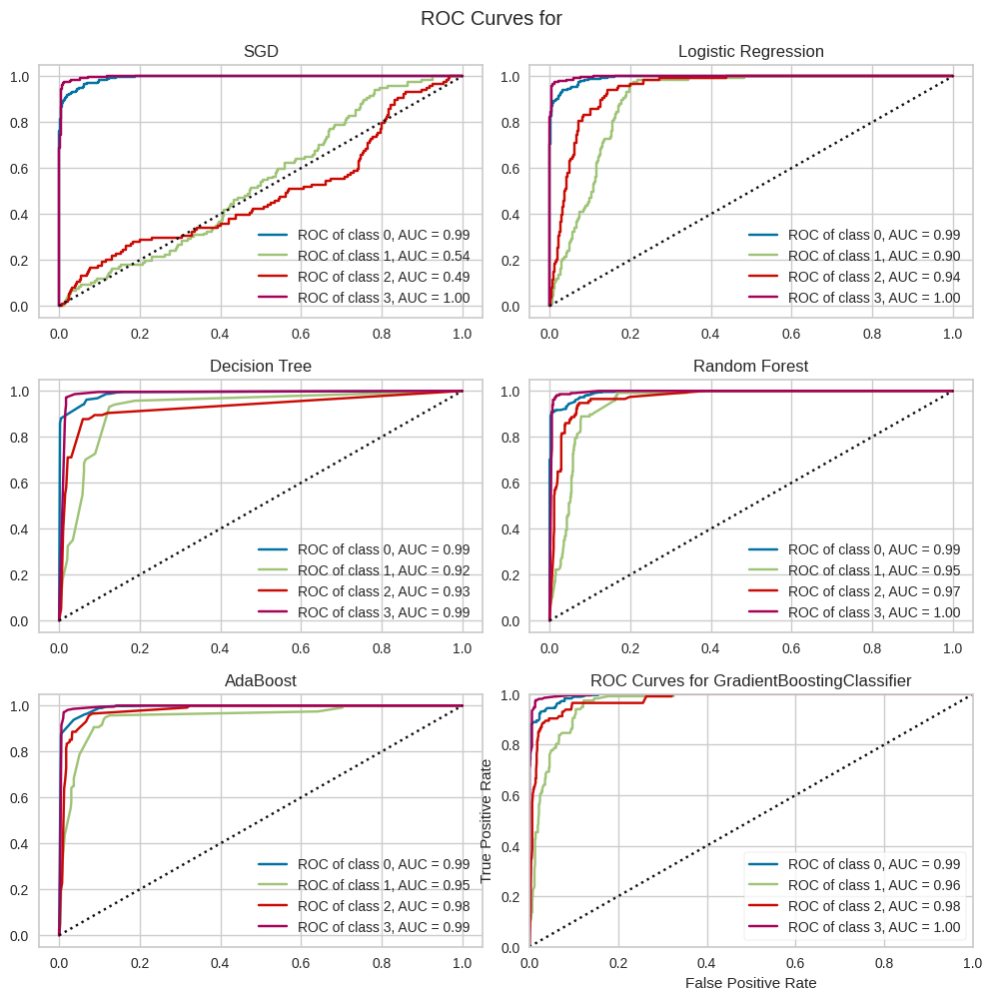

<AxesSubplot: title={'center': 'ROC Curves for GradientBoostingClassifier'}, xlabel='False Positive Rate', ylabel='True Positive Rate'>

In [201]:
ROC_curves(estimators_multiclass_u_sel_sfm, X_train_u_sel_sfm, y_train_u_sel_sfm, X_test_u_sel_sfm, y_test_u_sel_sfm, np.unique(y_users), name = 'all', features_selected = True, features = features_u_sel_sfm, feature_sel_type = 'SFM')


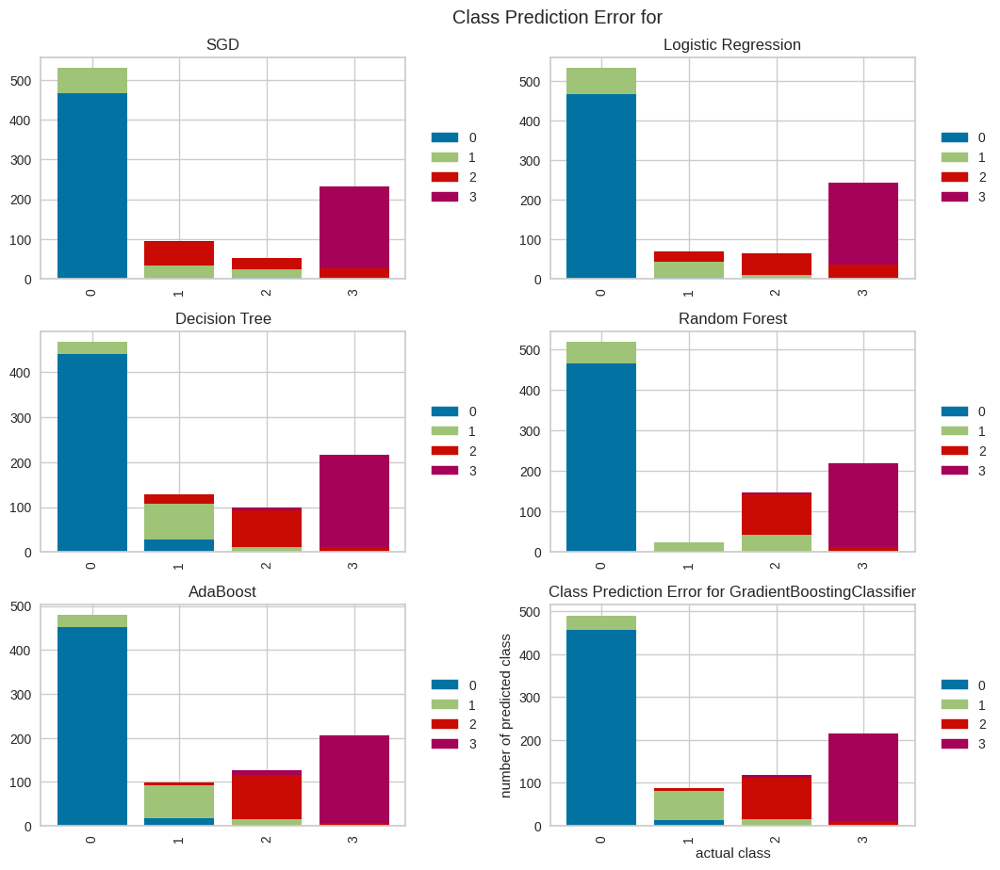

<AxesSubplot: title={'center': 'Class Prediction Error for GradientBoostingClassifier'}, xlabel='actual class', ylabel='number of predicted class'>

In [202]:
prediction_error_plot(estimators_multiclass_u_sel_sfm, X_train_u_sel_sfm, y_train_u_sel_sfm, X_test_u_sel_sfm, y_test_u_sel_sfm, np.unique(y_users), name = 'all', features_selected = True, features = features_u_sel_sfm, feature_sel_type = 'SFM')


## For session execution

In this subsection, we'll try to classify total_time_session_execution (but split into groups). The groups are:
* Group 0 - total time of session execution is less or equal 1000 seconds (about 17 minutes) - short training,
* Group 1 - total time of session execution is more than 1000 seconds and less or equal 2000 seconds (about 34 minutes) - medium length training,
* Group 2 - total time of session execution is more than 2000 seconds - long training.

The features are:
* difficulty_feedback_session_execution,
* enjoyment_feedback_session_execution,
* active_user_programs,
* completed_user_programs,
* endurance_programs,
* technique_programs,
* flexibility_programs,
* intensity_programs,
* total_reps_session_execution,
* reps_per_min_session_execution,
* calories_session_execution,
* number_exercises_in_session,
* number_exercises_without_rest_in_session.

In [203]:
X_sessions = df_session_exe.loc[:, ['difficulty_feedback_session_execution',
       'enjoyment_feedback_session_execution',  
                                         'active_user_programs', 'completed_user_programs',
                                         'endurance_programs', 'technique_programs', 'flexibility_programs',
       'intensity_programs', 
       'total_reps_session_execution','reps_per_min_session_execution', 'calories_session_execution', 
                                          'number_exercises_in_session',
       'number_exercises_without_rest_in_session']]

for col in ['difficulty_feedback_session_execution', 'enjoyment_feedback_session_execution', 
            'active_user_programs', 'completed_user_programs', 'endurance_programs',
            'technique_programs', 'flexibility_programs','intensity_programs']:
    X_sessions[col] = LabelEncoder().fit_transform(X_sessions[col])

'''
cat_cols = ['difficulty_feedback_session_execution', 'enjoyment_feedback_session_execution', 
            'active_user_programs', 'completed_user_programs', 'endurance_programs',
            'technique_programs', 'flexibility_programs','intensity_programs']
X_sessions = pd.get_dummies(X_sessions, columns = cat_cols, drop_first = True)
'''
y_sessions = []

y_labels = ['short', 'medium', 'long'] # length of session in time

for sess in df_session_exe['total_time_session_execution']:
    if sess <= 1000:
        y_sessions.append(0)
    elif sess <= 2000:
        y_sessions.append(1)
    elif sess > 2000:
        y_sessions.append(2)

y_sessions = np.array(y_sessions)

y_session = pd.DataFrame(y_sessions, columns = ['total_time_session_execution_group'])

[INFO] Performing Grid-Search CV ---- SGD
[SGD] Features importances: [1.02803121e+00 0.00000000e+00 9.13372955e-02 1.98463562e+00
 1.70543188e+00 1.81357153e+00 0.00000000e+00 7.69386487e-01
 7.76303561e+02 9.10418578e+02 1.82226399e+00 1.25772472e+00
 1.37597121e+00]


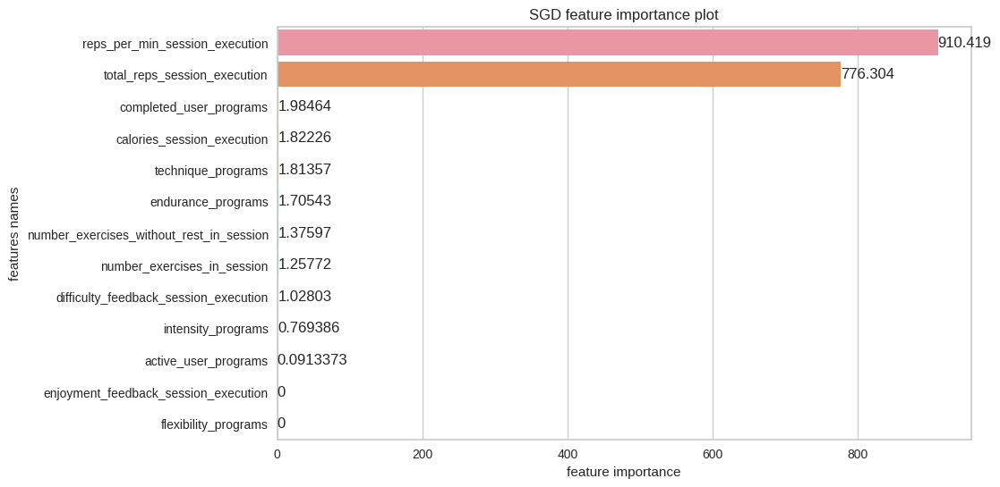

[SGD] Best parameters are {'alpha': 1e-05, 'eta0': 0.0001, 'learning_rate': 'optimal', 'penalty': 'l1', 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Logistic Regression


/home/evida-monika/anaconda3/envs/mhunters/lib/python3.10/site-packages/sklearn/svm/_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/home/evida-monika/anaconda3/envs/mhunters/lib/python3.10/site-packages/sklearn/svm/_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/home/evida-monika/anaconda3/envs/mhunters/lib/python3.10/site-packages/sklearn/svm/_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/home/evida-monika/anaconda3/envs/mhunters/lib/python3.10/site-packages/sklearn/svm/_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/home/evida-monika/anaconda3/envs/mhunters/lib/python3.10/site-packages/sklearn/svm/_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.w

[Logistic Regression] Features importances: [1.88164842e-01 2.77710561e-01 2.21855834e-02 1.37285108e-01
 1.03197337e+00 1.14878258e+00 3.23960657e-01 6.08505144e-01
 1.76178166e+02 2.45569200e+02 1.96170632e+00 8.88969948e-01
 2.00897758e-01]


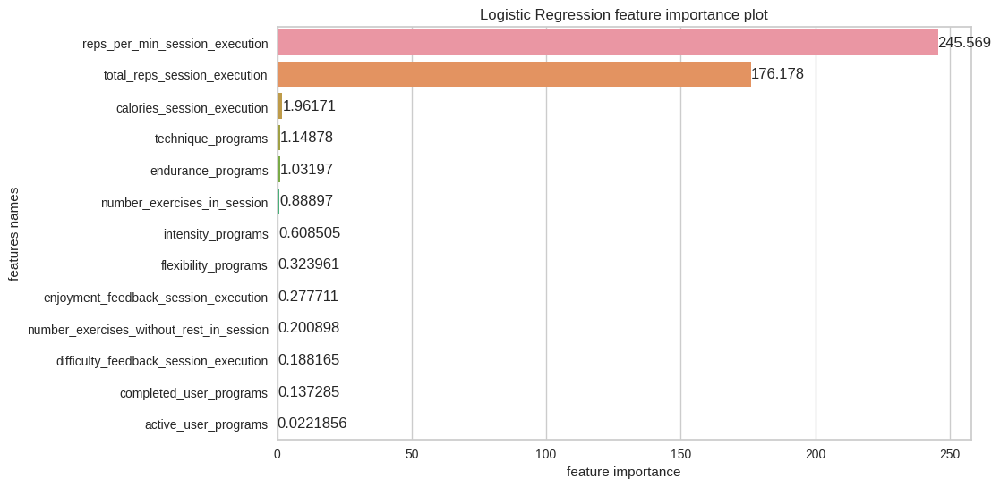

[Logistic Regression] Best parameters are {'C': 4, 'penalty': 'l1', 'random_state': 42, 'solver': 'liblinear'}
[INFO] Performing Grid-Search CV ---- Decision Tree
[Decision Tree] Features importances: [0.0017218986141198196, 0.00032797959465012287, 0.000304507211311733, 0.0006536876299099503, 0.0009235046424314234, 0.001657693602691226, 0.006378378441797001, 0.0012554949918545317, 0.17291303718744908, 0.18489361297574955, 0.5030932937326726, 0.120067329665113, 0.005809581710250129]


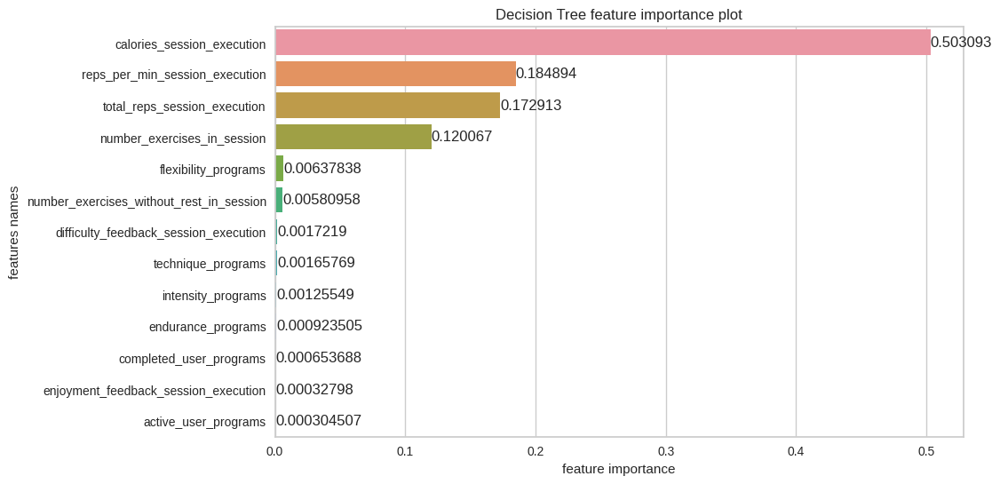

[Decision Tree] Best parameters are {'criterion': 'entropy', 'max_depth': 12, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Random Forest
[Random Forest] Features importances: [0.005042155169287114, 0.0008267725148679045, 1.3804146822725942e-05, 0.0002969617748177024, 0.017444463657359546, 0.0306776908016718, 0.003859162591084433, 0.053662714411289565, 0.17140027371514188, 0.02770513417763308, 0.3946404463158672, 0.16553079769664641, 0.1288996230275107]


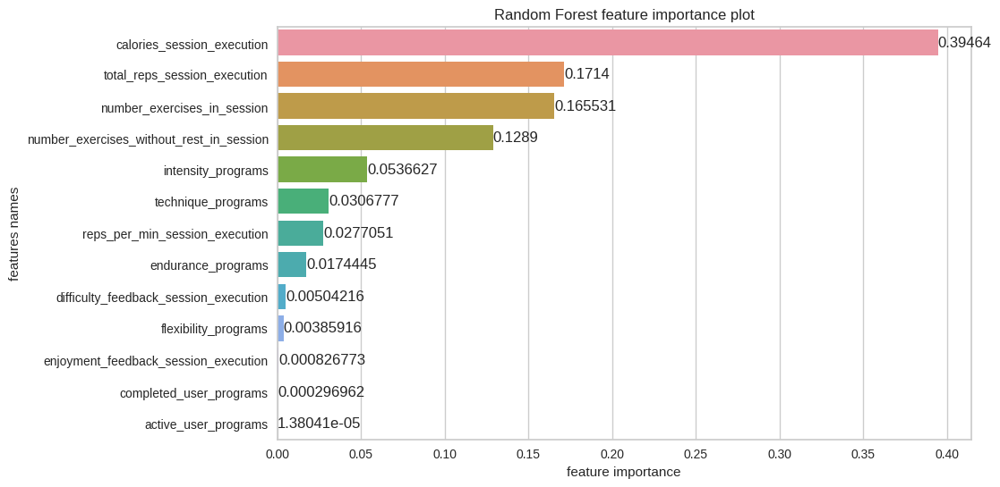

[Random Forest] Best parameters are {'criterion': 'gini', 'max_depth': 6, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- AdaBoost
[AdaBoost] Features importances: [0.0001757036868592626, 0.00042264932913445123, 2.8566314140080618e-05, 8.766372130192201e-06, 0.0016861949250539074, 0.00036231885412335807, 0.005801222585547778, 0.0012972171880840113, 0.43256964509024354, 0.3817926778239682, 0.10115828610329239, 0.04911519041562522, 0.025581561311797774]


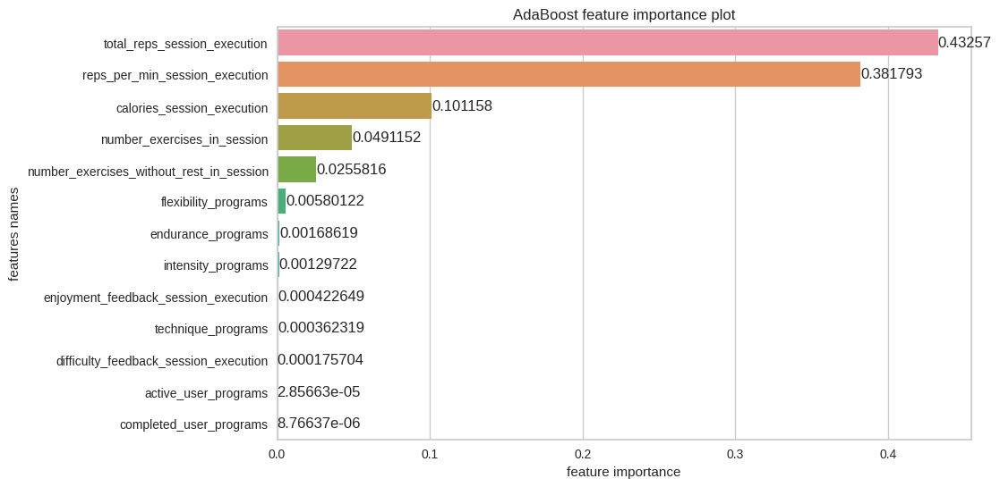

[AdaBoost] Best parameters are {'base_estimator': DecisionTreeClassifier(max_depth=5), 'learning_rate': 0.1, 'n_estimators': 80, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- GradientBoost


In [ ]:
estimators_multiclass_s, X_test_s, y_test_s, X_train_s, y_train_s, X_test_inv_s = train(X_sessions, y_sessions, 
                                                         grid_params_multiclass, 
                                                         seed = 10)

evaluation_table_s = evaluate_multiclass(estimators_multiclass_s, X_test_s, y_test_s, no_of_labels = 3)


In [ ]:
evaluation_table_s

By the majority rule (including AUC), the best algorithm with classification here is Logistic Regression with C equal to 5, penalty l1 and liblinear solver. The overall accuracy is 99% which is a very good accuracy. Micro and weighted precision is 99% and macro precision is 99%. Micro and weighted recall is 99% and macro recall is 99%. Cohen's Kappa is 0.98 and MCC is also 0.98. ROC Curves look really good and AUC scores for each class show almost perfect quality of the model. The scores are very good.

In [ ]:
prediction_for_one_user(estimators_multiclass_s, X_test_s, y_test_s, X_test_inv_s, X_sessions.columns, y_session.columns, name = 'Logistic Regression')


In [ ]:
ROC_curves(estimators_multiclass_s, X_train_s, y_train_s, X_test_s, y_test_s, np.unique(y_sessions), name = 'all')


In [ ]:
prediction_error_plot(estimators_multiclass_s, X_train_s, y_train_s, X_test_s, y_test_s, np.unique(y_sessions), name = 'all')


## For adherence

### Data preparation

In [21]:
# Preparation

df_session_exe_days_setting['YYYY/WW'].min() # min week and year is 2021/21

df_session_exe_days_setting['YYYY/WW'].max() # maximum week and year is 2022/21

# here we create new df with dates (for whole year, week by week)

week_year_table = pd.DataFrame({'Date': pd.date_range('24-05-2021', '28-05-2022')})
week_year_table = week_year_table.assign(weeknum1= week_year_table['Date'].dt.strftime('%Y/%V'))


week_year_table.rename(columns={'weeknum1': 'YYYY/WW'},
           inplace = True)

week_year_table = week_year_table.assign(weeknum2= week_year_table['Date'].dt.strftime('%V'))
week_year_table.rename(columns={'weeknum2': 'WW'},
           inplace = True)

week_year_table = week_year_table.assign(weeknum3= week_year_table['Date'].dt.strftime('%Y'))
week_year_table.rename(columns={'weeknum3': 'YYYY'},
           inplace = True)


week_year_table['YYYY/WW'] = np.where((week_year_table['YYYY/WW'] == '2022/52') & 
                           (week_year_table['Date'].dt.year == 2022) & 
                           (week_year_table['Date'].dt.month == 1) &
                           (week_year_table['Date'].dt.strftime("%V") == '52'),
                          '2021/52', week_year_table['YYYY/WW'] )

week_year_table = week_year_table.drop_duplicates(subset=['YYYY/WW'], keep = 'first').reset_index()

week_year_table.drop(['index'], axis = 1, inplace = True)

# we are copying the old dataframe

df_session_exe_days_setting_all_weeks = df_session_exe_days_setting.copy()

# here we are mergining new dataframe with the dataframe will only dates

df_session_exe_days_setting_all_weeks = df_session_exe_days_setting_all_weeks.merge(week_year_table, how = 'left', left_on = 'YYYY/WW', right_on = 'YYYY/WW')

# this is the funtion for giving dates weekly - from the start date till the end date (it will be used for each user - from first training to the last one)

def expand_dates(ser):
    return pd.DataFrame({'Date': pd.date_range(ser['Date'].min(), ser['Date'].max(), freq='W')})


newdf = df_session_exe_days_setting_all_weeks.groupby(['id_users']) # we are grouping the users and creating new df

newdf = newdf.apply(expand_dates).reset_index() # now we are using the functions

# below we merge new df with previous one, to get all of the weeks
newdf2 = newdf.merge(df_session_exe_days_setting_all_weeks, how = 'outer', left_on = ['Date', 'id_users'], right_on = ['Date', 'id_users'])

newdf2.drop(['level_1'], axis = 1, inplace = True)

newdf3 = newdf2.copy()

# we are dropping old week and year values to create new ones (for nan sake)
newdf3.drop(['YYYY/WW', 'WW', 'YYYY'], axis = 1, inplace = True)

# creation of new time variables
newdf3 = newdf3.assign(weeknum1= newdf3['Date'].dt.strftime('%Y/%V'))

newdf3.rename(columns={'weeknum1': 'YYYY/WW'},
           inplace = True)

newdf3 = newdf3.assign(weeknum2= newdf3['Date'].dt.strftime('%V'))
newdf3.rename(columns={'weeknum2': 'WW'},
           inplace = True)

newdf3 = newdf3.assign(weeknum3= newdf3['Date'].dt.strftime('%Y'))
newdf3.rename(columns={'weeknum3': 'YYYY'},
           inplace = True)


newdf3['YYYY/WW'] = np.where((newdf3['YYYY/WW'] == '2022/52') & 
                           (newdf3['Date'].dt.year == 2022) & 
                           (newdf3['Date'].dt.month == 1) &
                           (newdf3['Date'].dt.strftime("%V") == '52'),
                          '2021/52', newdf3['YYYY/WW'] )

# sorting values by id user and date, to get non-null values before the null one
newdf3.sort_values(['id_users','YYYY/WW', 'Date'], inplace = True, na_position='last')

newdf3 = newdf3.reset_index()

newdf3.drop(['index'], axis = 1, inplace = True)

newdf4 = newdf3.copy()

newdf4 = newdf4.drop_duplicates(subset = ['id_users', 'YYYY/WW'], keep = 'first')

newdf5 = newdf4.copy()

newdf5.columns

newdf5[['days_a_week_session_exe', 'training_days_goal_achieved']] = newdf5[['days_a_week_session_exe','training_days_goal_achieved']].fillna(value=0)

newdf5[['training_days_setting']] = newdf5[['training_days_setting']].fillna(method='ffill')

In [22]:
# new dataframe with all the weeks (when someone worked out and didn't workout as well)

df_session_exe_days_all_weeks = newdf5.copy() 

df_session_exe_days_all_weeks.isna().sum() # number of NA values in columns

df_session_exe_days_all_weeks['any_training_done_in_a_week'] = np.where(df_session_exe_days_all_weeks['days_a_week_session_exe'] > 0,
                                                                        1,
                                                                        0)

df_first_15_weeks = df_session_exe_days_all_weeks.groupby('id_users').head(15).reset_index(drop=True)
df_first_15_weeks_achieved_sum = df_first_15_weeks.groupby(['id_users'])['training_days_goal_achieved'].sum().reset_index()


df_first_15_weeks_achieved_sum.rename(columns = {'training_days_goal_achieved': 'no_weeks_goal_achieved_15_weeks'},
                                      inplace = True)


df_first_15_weeks_worked_sum = df_first_15_weeks.groupby(['id_users'])['training_days_goal_achieved', 'days_a_week_session_exe'].sum().reset_index()

df_first_15_weeks_worked_sum.rename(columns={'training_days_goal_achieved': 'no_weeks_goal_achieved_15_weeks',
                                             'days_a_week_session_exe': 'no_of_days_with_workout_15_weeks'},
                                    inplace = True)


df_first_15_weeks_worked_sum['Adh_cat'] = np.where((df_first_15_weeks_achieved_sum['no_weeks_goal_achieved_15_weeks'] >= 5) == True,
                                                   0,
                                                   np.where(((df_first_15_weeks_worked_sum['no_of_days_with_workout_15_weeks'] >= 5) == True) & (df_first_15_weeks_worked_sum['no_weeks_goal_achieved_15_weeks'] < 5),
                                                   1,
                                                   2))

df_users = df_users_only.loc[:, ['id_users','gender', 'activity_level', 'body_type', 'newsletter_subscription',
                                   'height', 'weight', 'BMI', 'body_fat', 'training_days_setting', 
                                'total_time_users2', 'total_reps_users2',
                                        'total_calories_users2', 'exercises_per_user', 
                                        'exercises_without_rest_per_user']]


df_users_adh_cat = df_users.merge(df_first_15_weeks_worked_sum, how = 'left', left_on = 'id_users', right_on = 'id_users')

df_users_adh_cat.drop(['id_users', 'no_weeks_goal_achieved_15_weeks', 'no_of_days_with_workout_15_weeks'], axis = 1, inplace = True)

In [23]:
l = 0
k = 0
j = 0
for i in range(len(df_users_adh_cat)):
    if (df_users_adh_cat['Adh_cat'][i] == 1) == True:
        k += 1
    elif (df_users_adh_cat['Adh_cat'][i] == 2) == True:
        l += 1
    else: 
        j += 1
        
print('Number of users that should be in group 0: {} \n Number of users that should be in group 1: {} \n Number of users that should be in group 2: {} '.format(j,k,l))


Number of users that should be in group 0: 301 
 Number of users that should be in group 1: 1244 
 Number of users that should be in group 2: 1489 


In [24]:
df_session_exe_days_all_weeks.head()

,id_users,Date,days_a_week_session_exe,training_days_setting,training_days_goal_achieved,YYYY/WW,WW,YYYY,any_training_done_in_a_week
0,108.00,2021-12-06,2.00,2.00,1.00,2021/49,49,2021,1
2,108.00,2021-12-19,0.00,2.00,0.00,2021/50,50,2021,0
3,108.00,2021-12-26,0.00,2.00,0.00,2021/51,51,2021,0
4,108.00,2022-01-02,0.00,2.00,0.00,2021/52,52,2022,0
5,108.00,2022-01-09,0.00,2.00,0.00,2022/01,01,2022,0


In [25]:
# first 4 weeks, adh = 2/4

df_first_4_weeks = df_session_exe_days_all_weeks.groupby('id_users').head(4).reset_index(drop=True)

df_first_4_weeks_achieved_sum = df_first_4_weeks.groupby(['id_users'])['training_days_goal_achieved'].sum().reset_index()

df_first_4_weeks_achieved_sum.rename(columns = {'training_days_goal_achieved': 'no_weeks_goal_achieved_4_weeks'},
                                      inplace = True)

df_first_4_weeks_achieved_sum2 = df_first_4_weeks_achieved_sum.copy()
df_first_4_weeks_achieved_sum2['Adh'] = np.where(df_first_4_weeks_achieved_sum2['no_weeks_goal_achieved_4_weeks'] >= 2,
                                               1,
                                               0)

df_users_demo = df_users_only.loc[:, ['id_users','gender', 'activity_level', 'body_type', 'newsletter_subscription',
                                   'height', 'weight', 'body_fat', ]]


df_users_demo_adh = df_users_demo.merge(df_first_4_weeks_achieved_sum2, how = 'left', left_on = 'id_users', right_on = 'id_users')

df_users_demo_adh.drop(['id_users', 'no_weeks_goal_achieved_4_weeks'], axis = 1, inplace = True)

In [26]:
# numbers of users

k = 0
j = 0
for i in range(len(df_users_demo_adh)):
    if (df_users_demo_adh['Adh'][i] == 1) == True:
        k += 1
    else: 
        j += 1
        
print('Number of users that should be in group 0: {} \n Number of users that should be in group 1: {}'.format(k, j))


Number of users that should be in group 0: 482 
 Number of users that should be in group 1: 2552


In [27]:
# first 8 weeks, adh = 2/8

df_first_8_weeks = df_session_exe_days_all_weeks.groupby('id_users').head(8).reset_index(drop=True)

df_first_8_weeks_achieved_sum = df_first_8_weeks.groupby(['id_users'])['training_days_goal_achieved'].sum().reset_index()

df_first_8_weeks_achieved_sum.rename(columns = {'training_days_goal_achieved': 'no_weeks_goal_achieved_8_weeks'},
                                      inplace = True)

df_first_8_weeks_achieved_sum2 = df_first_8_weeks_achieved_sum.copy()
df_first_8_weeks_achieved_sum2['Adh'] = np.where(df_first_8_weeks_achieved_sum2['no_weeks_goal_achieved_8_weeks'] >= 2,
                                               1,
                                               0)

df_users_demo = df_users_only.loc[:, ['id_users','gender', 'activity_level', 'body_type', 'newsletter_subscription',
                                   'height', 'weight', 'body_fat', ]]


df_users_demo_adh_8_weeks = df_users_demo.merge(df_first_8_weeks_achieved_sum2, how = 'left', left_on = 'id_users', right_on = 'id_users')

df_users_demo_adh_8_weeks.drop(['id_users', 'no_weeks_goal_achieved_8_weeks'], axis = 1, inplace = True)

In [28]:
# numbers of users

k = 0
j = 0
for i in range(len(df_users_demo_adh_8_weeks)):
    if (df_users_demo_adh_8_weeks['Adh'][i] == 1) == True:
        k += 1
    else: 
        j += 1
        
print('Number of users that should be in group 0: {} \n Number of users that should be in group 1: {}'.format(k, j))


Number of users that should be in group 0: 616 
 Number of users that should be in group 1: 2418


In [29]:
# first 12 weeks, adh = 2/12

df_first_12_weeks = df_session_exe_days_all_weeks.groupby('id_users').head(12).reset_index(drop=True)

df_first_12_weeks_achieved_sum = df_first_12_weeks.groupby(['id_users'])['training_days_goal_achieved'].sum().reset_index()

df_first_12_weeks_achieved_sum.rename(columns = {'training_days_goal_achieved': 'no_weeks_goal_achieved_12_weeks'},
                                      inplace = True)

df_first_12_weeks_achieved_sum2 = df_first_12_weeks_achieved_sum.copy()
df_first_12_weeks_achieved_sum2['Adh'] = np.where(df_first_12_weeks_achieved_sum2['no_weeks_goal_achieved_12_weeks'] >= 2,
                                               1,
                                               0)

df_users_demo = df_users_only.loc[:, ['id_users','gender', 'activity_level', 'body_type', 'newsletter_subscription',
                                   'height', 'weight', 'body_fat', ]]


df_users_demo_adh_12_weeks = df_users_demo.merge(df_first_12_weeks_achieved_sum2, how = 'left', left_on = 'id_users', right_on = 'id_users')

df_users_demo_adh_12_weeks.drop(['id_users', 'no_weeks_goal_achieved_12_weeks'], axis = 1, inplace = True)

In [30]:
# numbers of users

k = 0
j = 0
for i in range(len(df_users_demo_adh_12_weeks)):
    if (df_users_demo_adh_12_weeks['Adh'][i] == 1) == True:
        k += 1
    else: 
        j += 1
        
print('Number of users that should be in group 0: {} \n Number of users that should be in group 1: {}'.format(k, j))


Number of users that should be in group 0: 695 
 Number of users that should be in group 1: 2339


In [31]:
# first 8 weeks, adh = 3/8

df_first_8_weeks2 = df_session_exe_days_all_weeks.groupby('id_users').head(8).reset_index(drop=True)

df_first_8_weeks_achieved_sum2 = df_first_8_weeks.groupby(['id_users'])['training_days_goal_achieved'].sum().reset_index()

df_first_8_weeks_achieved_sum2.rename(columns = {'training_days_goal_achieved': 'no_weeks_goal_achieved_8_weeks'},
                                      inplace = True)

df_first_8_weeks_achieved_sum22 = df_first_8_weeks_achieved_sum2.copy()
df_first_8_weeks_achieved_sum22['Adh'] = np.where(df_first_8_weeks_achieved_sum22['no_weeks_goal_achieved_8_weeks'] >= 3,
                                               1,
                                               0)

df_users_demo = df_users_only.loc[:, ['id_users','gender', 'activity_level', 'body_type', 'newsletter_subscription',
                                   'height', 'weight', 'body_fat', ]]


df_users_demo_adh_8_weeks2 = df_users_demo.merge(df_first_8_weeks_achieved_sum22, how = 'left', left_on = 'id_users', right_on = 'id_users')

df_users_demo_adh_8_weeks2.drop(['id_users', 'no_weeks_goal_achieved_8_weeks'], axis = 1, inplace = True)

In [32]:
# numbers of users

k = 0
j = 0
for i in range(len(df_users_demo_adh_8_weeks2)):
    if (df_users_demo_adh_8_weeks2['Adh'][i] == 1) == True:
        k += 1
    else: 
        j += 1
        
print('Number of users that should be in group 0: {} \n Number of users that should be in group 1: {}'.format(k, j))


Number of users that should be in group 0: 407 
 Number of users that should be in group 1: 2627


In [33]:
# first 4 weeks, adh = 1/4 weeks

df_first_4_weeks_achieved_sum3 = df_first_4_weeks_achieved_sum.copy()

df_first_4_weeks_achieved_sum3['Adh'] = np.where(df_first_4_weeks_achieved_sum3['no_weeks_goal_achieved_4_weeks'] >= 1,
                                               1,
                                               0)

df_users_demo2 = df_users_only.loc[:, ['id_users','gender', 'activity_level', 'body_type', 'newsletter_subscription',
                                   'height', 'weight', 'body_fat', ]]


df_users_demo_adh2 = df_users_demo2.merge(df_first_4_weeks_achieved_sum3, how = 'left', left_on = 'id_users', right_on = 'id_users')

df_users_demo_adh2.drop(['id_users', 'no_weeks_goal_achieved_4_weeks'], axis = 1, inplace = True)

In [34]:
# numbers of users

k = 0
j = 0
for i in range(len(df_users_demo_adh2)):
    if (df_users_demo_adh2['Adh'][i] == 1) == True:
        k += 1
    else: 
        j += 1
        
print('Number of users that should be in group 0: {} \n Number of users that should be in group 1: {}'.format(k, j))


Number of users that should be in group 0: 993 
 Number of users that should be in group 1: 2041


In [35]:
# first 8 weeks, adh = 1/8

df_first_8_weeks_1 = df_session_exe_days_all_weeks.groupby('id_users').head(8).reset_index(drop=True)

df_first_8_weeks_1_achieved_sum = df_first_8_weeks_1.groupby(['id_users'])['training_days_goal_achieved'].sum().reset_index()

df_first_8_weeks_1_achieved_sum.rename(columns = {'training_days_goal_achieved': 'no_weeks_goal_achieved_8_weeks_1'},
                                      inplace = True)

df_first_8_weeks_1_achieved_sum2 = df_first_8_weeks_1_achieved_sum.copy()
df_first_8_weeks_1_achieved_sum2['Adh'] = np.where(df_first_8_weeks_1_achieved_sum2['no_weeks_goal_achieved_8_weeks_1'] >= 1,
                                               1,
                                               0)

df_users_demo = df_users_only.loc[:, ['id_users','gender', 'activity_level', 'body_type', 'newsletter_subscription',
                                   'height', 'weight', 'body_fat', ]]


df_users_demo_adh_8_weeks_1 = df_users_demo.merge(df_first_8_weeks_1_achieved_sum2, how = 'left', left_on = 'id_users', right_on = 'id_users')

df_users_demo_adh_8_weeks_1.drop(['id_users', 'no_weeks_goal_achieved_8_weeks_1'], axis = 1, inplace = True)

# numbers of users

k = 0
j = 0
for i in range(len(df_users_demo_adh_8_weeks_1)):
    if (df_users_demo_adh_8_weeks_1['Adh'][i] == 1) == True:
        k += 1
    else: 
        j += 1
        
print('Number of users that should be in group 0: {} \n Number of users that should be in group 1: {}'.format(k, j))


Number of users that should be in group 0: 1101 
 Number of users that should be in group 1: 1933


In [36]:
# first 12 weeks, adh = 1/12

df_first_12_weeks_1 = df_session_exe_days_all_weeks.groupby('id_users').head(12).reset_index(drop=True)

df_first_12_weeks_1_achieved_sum = df_first_12_weeks_1.groupby(['id_users'])['training_days_goal_achieved'].sum().reset_index()

df_first_12_weeks_1_achieved_sum.rename(columns = {'training_days_goal_achieved': 'no_weeks_goal_achieved_12_weeks_1'},
                                      inplace = True)

df_first_12_weeks_1_achieved_sum2 = df_first_12_weeks_1_achieved_sum.copy()
df_first_12_weeks_1_achieved_sum2['Adh'] = np.where(df_first_12_weeks_1_achieved_sum2['no_weeks_goal_achieved_12_weeks_1'] >= 1,
                                               1,
                                               0)

df_users_demo = df_users_only.loc[:, ['id_users','gender', 'activity_level', 'body_type', 'newsletter_subscription',
                                   'height', 'weight', 'body_fat', ]]


df_users_demo_adh_12_weeks_1 = df_users_demo.merge(df_first_12_weeks_1_achieved_sum2, how = 'left', left_on = 'id_users', right_on = 'id_users')

df_users_demo_adh_12_weeks_1.drop(['id_users', 'no_weeks_goal_achieved_12_weeks_1'], axis = 1, inplace = True)

# numbers of users

k = 0
j = 0
for i in range(len(df_users_demo_adh_12_weeks_1)):
    if (df_users_demo_adh_12_weeks_1['Adh'][i] == 1) == True:
        k += 1
    else: 
        j += 1
        
print('Number of users that should be in group 0: {} \n Number of users that should be in group 1: {}'.format(k, j))


Number of users that should be in group 0: 1166 
 Number of users that should be in group 1: 1868


In [37]:
# first 12 weeks, adh = 4/12 weeks

df_first_12_weeks = df_session_exe_days_all_weeks.groupby('id_users').head(12).reset_index(drop=True)

df_first_12_weeks_achieved_sum = df_first_12_weeks.groupby(['id_users'])['training_days_goal_achieved'].sum().reset_index()

df_first_12_weeks_achieved_sum.rename(columns = {'training_days_goal_achieved': 'no_weeks_goal_achieved_12_weeks'},
                                      inplace = True)

df_first_12_weeks_achieved_sum2 = df_first_12_weeks_achieved_sum.copy()
df_first_12_weeks_achieved_sum2['Adh'] = np.where(df_first_12_weeks_achieved_sum2['no_weeks_goal_achieved_12_weeks'] >= 4,
                                               1,
                                               0)

df_users_adh_12_weeks = df_users.merge(df_first_12_weeks_achieved_sum2, how = 'left', left_on = 'id_users', right_on = 'id_users')

df_users_adh_12_weeks.drop(['id_users', 'no_weeks_goal_achieved_12_weeks'], axis = 1, inplace = True)


In [38]:
k = 0
j = 0
for i in range(len(df_users_adh_12_weeks)):
    if (df_users_adh_12_weeks['Adh'][i] == 1) == True:
        k += 1
    else: 
        j += 1
        
print('Number of users that should be in group 0: {} \n Number of users that should be in group 1: {}'.format(j,k))


Number of users that should be in group 0: 2683 
 Number of users that should be in group 1: 351


In [39]:
# first 4 weeks for any training done, adh = 2/4

df_first_4_weeks_any = df_session_exe_days_all_weeks.groupby('id_users').head(4).reset_index(drop=True)

df_first_4_weeks_any_achieved_sum = df_first_4_weeks_any.groupby(['id_users'])['any_training_done_in_a_week'].sum().reset_index()

df_first_4_weeks_any_achieved_sum.rename(columns = {'any_training_done_in_a_week': 'no_weeks_trained_4_weeks'},
                                      inplace = True)

df_first_4_weeks_any_achieved_sum2 = df_first_4_weeks_any_achieved_sum.copy()
df_first_4_weeks_any_achieved_sum2['Adh'] = np.where(df_first_4_weeks_any_achieved_sum2['no_weeks_trained_4_weeks'] >= 2,
                                               1,
                                               0)

df_users_demo = df_users_only.loc[:, ['id_users','gender', 'activity_level', 'body_type', 'newsletter_subscription',
                                   'height', 'weight', 'body_fat', ]]


df_users_demo_any_adh = df_users_demo.merge(df_first_4_weeks_any_achieved_sum2, how = 'left', left_on = 'id_users', right_on = 'id_users')

df_users_demo_any_adh.drop(['id_users', 'no_weeks_trained_4_weeks'], axis = 1, inplace = True)

In [40]:
# numbers of users

k = 0
j = 0
for i in range(len(df_users_demo_any_adh)):
    if (df_users_demo_any_adh['Adh'][i] == 1) == True:
        k += 1
    else: 
        j += 1
        
print('Number of users that should be in group 0: {} \n Number of users that should be in group 1: {}'.format(k, j))


Number of users that should be in group 0: 1848 
 Number of users that should be in group 1: 1186


In [41]:
# first 4 weeks for any training done, adh = 3/4

df_first_4_weeks_any = df_session_exe_days_all_weeks.groupby('id_users').head(4).reset_index(drop=True)

df_first_4_weeks_any_achieved_sum = df_first_4_weeks_any.groupby(['id_users'])['any_training_done_in_a_week'].sum().reset_index()

df_first_4_weeks_any_achieved_sum.rename(columns = {'any_training_done_in_a_week': 'no_weeks_trained_4_weeks'},
                                      inplace = True)

df_first_4_weeks_any_achieved_sum3 = df_first_4_weeks_any_achieved_sum.copy()
df_first_4_weeks_any_achieved_sum3['Adh'] = np.where(df_first_4_weeks_any_achieved_sum3['no_weeks_trained_4_weeks'] >= 3,
                                               1,
                                               0)

df_users_demo = df_users_only.loc[:, ['id_users','gender', 'activity_level', 'body_type', 'newsletter_subscription',
                                   'height', 'weight', 'body_fat', ]]


df_users_demo_any_adh_3 = df_users_demo.merge(df_first_4_weeks_any_achieved_sum3, how = 'left', left_on = 'id_users', right_on = 'id_users')

df_users_demo_any_adh_3.drop(['id_users', 'no_weeks_trained_4_weeks'], axis = 1, inplace = True)

# numbers of users

k = 0
j = 0
for i in range(len(df_users_demo_any_adh_3)):
    if (df_users_demo_any_adh_3['Adh'][i] == 1) == True:
        k += 1
    else: 
        j += 1
        
print('Number of users that should be in group 0: {} \n Number of users that should be in group 1: {}'.format(j, k))



Number of users that should be in group 0: 1822 
 Number of users that should be in group 1: 1212


In [42]:
# first 8 weeks for any training done, adh = 3/8

df_first_8_weeks_any = df_session_exe_days_all_weeks.groupby('id_users').head(8).reset_index(drop=True)

df_first_8_weeks_any_achieved_sum = df_first_8_weeks_any.groupby(['id_users'])['any_training_done_in_a_week'].sum().reset_index()

df_first_8_weeks_any_achieved_sum.rename(columns = {'any_training_done_in_a_week': 'no_weeks_trained_8_weeks'},
                                      inplace = True)

df_first_8_weeks_any_achieved_sum3 = df_first_8_weeks_any_achieved_sum.copy()
df_first_8_weeks_any_achieved_sum3['Adh'] = np.where(df_first_8_weeks_any_achieved_sum3['no_weeks_trained_8_weeks'] >= 3,
                                               1,
                                               0)

df_users_demo = df_users_only.loc[:, ['id_users','gender', 'activity_level', 'body_type', 'newsletter_subscription',
                                   'height', 'weight', 'body_fat', ]]


df_users_demo_any_adh_8_3 = df_users_demo.merge(df_first_8_weeks_any_achieved_sum3, how = 'left', left_on = 'id_users', right_on = 'id_users')

df_users_demo_any_adh_8_3.drop(['id_users', 'no_weeks_trained_8_weeks'], axis = 1, inplace = True)

# numbers of users

k = 0
j = 0
for i in range(len(df_users_demo_any_adh_8_3)):
    if (df_users_demo_any_adh_8_3['Adh'][i] == 1) == True:
        k += 1
    else: 
        j += 1
        
print('Number of users that should be in group 0: {} \n Number of users that should be in group 1: {}'.format(j,k))



Number of users that should be in group 0: 1565 
 Number of users that should be in group 1: 1469


In [43]:
# first 8 weeks for any training done, adh = 4/8

df_first_8_weeks_any = df_session_exe_days_all_weeks.groupby('id_users').head(8).reset_index(drop=True)

df_first_8_weeks_any_achieved_sum = df_first_8_weeks_any.groupby(['id_users'])['any_training_done_in_a_week'].sum().reset_index()

df_first_8_weeks_any_achieved_sum.rename(columns = {'any_training_done_in_a_week': 'no_weeks_trained_8_weeks'},
                                      inplace = True)

df_first_8_weeks_any_achieved_sum4 = df_first_8_weeks_any_achieved_sum.copy()
df_first_8_weeks_any_achieved_sum4['Adh'] = np.where(df_first_8_weeks_any_achieved_sum4['no_weeks_trained_8_weeks'] >= 4,
                                               1,
                                               0)

df_users_demo = df_users_only.loc[:, ['id_users','gender', 'activity_level', 'body_type', 'newsletter_subscription',
                                   'height', 'weight', 'body_fat', ]]


df_users_demo_any_adh_8_4 = df_users_demo.merge(df_first_8_weeks_any_achieved_sum4, how = 'left', left_on = 'id_users', right_on = 'id_users')

df_users_demo_any_adh_8_4.drop(['id_users', 'no_weeks_trained_8_weeks'], axis = 1, inplace = True)

# numbers of users

k = 0
j = 0
for i in range(len(df_users_demo_any_adh_8_4)):
    if (df_users_demo_any_adh_8_4['Adh'][i] == 1) == True:
        k += 1
    else: 
        j += 1
        
print('Number of users that should be in group 0: {} \n Number of users that should be in group 1: {}'.format(j,k))



Number of users that should be in group 0: 1902 
 Number of users that should be in group 1: 1132


### First approach (first 15 weeks, 3 groups, all of the users variables)

First, we need to define adherence. For classification problem, we can think about adherence as groups. We can get those groups, for example, by looking at the first 15 weeks of workouts and:

* Group 0 - the user accomplished his training days setting at least five times (example: user had training days setting set at 3 days a week and he worked out 3 days a week for 7 weeks) - 301 users,
* Group 1 - the user didn't accomplish his training days setting at least 5 times, but the user worked out at least once 5 times in those 15 weeks - 1244 users,
* Group 2 - the user didn't accomplish his training days setting at least 5 times and didn't workout even 5 times - 1489 users. 

This is the first approach to the classification problem with adherence.

The variables taken into consideration are:
* gender,
* height,
* weight,
* BMI,
* activity level,
* body type,
* newsletter subscription,
* body fat,
* training days setting,
* total time users,
* total reps users,
* total calories users,
* exercises per user,
* exercises without rest per user.

In [44]:
# deleting label from data
X_adh_cat = df_users_adh_cat.loc[:, df_users_adh_cat.columns != 'Adh_cat']

# variable only with label
y_adh_cat = df_users_adh_cat['Adh_cat'].to_numpy()
'''
for col in ['gender', 'body_type', 'newsletter_subscription', 'activity_level', 'training_days_setting']:
    X_adh_cat[col] = LabelEncoder().fit_transform(X_adh_cat[col])
'''

cat_cols = ['gender', 'body_type', 'newsletter_subscription', 'activity_level', 'training_days_setting']
X_adh_cat = pd.get_dummies(X_adh_cat, columns = cat_cols, drop_first = True)

y_adh_ca = pd.DataFrame(y_adh_cat, columns = ['Adherence cat'])

[INFO] Performing Grid-Search CV ---- SGD
[SGD] Features importances: [ 0.21159602  0.41471708  0.17858496  0.76130439 17.86869246 13.74131767
 18.04886943  1.29228322  2.64900467  0.19274397  0.          0.21102738
  0.06322656  0.50121339  0.937032    0.61596379  0.81516047  1.37146271
  2.00460146  0.75719678  2.49655643]


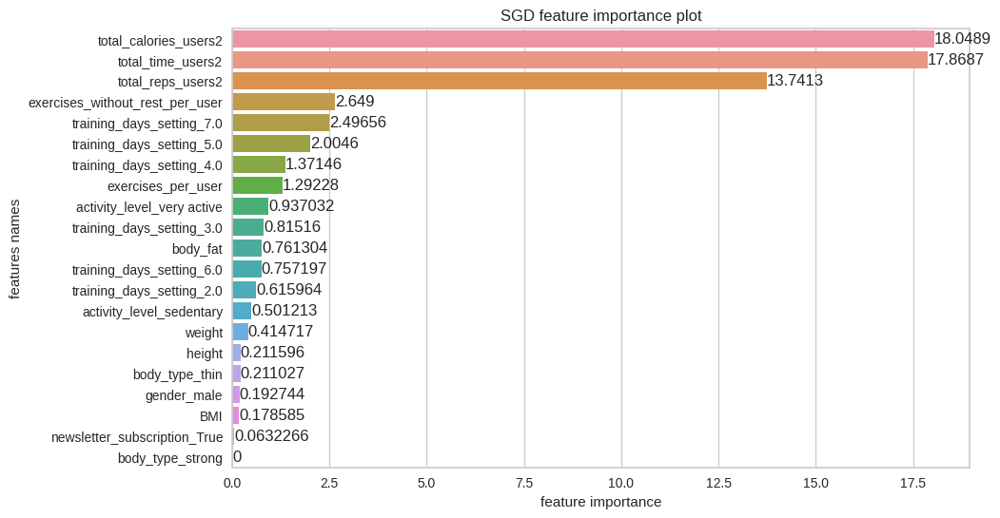

[SGD] Best parameters are {'alpha': 0.0007525, 'eta0': 0.0001, 'learning_rate': 'optimal', 'penalty': 'l1', 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Logistic Regression
[Logistic Regression] Features importances: [ 0.40364279  0.05923301  0.35166038  0.43184491 10.50222393 11.29883448
  4.65208156  4.42280715  5.92014895  0.31145261  0.08208196  0.12786253
  0.25656825  0.23218069  0.37170155  0.71599712  1.81710611  2.24978218
  2.93468221  1.31562964  2.09291491]


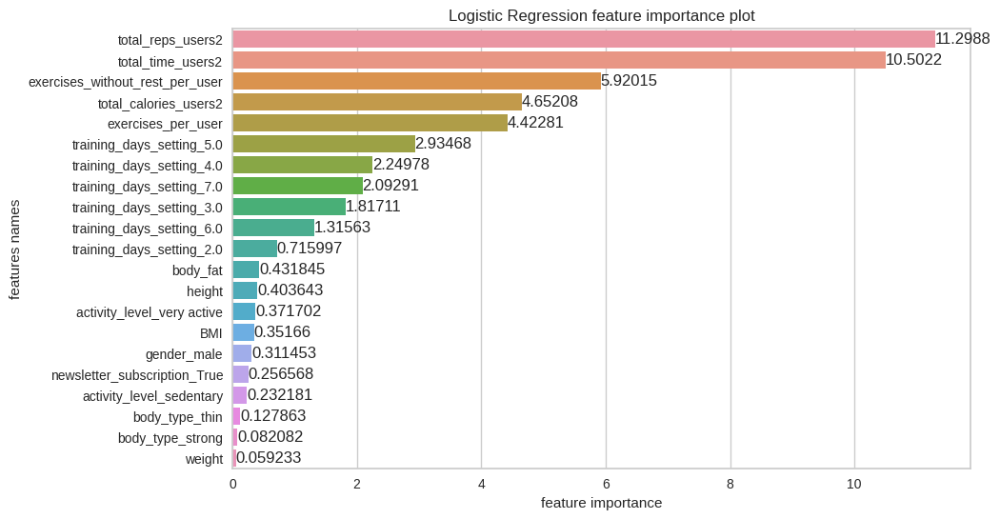

[Logistic Regression] Best parameters are {'C': 2, 'penalty': 'l1', 'random_state': 42, 'solver': 'liblinear'}
[INFO] Performing Grid-Search CV ---- Decision Tree
[Decision Tree] Features importances: [0.0, 0.0, 0.005432708521755707, 0.0, 0.16831230124775823, 0.7005679514647911, 0.02998743768227833, 0.0144980829173479, 0.03436826292223089, 0.0, 0.0, 0.0027785533406841775, 0.0, 0.0, 0.015467088441179302, 0.014851361787909776, 0.010824128488190565, 0.0029121231858739217, 0.0, 0.0, 0.0]


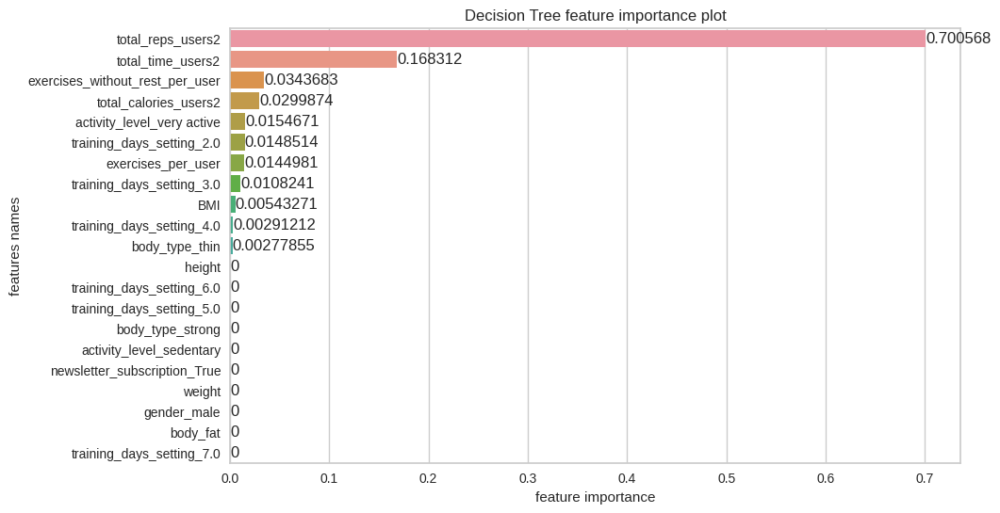

[Decision Tree] Best parameters are {'criterion': 'gini', 'max_depth': 6, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Random Forest
[Random Forest] Features importances: [0.005102464838127966, 0.000979861577813393, 0.011440787730463082, 0.0074726310212864175, 0.30944867667401466, 0.17459269131122987, 0.18706968219894554, 0.10114260729686314, 0.18737486682117682, 0.007547764054538571, 0.0, 9.037190513215394e-05, 0.00026604557759880707, 0.007207355864249714, 0.0, 0.0, 7.463096294066833e-05, 0.0001895621656192604, 0.0, 0.0, 0.0]


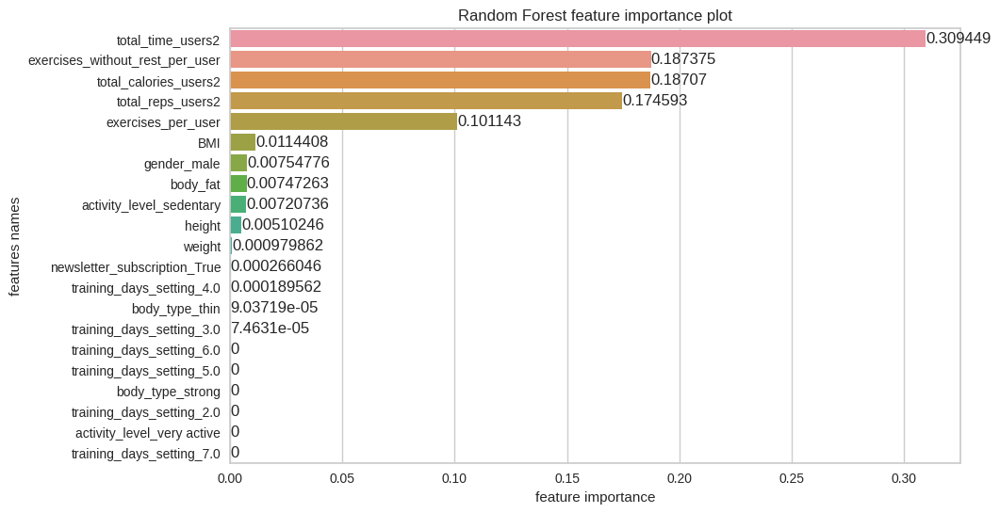

[Random Forest] Best parameters are {'criterion': 'gini', 'max_depth': 3, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.26, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- AdaBoost
[AdaBoost] Features importances: [0.0015228970227275063, 0.006534499605921826, 0.015235888199900674, 0.02961401359117728, 0.3699815861505367, 0.3288510558723001, 0.03375367135484618, 0.010616122109330101, 0.13753379211417077, 0.0, 1.0024974856850934e-18, 3.4881693746712807e-19, 0.0012319964939261868, 0.01707553333540733, 0.007003383941461189, 0.015227980193858426, 0.018648576863795646, 0.0032632112601716735, 0.003905791890468391, 0.0, 0.0]


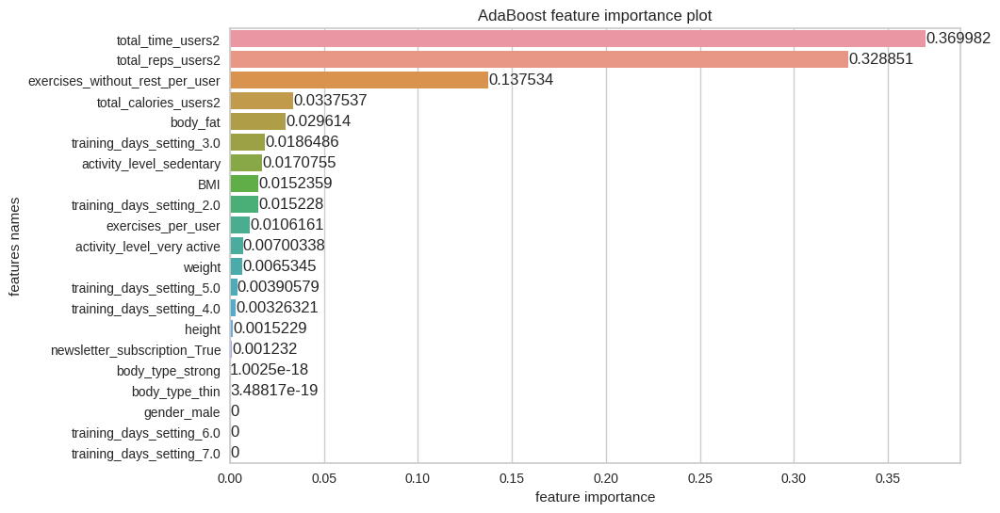

[AdaBoost] Best parameters are {'base_estimator': DecisionTreeClassifier(max_depth=5), 'learning_rate': 0.01, 'n_estimators': 20, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- GradientBoost
[GradientBoost] Features importances: [3.26873260336291e-05, 2.5299005047379225e-05, 2.729317965509343e-05, 0.0020739717249646135, 0.214675608754478, 0.1479035828952998, 0.025199131241484346, 0.3188710206838045, 0.29043152020256957, 0.00026798979250898324, 0.0, 0.0, 0.00015863992782378614, 0.0003332552663303612, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


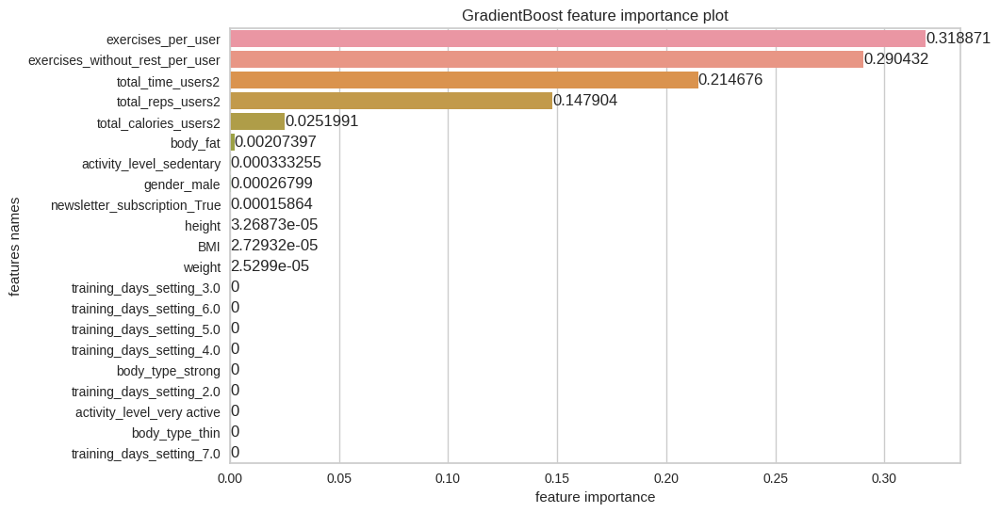

[GradientBoost] Best parameters are {'criterion': 'friedman_mse', 'learning_rate': 0.075, 'loss': 'deviance', 'max_depth': 5, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'n_estimators': 5, 'random_state': 42, 'subsample': 0.85}


In [45]:
estimators_multiclass_ac, X_test_ac, y_test_ac, X_train_ac, y_train_ac, X_test_inv_ac, features_ac = train(X_adh_cat, y_adh_cat, 
                                                         grid_params_multiclass, 
                                                         seed, feature_selection = False)

In [46]:
evaluation_table_ac = evaluate_multiclass(estimators_multiclass_ac, X_test_ac, y_test_ac, no_of_labels = 3, features_selected = False, features = features_ac)


In [47]:
evaluation_table_ac

,Overall Accuracy,Balanced Accuracy,Adj Balanced Accuracy,Precision micro,Precision macro,Precision weighted,Recall micro,Recall macro,Recall weighted,Cohen's kappa,Mathews Correlation Coefficient
SGD,0.84,0.72,0.58,0.84,0.81,0.83,0.84,0.72,0.84,0.71,0.71
Logistic Regression,0.84,0.77,0.66,0.84,0.82,0.84,0.84,0.77,0.84,0.73,0.73
Decision Tree,0.84,0.74,0.61,0.84,0.78,0.84,0.84,0.74,0.84,0.72,0.72
Random Forest,0.82,0.61,0.41,0.82,0.55,0.75,0.82,0.61,0.82,0.67,0.69
AdaBoost,0.83,0.72,0.58,0.83,0.76,0.83,0.83,0.72,0.83,0.70,0.70
GradientBoost,0.81,0.60,0.40,0.81,0.54,0.74,0.81,0.60,0.81,0.66,0.67


The best values are for the AdaBoost algorithm with Decision Tree Classifier with depth equal to 4, learning rate equal to 0.01 and number of estimators equal to 20. The overall accuracy is 85%, micro precision is 85%, macro precision is 80%, weighted precision is 86%, micro and weighted recall is 85% and macro recall is 81%. Cohen's kappa is 0.75 and MCC is also 0.75. Overall, the prediction results are good. 

In [48]:
prediction_for_one_user(estimators_multiclass_ac, X_test_ac, y_test_ac, X_test_inv_ac, X_adh_cat.columns, y_adh_ca.columns, name = 'AdaBoost')


,height,weight,BMI,body_fat,total_time_users2,total_reps_users2,total_calories_users2,exercises_per_user,exercises_without_rest_per_user,gender_male,body_type_strong,body_type_thin,newsletter_subscription_True,activity_level_sedentary,activity_level_very active,training_days_setting_2.0,training_days_setting_3.0,training_days_setting_4.0,training_days_setting_5.0,training_days_setting_6.0,training_days_setting_7.0,Adherence cat,Adherence cat_prediction
704,156.00,65.00,26.71,25.00,4036.00,855.00,222.77,5105.00,3769.00,0.00,0.00,1.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,2,1


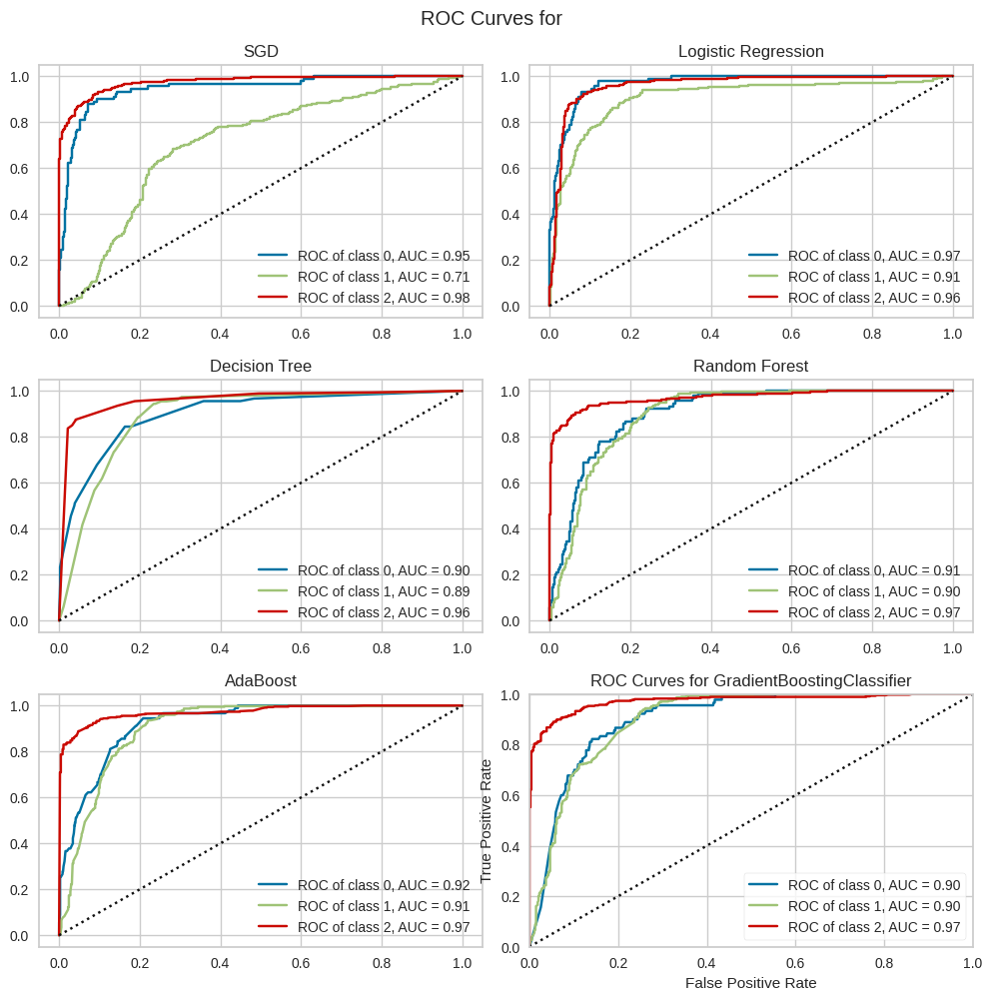

<AxesSubplot: title={'center': 'ROC Curves for GradientBoostingClassifier'}, xlabel='False Positive Rate', ylabel='True Positive Rate'>

In [49]:
ROC_curves(estimators_multiclass_ac, X_train_ac, y_train_ac, X_test_ac, y_test_ac, np.unique(y_adh_cat), name = 'all', features_selected = False, features = features_ac)


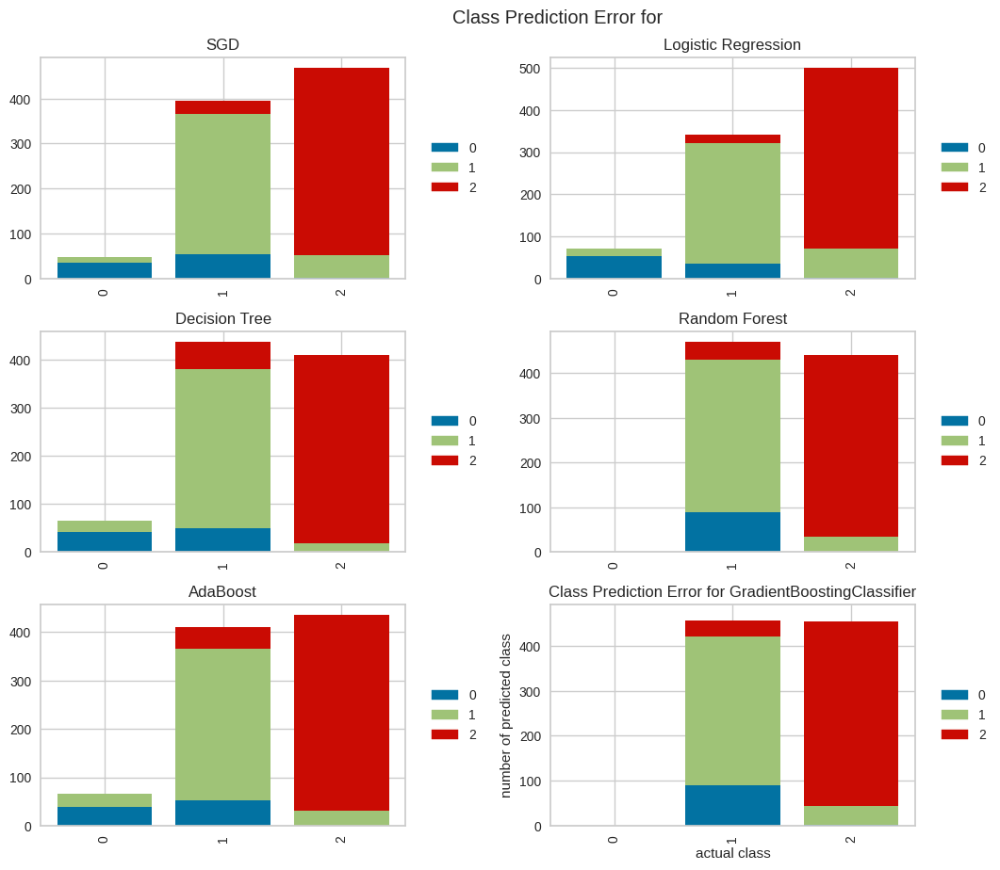

<AxesSubplot: title={'center': 'Class Prediction Error for GradientBoostingClassifier'}, xlabel='actual class', ylabel='number of predicted class'>

In [50]:
prediction_error_plot(estimators_multiclass_ac, X_train_ac, y_train_ac, X_test_ac, y_test_ac, np.unique(y_adh_cat), name = 'all', features_selected = False, features = features_ac)


#### With feature selection (Univariate - Kruskall - Wallis test (instead of ANOVA) and chi-square)

[INFO] Performing Grid-Search CV ---- SGD
[SGD] Features selected: Index(['height', 'BMI', 'body_fat', 'total_time_users2', 'total_reps_users2',
       'total_calories_users2', 'exercises_per_user',
       'exercises_without_rest_per_user'],
      dtype='object')
[SGD] Features importances: [0.02234789 0.14384838 0.21660925 8.0505239  6.85360013 7.45943527
 7.24996604 6.23203127]


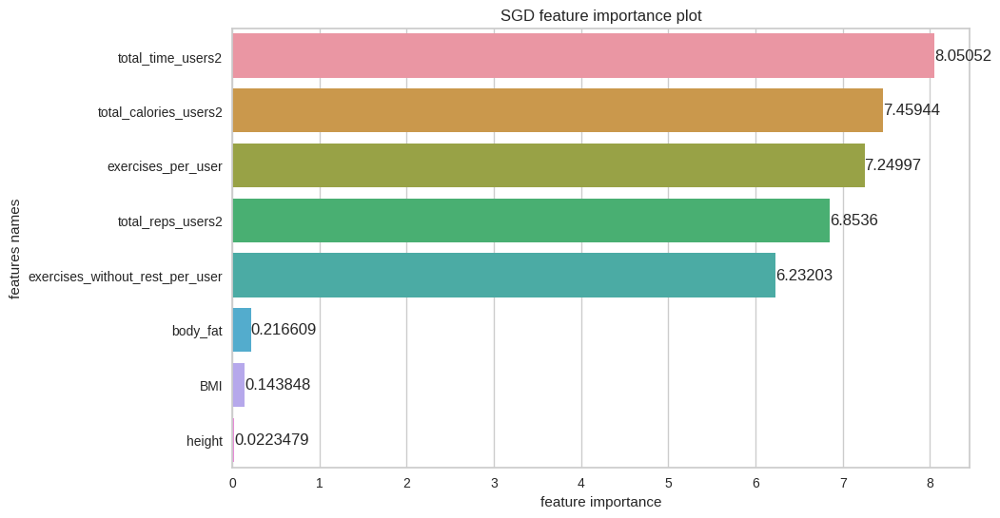

[SGD] Best parameters are {'alpha': 0.0002575, 'eta0': 0.0001, 'learning_rate': 'optimal', 'penalty': 'l1', 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Logistic Regression
[Logistic Regression] Features selected: Index(['height', 'BMI', 'body_fat', 'total_time_users2', 'total_reps_users2',
       'total_calories_users2', 'exercises_per_user',
       'exercises_without_rest_per_user'],
      dtype='object')
[Logistic Regression] Features importances: [ 0.34746748  0.39293429  0.5307908  13.74209705 10.31645457  2.39052102
 14.71910443 15.13002558]


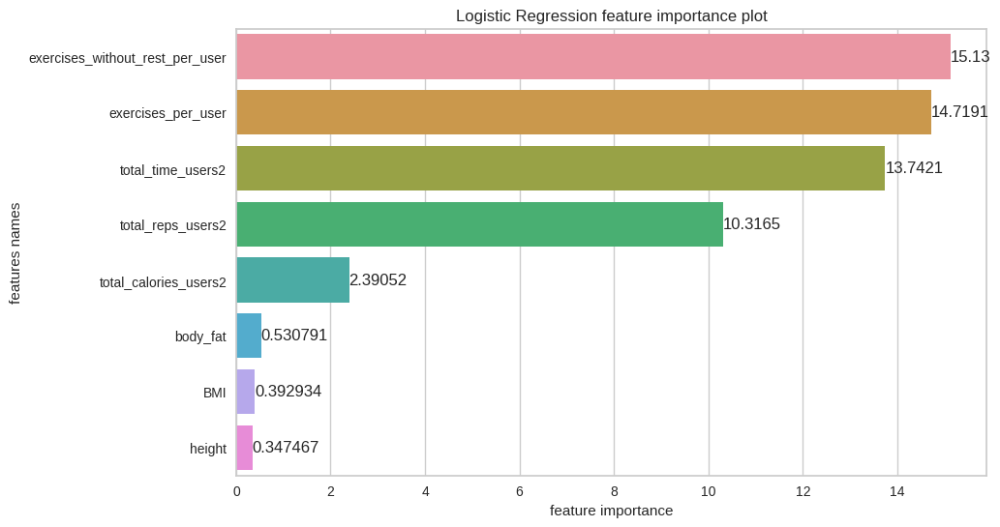

[Logistic Regression] Best parameters are {'C': 5, 'penalty': 'l1', 'random_state': 42, 'solver': 'liblinear'}
[INFO] Performing Grid-Search CV ---- Decision Tree
[Decision Tree] Features selected: Index(['height', 'BMI', 'body_fat', 'total_time_users2', 'total_reps_users2',
       'total_calories_users2', 'exercises_per_user',
       'exercises_without_rest_per_user'],
      dtype='object')
[Decision Tree] Features importances: [0.012367233507774258, 0.0035208269611241402, 0.004653316185308749, 0.11077969628118348, 0.6701522375220891, 0.18003758256374053, 0.004548945718782972, 0.013940161259996723]


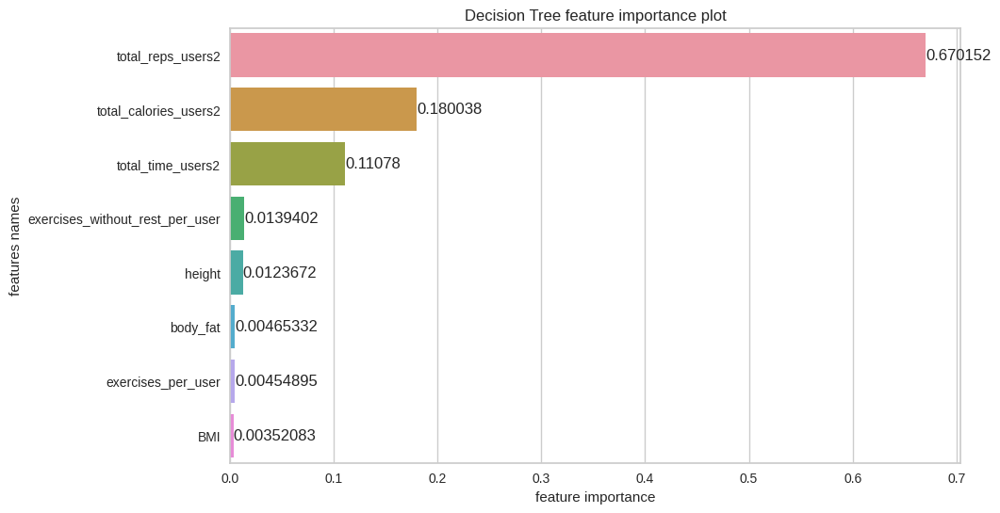

[Decision Tree] Best parameters are {'criterion': 'entropy', 'max_depth': 6, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Random Forest
[Random Forest] Features selected: Index(['height', 'BMI', 'body_fat', 'total_time_users2', 'total_reps_users2',
       'total_calories_users2', 'exercises_per_user',
       'exercises_without_rest_per_user'],
      dtype='object')
[Random Forest] Features importances: [0.002875660176735388, 0.04919147150756768, 0.05122467600201734, 0.23876719273729655, 0.21924800985462573, 0.18897280709543318, 0.08972018262632414, 0.16]


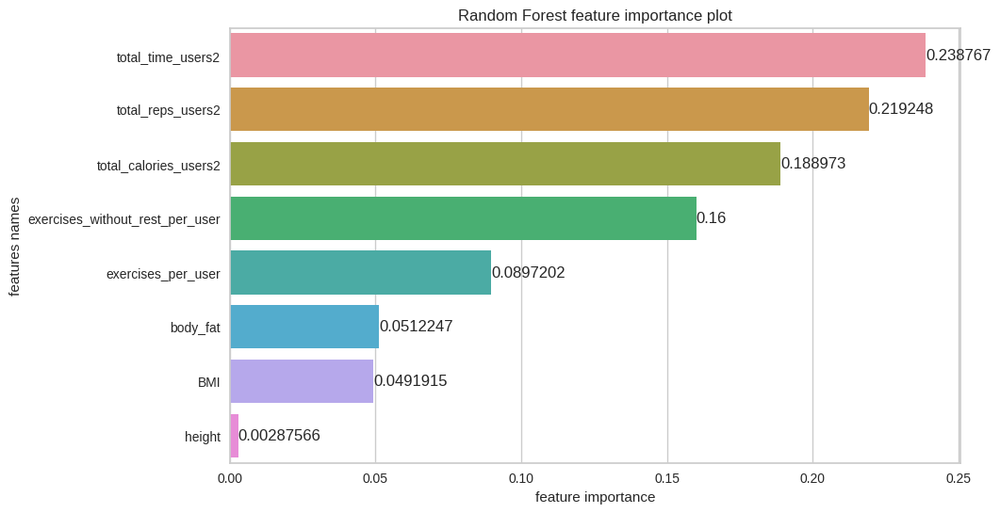

[Random Forest] Best parameters are {'criterion': 'gini', 'max_depth': 3, 'max_features': 'sqrt', 'min_samples_leaf': 0.1, 'min_samples_split': 0.5, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- AdaBoost
[AdaBoost] Features selected: Index(['height', 'BMI', 'body_fat', 'total_time_users2', 'total_reps_users2',
       'total_calories_users2', 'exercises_per_user',
       'exercises_without_rest_per_user'],
      dtype='object')
[AdaBoost] Features importances: [0.01242176550962239, 0.007273498991238139, 0.025200703597367473, 0.6235888128457832, 0.25054119599753505, 0.01804011660932018, 0.016735114454351614, 0.046198791994781996]


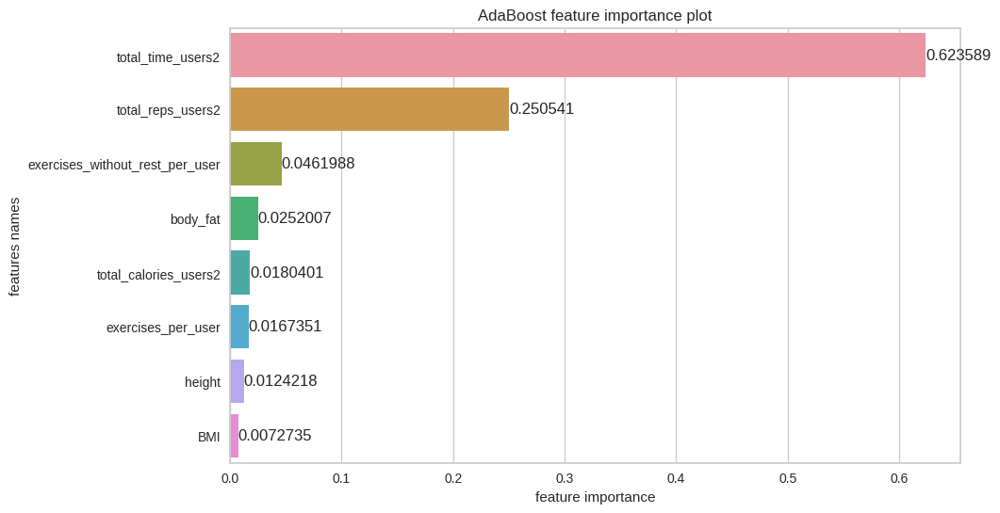

[AdaBoost] Best parameters are {'base_estimator': DecisionTreeClassifier(max_depth=3), 'learning_rate': 0.025, 'n_estimators': 20, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- GradientBoost
[GradientBoost] Features selected: Index(['height', 'BMI', 'body_fat', 'total_time_users2', 'total_reps_users2',
       'total_calories_users2', 'exercises_per_user',
       'exercises_without_rest_per_user'],
      dtype='object')
[GradientBoost] Features importances: [0.0, 0.00418349285155366, 0.0, 0.24557600927866993, 0.21858456343933622, 0.17135668023032205, 0.15440068305726698, 0.20589857114285104]


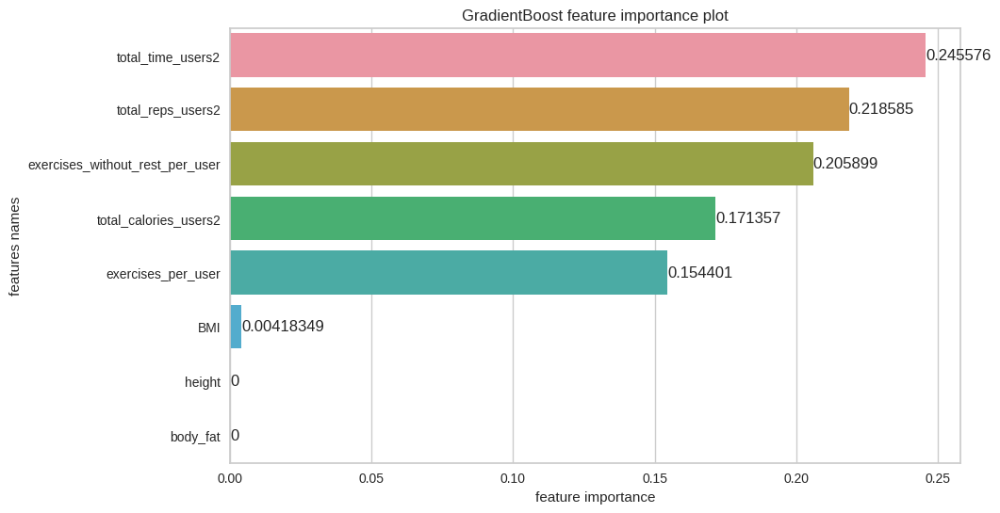

[GradientBoost] Best parameters are {'criterion': 'friedman_mse', 'learning_rate': 0.05, 'loss': 'deviance', 'max_depth': 3, 'max_features': 'sqrt', 'min_samples_leaf': 0.2, 'min_samples_split': 0.5, 'n_estimators': 5, 'random_state': 42, 'subsample': 0.618}


In [51]:
estimators_multiclass_ac_sel_u, X_test_ac_sel_u, y_test_ac_sel_u, X_train_ac_sel_u, y_train_ac_sel_u, X_test_inv_ac_sel_u, features_ac_sel_u = train(X_adh_cat, y_adh_cat, 
                                                         grid_params_multiclass, 
                                                         seed, feature_selection = True, 
                                                         feature_sel_type = 'UNI')

In [52]:
evaluation_table_ac_sel_u = evaluate_multiclass(estimators_multiclass_ac_sel_u, X_test_ac_sel_u, y_test_ac_sel_u, no_of_labels = 3, features_selected = True, features = features_ac_sel_u, feature_sel_type = 'UNI')

In [53]:
evaluation_table_ac_sel_u

,Overall Accuracy,Balanced Accuracy,Adj Balanced Accuracy,Precision micro,Precision macro,Precision weighted,Recall micro,Recall macro,Recall weighted,Cohen's kappa,Mathews Correlation Coefficient
SGD,0.79,0.75,0.62,0.79,0.71,0.81,0.79,0.75,0.79,0.64,0.65
Logistic Regression,0.81,0.66,0.49,0.81,0.75,0.80,0.81,0.66,0.81,0.66,0.67
Decision Tree,0.82,0.67,0.51,0.82,0.75,0.81,0.82,0.67,0.82,0.68,0.68
Random Forest,0.82,0.61,0.41,0.82,0.55,0.75,0.82,0.61,0.82,0.68,0.69
AdaBoost,0.83,0.69,0.53,0.83,0.78,0.84,0.83,0.69,0.83,0.71,0.71
GradientBoost,0.81,0.60,0.40,0.81,0.54,0.74,0.81,0.60,0.81,0.66,0.68


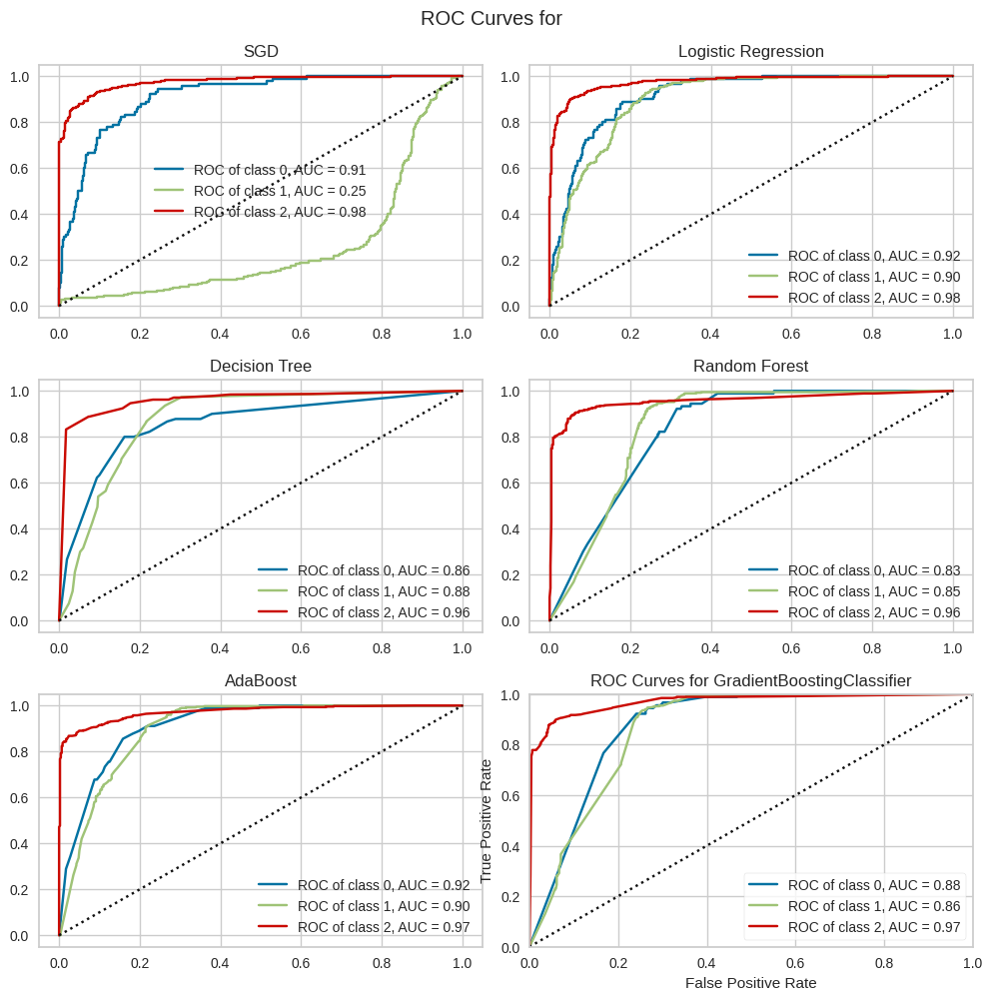

<AxesSubplot: title={'center': 'ROC Curves for GradientBoostingClassifier'}, xlabel='False Positive Rate', ylabel='True Positive Rate'>

In [54]:
ROC_curves(estimators_multiclass_ac_sel_u, X_train_ac_sel_u, y_train_ac_sel_u, X_test_ac_sel_u, y_test_ac_sel_u, np.unique(y_adh_cat), name = 'all', features_selected = True, features = features_ac_sel_u, feature_sel_type = 'UNI')

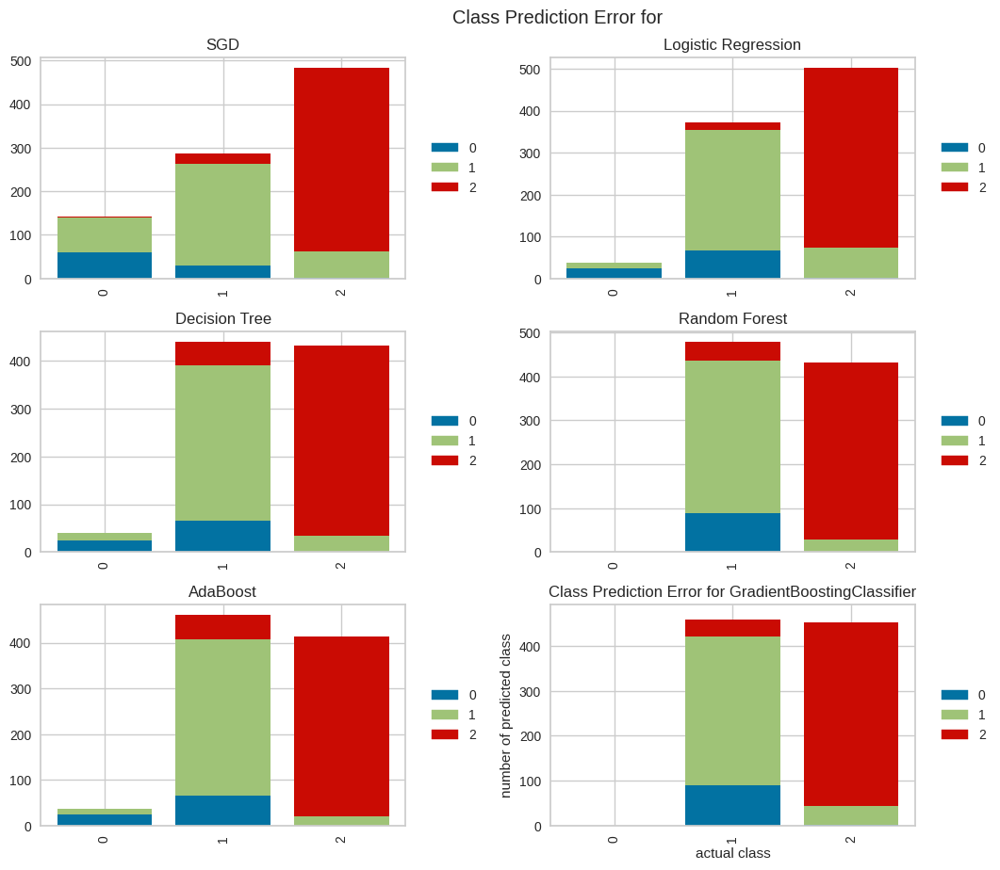

<AxesSubplot: title={'center': 'Class Prediction Error for GradientBoostingClassifier'}, xlabel='actual class', ylabel='number of predicted class'>

In [55]:
prediction_error_plot(estimators_multiclass_ac_sel_u, X_train_ac_sel_u, y_train_ac_sel_u, X_test_ac_sel_u, y_test_ac_sel_u, np.unique(y_adh_cat), name = 'all', features_selected = True, features = features_ac_sel_u, feature_sel_type = 'UNI')

#### With feature selection (by SequentialFeatureSelector)

In [56]:
estimators_multiclass_ac_sel, X_test_ac_sel, y_test_ac_sel, X_train_ac_sel, y_train_ac_sel, X_test_inv_ac_sel, features_ac_sel = train(X_adh_cat, y_adh_cat, 
                                                         grid_params_multiclass, 
                                                         seed, feature_selection = True, 
                                                         feature_sel_type = 'SFS')

[INFO] Performing Grid-Search CV ---- SGD
[SGD] Features selected: Index(['weight', 'BMI', 'body_fat', 'total_time_users2', 'total_reps_users2',
       'total_calories_users2', 'exercises_per_user',
       'exercises_without_rest_per_user', 'gender_male', 'body_type_thin',
       'newsletter_subscription_True', 'activity_level_sedentary',
       'activity_level_very active', 'training_days_setting_2.0',
       'training_days_setting_3.0', 'training_days_setting_4.0',
       'training_days_setting_5.0', 'training_days_setting_6.0',
       'training_days_setting_7.0'],
      dtype='object')
[SGD] Best parameters are {'alpha': 0.001, 'eta0': 0.0001, 'learning_rate': 'optimal', 'penalty': 'l1', 'random_state': 42}


/home/evida-monika/anaconda3/envs/mhunters/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/home/evida-monika/anaconda3/envs/mhunters/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stab

/home/evida-monika/anaconda3/envs/mhunters/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/home/evida-monika/anaconda3/envs/mhunters/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stab

/home/evida-monika/anaconda3/envs/mhunters/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/home/evida-monika/anaconda3/envs/mhunters/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stab

[INFO] Performing Grid-Search CV ---- Logistic Regression
[Logistic Regression] Features selected: Index(['height', 'weight', 'BMI', 'total_time_users2', 'total_reps_users2',
       'total_calories_users2', 'exercises_per_user',
       'exercises_without_rest_per_user', 'gender_male', 'body_type_strong',
       'newsletter_subscription_True', 'activity_level_very active',
       'training_days_setting_2.0', 'training_days_setting_3.0',
       'training_days_setting_4.0', 'training_days_setting_5.0',
       'training_days_setting_6.0', 'training_days_setting_7.0'],
      dtype='object')
[Logistic Regression] Best parameters are {'C': 2, 'penalty': 'l1', 'random_state': 42, 'solver': 'liblinear'}
[INFO] Performing Grid-Search CV ---- Decision Tree
[Decision Tree] Features selected: Index(['total_time_users2', 'total_reps_users2', 'exercises_per_user',
       'exercises_without_rest_per_user', 'body_type_thin',
       'activity_level_sedentary', 'activity_level_very active',
       'train

In [57]:
evaluation_table_ac_sel = evaluate_multiclass(estimators_multiclass_ac_sel, X_test_ac_sel, y_test_ac_sel, no_of_labels = 3, features_selected = True, features = features_ac_sel, feature_sel_type = 'SFS')

In [58]:
evaluation_table_ac_sel

,Overall Accuracy,Balanced Accuracy,Adj Balanced Accuracy,Precision micro,Precision macro,Precision weighted,Recall micro,Recall macro,Recall weighted,Cohen's kappa,Mathews Correlation Coefficient
SGD,0.86,0.81,0.71,0.86,0.82,0.86,0.86,0.81,0.86,0.75,0.75
Logistic Regression,0.85,0.78,0.66,0.85,0.83,0.84,0.85,0.78,0.85,0.73,0.73
Decision Tree,0.83,0.70,0.54,0.83,0.78,0.84,0.83,0.70,0.83,0.71,0.72
Random Forest,0.82,0.61,0.41,0.82,0.55,0.75,0.82,0.61,0.82,0.68,0.69
AdaBoost,0.83,0.67,0.51,0.83,0.76,0.83,0.83,0.67,0.83,0.70,0.71
GradientBoost,0.82,0.61,0.41,0.82,0.55,0.75,0.82,0.61,0.82,0.68,0.69


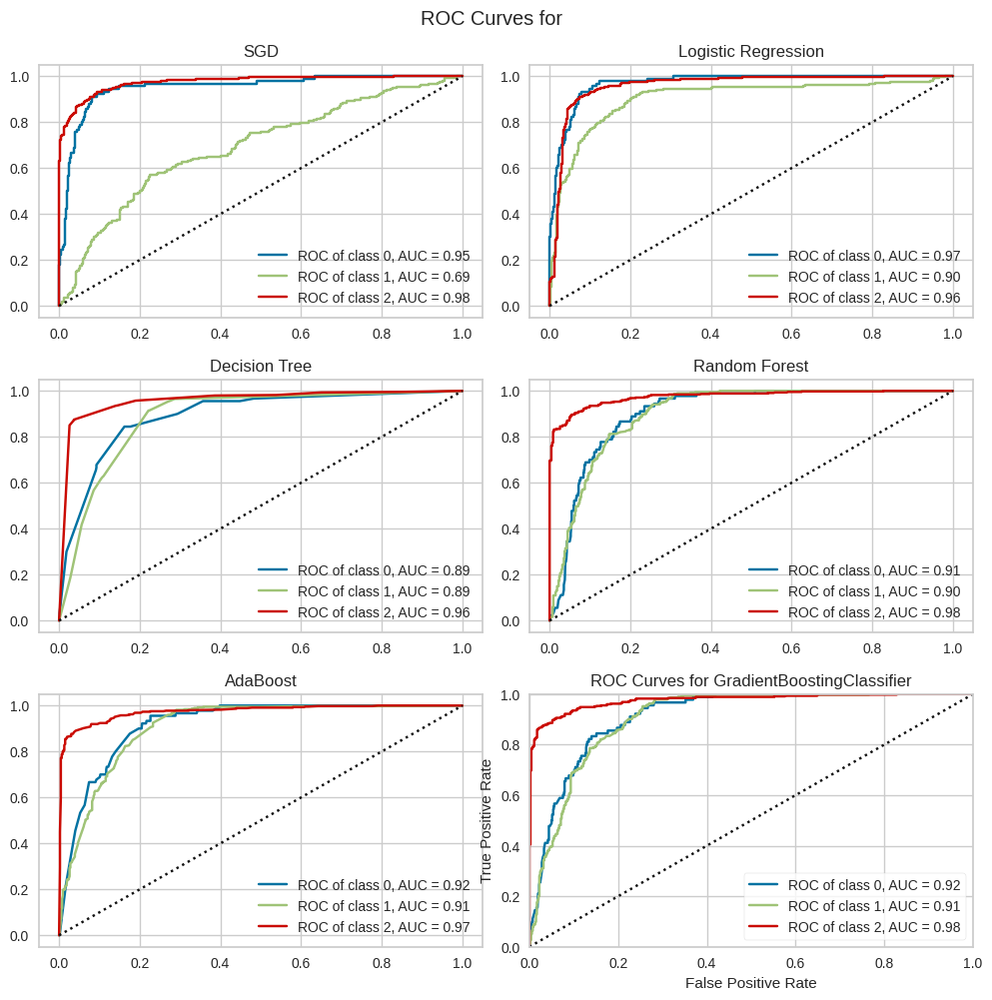

<AxesSubplot: title={'center': 'ROC Curves for GradientBoostingClassifier'}, xlabel='False Positive Rate', ylabel='True Positive Rate'>

In [59]:
ROC_curves(estimators_multiclass_ac_sel, X_train_ac_sel, y_train_ac_sel, X_test_ac_sel, y_test_ac_sel, np.unique(y_adh_cat), name = 'all', features_selected = True, features = features_ac_sel, feature_sel_type = 'SFS')

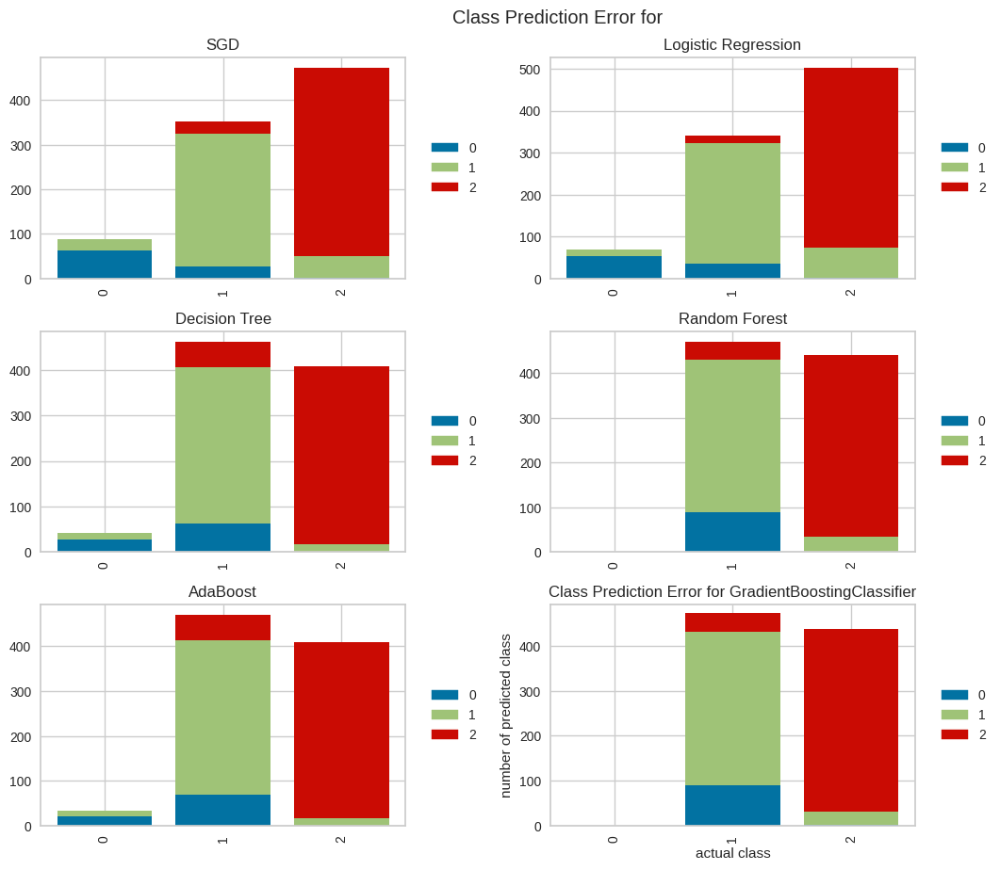

<AxesSubplot: title={'center': 'Class Prediction Error for GradientBoostingClassifier'}, xlabel='actual class', ylabel='number of predicted class'>

In [60]:
prediction_error_plot(estimators_multiclass_ac_sel, X_train_ac_sel, y_train_ac_sel, X_test_ac_sel, y_test_ac_sel, np.unique(y_adh_cat), name = 'all', features_selected = True, features = features_ac_sel, feature_sel_type = 'SFS')


#### With feature selection (by Recursive feature elimination with cross-validation - RFECV)

[INFO] Performing Grid-Search CV ---- SGD
[SGD] Features selected: Index(['weight', 'total_time_users2', 'total_reps_users2',
       'total_calories_users2', 'exercises_per_user',
       'exercises_without_rest_per_user', 'newsletter_subscription_True',
       'training_days_setting_4.0', 'training_days_setting_5.0',
       'training_days_setting_6.0', 'training_days_setting_7.0'],
      dtype='object')
[SGD] Features importances: [0.04460387 7.27626018 4.7324829  4.0320478  0.53740724 0.31085878
 0.23989538 0.54051582 0.83255874 0.41815346 0.9366176 ]


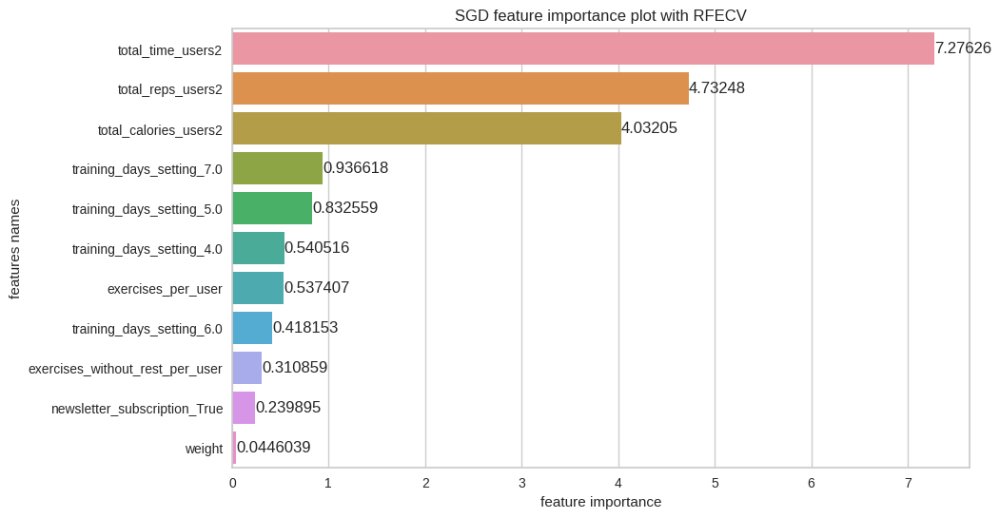

[SGD] Best parameters are {'alpha': 0.001, 'eta0': 0.0001, 'learning_rate': 'optimal', 'penalty': 'l1', 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Logistic Regression
[Logistic Regression] Features selected: Index(['height', 'weight', 'BMI', 'body_fat', 'total_time_users2',
       'total_reps_users2', 'total_calories_users2', 'exercises_per_user',
       'exercises_without_rest_per_user', 'gender_male', 'body_type_strong',
       'newsletter_subscription_True', 'activity_level_sedentary',
       'activity_level_very active', 'training_days_setting_2.0',
       'training_days_setting_3.0', 'training_days_setting_4.0',
       'training_days_setting_5.0', 'training_days_setting_6.0',
       'training_days_setting_7.0'],
      dtype='object')
[Logistic Regression] Features importances: [ 0.73089798  0.62998715  0.76813372  0.44518314 12.03878971 11.31175059
  3.84707012 11.66702853 13.18440899  0.35120977  0.08914705  0.26182504
  0.25788569  0.36442361  0.74478948  1.886795

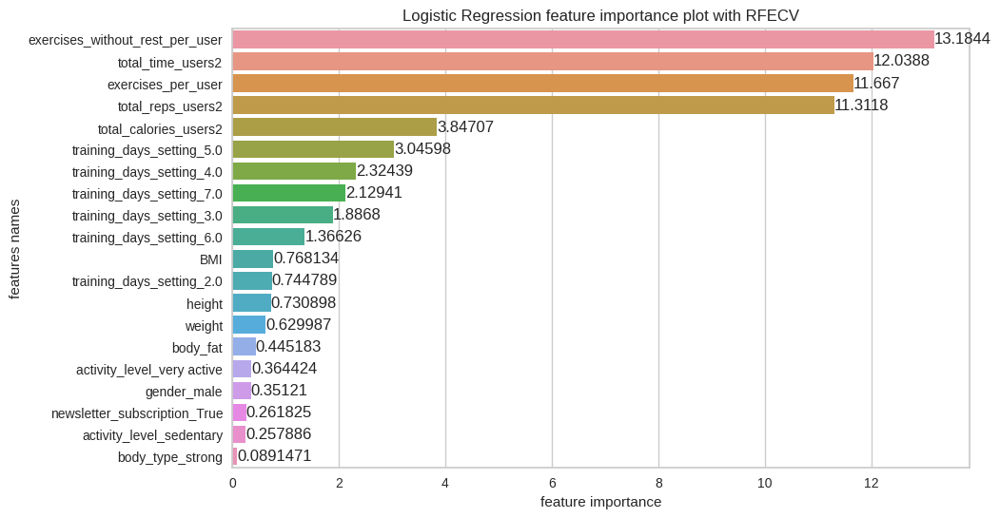

[Logistic Regression] Best parameters are {'C': 4, 'penalty': 'l1', 'random_state': 42, 'solver': 'liblinear'}
[INFO] Performing Grid-Search CV ---- Decision Tree
[Decision Tree] Features selected: Index(['height', 'weight', 'BMI', 'body_fat', 'total_time_users2',
       'total_reps_users2', 'total_calories_users2', 'exercises_per_user',
       'exercises_without_rest_per_user', 'body_type_thin',
       'newsletter_subscription_True', 'activity_level_very active',
       'training_days_setting_2.0', 'training_days_setting_3.0'],
      dtype='object')
[Decision Tree] Features importances: [0.0, 0.0, 0.008756664396065077, 0.0, 0.1669268159548543, 0.708898156814141, 0.028097471027042947, 0.014501534571476762, 0.029786966457494554, 0.002779214849186047, 0.0, 0.015470770792838056, 0.013955699677120762, 0.010826705459780572]


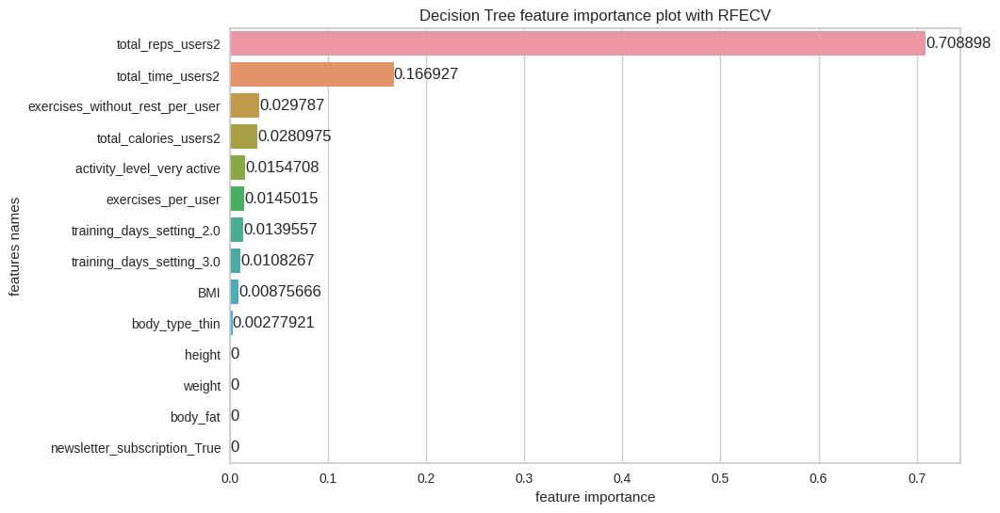

[Decision Tree] Best parameters are {'criterion': 'gini', 'max_depth': 6, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Random Forest
[Random Forest] Features selected: Index(['height', 'weight', 'BMI', 'body_fat', 'total_time_users2',
       'total_reps_users2', 'total_calories_users2', 'exercises_per_user',
       'exercises_without_rest_per_user', 'body_type_thin',
       'newsletter_subscription_True', 'activity_level_sedentary',
       'activity_level_very active', 'training_days_setting_3.0',
       'training_days_setting_4.0', 'training_days_setting_5.0'],
      dtype='object')
[Random Forest] Features importances: [0.0002062144108173496, 0.0004551975248104237, 0.0038775912972989855, 0.002068797916901366, 0.24140725347308478, 0.27583395825228463, 0.18381394627256362, 0.13464159568997014, 0.15535567971214176, 3.292113021641687e-05, 0.0003361499048557443, 0.001838777983442701, 0.0, 0.00013191643161218863, 0.0, 0.0]


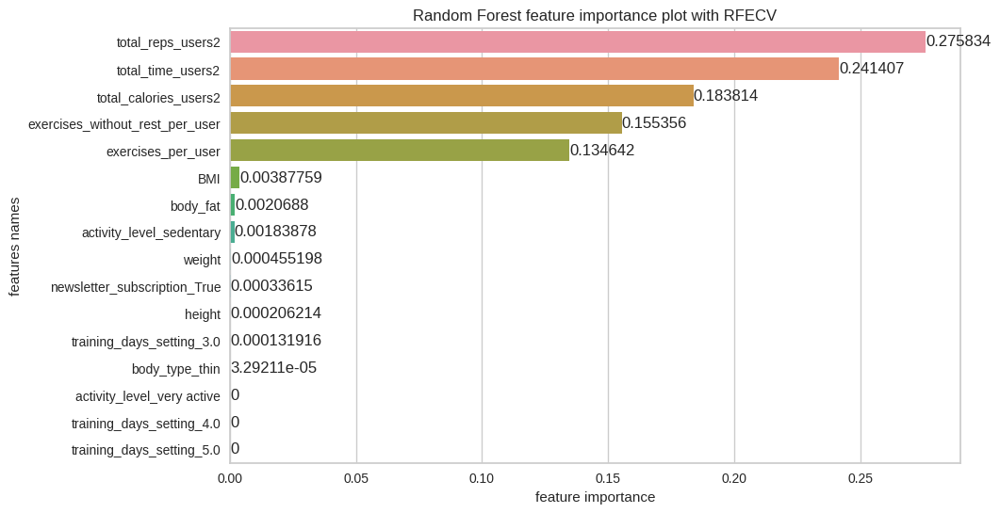

[Random Forest] Best parameters are {'criterion': 'gini', 'max_depth': 3, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.26, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- AdaBoost
[AdaBoost] Features selected: Index(['BMI', 'total_time_users2', 'total_reps_users2'], dtype='object')
[AdaBoost] Features importances: [6.731020339674444e-18, 0.6620336256664234, 0.33796637433357646]


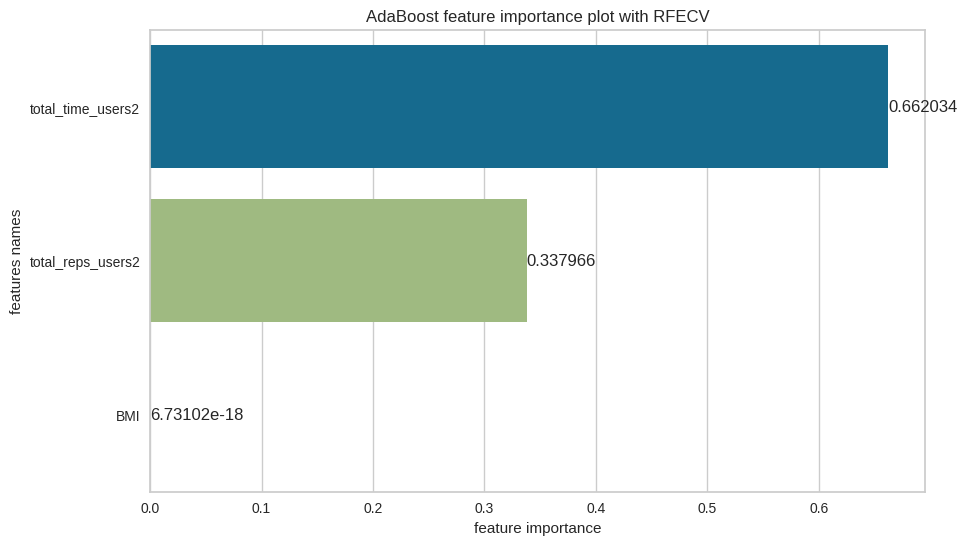

[AdaBoost] Best parameters are {'base_estimator': DecisionTreeClassifier(max_depth=3), 'learning_rate': 0.01, 'n_estimators': 20, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- GradientBoost
[GradientBoost] Features selected: Index(['height', 'weight', 'BMI', 'body_fat', 'total_time_users2',
       'total_reps_users2', 'total_calories_users2', 'exercises_per_user',
       'exercises_without_rest_per_user', 'body_type_thin',
       'newsletter_subscription_True', 'activity_level_sedentary',
       'activity_level_very active', 'training_days_setting_2.0',
       'training_days_setting_3.0', 'training_days_setting_4.0',
       'training_days_setting_5.0', 'training_days_setting_6.0'],
      dtype='object')
[GradientBoost] Features importances: [0.0, 0.0, 9.287258738288939e-05, 0.0010751726333863055, 0.18106828738651812, 0.31118140611640605, 0.29545664121022763, 0.11296336531130562, 0.0981622547547734, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


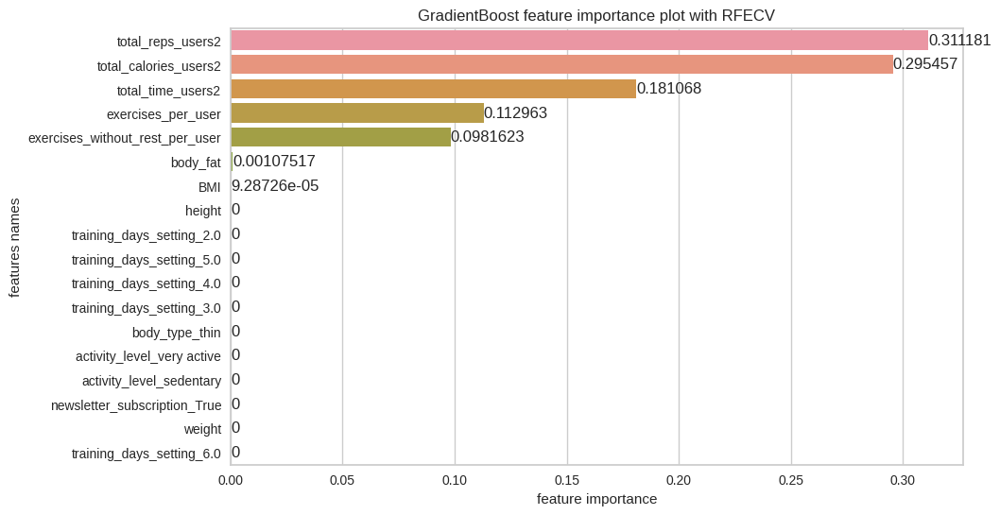

[GradientBoost] Best parameters are {'criterion': 'friedman_mse', 'learning_rate': 0.05, 'loss': 'deviance', 'max_depth': 3, 'max_features': 'log2', 'min_samples_leaf': 0.30000000000000004, 'min_samples_split': 0.1, 'n_estimators': 10, 'random_state': 42, 'subsample': 0.618}


In [61]:
estimators_multiclass_ac_sel_rfecv, X_test_ac_sel_rfecv, y_test_ac_sel_rfecv, X_train_ac_sel_rfecv, y_train_ac_sel_rfecv, X_test_inv_ac_sel_rfecv, features_ac_sel_rfecv = train(X_adh_cat, y_adh_cat, 
                                                         grid_params_multiclass, 
                                                         seed, feature_selection = True, 
                                                         feature_sel_type = 'RFECV')

In [62]:
evaluation_table_ac_sel_rfecv = evaluate_multiclass(estimators_multiclass_ac_sel_rfecv, X_test_ac_sel_rfecv, y_test_ac_sel_rfecv, no_of_labels = 3, features_selected = True, features = features_ac_sel_rfecv, feature_sel_type = 'RFECV')

In [63]:
evaluation_table_ac_sel_rfecv

,Overall Accuracy,Balanced Accuracy,Adj Balanced Accuracy,Precision micro,Precision macro,Precision weighted,Recall micro,Recall macro,Recall weighted,Cohen's kappa,Mathews Correlation Coefficient
SGD,0.80,0.69,0.53,0.80,0.79,0.80,0.80,0.69,0.80,0.65,0.66
Logistic Regression,0.85,0.78,0.67,0.85,0.82,0.84,0.85,0.78,0.85,0.73,0.73
Decision Tree,0.84,0.74,0.61,0.84,0.78,0.84,0.84,0.74,0.84,0.72,0.72
Random Forest,0.82,0.61,0.41,0.82,0.55,0.75,0.82,0.61,0.82,0.67,0.69
AdaBoost,0.83,0.69,0.53,0.83,0.78,0.83,0.83,0.69,0.83,0.70,0.71
GradientBoost,0.82,0.60,0.40,0.82,0.54,0.74,0.82,0.60,0.82,0.67,0.68


In [339]:
prediction_for_one_user(estimators_multiclass_ac_sel_rfecv, X_test_ac_sel_rfecv, y_test_ac_sel_rfecv, X_test_inv_ac_sel_rfecv, X_adh_cat.columns, y_adh_ca.columns, features = features_ac_sel_rfecv, name = 'Logistic Regression', features_selected = True)


,height,weight,BMI,body_fat,total_time_users2,total_reps_users2,total_calories_users2,exercises_per_user,exercises_without_rest_per_user,gender_male,body_type_strong,newsletter_subscription_True,activity_level_sedentary,activity_level_very active,training_days_setting_2.0,training_days_setting_3.0,training_days_setting_4.0,training_days_setting_5.0,training_days_setting_6.0,training_days_setting_7.0,Adherence cat,Adherence cat_prediction
704,156.00,65.00,26.71,25.00,4036.00,855.00,222.77,5105.00,3769.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,2,2


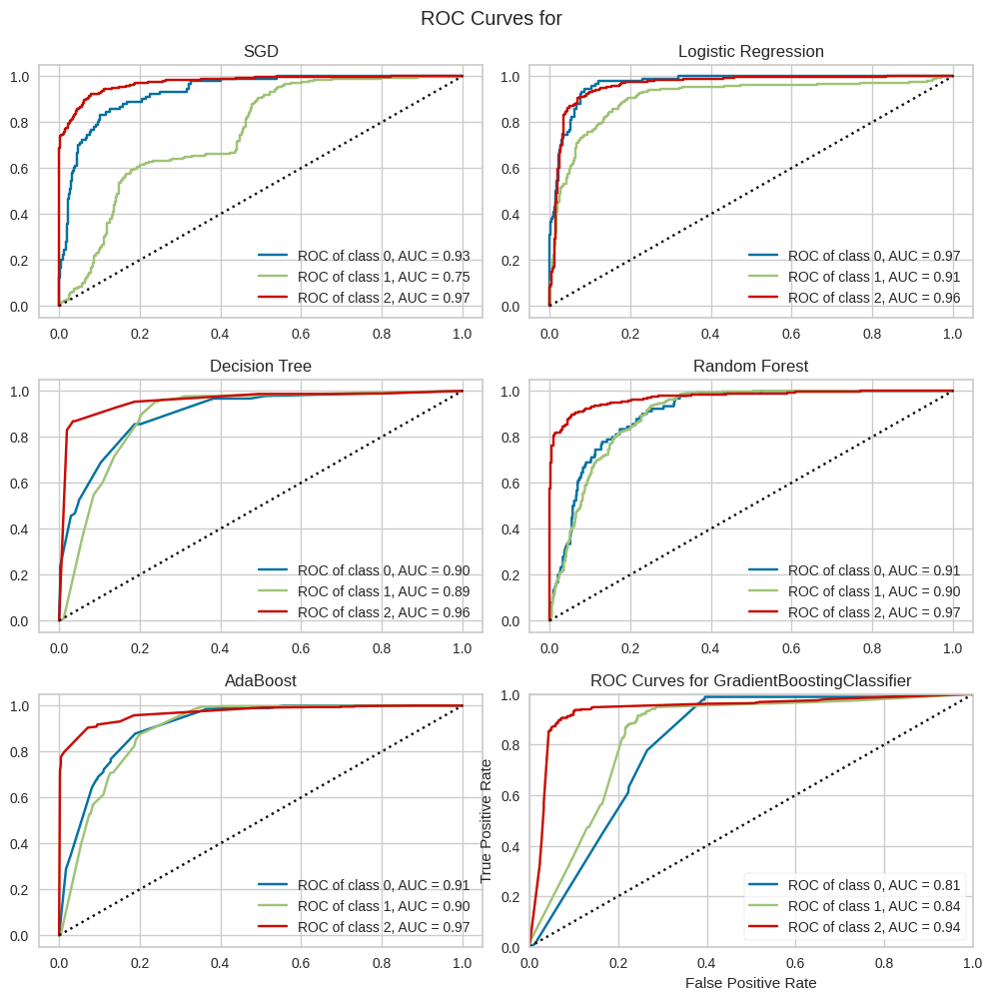

<AxesSubplot: title={'center': 'ROC Curves for GradientBoostingClassifier'}, xlabel='False Positive Rate', ylabel='True Positive Rate'>

In [64]:
ROC_curves(estimators_multiclass_ac_sel_rfecv, X_train_ac_sel_rfecv, y_train_ac_sel_rfecv, X_test_ac_sel_rfecv, y_test_ac_sel_rfecv, np.unique(y_adh_cat), name = 'all', features_selected = True, features = features_ac_sel_rfecv, feature_sel_type = 'RFECV')

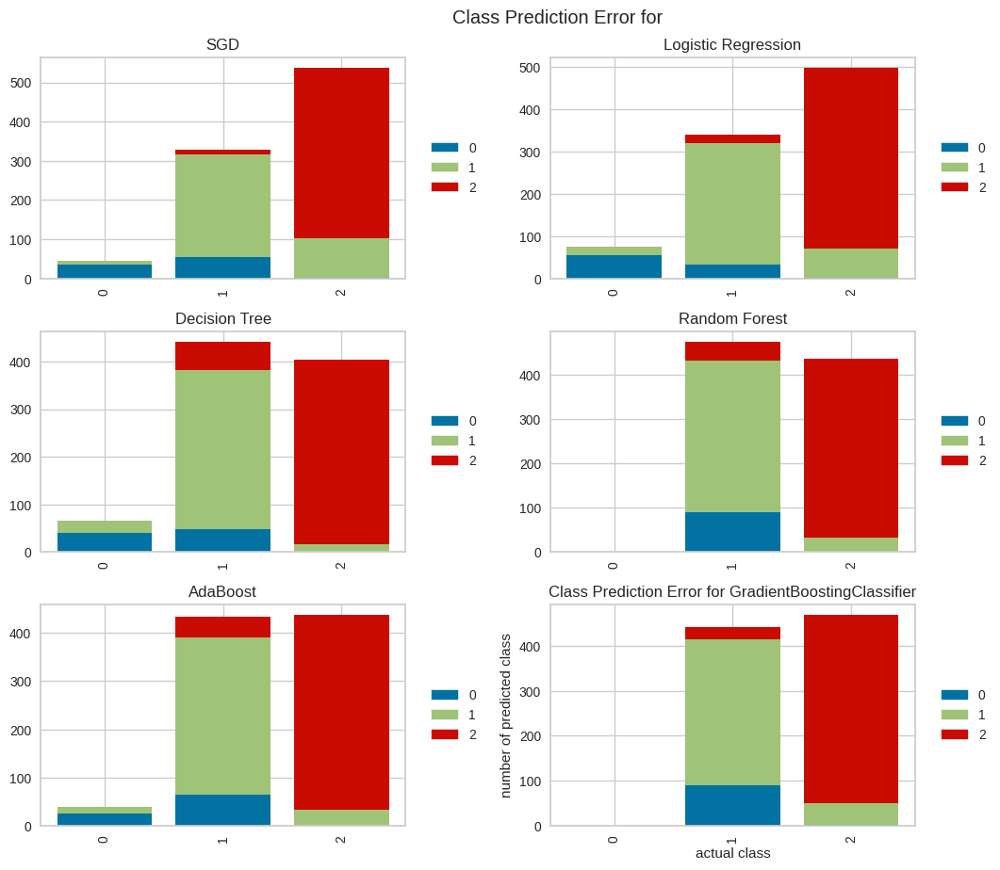

<AxesSubplot: title={'center': 'Class Prediction Error for GradientBoostingClassifier'}, xlabel='actual class', ylabel='number of predicted class'>

In [65]:
prediction_error_plot(estimators_multiclass_ac_sel_rfecv, X_train_ac_sel_rfecv, y_train_ac_sel_rfecv, X_test_ac_sel_rfecv, y_test_ac_sel_rfecv, np.unique(y_adh_cat), name = 'all', features_selected = True, features = features_ac_sel_rfecv, feature_sel_type = 'RFECV')

#### With feature selection (by SelectFromModel) 

[INFO] Performing Grid-Search CV ---- SGD
[SGD] Features selected: Index(['BMI', 'total_time_users2', 'total_reps_users2',
       'total_calories_users2', 'exercises_per_user',
       'exercises_without_rest_per_user', 'training_days_setting_3.0',
       'training_days_setting_4.0', 'training_days_setting_5.0',
       'training_days_setting_6.0', 'training_days_setting_7.0'],
      dtype='object')
[SGD] Features importances: [0.         8.38639989 6.31346145 2.12539413 2.6821129  3.7556328
 0.83094285 1.14472178 1.58872325 0.70473374 1.58324876]


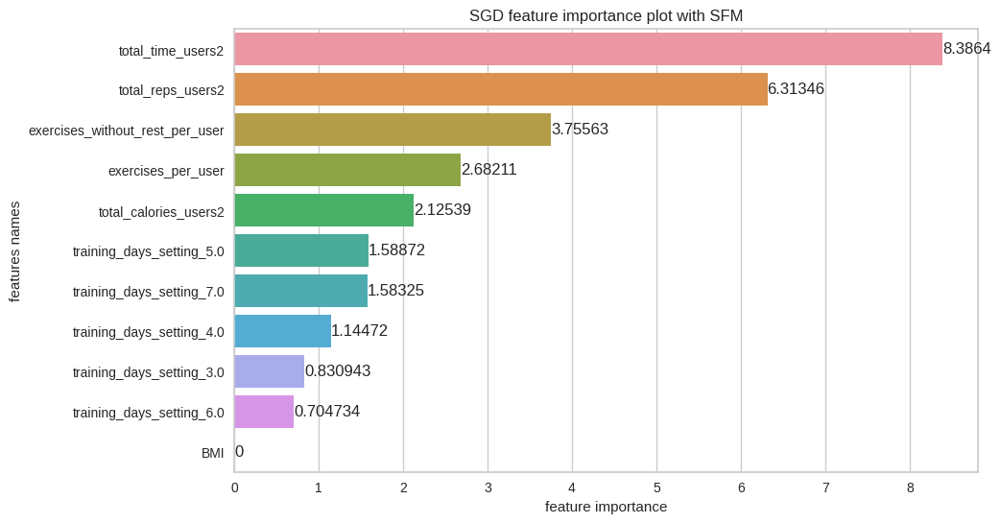

[SGD] Best parameters are {'alpha': 0.000505, 'eta0': 0.0001, 'learning_rate': 'optimal', 'penalty': 'l1', 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Logistic Regression
[Logistic Regression] Features selected: Index(['BMI', 'total_time_users2', 'total_reps_users2',
       'total_calories_users2', 'exercises_per_user',
       'exercises_without_rest_per_user', 'training_days_setting_3.0',
       'training_days_setting_4.0', 'training_days_setting_5.0',
       'training_days_setting_6.0', 'training_days_setting_7.0'],
      dtype='object')
[Logistic Regression] Features importances: [ 0.26412645 12.74685242 11.45879221  0.44772969  4.72515749  5.53981259
  1.1540863   1.67374624  2.34561335  1.12863861  1.89310593]


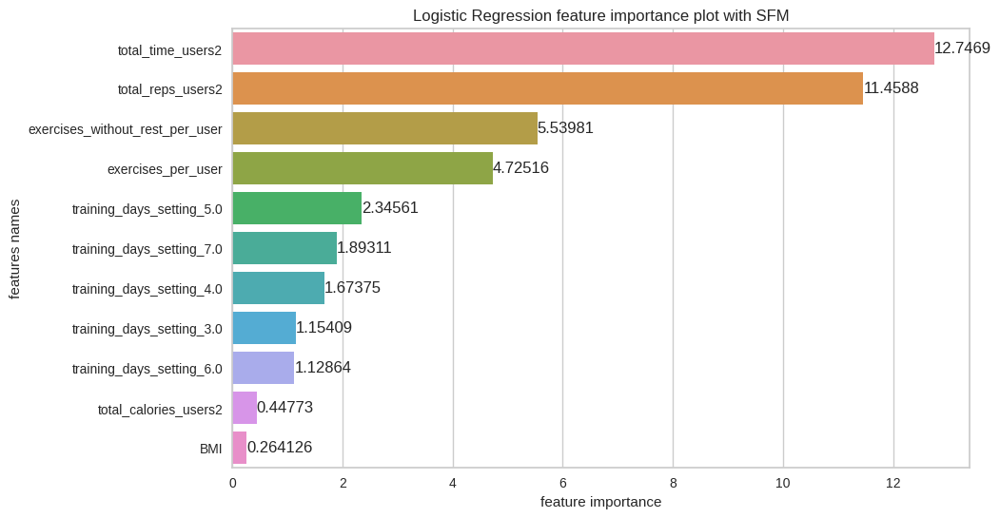

[Logistic Regression] Best parameters are {'C': 2, 'penalty': 'l1', 'random_state': 42, 'solver': 'liblinear'}
[INFO] Performing Grid-Search CV ---- Decision Tree
[Decision Tree] Features selected: Index(['height', 'weight', 'BMI', 'body_fat', 'total_time_users2',
       'total_reps_users2', 'total_calories_users2', 'exercises_per_user',
       'exercises_without_rest_per_user', 'activity_level_very active',
       'training_days_setting_2.0'],
      dtype='object')
[Decision Tree] Features importances: [0.0, 0.002146903722085294, 0.00591487560157551, 0.0, 0.17777341579649594, 0.7196229683614438, 0.022835905286302634, 0.014795573192647802, 0.03318659758043419, 0.015784462015650213, 0.007939298443364627]


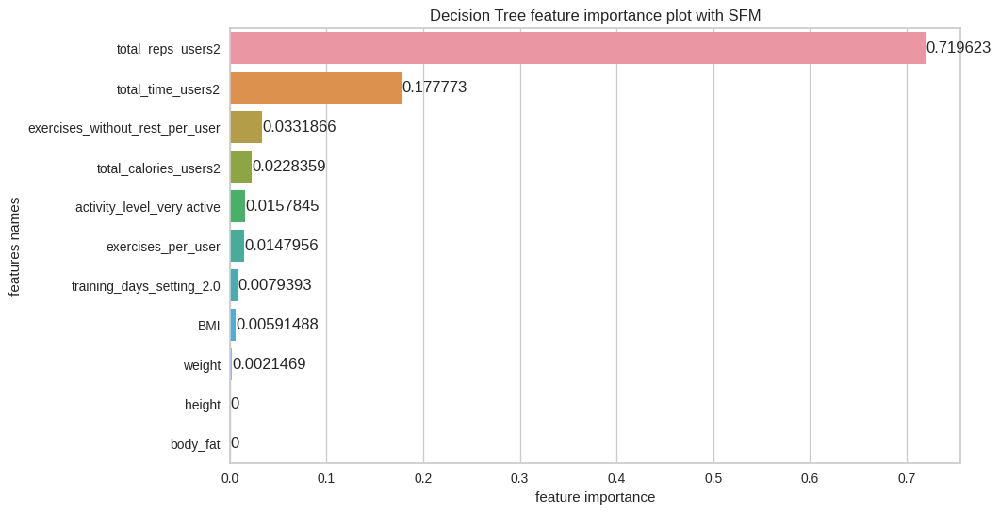

[Decision Tree] Best parameters are {'criterion': 'gini', 'max_depth': 6, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Random Forest
[Random Forest] Features selected: Index(['height', 'weight', 'BMI', 'body_fat', 'total_time_users2',
       'total_reps_users2', 'total_calories_users2', 'exercises_per_user',
       'exercises_without_rest_per_user', 'activity_level_sedentary',
       'training_days_setting_3.0'],
      dtype='object')
[Random Forest] Features importances: [0.000736423794925933, 0.0015394226267865475, 0.009250228089150532, 0.0011182073747243526, 0.28353792513857107, 0.208038484753639, 0.18969942063885326, 0.1438408083495145, 0.15818126970564605, 0.004057809528188773, 0.0]


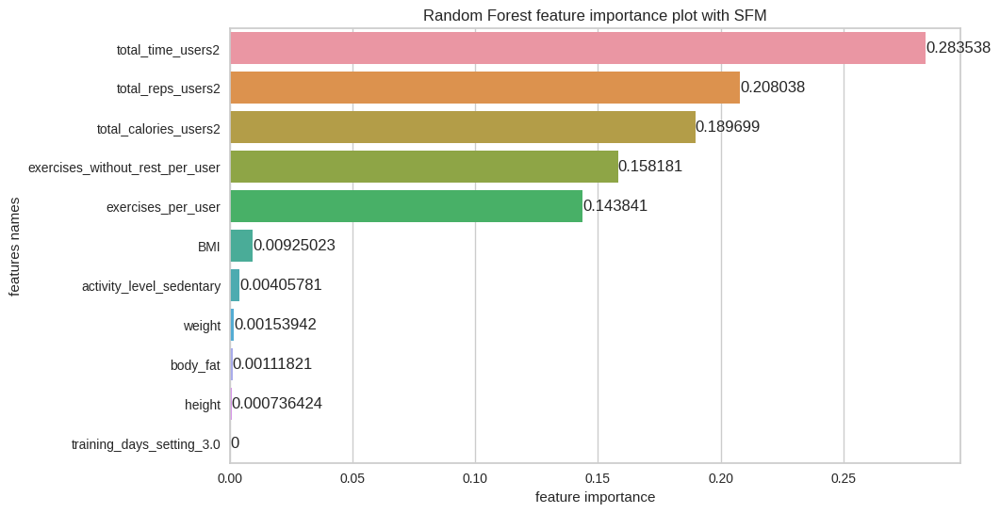

[Random Forest] Best parameters are {'criterion': 'entropy', 'max_depth': 3, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.26, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- AdaBoost
[AdaBoost] Features selected: Index(['height', 'BMI', 'body_fat', 'total_time_users2', 'total_reps_users2',
       'total_calories_users2', 'exercises_per_user',
       'exercises_without_rest_per_user', 'training_days_setting_2.0',
       'training_days_setting_3.0', 'training_days_setting_4.0'],
      dtype='object')
[AdaBoost] Features importances: [0.009468619781720507, 0.015407307634448156, 0.025084549134771882, 0.45861847402815653, 0.26342843489865275, 0.03247846943337136, 0.04067545214920221, 0.11343904622001873, 0.0160639798074566, 0.019592127035849963, 0.005743539876351324]


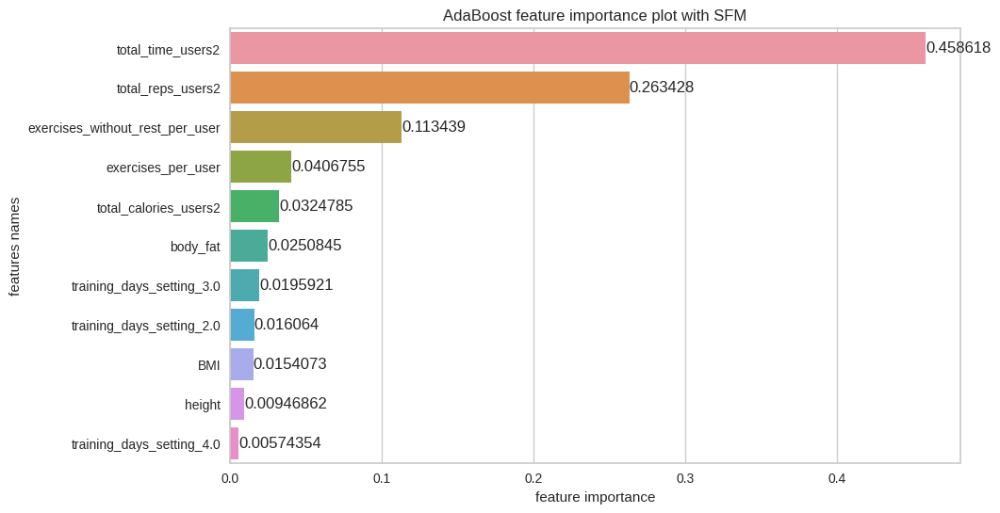

[AdaBoost] Best parameters are {'base_estimator': DecisionTreeClassifier(max_depth=5), 'learning_rate': 0.01, 'n_estimators': 20, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- GradientBoost
[GradientBoost] Features selected: Index(['BMI', 'body_fat', 'total_time_users2', 'total_reps_users2',
       'total_calories_users2', 'exercises_per_user',
       'exercises_without_rest_per_user', 'activity_level_sedentary',
       'training_days_setting_2.0', 'training_days_setting_3.0',
       'training_days_setting_5.0'],
      dtype='object')
[GradientBoost] Features importances: [0.00015016595795789713, 0.00015333069974811635, 0.21528355556704398, 0.2686137309918792, 0.284428931235045, 0.07255860259585878, 0.1588116829524672, 0.0, 0.0, 0.0, 0.0]


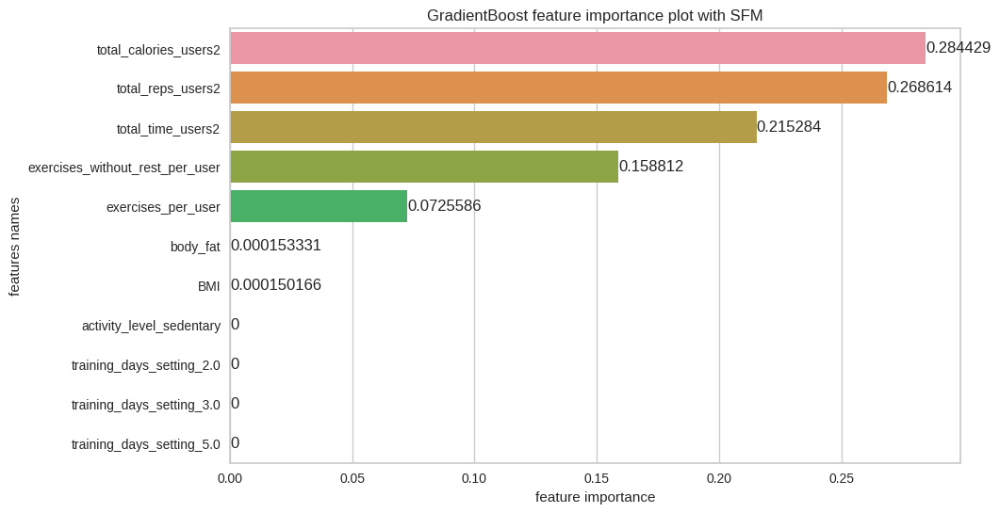

[GradientBoost] Best parameters are {'criterion': 'friedman_mse', 'learning_rate': 0.025, 'loss': 'deviance', 'max_depth': 3, 'max_features': 'log2', 'min_samples_leaf': 0.30000000000000004, 'min_samples_split': 0.1, 'n_estimators': 10, 'random_state': 42, 'subsample': 0.618}


In [66]:
estimators_multiclass_ac_sel_sfm, X_test_ac_sel_sfm, y_test_ac_sel_sfm, X_train_ac_sel_sfm, y_train_ac_sel_sfm, X_test_inv_ac_sel_sfm, features_ac_sel_sfm = train(X_adh_cat, y_adh_cat, 
                                                         grid_params_multiclass, 
                                                         seed, feature_selection = True, 
                                                         feature_sel_type = 'SFM')

In [67]:
evaluation_table_ac_sel_sfm = evaluate_multiclass(estimators_multiclass_ac_sel_sfm, X_test_ac_sel_sfm, y_test_ac_sel_sfm, no_of_labels = 3, features_selected = True, features = features_ac_sel_sfm, feature_sel_type = 'SFM')

In [68]:
evaluation_table_ac_sel_sfm

,Overall Accuracy,Balanced Accuracy,Adj Balanced Accuracy,Precision micro,Precision macro,Precision weighted,Recall micro,Recall macro,Recall weighted,Cohen's kappa,Mathews Correlation Coefficient
SGD,0.82,0.77,0.66,0.82,0.78,0.82,0.82,0.77,0.82,0.68,0.69
Logistic Regression,0.84,0.74,0.62,0.84,0.82,0.83,0.84,0.74,0.84,0.71,0.72
Decision Tree,0.83,0.70,0.55,0.83,0.76,0.83,0.83,0.70,0.83,0.70,0.71
Random Forest,0.82,0.60,0.41,0.82,0.55,0.75,0.82,0.60,0.82,0.67,0.68
AdaBoost,0.84,0.73,0.60,0.84,0.78,0.84,0.84,0.73,0.84,0.72,0.73
GradientBoost,0.81,0.60,0.40,0.81,0.54,0.74,0.81,0.60,0.81,0.66,0.67


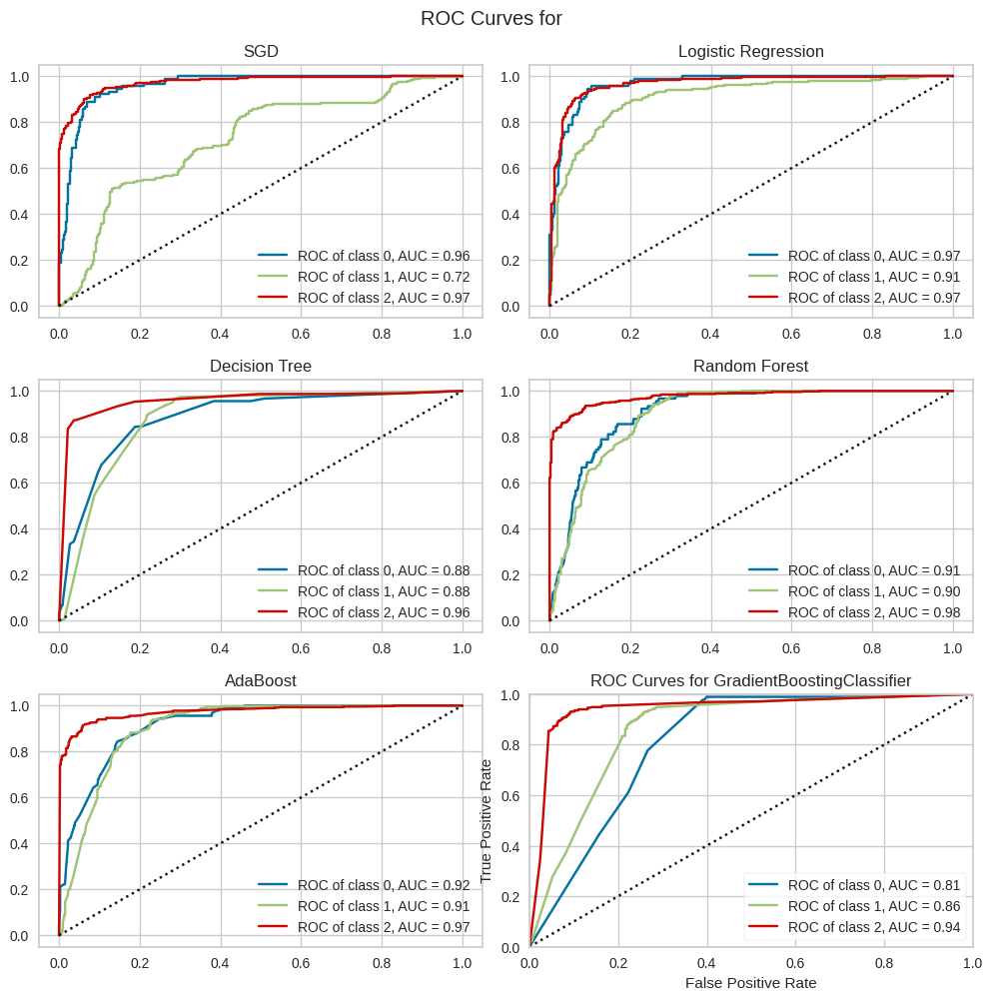

<AxesSubplot: title={'center': 'ROC Curves for GradientBoostingClassifier'}, xlabel='False Positive Rate', ylabel='True Positive Rate'>

In [69]:
ROC_curves(estimators_multiclass_ac_sel_sfm, X_train_ac_sel_sfm, y_train_ac_sel_sfm, X_test_ac_sel_sfm, y_test_ac_sel_sfm, np.unique(y_adh_cat), name = 'all', features_selected = True, features = features_ac_sel_sfm, feature_sel_type = 'SFM')


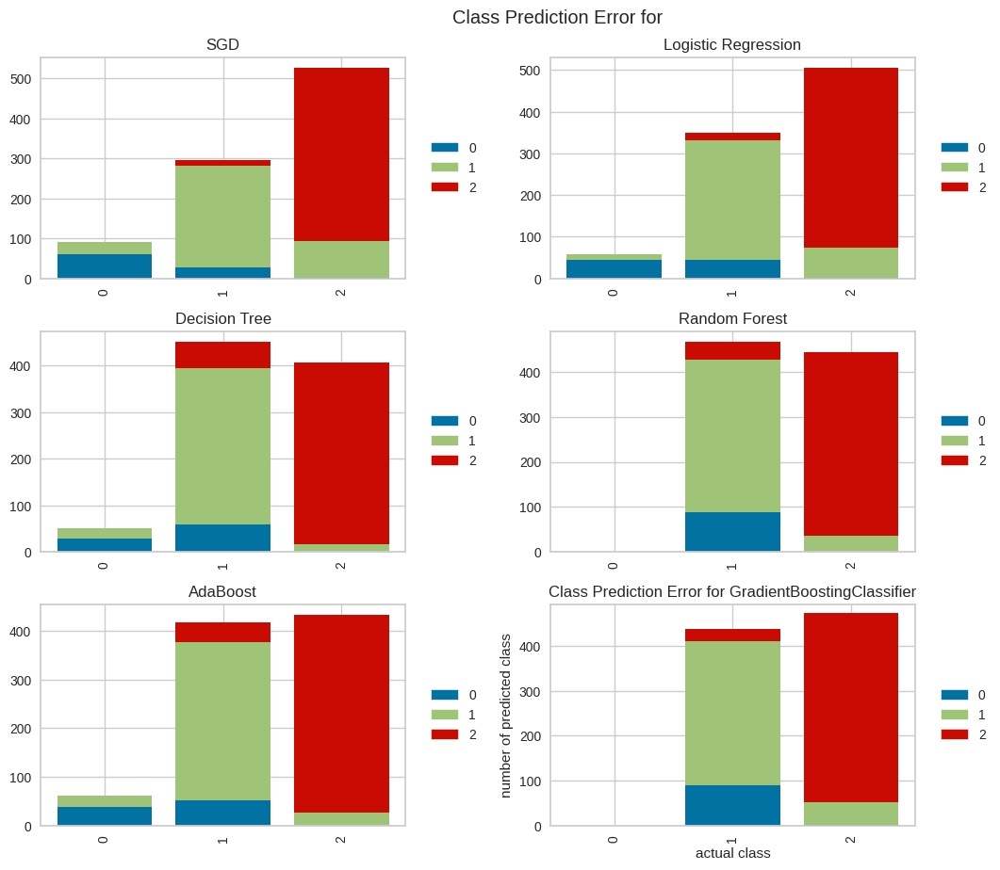

<AxesSubplot: title={'center': 'Class Prediction Error for GradientBoostingClassifier'}, xlabel='actual class', ylabel='number of predicted class'>

In [70]:
prediction_error_plot(estimators_multiclass_ac_sel_sfm, X_train_ac_sel_sfm, y_train_ac_sel_sfm, X_test_ac_sel_sfm, y_test_ac_sel_sfm, np.unique(y_adh_cat), name = 'all', features_selected = True, features = features_ac_sel_sfm, feature_sel_type = 'SFM')


### Second approach (training days goals achieved/number of all weeks, 3 groups)

In this approach we take, the number of weeks when the training days goals was achieved is divided by all of the weeks when the app was active.

The value is in range from 0 to 1. The groups can be divided into:
* Group 0 - when the adherence is higher or equal to 0.5 (413 users),
* Group 1 - when the adherence is between 0.5 and 0.1 (609 users),
* Group 2 - when the adherence is lower than 0.1 (2012 users).

The variables taken into consideration are:
* gender,
* height,
* weight,
* BMI,
* activity level,
* body type,
* newsletter subscription,
* body fat,
* training days setting,
* total time users,
* total reps users,
* total calories users,
* exercises per user,
* exercises without rest per user.

In [71]:
df_sess_exe_adh1 = df_session_exe_days_all_weeks.groupby(['id_users'])['training_days_goal_achieved'].agg(['sum', 'count']).reset_index()

df_sess_exe_adh1.rename(columns={'sum': 'sum_of_weeks_goal_achieved',
                                 'count': 'no_all_weeks'},
                       inplace = True)

df_sess_exe_adh1['Adh_num'] = df_sess_exe_adh1['sum_of_weeks_goal_achieved']/df_sess_exe_adh1['no_all_weeks']

df_sess_adh1 = df_users.merge(df_sess_exe_adh1, how = 'left', left_on = 'id_users', right_on = 'id_users')

df_sess_adh1['Adh_cat'] = np.where((df_sess_adh1['Adh_num'] >= 0.5) == True,
                                                   0,
                                                   np.where(((df_sess_adh1['Adh_num'] >= 0.1) == True) & (df_sess_adh1['Adh_num'] < 0.5),
                                                   1,
                                                   2))

df_sess_adh1.drop(['id_users', 'sum_of_weeks_goal_achieved', 'no_all_weeks', 'Adh_num'], axis = 1, inplace = True)


In [72]:
# numbers of users

k = 0
for i in range(len(df_sess_exe_adh1)):
    if (df_sess_exe_adh1['Adh_num'][i] >= 0.5) == True:
        k += 1
        
print('Number of users that should be in group 0: {}'.format(k))

j = 0
for i in range(len(df_sess_exe_adh1)):
    if ((df_sess_exe_adh1['Adh_num'][i] < 0.5) == True) & ((df_sess_exe_adh1['Adh_num'][i] >= 0.1) == True):
        j += 1
        
print('Number of users that should be in group 1: {}'.format(j))

l = 0
for i in range(len(df_sess_exe_adh1)):
    if (df_sess_exe_adh1['Adh_num'][i] < 0.1) == True:
        l += 1
        
print('Number of users that should be in group 2: {}'.format(l))

Number of users that should be in group 0: 426
Number of users that should be in group 1: 603
Number of users that should be in group 2: 2005


In [73]:
# deleting label from data
X_adh_cat_sec = df_sess_adh1.loc[:, df_sess_adh1.columns != 'Adh_cat']

# variable only with label
y_adh_cat_sec = df_sess_adh1['Adh_cat'].to_numpy()


for col in ['gender', 'body_type', 'newsletter_subscription', 'activity_level', 'training_days_setting']:
    X_adh_cat_sec[col] = LabelEncoder().fit_transform(X_adh_cat_sec[col])

y_adh_cat_se = pd.DataFrame(y_adh_cat_sec, columns = ['Adherence category'])

[INFO] Performing Grid-Search CV ---- SGD
[SGD] Features importances: [0.05171739 0.07696891 0.02313678 0.08886879 0.13237297 0.44223242
 0.26674632 0.22697793 2.70893062 2.79734957 1.26942483 0.39290391
 1.32438999 1.87348086]


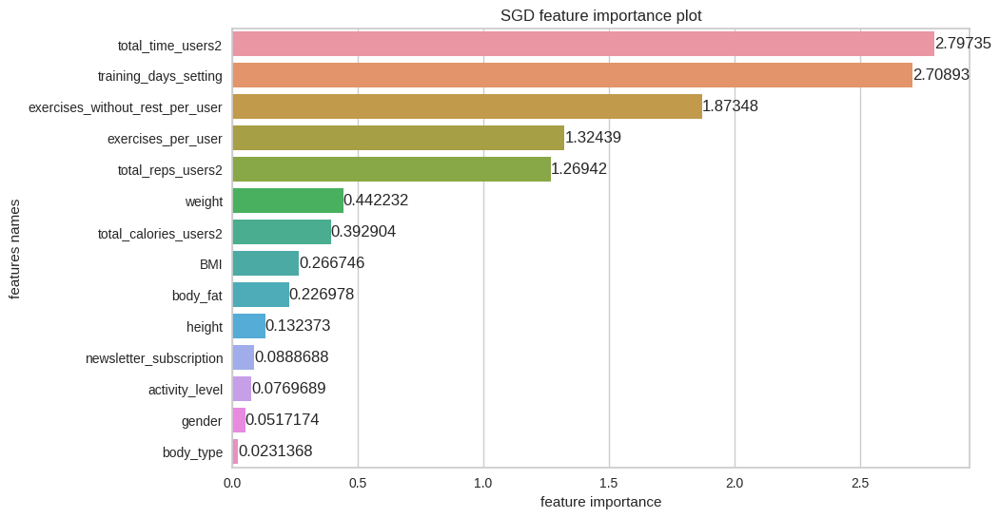

[SGD] Best parameters are {'alpha': 0.001, 'eta0': 0.07502500000000001, 'learning_rate': 'adaptive', 'penalty': 'l2', 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Logistic Regression
[Logistic Regression] Features importances: [0.31659328 0.20091368 0.03107853 0.20234689 0.11387443 0.54203788
 0.11454401 0.71693265 4.09601687 4.65799381 2.68755919 1.22033037
 4.24299073 4.97112799]


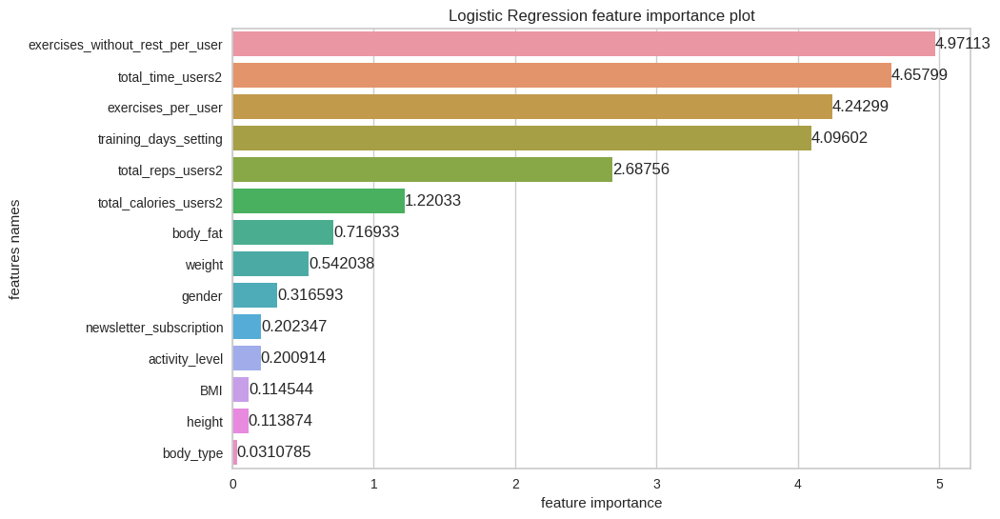

[Logistic Regression] Best parameters are {'C': 4, 'penalty': 'l1', 'random_state': 42, 'solver': 'liblinear'}
[INFO] Performing Grid-Search CV ---- Decision Tree
[Decision Tree] Features importances: [0.0, 0.0, 0.0, 0.0, 0.010812431661704121, 0.0036028690806681543, 0.022183766941185762, 0.011672520051431112, 0.39718414254330386, 0.3732807376957128, 0.04361455489618431, 0.009559295066796814, 0.10179047083828992, 0.026299211224723146]


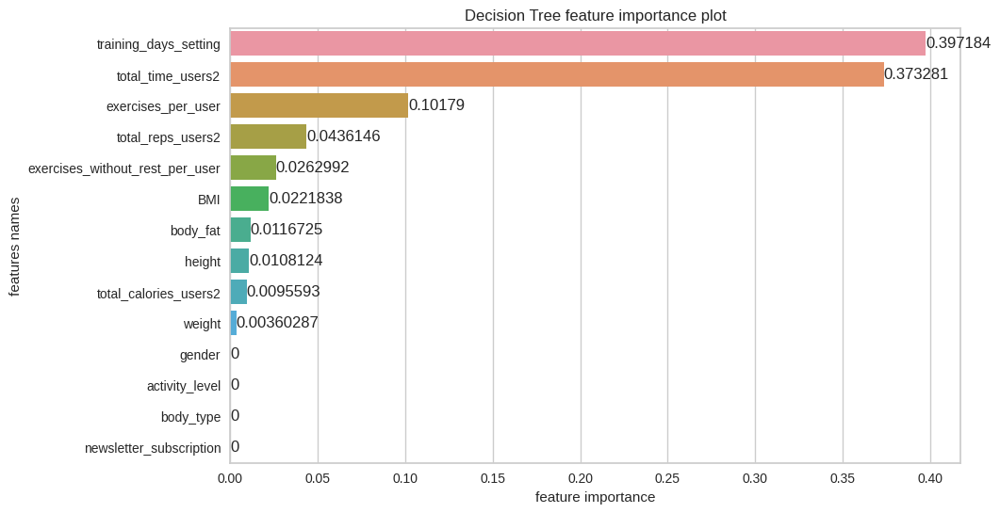

[Decision Tree] Best parameters are {'criterion': 'gini', 'max_depth': 6, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Random Forest
[Random Forest] Features importances: [0.0017413265488488375, 0.0015395695522626568, 0.0008154760307922265, 0.0005088685390386184, 0.0014002881124526847, 0.0029702170765640514, 0.005511504939551993, 0.0004105655313381321, 0.04937320556979806, 0.23170877653124947, 0.1580847831740259, 0.17954741567283647, 0.2014148654592664, 0.16497313726197446]


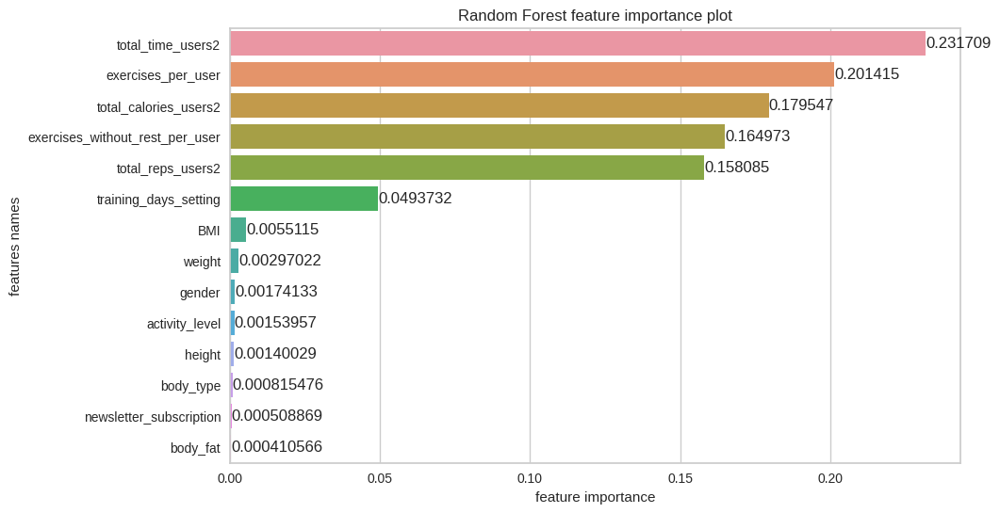

[Random Forest] Best parameters are {'criterion': 'gini', 'max_depth': 6, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- AdaBoost
[AdaBoost] Features importances: [0.0, 0.0, 0.0, 0.0, 0.0, 0.00831198639844717, 0.006642363093083326, 0.0034217382827305813, 0.3014305084918272, 0.41610028098673163, 0.15835880317949158, 0.06703832025670783, 0.01916161990907985, 0.019534379401900857]


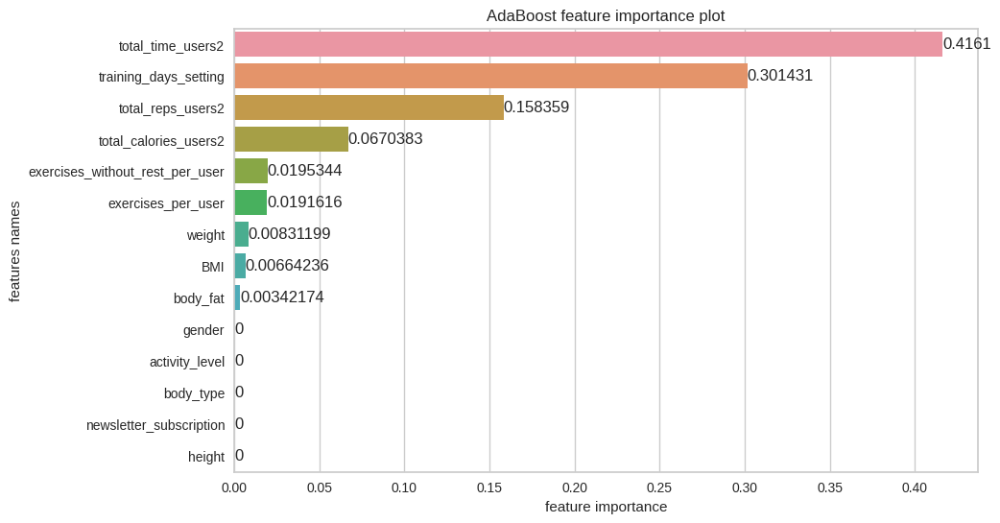

[AdaBoost] Best parameters are {'base_estimator': DecisionTreeClassifier(max_depth=3), 'learning_rate': 0.025, 'n_estimators': 40, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- GradientBoost
[GradientBoost] Features importances: [0.0021035337757380674, 0.002725677492097507, 0.0011470066205221733, 0.00414673602385837, 0.0024157448627051222, 0.0016129419301132257, 0.006074481906214109, 0.003592351492093944, 0.24784379980467097, 0.2553772346830754, 0.1694003661610113, 0.11487501147065189, 0.08181989379627058, 0.10686521998097755]


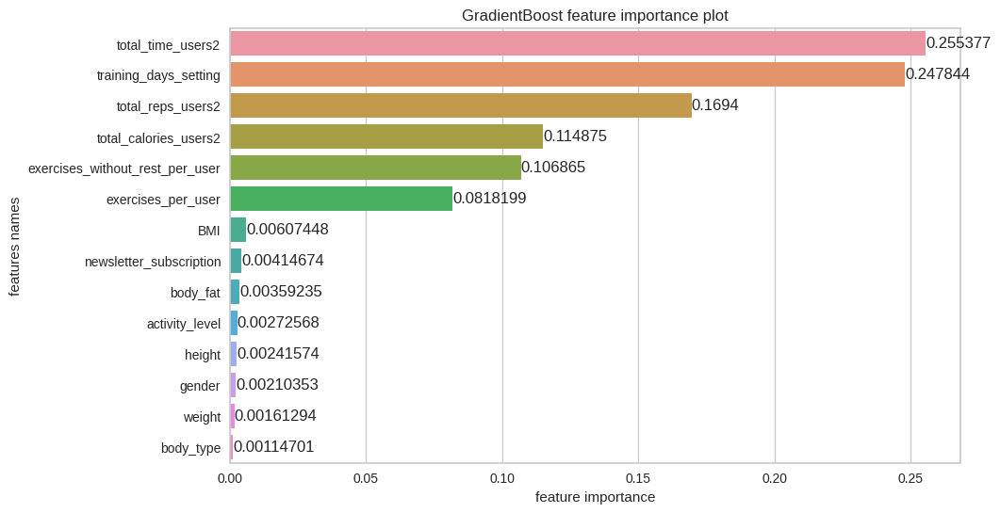

[GradientBoost] Best parameters are {'criterion': 'friedman_mse', 'learning_rate': 0.075, 'loss': 'deviance', 'max_depth': 5, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'n_estimators': 15, 'random_state': 42, 'subsample': 0.85}


In [74]:
estimators_multiclass_sec, X_test_sec, y_test_sec, X_train_sec, y_train_sec, X_test_inv_sec, features_sec = train(X_adh_cat_sec, y_adh_cat_sec, 
                                                         grid_params_multiclass, 
                                                         seed)

evaluation_table_sec = evaluate_multiclass(estimators_multiclass_sec, X_test_sec, y_test_sec, no_of_labels = 3, features = features_sec)


In [75]:
evaluation_table_sec

,Overall Accuracy,Balanced Accuracy,Adj Balanced Accuracy,Precision micro,Precision macro,Precision weighted,Recall micro,Recall macro,Recall weighted,Cohen's kappa,Mathews Correlation Coefficient
SGD,0.76,0.59,0.38,0.76,0.66,0.73,0.76,0.59,0.76,0.47,0.49
Logistic Regression,0.76,0.57,0.36,0.76,0.67,0.73,0.76,0.57,0.76,0.45,0.47
Decision Tree,0.78,0.64,0.45,0.78,0.70,0.76,0.78,0.64,0.78,0.52,0.53
Random Forest,0.69,0.45,0.18,0.69,0.40,0.58,0.69,0.45,0.69,0.28,0.30
AdaBoost,0.77,0.60,0.39,0.77,0.71,0.76,0.77,0.60,0.77,0.49,0.50
GradientBoost,0.70,0.43,0.14,0.70,0.40,0.58,0.70,0.43,0.70,0.25,0.29


The best algorithm is decision tree with depth 6, and criterion gini. The accuracy is 78%, micro precision is 78%, macro precision is 70%, weighted precision is 76%, micro and weighted recall is 78% and macro recall is 64%. Cohen's kappa is 0.52 and MCC is 0.53. The ROC and AUC are good. In overall, the results are good, but not the best.

In [76]:
prediction_for_one_user(estimators_multiclass_sec, X_test_sec, y_test_sec, X_test_inv_sec, X_adh_cat_sec.columns, y_adh_cat_se.columns, name = 'Decision Tree')


,gender,activity_level,body_type,newsletter_subscription,height,weight,BMI,body_fat,training_days_setting,total_time_users2,total_reps_users2,total_calories_users2,exercises_per_user,exercises_without_rest_per_user,Adherence category,Adherence category_prediction
704,1.00,0.00,0.00,1.00,163.00,62.00,23.34,20.00,2.00,14696.00,3452.00,938.76,16298.00,9735.00,2,2


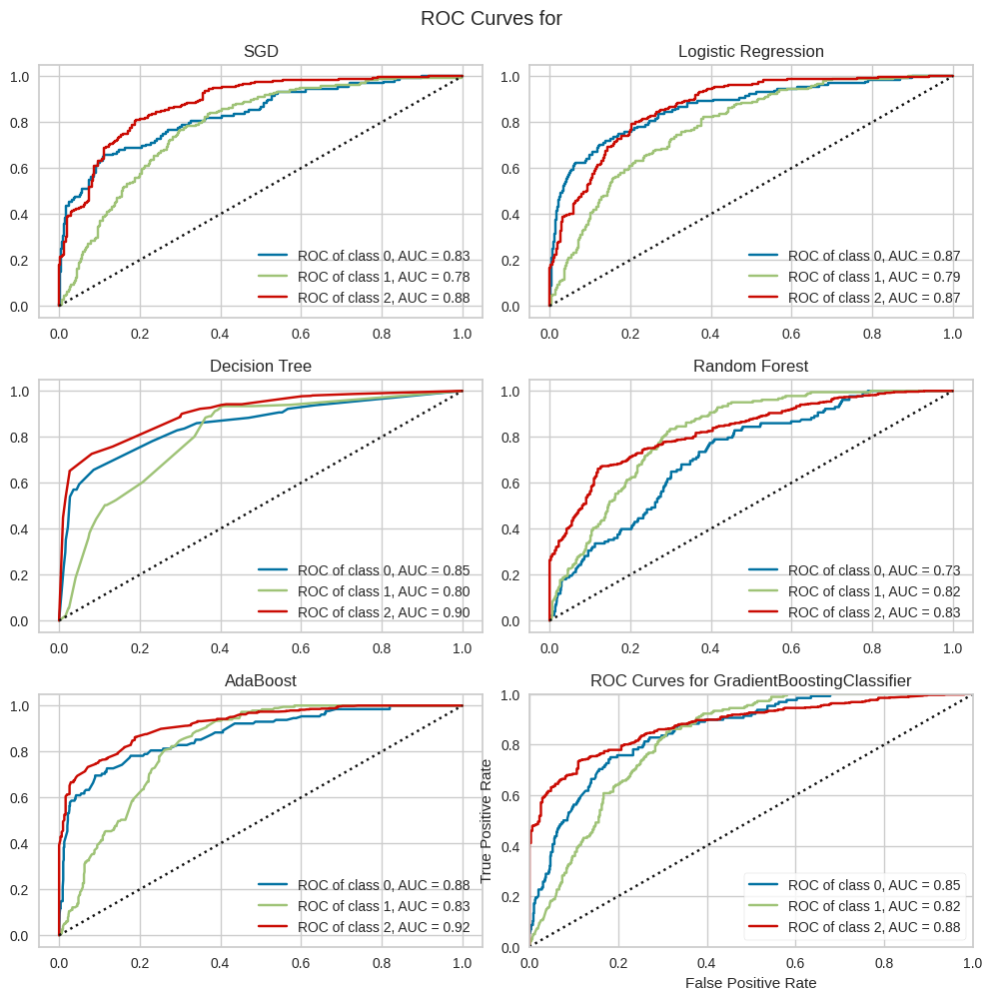

<AxesSubplot: title={'center': 'ROC Curves for GradientBoostingClassifier'}, xlabel='False Positive Rate', ylabel='True Positive Rate'>

In [77]:
ROC_curves(estimators_multiclass_sec, X_train_sec, y_train_sec, X_test_sec, y_test_sec, np.unique(y_adh_cat_sec), name = 'all', features = features_sec)


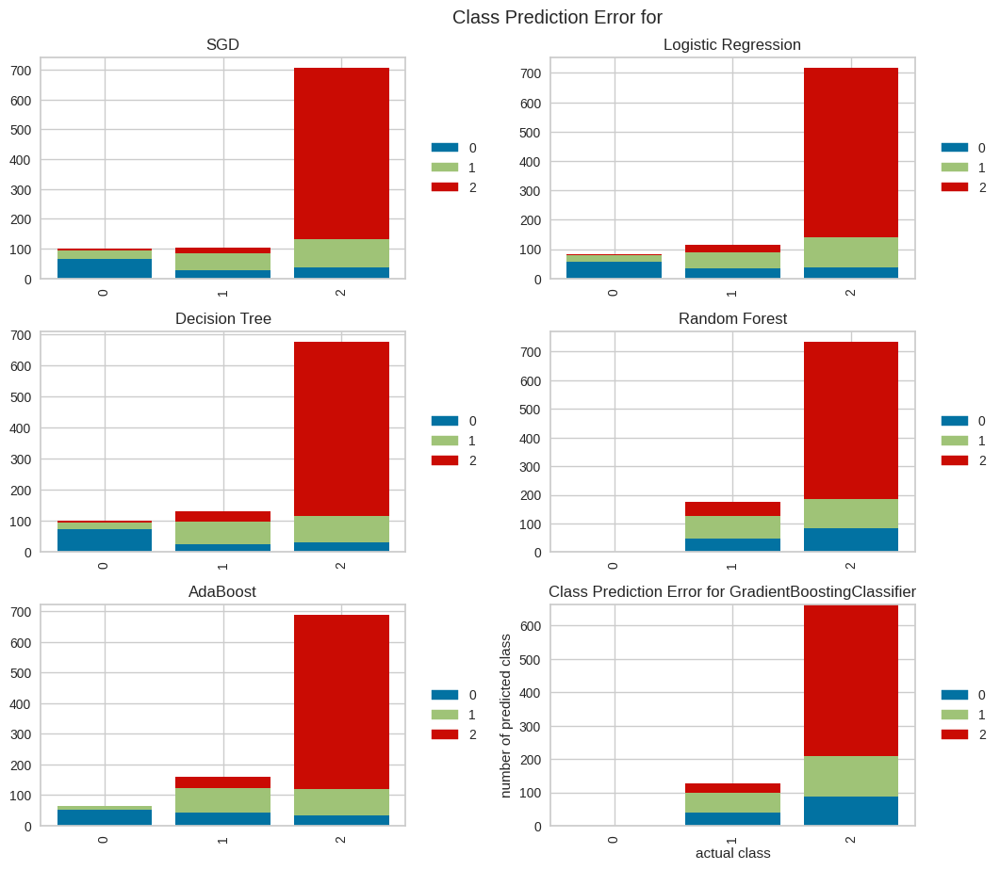

<AxesSubplot: title={'center': 'Class Prediction Error for GradientBoostingClassifier'}, xlabel='actual class', ylabel='number of predicted class'>

In [78]:
prediction_error_plot(estimators_multiclass_sec, X_train_sec, y_train_sec, X_test_sec, y_test_sec, np.unique(y_adh_cat_sec), name = 'all', features = features_sec)


### Third approach (first 4 weeks, 2 groups, demographics, goal achieved at least twice)

This approach is connected to users demographics and first 4 weeks of workouts. 

So, we take first 4 weeks of workouts and:
* Group 1 - user at least twice achieved his/hers goal in this time (482 users),
* Group 0 - user didn't achieve even twice his/her goal in this time (2552 users).

Variables taken into consideration are:

* gender,
* body_type,
* newsletter_subscription,
* height,
* weight,
* body_fat,
* activity_level.

In [79]:
# deleting label from data
X_demo_adh = df_users_demo_adh.loc[:, df_users_demo_adh.columns != 'Adh']

# variable only with label
y_demo_adh = df_users_demo_adh['Adh'].to_numpy()


cat_cols = ['gender', 'body_type', 'newsletter_subscription', 'activity_level']
X_demo_adh = pd.get_dummies(X_demo_adh, columns = cat_cols, drop_first = True)

#X_demo_adh = OrdinalEncoder().fit_transform(X_demo_adh)
y_demo_ad = pd.DataFrame(y_demo_adh, columns = ['Adherence group'])

[INFO] Performing Grid-Search CV ---- SGD
[SGD] Features importances: [0.00084142 0.00085768 0.00169748 0.00099287 0.00038094 0.00032029
 0.00068701 0.00126133 0.00162908]


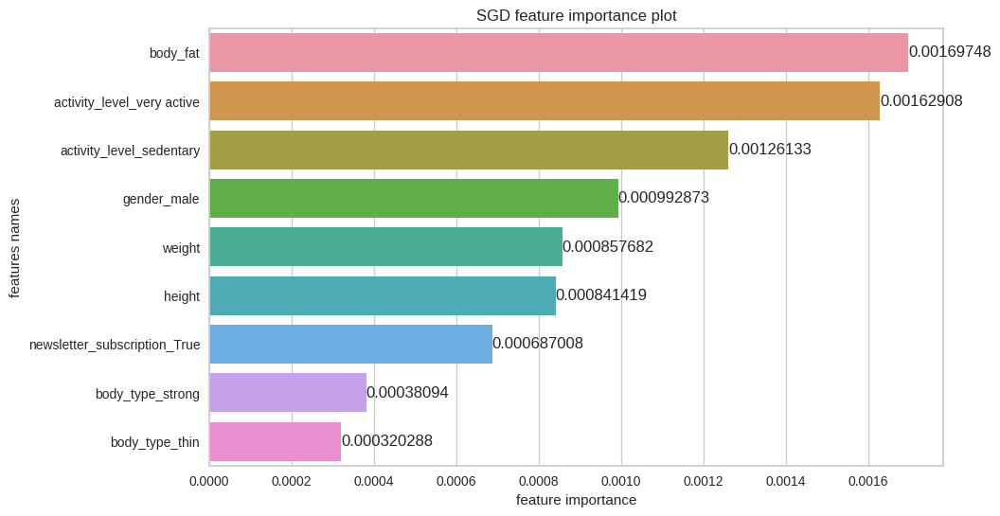

[SGD] Best parameters are {'alpha': 1e-05, 'eta0': 0.0001, 'learning_rate': 'invscaling', 'penalty': 'l1', 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Logistic Regression
[Logistic Regression] Features importances: [0.12105395 0.14448169 0.11342137 0.12096593 0.04977067 0.06629517
 0.11146926 0.12077785 0.0612239 ]


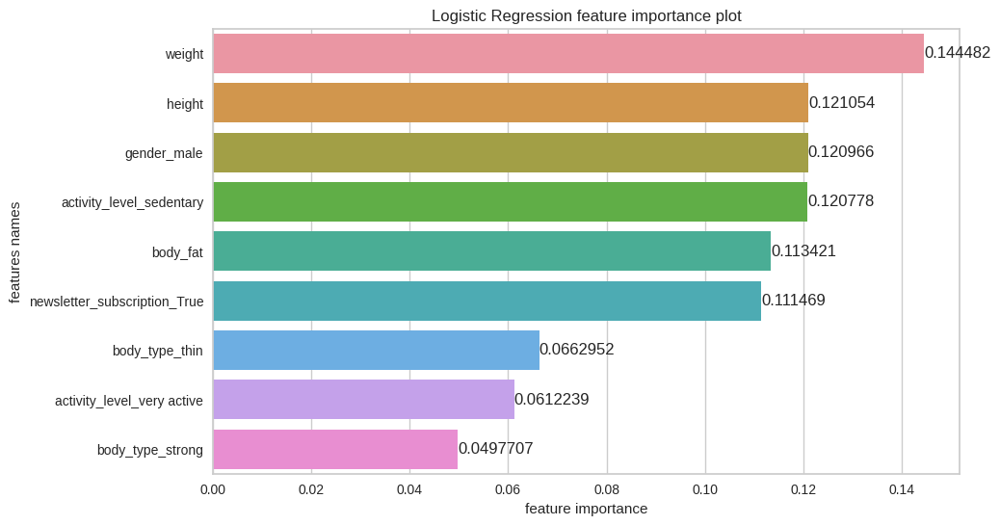

[Logistic Regression] Best parameters are {'C': 1, 'penalty': 'l1', 'random_state': 42, 'solver': 'liblinear'}
[INFO] Performing Grid-Search CV ---- Decision Tree
[Decision Tree] Features importances: [0.3328454918974019, 0.0, 0.4440842077359844, 0.0, 0.0, 0.0, 0.0, 0.22307030036661374, 0.0]


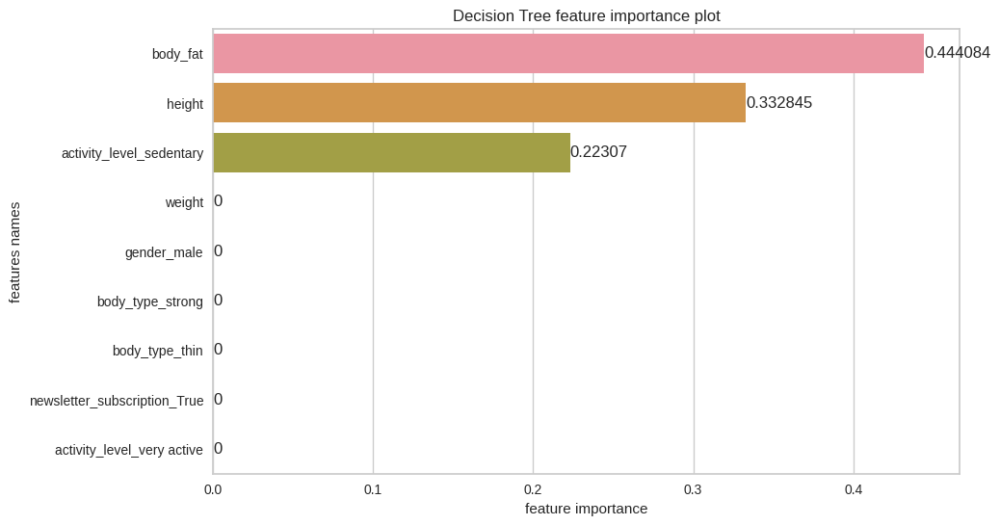

[Decision Tree] Best parameters are {'criterion': 'entropy', 'max_depth': 3, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Random Forest
[Random Forest] Features importances: [0.25520960411535865, 0.1523997801077541, 0.2251683373926851, 0.10665986527510345, 0.0, 0.02813613319386329, 0.07861691976524464, 0.1538093601499908, 0.0]


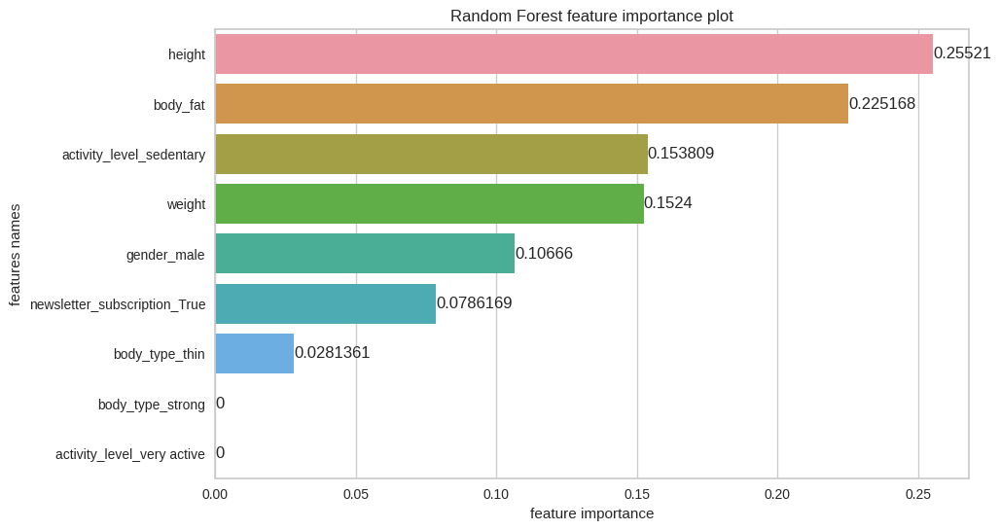

[Random Forest] Best parameters are {'criterion': 'gini', 'max_depth': 3, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- AdaBoost
[AdaBoost] Features importances: [0.0, 0.0, 0.15, 0.0, 0.0, 0.0, 0.0, 0.85, 0.0]


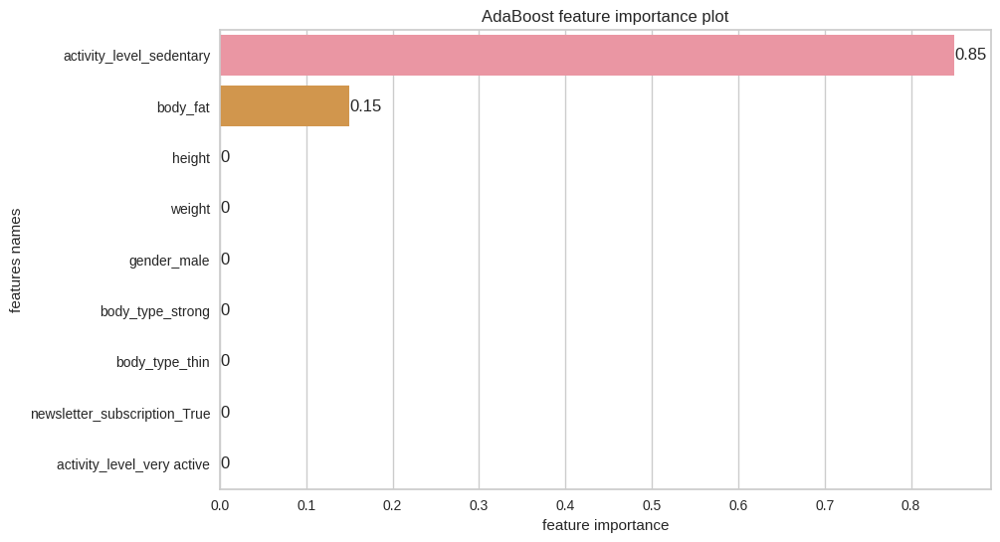

[AdaBoost] Best parameters are {'base_estimator': DecisionTreeClassifier(max_depth=1), 'learning_rate': 0.01, 'n_estimators': 20, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- GradientBoost
[GradientBoost] Features importances: [0.36912197818251097, 0.042409748616994765, 0.32154220116442295, 0.14268638138858958, 0.0, 0.0, 0.1242396906474818, 0.0, 0.0]


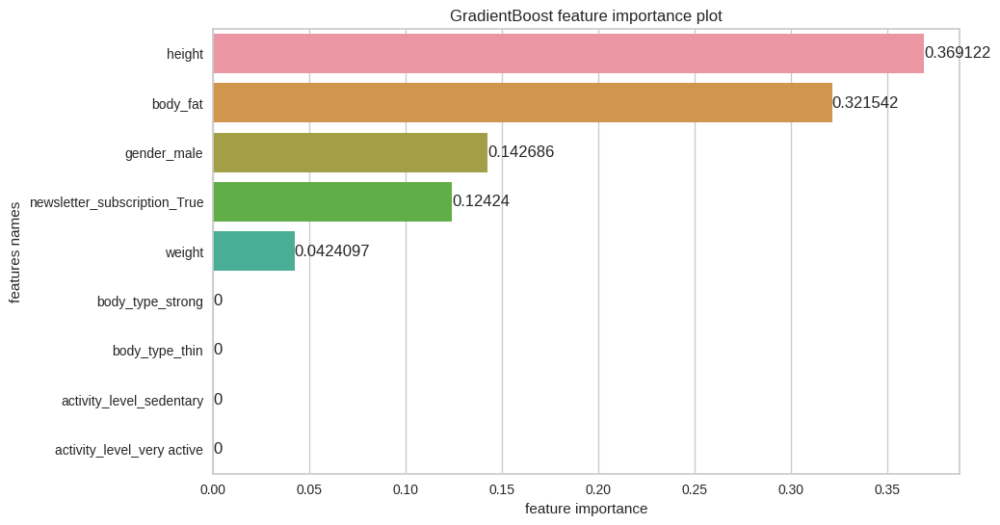

[GradientBoost] Best parameters are {'criterion': 'friedman_mse', 'learning_rate': 0.01, 'loss': 'deviance', 'max_depth': 3, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'n_estimators': 5, 'random_state': 42, 'subsample': 0.5}


In [80]:
estimators_multiclass_d_c, X_test_d_c, y_test_d_c, X_train_d_c, y_train_d_c, X_test_inv_d_c, feature_d_c = train(X_demo_adh, y_demo_adh, 
                                                         grid_params_multiclass, 
                                                         seed, feature_selection = False)

In [81]:
evaluation_table_d_c = evaluate_multiclass(estimators_multiclass_d_c, X_test_d_c, y_test_d_c, no_of_labels = 2, 
                                          features_selected = False, features = feature_d_c)

In [82]:
evaluation_table_d_c

,Overall Accuracy,Balanced Accuracy,Adj Balanced Accuracy,Precision,Recall,Cohen's kappa,Mathews Correlation Coefficient
SGD,0.84,0.50,0.00,0.00,0.00,0.00,0.00
Logistic Regression,0.84,0.50,0.00,0.00,0.00,0.00,0.00
Decision Tree,0.84,0.50,0.00,0.33,0.01,0.01,0.03
Random Forest,0.84,0.50,0.00,0.00,0.00,0.00,0.00
AdaBoost,0.84,0.50,0.00,0.00,0.00,0.00,0.00
GradientBoost,0.84,0.50,0.00,0.00,0.00,0.00,0.00


The results are terrible. Using the measures above we cannot select the best algorithm for this classification. Also ROC and AUC show, that all of the groups could be practically random.

In [83]:
prediction_for_one_user(estimators_multiclass_d_c, X_test_d_c, y_test_d_c, X_test_inv_d_c, X_demo_adh.columns, y_demo_ad.columns, name = 'SGD')


,height,weight,body_fat,gender_male,body_type_strong,body_type_thin,newsletter_subscription_True,activity_level_sedentary,activity_level_very active,Adherence group,Adherence group_prediction
704,174.00,76.00,10.00,1.00,1.00,0.00,1.00,0.00,1.00,0,0


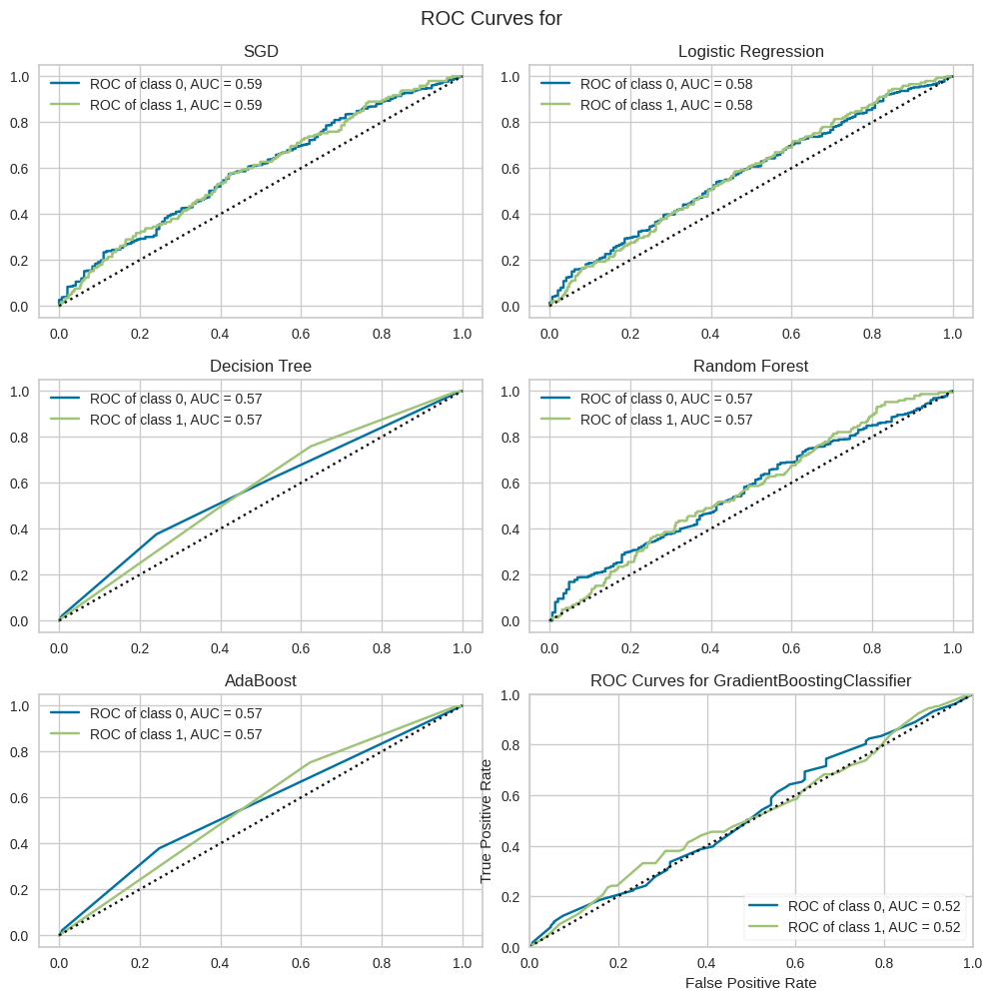

<AxesSubplot: title={'center': 'ROC Curves for GradientBoostingClassifier'}, xlabel='False Positive Rate', ylabel='True Positive Rate'>

In [84]:
ROC_curves(estimators_multiclass_d_c, X_train_d_c, y_train_d_c, X_test_d_c, y_test_d_c, np.unique(y_demo_adh), name = 'all', features_selected = False, features = feature_d_c)


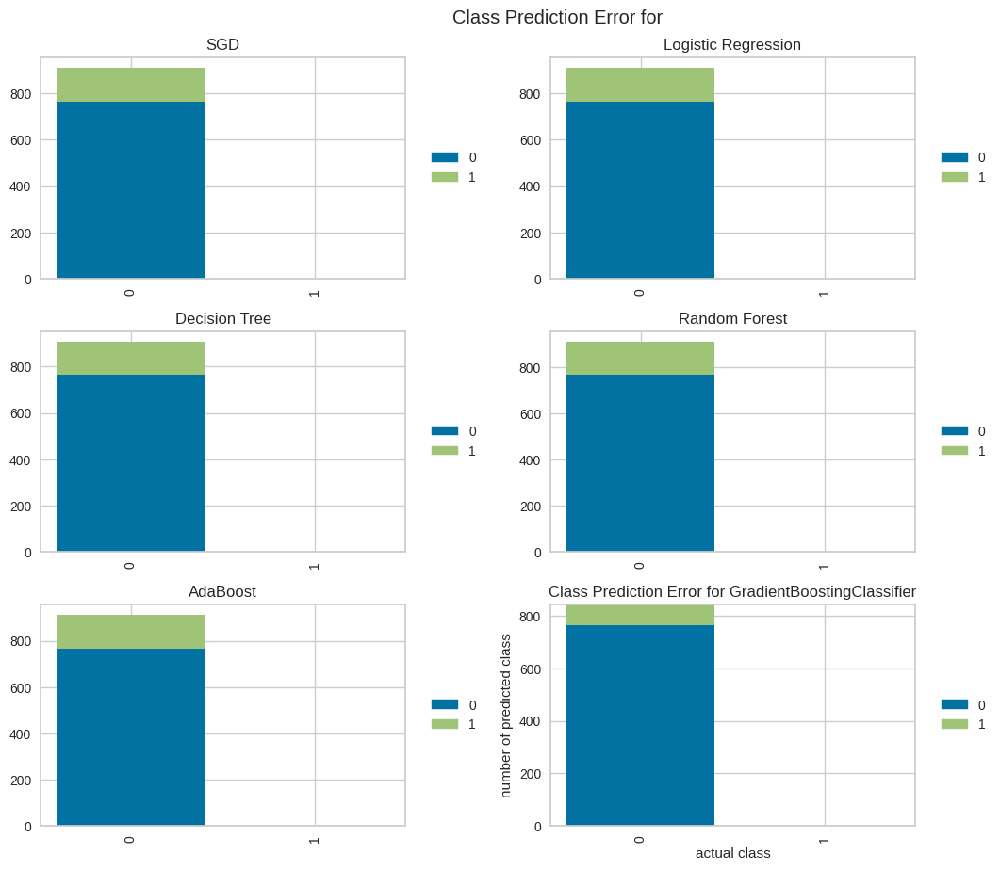

<AxesSubplot: title={'center': 'Class Prediction Error for GradientBoostingClassifier'}, xlabel='actual class', ylabel='number of predicted class'>

In [85]:
prediction_error_plot(estimators_multiclass_d_c, X_train_d_c, y_train_d_c, X_test_d_c, y_test_d_c, np.unique(y_demo_adh), name = 'all', features_selected = False, features = feature_d_c)


#### With feature selection (Univariate - Kruskall - Wallis test (instead of ANOVA) and chi-square)

[INFO] Performing Grid-Search CV ---- SGD
[SGD] Features selected: Index(['body_fat'], dtype='object')
[SGD] Features importances: [0.00169748]


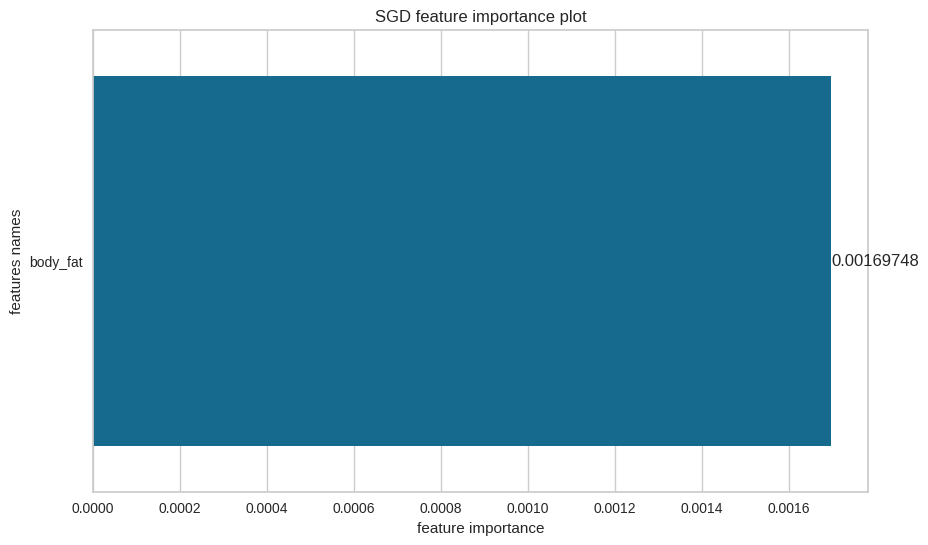

[SGD] Best parameters are {'alpha': 1e-05, 'eta0': 0.0001, 'learning_rate': 'invscaling', 'penalty': 'l1', 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Logistic Regression
[Logistic Regression] Features selected: Index(['body_fat'], dtype='object')
[Logistic Regression] Features importances: [0.22759198]


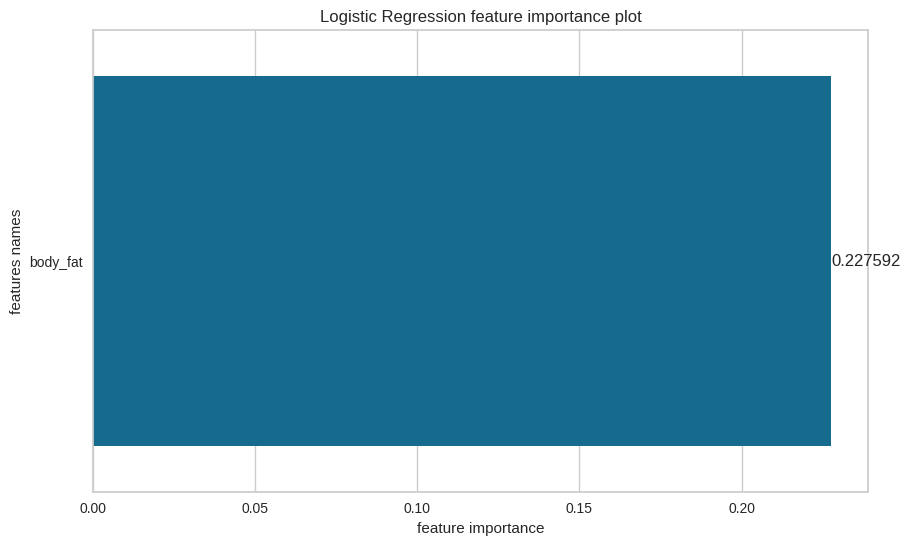

[Logistic Regression] Best parameters are {'C': 1, 'penalty': 'l1', 'random_state': 42, 'solver': 'liblinear'}
[INFO] Performing Grid-Search CV ---- Decision Tree
[Decision Tree] Features selected: Index(['body_fat'], dtype='object')
[Decision Tree] Features importances: [1.0]


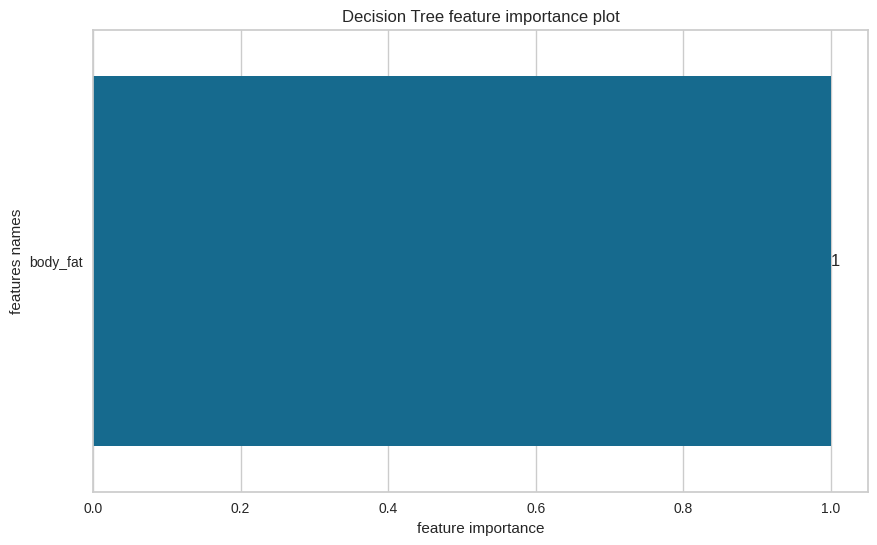

[Decision Tree] Best parameters are {'criterion': 'gini', 'max_depth': 3, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Random Forest
[Random Forest] Features selected: Index(['body_fat'], dtype='object')
[Random Forest] Features importances: [1.0]


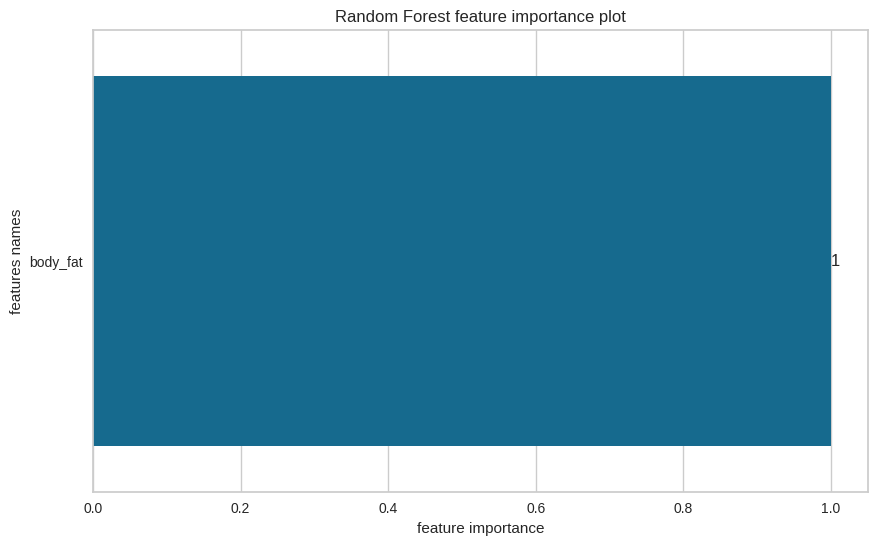

[Random Forest] Best parameters are {'criterion': 'gini', 'max_depth': 3, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- AdaBoost
[AdaBoost] Features selected: Index(['body_fat'], dtype='object')
[AdaBoost] Features importances: [1.0]


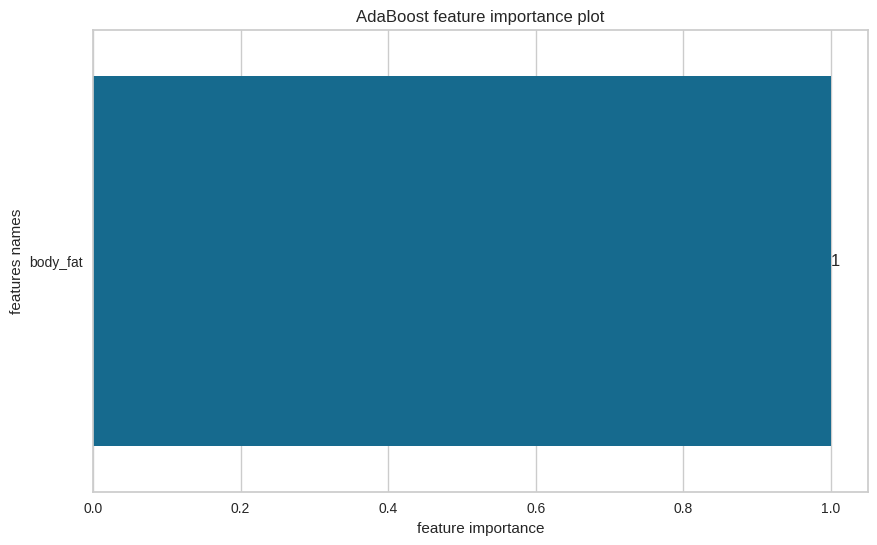

[AdaBoost] Best parameters are {'base_estimator': DecisionTreeClassifier(max_depth=3), 'learning_rate': 0.05, 'n_estimators': 40, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- GradientBoost
[GradientBoost] Features selected: Index(['body_fat'], dtype='object')
[GradientBoost] Features importances: [1.0]


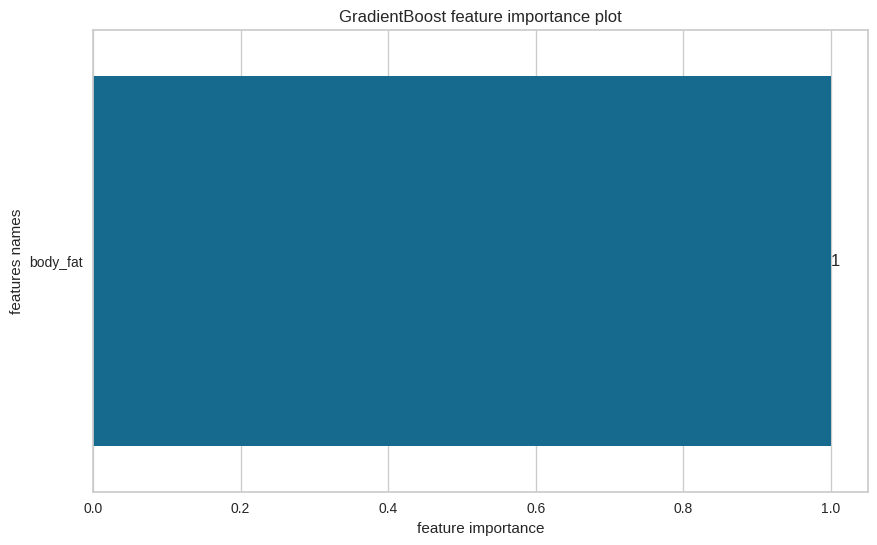

[GradientBoost] Best parameters are {'criterion': 'friedman_mse', 'learning_rate': 0.01, 'loss': 'deviance', 'max_depth': 3, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'n_estimators': 5, 'random_state': 42, 'subsample': 0.5}


In [86]:
estimators_multiclass_d_c_sel_u, X_test_d_c_sel_u, y_test_d_c_sel_u, X_train_d_c_sel_u, y_train_d_c_sel_u, X_test_inv_d_c_sel_u, features_d_c_sel_u = train(X_demo_adh, y_demo_adh, 
                                                         grid_params_multiclass, 
                                                         seed, feature_selection = True, 
                                                         feature_sel_type = 'UNI')

In [87]:
evaluation_table_d_c_sel_u = evaluate_multiclass(estimators_multiclass_d_c_sel_u, X_test_d_c_sel_u, y_test_d_c_sel_u, no_of_labels = 3, features_selected = True, features = features_d_c_sel_u, feature_sel_type = 'UNI')

In [88]:
evaluation_table_d_c_sel_u

,Overall Accuracy,Balanced Accuracy,Adj Balanced Accuracy,Precision micro,Precision macro,Precision weighted,Recall micro,Recall macro,Recall weighted,Cohen's kappa,Mathews Correlation Coefficient
SGD,0.84,0.50,0.00,0.84,0.42,0.71,0.84,0.50,0.84,0.00,0.00
Logistic Regression,0.84,0.50,0.00,0.84,0.42,0.71,0.84,0.50,0.84,0.00,0.00
Decision Tree,0.84,0.50,0.00,0.84,0.42,0.71,0.84,0.50,0.84,0.00,0.00
Random Forest,0.84,0.50,0.00,0.84,0.42,0.71,0.84,0.50,0.84,0.00,0.00
AdaBoost,0.84,0.50,-0.00,0.84,0.42,0.71,0.84,0.50,0.84,-0.00,-0.01
GradientBoost,0.84,0.50,0.00,0.84,0.42,0.71,0.84,0.50,0.84,0.00,0.00


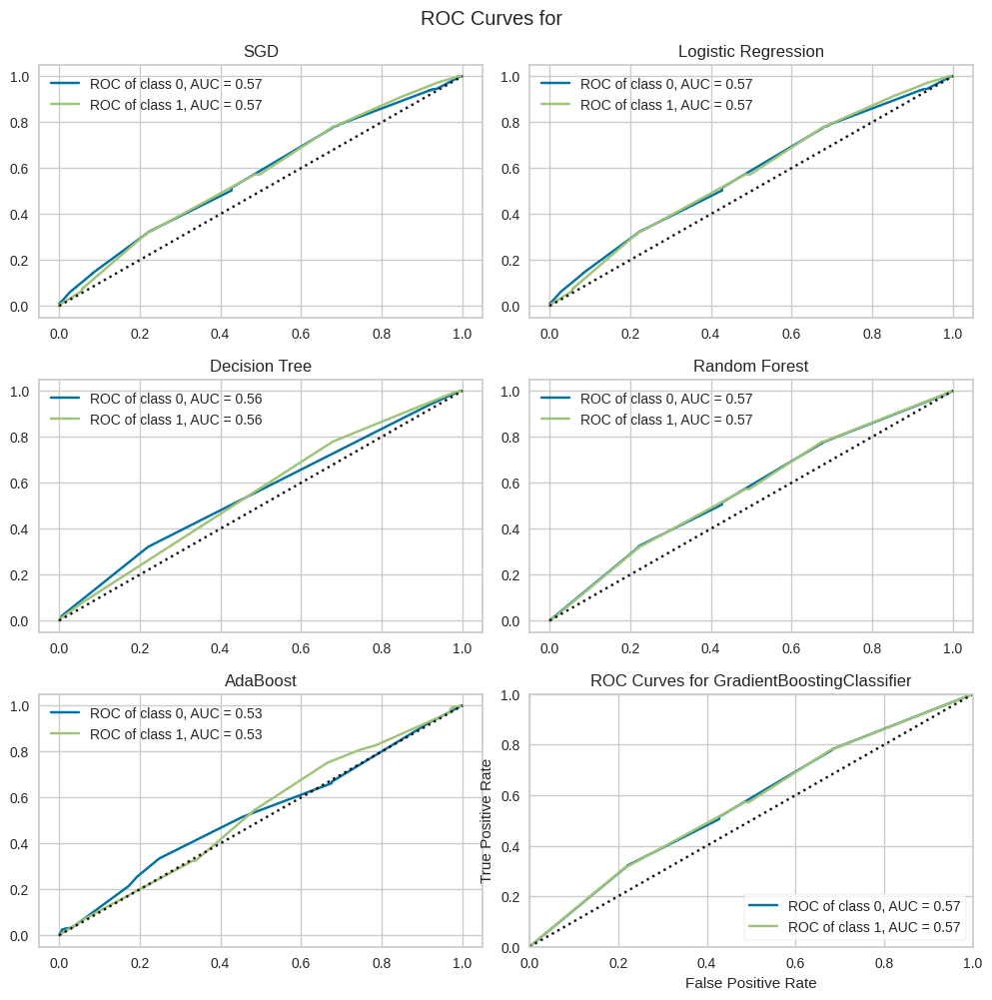

<AxesSubplot: title={'center': 'ROC Curves for GradientBoostingClassifier'}, xlabel='False Positive Rate', ylabel='True Positive Rate'>

In [89]:
ROC_curves(estimators_multiclass_d_c_sel_u, X_train_d_c_sel_u, y_train_d_c_sel_u, X_test_d_c_sel_u, y_test_d_c_sel_u, np.unique(y_demo_adh), name = 'all', features_selected = True, features = features_d_c_sel_u, feature_sel_type = 'UNI')

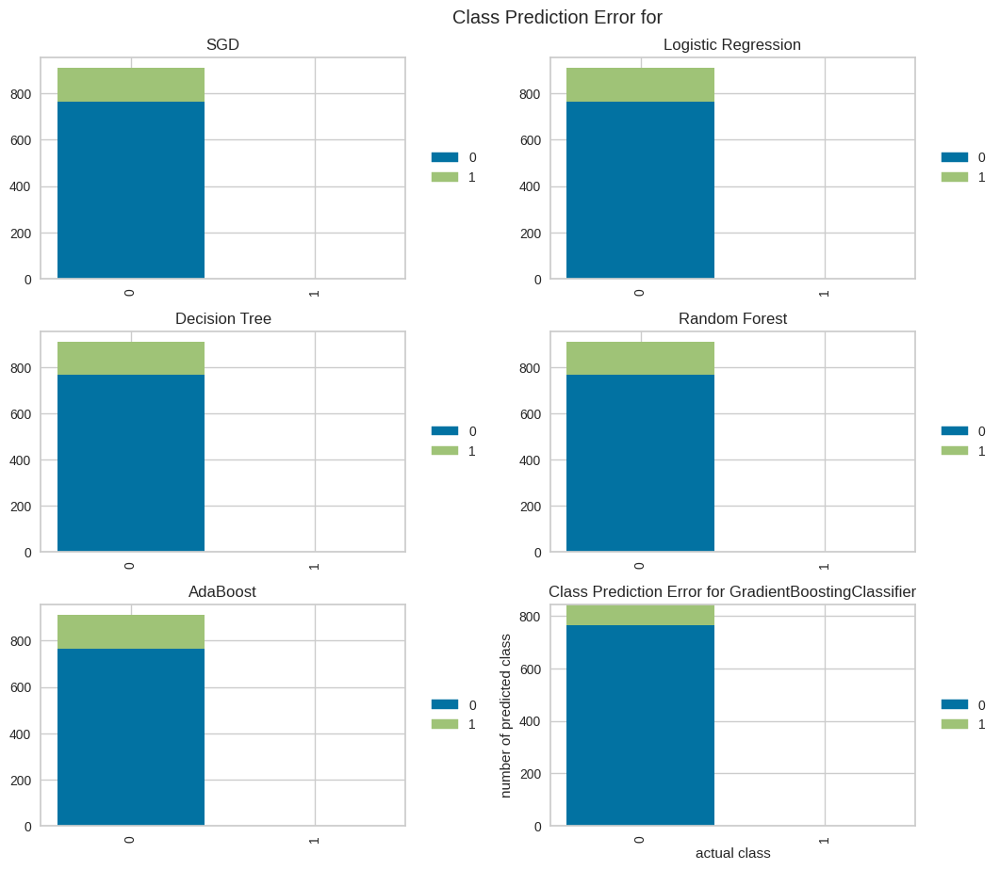

<AxesSubplot: title={'center': 'Class Prediction Error for GradientBoostingClassifier'}, xlabel='actual class', ylabel='number of predicted class'>

In [90]:
prediction_error_plot(estimators_multiclass_d_c_sel_u, X_train_d_c_sel_u, y_train_d_c_sel_u, X_test_d_c_sel_u, y_test_d_c_sel_u, np.unique(y_demo_adh), name = 'all', features_selected = True, features = features_d_c_sel_u, feature_sel_type = 'UNI')

#### With feature selection (by SequentialFeatureSelector)

In [91]:
estimators_multiclass_d_c_sel_sfs, X_test_d_c_sel_sfs, y_test_d_c_sel_sfs, X_train_d_c_sel_sfs, y_train_d_c_sel_sfs, X_test_inv_d_c_sel_sfs, features_d_c_sel_sfs = train(X_demo_adh, y_demo_adh, 
                                                         grid_params_multiclass, 
                                                         seed, feature_selection = True, 
                                                         feature_sel_type = 'SFS')

[INFO] Performing Grid-Search CV ---- SGD
[SGD] Features selected: Index(['height'], dtype='object')
[SGD] Best parameters are {'alpha': 1e-05, 'eta0': 0.0001, 'learning_rate': 'optimal', 'penalty': 'l1', 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Logistic Regression
[Logistic Regression] Features selected: Index(['height'], dtype='object')
[Logistic Regression] Best parameters are {'C': 1, 'penalty': 'l1', 'random_state': 42, 'solver': 'liblinear'}
[INFO] Performing Grid-Search CV ---- Decision Tree
[Decision Tree] Features selected: Index(['gender_male'], dtype='object')
[Decision Tree] Best parameters are {'criterion': 'gini', 'max_depth': 3, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Random Forest
[Random Forest] Features selected: Index(['body_fat', 'gender_male', 'body_type_strong', 'body_type_thin'], dtype='object')
[Random Forest] Best parameters are {'criterion': 'gini', 'max_depth': 3, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples

In [92]:
evaluation_table_d_c_sel_sfs = evaluate_multiclass(estimators_multiclass_d_c_sel_sfs, X_test_d_c_sel_sfs, y_test_d_c_sel_sfs, no_of_labels = 3, features_selected = True, features = features_d_c_sel_sfs, feature_sel_type = 'SFS')


In [93]:
evaluation_table_d_c_sel_sfs

,Overall Accuracy,Balanced Accuracy,Adj Balanced Accuracy,Precision micro,Precision macro,Precision weighted,Recall micro,Recall macro,Recall weighted,Cohen's kappa,Mathews Correlation Coefficient
SGD,0.84,0.50,0.00,0.84,0.42,0.71,0.84,0.50,0.84,0.00,0.00
Logistic Regression,0.84,0.50,0.00,0.84,0.42,0.71,0.84,0.50,0.84,0.00,0.00
Decision Tree,0.84,0.50,0.00,0.84,0.42,0.71,0.84,0.50,0.84,0.00,0.00
Random Forest,0.84,0.50,0.00,0.84,0.42,0.71,0.84,0.50,0.84,0.00,0.00
AdaBoost,0.84,0.50,0.00,0.84,0.42,0.71,0.84,0.50,0.84,0.00,0.00
GradientBoost,0.84,0.50,0.00,0.84,0.42,0.71,0.84,0.50,0.84,0.00,0.00


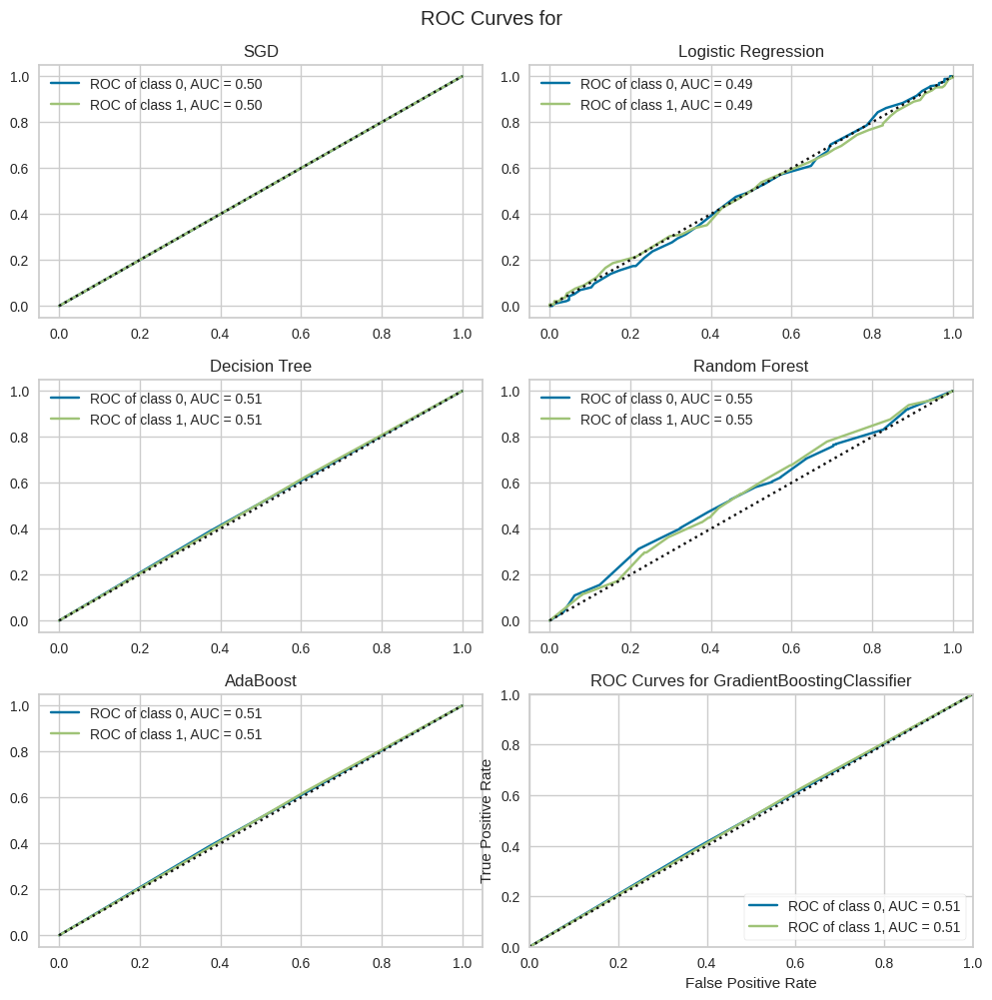

<AxesSubplot: title={'center': 'ROC Curves for GradientBoostingClassifier'}, xlabel='False Positive Rate', ylabel='True Positive Rate'>

In [94]:
ROC_curves(estimators_multiclass_d_c_sel_sfs, X_train_d_c_sel_sfs, y_train_d_c_sel_sfs, X_test_d_c_sel_sfs, y_test_d_c_sel_sfs, np.unique(y_demo_adh), name = 'all', features_selected = True, features = features_d_c_sel_sfs, feature_sel_type = 'SFS')


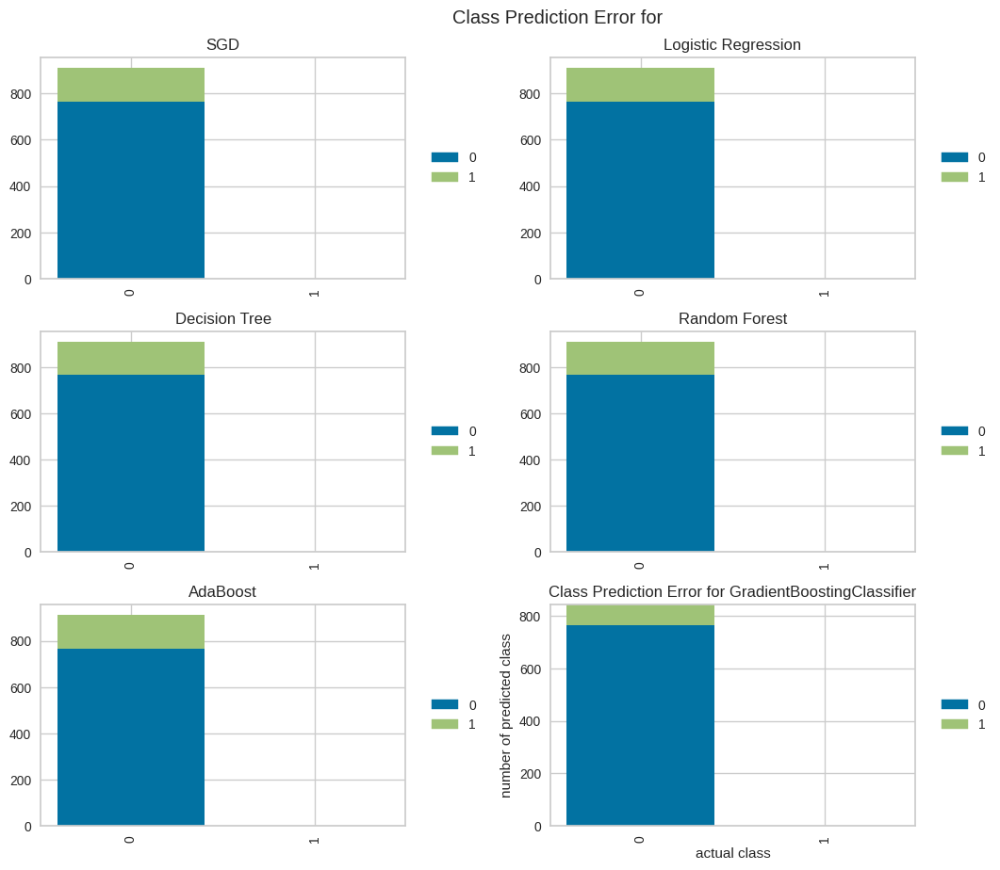

<AxesSubplot: title={'center': 'Class Prediction Error for GradientBoostingClassifier'}, xlabel='actual class', ylabel='number of predicted class'>

In [95]:
prediction_error_plot(estimators_multiclass_d_c_sel_sfs, X_train_d_c_sel_sfs, y_train_d_c_sel_sfs, X_test_d_c_sel_sfs, y_test_d_c_sel_sfs, np.unique(y_demo_adh), name = 'all', features_selected = True, features = features_d_c_sel_sfs, feature_sel_type = 'SFS')


#### With feature selection (by Recursive feature elimination with cross-validation - RFECV)

[INFO] Performing Grid-Search CV ---- SGD
[SGD] Features selected: Index(['height', 'body_fat', 'body_type_strong', 'body_type_thin',
       'activity_level_sedentary', 'activity_level_very active'],
      dtype='object')
[SGD] Features importances: [0.00084142 0.00169748 0.00038094 0.00032029 0.00126133 0.00162908]


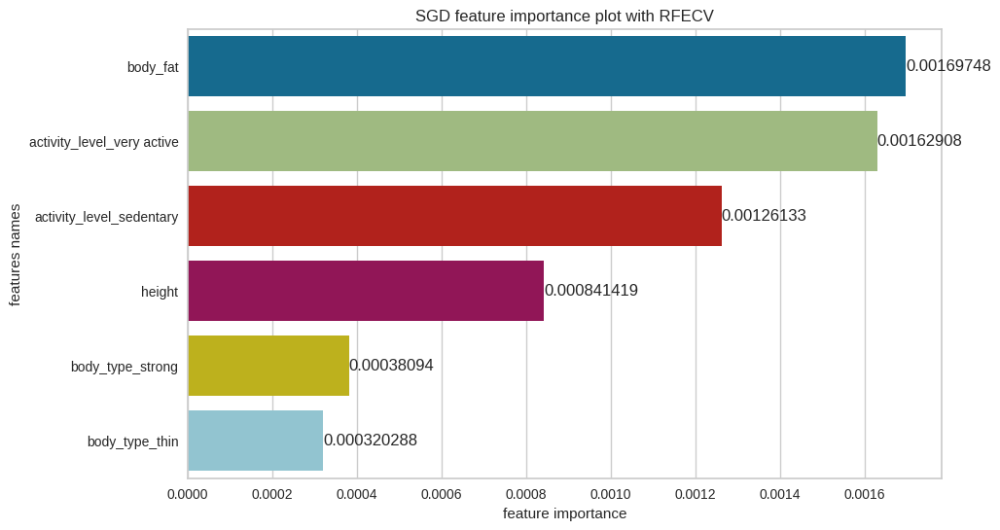

[SGD] Best parameters are {'alpha': 1e-05, 'eta0': 0.0001, 'learning_rate': 'invscaling', 'penalty': 'l1', 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Logistic Regression
[Logistic Regression] Features selected: Index(['height'], dtype='object')
[Logistic Regression] Features importances: [0.1403439]


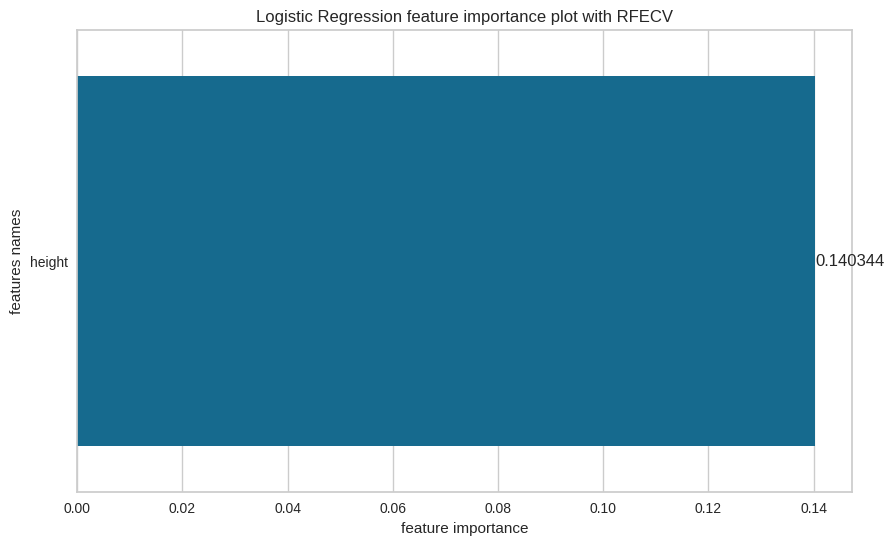

[Logistic Regression] Best parameters are {'C': 1, 'penalty': 'l1', 'random_state': 42, 'solver': 'liblinear'}
[INFO] Performing Grid-Search CV ---- Decision Tree
[Decision Tree] Features selected: Index(['weight'], dtype='object')
[Decision Tree] Features importances: [1.0]


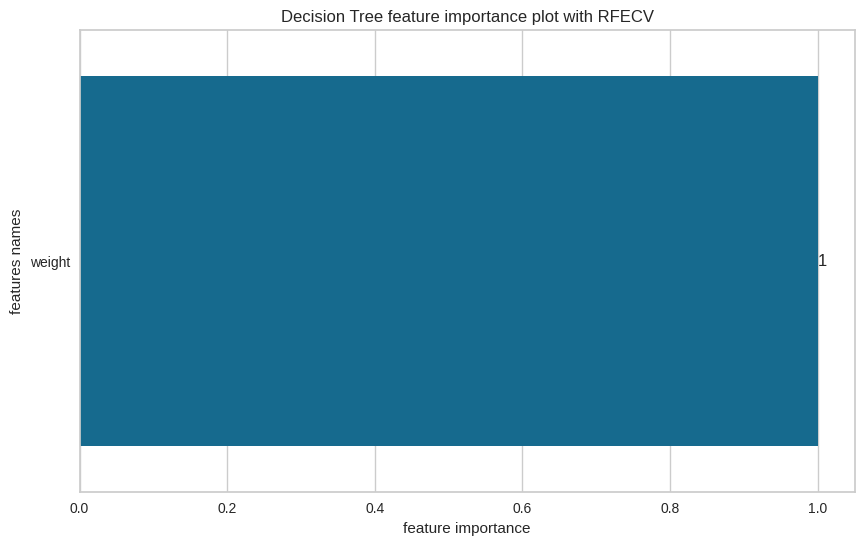

[Decision Tree] Best parameters are {'criterion': 'gini', 'max_depth': 3, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Random Forest
[Random Forest] Features selected: Index(['weight'], dtype='object')
[Random Forest] Features importances: [1.0]


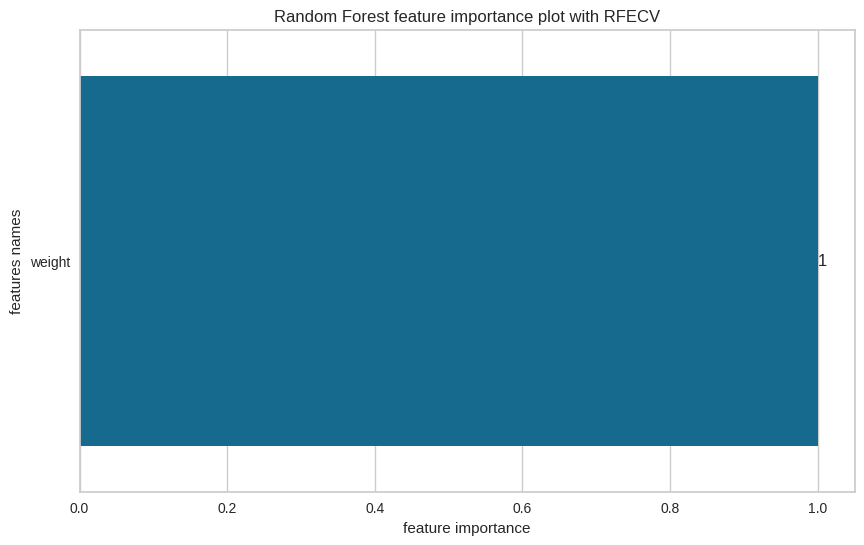

[Random Forest] Best parameters are {'criterion': 'gini', 'max_depth': 3, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- AdaBoost
[AdaBoost] Features selected: Index(['weight'], dtype='object')
[AdaBoost] Features importances: [1.0]


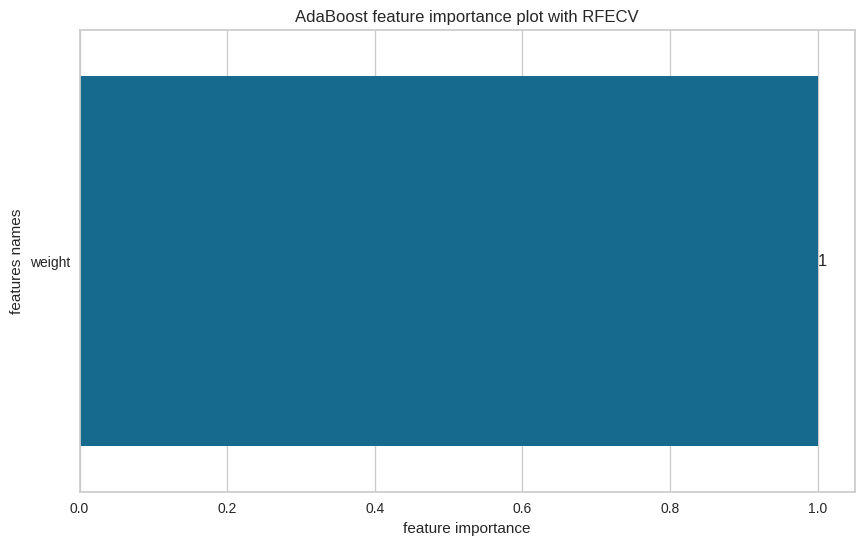

[AdaBoost] Best parameters are {'base_estimator': DecisionTreeClassifier(max_depth=1), 'learning_rate': 0.01, 'n_estimators': 20, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- GradientBoost
[GradientBoost] Features selected: Index(['weight'], dtype='object')
[GradientBoost] Features importances: [1.0]


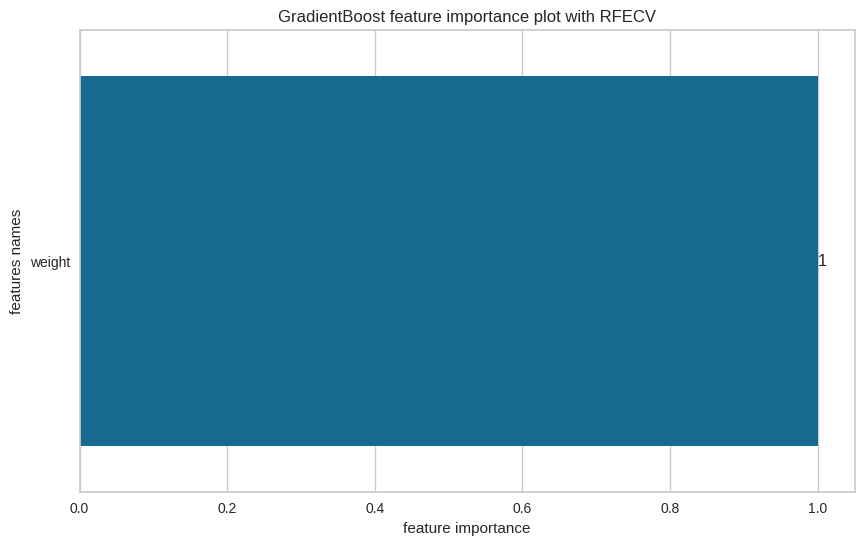

[GradientBoost] Best parameters are {'criterion': 'friedman_mse', 'learning_rate': 0.01, 'loss': 'deviance', 'max_depth': 3, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'n_estimators': 5, 'random_state': 42, 'subsample': 0.5}


In [96]:
estimators_multiclass_d_c_sel_rfecv, X_test_d_c_sel_rfecv, y_test_d_c_sel_rfecv, X_train_d_c_sel_rfecv, y_train_d_c_sel_rfecv, X_test_inv_d_c_sel_rfecv, features_d_c_sel_rfecv = train(X_demo_adh, y_demo_adh, 
                                                         grid_params_multiclass, 
                                                         seed, feature_selection = True, 
                                                         feature_sel_type = 'RFECV')

In [97]:
evaluation_table_d_c_sel_rfecv = evaluate_multiclass(estimators_multiclass_d_c_sel_rfecv, X_test_d_c_sel_rfecv, y_test_d_c_sel_rfecv, no_of_labels = 3, features_selected = True, features = features_d_c_sel_rfecv, feature_sel_type = 'RFECV')

In [98]:
evaluation_table_d_c_sel_rfecv

,Overall Accuracy,Balanced Accuracy,Adj Balanced Accuracy,Precision micro,Precision macro,Precision weighted,Recall micro,Recall macro,Recall weighted,Cohen's kappa,Mathews Correlation Coefficient
SGD,0.84,0.50,0.00,0.84,0.42,0.71,0.84,0.50,0.84,0.00,0.00
Logistic Regression,0.84,0.50,0.00,0.84,0.42,0.71,0.84,0.50,0.84,0.00,0.00
Decision Tree,0.84,0.50,0.00,0.84,0.42,0.71,0.84,0.50,0.84,0.00,0.00
Random Forest,0.84,0.50,0.00,0.84,0.42,0.71,0.84,0.50,0.84,0.00,0.00
AdaBoost,0.84,0.50,0.00,0.84,0.42,0.71,0.84,0.50,0.84,0.00,0.00
GradientBoost,0.84,0.50,0.00,0.84,0.42,0.71,0.84,0.50,0.84,0.00,0.00


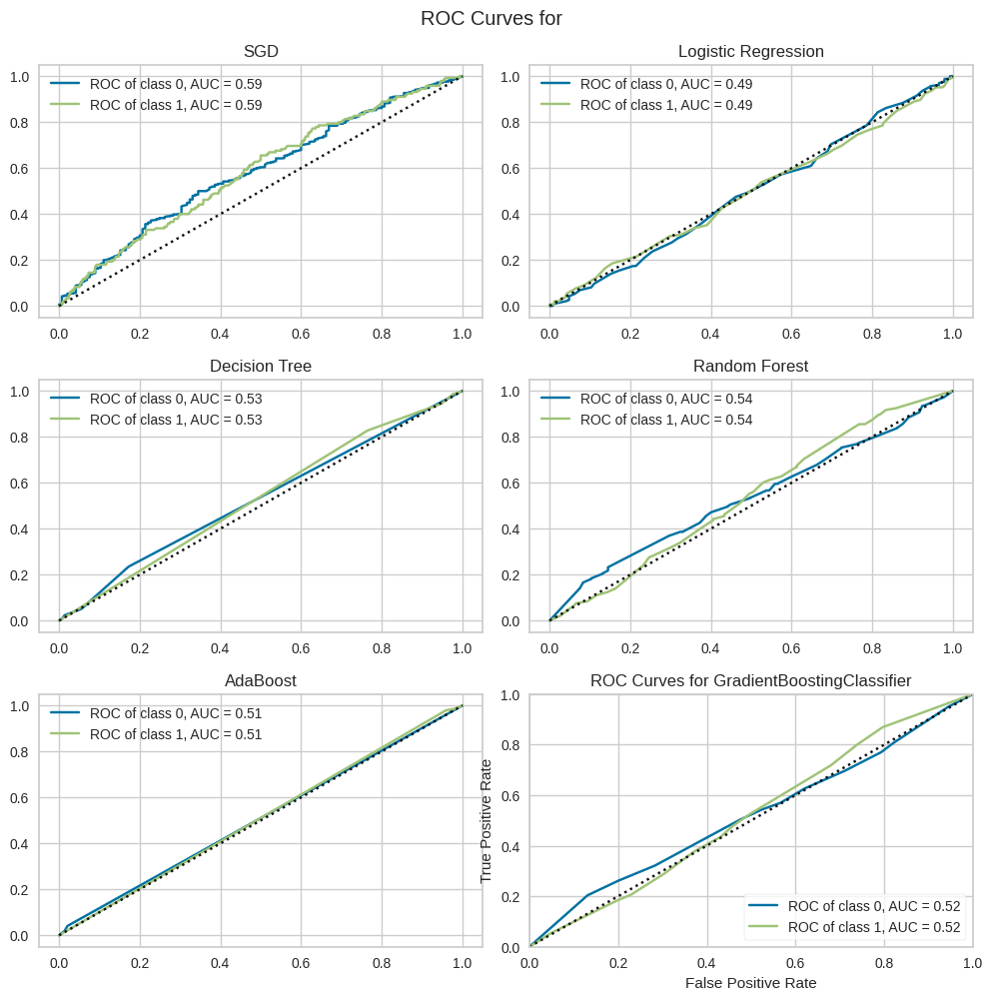

<AxesSubplot: title={'center': 'ROC Curves for GradientBoostingClassifier'}, xlabel='False Positive Rate', ylabel='True Positive Rate'>

In [99]:
ROC_curves(estimators_multiclass_d_c_sel_rfecv, X_train_d_c_sel_rfecv, y_train_d_c_sel_rfecv, X_test_d_c_sel_rfecv, y_test_d_c_sel_rfecv, np.unique(y_demo_adh), name = 'all', features_selected = True, features = features_d_c_sel_rfecv, feature_sel_type = 'RFECV')


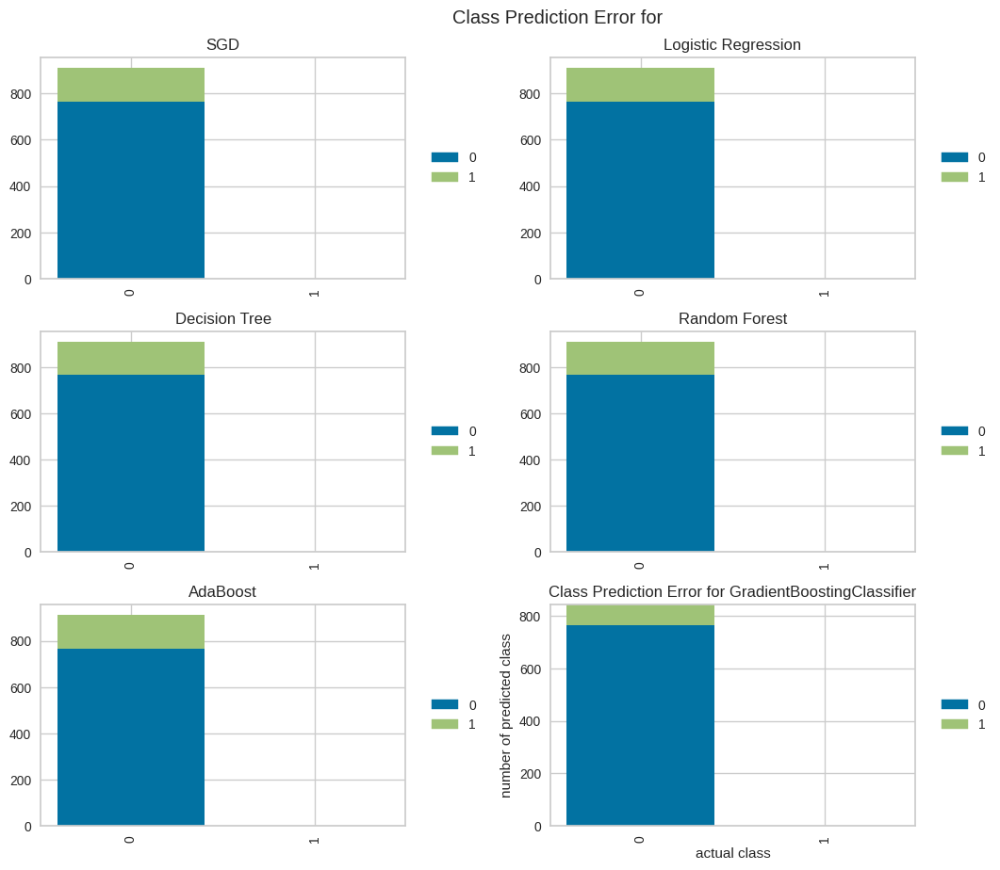

<AxesSubplot: title={'center': 'Class Prediction Error for GradientBoostingClassifier'}, xlabel='actual class', ylabel='number of predicted class'>

In [100]:
prediction_error_plot(estimators_multiclass_d_c_sel_rfecv, X_train_d_c_sel_rfecv, y_train_d_c_sel_rfecv, X_test_d_c_sel_rfecv, y_test_d_c_sel_rfecv, np.unique(y_demo_adh), name = 'all', features_selected = True, features = features_d_c_sel_rfecv, feature_sel_type = 'RFECV')

#### With feature selection (by SelectFromModel)

[INFO] Performing Grid-Search CV ---- SGD
[SGD] Features selected: Index(['height', 'weight', 'body_fat', 'body_type_thin',
       'activity_level_very active'],
      dtype='object')
[SGD] Features importances: [0.01400198 0.0118763  0.0903583  0.03177935 0.05480819]


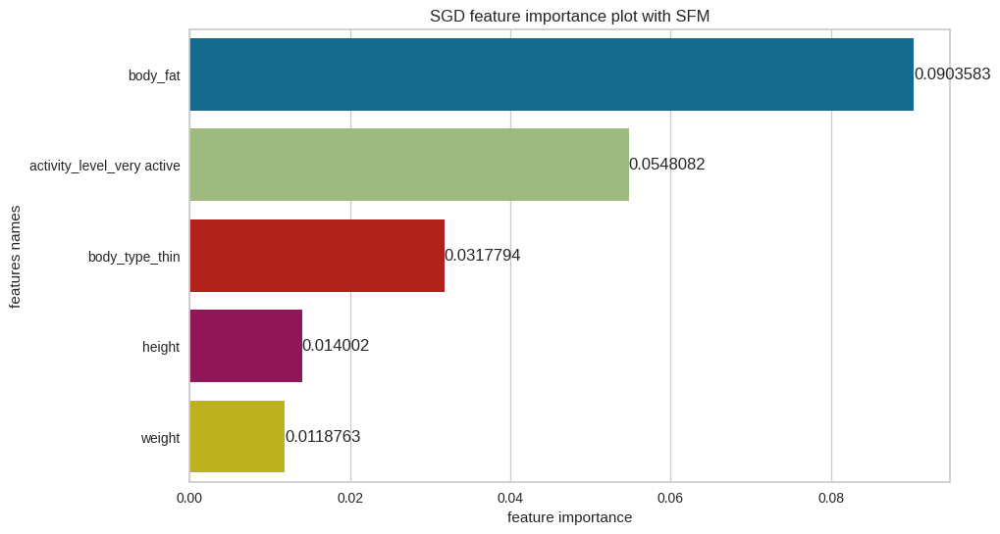

[SGD] Best parameters are {'alpha': 0.0002575, 'eta0': 0.0001, 'learning_rate': 'optimal', 'penalty': 'l2', 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Logistic Regression
[Logistic Regression] Features selected: Index(['height', 'weight', 'gender_male', 'newsletter_subscription_True',
       'activity_level_sedentary'],
      dtype='object')
[Logistic Regression] Features importances: [0.17300152 0.23585663 0.14428262 0.10724266 0.15733467]


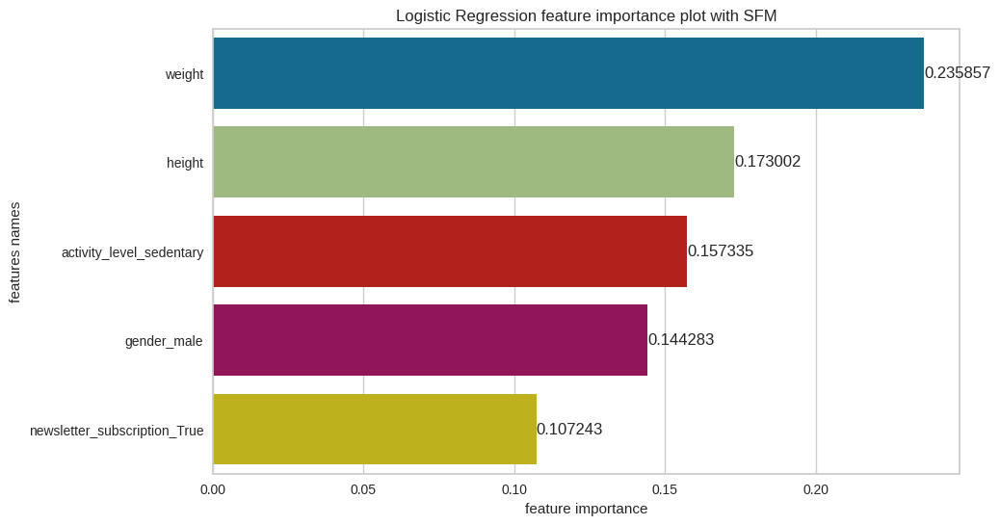

[Logistic Regression] Best parameters are {'C': 1, 'penalty': 'l1', 'random_state': 42, 'solver': 'liblinear'}
[INFO] Performing Grid-Search CV ---- Decision Tree
[Decision Tree] Features selected: Index(['height', 'weight', 'body_fat', 'body_type_thin',
       'newsletter_subscription_True'],
      dtype='object')
[Decision Tree] Features importances: [0.1630127379681578, 0.3032061022264746, 0.5337811598053676, 0.0, 0.0]


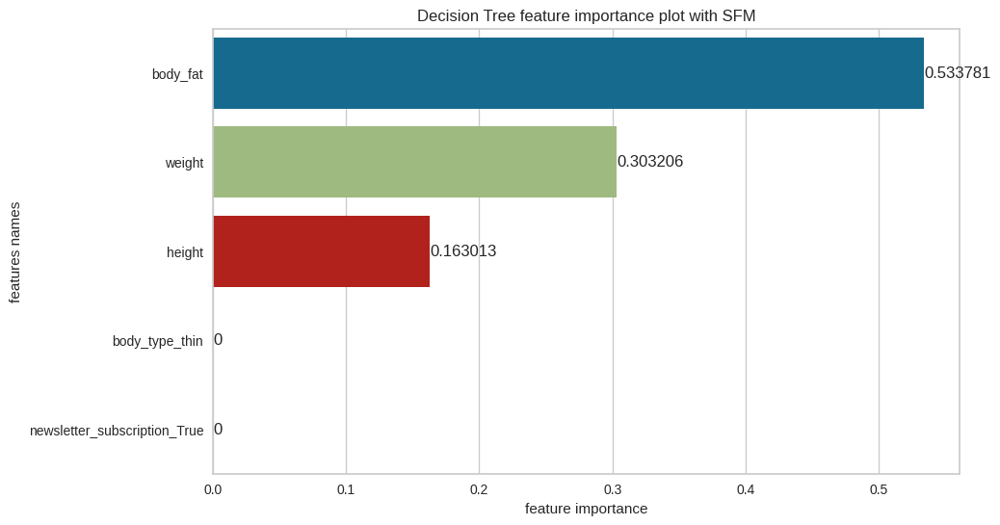

[Decision Tree] Best parameters are {'criterion': 'entropy', 'max_depth': 3, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Random Forest
[Random Forest] Features selected: Index(['height', 'weight', 'body_fat', 'body_type_thin',
       'newsletter_subscription_True'],
      dtype='object')
[Random Forest] Features importances: [0.3019786670158291, 0.23342392289772496, 0.3106560897726748, 0.024301865062403553, 0.12963945525136772]


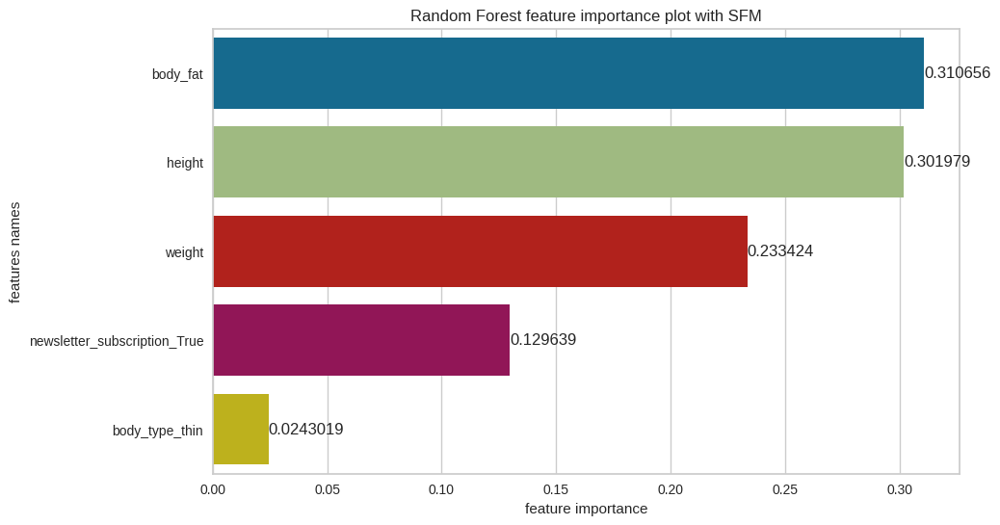

[Random Forest] Best parameters are {'criterion': 'gini', 'max_depth': 3, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- AdaBoost
[AdaBoost] Features selected: Index(['height', 'weight', 'body_fat', 'gender_male', 'body_type_thin',
       'newsletter_subscription_True', 'activity_level_sedentary',
       'activity_level_very active'],
      dtype='object')
[AdaBoost] Features importances: [0.0, 0.0, 0.15, 0.0, 0.0, 0.0, 0.85, 0.0]


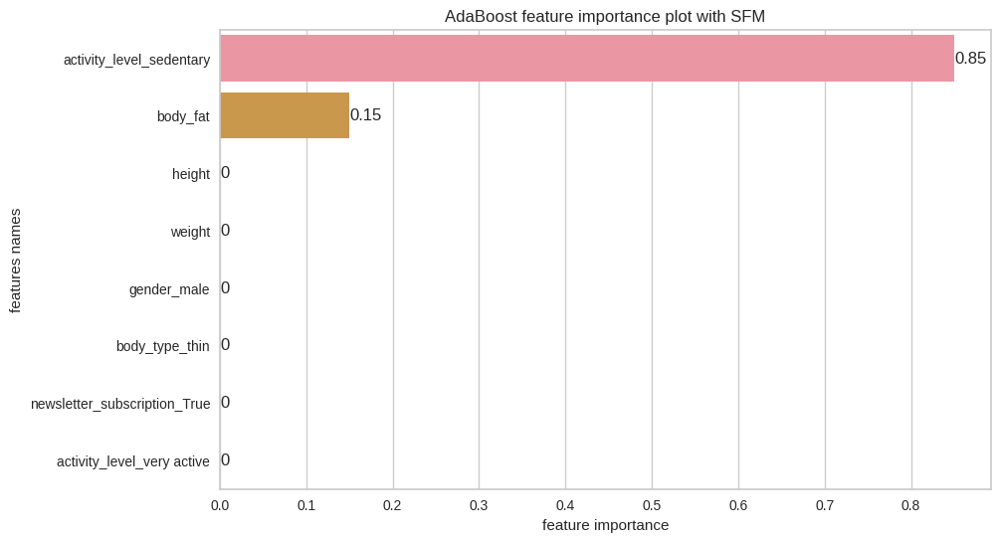

[AdaBoost] Best parameters are {'base_estimator': DecisionTreeClassifier(max_depth=1), 'learning_rate': 0.01, 'n_estimators': 20, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- GradientBoost
[GradientBoost] Features selected: Index(['height', 'weight', 'body_fat', 'newsletter_subscription_True',
       'activity_level_sedentary'],
      dtype='object')
[GradientBoost] Features importances: [0.45555698728847244, 0.0009106484017953745, 0.5435323643097322, 0.0, 0.0]


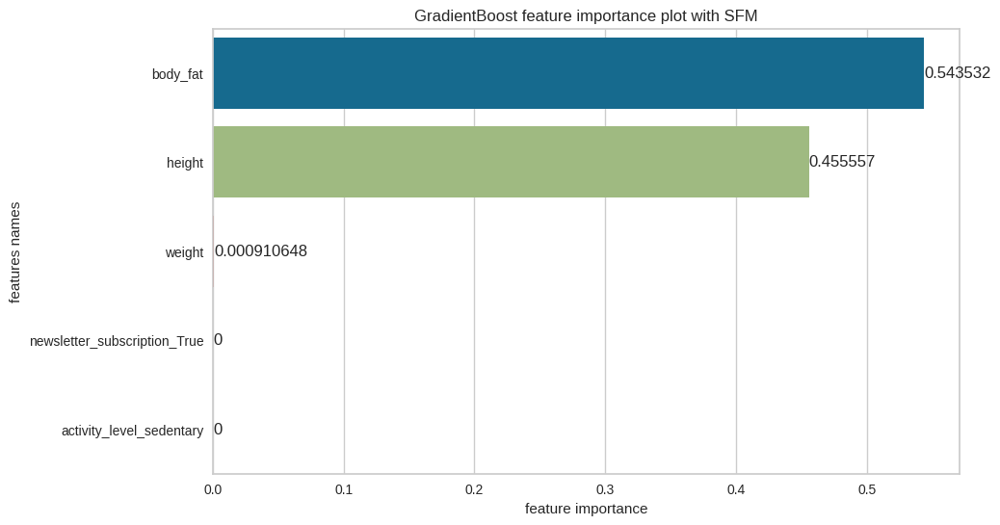

[GradientBoost] Best parameters are {'criterion': 'friedman_mse', 'learning_rate': 0.01, 'loss': 'deviance', 'max_depth': 3, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'n_estimators': 5, 'random_state': 42, 'subsample': 0.5}


In [101]:
estimators_multiclass_d_c_sel_sfm, X_test_d_c_sel_sfm, y_test_d_c_sel_sfm, X_train_d_c_sel_sfm, y_train_d_c_sel_sfm, X_test_inv_d_c_sel_sfm, features_d_c_sel_sfm = train(X_demo_adh, y_demo_adh, 
                                                         grid_params_multiclass, 
                                                         seed, feature_selection = True, 
                                                         feature_sel_type = 'SFM')

In [102]:
evaluation_table_d_c_sel_sfm = evaluate_multiclass(estimators_multiclass_d_c_sel_sfm, X_test_d_c_sel_sfm, y_test_d_c_sel_sfm, no_of_labels = 2, features_selected = True, features = features_d_c_sel_sfm, feature_sel_type = 'SFM')

In [103]:
evaluation_table_d_c_sel_sfm

,Overall Accuracy,Balanced Accuracy,Adj Balanced Accuracy,Precision,Recall,Cohen's kappa,Mathews Correlation Coefficient
SGD,0.84,0.50,0.00,0.00,0.00,0.00,0.00
Logistic Regression,0.84,0.50,0.00,0.00,0.00,0.00,0.00
Decision Tree,0.84,0.50,0.00,0.00,0.00,0.00,0.00
Random Forest,0.84,0.50,0.00,0.00,0.00,0.00,0.00
AdaBoost,0.84,0.50,0.00,0.00,0.00,0.00,0.00
GradientBoost,0.84,0.50,0.00,0.00,0.00,0.00,0.00


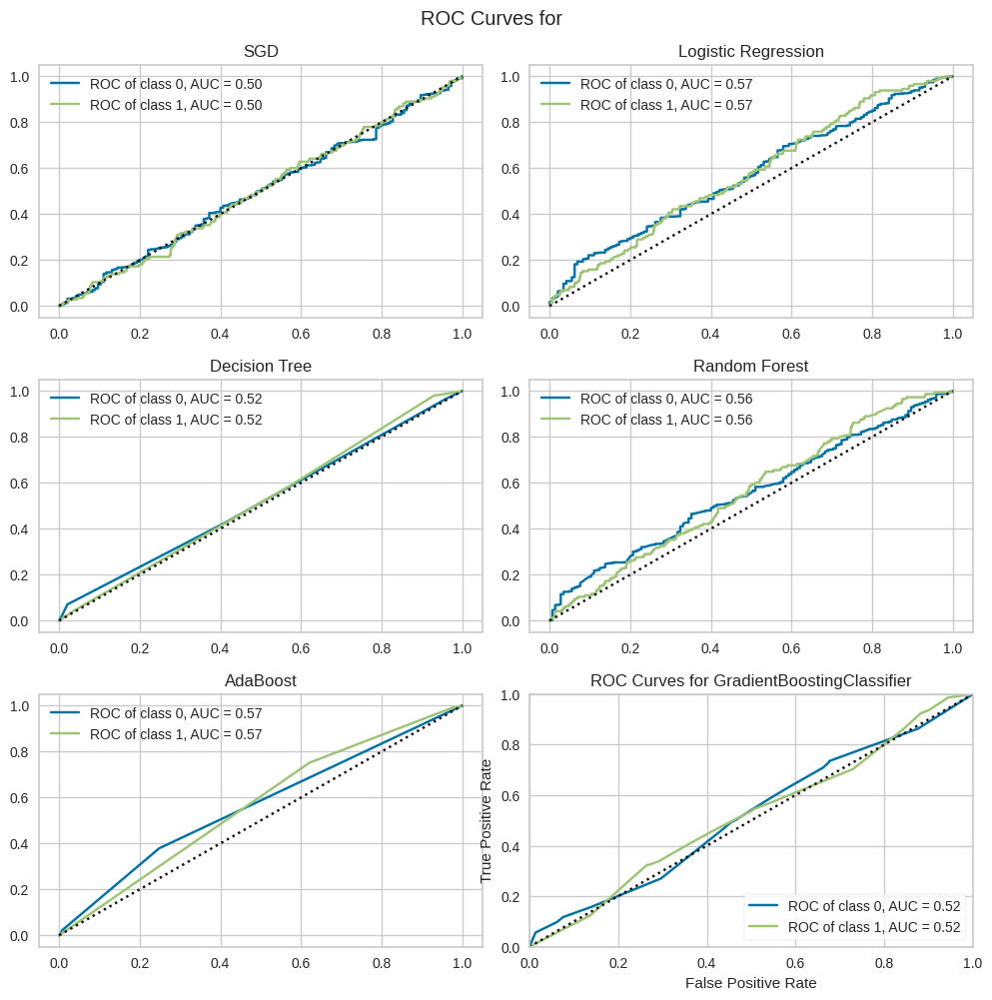

<AxesSubplot: title={'center': 'ROC Curves for GradientBoostingClassifier'}, xlabel='False Positive Rate', ylabel='True Positive Rate'>

In [104]:
ROC_curves(estimators_multiclass_d_c_sel_sfm, X_train_d_c_sel_sfm, y_train_d_c_sel_sfm, X_test_d_c_sel_sfm, y_test_d_c_sel_sfm, np.unique(y_demo_adh), name = 'all', features_selected = True, features = features_d_c_sel_sfm, feature_sel_type = 'SFM')

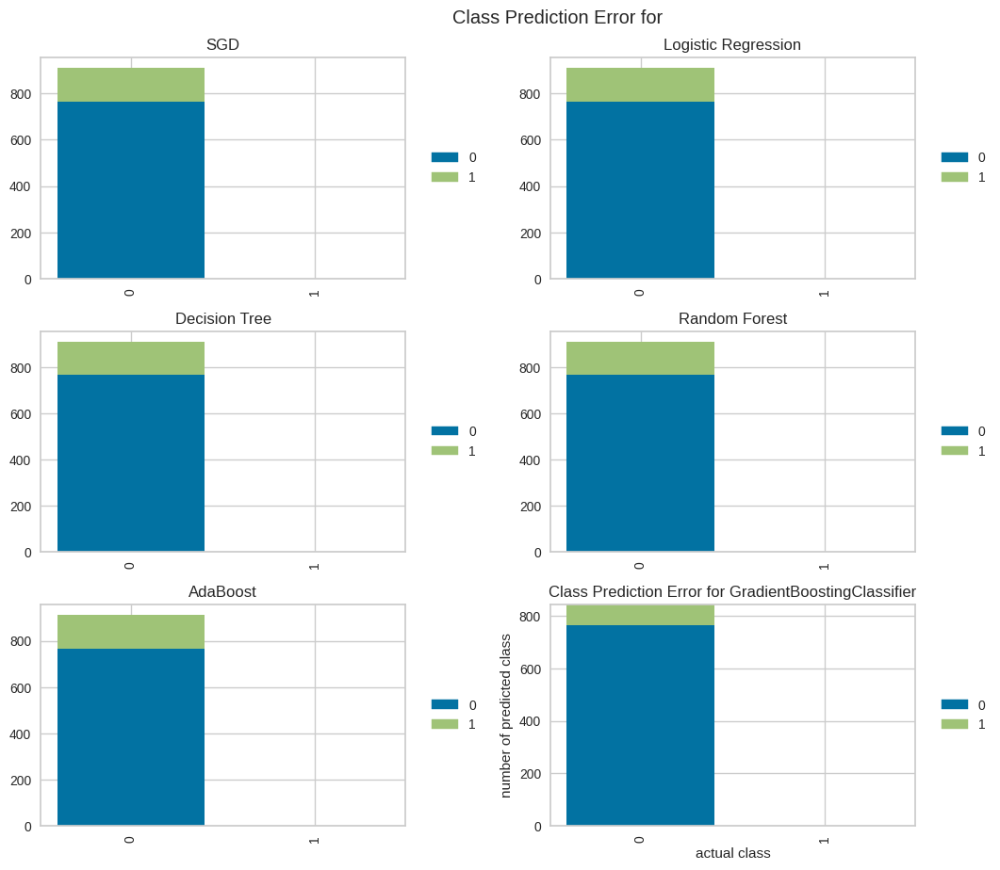

<AxesSubplot: title={'center': 'Class Prediction Error for GradientBoostingClassifier'}, xlabel='actual class', ylabel='number of predicted class'>

In [105]:
prediction_error_plot(estimators_multiclass_d_c_sel_sfm, X_train_d_c_sel_sfm, y_train_d_c_sel_sfm, X_test_d_c_sel_sfm, y_test_d_c_sel_sfm, np.unique(y_demo_adh), name = 'all', features_selected = True, features = features_d_c_sel_sfm, feature_sel_type = 'SFM')

### Fourth approach (first 4 weeks, 2 groups, demographics, goal achieved at least once)

This approach is very similar to the approach before. 

So, we take first 4 weeks of workouts and:
* Group 1 - user at least once achieved his/hers goal in this time (993 users),
* Group 0 - user didn't achieve even once his/her goal in this time (2041 users).

Variables taken into consideration are:

* gender,
* body_type,
* newsletter_subscription,
* height,
* weight,
* body_fat,
* activity_level.

In [106]:
# deleting label from data
X_demo_adh2 = df_users_demo_adh2.loc[:, df_users_demo_adh2.columns != 'Adh']

# variable only with label
y_demo_adh2 = df_users_demo_adh2['Adh'].to_numpy()


for col in ['gender', 'body_type', 'newsletter_subscription', 'activity_level']:
    X_demo_adh2[col] = LabelEncoder().fit_transform(X_demo_adh2[col])

y_demo_ad2 = pd.DataFrame(y_demo_adh2, columns = ['Adherence group'])

[INFO] Performing Grid-Search CV ---- SGD
[SGD] Features importances: [0.00062762 0.0004544  0.00023332 0.00131199 0.00074383 0.00103647
 0.00127943]


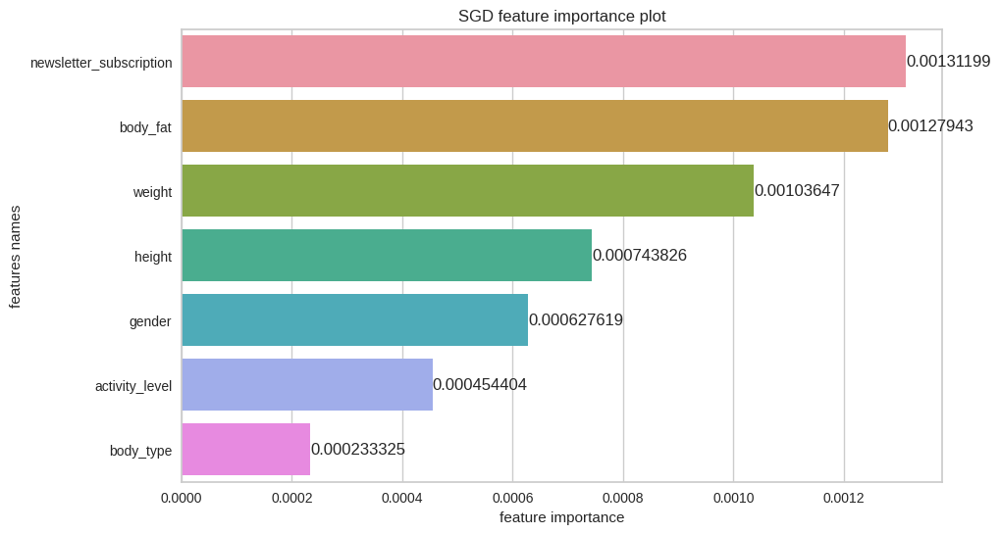

[SGD] Best parameters are {'alpha': 1e-05, 'eta0': 0.0001, 'learning_rate': 'invscaling', 'penalty': 'l1', 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Logistic Regression
[Logistic Regression] Features importances: [0.08407136 0.02087195 0.02242863 0.10418107 0.17700347 0.23447152
 0.01056197]


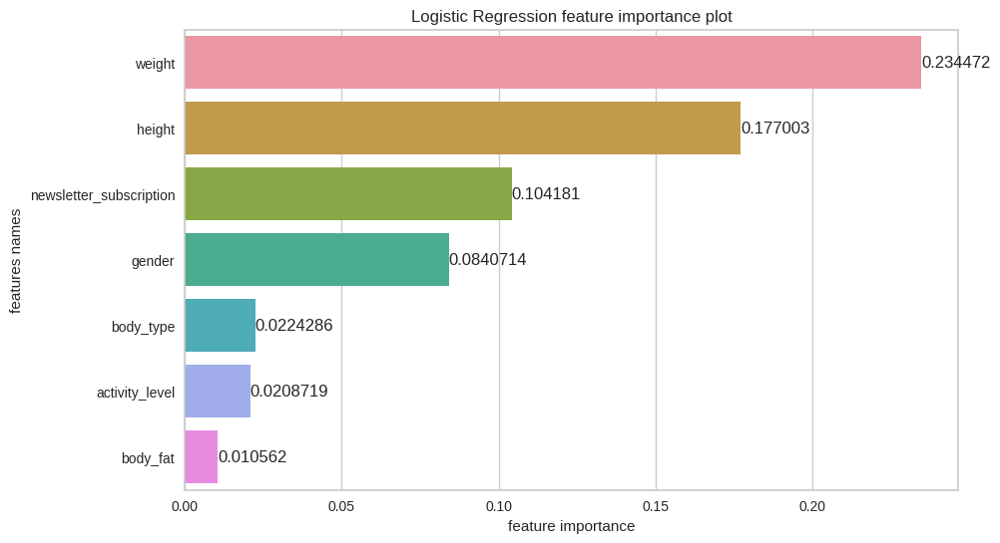

[Logistic Regression] Best parameters are {'C': 1, 'penalty': 'l1', 'random_state': 42, 'solver': 'liblinear'}
[INFO] Performing Grid-Search CV ---- Decision Tree
[Decision Tree] Features importances: [0.0, 0.0, 0.0, 0.15467746761438703, 0.273002234490055, 0.38287917802774596, 0.18944111986781198]


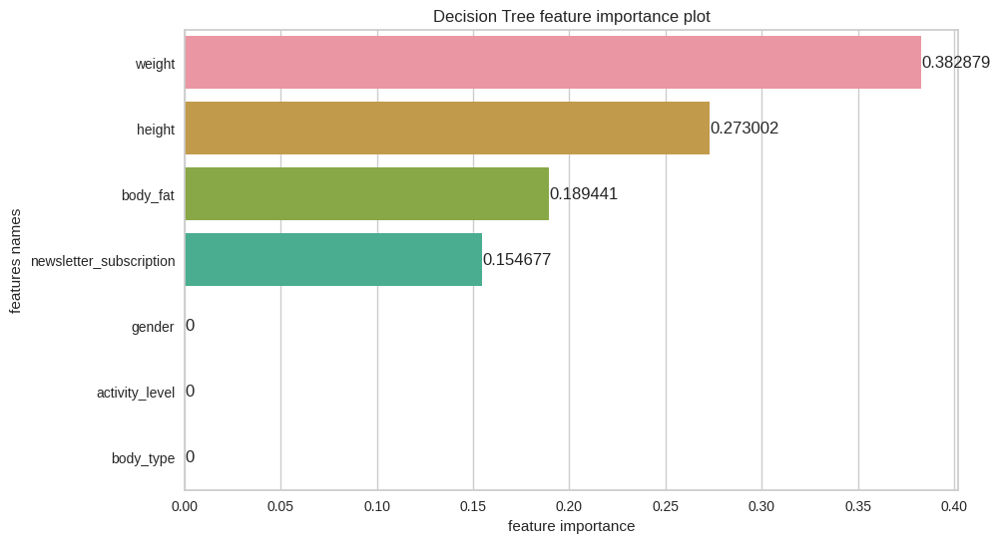

[Decision Tree] Best parameters are {'criterion': 'entropy', 'max_depth': 3, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Random Forest
[Random Forest] Features importances: [0.10800890021823138, 0.07944502544487664, 0.0514288788233194, 0.09857011624536616, 0.1843952249606333, 0.21774662694578586, 0.2604052273617872]


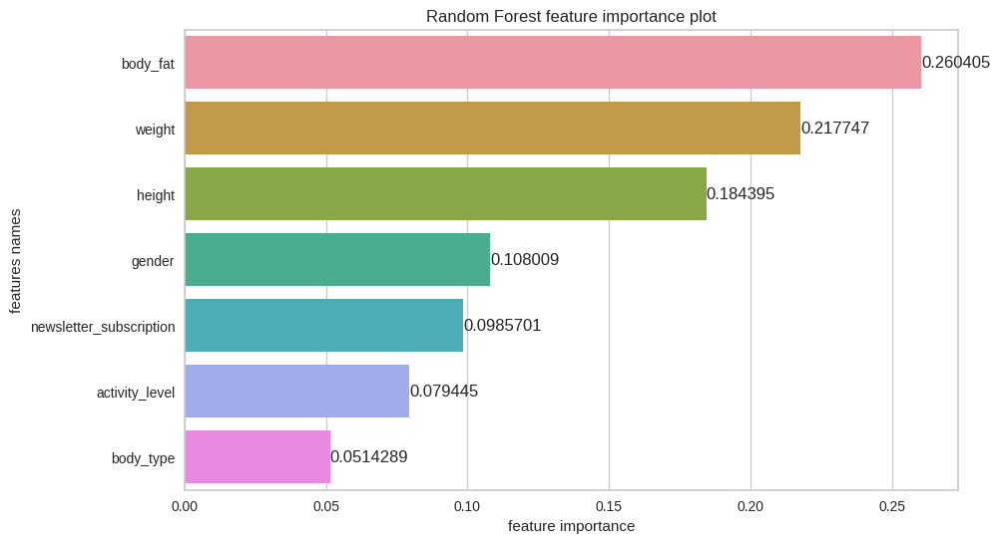

[Random Forest] Best parameters are {'criterion': 'gini', 'max_depth': 3, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- AdaBoost
[AdaBoost] Features importances: [0.08117664024134393, 0.015965754904551054, 0.0, 0.2171815581075312, 0.22870037979857166, 0.1046548169716206, 0.3523208499763814]


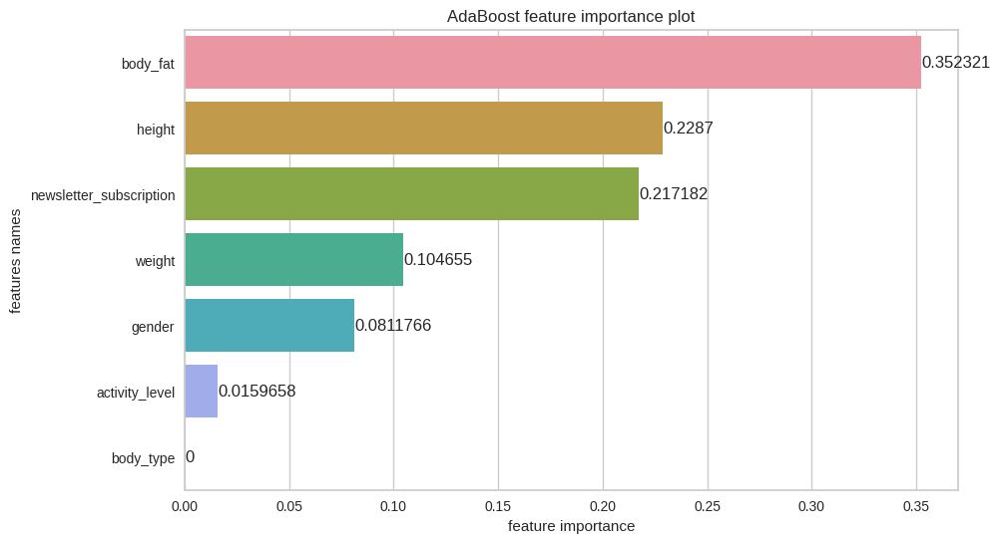

[AdaBoost] Best parameters are {'base_estimator': DecisionTreeClassifier(max_depth=2), 'learning_rate': 0.01, 'n_estimators': 60, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- GradientBoost
[GradientBoost] Features importances: [0.026842050102909187, 0.02670703880647021, 0.05506517793206313, 0.14690916687151656, 0.22494645326534818, 0.15604917815332095, 0.36348093486837174]


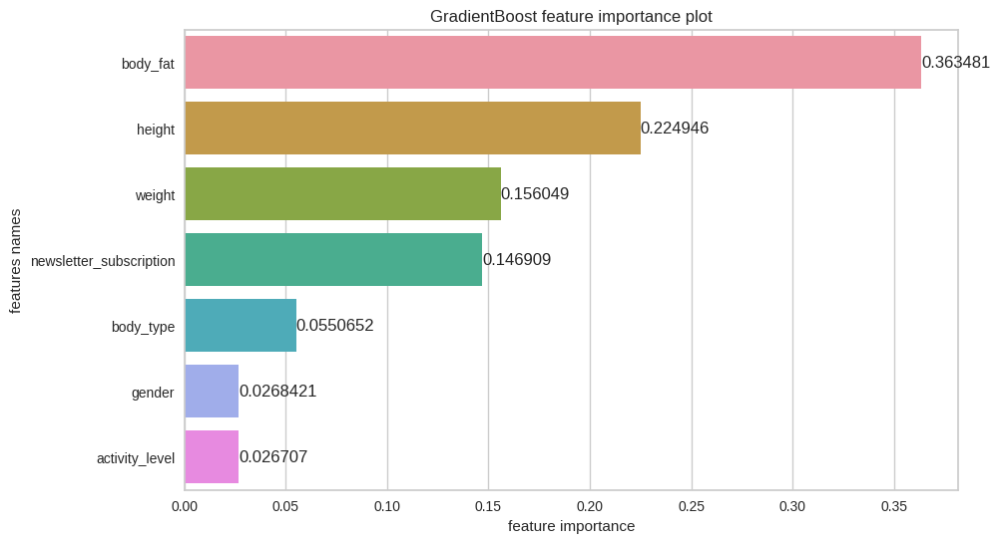

[GradientBoost] Best parameters are {'criterion': 'friedman_mse', 'learning_rate': 0.01, 'loss': 'deviance', 'max_depth': 3, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'n_estimators': 5, 'random_state': 42, 'subsample': 0.5}


In [107]:
estimators_multiclass_d_c2, X_test_d_c2, y_test_d_c2, X_train_d_c2, y_train_d_c2, X_test_inv_d_c2, features_d_c2 = train(X_demo_adh2, y_demo_adh2, 
                                                         grid_params_multiclass, 
                                                         seed)

evaluation_table_d_c2 = evaluate_multiclass(estimators_multiclass_d_c2, X_test_d_c2, y_test_d_c2, no_of_labels = 2, features_selected = False, features = features_d_c2)


In [108]:
evaluation_table_d_c2

,Overall Accuracy,Balanced Accuracy,Adj Balanced Accuracy,Precision,Recall,Cohen's kappa,Mathews Correlation Coefficient
SGD,0.67,0.50,0.00,0.00,0.00,0.00,0.00
Logistic Regression,0.67,0.50,0.00,0.00,0.00,0.00,0.00
Decision Tree,0.67,0.50,0.00,0.00,0.00,0.00,0.00
Random Forest,0.67,0.50,0.00,0.00,0.00,0.00,0.00
AdaBoost,0.67,0.50,-0.00,0.00,0.00,-0.00,-0.02
GradientBoost,0.67,0.50,0.00,0.00,0.00,0.00,0.00


The results are terrible, but from all of the classifiers, the best one is decision tree with depth equal to 3 and entropy criterion. The precision is 50%, overall accuracy is 67% and MCC is 0.02,which is very low. Also all of the ROC and AUC values are pretty low (they show kind of randomness).

In [109]:
prediction_for_one_user(estimators_multiclass_d_c2, X_test_d_c2, y_test_d_c2, X_test_inv_d_c2, X_demo_adh2.columns, y_demo_ad2.columns, name = 'SGD')


,gender,activity_level,body_type,newsletter_subscription,height,weight,body_fat,Adherence group,Adherence group_prediction
704,1.00,0.00,0.00,1.00,168.00,72.50,30.00,0,0


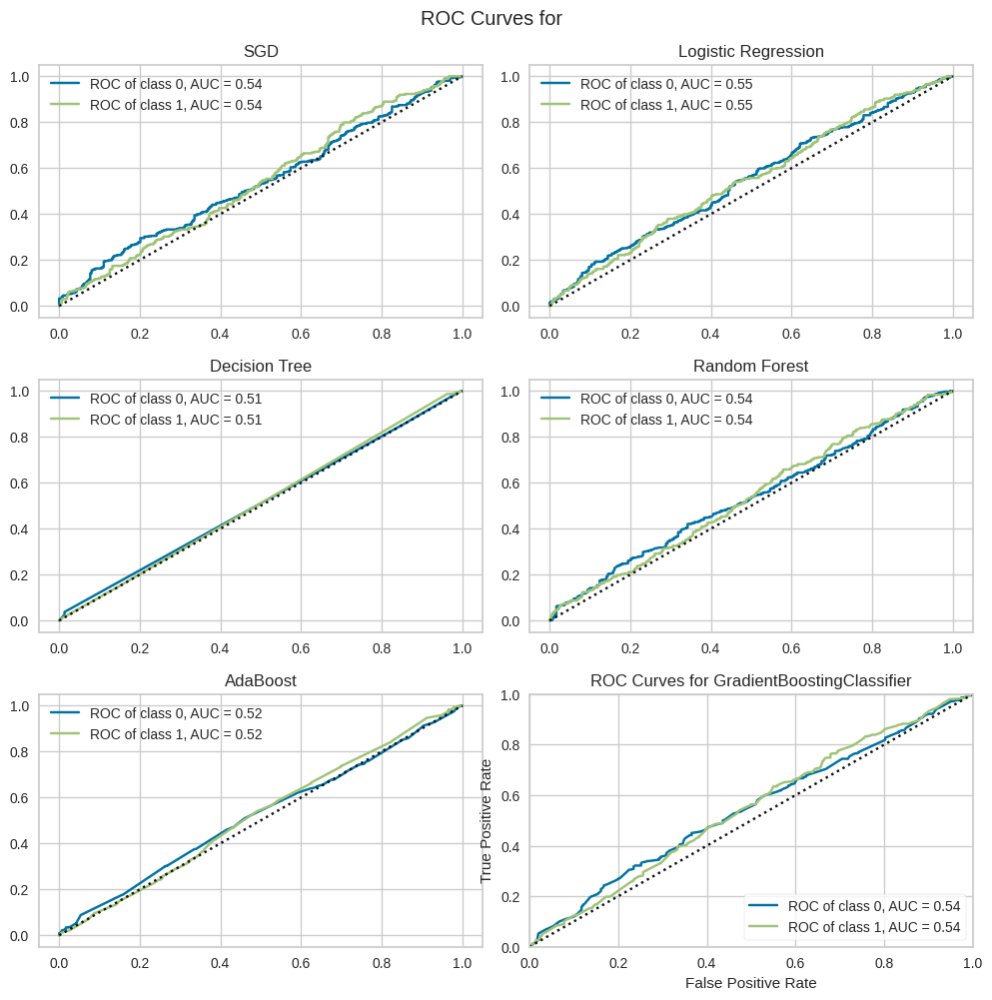

<AxesSubplot: title={'center': 'ROC Curves for GradientBoostingClassifier'}, xlabel='False Positive Rate', ylabel='True Positive Rate'>

In [110]:
ROC_curves(estimators_multiclass_d_c2, X_train_d_c2, y_train_d_c2, X_test_d_c2, y_test_d_c2, np.unique(y_demo_adh2), name = 'all', features_selected = False, features = features_d_c2)


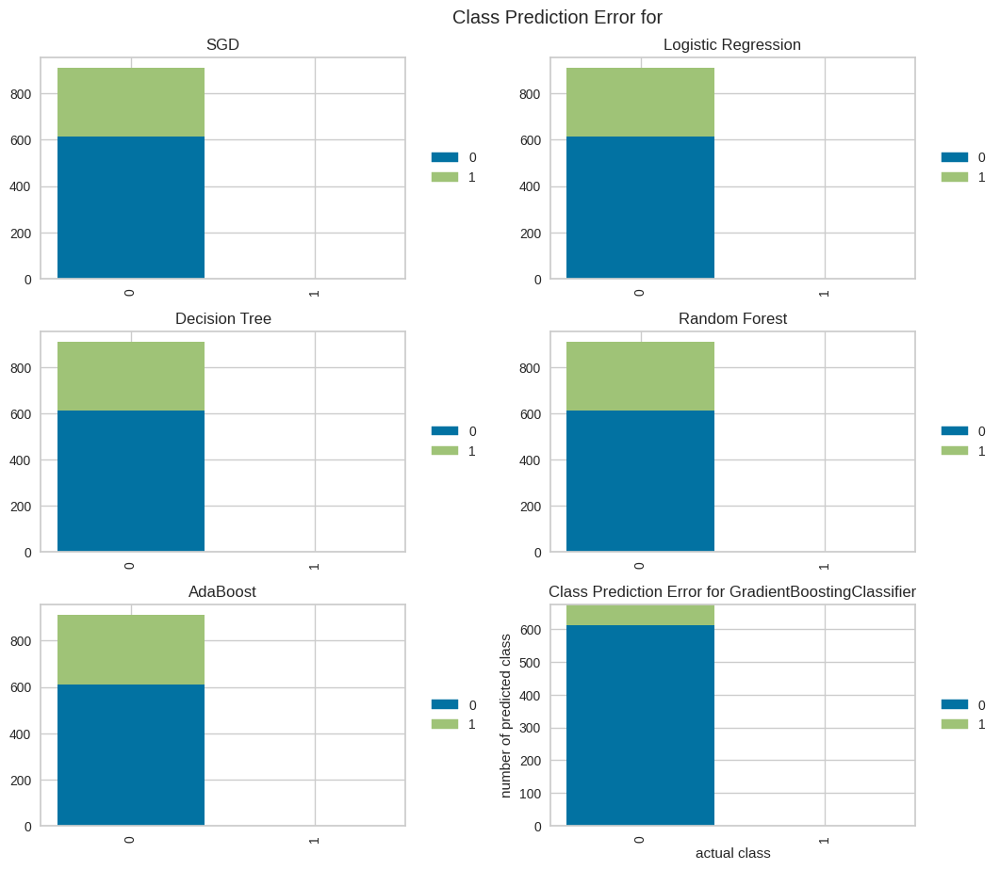

<AxesSubplot: title={'center': 'Class Prediction Error for GradientBoostingClassifier'}, xlabel='actual class', ylabel='number of predicted class'>

In [111]:
prediction_error_plot(estimators_multiclass_d_c2, X_train_d_c2, y_train_d_c2, X_test_d_c2, y_test_d_c2, np.unique(y_demo_adh2), name = 'all', features_selected = False, features = features_d_c2)


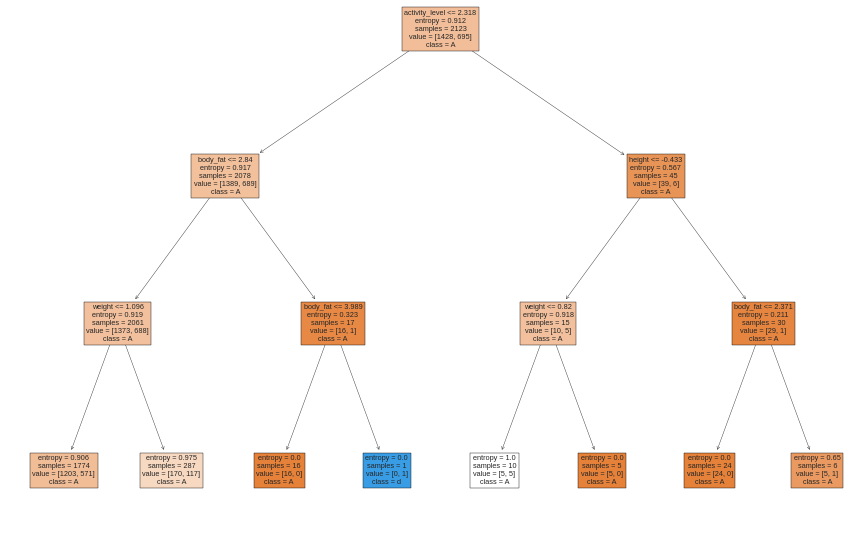

In [112]:
decision_tree(estimators_multiclass_d_c2, df_users_only[['gender', 'body_type', 'newsletter_subscription', 
                                             'height', 'weight', 'body_fat', 'activity_level']],
             pd.DataFrame(y_demo_adh2, columns = ['Adh'])['Adh'])

#### With feature selection (Univariate - Kruskall - Wallis test (instead of ANOVA) and chi-square)

[INFO] Performing Grid-Search CV ---- SGD
[SGD] Features selected: Index(['body_fat'], dtype='object')
[SGD] Features importances: [0.00169748]


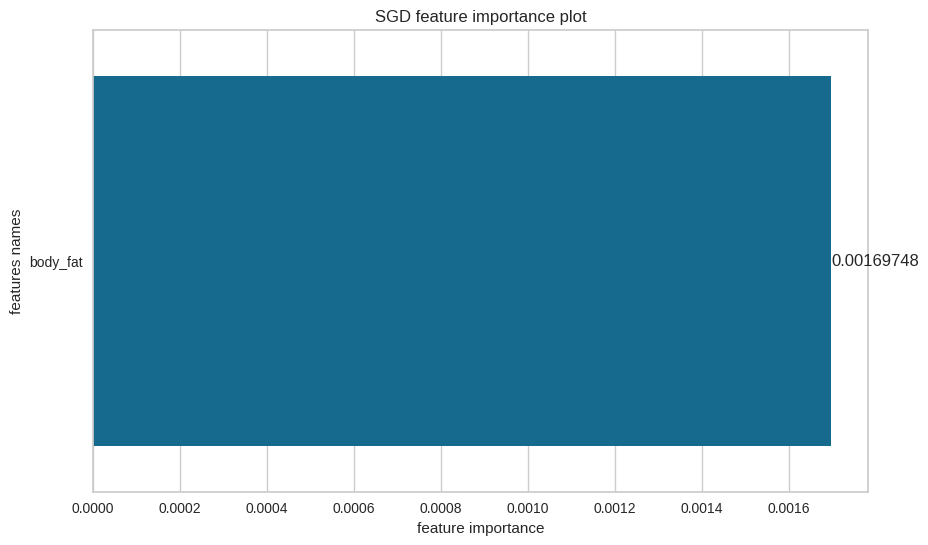

[SGD] Best parameters are {'alpha': 1e-05, 'eta0': 0.0001, 'learning_rate': 'invscaling', 'penalty': 'l1', 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Logistic Regression
[Logistic Regression] Features selected: Index(['body_fat'], dtype='object')
[Logistic Regression] Features importances: [0.22759198]


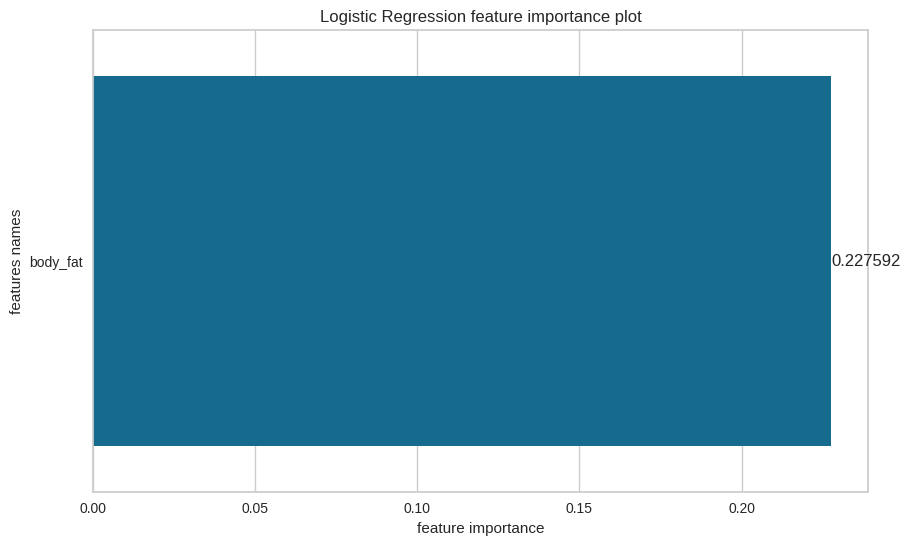

[Logistic Regression] Best parameters are {'C': 1, 'penalty': 'l1', 'random_state': 42, 'solver': 'liblinear'}
[INFO] Performing Grid-Search CV ---- Decision Tree
[Decision Tree] Features selected: Index(['body_fat'], dtype='object')
[Decision Tree] Features importances: [1.0]


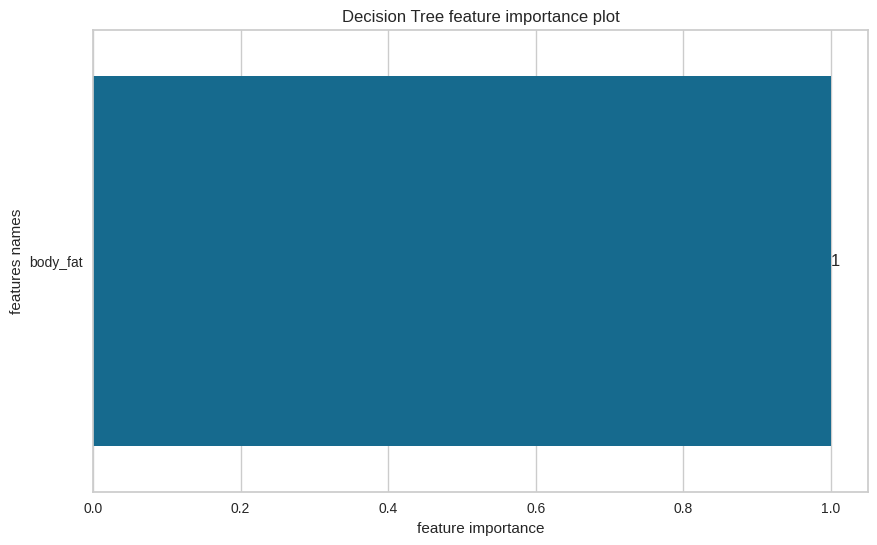

[Decision Tree] Best parameters are {'criterion': 'gini', 'max_depth': 3, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Random Forest
[Random Forest] Features selected: Index(['body_fat'], dtype='object')
[Random Forest] Features importances: [1.0]


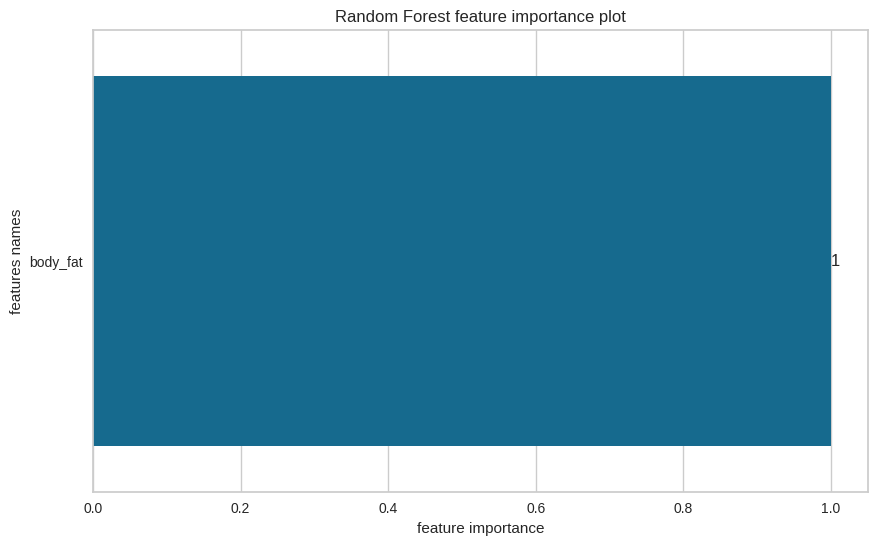

[Random Forest] Best parameters are {'criterion': 'gini', 'max_depth': 3, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- AdaBoost
[AdaBoost] Features selected: Index(['body_fat'], dtype='object')
[AdaBoost] Features importances: [1.0]


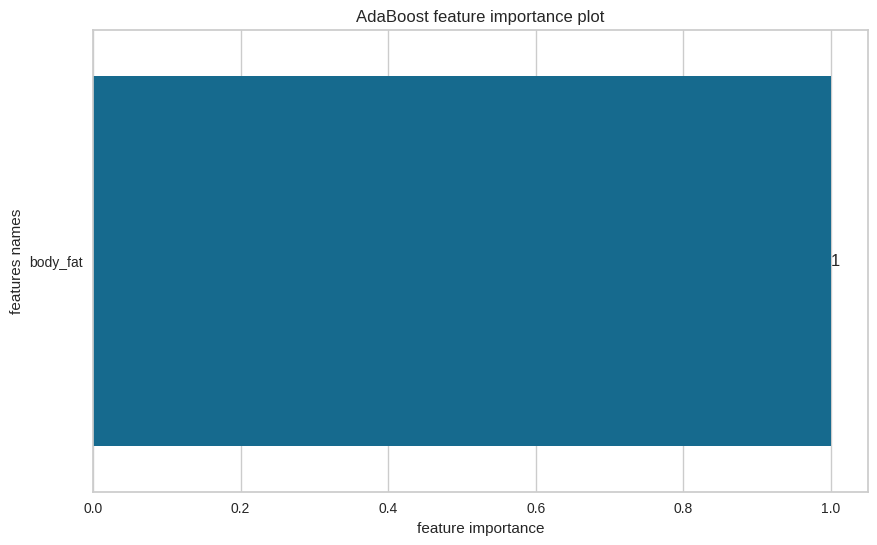

[AdaBoost] Best parameters are {'base_estimator': DecisionTreeClassifier(max_depth=3), 'learning_rate': 0.05, 'n_estimators': 40, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- GradientBoost
[GradientBoost] Features selected: Index(['body_fat'], dtype='object')
[GradientBoost] Features importances: [1.0]


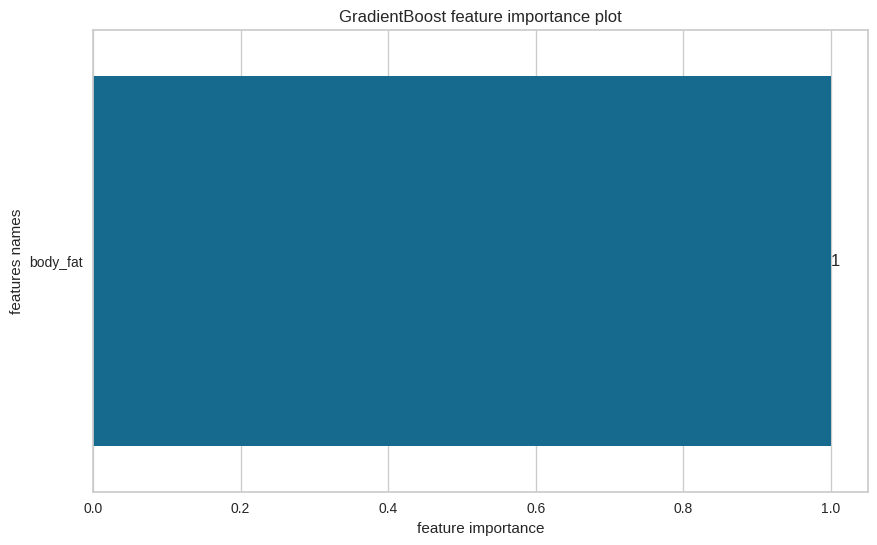

[GradientBoost] Best parameters are {'criterion': 'friedman_mse', 'learning_rate': 0.01, 'loss': 'deviance', 'max_depth': 3, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'n_estimators': 5, 'random_state': 42, 'subsample': 0.5}


In [113]:
estimators_multiclass_d_c2_sel_u, X_test_d_c2_sel_u, y_test_d_c2_sel_u, X_train_d_c2_sel_u, y_train_d_c2_sel_u, X_test_inv_d_c2_sel_u, features_d_c2_sel_u = train(X_demo_adh, y_demo_adh, 
                                                         grid_params_multiclass, 
                                                         seed, feature_selection = True, 
                                                         feature_sel_type = 'UNI')

In [114]:
evaluation_table_d_c2_sel_u = evaluate_multiclass(estimators_multiclass_d_c2_sel_u, X_test_d_c2_sel_u, y_test_d_c2_sel_u, no_of_labels = 3, features_selected = True, features = features_d_c2_sel_u, feature_sel_type = 'UNI')

In [115]:
evaluation_table_d_c2_sel_u

,Overall Accuracy,Balanced Accuracy,Adj Balanced Accuracy,Precision micro,Precision macro,Precision weighted,Recall micro,Recall macro,Recall weighted,Cohen's kappa,Mathews Correlation Coefficient
SGD,0.84,0.50,0.00,0.84,0.42,0.71,0.84,0.50,0.84,0.00,0.00
Logistic Regression,0.84,0.50,0.00,0.84,0.42,0.71,0.84,0.50,0.84,0.00,0.00
Decision Tree,0.84,0.50,0.00,0.84,0.42,0.71,0.84,0.50,0.84,0.00,0.00
Random Forest,0.84,0.50,0.00,0.84,0.42,0.71,0.84,0.50,0.84,0.00,0.00
AdaBoost,0.84,0.50,-0.00,0.84,0.42,0.71,0.84,0.50,0.84,-0.00,-0.01
GradientBoost,0.84,0.50,0.00,0.84,0.42,0.71,0.84,0.50,0.84,0.00,0.00


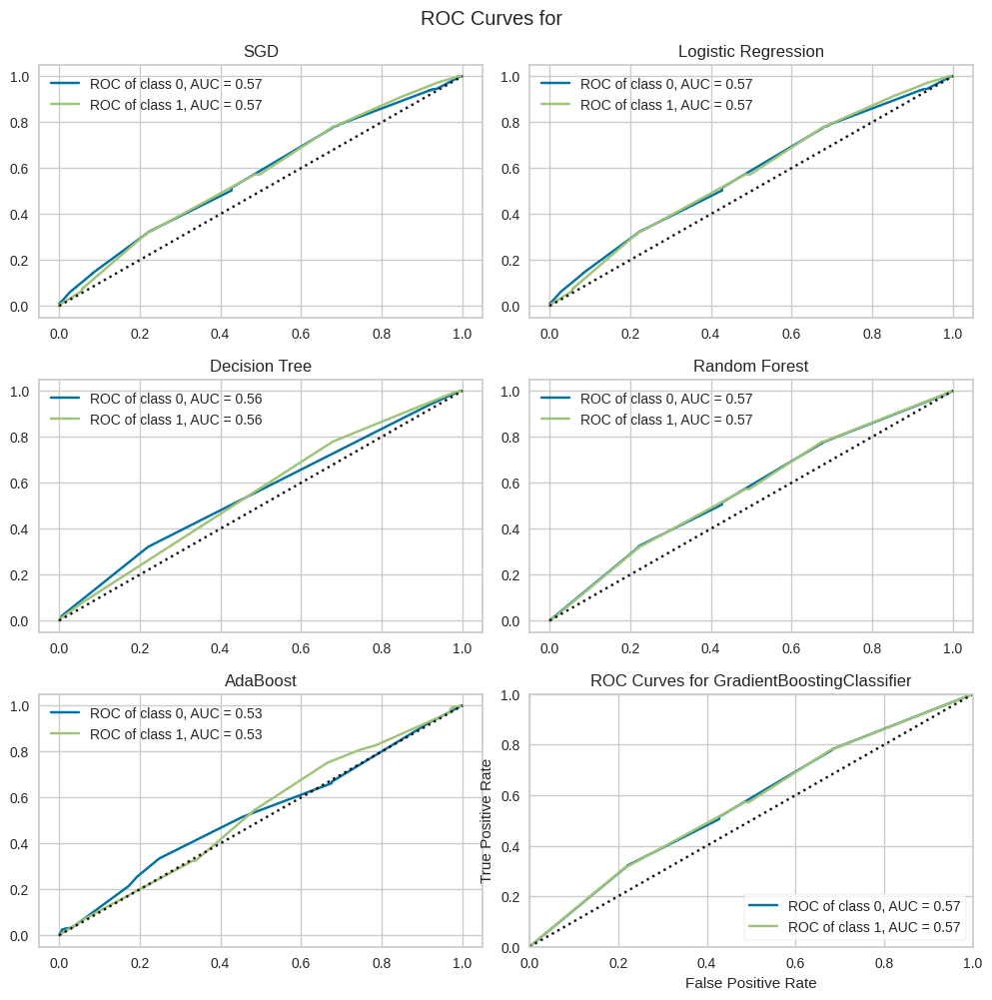

<AxesSubplot: title={'center': 'ROC Curves for GradientBoostingClassifier'}, xlabel='False Positive Rate', ylabel='True Positive Rate'>

In [116]:
ROC_curves(estimators_multiclass_d_c2_sel_u, X_train_d_c2_sel_u, y_train_d_c2_sel_u, X_test_d_c2_sel_u, y_test_d_c2_sel_u, np.unique(y_demo_adh), name = 'all', features_selected = True, features = features_d_c2_sel_u, feature_sel_type = 'UNI')

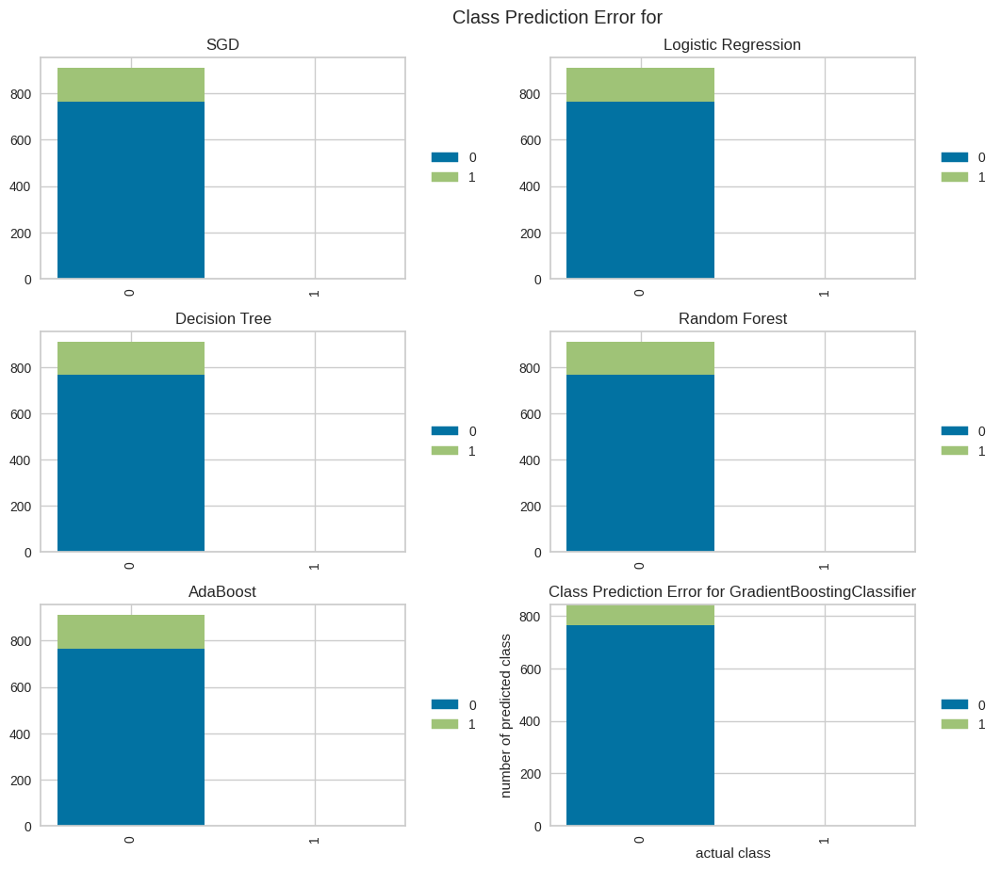

<AxesSubplot: title={'center': 'Class Prediction Error for GradientBoostingClassifier'}, xlabel='actual class', ylabel='number of predicted class'>

In [117]:
prediction_error_plot(estimators_multiclass_d_c2_sel_u, X_train_d_c2_sel_u, y_train_d_c2_sel_u, X_test_d_c2_sel_u, y_test_d_c2_sel_u, np.unique(y_demo_adh), name = 'all', features_selected = True, features = features_d_c2_sel_u, feature_sel_type = 'UNI')

#### With feature selection (by SequentialFeatureSelector)

In [118]:
estimators_multiclass_d_c2_sel_sfs, X_test_d_c2_sel_sfs, y_test_d_c2_sel_sfs, X_train_d_c2_sel_sfs, y_train_d_c2_sel_sfs, X_test_inv_d_c2_sel_sfs, features_d_c2_sel_sfs = train(X_demo_adh, y_demo_adh, 
                                                         grid_params_multiclass, 
                                                         seed, feature_selection = True, 
                                                         feature_sel_type = 'SFS')

[INFO] Performing Grid-Search CV ---- SGD
[SGD] Features selected: Index(['height', 'weight', 'body_fat', 'gender_male', 'body_type_strong',
       'body_type_thin', 'activity_level_sedentary',
       'activity_level_very active'],
      dtype='object')
[SGD] Best parameters are {'alpha': 1e-05, 'eta0': 0.0001, 'learning_rate': 'invscaling', 'penalty': 'l1', 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Logistic Regression
[Logistic Regression] Features selected: Index(['height'], dtype='object')
[Logistic Regression] Best parameters are {'C': 1, 'penalty': 'l1', 'random_state': 42, 'solver': 'liblinear'}
[INFO] Performing Grid-Search CV ---- Decision Tree
[Decision Tree] Features selected: Index(['gender_male'], dtype='object')
[Decision Tree] Best parameters are {'criterion': 'gini', 'max_depth': 3, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Random Forest
[Random Forest] Features selected: Index(['gender_male'], dtype='object')
[Random Forest] Best paramete

In [119]:
evaluation_table_d_c2_sel_sfs = evaluate_multiclass(estimators_multiclass_d_c2_sel_sfs, X_test_d_c2_sel_sfs, y_test_d_c2_sel_sfs, no_of_labels = 3, features_selected = True, features = features_d_c2_sel_sfs, feature_sel_type = 'SFS')


In [120]:
evaluation_table_d_c2_sel_sfs

,Overall Accuracy,Balanced Accuracy,Adj Balanced Accuracy,Precision micro,Precision macro,Precision weighted,Recall micro,Recall macro,Recall weighted,Cohen's kappa,Mathews Correlation Coefficient
SGD,0.84,0.50,0.00,0.84,0.42,0.71,0.84,0.50,0.84,0.00,0.00
Logistic Regression,0.84,0.50,0.00,0.84,0.42,0.71,0.84,0.50,0.84,0.00,0.00
Decision Tree,0.84,0.50,0.00,0.84,0.42,0.71,0.84,0.50,0.84,0.00,0.00
Random Forest,0.84,0.50,0.00,0.84,0.42,0.71,0.84,0.50,0.84,0.00,0.00
AdaBoost,0.84,0.50,0.00,0.84,0.42,0.71,0.84,0.50,0.84,0.00,0.00
GradientBoost,0.84,0.50,0.00,0.84,0.42,0.71,0.84,0.50,0.84,0.00,0.00


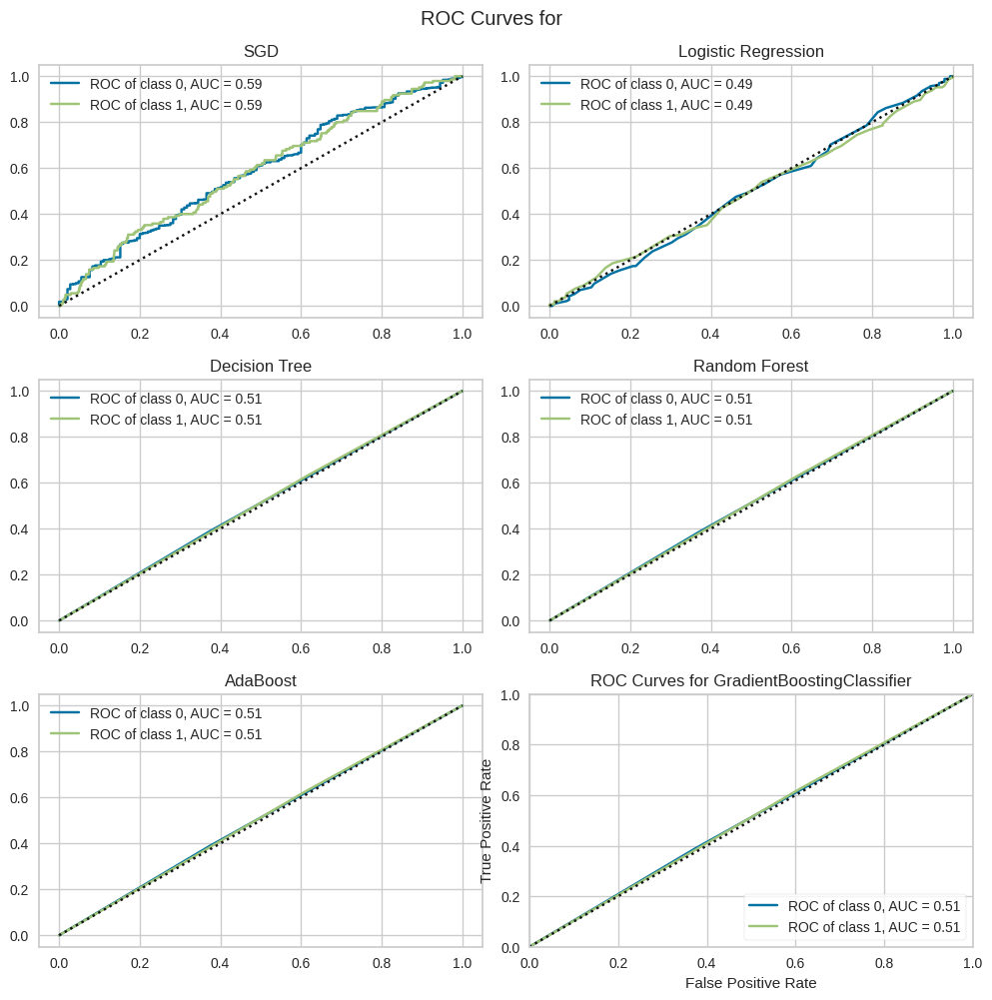

<AxesSubplot: title={'center': 'ROC Curves for GradientBoostingClassifier'}, xlabel='False Positive Rate', ylabel='True Positive Rate'>

In [121]:
ROC_curves(estimators_multiclass_d_c2_sel_sfs, X_train_d_c2_sel_sfs, y_train_d_c2_sel_sfs, X_test_d_c2_sel_sfs, y_test_d_c2_sel_sfs, np.unique(y_demo_adh), name = 'all', features_selected = True, features = features_d_c2_sel_sfs, feature_sel_type = 'SFS')


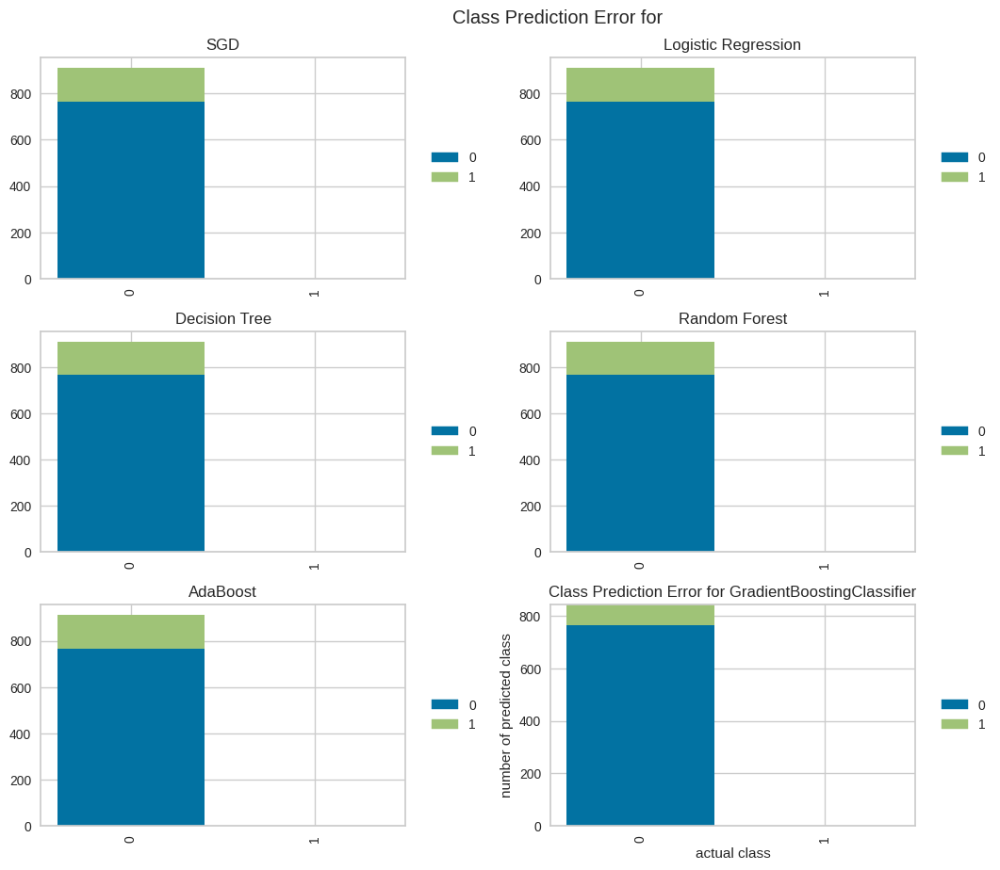

<AxesSubplot: title={'center': 'Class Prediction Error for GradientBoostingClassifier'}, xlabel='actual class', ylabel='number of predicted class'>

In [122]:
prediction_error_plot(estimators_multiclass_d_c2_sel_sfs, X_train_d_c2_sel_sfs, y_train_d_c2_sel_sfs, X_test_d_c2_sel_sfs, y_test_d_c2_sel_sfs, np.unique(y_demo_adh), name = 'all', features_selected = True, features = features_d_c2_sel_sfs, feature_sel_type = 'SFS')


#### With feature selection (by Recursive feature elimination with cross-validation - RFECV)

[INFO] Performing Grid-Search CV ---- SGD
[SGD] Features selected: Index(['height'], dtype='object')
[SGD] Features importances: [0.]


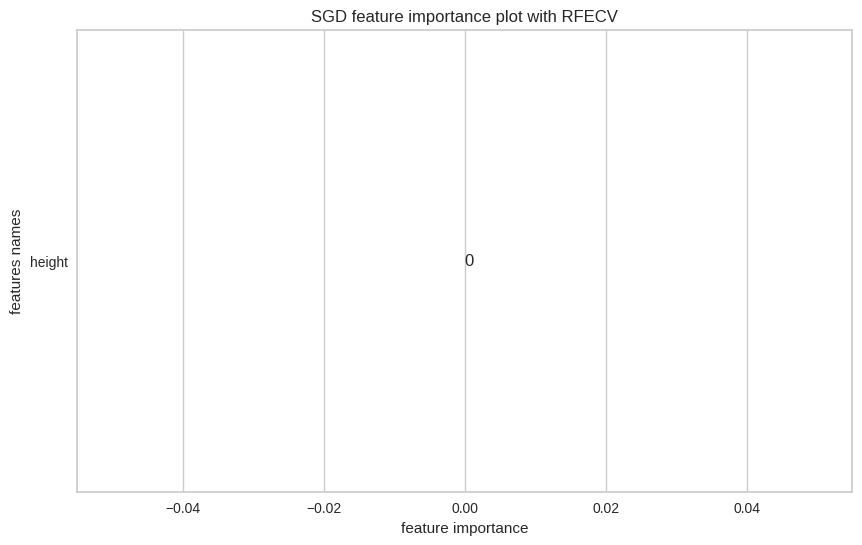

[SGD] Best parameters are {'alpha': 1e-05, 'eta0': 0.0001, 'learning_rate': 'optimal', 'penalty': 'l1', 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Logistic Regression
[Logistic Regression] Features selected: Index(['height'], dtype='object')
[Logistic Regression] Features importances: [0.1403439]


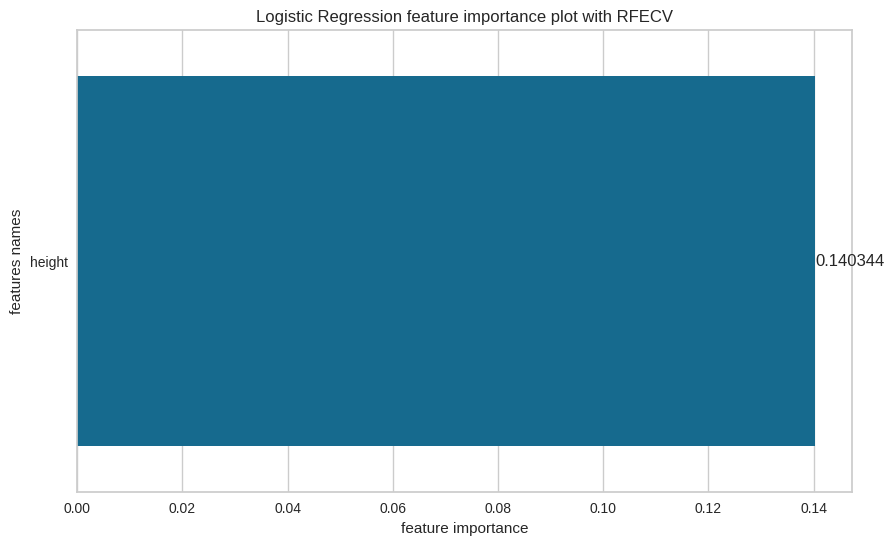

[Logistic Regression] Best parameters are {'C': 1, 'penalty': 'l1', 'random_state': 42, 'solver': 'liblinear'}
[INFO] Performing Grid-Search CV ---- Decision Tree
[Decision Tree] Features selected: Index(['weight'], dtype='object')
[Decision Tree] Features importances: [1.0]


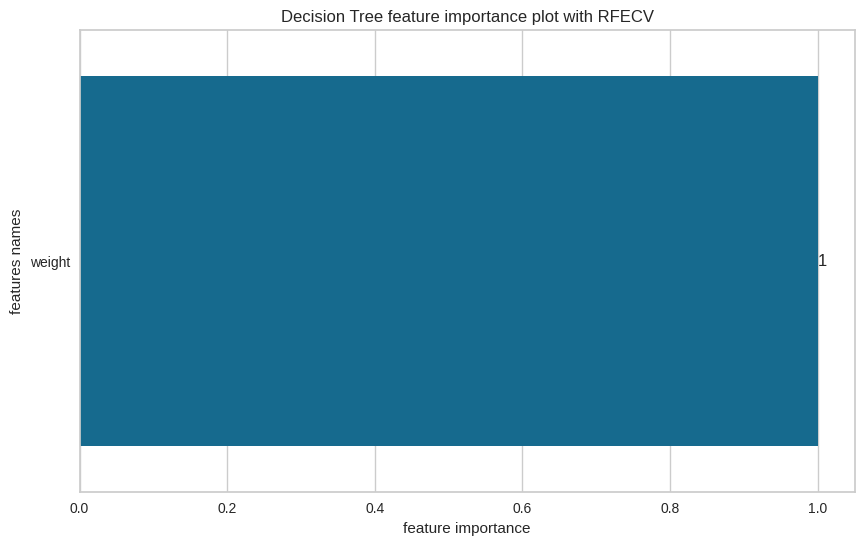

[Decision Tree] Best parameters are {'criterion': 'gini', 'max_depth': 3, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Random Forest
[Random Forest] Features selected: Index(['weight'], dtype='object')
[Random Forest] Features importances: [1.0]


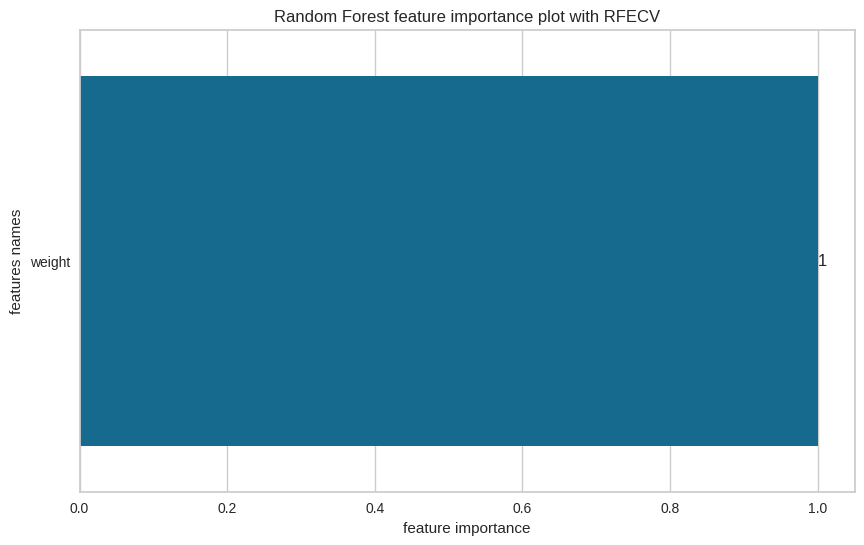

[Random Forest] Best parameters are {'criterion': 'gini', 'max_depth': 3, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- AdaBoost
[AdaBoost] Features selected: Index(['weight'], dtype='object')
[AdaBoost] Features importances: [1.0]


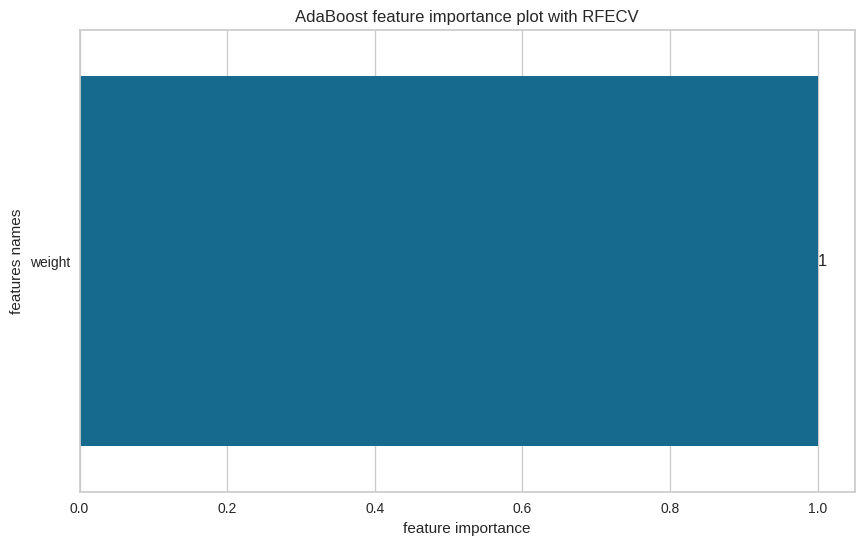

[AdaBoost] Best parameters are {'base_estimator': DecisionTreeClassifier(max_depth=1), 'learning_rate': 0.01, 'n_estimators': 20, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- GradientBoost
[GradientBoost] Features selected: Index(['weight'], dtype='object')
[GradientBoost] Features importances: [1.0]


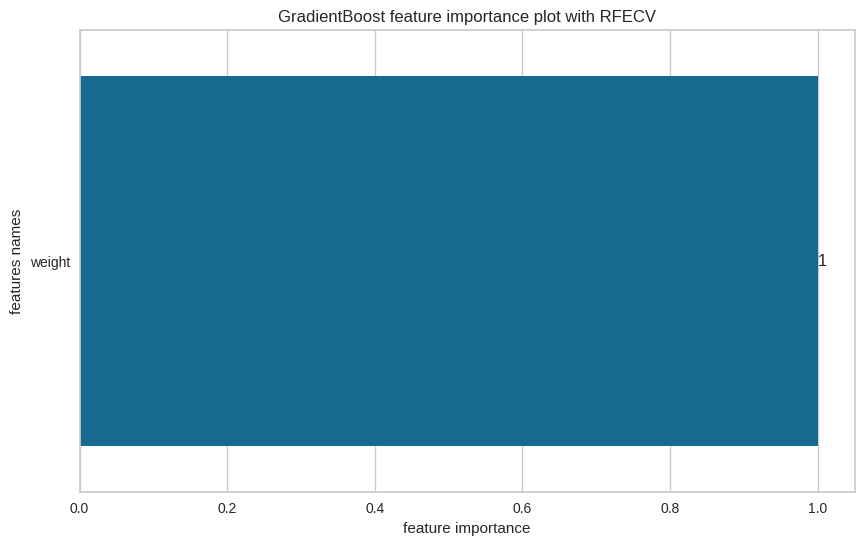

[GradientBoost] Best parameters are {'criterion': 'friedman_mse', 'learning_rate': 0.01, 'loss': 'deviance', 'max_depth': 3, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'n_estimators': 5, 'random_state': 42, 'subsample': 0.5}


In [123]:
estimators_multiclass_d_c2_sel_rfecv, X_test_d_c2_sel_rfecv, y_test_d_c2_sel_rfecv, X_train_d_c2_sel_rfecv, y_train_d_c2_sel_rfecv, X_test_inv_d_c2_sel_rfecv, features_d_c2_sel_rfecv = train(X_demo_adh, y_demo_adh, 
                                                         grid_params_multiclass, 
                                                         seed, feature_selection = True, 
                                                         feature_sel_type = 'RFECV')

In [124]:
evaluation_table_d_c2_sel_rfecv = evaluate_multiclass(estimators_multiclass_d_c2_sel_rfecv, X_test_d_c2_sel_rfecv, y_test_d_c2_sel_rfecv, no_of_labels = 3, features_selected = True, features = features_d_c2_sel_rfecv, feature_sel_type = 'RFECV')

In [125]:
evaluation_table_d_c2_sel_rfecv

,Overall Accuracy,Balanced Accuracy,Adj Balanced Accuracy,Precision micro,Precision macro,Precision weighted,Recall micro,Recall macro,Recall weighted,Cohen's kappa,Mathews Correlation Coefficient
SGD,0.84,0.50,0.00,0.84,0.42,0.71,0.84,0.50,0.84,0.00,0.00
Logistic Regression,0.84,0.50,0.00,0.84,0.42,0.71,0.84,0.50,0.84,0.00,0.00
Decision Tree,0.84,0.50,0.00,0.84,0.42,0.71,0.84,0.50,0.84,0.00,0.00
Random Forest,0.84,0.50,0.00,0.84,0.42,0.71,0.84,0.50,0.84,0.00,0.00
AdaBoost,0.84,0.50,0.00,0.84,0.42,0.71,0.84,0.50,0.84,0.00,0.00
GradientBoost,0.84,0.50,0.00,0.84,0.42,0.71,0.84,0.50,0.84,0.00,0.00


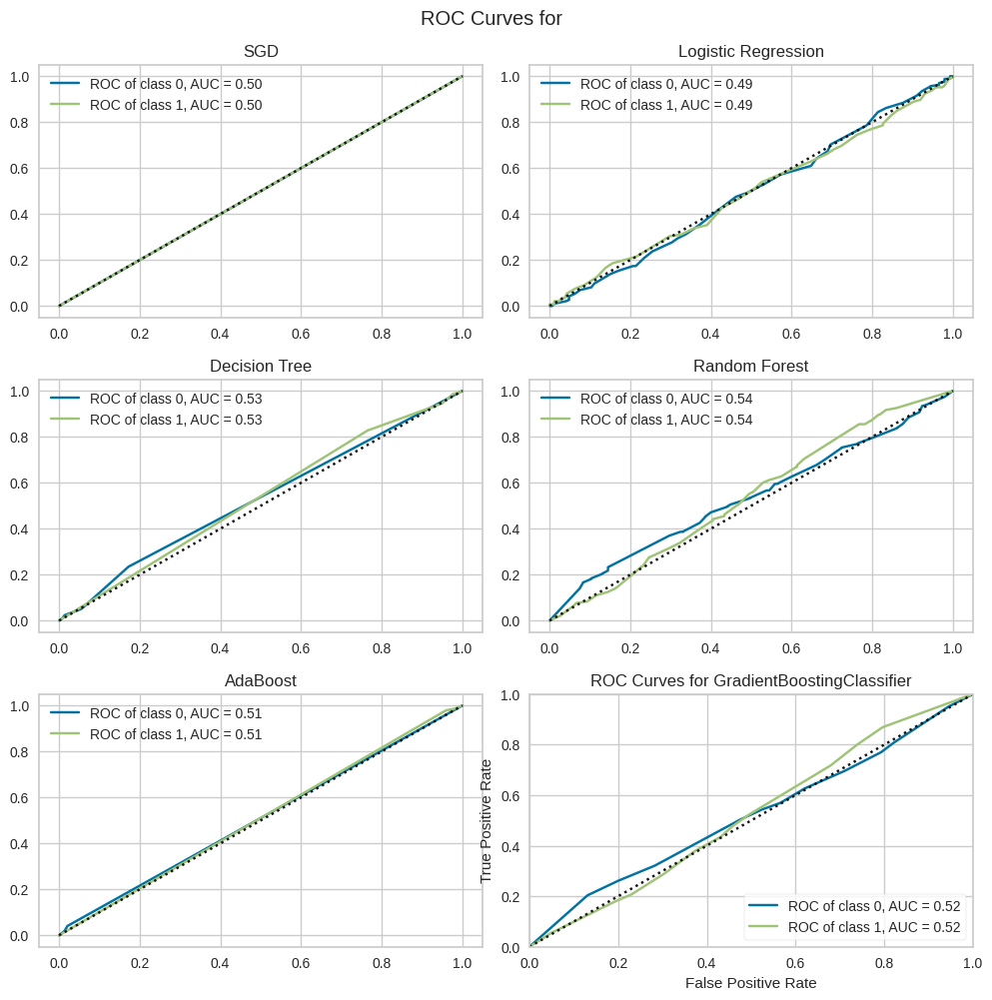

<AxesSubplot: title={'center': 'ROC Curves for GradientBoostingClassifier'}, xlabel='False Positive Rate', ylabel='True Positive Rate'>

In [126]:
ROC_curves(estimators_multiclass_d_c2_sel_rfecv, X_train_d_c2_sel_rfecv, y_train_d_c2_sel_rfecv, X_test_d_c2_sel_rfecv, y_test_d_c2_sel_rfecv, np.unique(y_demo_adh), name = 'all', features_selected = True, features = features_d_c2_sel_rfecv, feature_sel_type = 'RFECV')

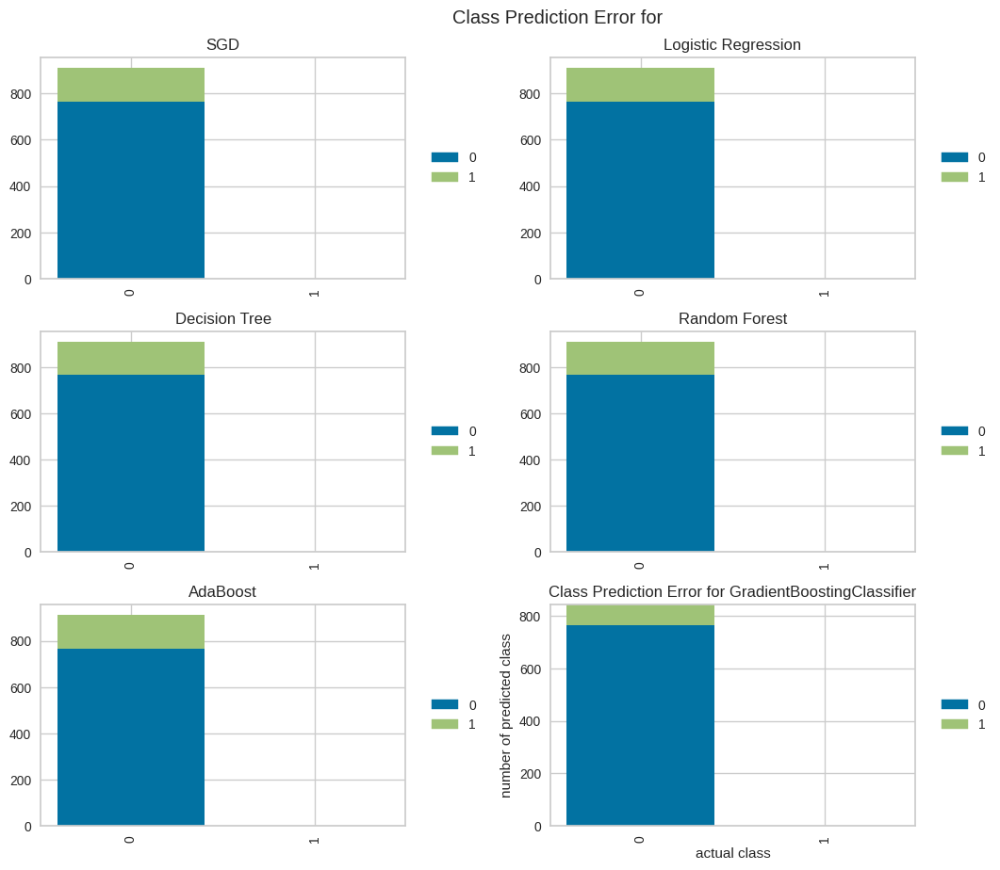

<AxesSubplot: title={'center': 'Class Prediction Error for GradientBoostingClassifier'}, xlabel='actual class', ylabel='number of predicted class'>

In [127]:
prediction_error_plot(estimators_multiclass_d_c2_sel_rfecv, X_train_d_c2_sel_rfecv, y_train_d_c2_sel_rfecv, X_test_d_c2_sel_rfecv, y_test_d_c2_sel_rfecv, np.unique(y_demo_adh), name = 'all', features_selected = True, features = features_d_c2_sel_rfecv, feature_sel_type = 'RFECV')

#### With feature selection (by SelectFromModel)

[INFO] Performing Grid-Search CV ---- SGD
[SGD] Features selected: Index(['height', 'body_type_strong', 'newsletter_subscription_True',
       'activity_level_sedentary', 'activity_level_very active'],
      dtype='object')
[SGD] Features importances: [0.00084142 0.00038094 0.00068701 0.00126133 0.00162908]


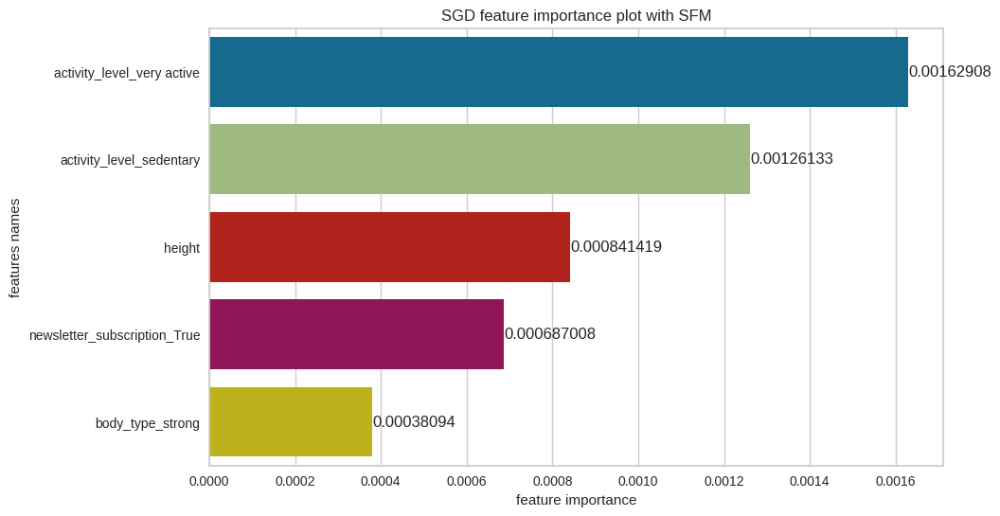

[SGD] Best parameters are {'alpha': 1e-05, 'eta0': 0.0001, 'learning_rate': 'invscaling', 'penalty': 'l1', 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Logistic Regression
[Logistic Regression] Features selected: Index(['height', 'weight', 'gender_male', 'newsletter_subscription_True',
       'activity_level_sedentary'],
      dtype='object')
[Logistic Regression] Features importances: [0.17300152 0.23585663 0.14428262 0.10724266 0.15733467]


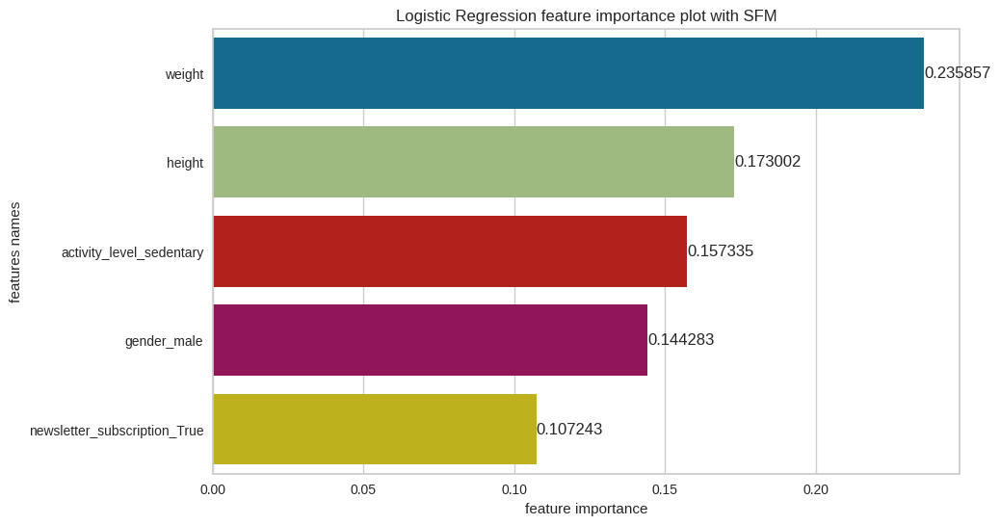

[Logistic Regression] Best parameters are {'C': 1, 'penalty': 'l1', 'random_state': 42, 'solver': 'liblinear'}
[INFO] Performing Grid-Search CV ---- Decision Tree
[Decision Tree] Features selected: Index(['height', 'weight', 'body_fat', 'body_type_thin',
       'newsletter_subscription_True'],
      dtype='object')
[Decision Tree] Features importances: [0.1630127379681578, 0.3032061022264746, 0.5337811598053676, 0.0, 0.0]


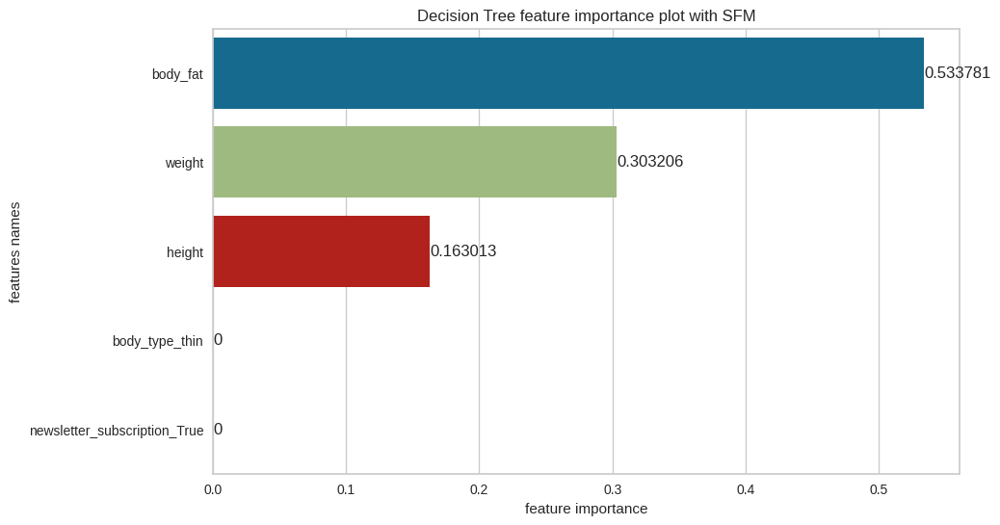

[Decision Tree] Best parameters are {'criterion': 'entropy', 'max_depth': 3, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Random Forest
[Random Forest] Features selected: Index(['height', 'weight', 'body_fat', 'body_type_thin',
       'newsletter_subscription_True'],
      dtype='object')
[Random Forest] Features importances: [0.3019786670158291, 0.23342392289772496, 0.3106560897726748, 0.024301865062403553, 0.12963945525136772]


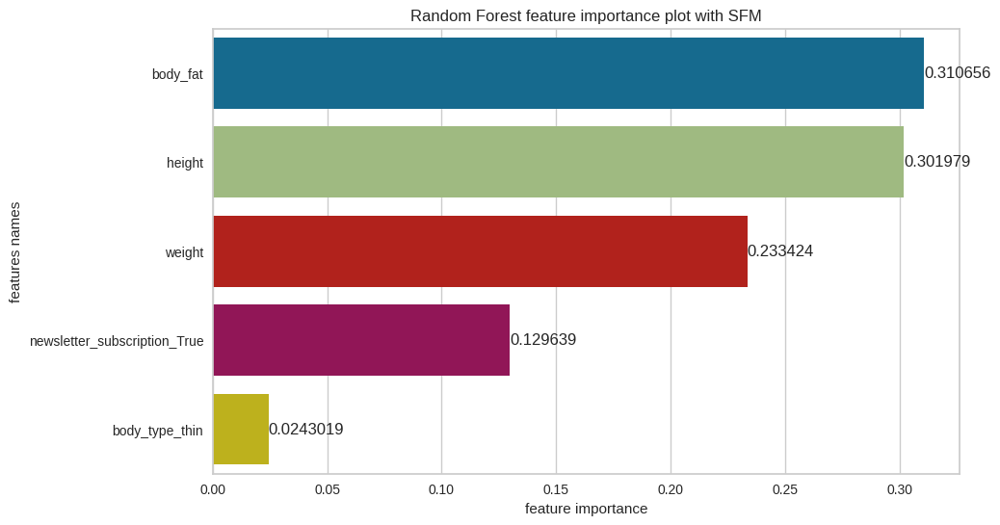

[Random Forest] Best parameters are {'criterion': 'gini', 'max_depth': 3, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- AdaBoost
[AdaBoost] Features selected: Index(['height', 'weight', 'body_fat', 'gender_male', 'body_type_thin',
       'newsletter_subscription_True', 'activity_level_sedentary',
       'activity_level_very active'],
      dtype='object')
[AdaBoost] Features importances: [0.0, 0.0, 0.15, 0.0, 0.0, 0.0, 0.85, 0.0]


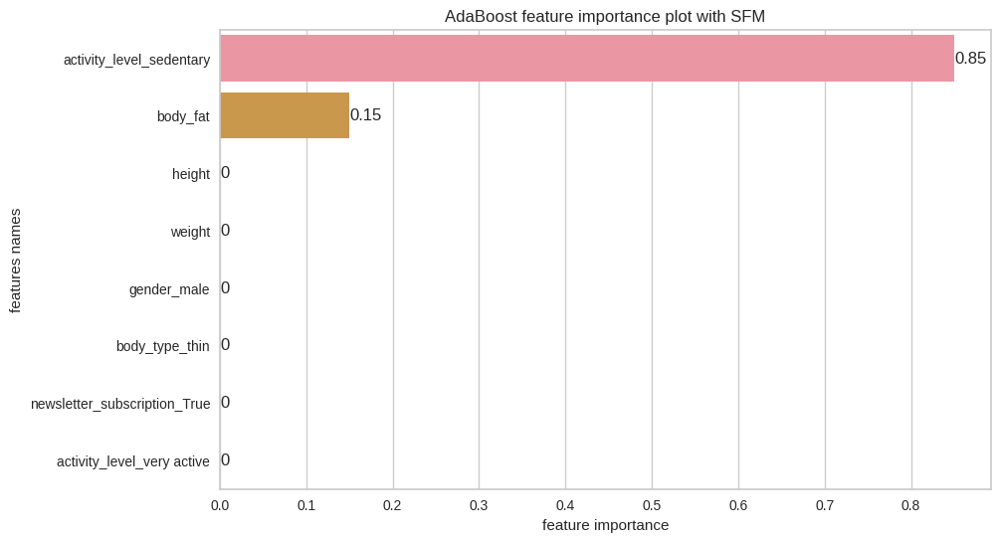

[AdaBoost] Best parameters are {'base_estimator': DecisionTreeClassifier(max_depth=1), 'learning_rate': 0.01, 'n_estimators': 20, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- GradientBoost
[GradientBoost] Features selected: Index(['height', 'weight', 'body_fat', 'newsletter_subscription_True',
       'activity_level_sedentary'],
      dtype='object')
[GradientBoost] Features importances: [0.45555698728847244, 0.0009106484017953745, 0.5435323643097322, 0.0, 0.0]


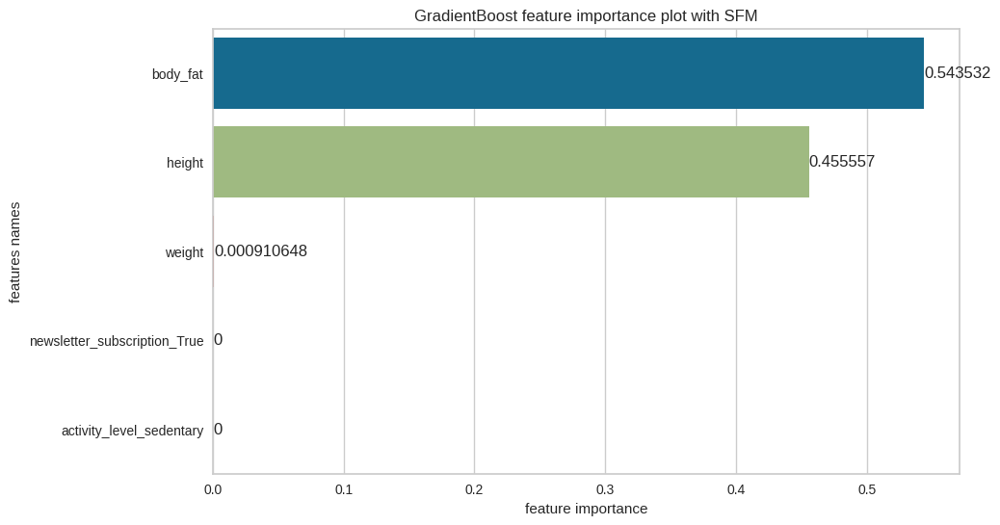

[GradientBoost] Best parameters are {'criterion': 'friedman_mse', 'learning_rate': 0.01, 'loss': 'deviance', 'max_depth': 3, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'n_estimators': 5, 'random_state': 42, 'subsample': 0.5}


In [128]:
estimators_multiclass_d_c2_sel_sfm, X_test_d_c2_sel_sfm, y_test_d_c2_sel_sfm, X_train_d_c2_sel_sfm, y_train_d_c2_sel_sfm, X_test_inv_d_c2_sel_sfm, features_d_c2_sel_sfm = train(X_demo_adh, y_demo_adh, 
                                                         grid_params_multiclass, 
                                                         seed, feature_selection = True, 
                                                         feature_sel_type = 'SFM')

In [129]:
evaluation_table_d_c2_sel_sfm = evaluate_multiclass(estimators_multiclass_d_c2_sel_sfm, X_test_d_c2_sel_sfm, y_test_d_c2_sel_sfm, no_of_labels = 3, features_selected = True, features = features_d_c2_sel_sfm, feature_sel_type = 'SFM')

In [130]:
evaluation_table_d_c2_sel_sfm

,Overall Accuracy,Balanced Accuracy,Adj Balanced Accuracy,Precision micro,Precision macro,Precision weighted,Recall micro,Recall macro,Recall weighted,Cohen's kappa,Mathews Correlation Coefficient
SGD,0.84,0.50,0.00,0.84,0.42,0.71,0.84,0.50,0.84,0.00,0.00
Logistic Regression,0.84,0.50,0.00,0.84,0.42,0.71,0.84,0.50,0.84,0.00,0.00
Decision Tree,0.84,0.50,0.00,0.84,0.42,0.71,0.84,0.50,0.84,0.00,0.00
Random Forest,0.84,0.50,0.00,0.84,0.42,0.71,0.84,0.50,0.84,0.00,0.00
AdaBoost,0.84,0.50,0.00,0.84,0.42,0.71,0.84,0.50,0.84,0.00,0.00
GradientBoost,0.84,0.50,0.00,0.84,0.42,0.71,0.84,0.50,0.84,0.00,0.00


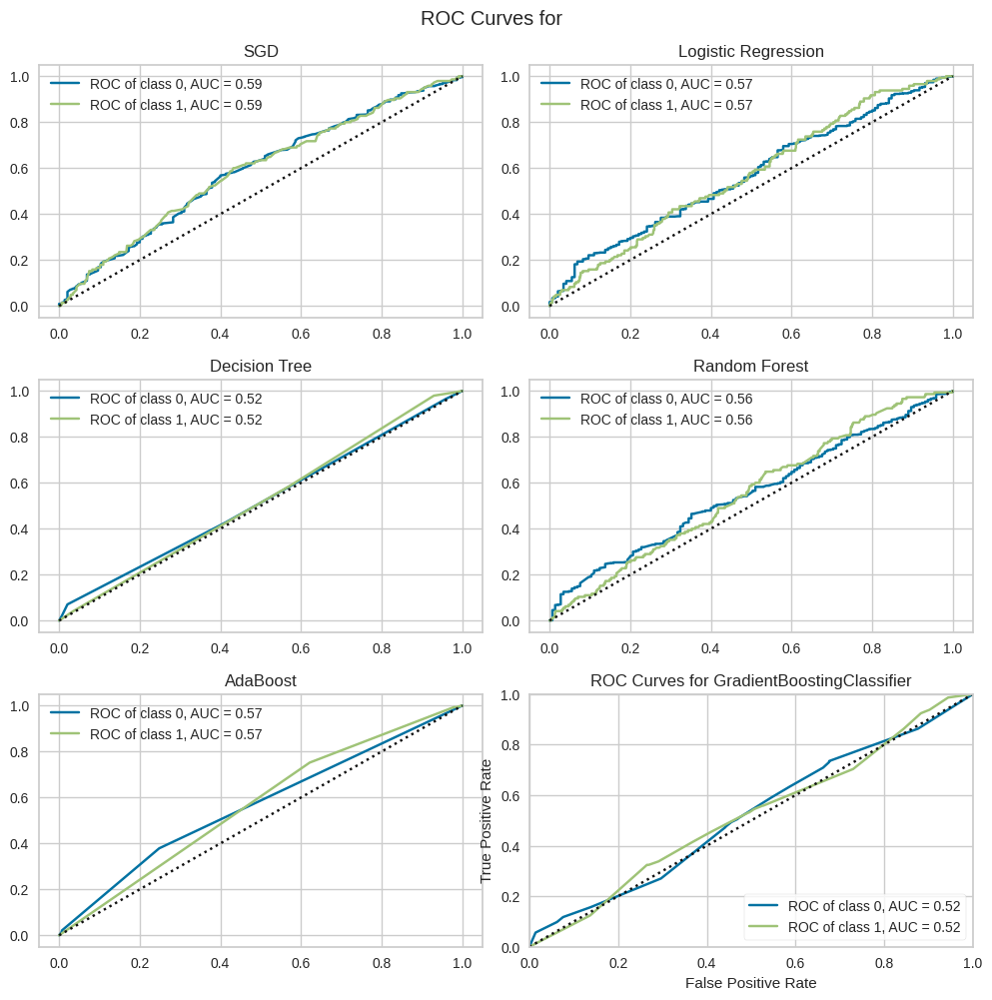

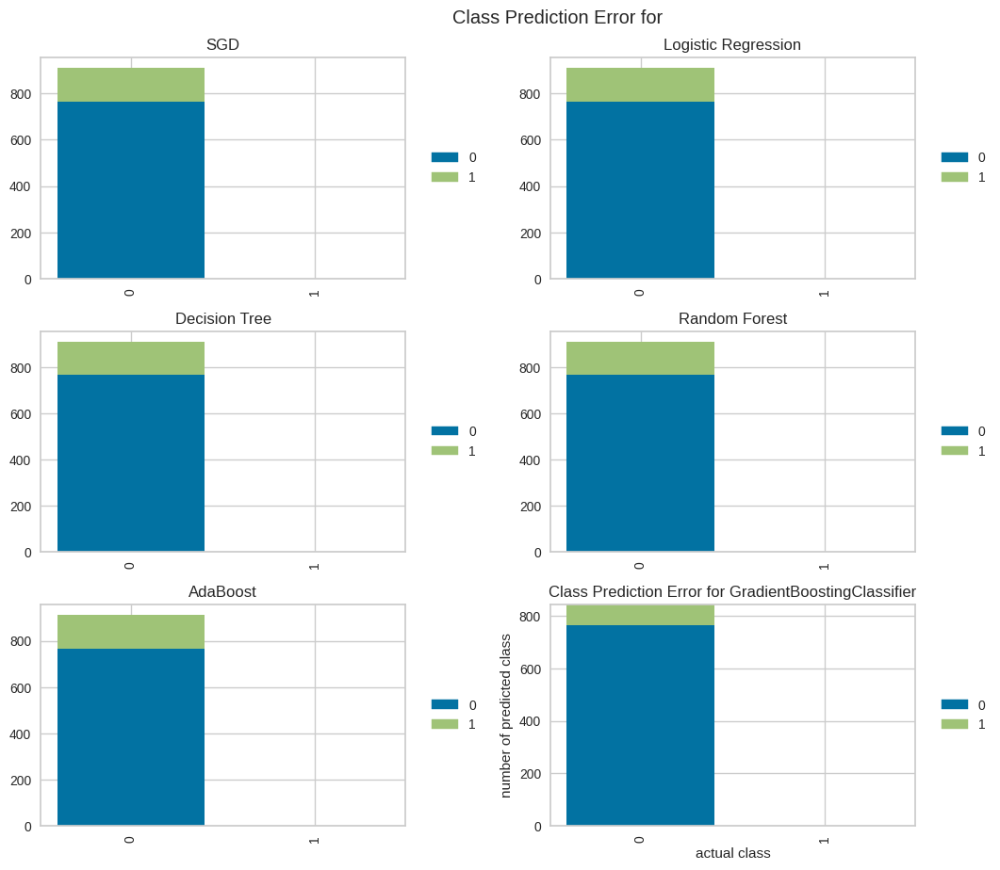

<AxesSubplot: title={'center': 'Class Prediction Error for GradientBoostingClassifier'}, xlabel='actual class', ylabel='number of predicted class'>

In [131]:
ROC_curves(estimators_multiclass_d_c2_sel_sfm, X_train_d_c2_sel_sfm, y_train_d_c2_sel_sfm, X_test_d_c2_sel_sfm, y_test_d_c2_sel_sfm, np.unique(y_demo_adh), name = 'all', features_selected = True, features = features_d_c2_sel_sfm, feature_sel_type = 'SFM')

prediction_error_plot(estimators_multiclass_d_c2_sel_sfm, X_train_d_c2_sel_sfm, y_train_d_c2_sel_sfm, X_test_d_c2_sel_sfm, y_test_d_c2_sel_sfm, np.unique(y_demo_adh), name = 'all', features_selected = True, features = features_d_c2_sel_sfm, feature_sel_type = 'SFM')

### Fifth approach (first 12 weeks, 2 groups, goal achieved at least 4 times)

In this approach, we take into consideration first 12 weeks of having the app (after first workout). The adherence will be divided into 2 groups:

* Group 0 - the user didn't achieve goal at least 4 times in the 12 week period (2683 users),
* Group 1 - the user achieved training days setting at least 4 times in the 12 week period (351 users).

The variables taken into consideration are:
* gender,
* height,
* weight,
* BMI,
* activity level,
* body type,
* newsletter subscription,
* body fat,
* training days setting,
* total time users,
* total reps users,
* total calories users,
* exercises per user,
* exercises without rest per user.

In [132]:
# deleting label from data
X_adh_12_weeks = df_users_adh_12_weeks.loc[:, df_users_adh_12_weeks.columns != 'Adh']

# variable only with label
y_adh_12_weeks = df_users_adh_12_weeks['Adh'].to_numpy()


# X_adh_12_weeks = OrdinalEncoder().fit_transform(X_adh_12_weeks)

for col in ['gender', 'body_type', 'newsletter_subscription', 'activity_level', 'training_days_setting']:
    X_adh_12_weeks[col] = LabelEncoder().fit_transform(X_adh_12_weeks[col])

y_adh_12_week = pd.DataFrame(y_adh_12_weeks, columns = ['Adherence group'])

[INFO] Performing Grid-Search CV ---- SGD
[SGD] Features importances: [0.05696727 0.06164072 0.08152628 0.05476902 0.09116435 0.13894451
 0.10033766 0.10939338 1.07496225 1.37811167 1.13243682 0.67743439
 0.45726447 0.42020546]


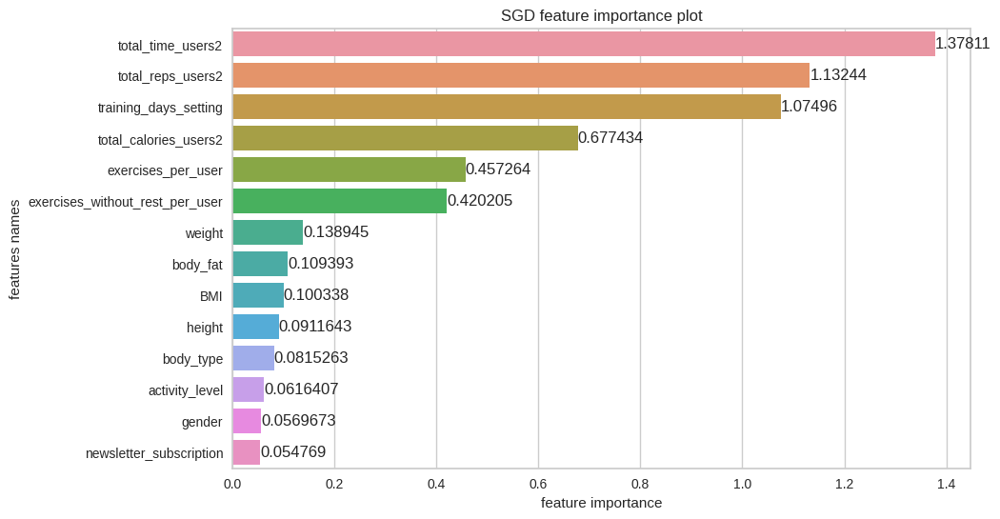

[SGD] Best parameters are {'alpha': 0.001, 'eta0': 0.0001, 'learning_rate': 'optimal', 'penalty': 'l2', 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Logistic Regression
[Logistic Regression] Features importances: [0.00804282 0.13063987 0.02819382 0.05988055 0.04606015 0.0118953
 0.02162225 0.03069334 1.86002656 2.53643544 1.71181441 1.4474463
 1.41393977 2.20398547]


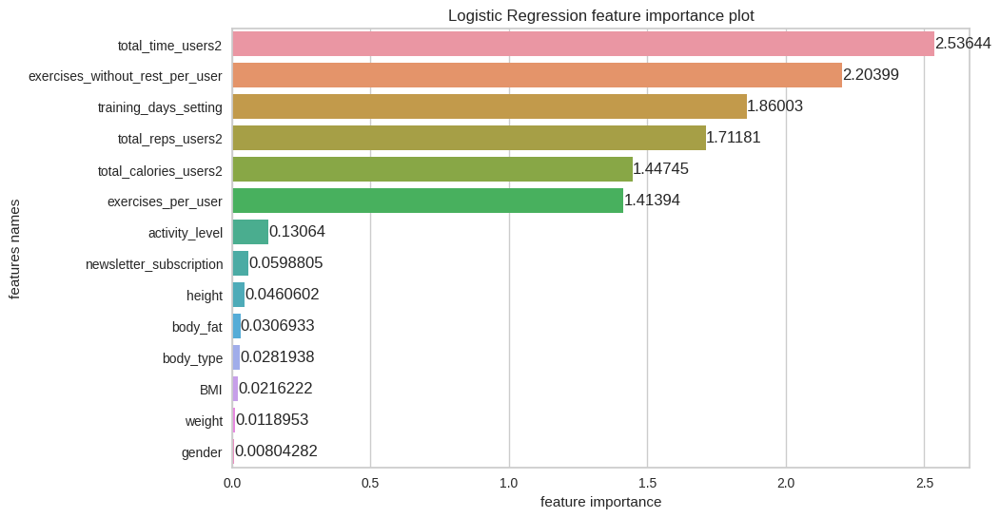

[Logistic Regression] Best parameters are {'C': 4, 'penalty': 'l2', 'random_state': 42, 'solver': 'liblinear'}
[INFO] Performing Grid-Search CV ---- Decision Tree
[Decision Tree] Features importances: [0.0, 0.0, 0.01050896525664478, 0.009910850440382377, 0.011203325056626112, 0.009355575681292427, 0.005747750497139096, 0.0, 0.23473334031006096, 0.4698495456466012, 0.13178411047944036, 0.053772240921561264, 0.0509006833831608, 0.01223361232709073]


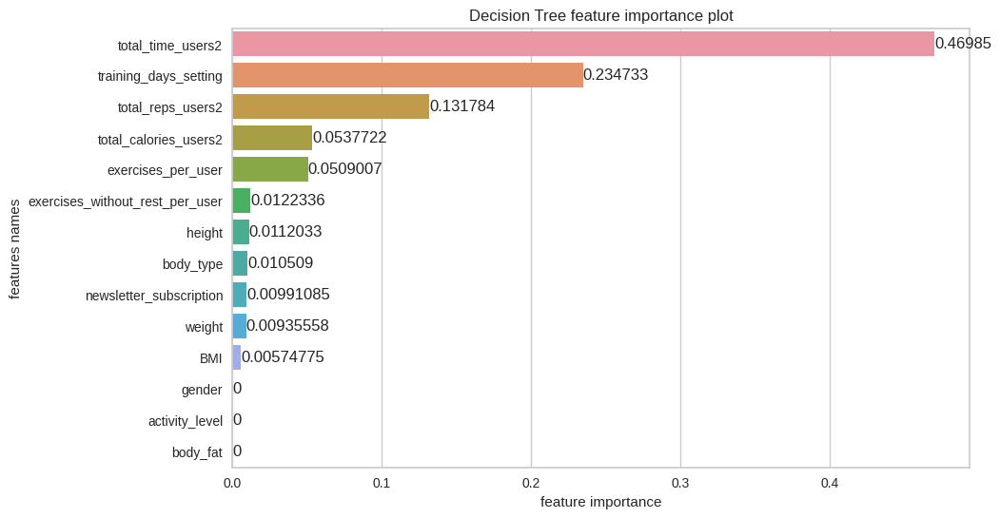

[Decision Tree] Best parameters are {'criterion': 'entropy', 'max_depth': 6, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Random Forest
[Random Forest] Features importances: [0.0003782457245386539, 2.963692327849843e-05, 0.0001030766005617703, 0.0, 0.0008092689474653977, 0.0023243290671708925, 0.005180142114423465, 0.011538579392805847, 0.005321565866418364, 0.27710248955071026, 0.17718372101972632, 0.1981254448027449, 0.1671246797568063, 0.1547788202333493]


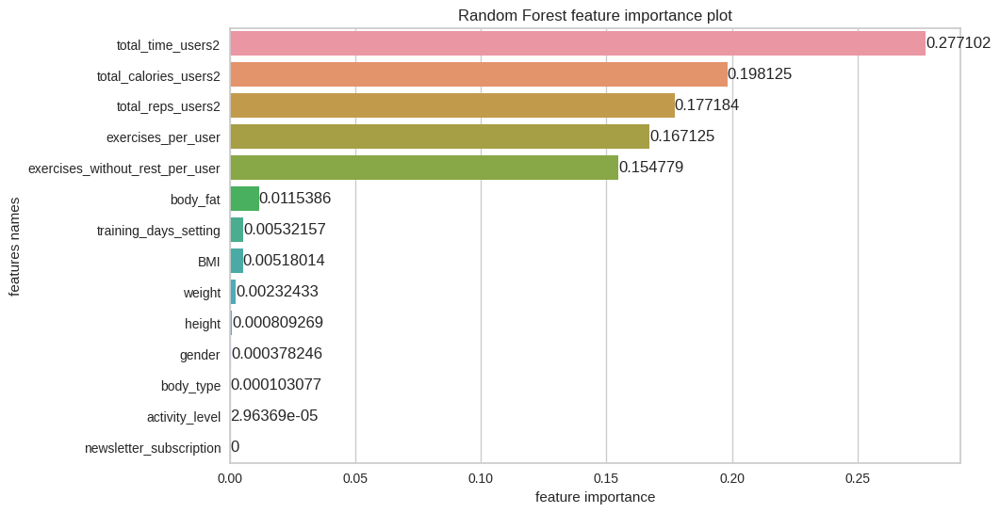

[Random Forest] Best parameters are {'criterion': 'gini', 'max_depth': 3, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- AdaBoost
[AdaBoost] Features importances: [0.0, 0.0, 0.0, 0.0, 0.0, 5.594856275073519e-05, 0.0, 0.0, 0.2429283983593254, 0.5792278514949788, 0.07160678739070639, 0.03646198395316135, 0.04859407995052638, 0.02112495028855099]


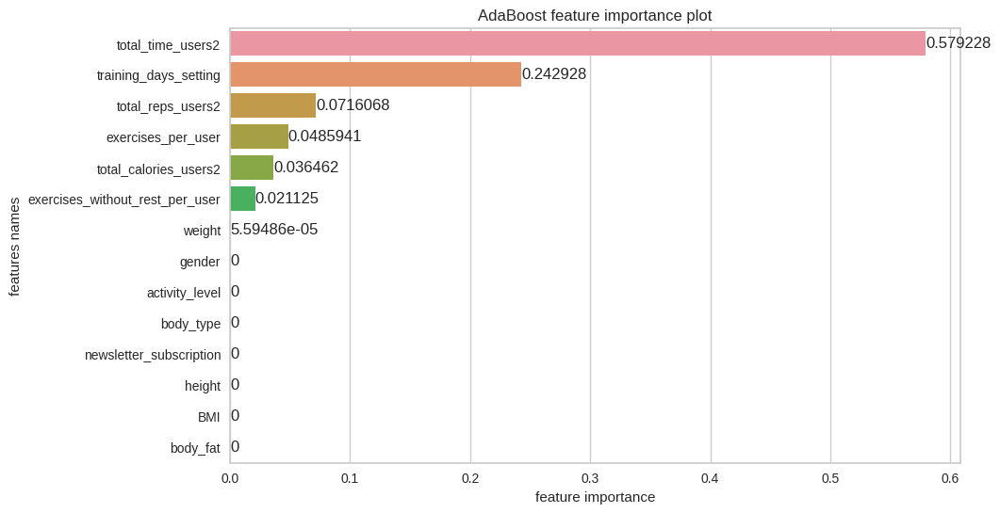

[AdaBoost] Best parameters are {'base_estimator': DecisionTreeClassifier(max_depth=3), 'learning_rate': 0.01, 'n_estimators': 40, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- GradientBoost
[GradientBoost] Features importances: [0.012178215024661543, 0.0, 0.0, 0.0, 0.0, 0.0, 0.017938169000977635, 0.0, 0.0, 0.278278040156829, 0.00094546511651463, 0.2134835730163875, 0.2666352203932169, 0.21054131729141276]


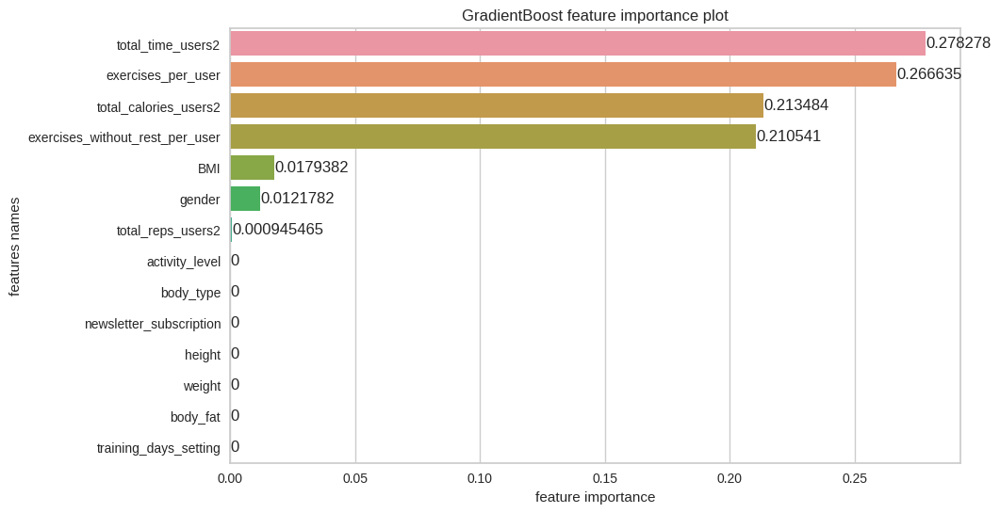

[GradientBoost] Best parameters are {'criterion': 'friedman_mse', 'learning_rate': 0.01, 'loss': 'deviance', 'max_depth': 3, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'n_estimators': 5, 'random_state': 42, 'subsample': 0.5}


In [133]:
estimators_multiclass_12_weeks, X_test_12_weeks, y_test_12_weeks, X_train_12_weeks, y_train_12_weeks, X_test_inv_12_weeks, features_12_weeks = train(X_adh_12_weeks, y_adh_12_weeks, 
                                                         grid_params_multiclass, 
                                                         seed)

evaluation_table_12_weeks = evaluate_multiclass(estimators_multiclass_12_weeks, X_test_12_weeks, y_test_12_weeks, no_of_labels = 2, features_selected = False, features = features_12_weeks)


In [134]:
evaluation_table_12_weeks

,Overall Accuracy,Balanced Accuracy,Adj Balanced Accuracy,Precision,Recall,Cohen's kappa,Mathews Correlation Coefficient
SGD,0.91,0.75,0.50,0.61,0.54,0.52,0.53
Logistic Regression,0.92,0.71,0.42,0.72,0.44,0.50,0.52
Decision Tree,0.92,0.75,0.50,0.67,0.53,0.55,0.55
Random Forest,0.88,0.50,0.00,0.00,0.00,0.00,0.00
AdaBoost,0.92,0.73,0.46,0.76,0.48,0.54,0.56
GradientBoost,0.88,0.50,0.00,0.00,0.00,0.00,0.00


Taking into consideration all of the criterions, the best algorithm is AdaBoost with decision tree classifier with max depth equal to 3, learning rate equal to 0.01 and number of estimators equal to 40. Overall accuracy is 92%, precision is 76%, recall is 48%. Cohen's kappa is 0.54 and MCC is also 0.56. The ROC and AUC are very good. Overall, those are good results.

In [135]:
prediction_for_one_user(estimators_multiclass_12_weeks, X_test_12_weeks, y_test_12_weeks, X_test_inv_12_weeks, X_adh_12_weeks.columns, y_adh_12_week.columns, name = 'AdaBoost')


,gender,activity_level,body_type,newsletter_subscription,height,weight,BMI,body_fat,training_days_setting,total_time_users2,total_reps_users2,total_calories_users2,exercises_per_user,exercises_without_rest_per_user,Adherence group,Adherence group_prediction
704,0.00,0.00,2.00,1.00,165.00,70.00,25.71,35.00,3.00,5380.00,1117.00,290.22,8011.00,5432.00,0,0


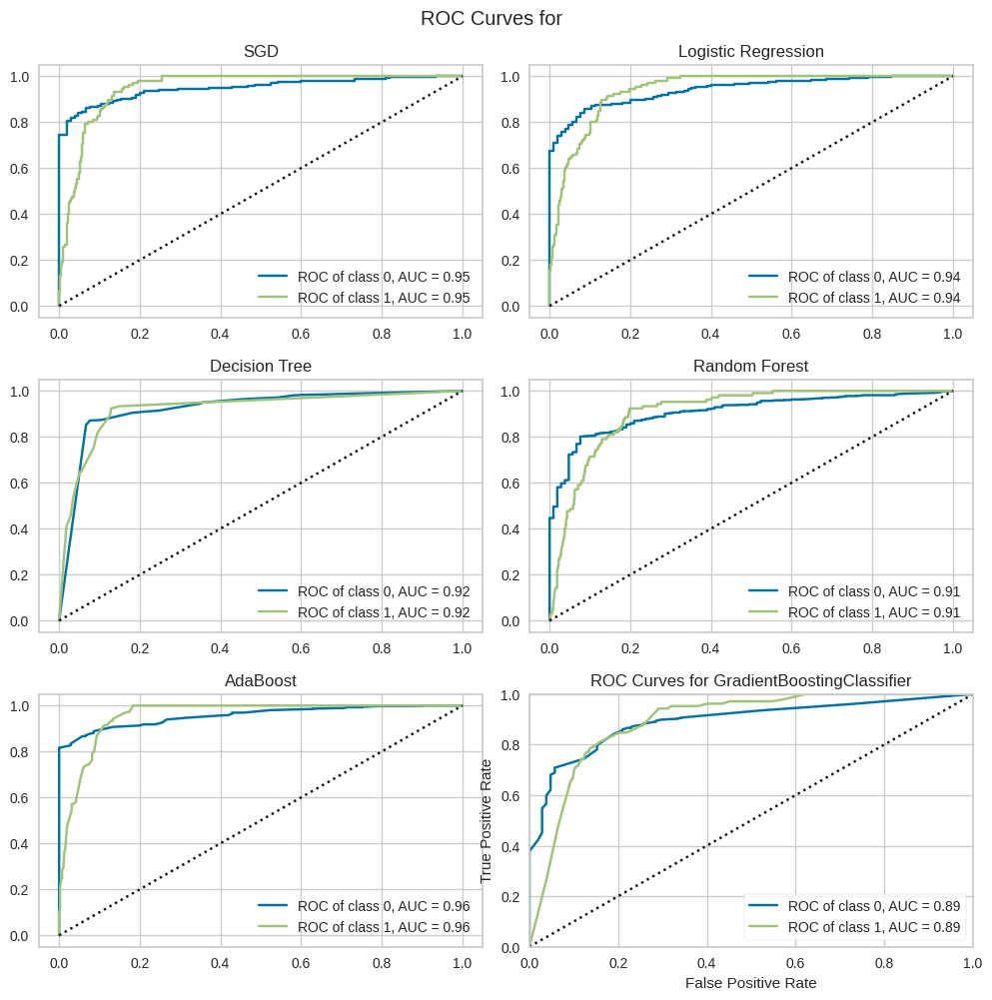

<AxesSubplot: title={'center': 'ROC Curves for GradientBoostingClassifier'}, xlabel='False Positive Rate', ylabel='True Positive Rate'>

In [136]:
ROC_curves(estimators_multiclass_12_weeks, X_train_12_weeks, y_train_12_weeks, X_test_12_weeks, y_test_12_weeks, np.unique(y_adh_12_weeks), name = 'all', features_selected = False, features = features_12_weeks)


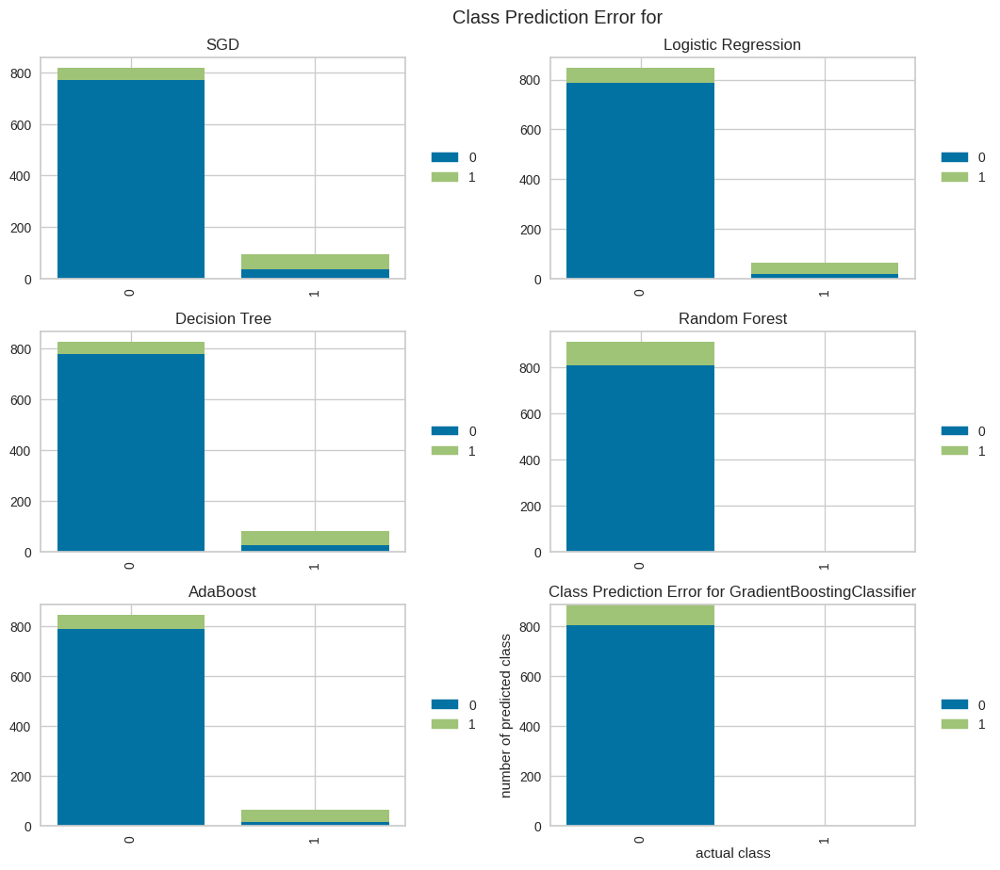

<AxesSubplot: title={'center': 'Class Prediction Error for GradientBoostingClassifier'}, xlabel='actual class', ylabel='number of predicted class'>

In [137]:
prediction_error_plot(estimators_multiclass_12_weeks, X_train_12_weeks, y_train_12_weeks, X_test_12_weeks, y_test_12_weeks, np.unique(y_adh_12_weeks), name = 'all', features_selected = False, features = features_12_weeks)


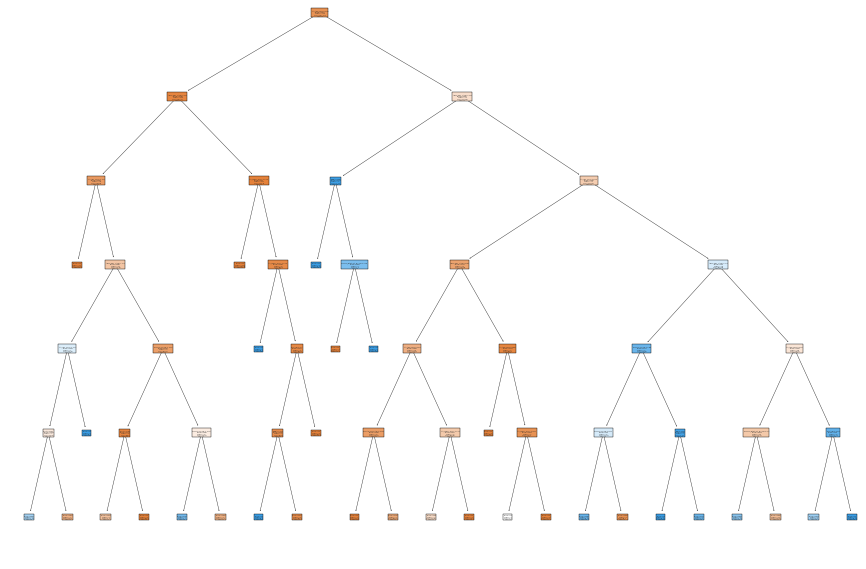

In [138]:
decision_tree(estimators_multiclass_12_weeks, df_users_adh_12_weeks[['gender', 'activity_level', 
                                                                     'body_type', 'newsletter_subscription',
       'height', 'weight', 'BMI', 'body_fat', 'training_days_setting',
       'total_time_users2', 'total_reps_users2', 'total_calories_users2',
       'exercises_per_user', 'exercises_without_rest_per_user']],
             y_adh_12_week['Adherence group'])

#### With feature selection (Univariate)

[INFO] Performing Grid-Search CV ---- SGD
[SGD] Features importances: [0.05696727 0.06164072 0.08152628 0.05476902 0.09116435 0.13894451
 0.10033766 0.10939338 1.07496225 1.37811167 1.13243682 0.67743439
 0.45726447 0.42020546]


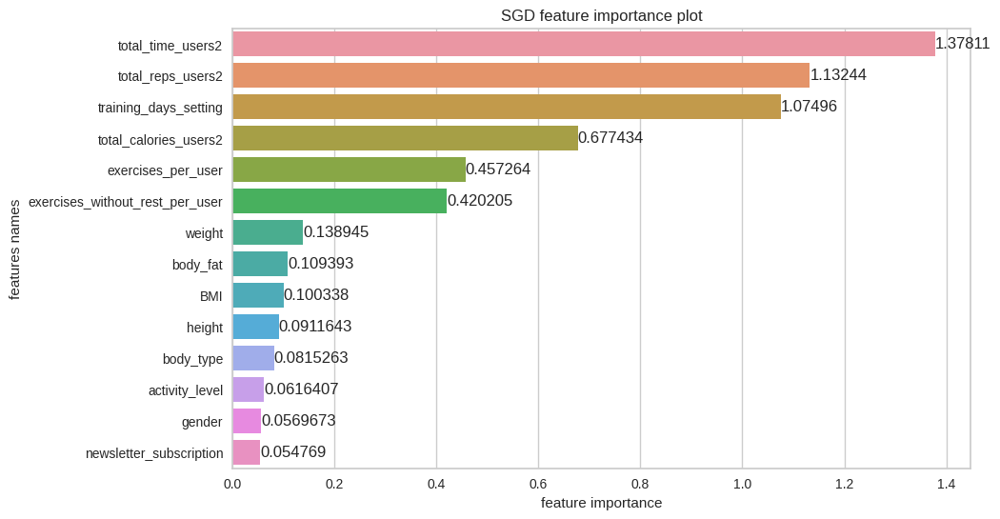

[SGD] Best parameters are {'alpha': 0.001, 'eta0': 0.0001, 'learning_rate': 'optimal', 'penalty': 'l2', 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Logistic Regression
[Logistic Regression] Features importances: [0.00804282 0.13063987 0.02819382 0.05988055 0.04606015 0.0118953
 0.02162225 0.03069334 1.86002656 2.53643544 1.71181441 1.4474463
 1.41393977 2.20398547]


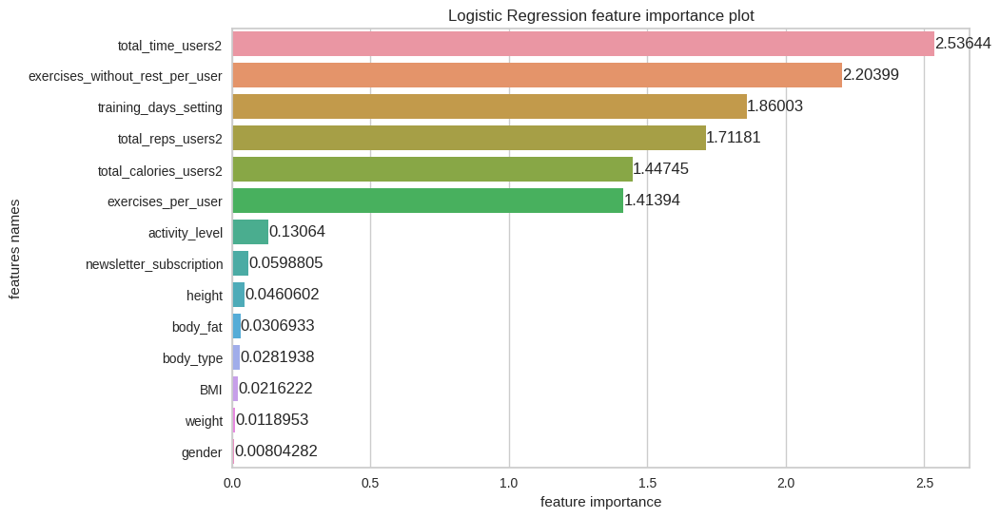

[Logistic Regression] Best parameters are {'C': 4, 'penalty': 'l2', 'random_state': 42, 'solver': 'liblinear'}
[INFO] Performing Grid-Search CV ---- Decision Tree
[Decision Tree] Features importances: [0.0, 0.0, 0.01050896525664478, 0.009910850440382377, 0.011203325056626112, 0.009355575681292427, 0.005747750497139096, 0.0, 0.23473334031006096, 0.4698495456466012, 0.13178411047944036, 0.053772240921561264, 0.0509006833831608, 0.01223361232709073]


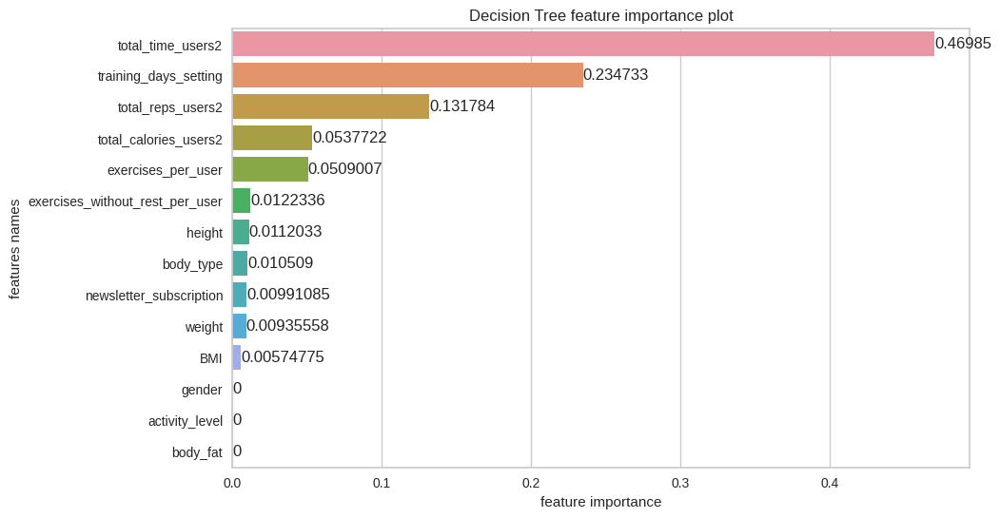

[Decision Tree] Best parameters are {'criterion': 'entropy', 'max_depth': 6, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Random Forest
[Random Forest] Features importances: [0.0003782457245386539, 2.963692327849843e-05, 0.0001030766005617703, 0.0, 0.0008092689474653977, 0.0023243290671708925, 0.005180142114423465, 0.011538579392805847, 0.005321565866418364, 0.27710248955071026, 0.17718372101972632, 0.1981254448027449, 0.1671246797568063, 0.1547788202333493]


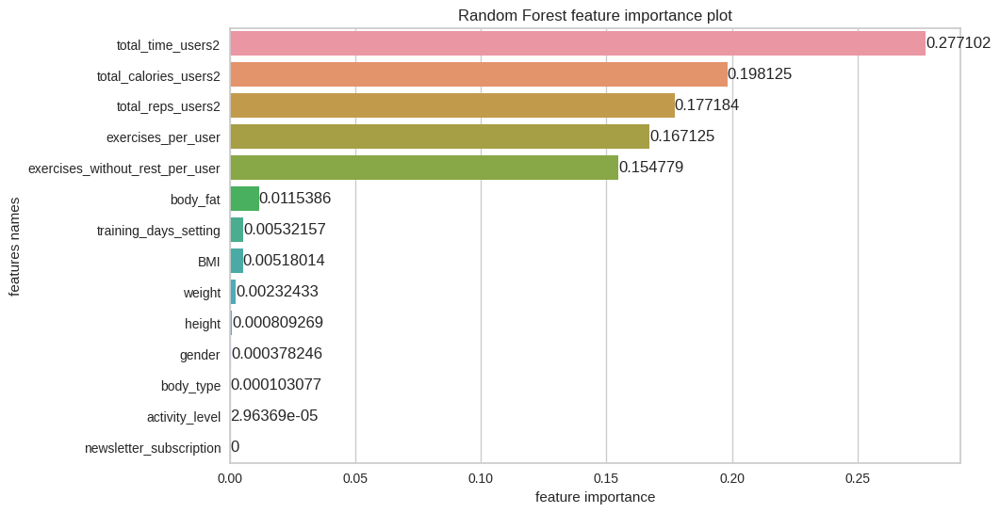

[Random Forest] Best parameters are {'criterion': 'gini', 'max_depth': 3, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- AdaBoost
[AdaBoost] Features importances: [0.0, 0.0, 0.0, 0.0, 0.0, 5.594856275073519e-05, 0.0, 0.0, 0.2429283983593254, 0.5792278514949788, 0.07160678739070639, 0.03646198395316135, 0.04859407995052638, 0.02112495028855099]


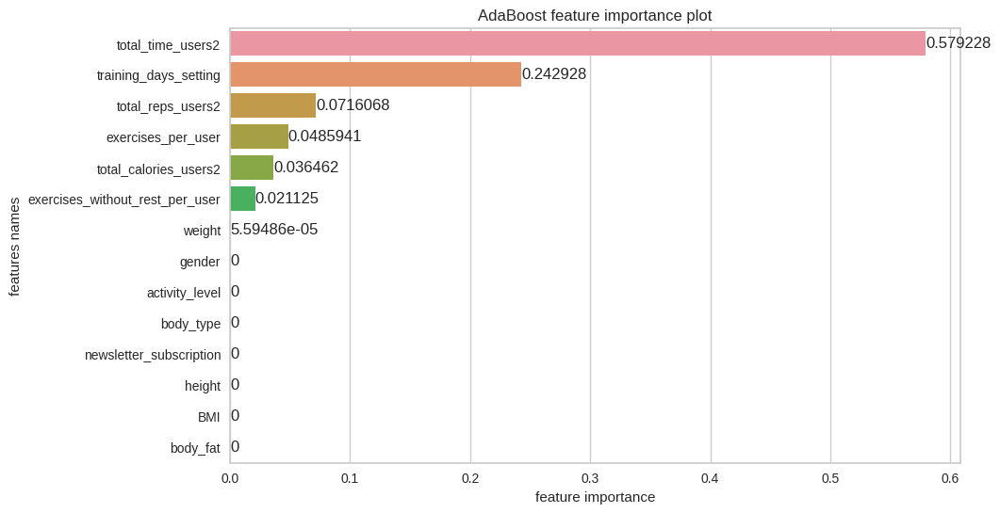

[AdaBoost] Best parameters are {'base_estimator': DecisionTreeClassifier(max_depth=3), 'learning_rate': 0.01, 'n_estimators': 40, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- GradientBoost
[GradientBoost] Features importances: [0.012178215024661543, 0.0, 0.0, 0.0, 0.0, 0.0, 0.017938169000977635, 0.0, 0.0, 0.278278040156829, 0.00094546511651463, 0.2134835730163875, 0.2666352203932169, 0.21054131729141276]


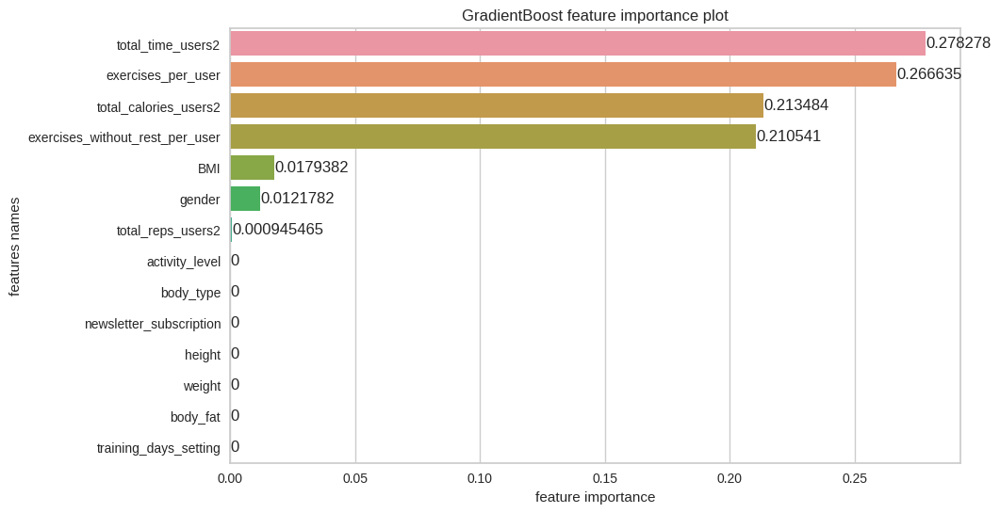

[GradientBoost] Best parameters are {'criterion': 'friedman_mse', 'learning_rate': 0.01, 'loss': 'deviance', 'max_depth': 3, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'n_estimators': 5, 'random_state': 42, 'subsample': 0.5}


In [139]:
estimators_multiclass_12_weeks_u, X_test_12_weeks_u, y_test_12_weeks_u, X_train_12_weeks_u, y_train_12_weeks_u, X_test_inv_12_weeks_u, features_12_weeks_u = train(X_adh_12_weeks, y_adh_12_weeks, 
                                                         grid_params_multiclass, 
                                                         seed)

evaluation_table_12_weeks_u = evaluate_multiclass(estimators_multiclass_12_weeks_u, X_test_12_weeks_u, y_test_12_weeks_u, no_of_labels = 2, features_selected = False, features = features_12_weeks_u)


In [140]:
evaluation_table_12_weeks_u

,Overall Accuracy,Balanced Accuracy,Adj Balanced Accuracy,Precision,Recall,Cohen's kappa,Mathews Correlation Coefficient
SGD,0.91,0.75,0.50,0.61,0.54,0.52,0.53
Logistic Regression,0.92,0.71,0.42,0.72,0.44,0.50,0.52
Decision Tree,0.92,0.75,0.50,0.67,0.53,0.55,0.55
Random Forest,0.88,0.50,0.00,0.00,0.00,0.00,0.00
AdaBoost,0.92,0.73,0.46,0.76,0.48,0.54,0.56
GradientBoost,0.88,0.50,0.00,0.00,0.00,0.00,0.00


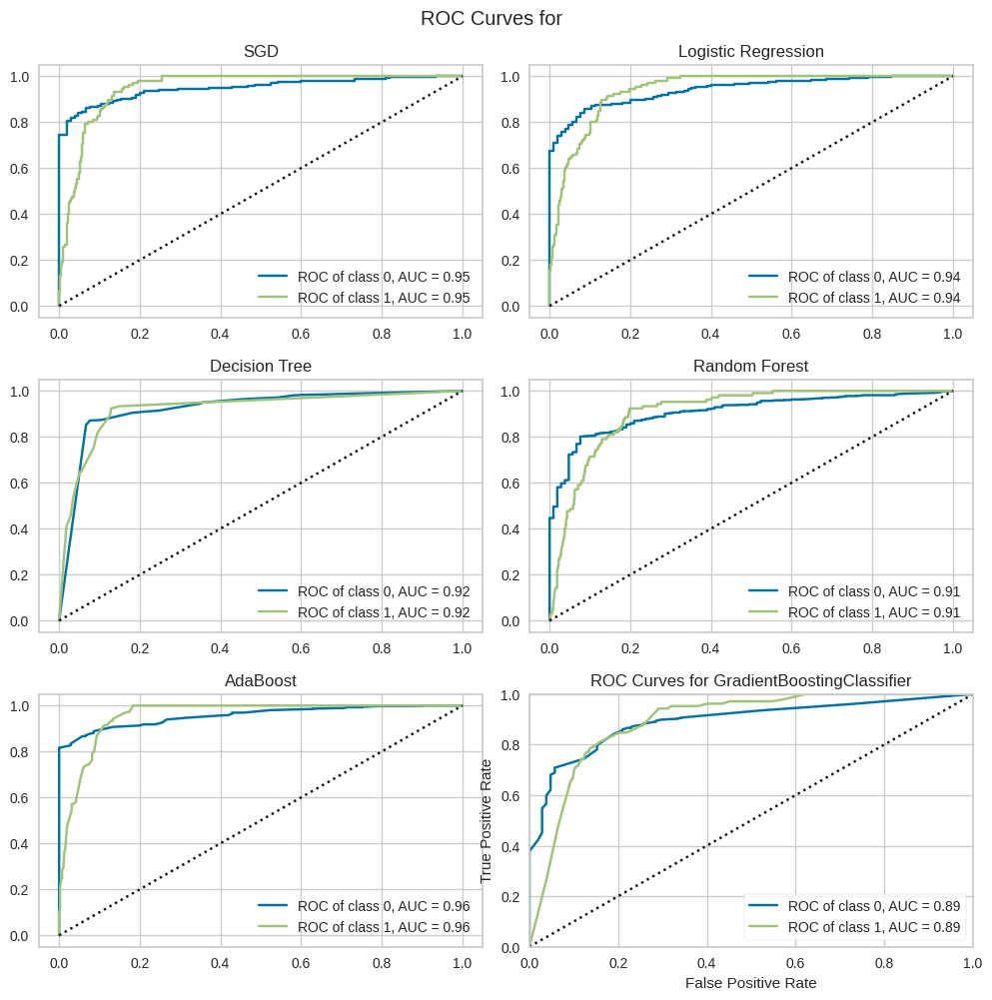

<AxesSubplot: title={'center': 'ROC Curves for GradientBoostingClassifier'}, xlabel='False Positive Rate', ylabel='True Positive Rate'>

In [141]:
ROC_curves(estimators_multiclass_12_weeks_u, X_train_12_weeks_u, y_train_12_weeks_u, X_test_12_weeks_u, y_test_12_weeks_u, np.unique(y_adh_12_weeks), name = 'all', features_selected = False, features = features_12_weeks_u)


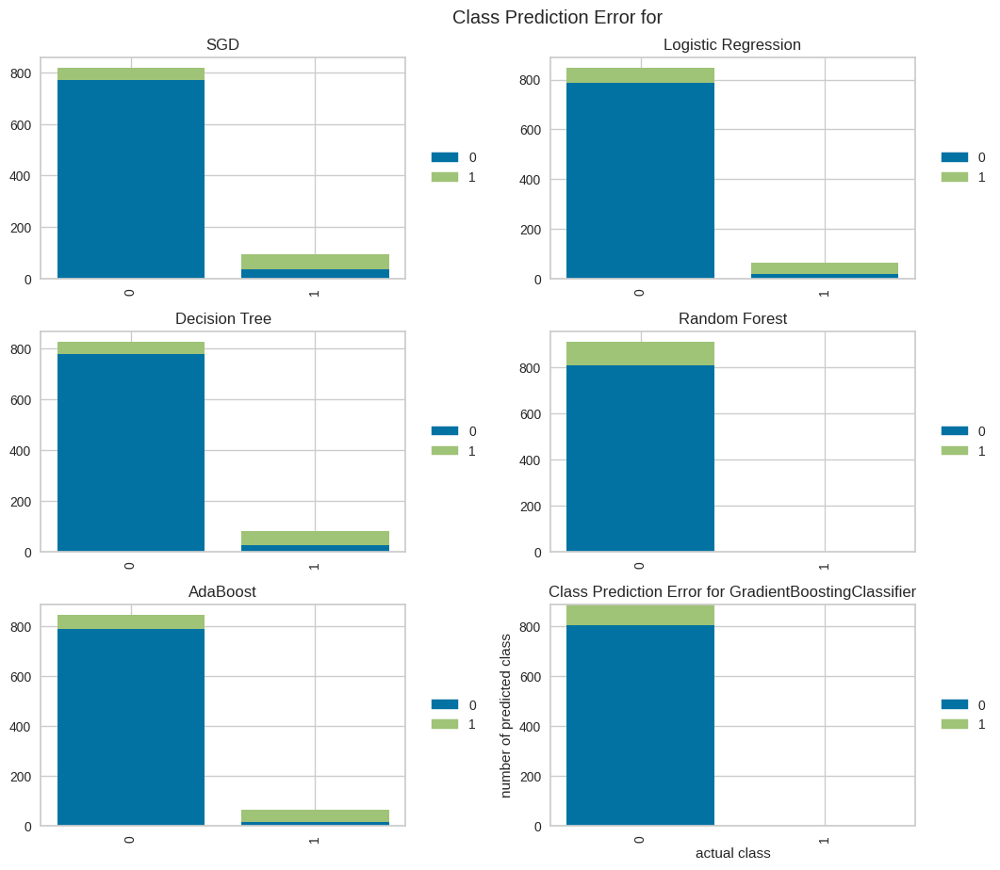

<AxesSubplot: title={'center': 'Class Prediction Error for GradientBoostingClassifier'}, xlabel='actual class', ylabel='number of predicted class'>

In [142]:
prediction_error_plot(estimators_multiclass_12_weeks_u, X_train_12_weeks_u, y_train_12_weeks_u, X_test_12_weeks_u, y_test_12_weeks_u, np.unique(y_adh_12_weeks), name = 'all', features_selected = False, features = features_12_weeks_u)


#### With feature selection (by SequentialFeatureSelector)

[INFO] Performing Grid-Search CV ---- SGD
[SGD] Features importances: [0.05696727 0.06164072 0.08152628 0.05476902 0.09116435 0.13894451
 0.10033766 0.10939338 1.07496225 1.37811167 1.13243682 0.67743439
 0.45726447 0.42020546]


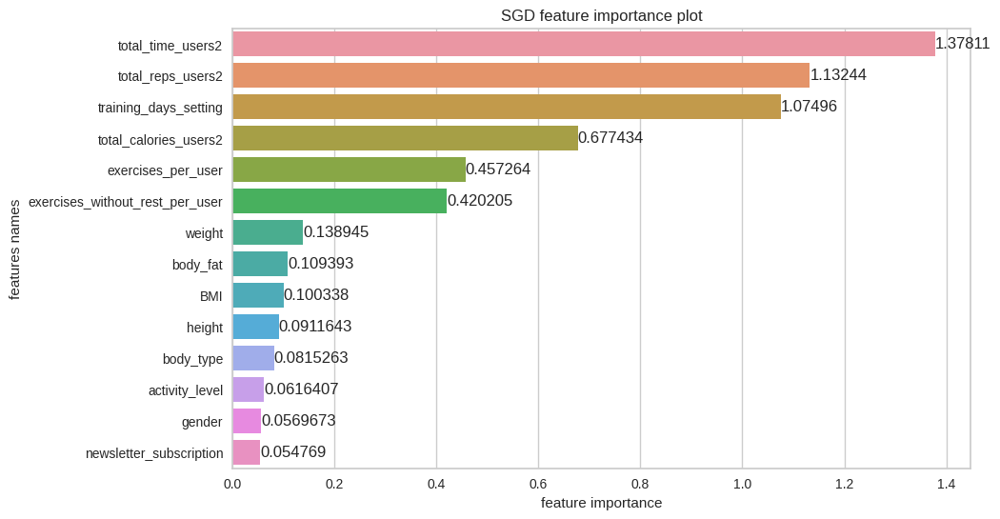

[SGD] Best parameters are {'alpha': 0.001, 'eta0': 0.0001, 'learning_rate': 'optimal', 'penalty': 'l2', 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Logistic Regression
[Logistic Regression] Features importances: [0.00804282 0.13063987 0.02819382 0.05988055 0.04606015 0.0118953
 0.02162225 0.03069334 1.86002656 2.53643544 1.71181441 1.4474463
 1.41393977 2.20398547]


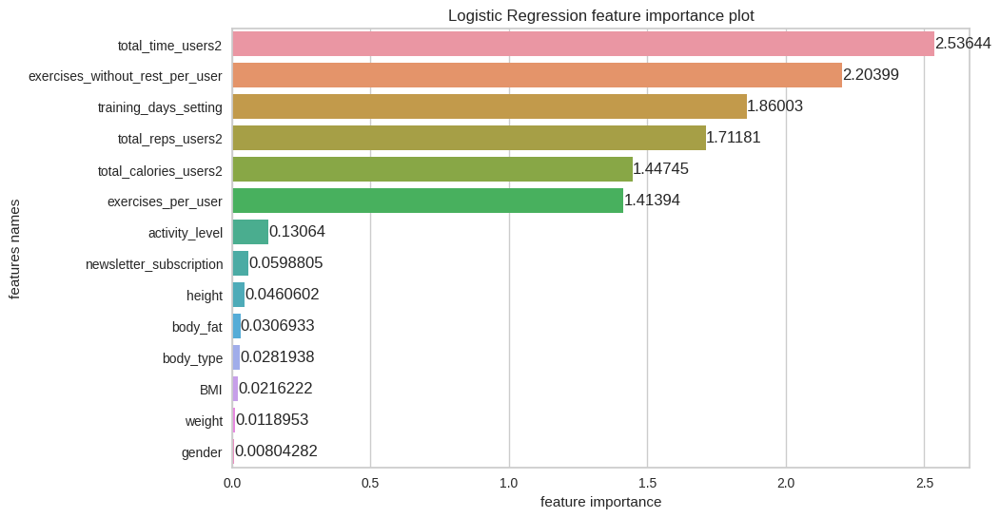

[Logistic Regression] Best parameters are {'C': 4, 'penalty': 'l2', 'random_state': 42, 'solver': 'liblinear'}
[INFO] Performing Grid-Search CV ---- Decision Tree
[Decision Tree] Features importances: [0.0, 0.0, 0.01050896525664478, 0.009910850440382377, 0.011203325056626112, 0.009355575681292427, 0.005747750497139096, 0.0, 0.23473334031006096, 0.4698495456466012, 0.13178411047944036, 0.053772240921561264, 0.0509006833831608, 0.01223361232709073]


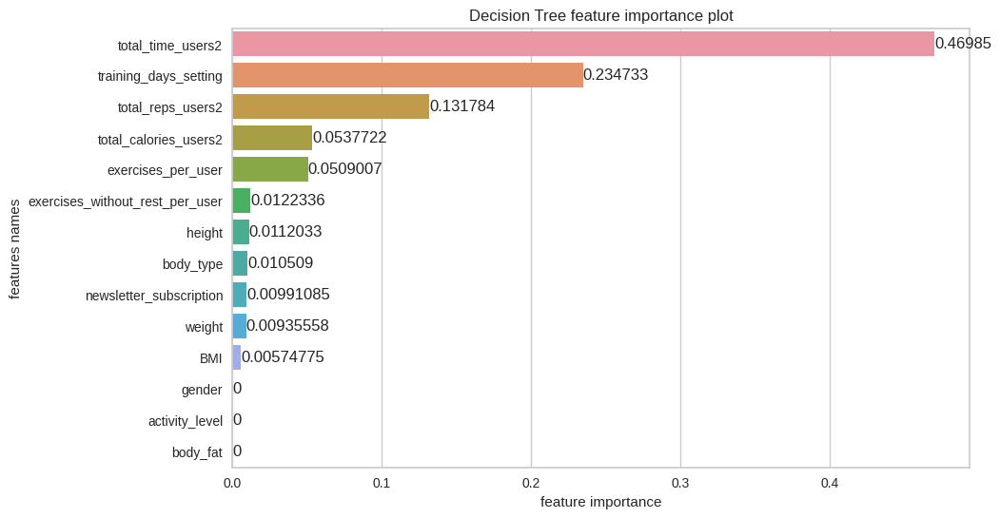

[Decision Tree] Best parameters are {'criterion': 'entropy', 'max_depth': 6, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Random Forest
[Random Forest] Features importances: [0.0003782457245386539, 2.963692327849843e-05, 0.0001030766005617703, 0.0, 0.0008092689474653977, 0.0023243290671708925, 0.005180142114423465, 0.011538579392805847, 0.005321565866418364, 0.27710248955071026, 0.17718372101972632, 0.1981254448027449, 0.1671246797568063, 0.1547788202333493]


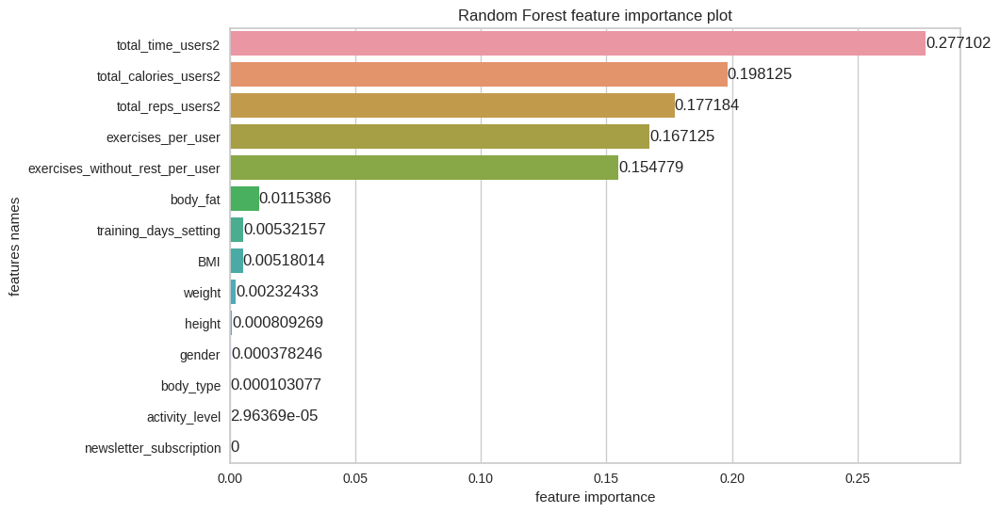

[Random Forest] Best parameters are {'criterion': 'gini', 'max_depth': 3, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- AdaBoost
[AdaBoost] Features importances: [0.0, 0.0, 0.0, 0.0, 0.0, 5.594856275073519e-05, 0.0, 0.0, 0.2429283983593254, 0.5792278514949788, 0.07160678739070639, 0.03646198395316135, 0.04859407995052638, 0.02112495028855099]


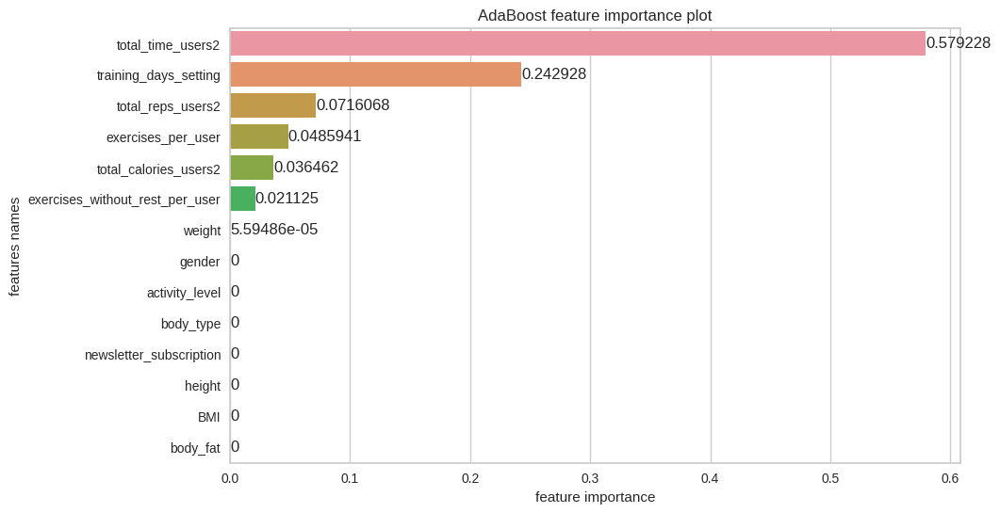

[AdaBoost] Best parameters are {'base_estimator': DecisionTreeClassifier(max_depth=3), 'learning_rate': 0.01, 'n_estimators': 40, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- GradientBoost
[GradientBoost] Features importances: [0.012178215024661543, 0.0, 0.0, 0.0, 0.0, 0.0, 0.017938169000977635, 0.0, 0.0, 0.278278040156829, 0.00094546511651463, 0.2134835730163875, 0.2666352203932169, 0.21054131729141276]


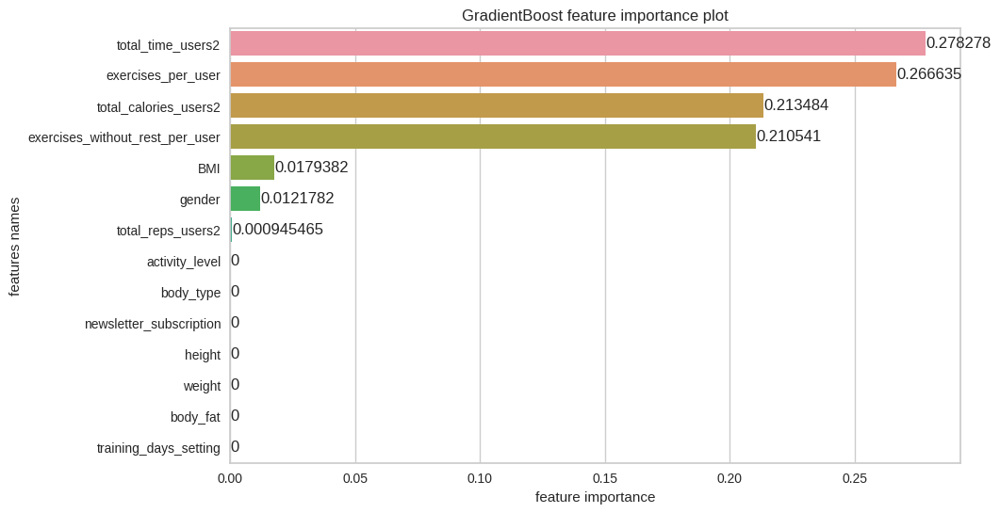

[GradientBoost] Best parameters are {'criterion': 'friedman_mse', 'learning_rate': 0.01, 'loss': 'deviance', 'max_depth': 3, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'n_estimators': 5, 'random_state': 42, 'subsample': 0.5}


In [143]:
estimators_multiclass_12_weeks_sel, X_test_12_weeks_sel, y_test_12_weeks_sel, X_train_12_weeks_sel, y_train_12_weeks_sel, X_test_inv_12_weeks_sel, features_12_weeks_sel = train(X_adh_12_weeks, y_adh_12_weeks, 
                                                         grid_params_multiclass, 
                                                         seed)

evaluation_table_12_weeks_sel = evaluate_multiclass(estimators_multiclass_12_weeks_sel, X_test_12_weeks_sel, y_test_12_weeks_sel, no_of_labels = 2, features_selected = False, features = features_12_weeks_sel)


In [144]:
evaluation_table_12_weeks_sel

,Overall Accuracy,Balanced Accuracy,Adj Balanced Accuracy,Precision,Recall,Cohen's kappa,Mathews Correlation Coefficient
SGD,0.91,0.75,0.50,0.61,0.54,0.52,0.53
Logistic Regression,0.92,0.71,0.42,0.72,0.44,0.50,0.52
Decision Tree,0.92,0.75,0.50,0.67,0.53,0.55,0.55
Random Forest,0.88,0.50,0.00,0.00,0.00,0.00,0.00
AdaBoost,0.92,0.73,0.46,0.76,0.48,0.54,0.56
GradientBoost,0.88,0.50,0.00,0.00,0.00,0.00,0.00


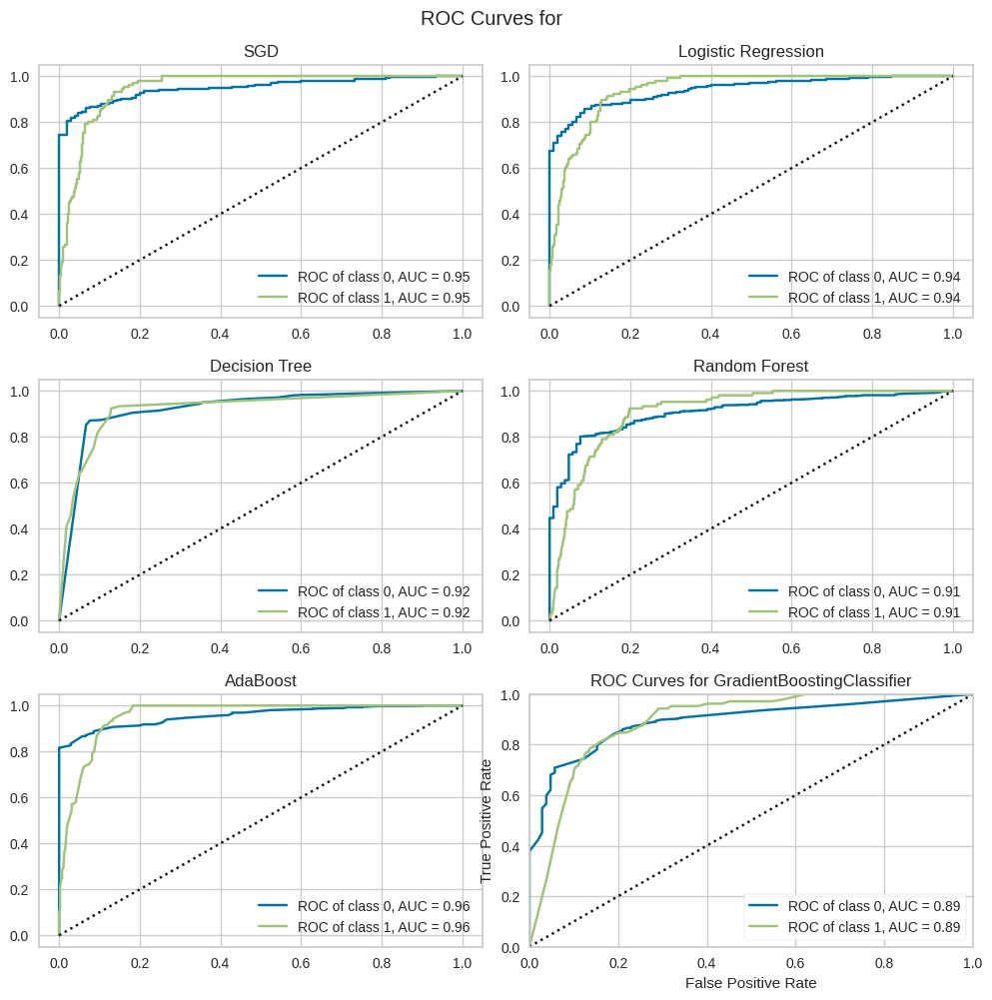

<AxesSubplot: title={'center': 'ROC Curves for GradientBoostingClassifier'}, xlabel='False Positive Rate', ylabel='True Positive Rate'>

In [145]:
ROC_curves(estimators_multiclass_12_weeks_sel, X_train_12_weeks_sel, y_train_12_weeks_sel, X_test_12_weeks_sel, y_test_12_weeks_sel, np.unique(y_adh_12_weeks), name = 'all', features_selected = False, features = features_12_weeks_sel)


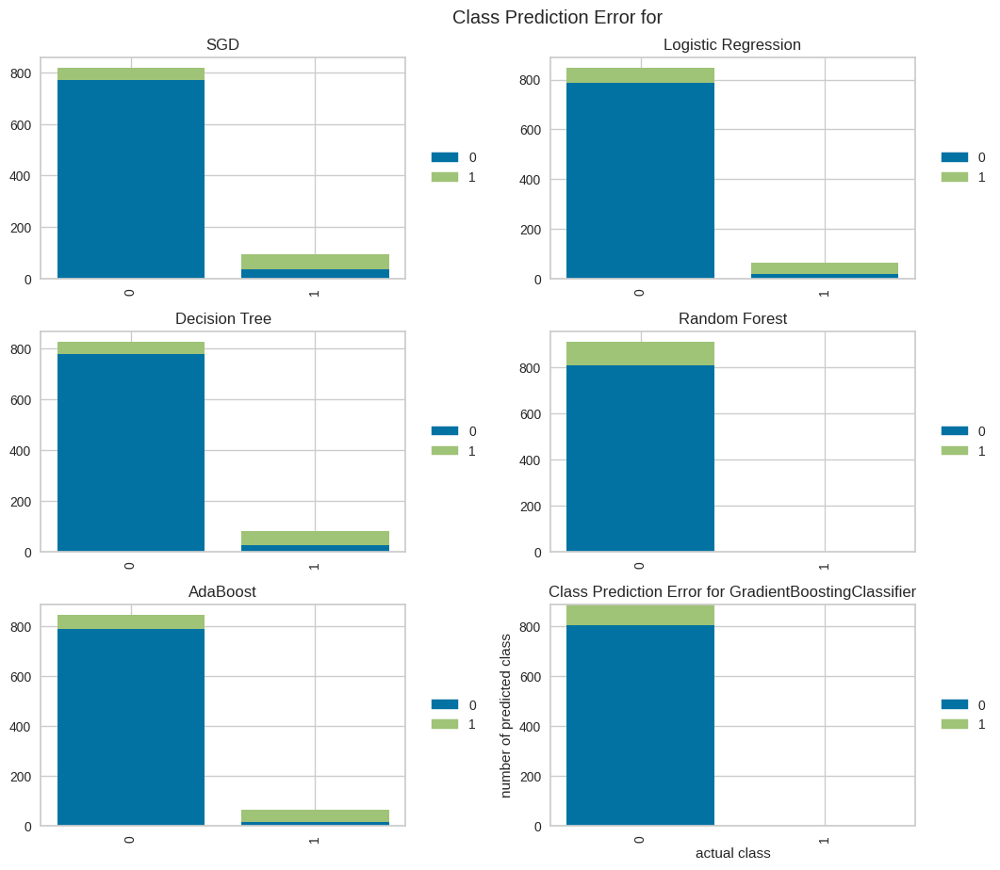

<AxesSubplot: title={'center': 'Class Prediction Error for GradientBoostingClassifier'}, xlabel='actual class', ylabel='number of predicted class'>

In [146]:
prediction_error_plot(estimators_multiclass_12_weeks_sel, X_train_12_weeks_sel, y_train_12_weeks_sel, X_test_12_weeks_sel, y_test_12_weeks_sel, np.unique(y_adh_12_weeks), name = 'all', features_selected = False, features = features_12_weeks_sel)


#### With feature selection (by Recursive feature elimination with cross-validation - RFECV)

[INFO] Performing Grid-Search CV ---- SGD
[SGD] Features importances: [0.05696727 0.06164072 0.08152628 0.05476902 0.09116435 0.13894451
 0.10033766 0.10939338 1.07496225 1.37811167 1.13243682 0.67743439
 0.45726447 0.42020546]


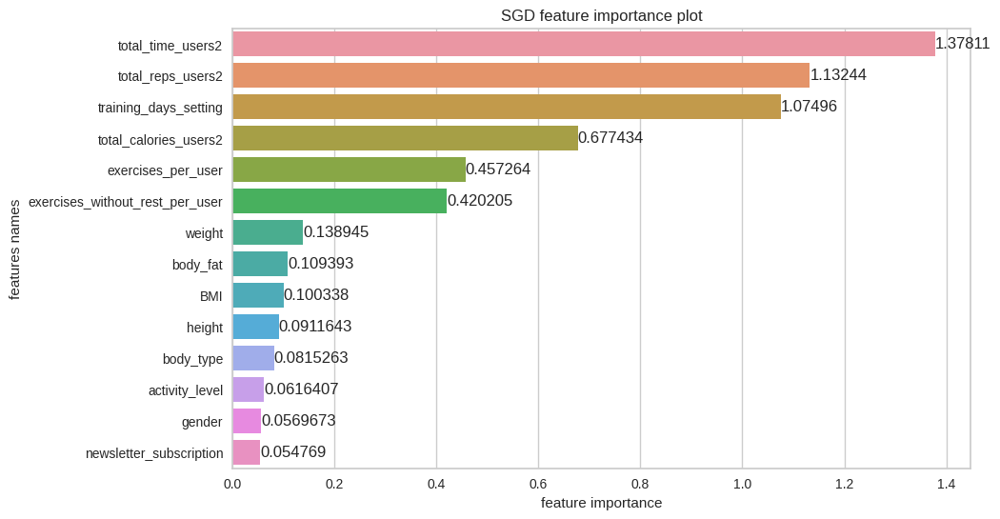

[SGD] Best parameters are {'alpha': 0.001, 'eta0': 0.0001, 'learning_rate': 'optimal', 'penalty': 'l2', 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Logistic Regression
[Logistic Regression] Features importances: [0.00804282 0.13063987 0.02819382 0.05988055 0.04606015 0.0118953
 0.02162225 0.03069334 1.86002656 2.53643544 1.71181441 1.4474463
 1.41393977 2.20398547]


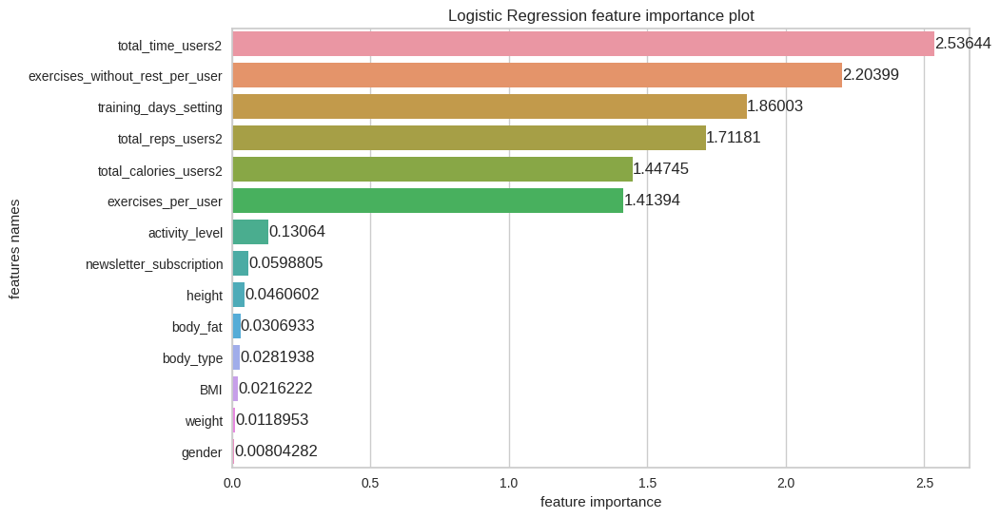

[Logistic Regression] Best parameters are {'C': 4, 'penalty': 'l2', 'random_state': 42, 'solver': 'liblinear'}
[INFO] Performing Grid-Search CV ---- Decision Tree
[Decision Tree] Features importances: [0.0, 0.0, 0.01050896525664478, 0.009910850440382377, 0.011203325056626112, 0.009355575681292427, 0.005747750497139096, 0.0, 0.23473334031006096, 0.4698495456466012, 0.13178411047944036, 0.053772240921561264, 0.0509006833831608, 0.01223361232709073]


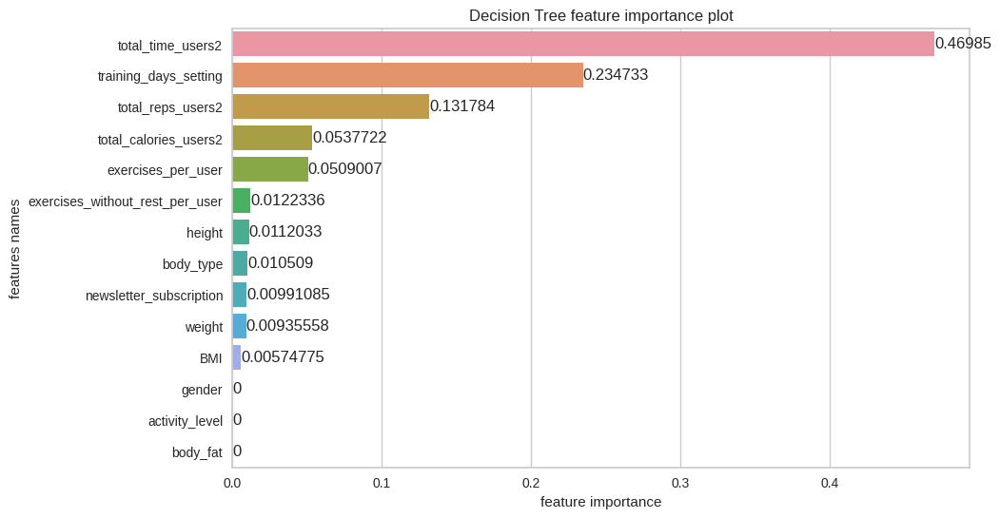

[Decision Tree] Best parameters are {'criterion': 'entropy', 'max_depth': 6, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Random Forest
[Random Forest] Features importances: [0.0003782457245386539, 2.963692327849843e-05, 0.0001030766005617703, 0.0, 0.0008092689474653977, 0.0023243290671708925, 0.005180142114423465, 0.011538579392805847, 0.005321565866418364, 0.27710248955071026, 0.17718372101972632, 0.1981254448027449, 0.1671246797568063, 0.1547788202333493]


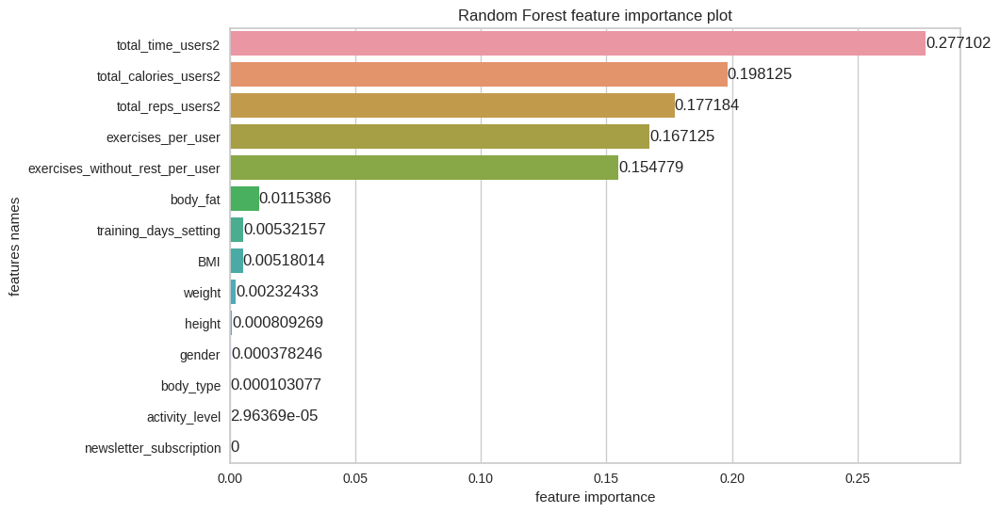

[Random Forest] Best parameters are {'criterion': 'gini', 'max_depth': 3, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- AdaBoost
[AdaBoost] Features importances: [0.0, 0.0, 0.0, 0.0, 0.0, 5.594856275073519e-05, 0.0, 0.0, 0.2429283983593254, 0.5792278514949788, 0.07160678739070639, 0.03646198395316135, 0.04859407995052638, 0.02112495028855099]


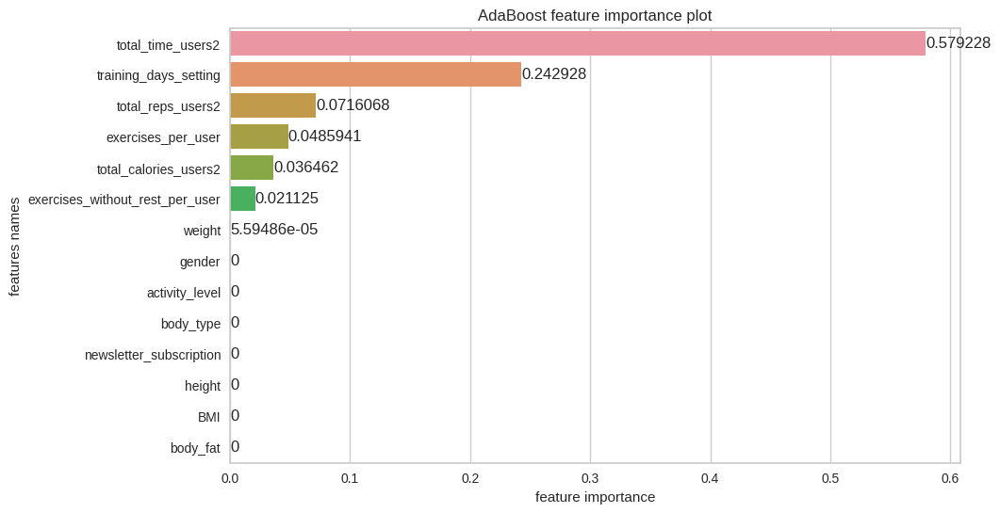

[AdaBoost] Best parameters are {'base_estimator': DecisionTreeClassifier(max_depth=3), 'learning_rate': 0.01, 'n_estimators': 40, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- GradientBoost
[GradientBoost] Features importances: [0.012178215024661543, 0.0, 0.0, 0.0, 0.0, 0.0, 0.017938169000977635, 0.0, 0.0, 0.278278040156829, 0.00094546511651463, 0.2134835730163875, 0.2666352203932169, 0.21054131729141276]


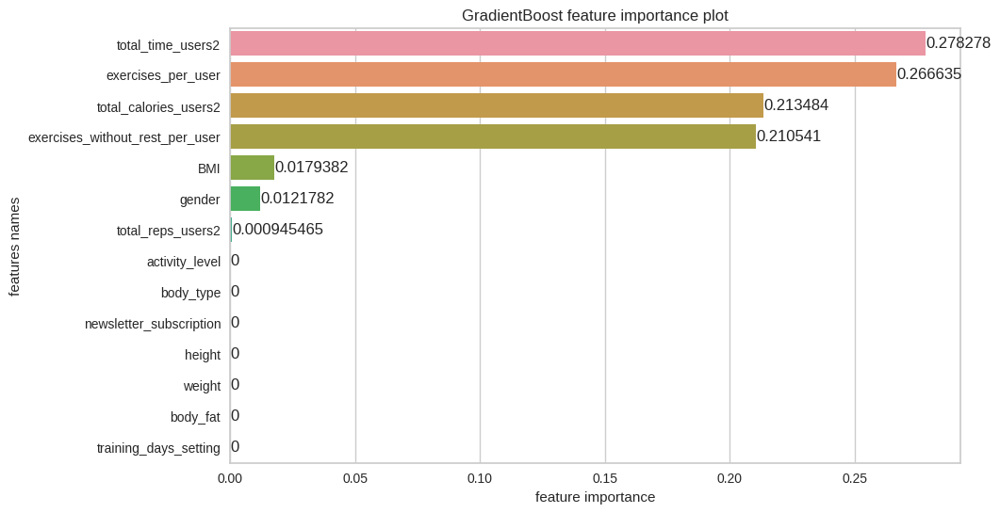

[GradientBoost] Best parameters are {'criterion': 'friedman_mse', 'learning_rate': 0.01, 'loss': 'deviance', 'max_depth': 3, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'n_estimators': 5, 'random_state': 42, 'subsample': 0.5}


In [147]:
estimators_multiclass_12_weeks_rfecv, X_test_12_weeks_rfecv, y_test_12_weeks_rfecv, X_train_12_weeks_rfecv, y_train_12_weeks_rfecv, X_test_inv_12_weeks_rfecv, features_12_weeks_rfecv = train(X_adh_12_weeks, y_adh_12_weeks, 
                                                         grid_params_multiclass, 
                                                         seed)

evaluation_table_12_weeks_rfecv = evaluate_multiclass(estimators_multiclass_12_weeks_rfecv, X_test_12_weeks_rfecv, y_test_12_weeks_rfecv, no_of_labels = 2, features_selected = False, features = features_12_weeks_rfecv)


In [148]:
evaluation_table_12_weeks_rfecv

,Overall Accuracy,Balanced Accuracy,Adj Balanced Accuracy,Precision,Recall,Cohen's kappa,Mathews Correlation Coefficient
SGD,0.91,0.75,0.50,0.61,0.54,0.52,0.53
Logistic Regression,0.92,0.71,0.42,0.72,0.44,0.50,0.52
Decision Tree,0.92,0.75,0.50,0.67,0.53,0.55,0.55
Random Forest,0.88,0.50,0.00,0.00,0.00,0.00,0.00
AdaBoost,0.92,0.73,0.46,0.76,0.48,0.54,0.56
GradientBoost,0.88,0.50,0.00,0.00,0.00,0.00,0.00


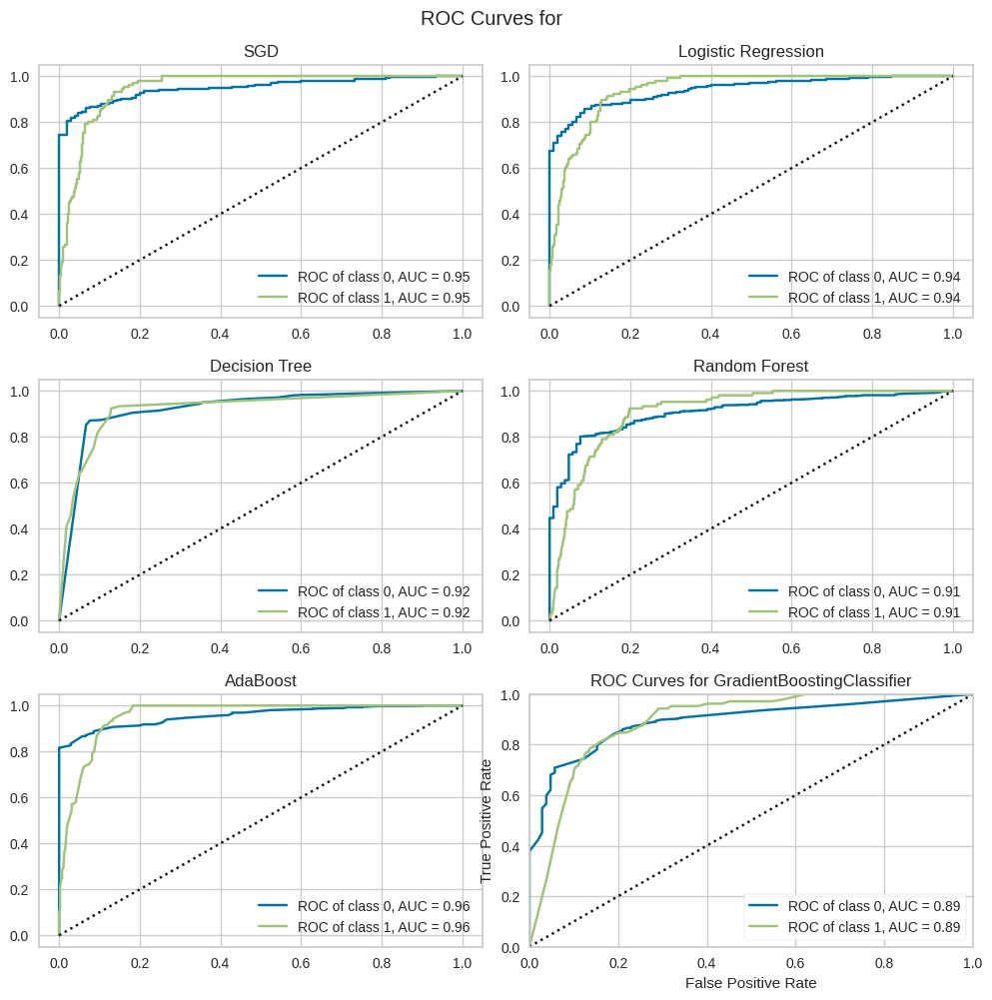

<AxesSubplot: title={'center': 'ROC Curves for GradientBoostingClassifier'}, xlabel='False Positive Rate', ylabel='True Positive Rate'>

In [149]:
ROC_curves(estimators_multiclass_12_weeks_rfecv, X_train_12_weeks_rfecv, y_train_12_weeks_rfecv, X_test_12_weeks_rfecv, y_test_12_weeks_rfecv, np.unique(y_adh_12_weeks), name = 'all', features_selected = False, features = features_12_weeks_rfecv)

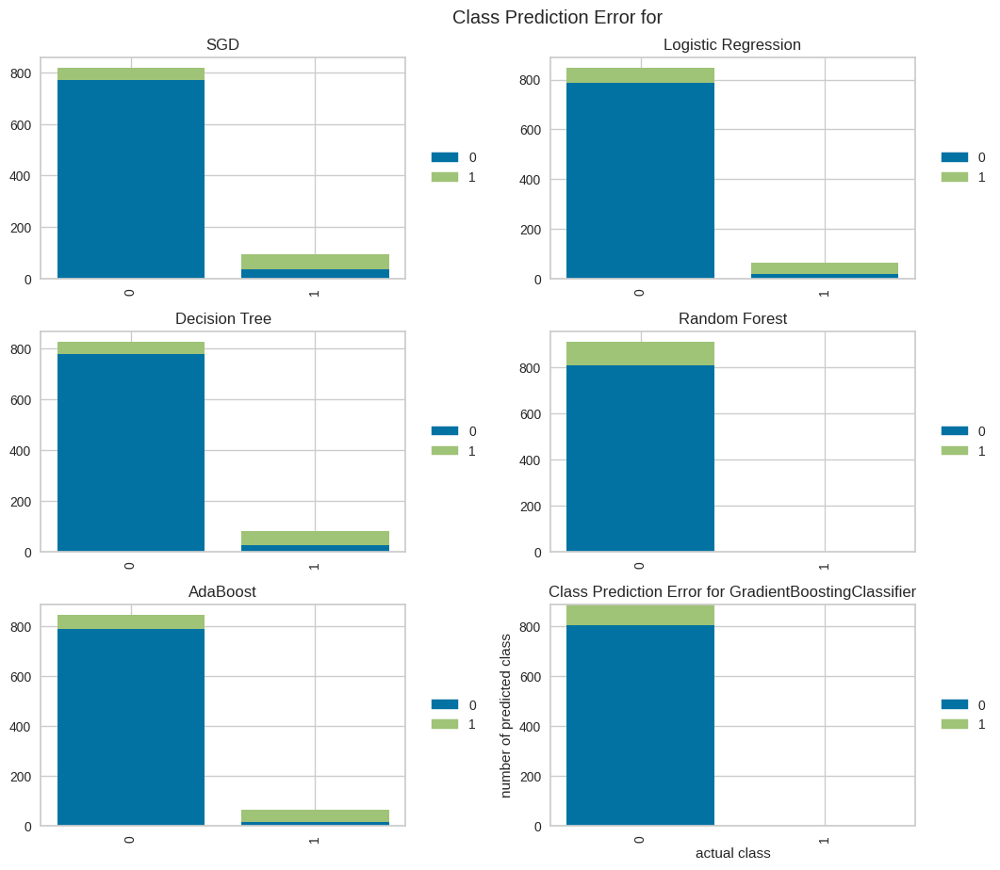

<AxesSubplot: title={'center': 'Class Prediction Error for GradientBoostingClassifier'}, xlabel='actual class', ylabel='number of predicted class'>

In [150]:
prediction_error_plot(estimators_multiclass_12_weeks_rfecv, X_train_12_weeks_rfecv, y_train_12_weeks_rfecv, X_test_12_weeks_rfecv, y_test_12_weeks_rfecv, np.unique(y_adh_12_weeks), name = 'all', features_selected = False, features = features_12_weeks_rfecv)

#### With feature selection (by SelectFromModel)

[INFO] Performing Grid-Search CV ---- SGD
[SGD] Features importances: [0.05696727 0.06164072 0.08152628 0.05476902 0.09116435 0.13894451
 0.10033766 0.10939338 1.07496225 1.37811167 1.13243682 0.67743439
 0.45726447 0.42020546]


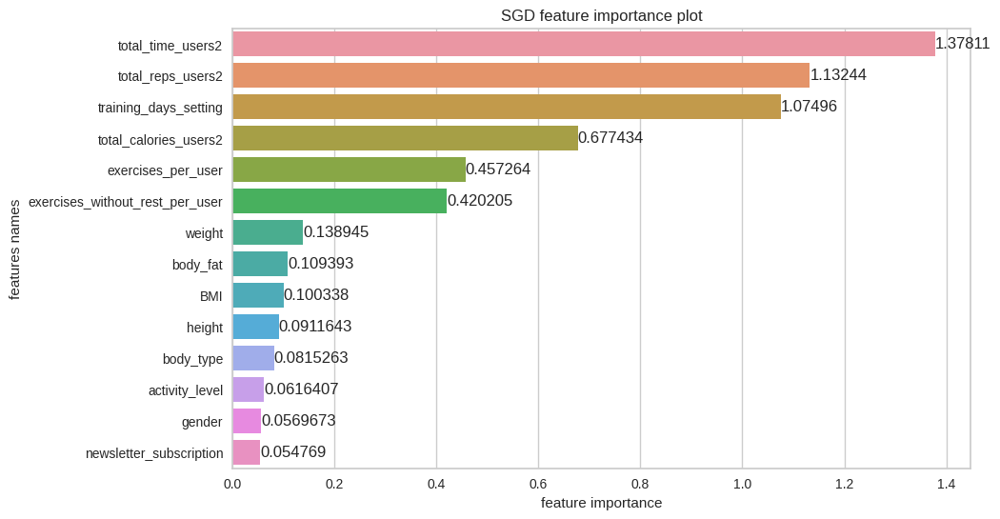

[SGD] Best parameters are {'alpha': 0.001, 'eta0': 0.0001, 'learning_rate': 'optimal', 'penalty': 'l2', 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Logistic Regression
[Logistic Regression] Features importances: [0.00804282 0.13063987 0.02819382 0.05988055 0.04606015 0.0118953
 0.02162225 0.03069334 1.86002656 2.53643544 1.71181441 1.4474463
 1.41393977 2.20398547]


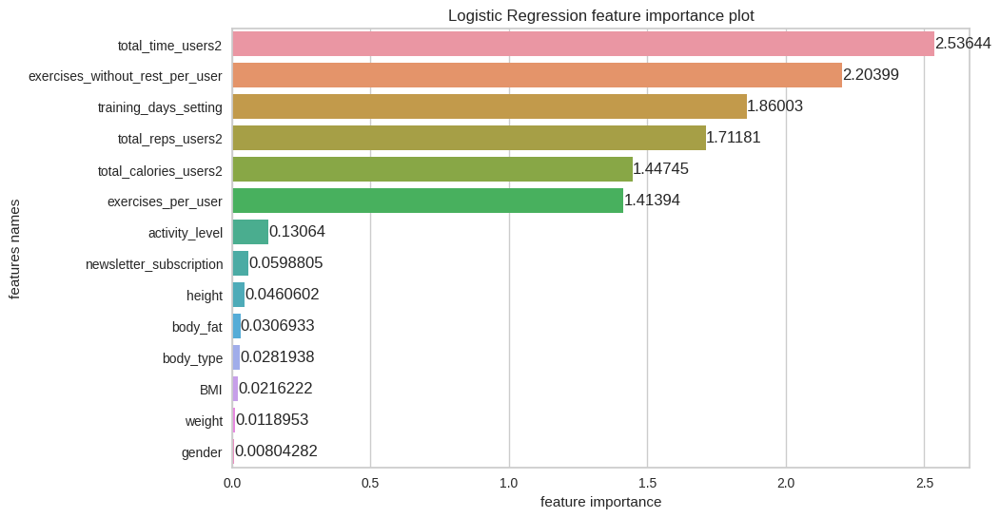

[Logistic Regression] Best parameters are {'C': 4, 'penalty': 'l2', 'random_state': 42, 'solver': 'liblinear'}
[INFO] Performing Grid-Search CV ---- Decision Tree
[Decision Tree] Features importances: [0.0, 0.0, 0.01050896525664478, 0.009910850440382377, 0.011203325056626112, 0.009355575681292427, 0.005747750497139096, 0.0, 0.23473334031006096, 0.4698495456466012, 0.13178411047944036, 0.053772240921561264, 0.0509006833831608, 0.01223361232709073]


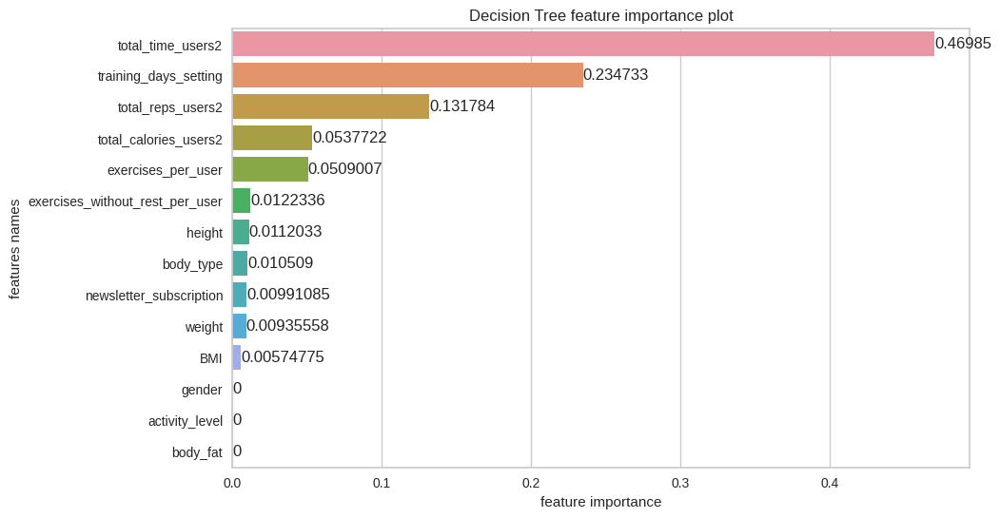

[Decision Tree] Best parameters are {'criterion': 'entropy', 'max_depth': 6, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Random Forest
[Random Forest] Features importances: [0.0003782457245386539, 2.963692327849843e-05, 0.0001030766005617703, 0.0, 0.0008092689474653977, 0.0023243290671708925, 0.005180142114423465, 0.011538579392805847, 0.005321565866418364, 0.27710248955071026, 0.17718372101972632, 0.1981254448027449, 0.1671246797568063, 0.1547788202333493]


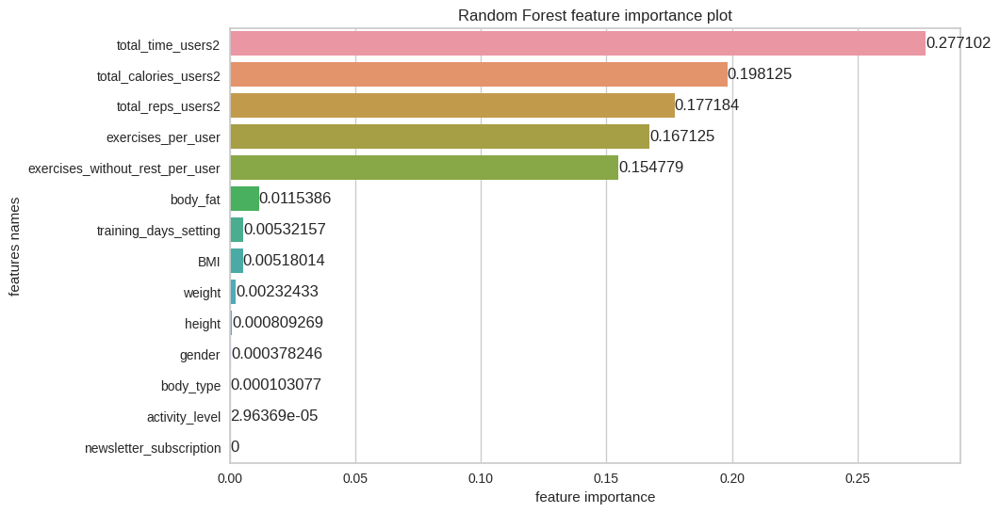

[Random Forest] Best parameters are {'criterion': 'gini', 'max_depth': 3, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- AdaBoost
[AdaBoost] Features importances: [0.0, 0.0, 0.0, 0.0, 0.0, 5.594856275073519e-05, 0.0, 0.0, 0.2429283983593254, 0.5792278514949788, 0.07160678739070639, 0.03646198395316135, 0.04859407995052638, 0.02112495028855099]


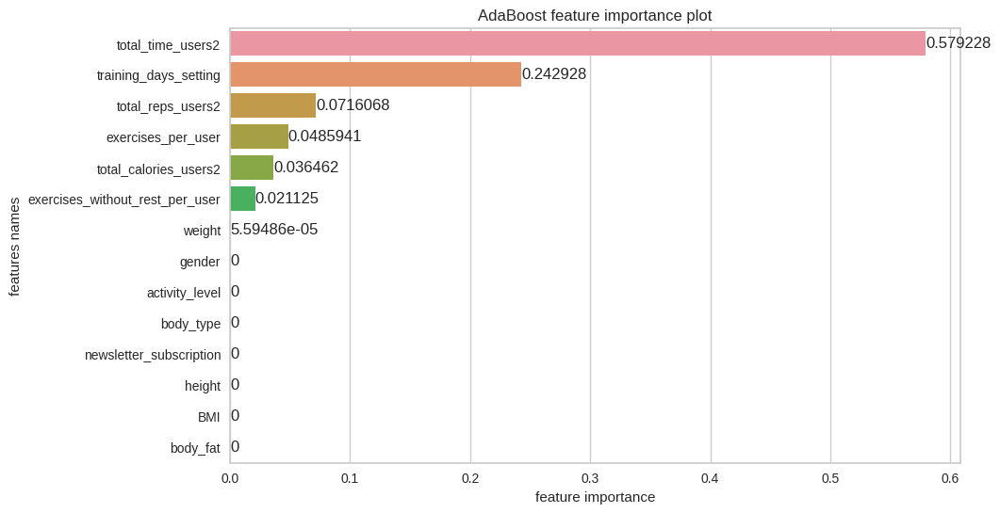

[AdaBoost] Best parameters are {'base_estimator': DecisionTreeClassifier(max_depth=3), 'learning_rate': 0.01, 'n_estimators': 40, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- GradientBoost
[GradientBoost] Features importances: [0.012178215024661543, 0.0, 0.0, 0.0, 0.0, 0.0, 0.017938169000977635, 0.0, 0.0, 0.278278040156829, 0.00094546511651463, 0.2134835730163875, 0.2666352203932169, 0.21054131729141276]


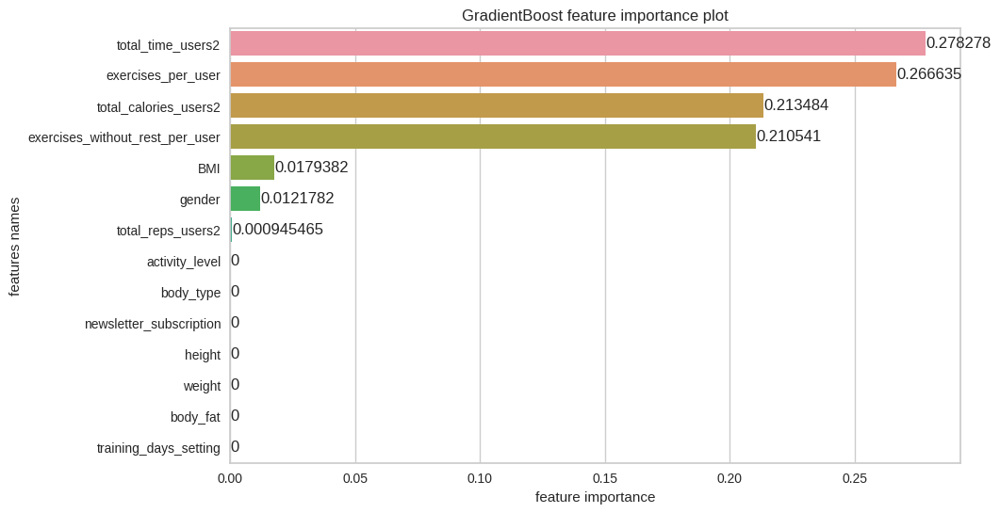

[GradientBoost] Best parameters are {'criterion': 'friedman_mse', 'learning_rate': 0.01, 'loss': 'deviance', 'max_depth': 3, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'n_estimators': 5, 'random_state': 42, 'subsample': 0.5}


In [151]:
estimators_multiclass_12_weeks_sfm, X_test_12_weeks_sfm, y_test_12_weeks_sfm, X_train_12_weeks_sfm, y_train_12_weeks_sfm, X_test_inv_12_weeks_sfm, features_12_weeks_sfm = train(X_adh_12_weeks, y_adh_12_weeks, 
                                                         grid_params_multiclass, 
                                                         seed)

In [152]:
evaluation_table_12_weeks_sfm = evaluate_multiclass(estimators_multiclass_12_weeks_sfm, X_test_12_weeks_sfm, y_test_12_weeks_sfm, no_of_labels = 2, features_selected = False, features = features_12_weeks_sfm)

In [153]:
evaluation_table_12_weeks_sfm

,Overall Accuracy,Balanced Accuracy,Adj Balanced Accuracy,Precision,Recall,Cohen's kappa,Mathews Correlation Coefficient
SGD,0.91,0.75,0.50,0.61,0.54,0.52,0.53
Logistic Regression,0.92,0.71,0.42,0.72,0.44,0.50,0.52
Decision Tree,0.92,0.75,0.50,0.67,0.53,0.55,0.55
Random Forest,0.88,0.50,0.00,0.00,0.00,0.00,0.00
AdaBoost,0.92,0.73,0.46,0.76,0.48,0.54,0.56
GradientBoost,0.88,0.50,0.00,0.00,0.00,0.00,0.00


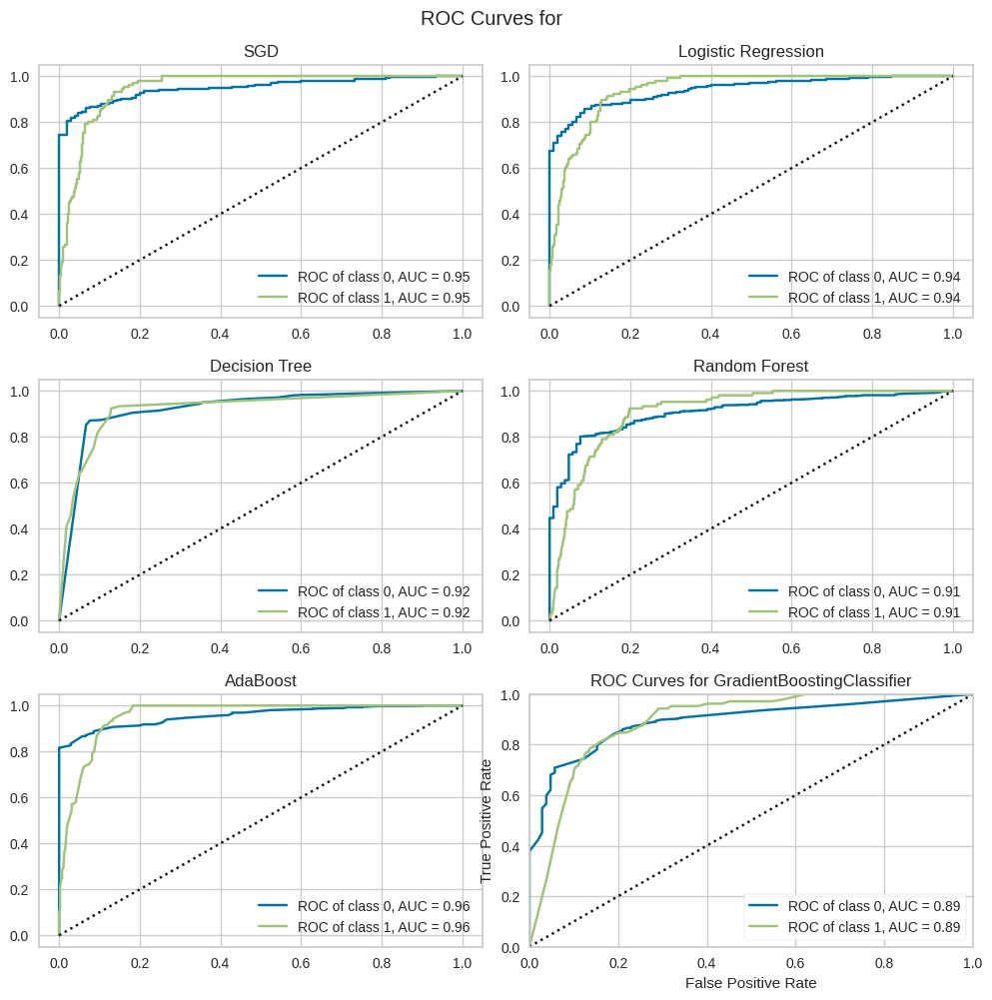

<AxesSubplot: title={'center': 'ROC Curves for GradientBoostingClassifier'}, xlabel='False Positive Rate', ylabel='True Positive Rate'>

In [154]:
ROC_curves(estimators_multiclass_12_weeks_sfm, X_train_12_weeks_sfm, y_train_12_weeks_sfm, X_test_12_weeks_sfm, y_test_12_weeks_sfm, np.unique(y_adh_12_weeks), name = 'all', features_selected = False, features = features_12_weeks_sfm)

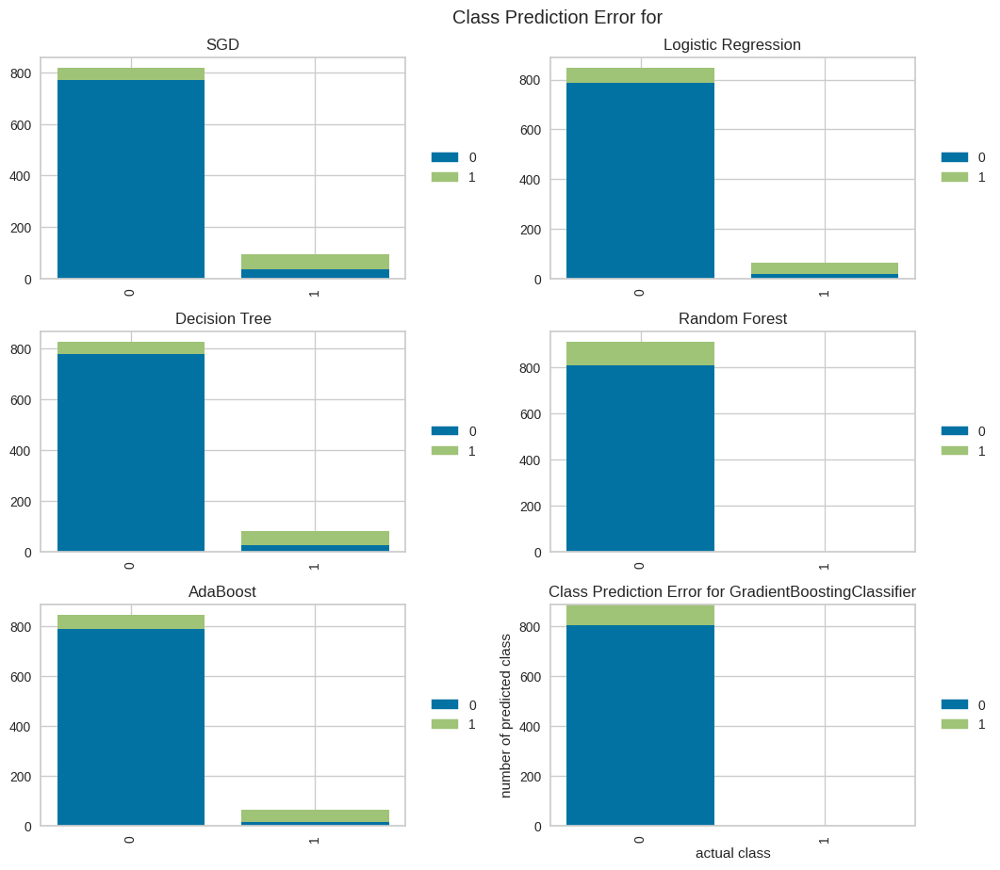

<AxesSubplot: title={'center': 'Class Prediction Error for GradientBoostingClassifier'}, xlabel='actual class', ylabel='number of predicted class'>

In [155]:
prediction_error_plot(estimators_multiclass_12_weeks_sfm, X_train_12_weeks_sfm, y_train_12_weeks_sfm, X_test_12_weeks_sfm, y_test_12_weeks_sfm, np.unique(y_adh_12_weeks), name = 'all', features_selected = False, features = features_12_weeks_sfm)

### Sixth approach (3 groups, training days goal achieved / number of weeks when any training was done)

In this approach, we take into consideration sum of the weeks when the goal was achieved divided by number of weeks when the training was done.

It is in range from 0 to 1. It can be split into groups:

* Group 0 - when the adherence is higher or equal to 0.5 (556 users),
* Group 1 - when the adherence is between 0.5 and 0.1 (605 users),
* Group 2 - when the adherence is lower than 0.1 (1873 users).

Variables taken into consideration are:
* gender,
* height,
* weight,
* BMI,
* activity level,
* body type,
* newsletter subscription,
* body fat,
* training days setting,
* total time users,
* total reps users,
* total calories users,
* exercises per user,
* exercises without rest per user.

In [156]:
# 3 groups, training days achieved/number of weeks when workouts were done

df_sess_exe_adh2 = df_session_exe_days_setting.groupby(['id_users'])['training_days_goal_achieved'].agg(['sum', 'count']).reset_index()

df_sess_exe_adh2.rename(columns={'sum': 'sum_of_weeks_goal_achieved',
                                 'count': 'no_all_weeks'},
                       inplace = True)

df_sess_exe_adh2['Adh_num'] = df_sess_exe_adh2['sum_of_weeks_goal_achieved']/df_sess_exe_adh2['no_all_weeks']

df_sess_adh2 = df_users.merge(df_sess_exe_adh2, how = 'left', left_on = 'id_users', right_on = 'id_users')

df_sess_adh2['Adh_cat'] = np.where((df_sess_adh2['Adh_num'] >= 0.5) == True,
                                                   0,
                                                   np.where(((df_sess_adh2['Adh_num'] >= 0.1) == True) & (df_sess_adh2['Adh_num'] < 0.5),
                                                   1,
                                                   2))

df_sess_adh2.drop(['id_users', 'sum_of_weeks_goal_achieved', 'no_all_weeks', 'Adh_num'], axis = 1, inplace = True)


In [157]:
# numbers of users

k = 0
for i in range(len(df_sess_exe_adh2)):
    if (df_sess_exe_adh2['Adh_num'][i] >= 0.5) == True:
        k += 1
        
print('Number of users that should be in group 0: {}'.format(k))

j = 0
for i in range(len(df_sess_exe_adh2)):
    if ((df_sess_exe_adh2['Adh_num'][i] < 0.5) == True) & ((df_sess_exe_adh2['Adh_num'][i] >= 0.1) == True):
        j += 1
        
print('Number of users that should be in group 1: {}'.format(j))

l = 0
for i in range(len(df_sess_exe_adh2)):
    if (df_sess_exe_adh2['Adh_num'][i] < 0.1) == True:
        l += 1
        
print('Number of users that should be in group 2: {}'.format(l))

Number of users that should be in group 0: 556
Number of users that should be in group 1: 605
Number of users that should be in group 2: 1873


In [158]:
# deleting label from data
X_adh_cat_six = df_sess_adh2.loc[:, df_sess_adh2.columns != 'Adh_cat']

# variable only with label
y_adh_cat_six = df_sess_adh2['Adh_cat'].to_numpy()


for col in ['gender', 'body_type', 'newsletter_subscription', 'activity_level', 'training_days_setting']:
    X_adh_cat_six[col] = LabelEncoder().fit_transform(X_adh_cat_six[col])

y_adh_cat_si = pd.DataFrame(y_adh_cat_six, columns = ['Adherence category'])

[INFO] Performing Grid-Search CV ---- SGD
[SGD] Features importances: [0.         0.         0.         0.20525585 0.         0.10532735
 0.58017041 0.30706072 2.80190265 1.89848383 2.26033169 0.48368484
 1.83483959 0.71083969]


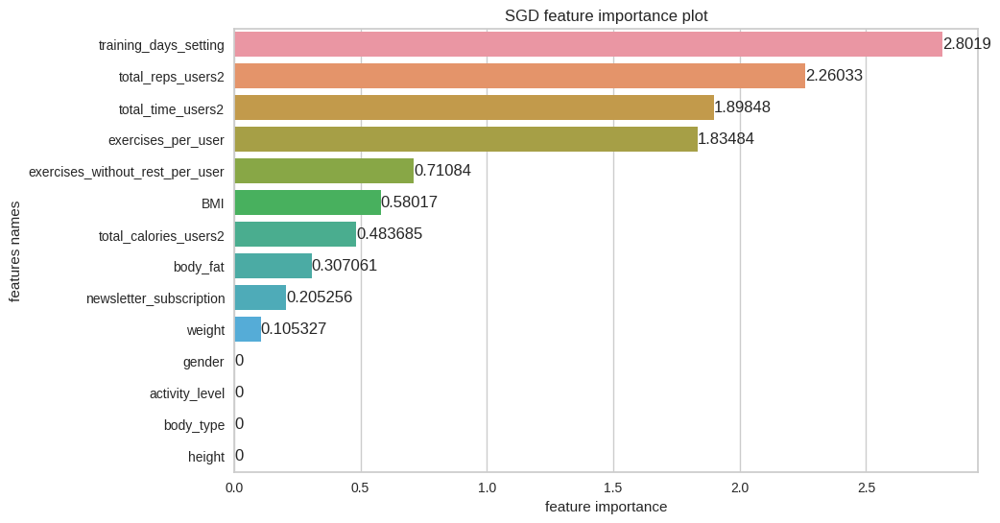

[SGD] Best parameters are {'alpha': 0.0007525, 'eta0': 0.0001, 'learning_rate': 'optimal', 'penalty': 'elasticnet', 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Logistic Regression
[Logistic Regression] Features importances: [0.12801727 0.0707104  0.15492727 0.32349644 0.30842425 0.74489601
 0.92531954 0.52212949 3.87003516 3.66893161 2.84260935 1.239991
 3.64410253 2.41227148]


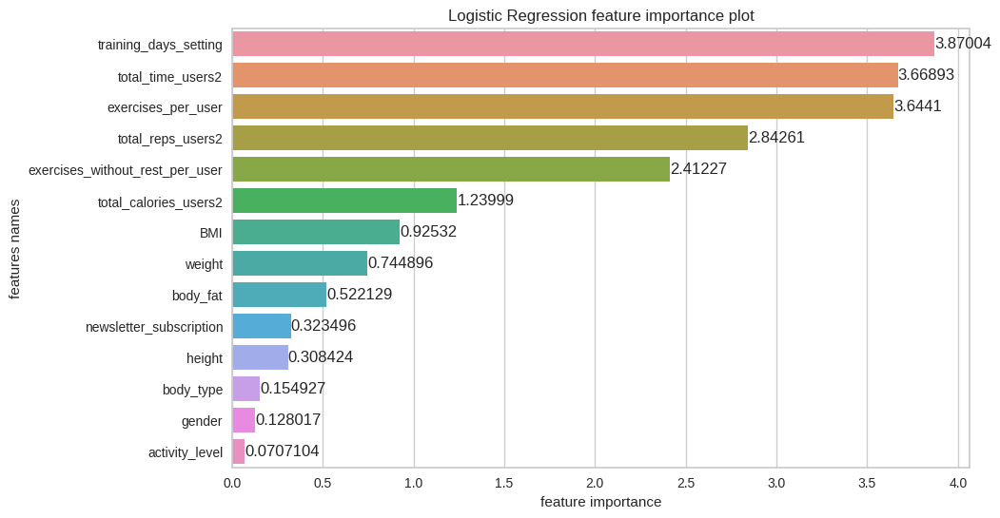

[Logistic Regression] Best parameters are {'C': 5, 'penalty': 'l1', 'random_state': 42, 'solver': 'liblinear'}
[INFO] Performing Grid-Search CV ---- Decision Tree
[Decision Tree] Features importances: [0.0, 0.00568141373505149, 0.0, 0.0, 0.0036110671864765793, 0.0, 0.010114163130101756, 0.00658735067095667, 0.3880191651090603, 0.08247038671072401, 0.45267818347046995, 0.026692127512933407, 0.02232515730761096, 0.0018209851666150171]


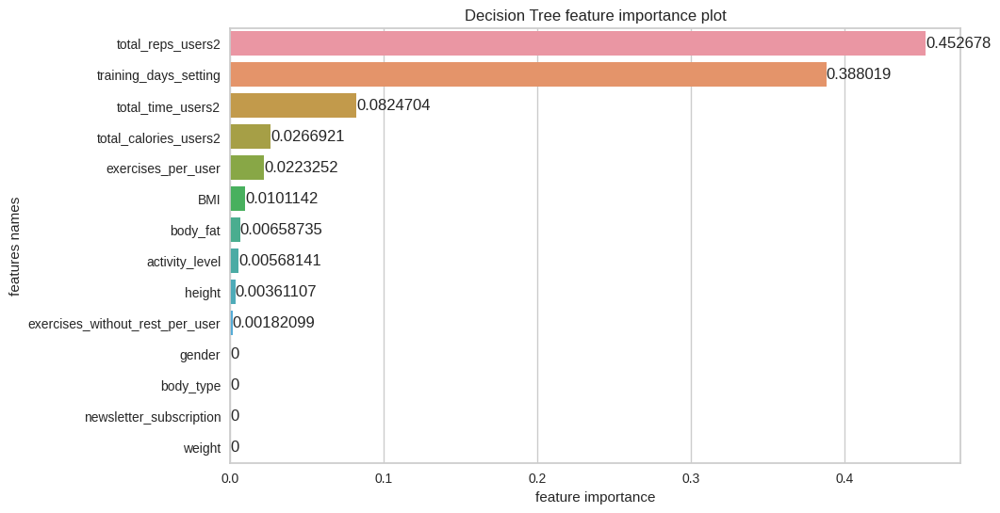

[Decision Tree] Best parameters are {'criterion': 'entropy', 'max_depth': 6, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Random Forest
[Random Forest] Features importances: [0.0020050755908156185, 0.0020343047862243263, 0.0005777557422008213, 0.0011749325752037285, 0.0014650720210197218, 0.0026446328909316406, 0.0030626510831367314, 0.0017626683372649898, 0.05813735150349077, 0.23801379232564604, 0.18342872426473228, 0.18171295332515525, 0.17014010029253218, 0.15383998526164594]


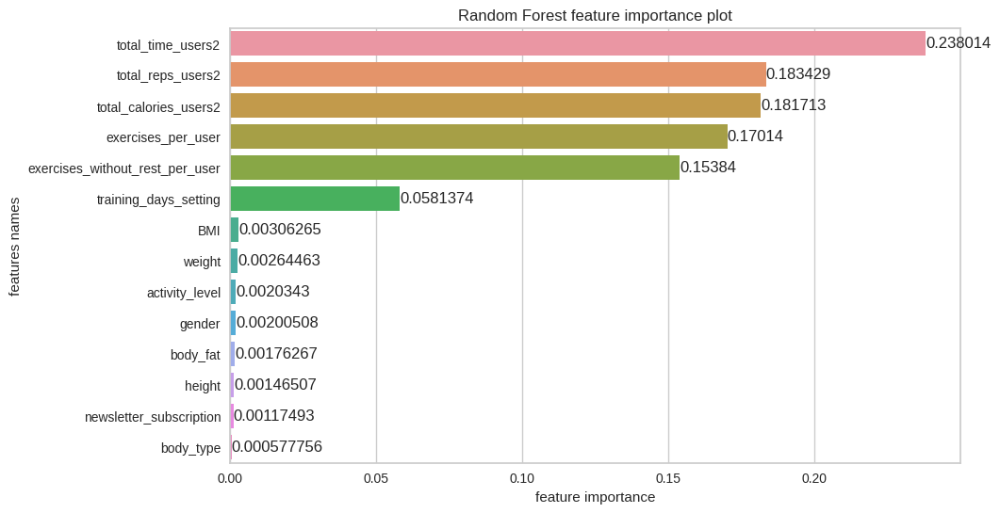

[Random Forest] Best parameters are {'criterion': 'gini', 'max_depth': 3, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- AdaBoost
[AdaBoost] Features importances: [0.0, 0.0038204847151979233, 0.0, 0.004160036082383579, 0.030044137775474208, 0.07469453757316988, 0.0714707334831773, 0.0657486957482751, 0.22931137713321137, 0.18369402631479032, 0.12035539093643396, 0.07566823512466443, 0.10890287433074954, 0.03212947078247236]


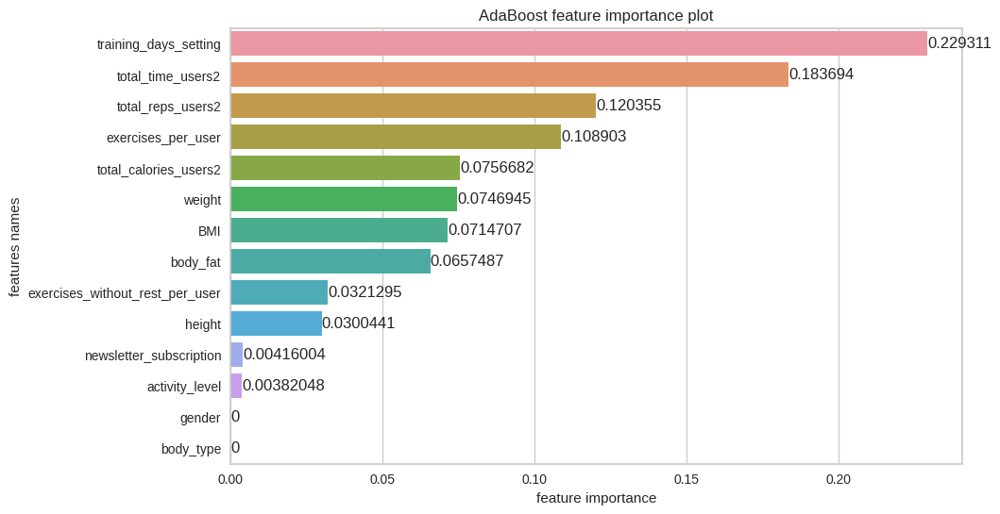

[AdaBoost] Best parameters are {'base_estimator': DecisionTreeClassifier(max_depth=2), 'learning_rate': 0.1, 'n_estimators': 60, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- GradientBoost
[GradientBoost] Features importances: [0.002658641847229997, 0.0, 0.0011997505414358463, 0.005082890457720244, 0.002251938721715361, 0.0009373169433599715, 0.00480327632937613, 0.00731514978624737, 0.2500672607237462, 0.20732437506341678, 0.20447763448899076, 0.09083417619386007, 0.10196338050960793, 0.12108420839329319]


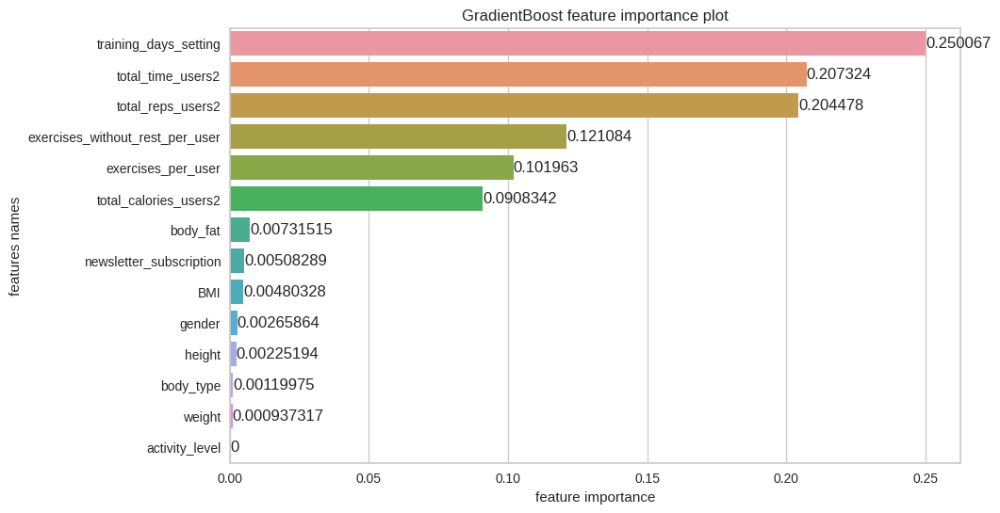

[GradientBoost] Best parameters are {'criterion': 'friedman_mse', 'learning_rate': 0.075, 'loss': 'deviance', 'max_depth': 3, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'n_estimators': 15, 'random_state': 42, 'subsample': 0.85}


In [159]:
estimators_multiclass_six, X_test_six, y_test_six, X_train_six, y_train_six, X_test_inv_six, features_six = train(X_adh_cat_six, y_adh_cat_six, 
                                                         grid_params_multiclass, 
                                                         seed)

evaluation_table_six = evaluate_multiclass(estimators_multiclass_six, X_test_six, y_test_six, no_of_labels = 3, features_selected = False, features = features_six)


In [160]:
evaluation_table_six

,Overall Accuracy,Balanced Accuracy,Adj Balanced Accuracy,Precision micro,Precision macro,Precision weighted,Recall micro,Recall macro,Recall weighted,Cohen's kappa,Mathews Correlation Coefficient
SGD,0.74,0.59,0.38,0.74,0.67,0.72,0.74,0.59,0.74,0.48,0.50
Logistic Regression,0.76,0.62,0.43,0.76,0.69,0.74,0.76,0.62,0.76,0.52,0.54
Decision Tree,0.77,0.66,0.49,0.77,0.75,0.78,0.77,0.66,0.77,0.56,0.56
Random Forest,0.69,0.52,0.28,0.69,0.42,0.57,0.69,0.52,0.69,0.37,0.40
AdaBoost,0.77,0.67,0.50,0.77,0.74,0.79,0.77,0.67,0.77,0.57,0.58
GradientBoost,0.68,0.46,0.19,0.68,0.61,0.65,0.68,0.46,0.68,0.28,0.33


The best algorithm here is AdaBoost with Decision Tree Classifier, with depth equal to 2, learning rate equal to 0.1 and number of estimators equal to 60. Overall accuracy is 77%, micro precision is 77%, macro precision is 74%, weighted precision is 79%, micro and weighted recall is 77% and weighted recall is 67%. Cohen's kappa is 0.57 and MCC is equal to 0.58. The ROC and AUC values are also good. Overall, those are good results.

In [161]:
prediction_for_one_user(estimators_multiclass_six, X_test_six, y_test_six, X_test_inv_six, X_adh_cat_six.columns, y_adh_cat_si.columns, name = 'AdaBoost')


,gender,activity_level,body_type,newsletter_subscription,height,weight,BMI,body_fat,training_days_setting,total_time_users2,total_reps_users2,total_calories_users2,exercises_per_user,exercises_without_rest_per_user,Adherence category,Adherence category_prediction
704,1.00,2.00,2.00,1.00,173.00,69.00,23.05,25.00,4.00,101319.50,24314.00,6432.39,116093.00,83513.00,1,1


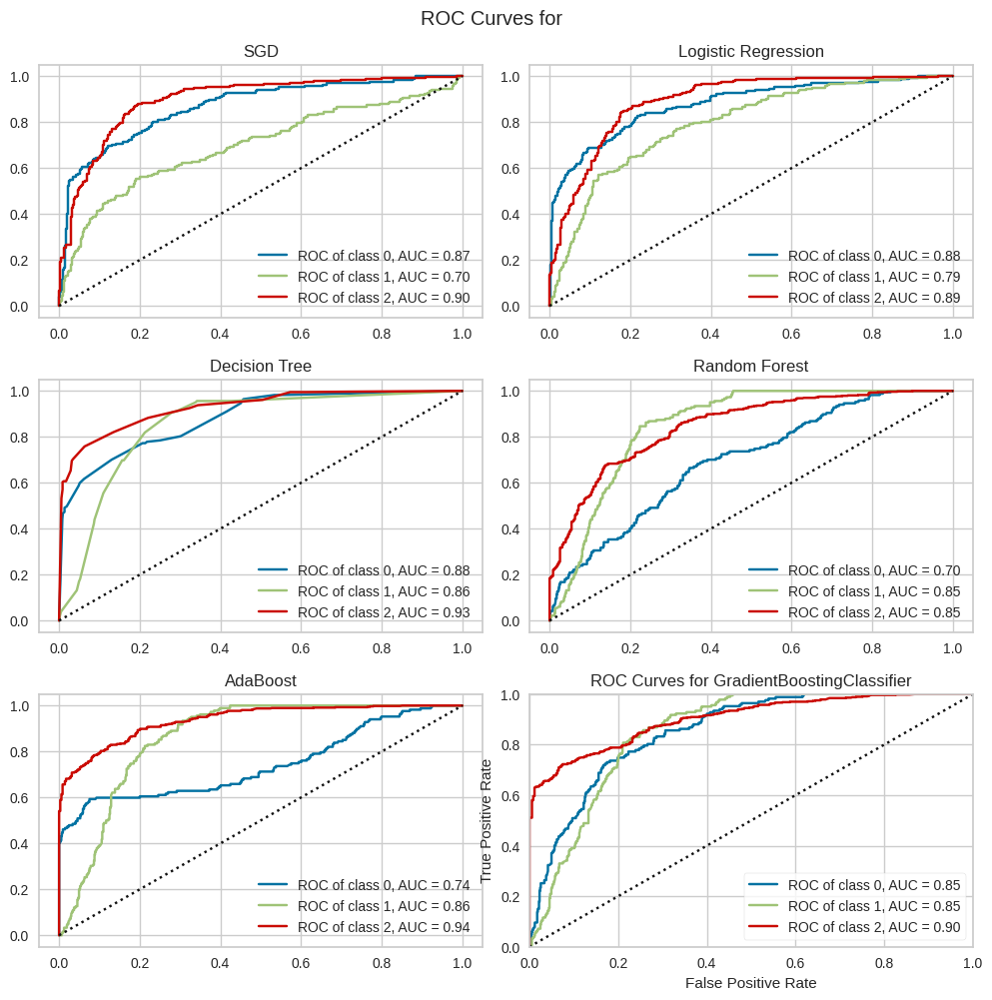

<AxesSubplot: title={'center': 'ROC Curves for GradientBoostingClassifier'}, xlabel='False Positive Rate', ylabel='True Positive Rate'>

In [162]:
ROC_curves(estimators_multiclass_six, X_train_six, y_train_six, X_test_six, y_test_six, np.unique(y_adh_cat_six), name = 'all', features_selected = False, features = features_six)


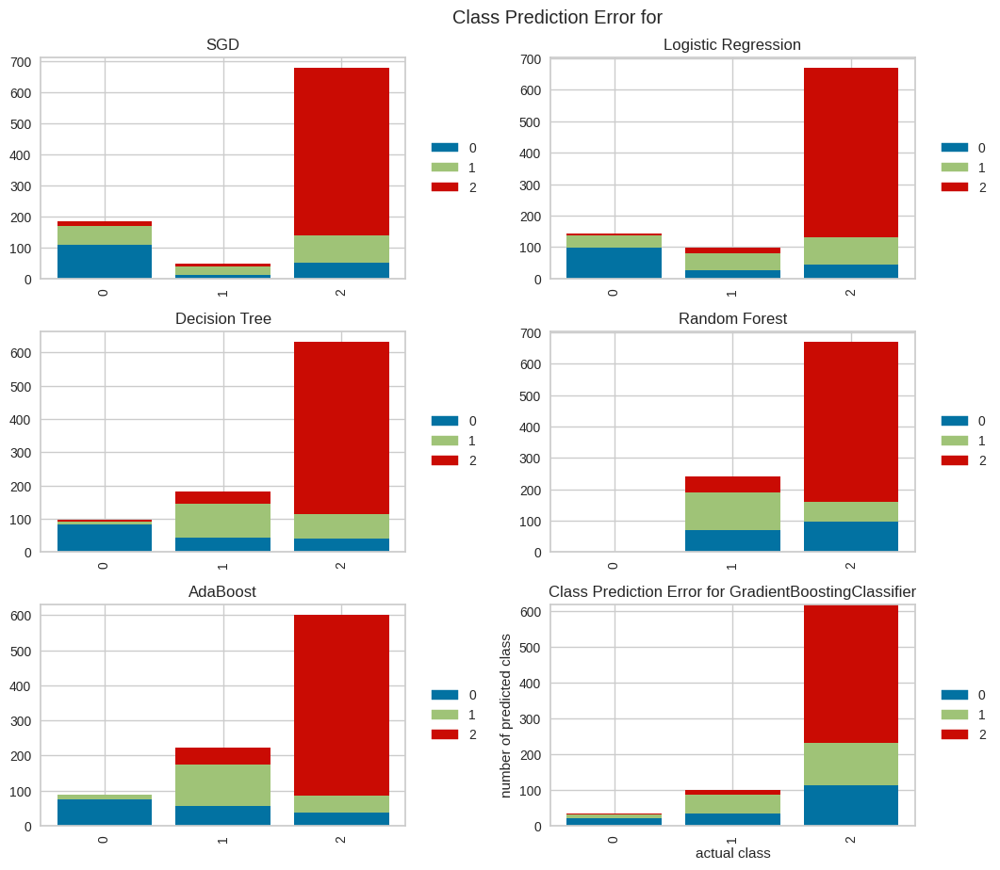

<AxesSubplot: title={'center': 'Class Prediction Error for GradientBoostingClassifier'}, xlabel='actual class', ylabel='number of predicted class'>

In [163]:
prediction_error_plot(estimators_multiclass_six, X_train_six, y_train_six, X_test_six, y_test_six, np.unique(y_adh_cat_six), name = 'all', features_selected = False, features = features_six)


#### With feature selection (by Univariate)

[INFO] Performing Grid-Search CV ---- SGD
[SGD] Features selected: Index(['gender', 'activity_level', 'newsletter_subscription', 'height',
       'weight', 'BMI', 'body_fat', 'training_days_setting',
       'total_time_users2', 'total_reps_users2', 'total_calories_users2',
       'exercises_per_user', 'exercises_without_rest_per_user'],
      dtype='object')
[SGD] Features importances: [0.02061077 0.04546704 0.08036943 0.02623221 0.02288208 0.08924071
 0.11828975 2.42792409 0.66488682 0.70325274 0.56362284 0.35459014
 0.3330765 ]


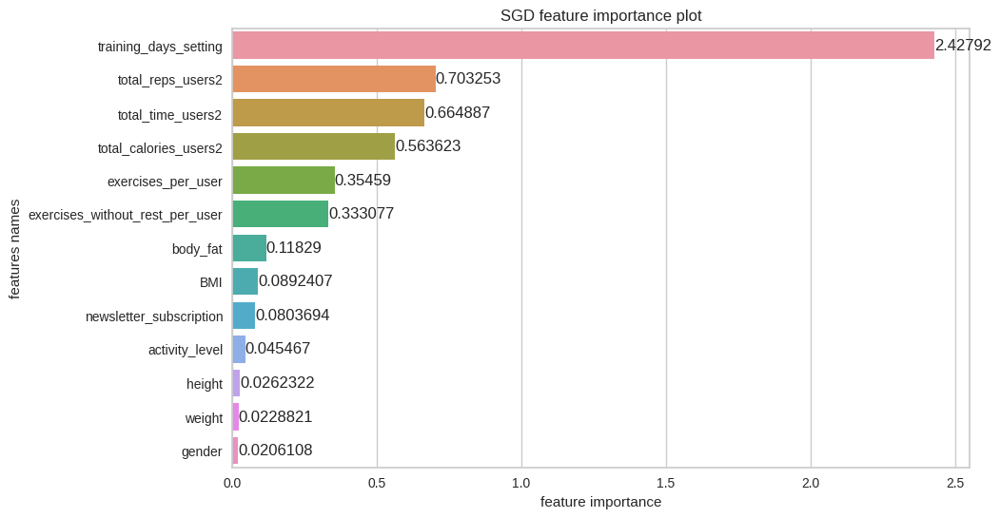

[SGD] Best parameters are {'alpha': 0.0002575, 'eta0': 0.050050000000000004, 'learning_rate': 'invscaling', 'penalty': 'elasticnet', 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Logistic Regression
[Logistic Regression] Features selected: Index(['gender', 'activity_level', 'newsletter_subscription', 'height',
       'weight', 'BMI', 'body_fat', 'training_days_setting',
       'total_time_users2', 'total_reps_users2', 'total_calories_users2',
       'exercises_per_user', 'exercises_without_rest_per_user'],
      dtype='object')
[Logistic Regression] Features importances: [0.14519964 0.08230342 0.32974043 0.41644844 1.12161948 1.17674228
 0.52255895 3.86080416 3.64498939 2.78598539 1.16089308 3.13046355
 2.28481307]


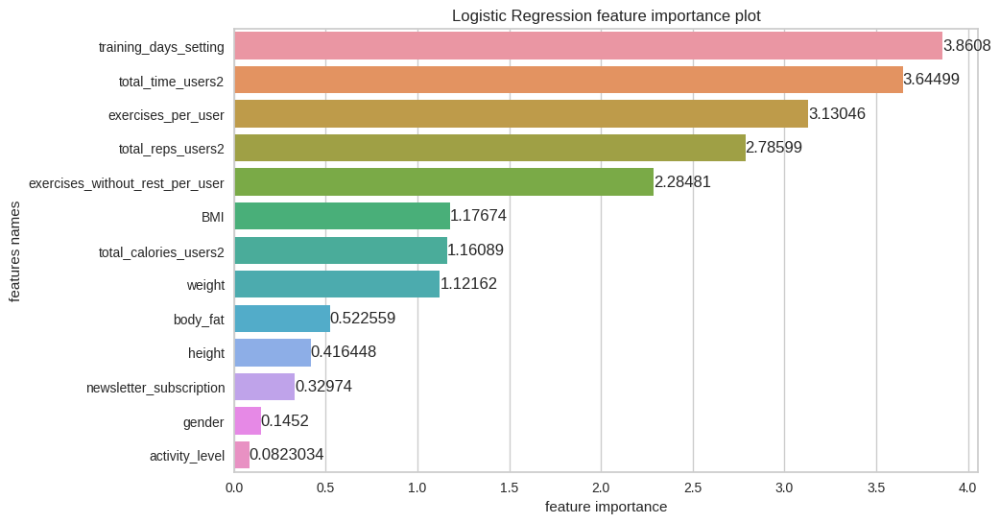

[Logistic Regression] Best parameters are {'C': 5, 'penalty': 'l2', 'random_state': 42, 'solver': 'liblinear'}
[INFO] Performing Grid-Search CV ---- Decision Tree
[Decision Tree] Features selected: Index(['gender', 'activity_level', 'newsletter_subscription', 'height',
       'weight', 'BMI', 'body_fat', 'training_days_setting',
       'total_time_users2', 'total_reps_users2', 'total_calories_users2',
       'exercises_per_user', 'exercises_without_rest_per_user'],
      dtype='object')
[Decision Tree] Features importances: [0.0, 0.00568141373505149, 0.0, 0.0036110671864765793, 0.0, 0.010114163130101756, 0.00658735067095667, 0.3880191651090603, 0.08247038671072401, 0.45267818347046995, 0.026692127512933407, 0.02232515730761096, 0.0018209851666150171]


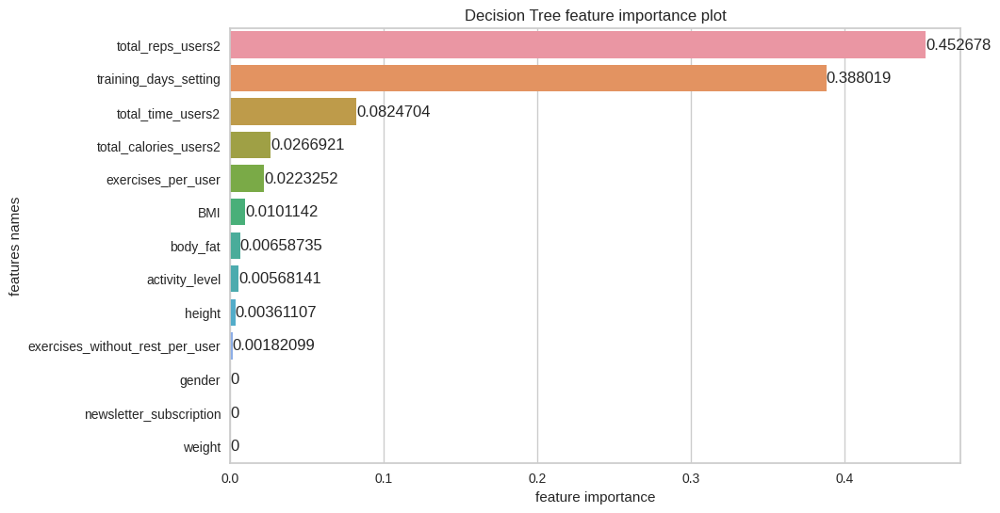

[Decision Tree] Best parameters are {'criterion': 'entropy', 'max_depth': 6, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Random Forest
[Random Forest] Features selected: Index(['gender', 'activity_level', 'newsletter_subscription', 'height',
       'weight', 'BMI', 'body_fat', 'training_days_setting',
       'total_time_users2', 'total_reps_users2', 'total_calories_users2',
       'exercises_per_user', 'exercises_without_rest_per_user'],
      dtype='object')
[Random Forest] Features importances: [0.0018155978387633597, 0.0012024280484554772, 0.002729202122573663, 0.0014745712324500523, 0.0026807585686853944, 0.005867728707550101, 0.0012332783949333187, 0.10035662112502304, 0.20781881810201278, 0.20017590743289376, 0.20468665182471124, 0.16658308699561974, 0.10337534960632819]


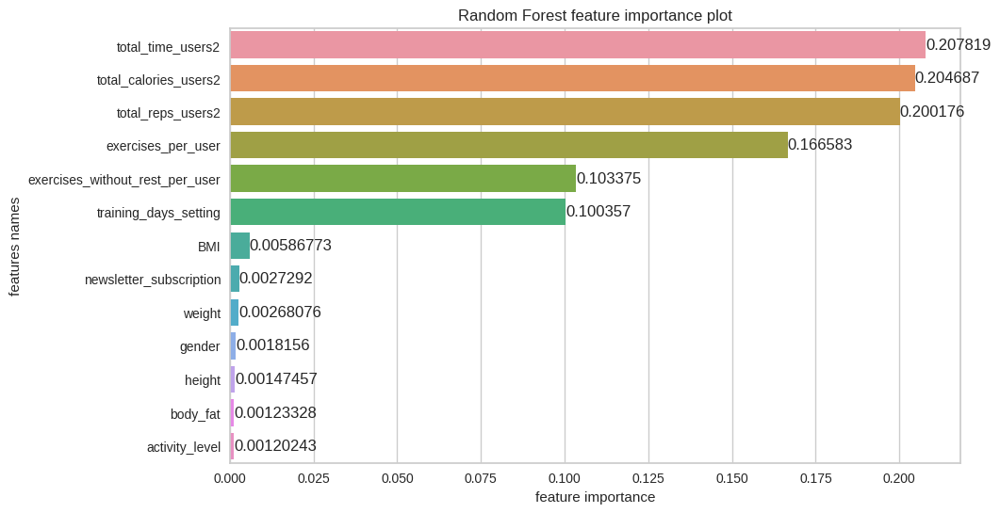

[Random Forest] Best parameters are {'criterion': 'entropy', 'max_depth': 6, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- AdaBoost
[AdaBoost] Features selected: Index(['gender', 'activity_level', 'newsletter_subscription', 'height',
       'weight', 'BMI', 'body_fat', 'training_days_setting',
       'total_time_users2', 'total_reps_users2', 'total_calories_users2',
       'exercises_per_user', 'exercises_without_rest_per_user'],
      dtype='object')
[AdaBoost] Features importances: [0.0, 0.0038204847151980335, 0.004160036082383087, 0.03004413777547254, 0.07469453757317607, 0.07147073348317418, 0.06574869574827386, 0.22931137713321978, 0.18369402631479648, 0.12035539093642686, 0.0756682351246646, 0.10890287433074423, 0.03212947078247025]


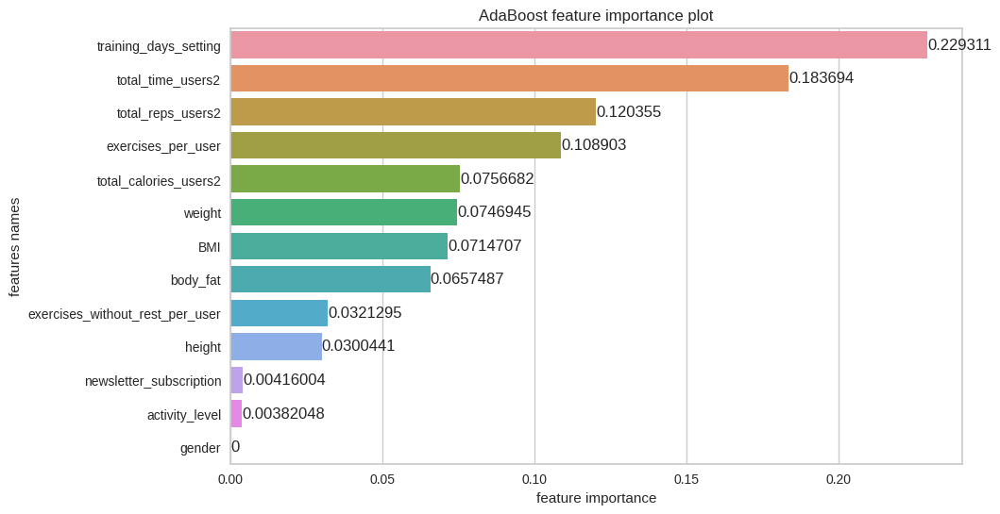

[AdaBoost] Best parameters are {'base_estimator': DecisionTreeClassifier(max_depth=2), 'learning_rate': 0.1, 'n_estimators': 60, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- GradientBoost
[GradientBoost] Features selected: Index(['gender', 'activity_level', 'newsletter_subscription', 'height',
       'weight', 'BMI', 'body_fat', 'training_days_setting',
       'total_time_users2', 'total_reps_users2', 'total_calories_users2',
       'exercises_per_user', 'exercises_without_rest_per_user'],
      dtype='object')
[GradientBoost] Features importances: [0.0006860998670622207, 0.0009229442757122767, 0.003824316288902488, 0.0006096158869511746, 0.003931301488672198, 0.006048855572332979, 0.005496422606001311, 0.26122798350655496, 0.21266633932943105, 0.16288118404689028, 0.13021703785808084, 0.18080051469625025, 0.030687384577157924]


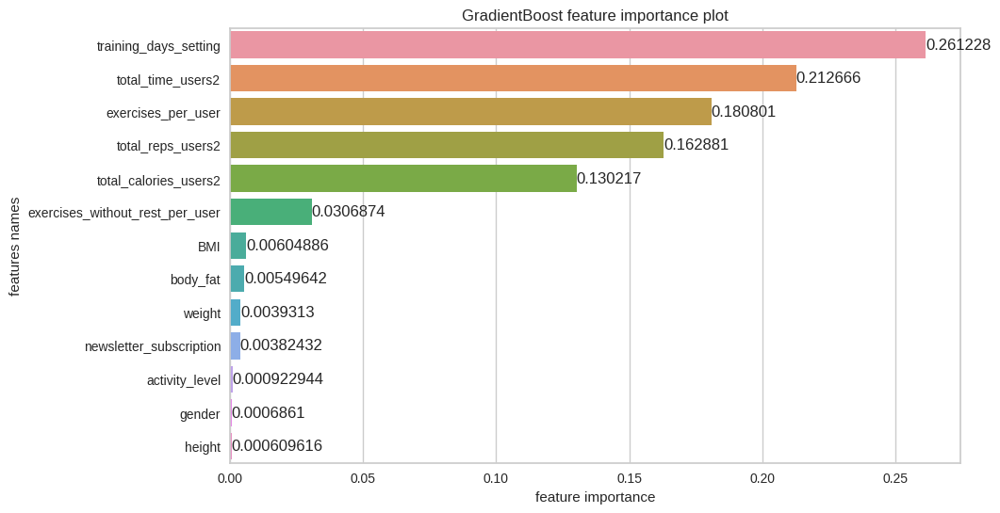

[GradientBoost] Best parameters are {'criterion': 'friedman_mse', 'learning_rate': 0.075, 'loss': 'deviance', 'max_depth': 3, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'n_estimators': 15, 'random_state': 42, 'subsample': 0.85}


In [164]:
estimators_multiclass_six_sel_u, X_test_six_sel_u, y_test_six_sel_u, X_train_six_sel_u, y_train_six_sel_u, X_test_inv_six_sel_u, features_six_sel_u = train(X_adh_cat_six, y_adh_cat_six, 
                                                         grid_params_multiclass, 
                                                         seed, feature_selection = True, 
                                                         feature_sel_type = 'UNI')

In [165]:
evaluation_table_six_sel_u = evaluate_multiclass(estimators_multiclass_six_sel_u, X_test_six_sel_u, y_test_six_sel_u, no_of_labels = 3, features_selected = True, feature_sel_type = 'UNI', features = features_six_sel_u)

In [166]:
evaluation_table_six_sel_u

,Overall Accuracy,Balanced Accuracy,Adj Balanced Accuracy,Precision micro,Precision macro,Precision weighted,Recall micro,Recall macro,Recall weighted,Cohen's kappa,Mathews Correlation Coefficient
SGD,0.74,0.58,0.38,0.74,0.64,0.71,0.74,0.58,0.74,0.47,0.50
Logistic Regression,0.76,0.61,0.42,0.76,0.68,0.73,0.76,0.61,0.76,0.51,0.53
Decision Tree,0.77,0.66,0.49,0.77,0.75,0.78,0.77,0.66,0.77,0.56,0.56
Random Forest,0.69,0.51,0.27,0.69,0.42,0.57,0.69,0.51,0.69,0.37,0.40
AdaBoost,0.77,0.67,0.50,0.77,0.74,0.79,0.77,0.67,0.77,0.57,0.58
GradientBoost,0.69,0.48,0.22,0.69,0.63,0.66,0.69,0.48,0.69,0.32,0.37


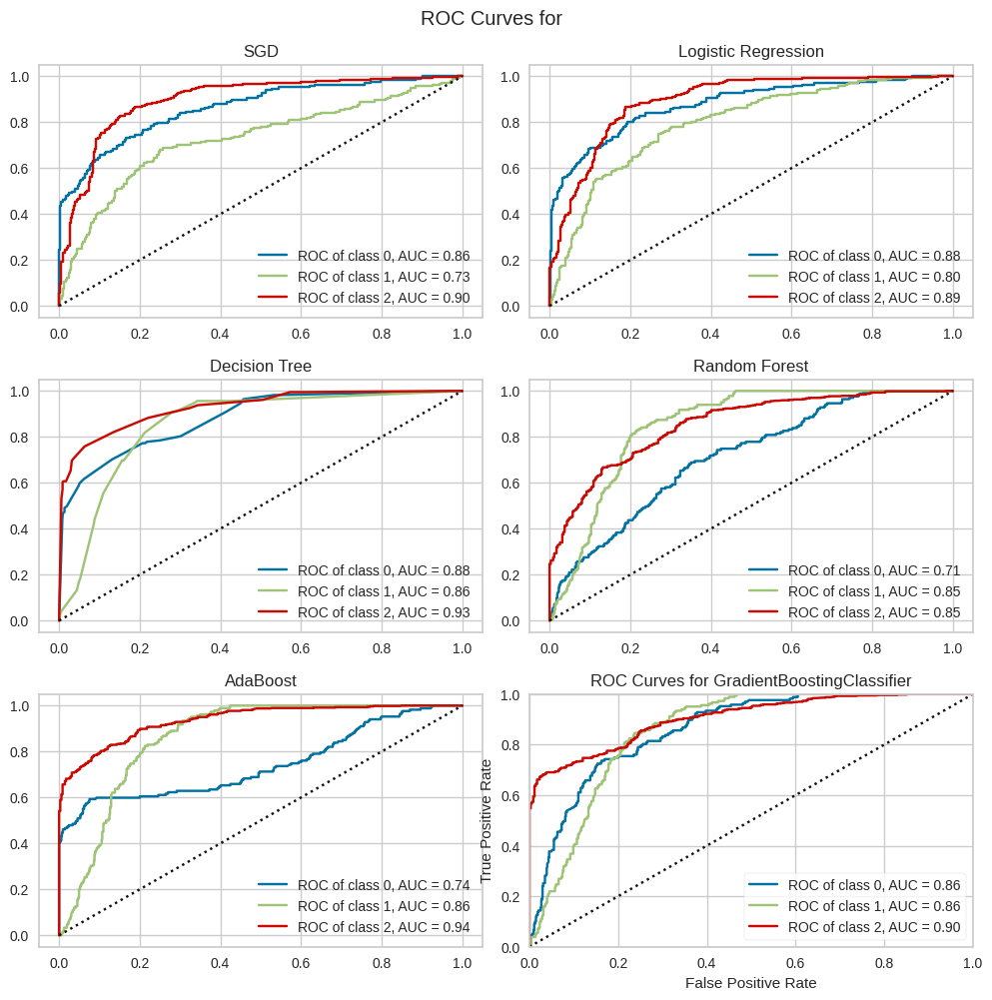

<AxesSubplot: title={'center': 'ROC Curves for GradientBoostingClassifier'}, xlabel='False Positive Rate', ylabel='True Positive Rate'>

In [167]:
ROC_curves(estimators_multiclass_six_sel_u, X_train_six_sel_u, y_train_six_sel_u, X_test_six_sel_u, y_test_six_sel_u, np.unique(y_adh_cat_six), name = 'all', features_selected = True,feature_sel_type = 'UNI', features = features_six_sel_u)

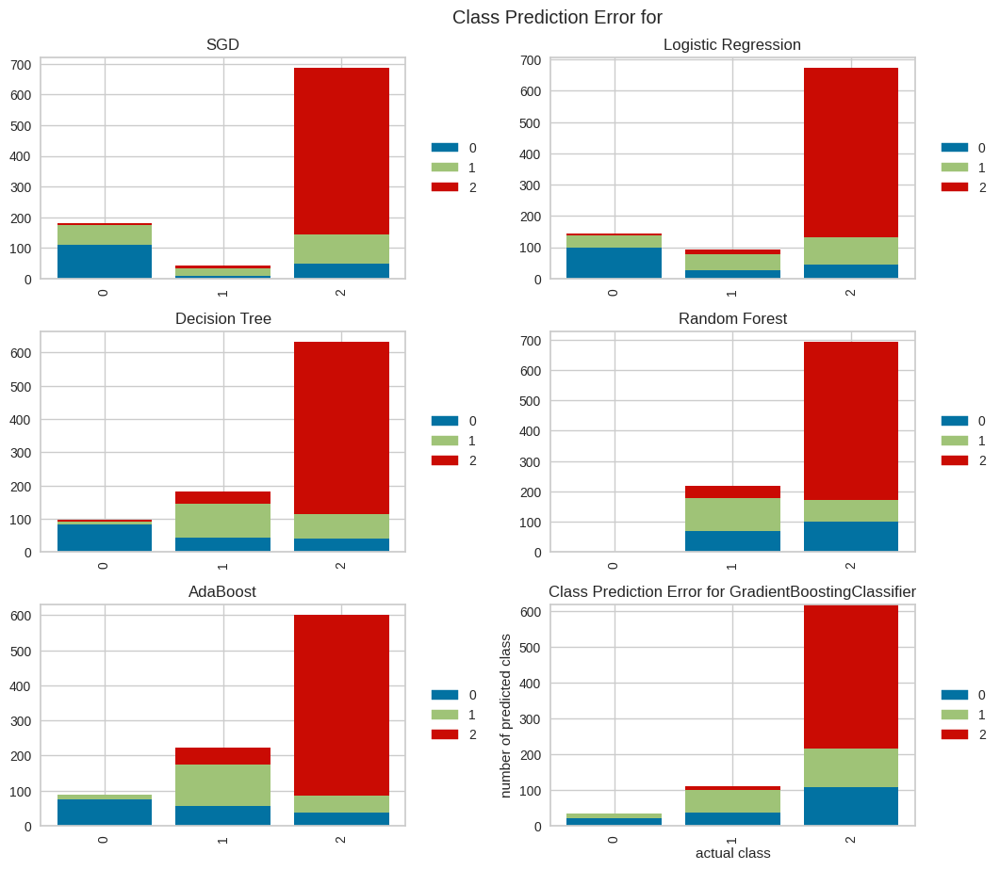

<AxesSubplot: title={'center': 'Class Prediction Error for GradientBoostingClassifier'}, xlabel='actual class', ylabel='number of predicted class'>

In [168]:
prediction_error_plot(estimators_multiclass_six_sel_u, X_train_six_sel_u, y_train_six_sel_u, X_test_six_sel_u, y_test_six_sel_u, np.unique(y_adh_cat_six), name = 'all', features_selected = True,feature_sel_type = 'UNI', features = features_six_sel_u)

#### With feature selection (by SequentialFeatureSelector)

In [169]:
estimators_multiclass_six_sel, X_test_six_sel, y_test_six_sel, X_train_six_sel, y_train_six_sel, X_test_inv_six_sel, features_six_sel = train(X_adh_cat_six, y_adh_cat_six, 
                                                         grid_params_multiclass, 
                                                         seed, feature_selection = True, 
                                                         feature_sel_type = 'SFS')

[INFO] Performing Grid-Search CV ---- SGD
[SGD] Features selected: Index(['height', 'training_days_setting', 'total_calories_users2'], dtype='object')
[SGD] Best parameters are {'alpha': 0.0002575, 'eta0': 0.1, 'learning_rate': 'adaptive', 'penalty': 'l2', 'random_state': 42}


/home/evida-monika/anaconda3/envs/mhunters/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/home/evida-monika/anaconda3/envs/mhunters/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stab

[INFO] Performing Grid-Search CV ---- Logistic Regression
[Logistic Regression] Features selected: Index(['body_type', 'BMI', 'body_fat', 'training_days_setting',
       'total_time_users2', 'total_reps_users2',
       'exercises_without_rest_per_user'],
      dtype='object')
[Logistic Regression] Best parameters are {'C': 1, 'penalty': 'l1', 'random_state': 42, 'solver': 'liblinear'}
[INFO] Performing Grid-Search CV ---- Decision Tree
[Decision Tree] Features selected: Index(['training_days_setting', 'total_reps_users2'], dtype='object')
[Decision Tree] Best parameters are {'criterion': 'entropy', 'max_depth': 6, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Random Forest
[Random Forest] Features selected: Index(['gender', 'activity_level', 'newsletter_subscription', 'height',
       'weight', 'BMI', 'body_fat', 'training_days_setting',
       'total_time_users2', 'total_reps_users2', 'exercises_per_user',
       'exercises_without_rest_per_user'],
      dtype='object')
[R

In [170]:
evaluation_table_six_sel = evaluate_multiclass(estimators_multiclass_six_sel, X_test_six_sel, y_test_six_sel, no_of_labels = 3, features_selected = True, features = features_six_sel)


In [171]:
evaluation_table_six_sel

,Overall Accuracy,Balanced Accuracy,Adj Balanced Accuracy,Precision micro,Precision macro,Precision weighted,Recall micro,Recall macro,Recall weighted,Cohen's kappa,Mathews Correlation Coefficient
SGD,0.75,0.59,0.39,0.75,0.68,0.72,0.75,0.59,0.75,0.48,0.51
Logistic Regression,0.76,0.62,0.42,0.76,0.69,0.74,0.76,0.62,0.76,0.51,0.53
Decision Tree,0.76,0.66,0.49,0.76,0.72,0.77,0.76,0.66,0.76,0.55,0.56
Random Forest,0.70,0.50,0.25,0.70,0.42,0.56,0.70,0.50,0.70,0.36,0.39
AdaBoost,0.76,0.66,0.49,0.76,0.72,0.77,0.76,0.66,0.76,0.55,0.55
GradientBoost,0.68,0.46,0.19,0.68,0.61,0.65,0.68,0.46,0.68,0.28,0.33


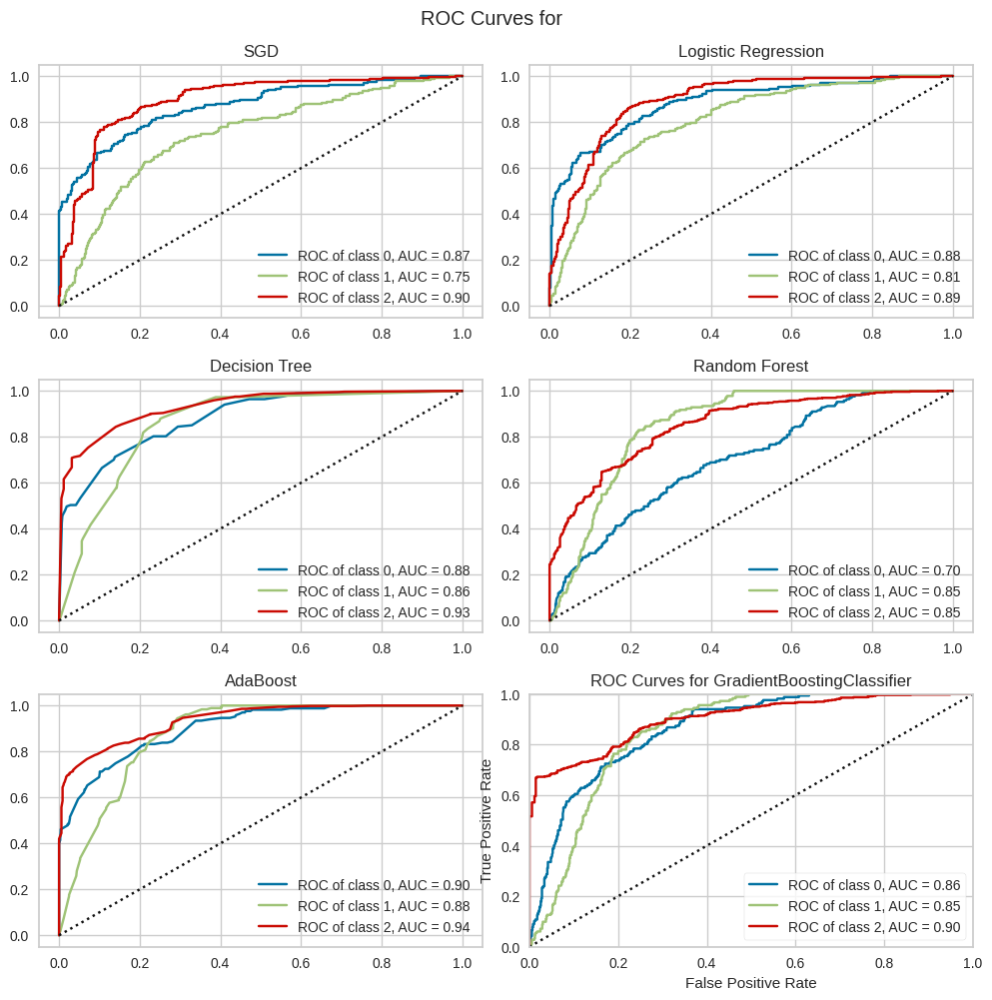

<AxesSubplot: title={'center': 'ROC Curves for GradientBoostingClassifier'}, xlabel='False Positive Rate', ylabel='True Positive Rate'>

In [172]:
ROC_curves(estimators_multiclass_six_sel, X_train_six_sel, y_train_six_sel, X_test_six_sel, y_test_six_sel, np.unique(y_adh_cat_six), name = 'all', features_selected = True, features = features_six_sel)

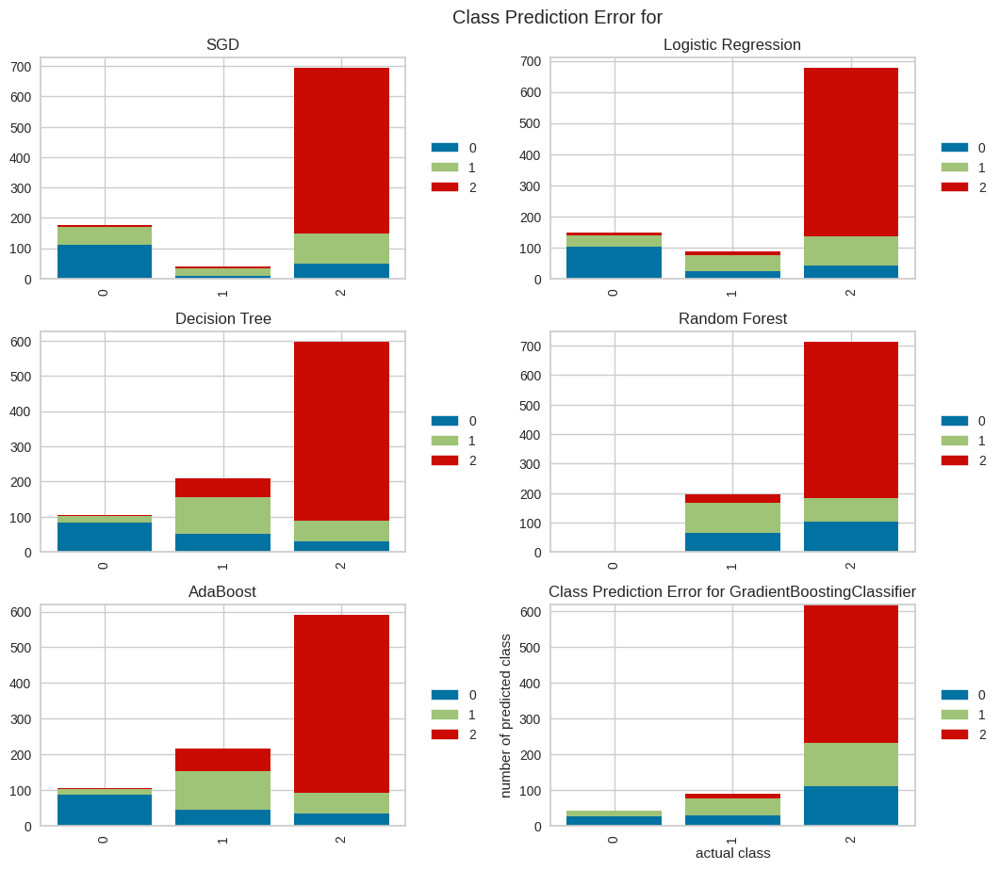

<AxesSubplot: title={'center': 'Class Prediction Error for GradientBoostingClassifier'}, xlabel='actual class', ylabel='number of predicted class'>

In [173]:
prediction_error_plot(estimators_multiclass_six_sel, X_train_six_sel, y_train_six_sel, X_test_six_sel, y_test_six_sel, np.unique(y_adh_cat_six), name = 'all', features_selected = True, features = features_six_sel)


#### With feature selection (by Recursive feature elimination with cross-validation - RFECV)

[INFO] Performing Grid-Search CV ---- SGD
[SGD] Features selected: Index(['gender', 'height', 'weight', 'BMI', 'training_days_setting',
       'total_time_users2', 'total_reps_users2', 'total_calories_users2',
       'exercises_per_user', 'exercises_without_rest_per_user'],
      dtype='object')
[SGD] Features importances: [0.00462997 0.18867335 0.39647907 0.31528399 2.67457118 1.37095389
 2.1424615  0.36878358 1.02823539 1.0834863 ]


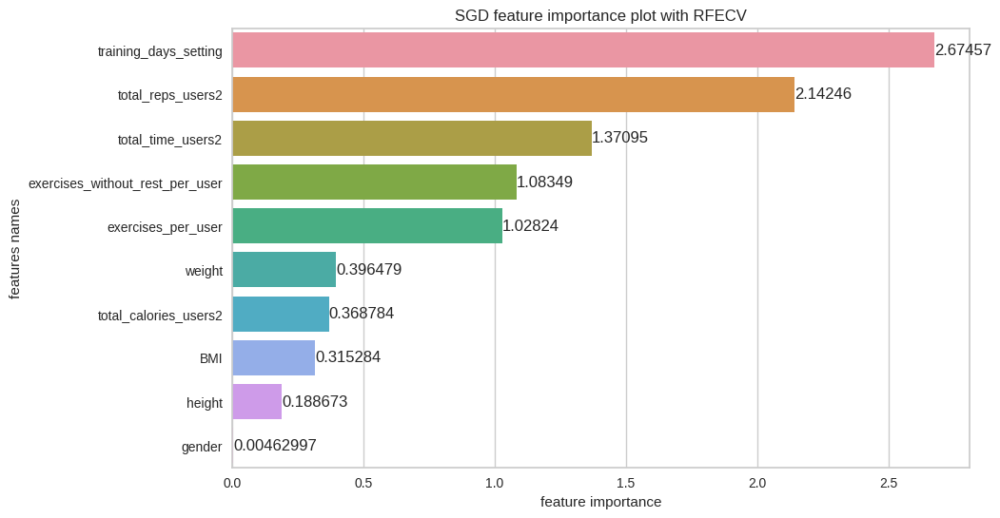

[SGD] Best parameters are {'alpha': 0.001, 'eta0': 0.07502500000000001, 'learning_rate': 'adaptive', 'penalty': 'l2', 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Logistic Regression
[Logistic Regression] Features selected: Index(['training_days_setting', 'total_time_users2', 'total_reps_users2',
       'exercises_per_user', 'exercises_without_rest_per_user'],
      dtype='object')
[Logistic Regression] Features importances: [3.86102114 2.61732569 2.81912759 3.49972883 2.69684198]


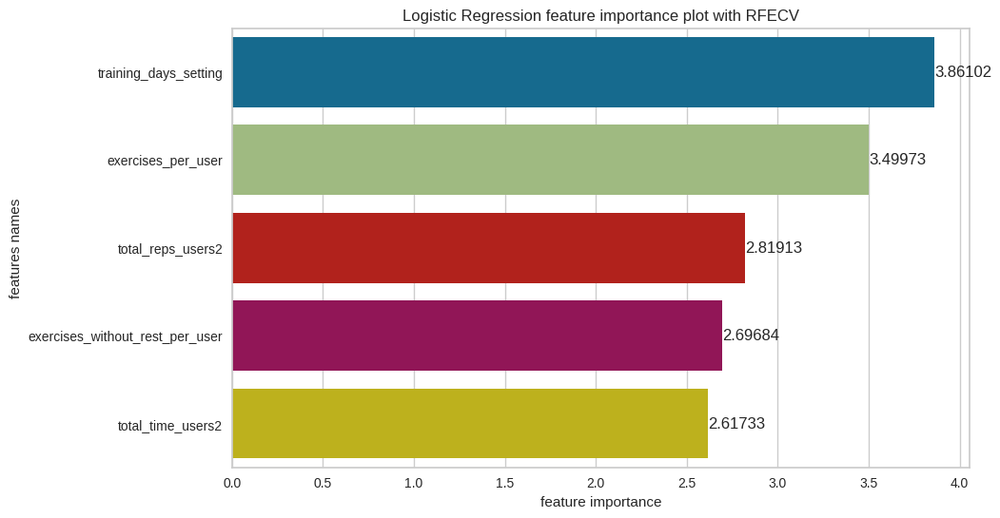

[Logistic Regression] Best parameters are {'C': 5, 'penalty': 'l1', 'random_state': 42, 'solver': 'liblinear'}
[INFO] Performing Grid-Search CV ---- Decision Tree
[Decision Tree] Features selected: Index(['height', 'BMI', 'training_days_setting', 'total_time_users2',
       'total_reps_users2', 'exercises_without_rest_per_user'],
      dtype='object')
[Decision Tree] Features importances: [0.009567207028750717, 0.012475193743274611, 0.3932103934830739, 0.10521598083383399, 0.4606509998093399, 0.018880225101726756]


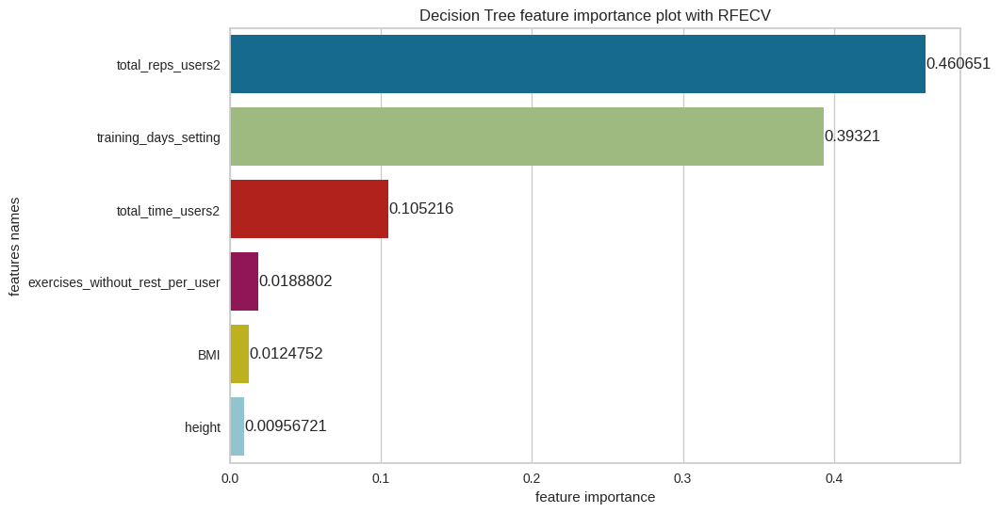

[Decision Tree] Best parameters are {'criterion': 'entropy', 'max_depth': 6, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Random Forest
[Random Forest] Features selected: Index(['activity_level', 'height', 'weight', 'BMI', 'body_fat',
       'training_days_setting', 'total_time_users2', 'total_reps_users2',
       'total_calories_users2', 'exercises_per_user',
       'exercises_without_rest_per_user'],
      dtype='object')
[Random Forest] Features importances: [0.0, 0.0014500093498932484, 0.00013526378846554182, 0.0016891561226380057, 0.0012102497977504987, 0.07505293757267732, 0.24855279206073624, 0.27433199364806626, 0.14451751703166762, 0.10850349754917912, 0.1445565830789263]


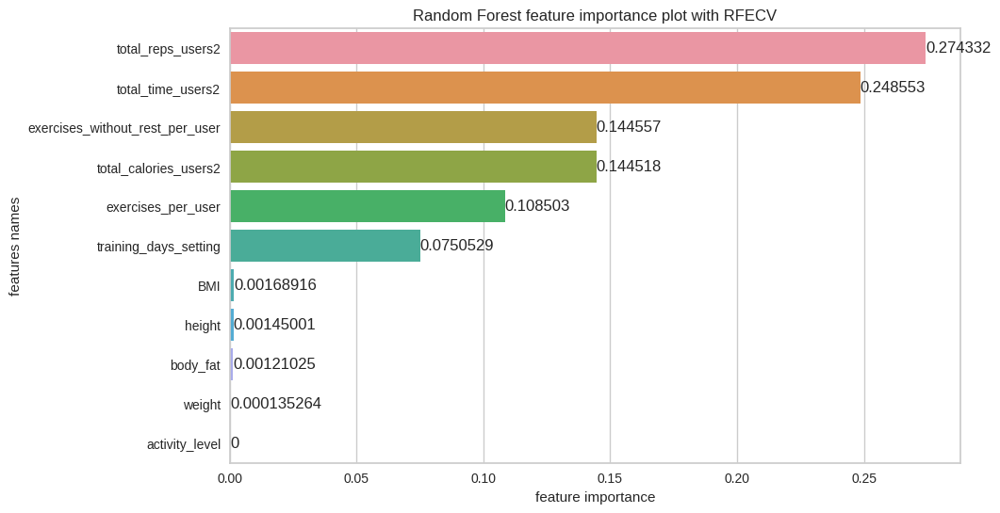

[Random Forest] Best parameters are {'criterion': 'entropy', 'max_depth': 3, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.26, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- AdaBoost
[AdaBoost] Features selected: Index(['weight', 'BMI', 'training_days_setting', 'total_time_users2',
       'total_reps_users2', 'total_calories_users2', 'exercises_per_user'],
      dtype='object')
[AdaBoost] Features importances: [0.0020483458744387497, 0.006008126638795318, 0.2804728298303281, 0.21147147273590186, 0.24461263554755294, 0.19694853714876784, 0.05843805222421515]


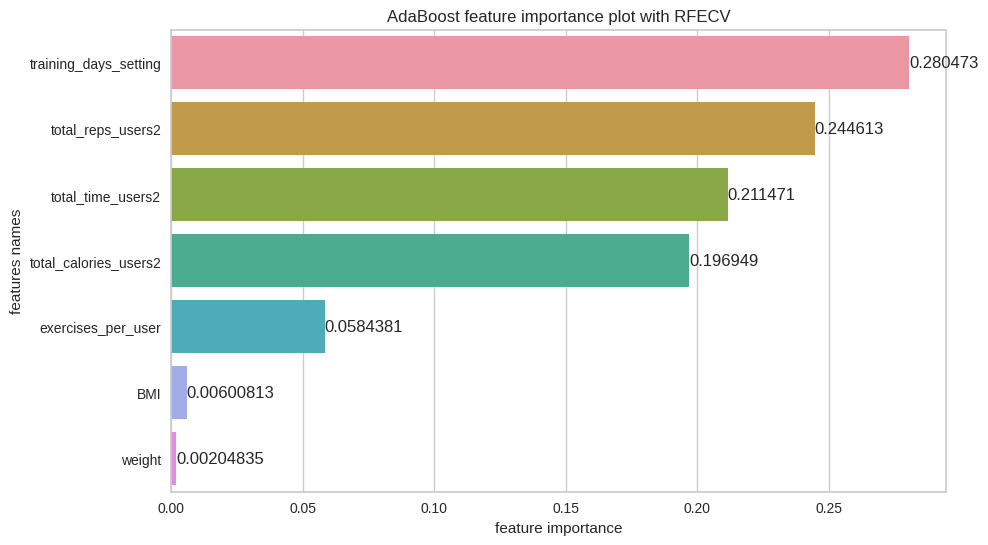

[AdaBoost] Best parameters are {'base_estimator': DecisionTreeClassifier(max_depth=4), 'learning_rate': 0.01, 'n_estimators': 40, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- GradientBoost
[GradientBoost] Features selected: Index(['newsletter_subscription', 'height', 'weight', 'BMI', 'body_fat',
       'training_days_setting', 'total_time_users2', 'total_reps_users2',
       'total_calories_users2', 'exercises_per_user',
       'exercises_without_rest_per_user'],
      dtype='object')
[GradientBoost] Features importances: [0.00596424633966584, 0.0008398665169021721, 0.0020089928536407586, 0.003794703862522501, 0.0036727815925632385, 0.21527992677537502, 0.20399343587871485, 0.14572733198310467, 0.19905150606269867, 0.11762484980124413, 0.10204235833356819]


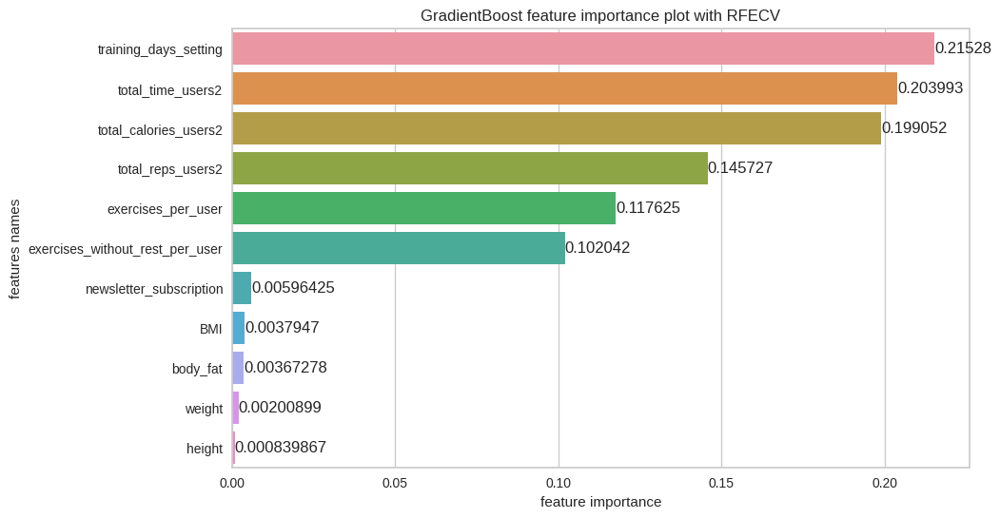

[GradientBoost] Best parameters are {'criterion': 'friedman_mse', 'learning_rate': 0.075, 'loss': 'deviance', 'max_depth': 3, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'n_estimators': 15, 'random_state': 42, 'subsample': 0.85}


In [174]:
estimators_multiclass_six_sel_rfecv, X_test_six_sel_rfecv, y_test_six_sel_rfecv, X_train_six_sel_rfecv, y_train_six_sel_rfecv, X_test_inv_six_sel_rfecv, features_six_sel_rfecv = train(X_adh_cat_six, y_adh_cat_six, 
                                                         grid_params_multiclass, 
                                                         seed, feature_selection = True, 
                                                         feature_sel_type = 'RFECV')

In [175]:
evaluation_table_six_sel_rfecv = evaluate_multiclass(estimators_multiclass_six_sel_rfecv, X_test_six_sel_rfecv, y_test_six_sel_rfecv, no_of_labels = 3, features_selected = True, features = features_six_sel_rfecv)


In [176]:
evaluation_table_six_sel_rfecv

,Overall Accuracy,Balanced Accuracy,Adj Balanced Accuracy,Precision micro,Precision macro,Precision weighted,Recall micro,Recall macro,Recall weighted,Cohen's kappa,Mathews Correlation Coefficient
SGD,0.75,0.60,0.40,0.75,0.67,0.72,0.75,0.60,0.75,0.49,0.52
Logistic Regression,0.77,0.62,0.44,0.77,0.71,0.75,0.77,0.62,0.77,0.53,0.55
Decision Tree,0.78,0.70,0.55,0.78,0.74,0.79,0.78,0.70,0.78,0.60,0.60
Random Forest,0.69,0.52,0.28,0.69,0.42,0.57,0.69,0.52,0.69,0.38,0.41
AdaBoost,0.78,0.67,0.51,0.78,0.72,0.78,0.78,0.67,0.78,0.58,0.58
GradientBoost,0.69,0.48,0.21,0.69,0.66,0.68,0.69,0.48,0.69,0.31,0.36


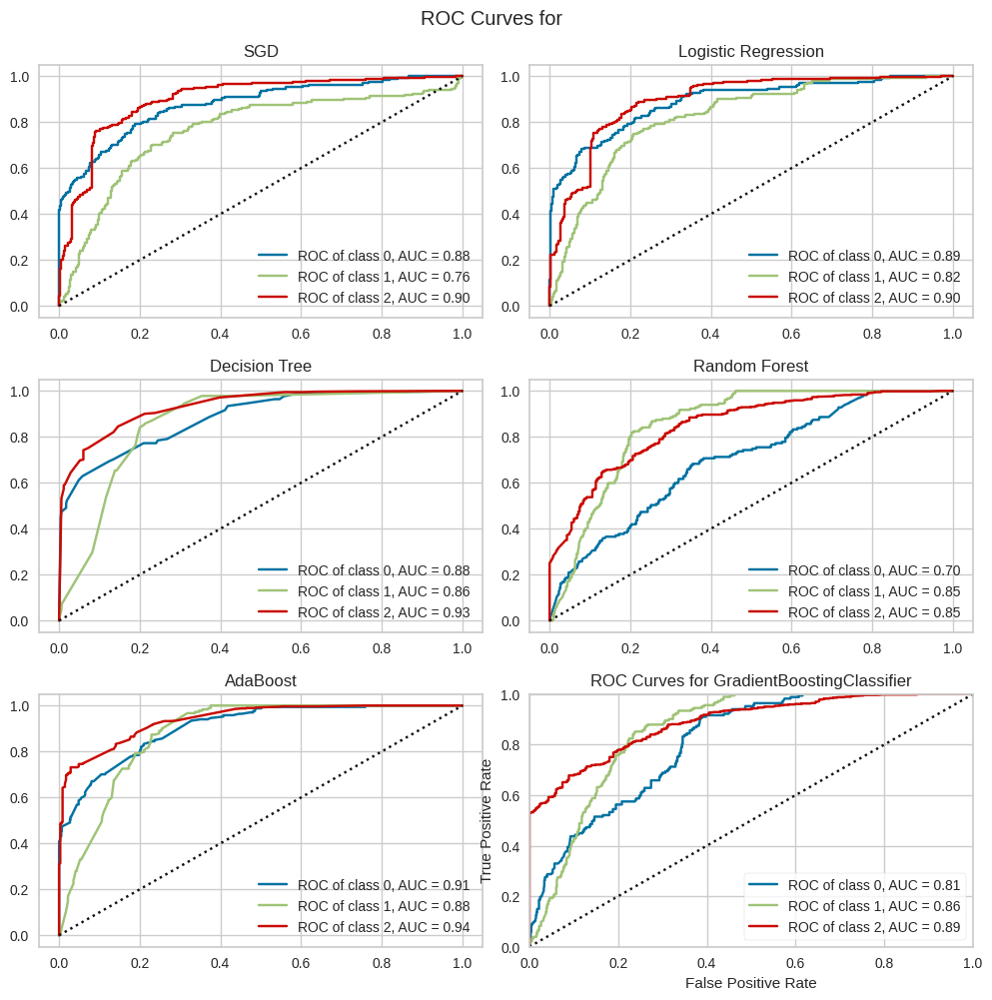

<AxesSubplot: title={'center': 'ROC Curves for GradientBoostingClassifier'}, xlabel='False Positive Rate', ylabel='True Positive Rate'>

In [177]:
ROC_curves(estimators_multiclass_six_sel_rfecv, X_train_six_sel_rfecv, y_train_six_sel_rfecv, X_test_six_sel_rfecv, y_test_six_sel_rfecv, np.unique(y_adh_cat_six), name = 'all', features_selected = True, features = features_six_sel_rfecv)


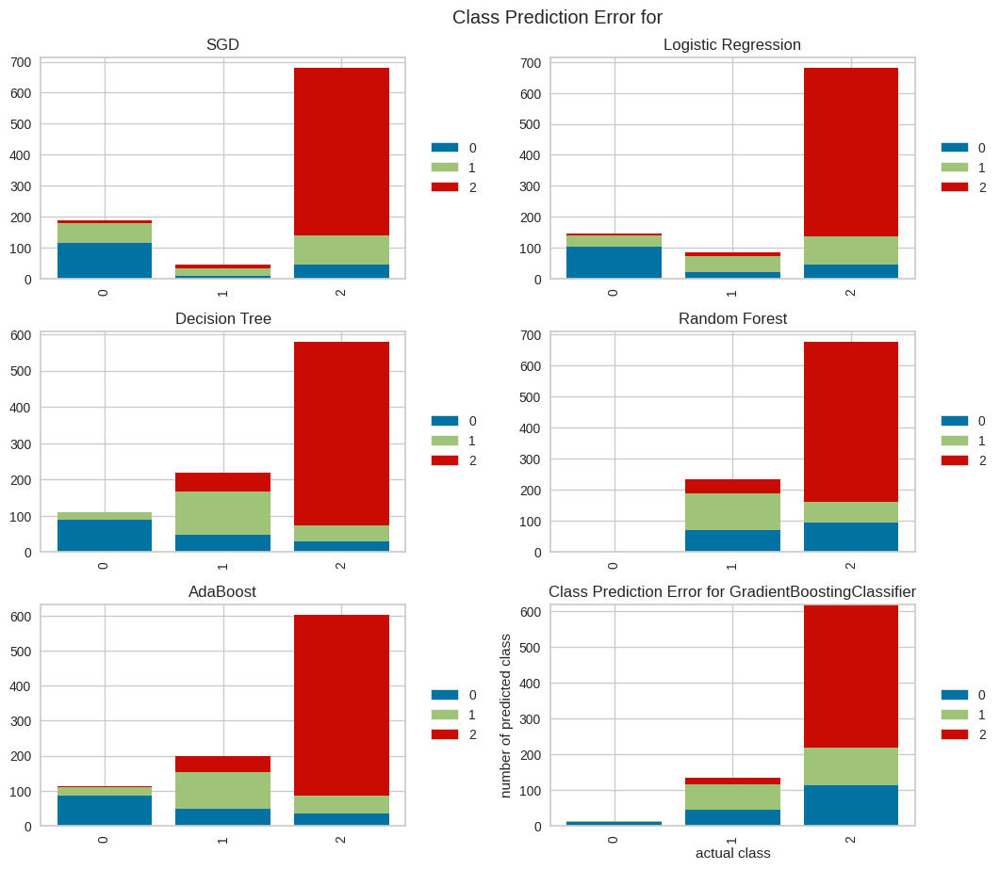

<AxesSubplot: title={'center': 'Class Prediction Error for GradientBoostingClassifier'}, xlabel='actual class', ylabel='number of predicted class'>

In [178]:
prediction_error_plot(estimators_multiclass_six_sel_rfecv, X_train_six_sel_rfecv, y_train_six_sel_rfecv, X_test_six_sel_rfecv, y_test_six_sel_rfecv, np.unique(y_adh_cat_six), name = 'all', features_selected = True, features = features_six_sel_rfecv)


#### With feature selection (by SelectFromModel)

[INFO] Performing Grid-Search CV ---- SGD
[SGD] Features selected: Index(['weight', 'training_days_setting', 'total_time_users2',
       'total_reps_users2', 'total_calories_users2', 'exercises_per_user',
       'exercises_without_rest_per_user'],
      dtype='object')
[SGD] Features importances: [0.         2.66256616 1.18002021 2.17693668 0.         0.61827356
 0.40461188]


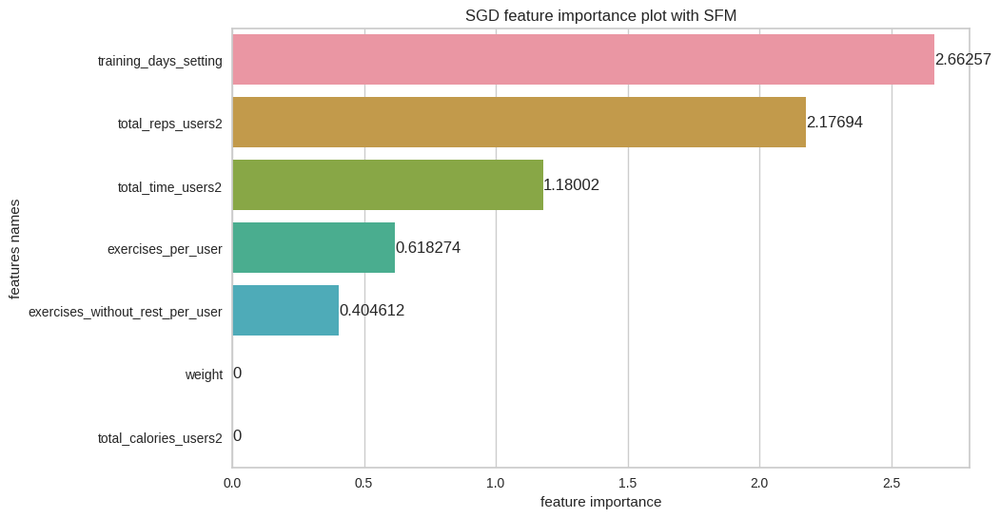

[SGD] Best parameters are {'alpha': 0.0007525, 'eta0': 0.0001, 'learning_rate': 'optimal', 'penalty': 'l1', 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Logistic Regression
[Logistic Regression] Features selected: Index(['BMI', 'training_days_setting', 'total_time_users2',
       'total_reps_users2', 'total_calories_users2', 'exercises_per_user',
       'exercises_without_rest_per_user'],
      dtype='object')
[Logistic Regression] Features importances: [0.09309173 3.86253754 3.40942471 2.87155509 0.88361918 3.72729833
 2.43831968]


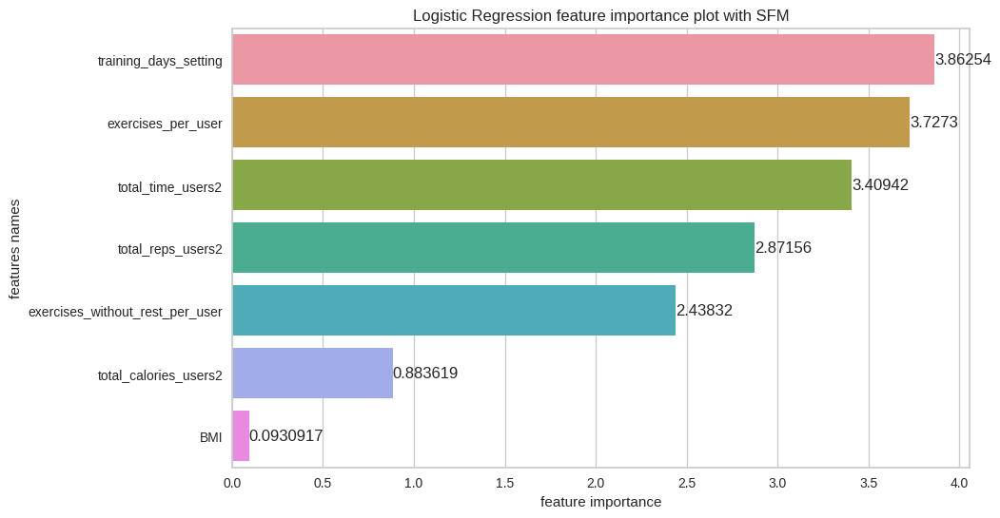

[Logistic Regression] Best parameters are {'C': 5, 'penalty': 'l1', 'random_state': 42, 'solver': 'liblinear'}
[INFO] Performing Grid-Search CV ---- Decision Tree
[Decision Tree] Features selected: Index(['height', 'BMI', 'training_days_setting', 'total_time_users2',
       'total_reps_users2', 'exercises_per_user',
       'exercises_without_rest_per_user'],
      dtype='object')
[Decision Tree] Features importances: [0.009561611524404604, 0.012467897465416369, 0.3882757105381013, 0.10361311402448002, 0.4527424189142194, 0.022339917962689117, 0.010999329570689356]


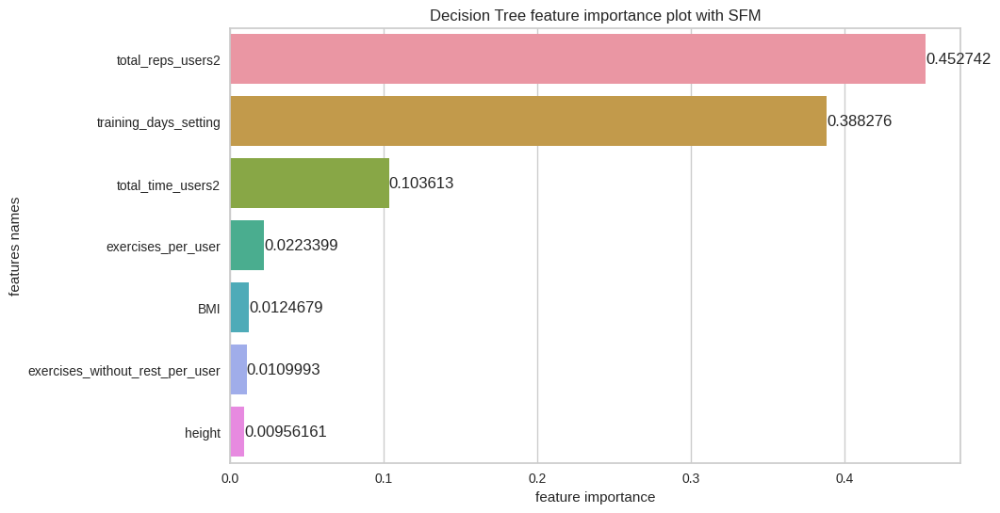

[Decision Tree] Best parameters are {'criterion': 'entropy', 'max_depth': 6, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Random Forest
[Random Forest] Features selected: Index(['BMI', 'training_days_setting', 'total_time_users2',
       'total_reps_users2', 'total_calories_users2', 'exercises_per_user',
       'exercises_without_rest_per_user'],
      dtype='object')
[Random Forest] Features importances: [0.0005355553612022381, 0.07184035121318429, 0.16477850855926332, 0.21355788114847254, 0.18492098769583312, 0.16740785590196017, 0.1969588601200842]


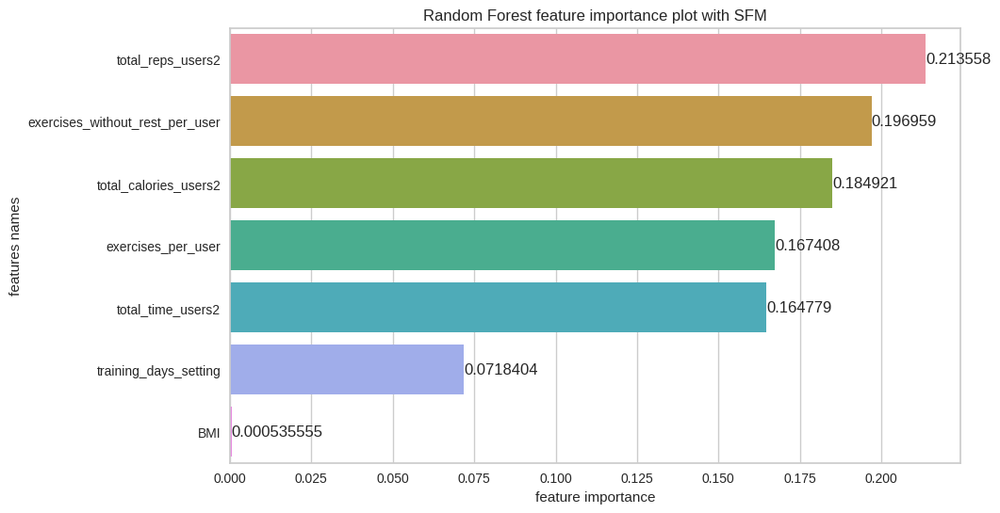

[Random Forest] Best parameters are {'criterion': 'entropy', 'max_depth': 6, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- AdaBoost
[AdaBoost] Features selected: Index(['weight', 'BMI', 'training_days_setting', 'total_time_users2',
       'total_reps_users2', 'total_calories_users2', 'exercises_per_user'],
      dtype='object')
[AdaBoost] Features importances: [0.0020483458744387497, 0.006008126638795318, 0.2804728298303281, 0.21147147273590186, 0.24461263554755294, 0.19694853714876784, 0.05843805222421515]


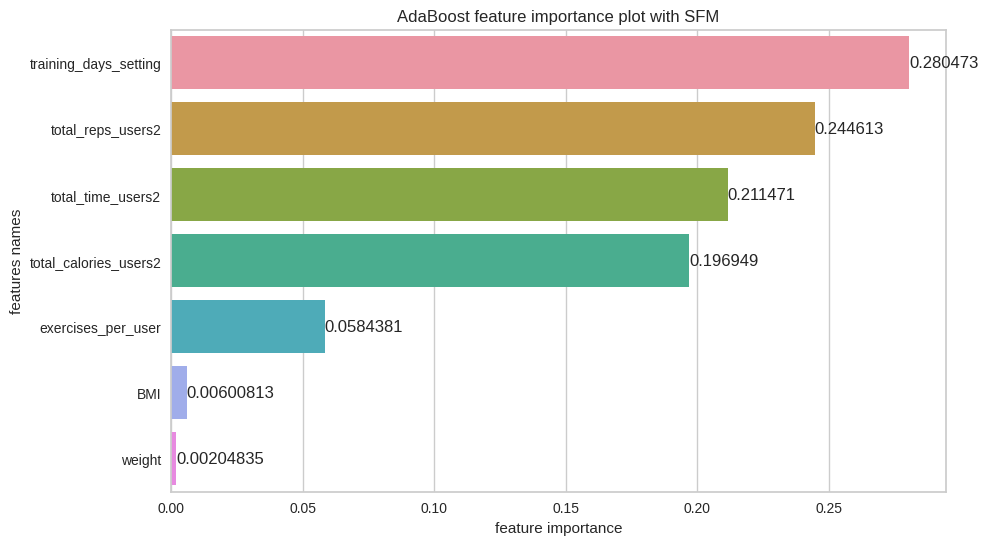

[AdaBoost] Best parameters are {'base_estimator': DecisionTreeClassifier(max_depth=4), 'learning_rate': 0.01, 'n_estimators': 40, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- GradientBoost
[GradientBoost] Features selected: Index(['BMI', 'training_days_setting', 'total_time_users2',
       'total_reps_users2', 'total_calories_users2', 'exercises_per_user',
       'exercises_without_rest_per_user'],
      dtype='object')
[GradientBoost] Features importances: [0.004674734232201107, 0.28791590456833777, 0.23381165901305187, 0.1695096419223441, 0.07630993918355947, 0.13908453690692876, 0.08869358417357692]


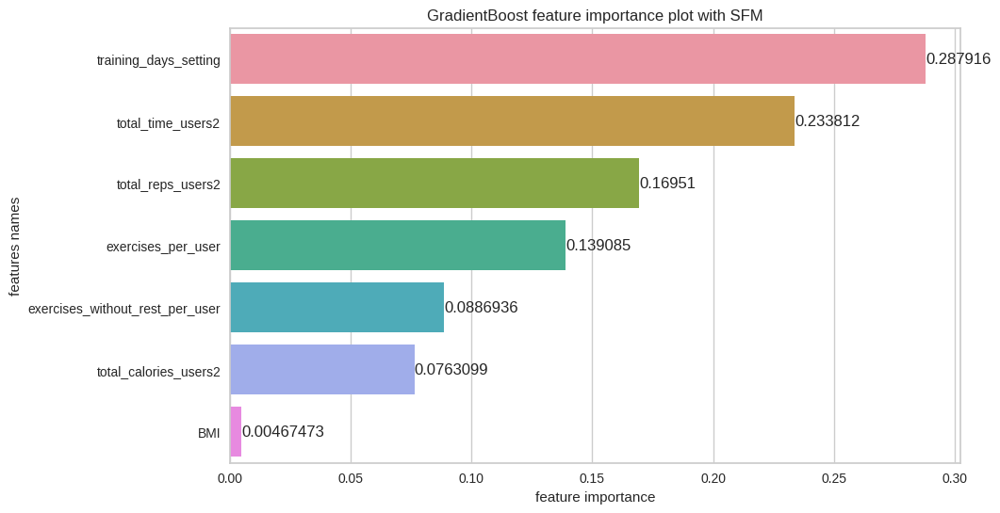

[GradientBoost] Best parameters are {'criterion': 'friedman_mse', 'learning_rate': 0.075, 'loss': 'deviance', 'max_depth': 3, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'n_estimators': 15, 'random_state': 42, 'subsample': 0.85}


In [179]:
estimators_multiclass_six_sel_sfm, X_test_six_sel_sfm, y_test_six_sel_sfm, X_train_six_sel_sfm, y_train_six_sel_sfm, X_test_inv_six_sel_sfm, features_six_sel_sfm = train(X_adh_cat_six, y_adh_cat_six, 
                                                         grid_params_multiclass, 
                                                         seed, feature_selection = True, 
                                                         feature_sel_type = 'SFM')

In [180]:
evaluation_table_six_sel_sfm = evaluate_multiclass(estimators_multiclass_six_sel_sfm, X_test_six_sel_sfm, y_test_six_sel_sfm, no_of_labels = 3, features_selected = True, features = features_six_sel_sfm)

In [181]:
evaluation_table_six_sel_sfm

,Overall Accuracy,Balanced Accuracy,Adj Balanced Accuracy,Precision micro,Precision macro,Precision weighted,Recall micro,Recall macro,Recall weighted,Cohen's kappa,Mathews Correlation Coefficient
SGD,0.75,0.60,0.39,0.75,0.67,0.73,0.75,0.60,0.75,0.49,0.52
Logistic Regression,0.77,0.62,0.43,0.77,0.71,0.75,0.77,0.62,0.77,0.53,0.55
Decision Tree,0.78,0.69,0.53,0.78,0.75,0.79,0.78,0.69,0.78,0.59,0.59
Random Forest,0.69,0.51,0.27,0.69,0.41,0.56,0.69,0.51,0.69,0.36,0.39
AdaBoost,0.78,0.67,0.51,0.78,0.72,0.78,0.78,0.67,0.78,0.58,0.58
GradientBoost,0.70,0.51,0.26,0.70,0.62,0.67,0.70,0.51,0.70,0.36,0.40


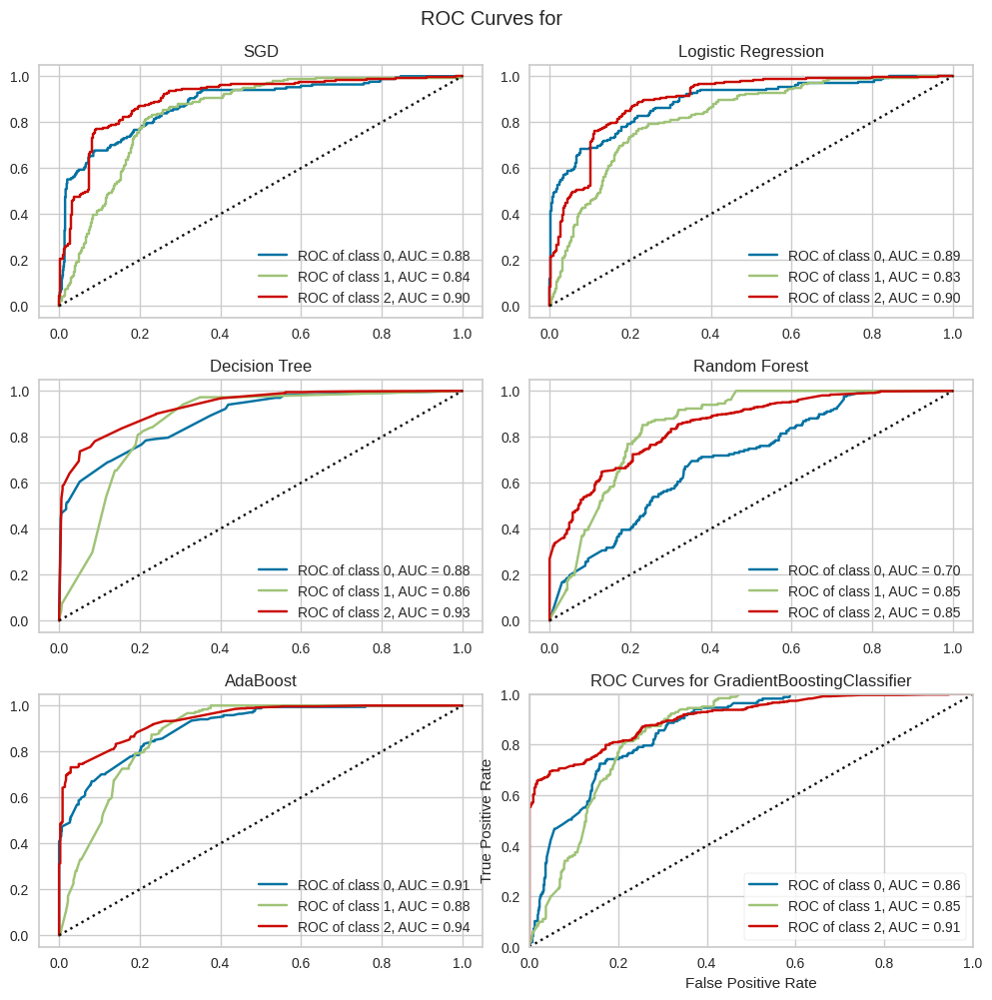

<AxesSubplot: title={'center': 'ROC Curves for GradientBoostingClassifier'}, xlabel='False Positive Rate', ylabel='True Positive Rate'>

In [182]:
ROC_curves(estimators_multiclass_six_sel_sfm, X_train_six_sel_sfm, y_train_six_sel_sfm, X_test_six_sel_sfm, y_test_six_sel_sfm, np.unique(y_adh_cat_six), name = 'all', features_selected = True, features = features_six_sel_sfm)

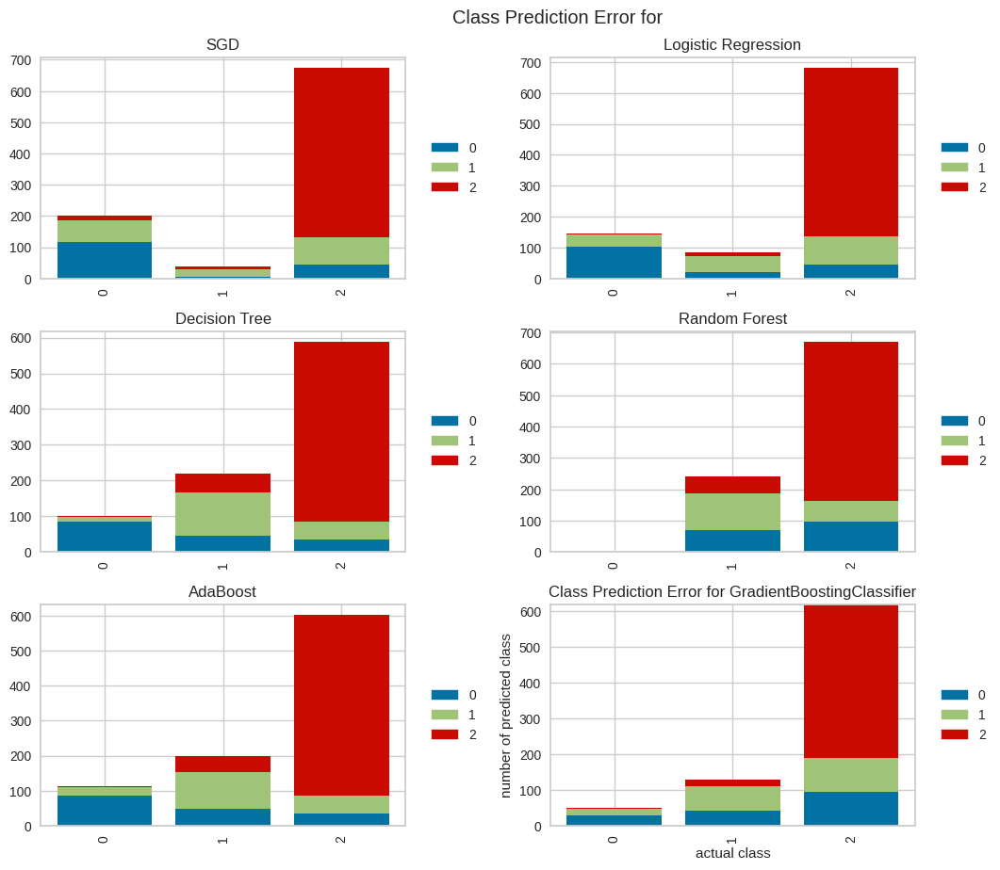

<AxesSubplot: title={'center': 'Class Prediction Error for GradientBoostingClassifier'}, xlabel='actual class', ylabel='number of predicted class'>

In [183]:
prediction_error_plot(estimators_multiclass_six_sel_sfm, X_train_six_sel_sfm, y_train_six_sel_sfm, X_test_six_sel_sfm, y_test_six_sel_sfm, np.unique(y_adh_cat_six), name = 'all', features_selected = True, features = features_six_sel_sfm)

### Seventh approach (2 groups, training days goal achieved / number of weeks when any training was done)

In this approach, we take into consideration sum of the weeks when the goal was achieved divided by number of weeks when the training was done.

It is in range from 0 to 1. It can be split into two groups:

* Group 0 - when the adherence is less than 0.1 (1863 users),
* Group 1 - when the adherence is higher or equal to 0.1 (1161 users).

Variables taken into consideration are:
* gender,
* height,
* weight,
* BMI,
* activity level,
* body type,
* newsletter subscription,
* body fat,
* training days setting,
* total time users,
* total reps users,
* total calories users,
* exercises per user,
* exercises without rest per user.

In [184]:
# 2 groups, training days achieved/number of weeks when workouts were done

df_sess_exe_adh3 = df_session_exe_days_setting.groupby(['id_users'])['training_days_goal_achieved'].agg(['sum', 'count']).reset_index()

df_sess_exe_adh3.rename(columns={'sum': 'sum_of_weeks_goal_achieved',
                                 'count': 'no_all_weeks'},
                       inplace = True)

df_sess_exe_adh3['Adh_num'] = df_sess_exe_adh3['sum_of_weeks_goal_achieved']/df_sess_exe_adh3['no_all_weeks']

df_sess_adh3 = df_users.merge(df_sess_exe_adh3, how = 'left', left_on = 'id_users', right_on = 'id_users')

df_sess_adh3['Adh_cat'] = np.where((df_sess_adh3['Adh_num'] >= 0.1) == True,
                                                   1,
                                                   0)

df_sess_adh3.drop(['id_users', 'sum_of_weeks_goal_achieved', 'no_all_weeks', 'Adh_num'], axis = 1, inplace = True)

In [185]:
# numbers of users

k = 0
for i in range(len(df_sess_exe_adh2)):
    if (df_sess_exe_adh2['Adh_num'][i] >= 0.1) == False:
        k += 1
        
print('Number of users that should be in group 0: {}'.format(k))

j = 0
for i in range(len(df_sess_exe_adh2)):
    if (df_sess_exe_adh2['Adh_num'][i] >= 0.1) == True:
        j += 1
        
print('Number of users that should be in group 1: {}'.format(j))



Number of users that should be in group 0: 1873
Number of users that should be in group 1: 1161


In [186]:
# deleting label from data
X_adh_cat_seven = df_sess_adh3.loc[:, df_sess_adh3.columns != 'Adh_cat']

# variable only with label
y_adh_cat_seven = df_sess_adh3['Adh_cat'].to_numpy()


for col in ['gender', 'body_type', 'newsletter_subscription', 'activity_level', 'training_days_setting']:
    X_adh_cat_seven[col] = LabelEncoder().fit_transform(X_adh_cat_seven[col])

y_adh_cat_seve = pd.DataFrame(y_adh_cat_seven, columns = ['Adherence category'])

[INFO] Performing Grid-Search CV ---- SGD
[SGD] Features importances: [0.42419978 0.         0.         0.         0.18067112 0.
 0.         0.00546248 1.31963266 1.43834297 1.76272139 0.37095241
 2.16403913 3.14088205]


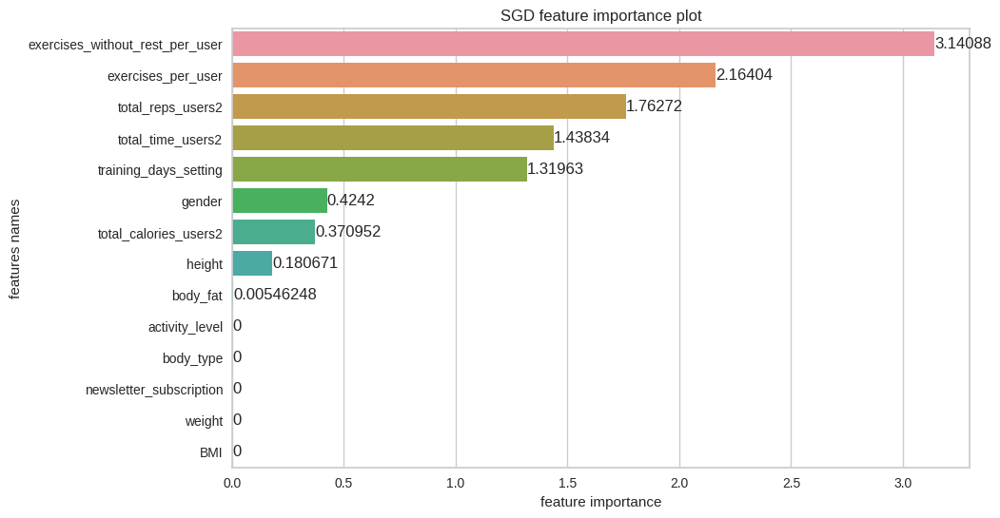

[SGD] Best parameters are {'alpha': 0.0002575, 'eta0': 0.0001, 'learning_rate': 'optimal', 'penalty': 'l1', 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Logistic Regression
[Logistic Regression] Features importances: [0.02279499 0.01876473 0.03832192 0.00669605 0.12015747 0.18577978
 0.02897166 0.23112678 1.64738549 2.07507906 1.57700557 0.53210053
 1.38750896 2.39954798]


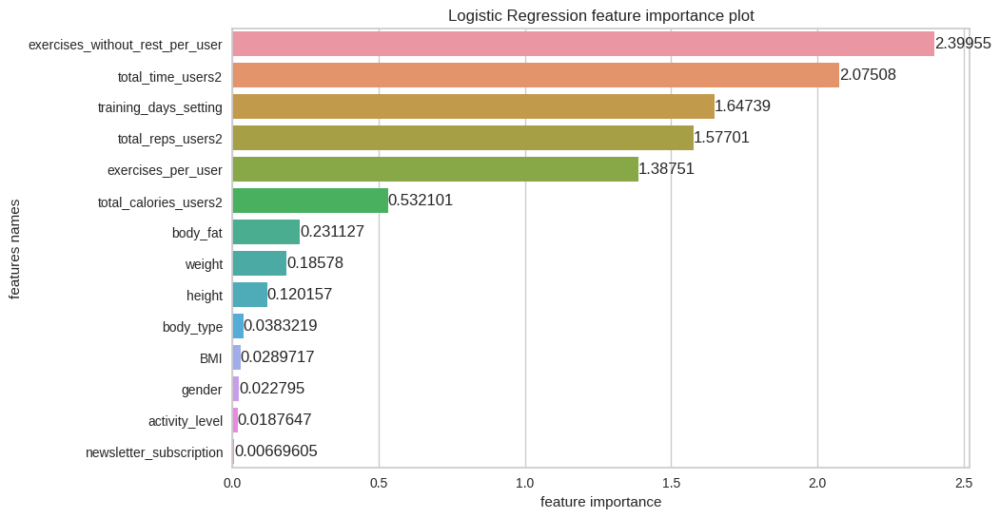

[Logistic Regression] Best parameters are {'C': 5, 'penalty': 'l2', 'random_state': 42, 'solver': 'liblinear'}
[INFO] Performing Grid-Search CV ---- Decision Tree
[Decision Tree] Features importances: [0.0, 0.0, 0.0, 0.0, 0.0030400501709949824, 0.015311735428089284, 0.010808143222774165, 0.008605522038548745, 0.3810587049444776, 0.47179848579299877, 0.07184624240026245, 0.004017898342620689, 0.026378914641074207, 0.007134303018159152]


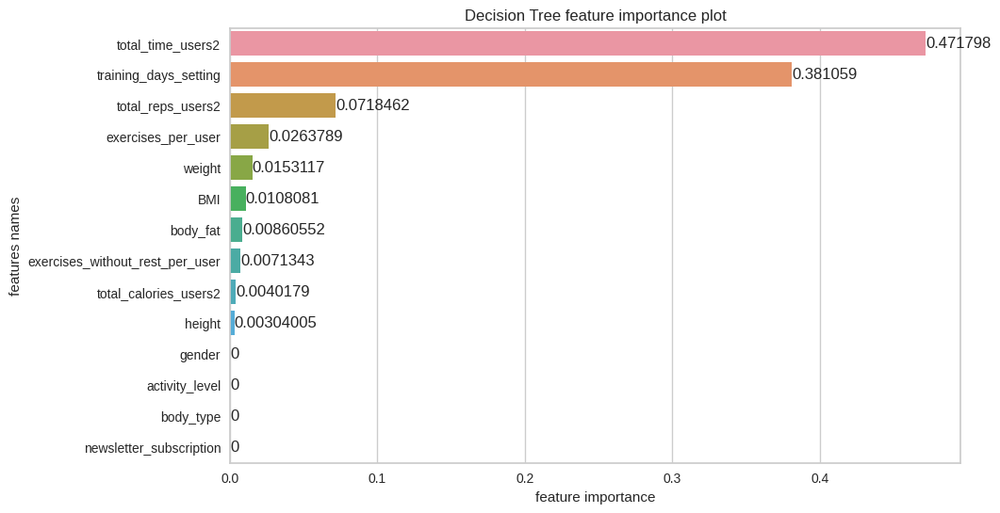

[Decision Tree] Best parameters are {'criterion': 'gini', 'max_depth': 6, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Random Forest
[Random Forest] Features importances: [0.0015461541709378337, 0.0005262675915683958, 0.00024519352985440633, 0.0009869149655161637, 0.0041431038072401154, 0.0006688703985652835, 0.007745433375827103, 0.003745434481600848, 0.05083241111728237, 0.21503365803165825, 0.18528809573197577, 0.19214203171110733, 0.17440557122155165, 0.16269085986531448]


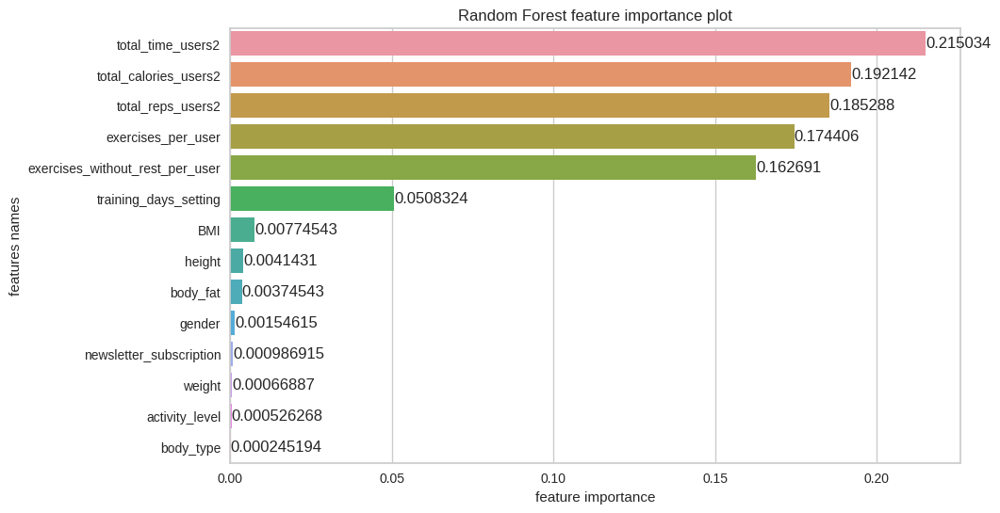

[Random Forest] Best parameters are {'criterion': 'gini', 'max_depth': 3, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- AdaBoost
[AdaBoost] Features importances: [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.375, 0.1375, 0.325, 0.0625, 0.05, 0.05]


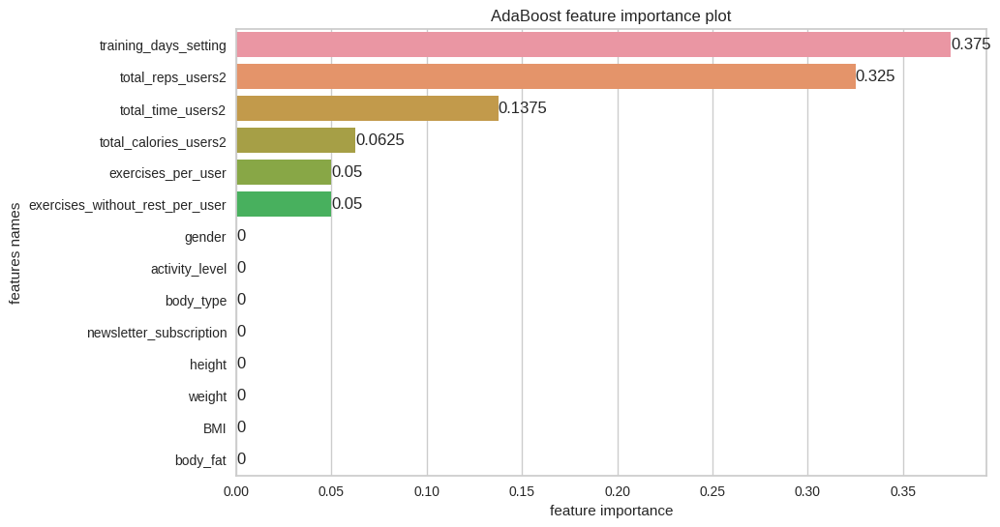

[AdaBoost] Best parameters are {'base_estimator': DecisionTreeClassifier(max_depth=1), 'learning_rate': 0.1, 'n_estimators': 80, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- GradientBoost
[GradientBoost] Features importances: [0.003933472494156674, 0.005179799054046106, 0.0, 0.002556249164353445, 0.0, 0.004411333886356197, 0.0036565990172629003, 0.0, 0.15583712624908092, 0.14283361797723132, 0.20163572102148378, 0.15110642993338452, 0.17260448848062424, 0.15624516272201996]


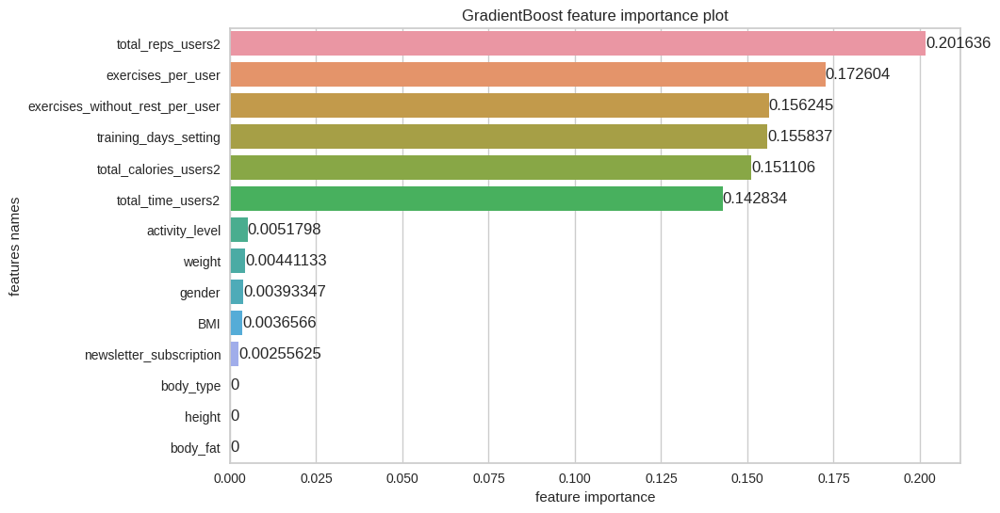

[GradientBoost] Best parameters are {'criterion': 'friedman_mse', 'learning_rate': 0.075, 'loss': 'deviance', 'max_depth': 3, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'n_estimators': 15, 'random_state': 42, 'subsample': 0.85}


In [187]:
estimators_multiclass_seven, X_test_seven, y_test_seven, X_train_seven, y_train_seven, X_test_inv_seven, features_seven = train(X_adh_cat_seven, y_adh_cat_seven, 
                                                         grid_params_multiclass, 
                                                         seed)

evaluation_table_seven = evaluate_multiclass(estimators_multiclass_seven, X_test_seven, y_test_seven, no_of_labels = 2, features_selected = False, features = features_seven)


In [188]:
evaluation_table_seven

,Overall Accuracy,Balanced Accuracy,Adj Balanced Accuracy,Precision,Recall,Cohen's kappa,Mathews Correlation Coefficient
SGD,0.79,0.75,0.51,0.81,0.60,0.54,0.55
Logistic Regression,0.82,0.79,0.58,0.82,0.68,0.60,0.61
Decision Tree,0.82,0.82,0.63,0.75,0.80,0.62,0.62
Random Forest,0.75,0.73,0.46,0.68,0.64,0.46,0.46
AdaBoost,0.83,0.82,0.63,0.78,0.77,0.63,0.63
GradientBoost,0.75,0.72,0.45,0.71,0.60,0.46,0.47


Overall, the best algorithm here is AdaBoost with Decision Tree Classifier with max depth equal to 1, learning rate is 0.1 and number of estimators is 80. The overall accuracy is 83%, precision is 78%, recall is 77%, Cohen's kappa is 0.63 and MCC is also 0.63.

In [189]:
prediction_for_one_user(estimators_multiclass_seven, X_test_seven, y_test_seven, X_test_inv_seven, X_adh_cat_seven.columns, y_adh_cat_seve.columns, name = 'AdaBoost')


,gender,activity_level,body_type,newsletter_subscription,height,weight,BMI,body_fat,training_days_setting,total_time_users2,total_reps_users2,total_calories_users2,exercises_per_user,exercises_without_rest_per_user,Adherence category,Adherence category_prediction
704,0.00,0.00,2.00,1.00,165.00,57.00,20.94,20.00,2.00,18659.00,3086.00,1003.47,16229.00,10699.00,0,1


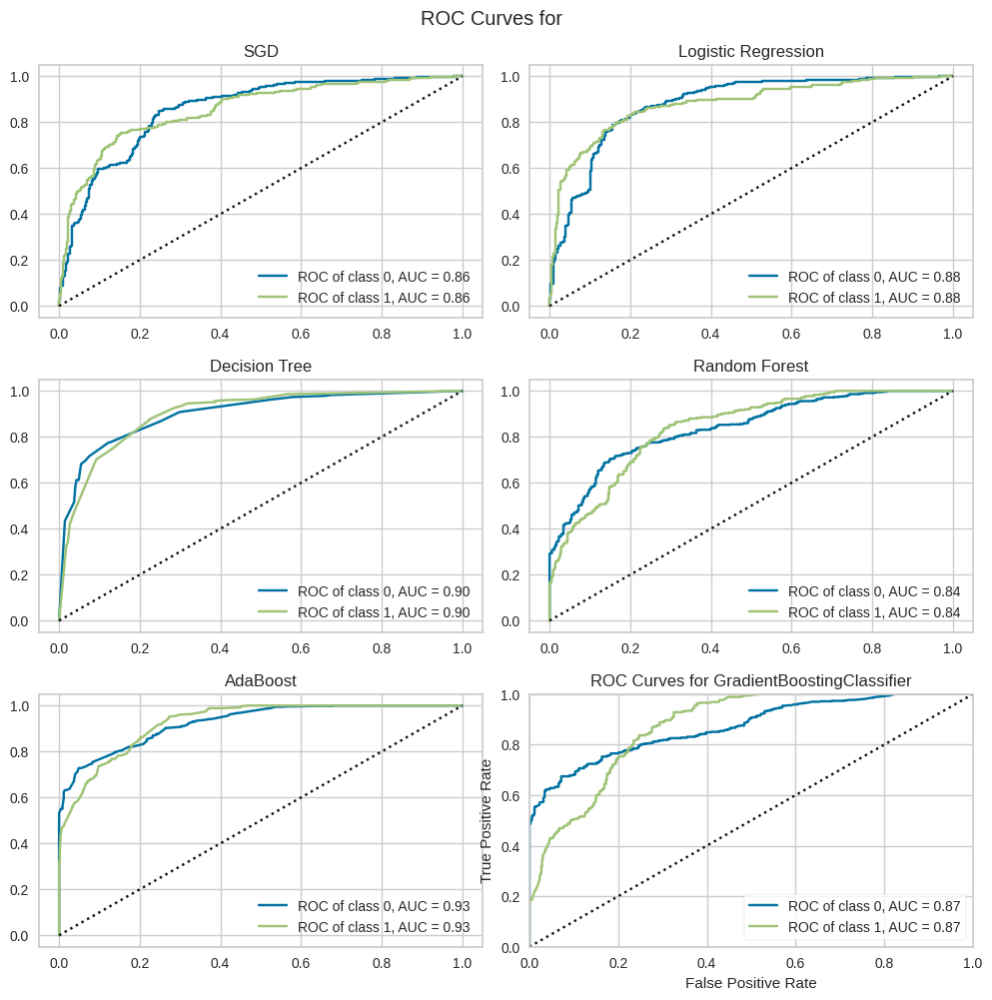

<AxesSubplot: title={'center': 'ROC Curves for GradientBoostingClassifier'}, xlabel='False Positive Rate', ylabel='True Positive Rate'>

In [190]:
ROC_curves(estimators_multiclass_seven, X_train_seven, y_train_seven, X_test_seven, y_test_seven, np.unique(y_adh_cat_seven), name = 'all', features_selected = False, features = features_seven)


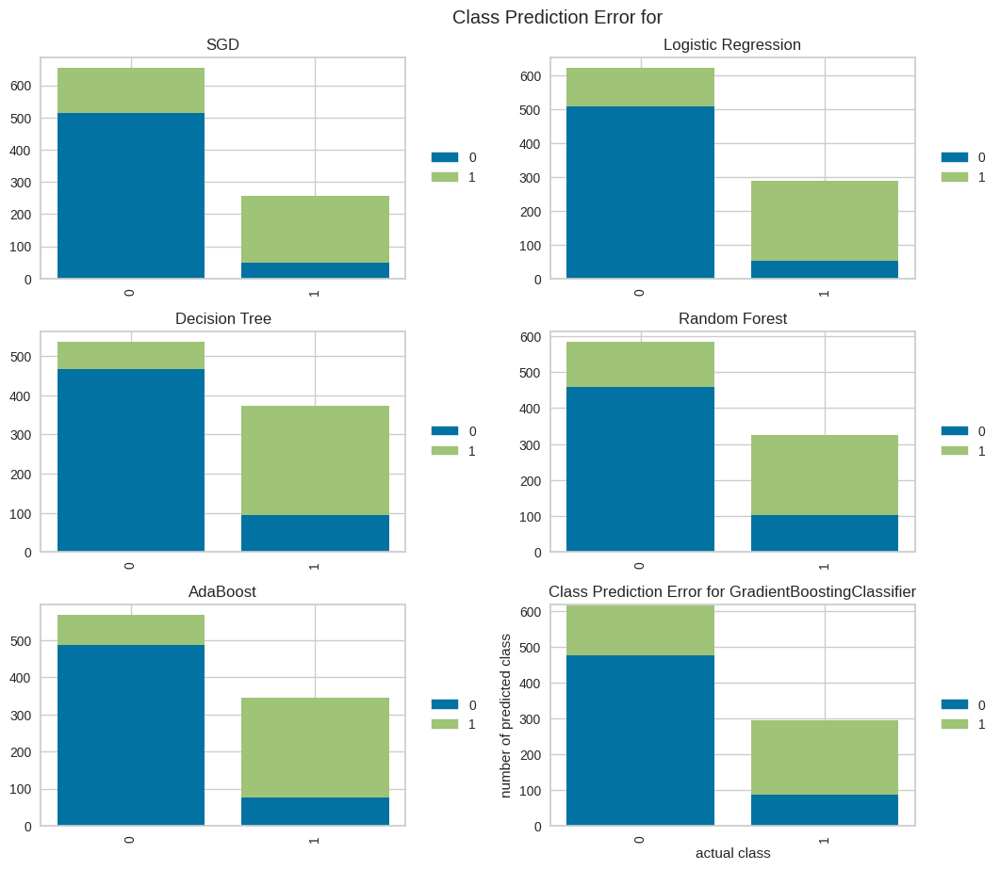

<AxesSubplot: title={'center': 'Class Prediction Error for GradientBoostingClassifier'}, xlabel='actual class', ylabel='number of predicted class'>

In [191]:
prediction_error_plot(estimators_multiclass_seven, X_train_seven, y_train_seven, X_test_seven, y_test_seven, np.unique(y_adh_cat_seven), name = 'all', features_selected = False, features = features_seven)


### Eighth approach (2 groups, minimum 3 days trained/first 8 weeks)

This approach is connected to users demographics and first 8 weeks of workouts. 

So, we take first 8 weeks of workouts and:
* Group 1 - user worked out for at least 3 days (1469 users),
* Group 0 - user didn't work out for at least 3 days (1565 users).

Variables taken into consideration are:

* gender,
* body_type,
* newsletter_subscription,
* height,
* weight,
* body_fat,
* activity_level.

In [192]:
# deleting label from data
X_demo_adh_8_3 = df_users_demo_any_adh_8_3.loc[:, df_users_demo_any_adh_8_3.columns != 'Adh']

# variable only with label
y_demo_adh_8_3 = df_users_demo_any_adh_8_3['Adh'].to_numpy()


cat_cols = ['gender', 'body_type', 'newsletter_subscription', 'activity_level']
X_demo_adh_8_3 = pd.get_dummies(X_demo_adh_8_3, columns = cat_cols, drop_first = True)

#X_demo_adh = OrdinalEncoder().fit_transform(X_demo_adh)
y_demo_ad_8_3 = pd.DataFrame(y_demo_adh_8_3, columns = ['Adherence group'])

In [193]:
y_demo_ad_8_3.shape

(3034, 1)

In [194]:
X_demo_adh_8_3.shape

(3034, 9)

[INFO] Performing Grid-Search CV ---- SGD
[SGD] Features importances: [0.13249424 0.11348211 0.18515307 0.22501592 0.05782814 0.01409477
 0.04951837 0.40262173 0.13914254]


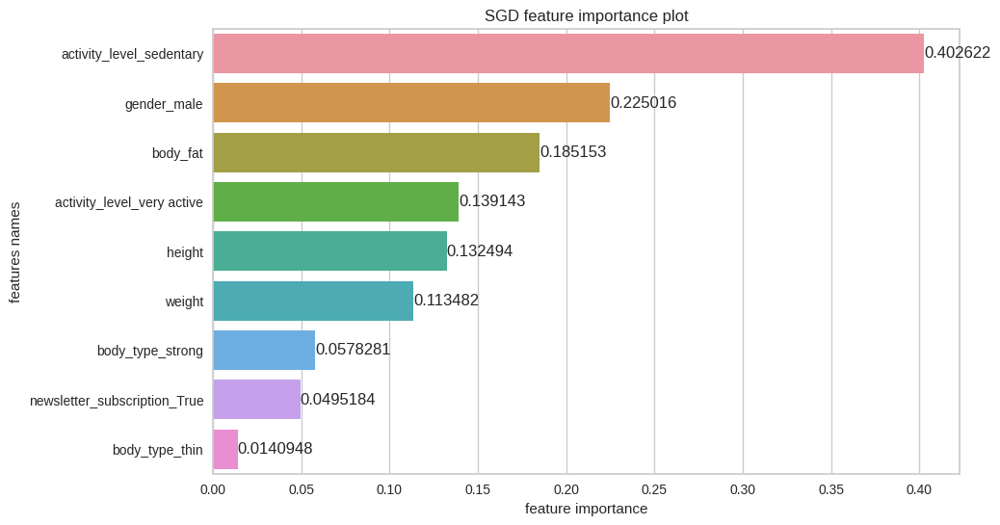

[SGD] Best parameters are {'alpha': 0.001, 'eta0': 0.0001, 'learning_rate': 'adaptive', 'penalty': 'l1', 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Logistic Regression
[Logistic Regression] Features importances: [0.17993706 0.34055574 0.00681581 0.20092319 0.02973686 0.04112927
 0.03567184 0.22091893 0.07735973]


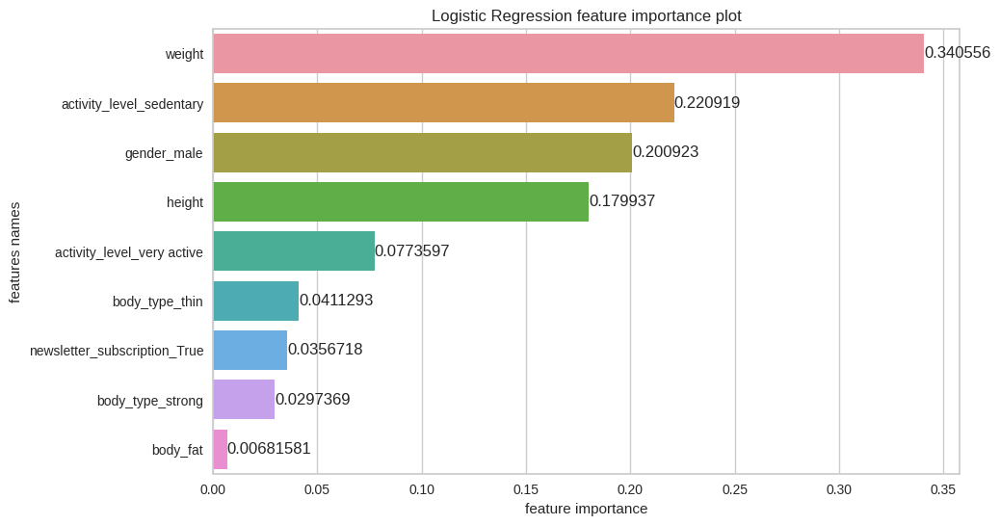

[Logistic Regression] Best parameters are {'C': 2, 'penalty': 'l1', 'random_state': 42, 'solver': 'liblinear'}
[INFO] Performing Grid-Search CV ---- Decision Tree
[Decision Tree] Features importances: [0.31764692838568187, 0.312222832930788, 0.15047113261991332, 0.023913038765530647, 0.023522897100093525, 0.048266107322359766, 0.027497904490801767, 0.0825418916688417, 0.013917266715989349]


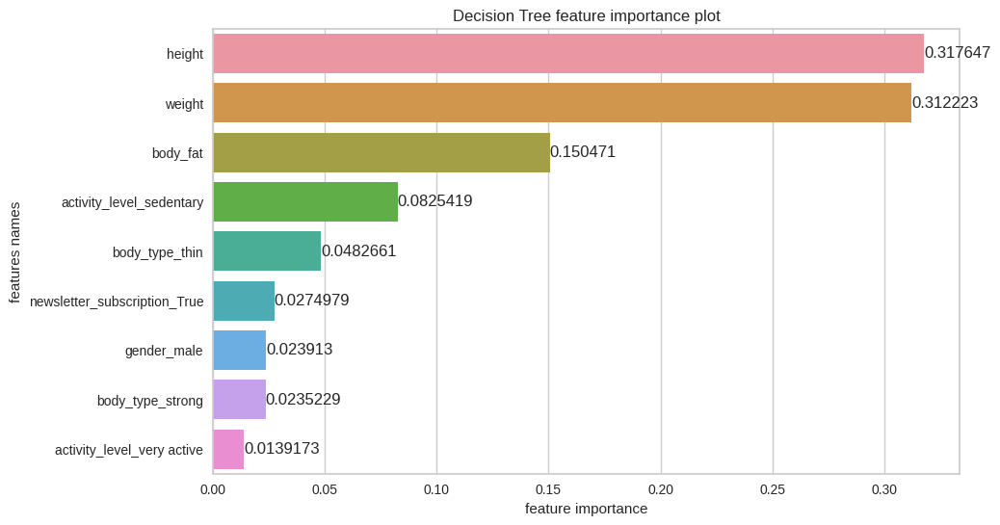

[Decision Tree] Best parameters are {'criterion': 'entropy', 'max_depth': 9, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Random Forest
[Random Forest] Features importances: [0.11020758202859707, 0.13407909801411258, 0.21099335421015591, 0.14466029554080884, 0.0, 0.01008856965630299, 0.0025383401610425903, 0.3874327603889801, 0.0]


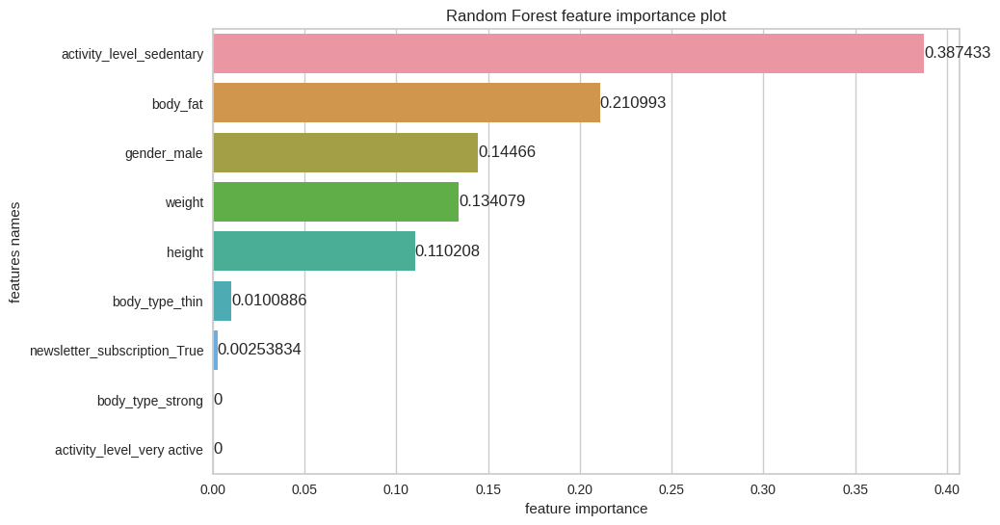

[Random Forest] Best parameters are {'criterion': 'gini', 'max_depth': 3, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.26, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- AdaBoost
[AdaBoost] Features importances: [0.1571875218771525, 0.3519866218819744, 0.13102150247001138, 0.07783095026970727, 0.0, 0.014642394680909176, 0.02729165063371833, 0.21409061351574565, 0.025948744670781308]


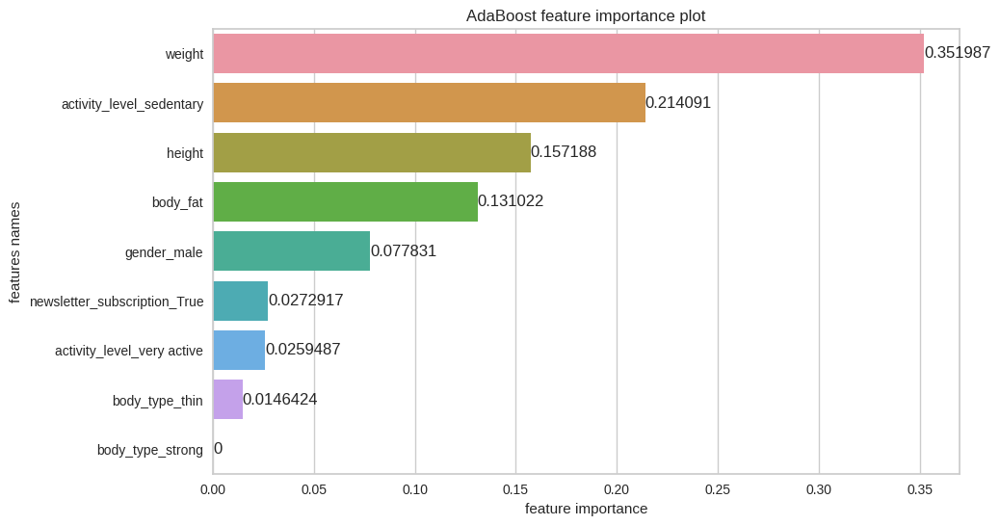

[AdaBoost] Best parameters are {'base_estimator': DecisionTreeClassifier(max_depth=3), 'learning_rate': 0.1, 'n_estimators': 20, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- GradientBoost
[GradientBoost] Features importances: [0.15683474066720385, 0.17465292705386598, 0.17025342033763297, 0.1872400325342676, 0.0, 0.0004346106950625594, 0.0, 0.3105842687119671, 0.0]


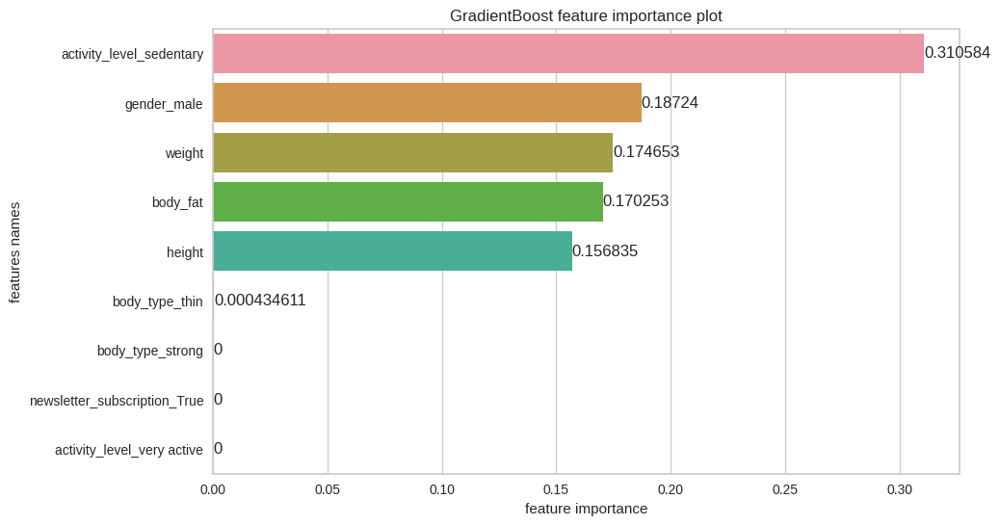

[GradientBoost] Best parameters are {'criterion': 'friedman_mse', 'learning_rate': 0.025, 'loss': 'deviance', 'max_depth': 3, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.30000000000000004, 'n_estimators': 15, 'random_state': 42, 'subsample': 0.5}


In [195]:
estimators_multiclass_8_3, X_test_8_3, y_test_8_3, X_train_8_3, y_train_8_3, X_test_inv_8_3, features_8_3 = train(X_demo_adh_8_3, y_demo_adh_8_3, 
                                                         grid_params_multiclass, 
                                                         seed, feature_selection = False)

In [196]:
evaluation_table_8_3 = evaluate_multiclass(estimators_multiclass_8_3, X_test_8_3, y_test_8_3, no_of_labels = 3, features_selected = False, features = features_8_3)

In [197]:
evaluation_table_8_3

,Overall Accuracy,Balanced Accuracy,Adj Balanced Accuracy,Precision micro,Precision macro,Precision weighted,Recall micro,Recall macro,Recall weighted,Cohen's kappa,Mathews Correlation Coefficient
SGD,0.59,0.59,0.18,0.59,0.59,0.59,0.59,0.59,0.59,0.18,0.18
Logistic Regression,0.57,0.57,0.15,0.57,0.57,0.57,0.57,0.57,0.57,0.15,0.15
Decision Tree,0.56,0.56,0.11,0.56,0.56,0.56,0.56,0.56,0.56,0.11,0.11
Random Forest,0.57,0.56,0.13,0.57,0.57,0.57,0.57,0.56,0.57,0.13,0.13
AdaBoost,0.59,0.59,0.17,0.59,0.59,0.59,0.59,0.59,0.59,0.17,0.17
GradientBoost,0.56,0.55,0.10,0.56,0.57,0.57,0.56,0.55,0.56,0.10,0.12


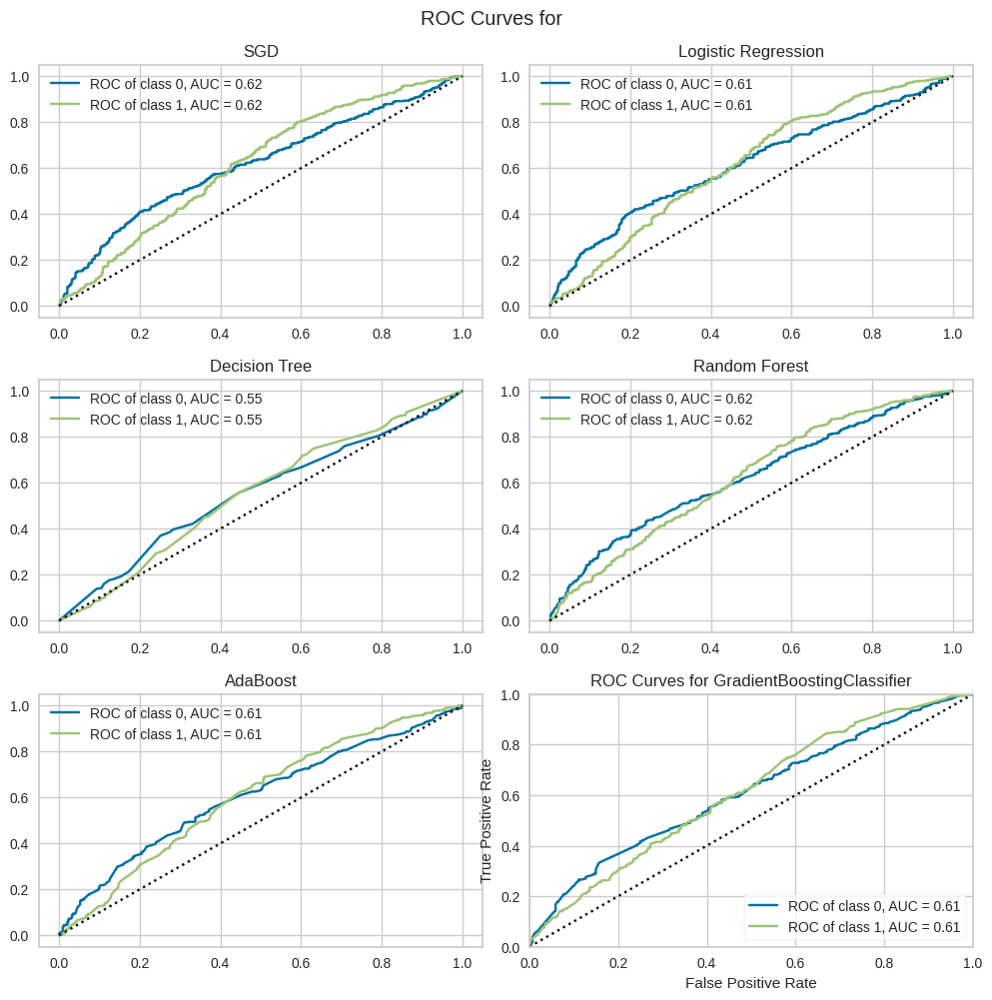

<AxesSubplot: title={'center': 'ROC Curves for GradientBoostingClassifier'}, xlabel='False Positive Rate', ylabel='True Positive Rate'>

In [198]:
ROC_curves(estimators_multiclass_8_3, X_train_8_3, y_train_8_3, X_test_8_3, y_test_8_3, np.unique(y_demo_adh_8_3), name = 'all', features_selected = False, features = features_8_3)


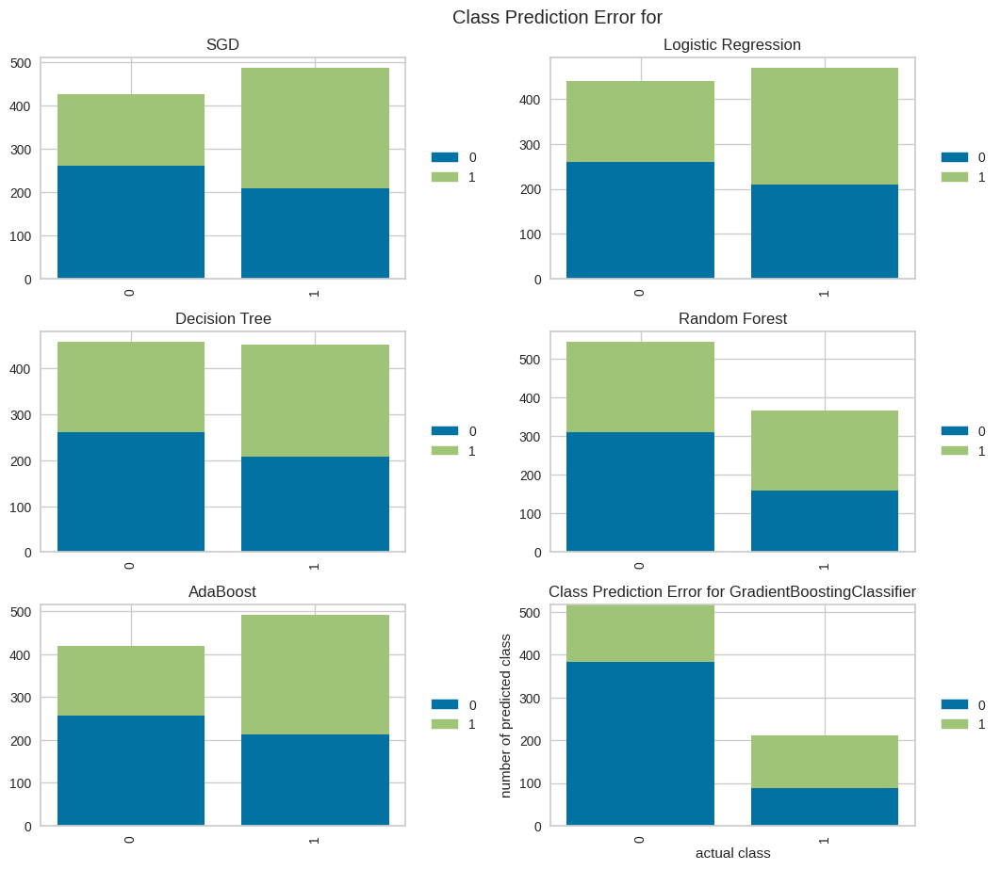

<AxesSubplot: title={'center': 'Class Prediction Error for GradientBoostingClassifier'}, xlabel='actual class', ylabel='number of predicted class'>

In [199]:
prediction_error_plot(estimators_multiclass_8_3, X_train_8_3, y_train_8_3, X_test_8_3, y_test_8_3, np.unique(y_demo_adh_8_3), name = 'all', features_selected = False, features = features_8_3)

#### With feature selection (by Univariate)

[INFO] Performing Grid-Search CV ---- SGD
[SGD] Features selected: Index(['height', 'weight', 'body_fat'], dtype='object')
[SGD] Features importances: [0.59106616 0.39071698 0.27753375]


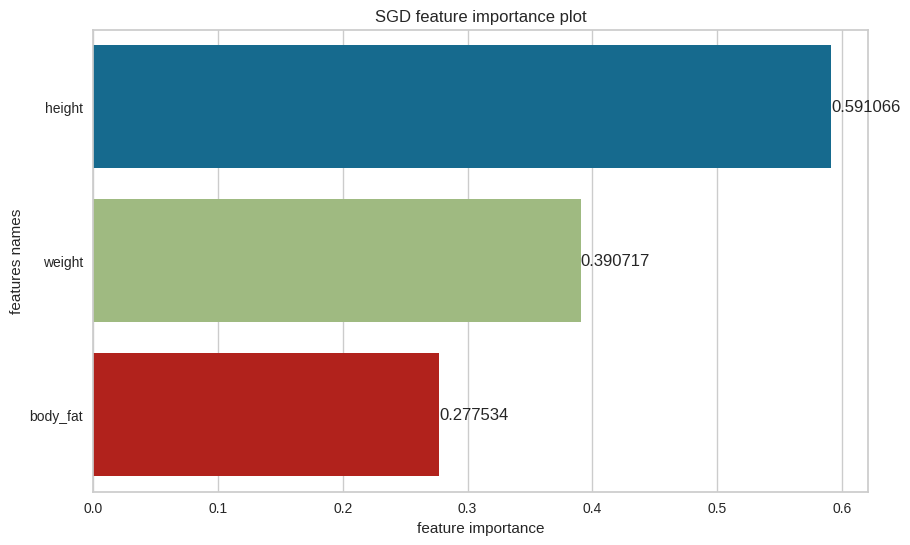

[SGD] Best parameters are {'alpha': 0.001, 'eta0': 0.1, 'learning_rate': 'adaptive', 'penalty': 'elasticnet', 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Logistic Regression
[Logistic Regression] Features selected: Index(['height', 'weight', 'body_fat'], dtype='object')
[Logistic Regression] Features importances: [0.30659424 0.27166467 0.10473861]


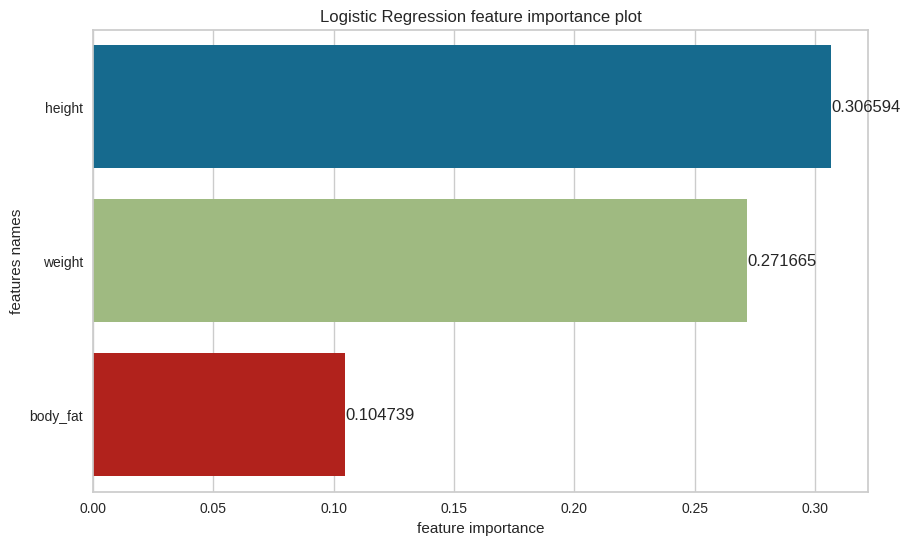

[Logistic Regression] Best parameters are {'C': 1, 'penalty': 'l2', 'random_state': 42, 'solver': 'liblinear'}
[INFO] Performing Grid-Search CV ---- Decision Tree
[Decision Tree] Features selected: Index(['height', 'weight', 'body_fat'], dtype='object')
[Decision Tree] Features importances: [0.36774357685003295, 0.44887462722943294, 0.183381795920534]


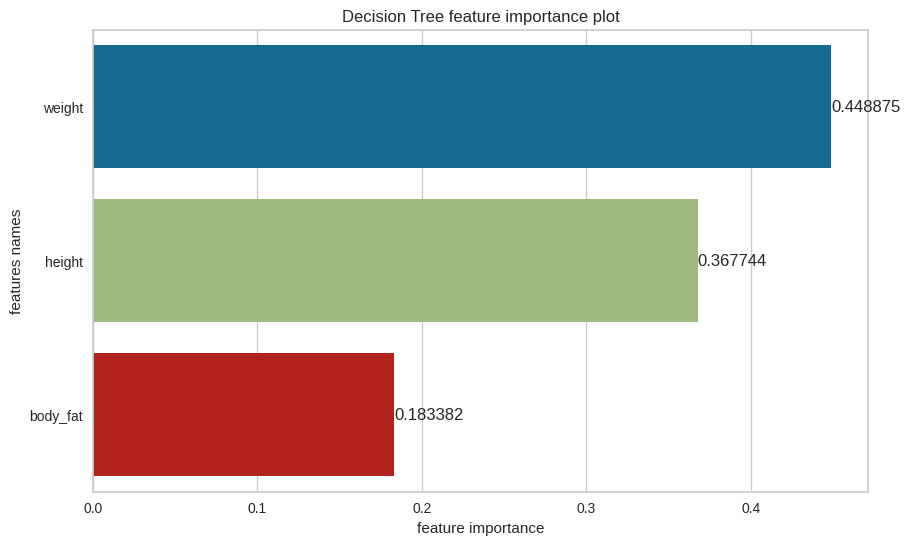

[Decision Tree] Best parameters are {'criterion': 'gini', 'max_depth': 12, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Random Forest
[Random Forest] Features selected: Index(['height', 'weight', 'body_fat'], dtype='object')
[Random Forest] Features importances: [0.3780284742835612, 0.33666660686208394, 0.2853049188543549]


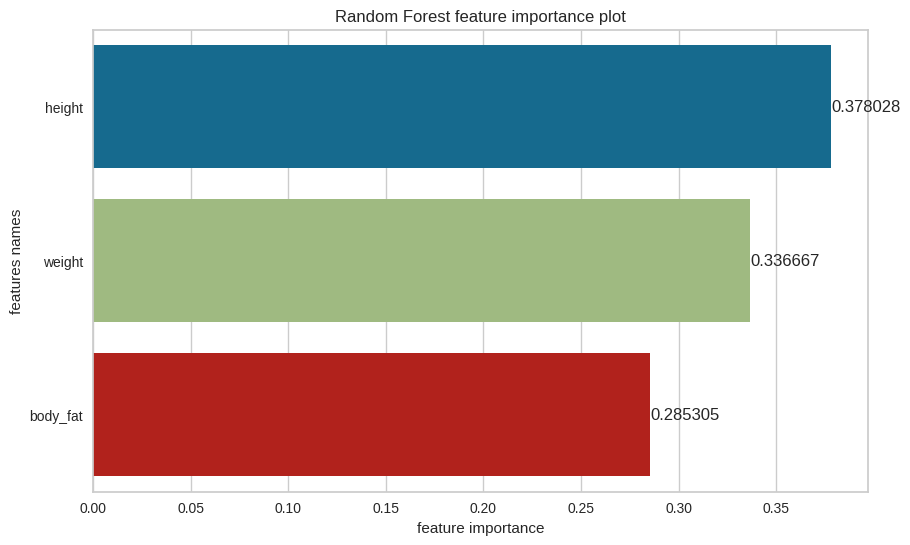

[Random Forest] Best parameters are {'criterion': 'gini', 'max_depth': 3, 'max_features': 'log2', 'min_samples_leaf': 0.18, 'min_samples_split': 0.1, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- AdaBoost
[AdaBoost] Features selected: Index(['height', 'weight', 'body_fat'], dtype='object')
[AdaBoost] Features importances: [0.28939531828601905, 0.44048719673012793, 0.270117484983853]


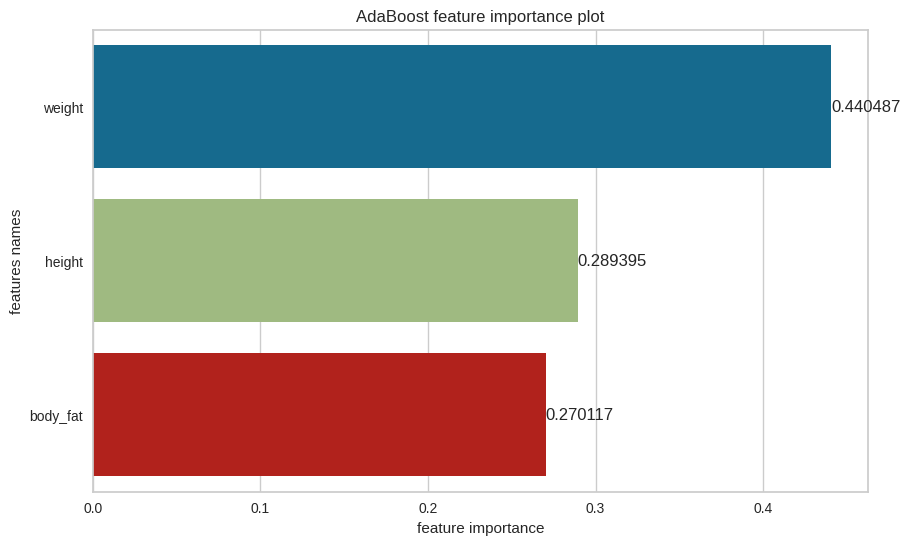

[AdaBoost] Best parameters are {'base_estimator': DecisionTreeClassifier(max_depth=3), 'learning_rate': 0.1, 'n_estimators': 20, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- GradientBoost
[GradientBoost] Features selected: Index(['height', 'weight', 'body_fat'], dtype='object')
[GradientBoost] Features importances: [0.2958235967429686, 0.2272208127094556, 0.4769555905475759]


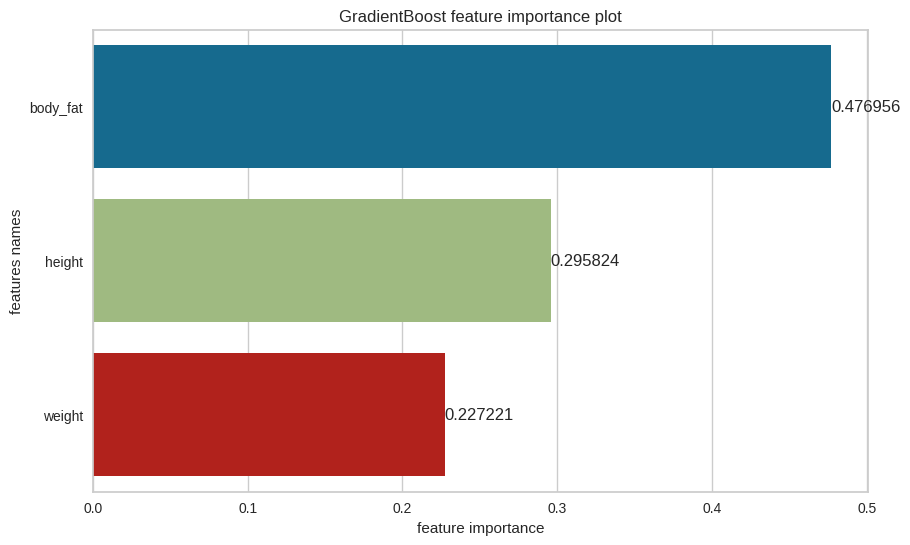

[GradientBoost] Best parameters are {'criterion': 'friedman_mse', 'learning_rate': 0.075, 'loss': 'deviance', 'max_depth': 3, 'max_features': 'log2', 'min_samples_leaf': 0.2, 'min_samples_split': 0.1, 'n_estimators': 15, 'random_state': 42, 'subsample': 0.85}


In [200]:
estimators_multiclass_sel_8_3_u, X_test_sel_8_3_u, y_test_sel_8_3_u, X_train_sel_8_3_u, y_train_sel_8_3_u, X_test_inv_sel_8_3_u, features_sel_8_3_u = train(X_demo_adh_8_3, y_demo_adh_8_3, 
                                                         grid_params_multiclass, 
                                                         seed, feature_selection = True, 
                                                         feature_sel_type = 'UNI')

In [201]:
evaluation_table_sel_8_3_u = evaluate_multiclass(estimators_multiclass_sel_8_3_u, X_test_sel_8_3_u, y_test_sel_8_3_u, no_of_labels = 3, features_selected = True, feature_sel_type = 'UNI', features = features_sel_8_3_u)


In [202]:
evaluation_table_sel_8_3_u

,Overall Accuracy,Balanced Accuracy,Adj Balanced Accuracy,Precision micro,Precision macro,Precision weighted,Recall micro,Recall macro,Recall weighted,Cohen's kappa,Mathews Correlation Coefficient
SGD,0.56,0.56,0.12,0.56,0.56,0.56,0.56,0.56,0.56,0.12,0.12
Logistic Regression,0.57,0.57,0.13,0.57,0.57,0.57,0.57,0.57,0.57,0.13,0.13
Decision Tree,0.53,0.53,0.06,0.53,0.53,0.53,0.53,0.53,0.53,0.06,0.06
Random Forest,0.55,0.54,0.08,0.55,0.55,0.55,0.55,0.54,0.55,0.08,0.09
AdaBoost,0.55,0.55,0.09,0.55,0.55,0.55,0.55,0.55,0.55,0.09,0.09
GradientBoost,0.56,0.55,0.11,0.56,0.56,0.56,0.56,0.55,0.56,0.11,0.12


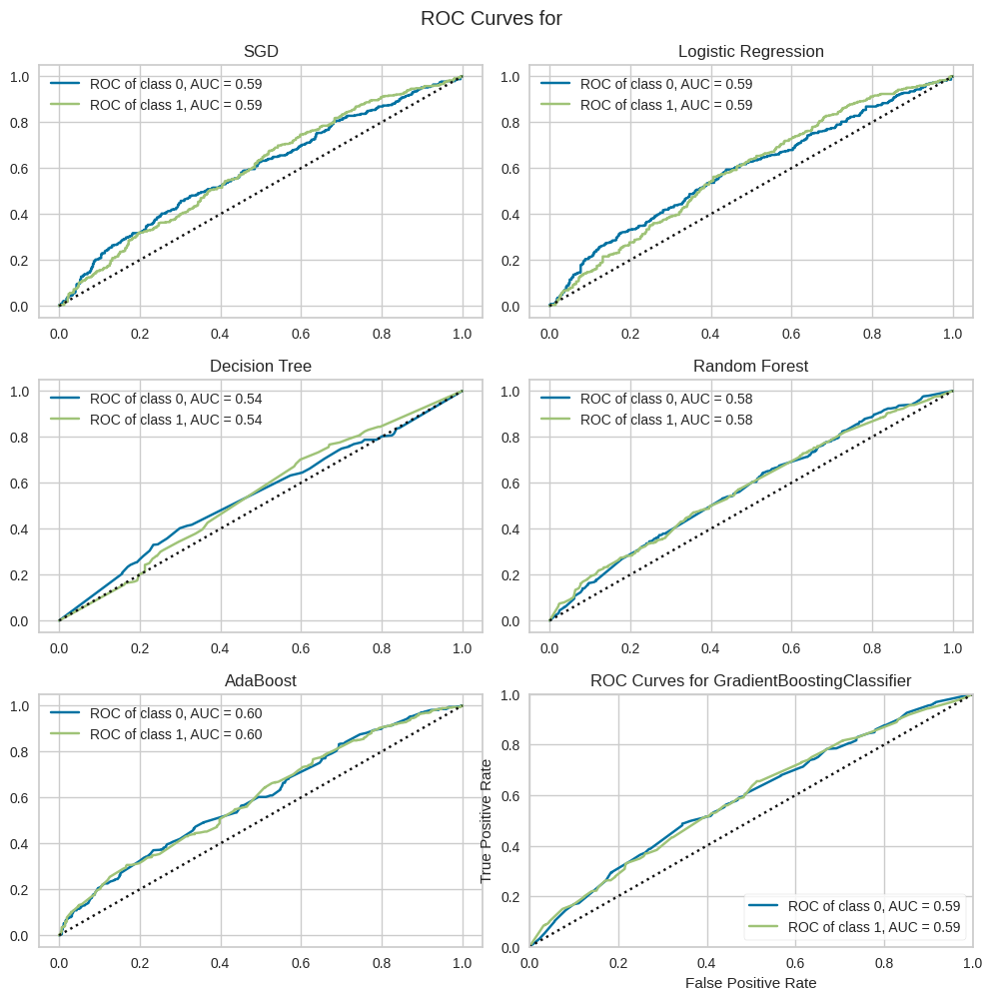

<AxesSubplot: title={'center': 'ROC Curves for GradientBoostingClassifier'}, xlabel='False Positive Rate', ylabel='True Positive Rate'>

In [203]:
ROC_curves(estimators_multiclass_sel_8_3_u, X_train_sel_8_3_u, y_train_sel_8_3_u, X_test_sel_8_3_u, y_test_sel_8_3_u, np.unique(y_demo_adh_8_3), name = 'all', features_selected = True, feature_sel_type = 'UNI', features = features_sel_8_3_u)


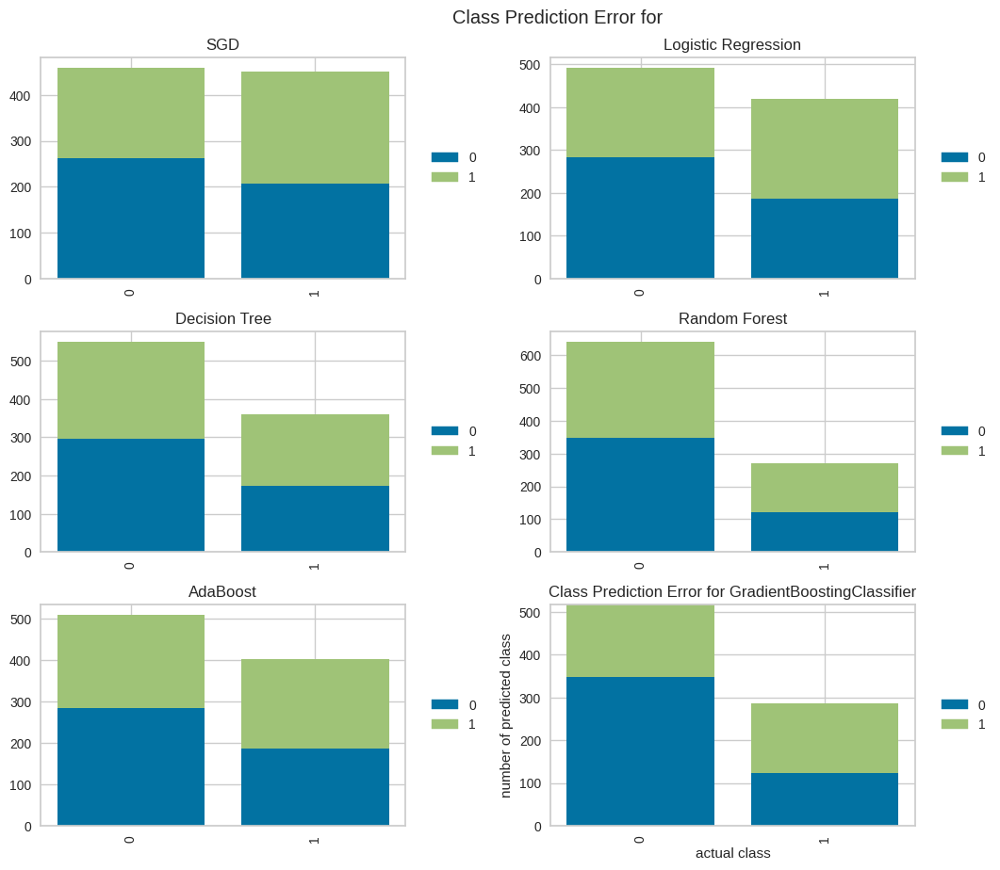

<AxesSubplot: title={'center': 'Class Prediction Error for GradientBoostingClassifier'}, xlabel='actual class', ylabel='number of predicted class'>

In [204]:
prediction_error_plot(estimators_multiclass_sel_8_3_u, X_train_sel_8_3_u, y_train_sel_8_3_u, X_test_sel_8_3_u, y_test_sel_8_3_u, np.unique(y_demo_adh_8_3), name = 'all', features_selected = True, feature_sel_type = 'UNI', features = features_sel_8_3_u)


#### With feature selection (by SequentialFeatureSelector)

In [205]:
estimators_multiclass_sel_8_3, X_test_sel_8_3, y_test_sel_8_3, X_train_sel_8_3, y_train_sel_8_3, X_test_inv_sel_8_3, features_sel_8_3 = train(X_demo_adh_8_3, y_demo_adh_8_3, 
                                                         grid_params_multiclass, 
                                                         seed, feature_selection = True, 
                                                         feature_sel_type = 'SFS')

[INFO] Performing Grid-Search CV ---- SGD
[SGD] Features selected: Index(['height', 'weight', 'body_fat', 'gender_male', 'body_type_thin',
       'activity_level_sedentary', 'activity_level_very active'],
      dtype='object')
[SGD] Best parameters are {'alpha': 0.000505, 'eta0': 0.0001, 'learning_rate': 'optimal', 'penalty': 'l2', 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Logistic Regression
[Logistic Regression] Features selected: Index(['height', 'weight', 'gender_male', 'body_type_strong', 'body_type_thin',
       'activity_level_sedentary', 'activity_level_very active'],
      dtype='object')
[Logistic Regression] Best parameters are {'C': 1, 'penalty': 'l2', 'random_state': 42, 'solver': 'liblinear'}
[INFO] Performing Grid-Search CV ---- Decision Tree
[Decision Tree] Features selected: Index(['body_type_strong', 'activity_level_sedentary',
       'activity_level_very active'],
      dtype='object')
[Decision Tree] Best parameters are {'criterion': 'gini', 'max_dep

In [206]:
evaluation_table_sel_8_3 = evaluate_multiclass(estimators_multiclass_sel_8_3, X_test_sel_8_3, y_test_sel_8_3, no_of_labels = 3, features_selected = True, feature_sel_type = 'SFS', features = features_sel_8_3)


In [207]:
evaluation_table_sel_8_3

,Overall Accuracy,Balanced Accuracy,Adj Balanced Accuracy,Precision micro,Precision macro,Precision weighted,Recall micro,Recall macro,Recall weighted,Cohen's kappa,Mathews Correlation Coefficient
SGD,0.59,0.59,0.18,0.59,0.59,0.60,0.59,0.59,0.59,0.18,0.18
Logistic Regression,0.57,0.57,0.14,0.57,0.57,0.57,0.57,0.57,0.57,0.14,0.14
Decision Tree,0.58,0.59,0.17,0.58,0.59,0.59,0.58,0.59,0.58,0.17,0.18
Random Forest,0.58,0.59,0.18,0.58,0.60,0.60,0.58,0.59,0.58,0.18,0.19
AdaBoost,0.55,0.55,0.10,0.55,0.55,0.55,0.55,0.55,0.55,0.10,0.10
GradientBoost,0.57,0.56,0.12,0.57,0.57,0.57,0.57,0.56,0.57,0.13,0.13


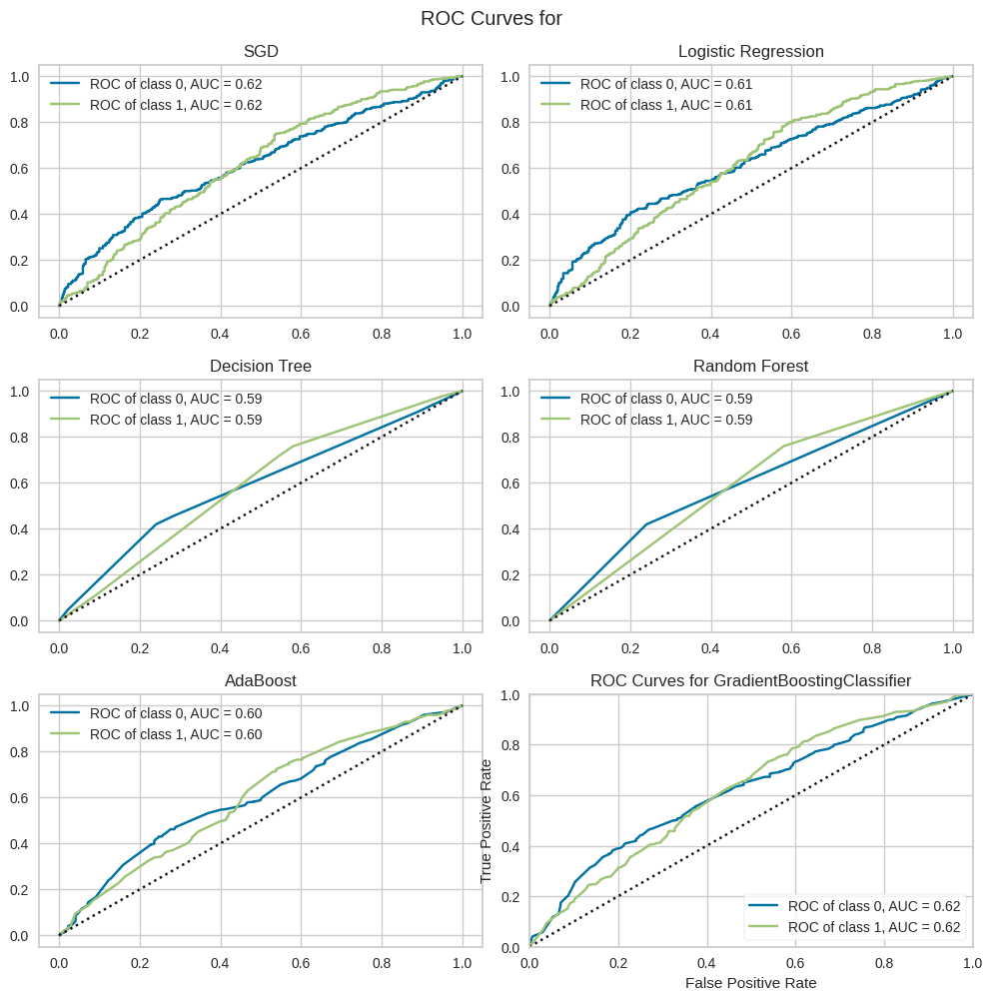

<AxesSubplot: title={'center': 'ROC Curves for GradientBoostingClassifier'}, xlabel='False Positive Rate', ylabel='True Positive Rate'>

In [208]:
ROC_curves(estimators_multiclass_sel_8_3, X_train_sel_8_3, y_train_sel_8_3, X_test_sel_8_3, y_test_sel_8_3, np.unique(y_demo_adh_8_3), name = 'all', features_selected = True, feature_sel_type = 'SFS', features = features_sel_8_3)


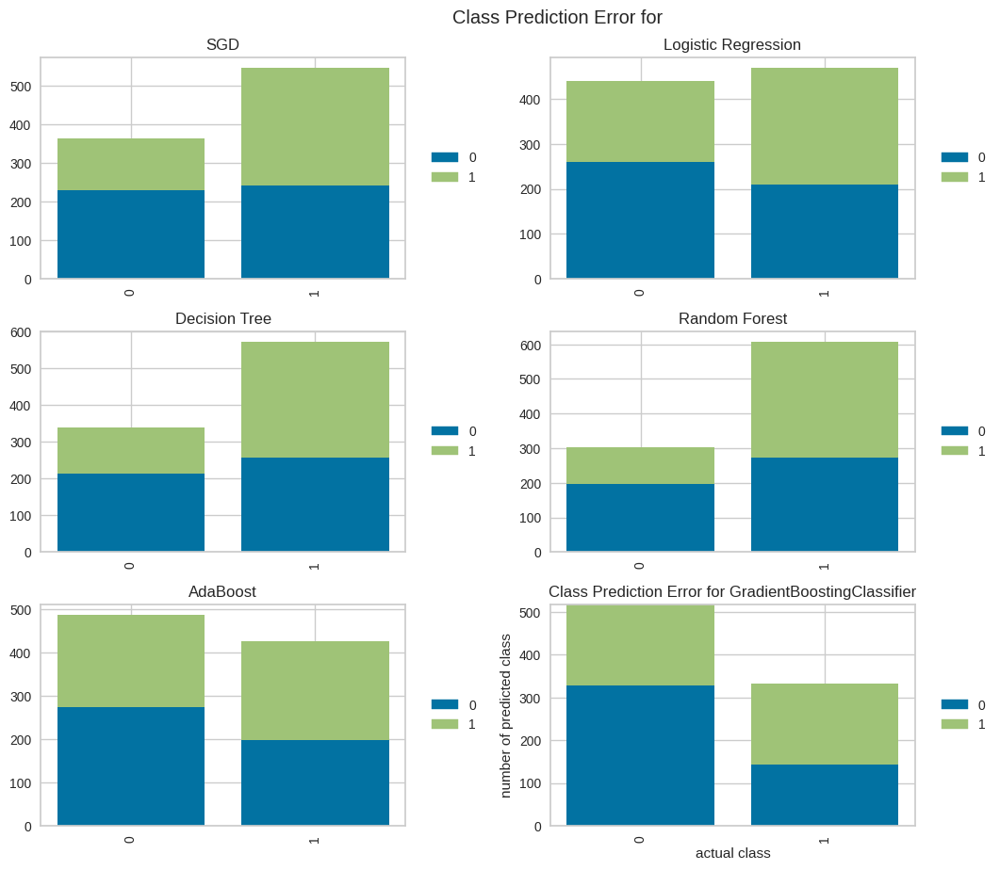

<AxesSubplot: title={'center': 'Class Prediction Error for GradientBoostingClassifier'}, xlabel='actual class', ylabel='number of predicted class'>

In [209]:
prediction_error_plot(estimators_multiclass_sel_8_3, X_train_sel_8_3, y_train_sel_8_3, X_test_sel_8_3, y_test_sel_8_3, np.unique(y_demo_adh_8_3), name = 'all', features_selected = True, feature_sel_type = 'SFS', features = features_sel_8_3)


#### With feature selection (by Recursive feature elimination with cross-validation - RFECV)

[INFO] Performing Grid-Search CV ---- SGD
[SGD] Features selected: Index(['height', 'weight', 'body_fat', 'gender_male', 'body_type_strong',
       'body_type_thin', 'newsletter_subscription_True',
       'activity_level_sedentary', 'activity_level_very active'],
      dtype='object')
[SGD] Features importances: [0.13249424 0.11348211 0.18515307 0.22501592 0.05782814 0.01409477
 0.04951837 0.40262173 0.13914254]


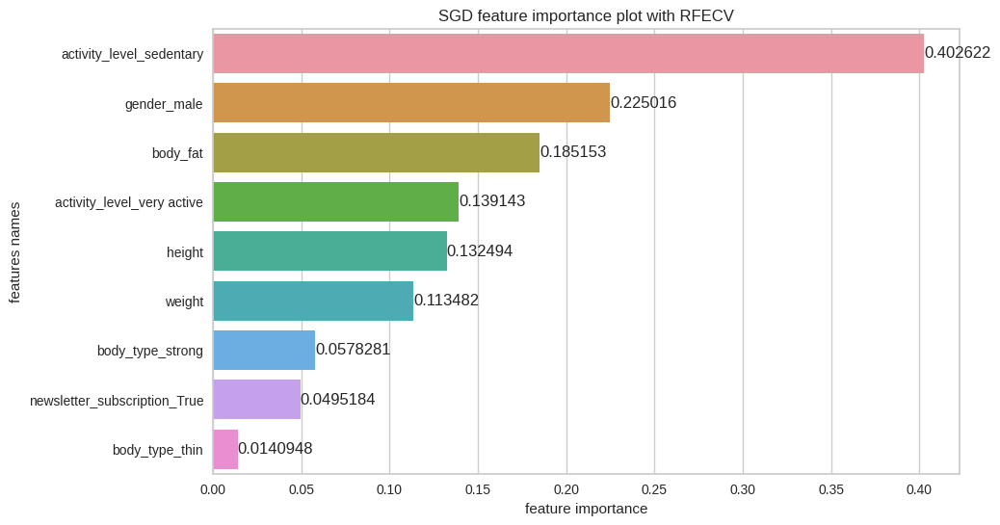

[SGD] Best parameters are {'alpha': 0.001, 'eta0': 0.0001, 'learning_rate': 'adaptive', 'penalty': 'l1', 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Logistic Regression
[Logistic Regression] Features selected: Index(['height', 'weight', 'gender_male', 'body_type_thin',
       'newsletter_subscription_True', 'activity_level_sedentary',
       'activity_level_very active'],
      dtype='object')
[Logistic Regression] Features importances: [0.19226086 0.3592425  0.19950794 0.03749891 0.03693292 0.22334701
 0.07852889]


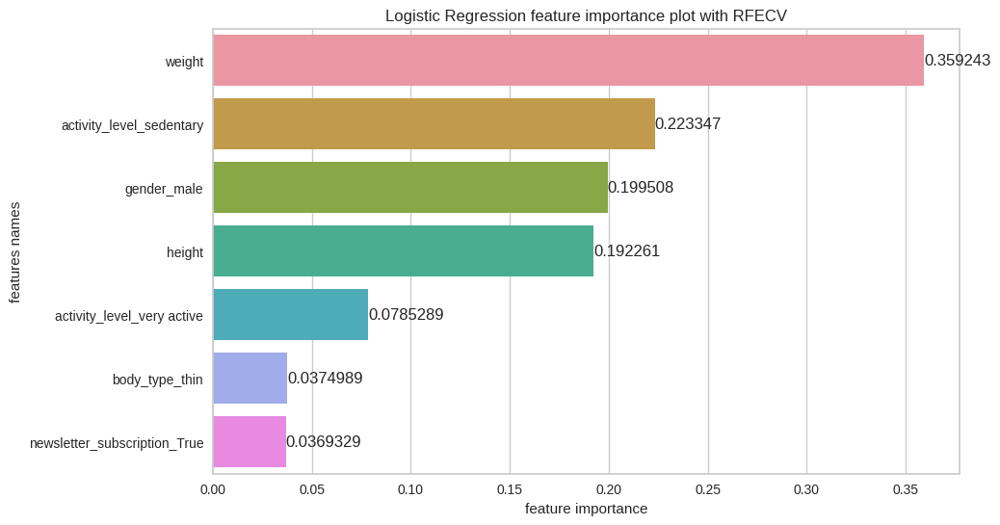

[Logistic Regression] Best parameters are {'C': 1, 'penalty': 'l2', 'random_state': 42, 'solver': 'liblinear'}
[INFO] Performing Grid-Search CV ---- Decision Tree
[Decision Tree] Features selected: Index(['weight'], dtype='object')
[Decision Tree] Features importances: [1.0]


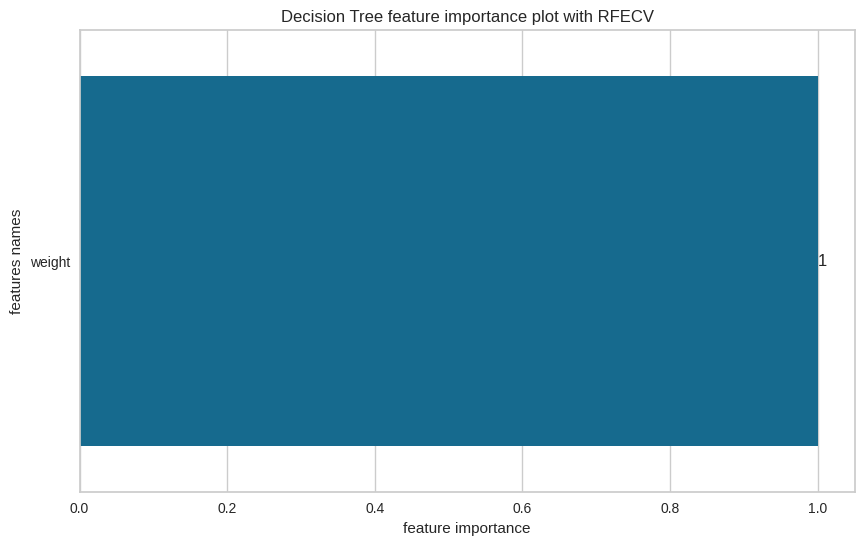

[Decision Tree] Best parameters are {'criterion': 'entropy', 'max_depth': 6, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Random Forest
[Random Forest] Features selected: Index(['height', 'weight', 'body_fat', 'gender_male', 'body_type_thin',
       'newsletter_subscription_True', 'activity_level_sedentary'],
      dtype='object')
[Random Forest] Features importances: [0.14274683448319075, 0.1657281157914726, 0.14870514405712268, 0.16138810450581526, 0.016859665772525005, 0.002703579786066549, 0.3618685556038073]


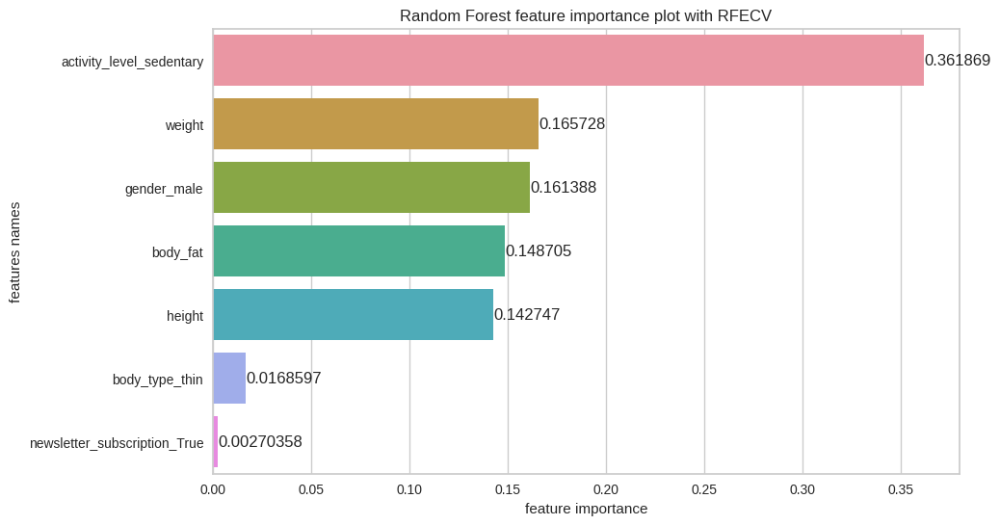

[Random Forest] Best parameters are {'criterion': 'gini', 'max_depth': 6, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- AdaBoost
[AdaBoost] Features selected: Index(['height', 'weight', 'body_fat', 'activity_level_sedentary',
       'activity_level_very active'],
      dtype='object')
[AdaBoost] Features importances: [0.0, 0.2, 0.15, 0.65, 0.0]


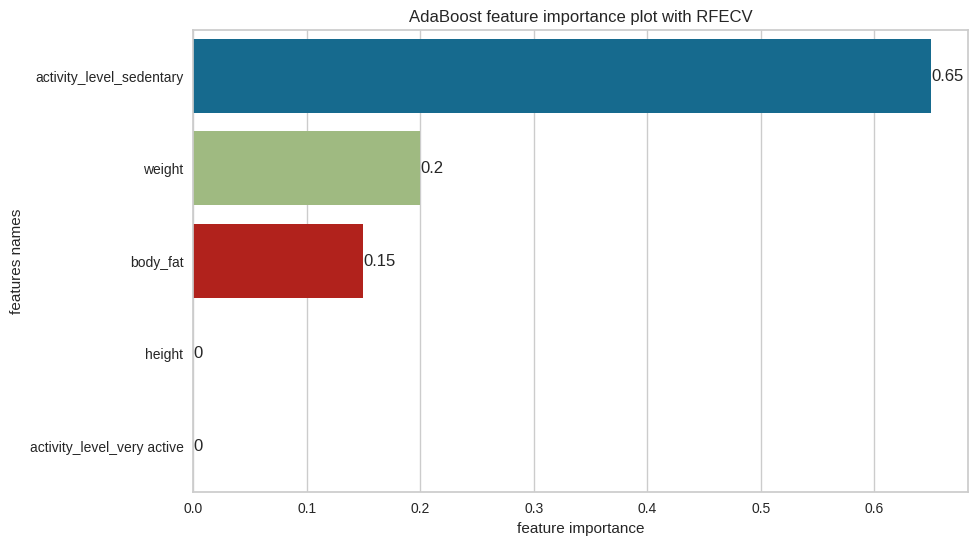

[AdaBoost] Best parameters are {'base_estimator': DecisionTreeClassifier(max_depth=1), 'learning_rate': 0.05, 'n_estimators': 20, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- GradientBoost
[GradientBoost] Features selected: Index(['height', 'weight', 'body_fat', 'gender_male',
       'activity_level_sedentary'],
      dtype='object')
[GradientBoost] Features importances: [0.1139397874160091, 0.030755181745065262, 0.30053804272546764, 0.13285813878313082, 0.4219088493303271]


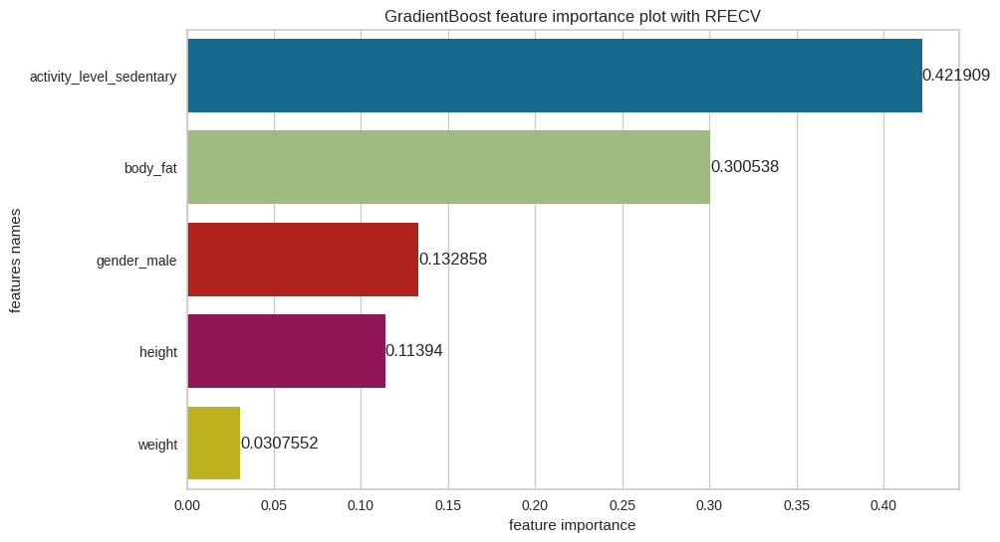

[GradientBoost] Best parameters are {'criterion': 'friedman_mse', 'learning_rate': 0.05, 'loss': 'deviance', 'max_depth': 3, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.4, 'n_estimators': 10, 'random_state': 42, 'subsample': 0.618}


In [210]:
estimators_multiclass_sel_8_3_rfecv, X_test_sel_8_3_rfecv, y_test_sel_8_3_rfecv, X_train_sel_8_3_rfecv, y_train_sel_8_3_rfecv, X_test_inv_sel_8_3_rfecv, features_sel_8_3_rfecv = train(X_demo_adh_8_3, y_demo_adh_8_3, 
                                                         grid_params_multiclass, 
                                                         seed, feature_selection = True, 
                                                         feature_sel_type = 'RFECV')

In [211]:
evaluation_table_sel_8_3_rfecv = evaluate_multiclass(estimators_multiclass_sel_8_3_rfecv, X_test_sel_8_3_rfecv, y_test_sel_8_3_rfecv, no_of_labels = 3, features_selected = True, feature_sel_type = 'RFECV', features = features_sel_8_3_rfecv)

In [212]:
evaluation_table_sel_8_3_rfecv

,Overall Accuracy,Balanced Accuracy,Adj Balanced Accuracy,Precision micro,Precision macro,Precision weighted,Recall micro,Recall macro,Recall weighted,Cohen's kappa,Mathews Correlation Coefficient
SGD,0.59,0.59,0.18,0.59,0.59,0.59,0.59,0.59,0.59,0.18,0.18
Logistic Regression,0.57,0.57,0.15,0.57,0.57,0.58,0.57,0.57,0.57,0.15,0.15
Decision Tree,0.54,0.53,0.07,0.54,0.53,0.53,0.54,0.53,0.54,0.07,0.07
Random Forest,0.57,0.57,0.14,0.57,0.57,0.57,0.57,0.57,0.57,0.14,0.14
AdaBoost,0.59,0.59,0.18,0.59,0.60,0.60,0.59,0.59,0.59,0.18,0.19
GradientBoost,0.56,0.55,0.11,0.56,0.56,0.56,0.56,0.55,0.56,0.11,0.11


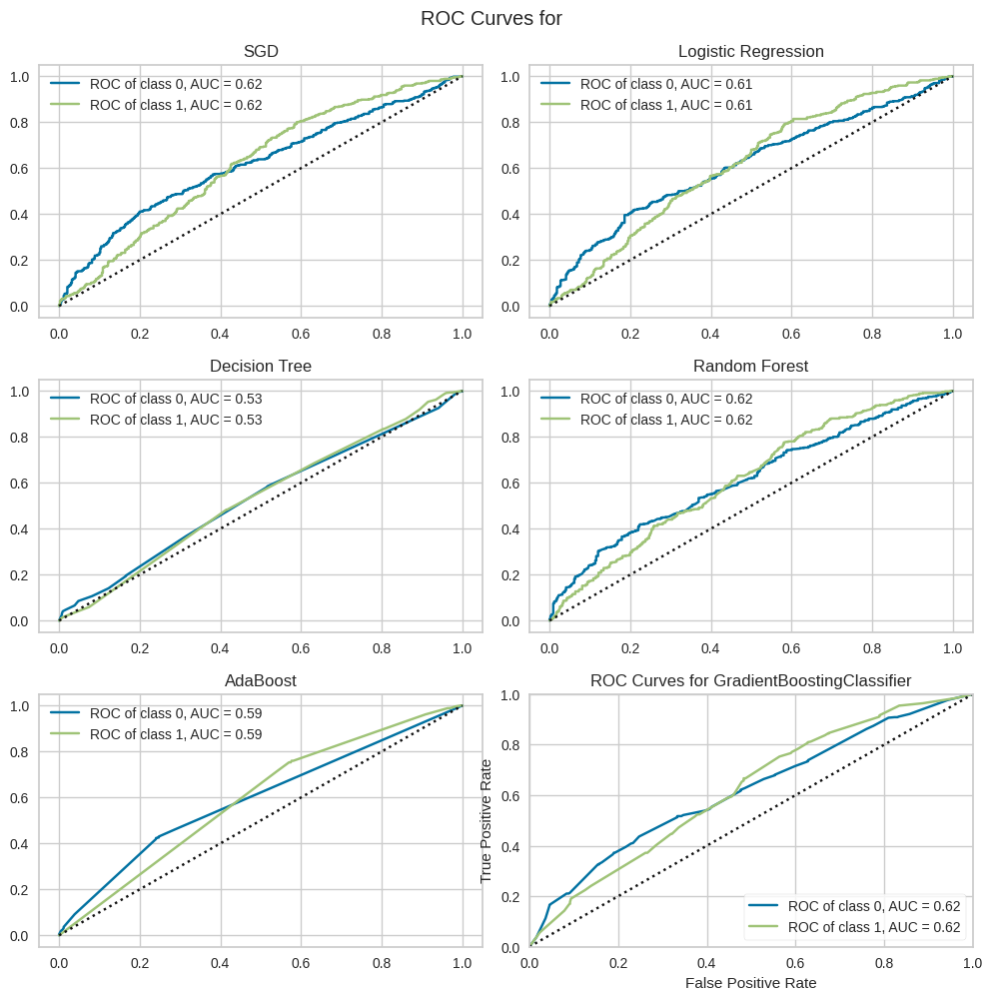

<AxesSubplot: title={'center': 'ROC Curves for GradientBoostingClassifier'}, xlabel='False Positive Rate', ylabel='True Positive Rate'>

In [213]:
ROC_curves(estimators_multiclass_sel_8_3_rfecv, X_train_sel_8_3_rfecv, y_train_sel_8_3_rfecv, X_test_sel_8_3_rfecv, y_test_sel_8_3_rfecv, np.unique(y_demo_adh_8_3), name = 'all', features_selected = True, feature_sel_type = 'RFECV', features = features_sel_8_3_rfecv)

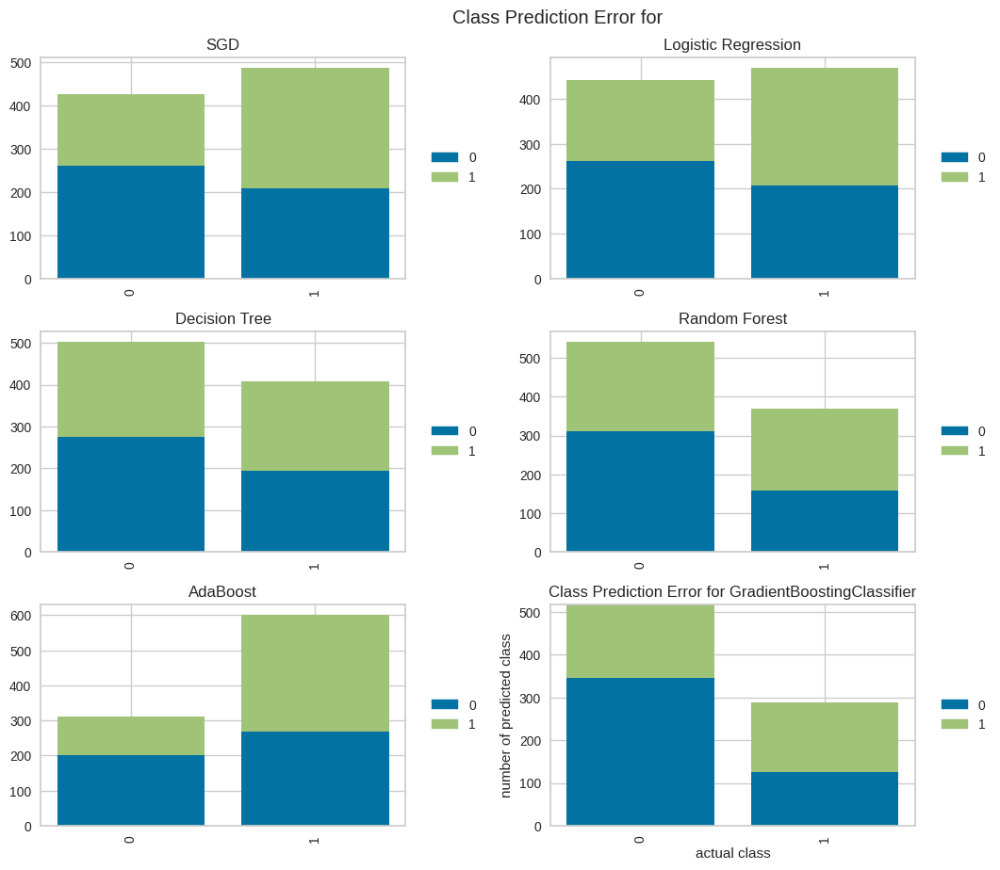

<AxesSubplot: title={'center': 'Class Prediction Error for GradientBoostingClassifier'}, xlabel='actual class', ylabel='number of predicted class'>

In [214]:
prediction_error_plot(estimators_multiclass_sel_8_3_rfecv, X_train_sel_8_3_rfecv, y_train_sel_8_3_rfecv, X_test_sel_8_3_rfecv, y_test_sel_8_3_rfecv, np.unique(y_demo_adh_8_3), name = 'all', features_selected = True, feature_sel_type = 'RFECV', features = features_sel_8_3_rfecv)

#### With feature selection (by SelectFromModel)

[INFO] Performing Grid-Search CV ---- SGD
[SGD] Features selected: Index(['body_fat', 'body_type_strong', 'body_type_thin',
       'newsletter_subscription_True', 'activity_level_very active'],
      dtype='object')
[SGD] Features importances: [0.32560566 0.06353255 0.09745739 0.08392465 0.31976563]


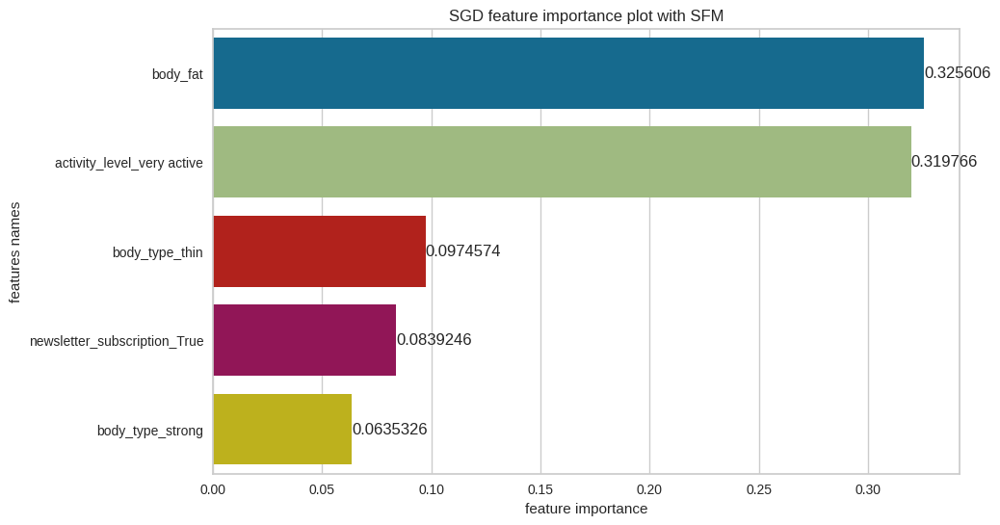

[SGD] Best parameters are {'alpha': 0.0002575, 'eta0': 0.025075, 'learning_rate': 'invscaling', 'penalty': 'l2', 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Logistic Regression
[Logistic Regression] Features selected: Index(['height', 'weight', 'gender_male', 'activity_level_sedentary',
       'activity_level_very active'],
      dtype='object')
[Logistic Regression] Features importances: [0.17666915 0.33406708 0.20167742 0.22626409 0.07853575]


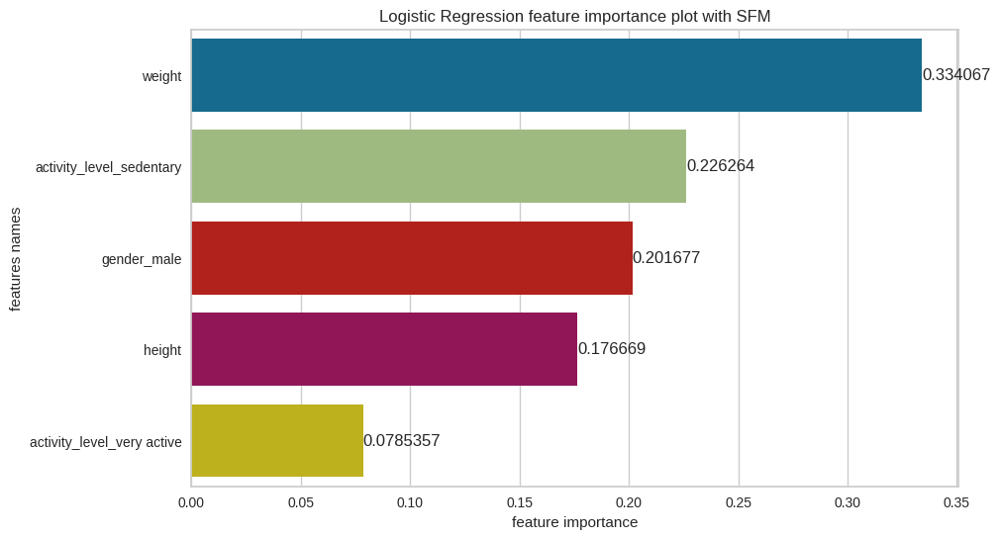

[Logistic Regression] Best parameters are {'C': 1, 'penalty': 'l1', 'random_state': 42, 'solver': 'liblinear'}
[INFO] Performing Grid-Search CV ---- Decision Tree
[Decision Tree] Features selected: Index(['height', 'weight', 'body_fat', 'body_type_thin',
       'newsletter_subscription_True'],
      dtype='object')
[Decision Tree] Features importances: [0.36985562567588304, 0.3537720192014265, 0.23427216549051436, 0.013587404302751295, 0.02851278532942484]


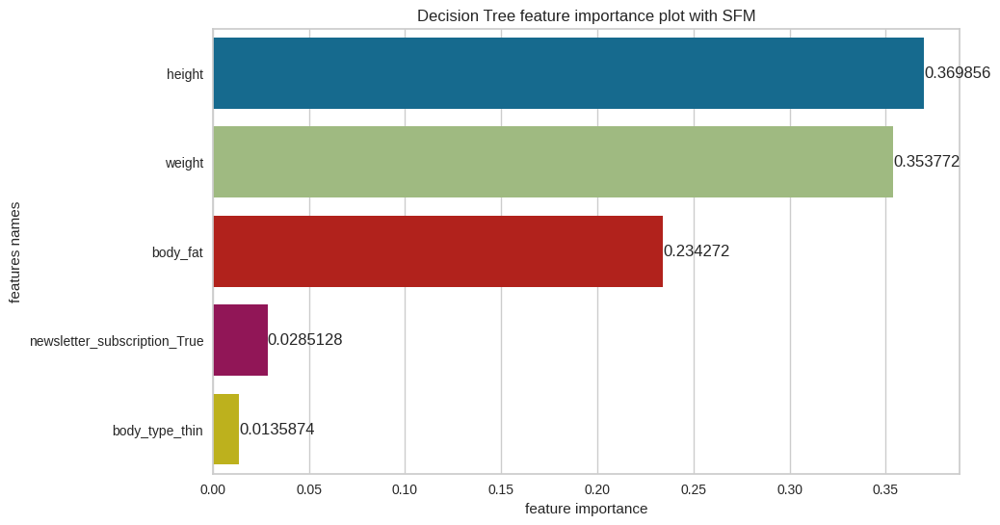

[Decision Tree] Best parameters are {'criterion': 'entropy', 'max_depth': 6, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Random Forest
[Random Forest] Features selected: Index(['height', 'weight', 'body_fat', 'body_type_thin',
       'newsletter_subscription_True'],
      dtype='object')
[Random Forest] Features importances: [0.2985136326746364, 0.3281384771686448, 0.33817886217593823, 0.023954202612923813, 0.011214825367856888]


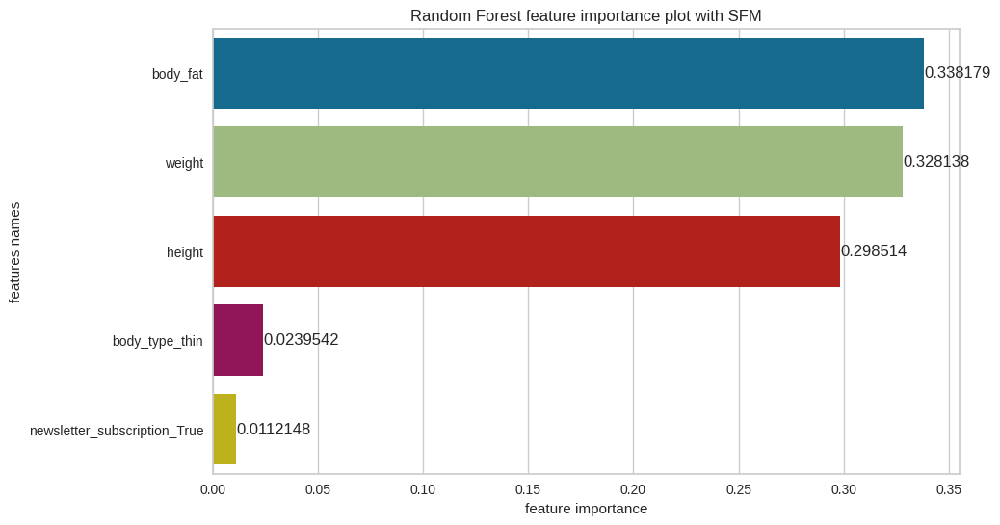

[Random Forest] Best parameters are {'criterion': 'entropy', 'max_depth': 3, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- AdaBoost
[AdaBoost] Features selected: Index(['height', 'weight', 'body_fat', 'gender_male',
       'newsletter_subscription_True', 'activity_level_sedentary',
       'activity_level_very active'],
      dtype='object')
[AdaBoost] Features importances: [0.16337866879452773, 0.33388089421599865, 0.13896621086453645, 0.07440775277767442, 0.020163824107763177, 0.22911767359715526, 0.04008497564234445]


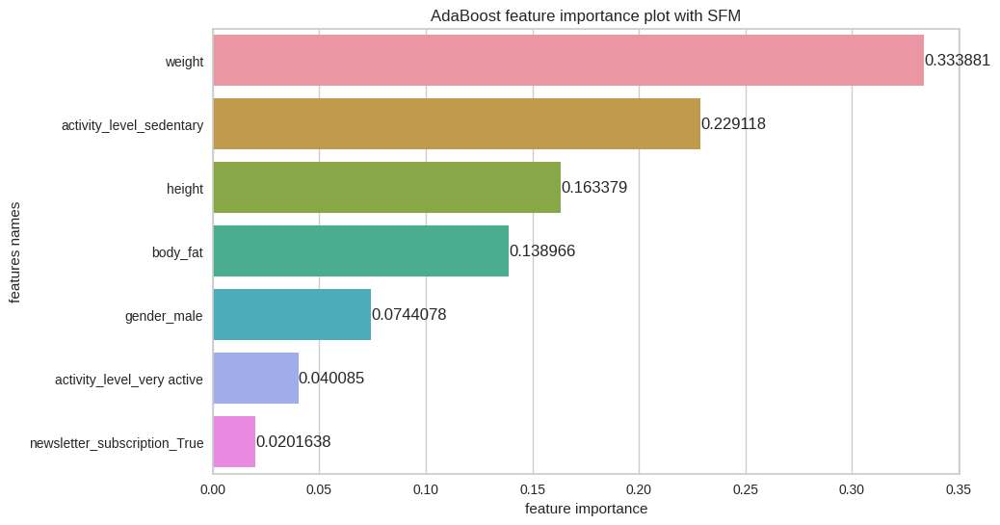

[AdaBoost] Best parameters are {'base_estimator': DecisionTreeClassifier(max_depth=3), 'learning_rate': 0.05, 'n_estimators': 40, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- GradientBoost
[GradientBoost] Features selected: Index(['height', 'weight', 'body_fat', 'gender_male',
       'activity_level_sedentary'],
      dtype='object')
[GradientBoost] Features importances: [0.1139397874160091, 0.030755181745065262, 0.30053804272546764, 0.13285813878313082, 0.4219088493303271]


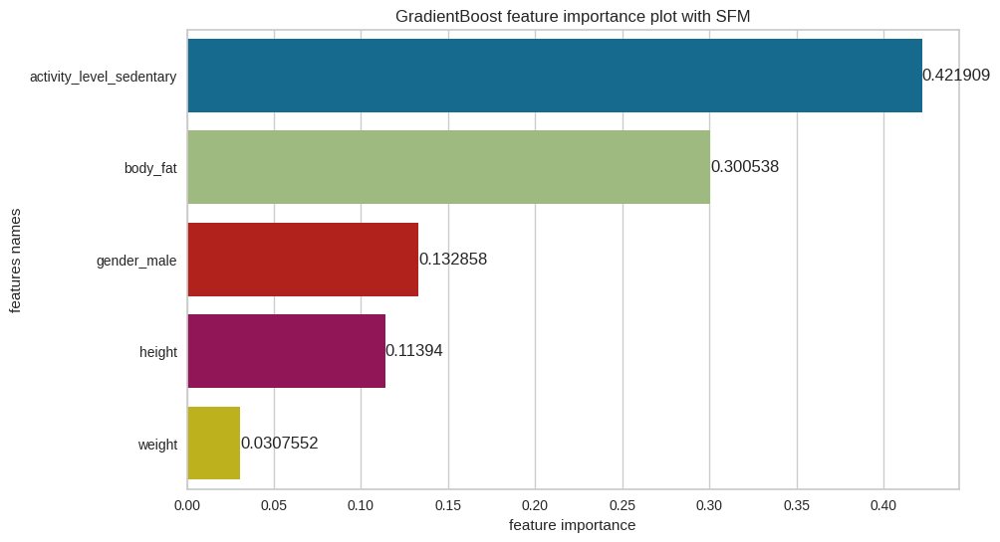

[GradientBoost] Best parameters are {'criterion': 'friedman_mse', 'learning_rate': 0.05, 'loss': 'deviance', 'max_depth': 3, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.4, 'n_estimators': 10, 'random_state': 42, 'subsample': 0.618}


In [215]:
estimators_multiclass_sel_8_3_sfm, X_test_sel_8_3_sfm, y_test_sel_8_3_sfm, X_train_sel_8_3_sfm, y_train_sel_8_3_sfm, X_test_inv_sel_8_3_sfm, features_sel_8_3_sfm = train(X_demo_adh_8_3, y_demo_adh_8_3, 
                                                         grid_params_multiclass, 
                                                         seed, feature_selection = True, 
                                                         feature_sel_type = 'SFM')

In [216]:
evaluation_table_sel_8_3_sfm = evaluate_multiclass(estimators_multiclass_sel_8_3_sfm, X_test_sel_8_3_sfm, y_test_sel_8_3_sfm, no_of_labels = 3, features_selected = True, feature_sel_type = 'SFM', features = features_sel_8_3_sfm)

In [217]:
evaluation_table_sel_8_3_sfm

,Overall Accuracy,Balanced Accuracy,Adj Balanced Accuracy,Precision micro,Precision macro,Precision weighted,Recall micro,Recall macro,Recall weighted,Cohen's kappa,Mathews Correlation Coefficient
SGD,0.53,0.52,0.04,0.53,0.54,0.53,0.53,0.52,0.53,0.04,0.05
Logistic Regression,0.57,0.57,0.15,0.57,0.57,0.58,0.57,0.57,0.57,0.15,0.15
Decision Tree,0.54,0.54,0.07,0.54,0.55,0.55,0.54,0.54,0.54,0.08,0.08
Random Forest,0.56,0.56,0.11,0.56,0.56,0.56,0.56,0.56,0.56,0.11,0.12
AdaBoost,0.58,0.58,0.17,0.58,0.58,0.59,0.58,0.58,0.58,0.17,0.17
GradientBoost,0.56,0.55,0.11,0.56,0.56,0.56,0.56,0.55,0.56,0.11,0.11


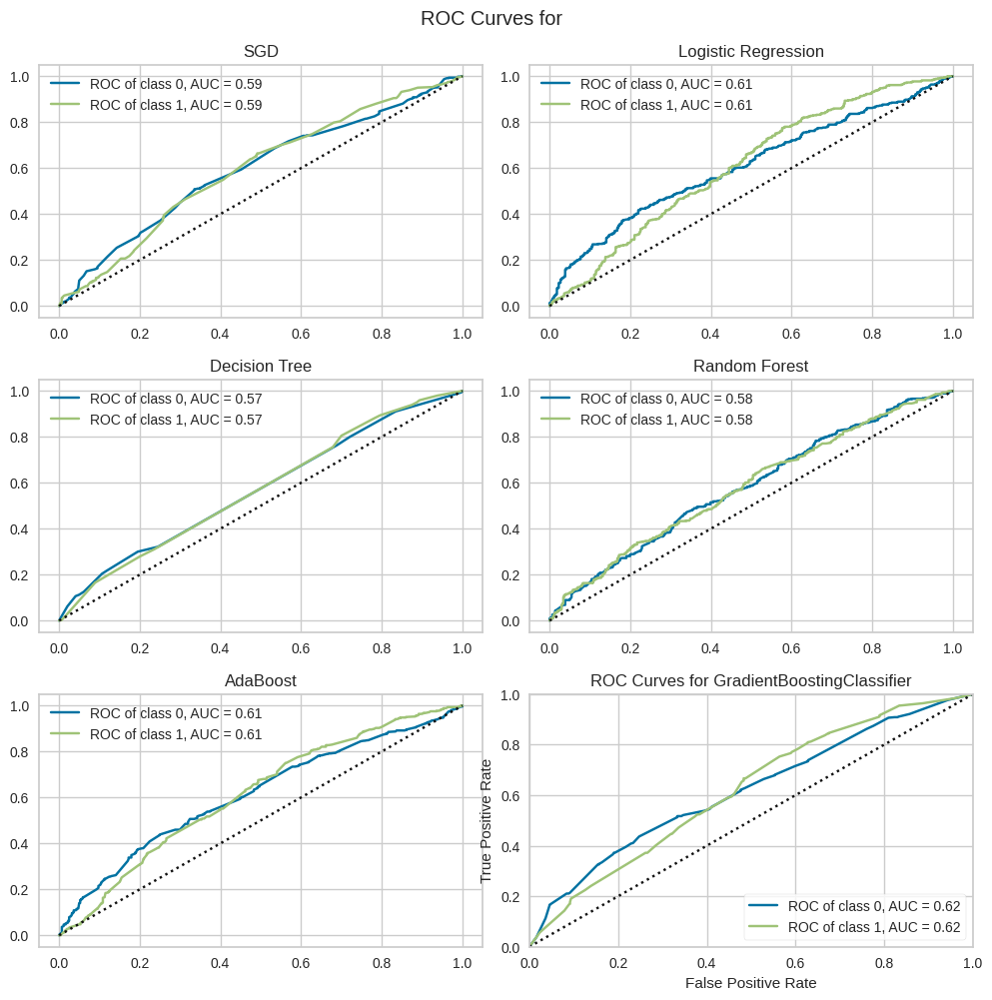

<AxesSubplot: title={'center': 'ROC Curves for GradientBoostingClassifier'}, xlabel='False Positive Rate', ylabel='True Positive Rate'>

In [218]:
ROC_curves(estimators_multiclass_sel_8_3_sfm, X_train_sel_8_3_sfm, y_train_sel_8_3_sfm, X_test_sel_8_3_sfm, y_test_sel_8_3_sfm, np.unique(y_demo_adh_8_3), name = 'all', features_selected = True, feature_sel_type = 'SFM', features = features_sel_8_3_sfm)

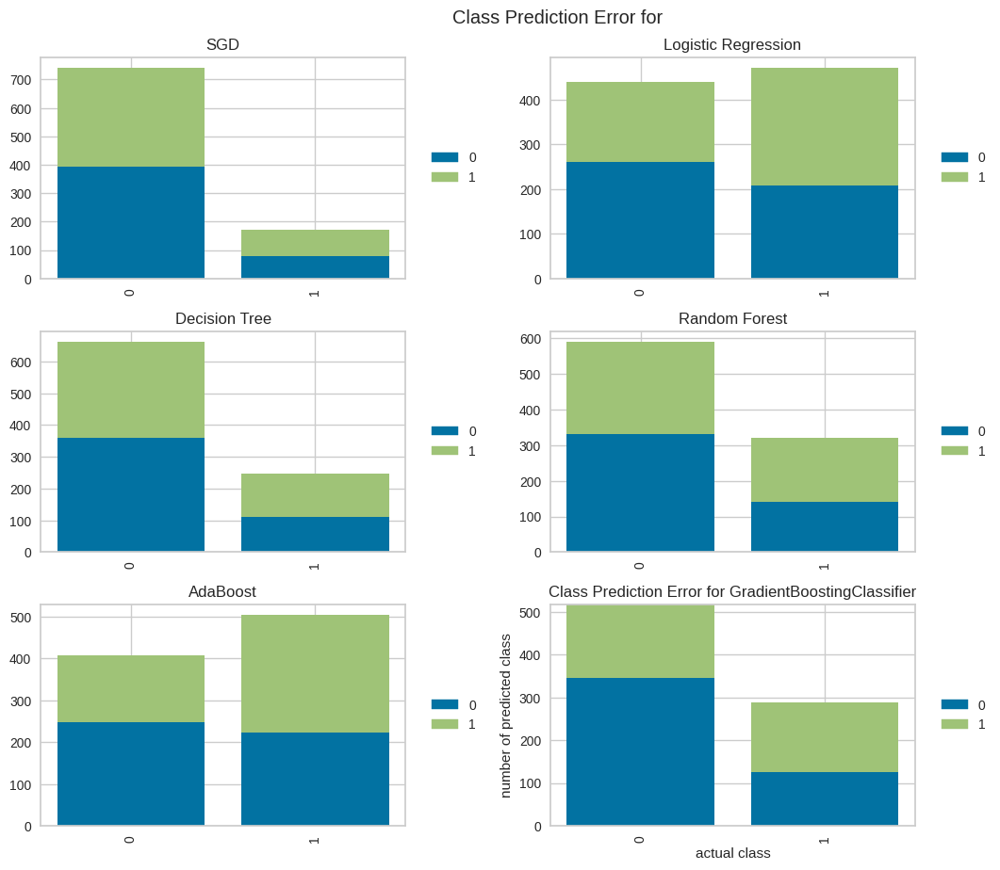

<AxesSubplot: title={'center': 'Class Prediction Error for GradientBoostingClassifier'}, xlabel='actual class', ylabel='number of predicted class'>

In [219]:
prediction_error_plot(estimators_multiclass_sel_8_3_sfm, X_train_sel_8_3_sfm, y_train_sel_8_3_sfm, X_test_sel_8_3_sfm, y_test_sel_8_3_sfm, np.unique(y_demo_adh_8_3), name = 'all', features_selected = True, feature_sel_type = 'SFM', features = features_sel_8_3_sfm)

### Ninth approach (2 groups, first 4 weeks, at least 1 training done for 3 weeks - working out for at least 3 weeks)

Here, the user is adherent if during the first 8 weeks he/she worked out at least 3 times in 3 weeks (at least once a week in a period of 3 weeks).

* Group 0 - users that didn't do workout at least once in a period of 3 weeks (in 4 weeks time) - 1822 users,
* Group 1 - users that worked out at least once a week for 3 weeks (adherent users) - 1212 users.

We take into consideration only demographical data.

* gender,
* activity_level,
* body_type,
* newsletter_subscription,
* height,
* weight and
* body fat.

In [220]:
# deleting label from data
X_demo_adh_3 = df_users_demo_any_adh_3.loc[:, df_users_demo_any_adh_3.columns != 'Adh']

# variable only with label
y_demo_adh_3 = df_users_demo_any_adh_3['Adh'].to_numpy()


cat_cols = ['gender', 'body_type', 'newsletter_subscription', 'activity_level']
X_demo_adh_3 = pd.get_dummies(X_demo_adh_3, columns = cat_cols, drop_first = True)

#X_demo_adh = OrdinalEncoder().fit_transform(X_demo_adh)
y_demo_ad_3 = pd.DataFrame(y_demo_adh_3, columns = ['Adherence group'])

[INFO] Performing Grid-Search CV ---- SGD
[SGD] Features importances: [0.         0.         0.         0.03123029 0.08129064 0.
 0.         0.         0.        ]


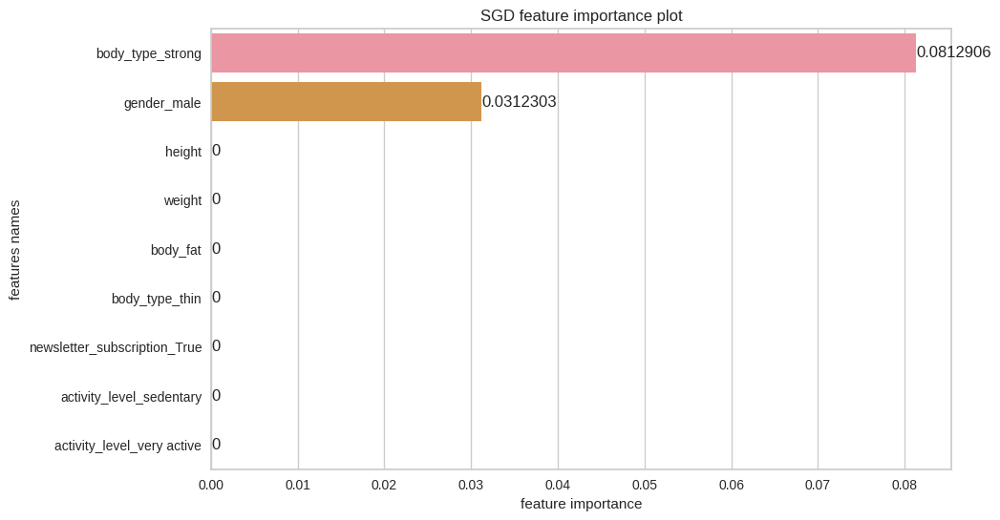

[SGD] Best parameters are {'alpha': 0.001, 'eta0': 0.0001, 'learning_rate': 'optimal', 'penalty': 'l1', 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Logistic Regression
[Logistic Regression] Features importances: [0.02568016 0.22431022 0.0645651  0.25590458 0.06520031 0.01165477
 0.0083207  0.20668015 0.02424431]


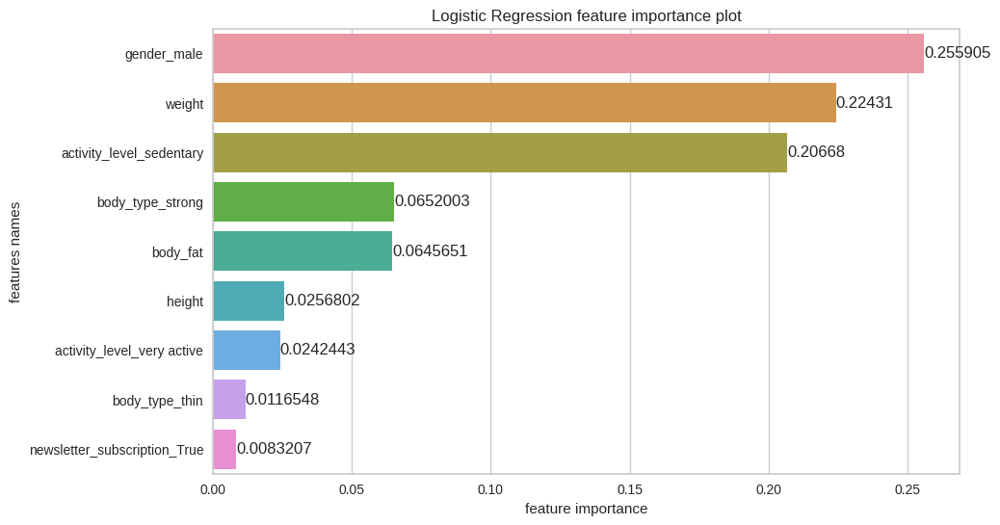

[Logistic Regression] Best parameters are {'C': 2, 'penalty': 'l2', 'random_state': 42, 'solver': 'liblinear'}
[INFO] Performing Grid-Search CV ---- Decision Tree
[Decision Tree] Features importances: [0.15491801997393506, 0.28705093177949254, 0.1289065981981679, 0.0, 0.0, 0.0, 0.0, 0.42912445004840455, 0.0]


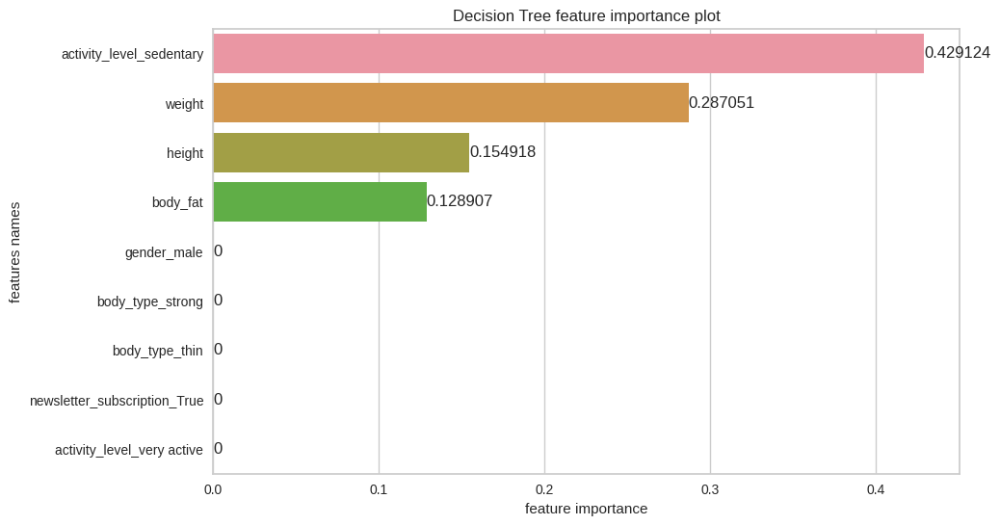

[Decision Tree] Best parameters are {'criterion': 'entropy', 'max_depth': 3, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Random Forest
[Random Forest] Features importances: [0.07089197428086827, 0.1627006042358934, 0.24133599437959358, 0.14861592174251087, 0.0, 0.01294961176554076, 0.007501858574683801, 0.3560040350209093, 0.0]


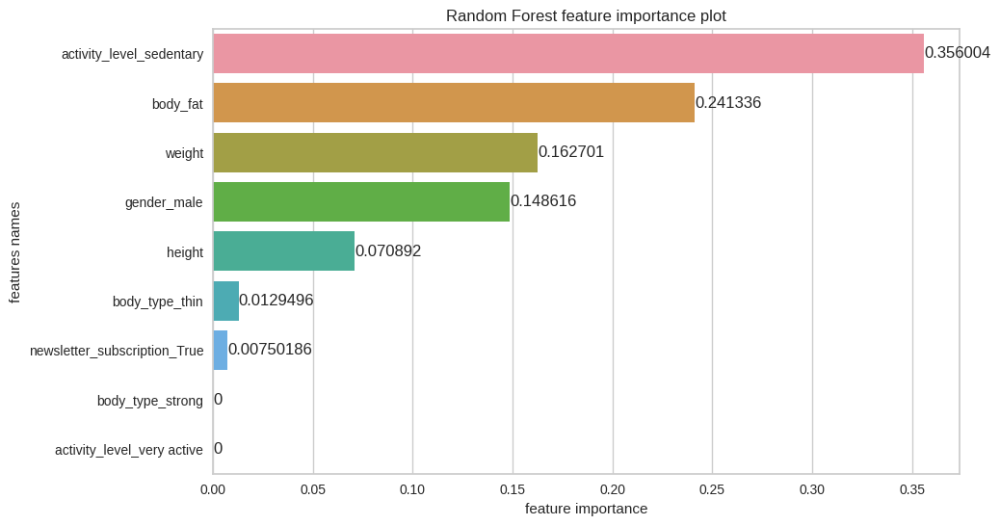

[Random Forest] Best parameters are {'criterion': 'gini', 'max_depth': 3, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- AdaBoost
[AdaBoost] Features importances: [0.3234491189067127, 0.33268820219261885, 0.18681807773131037, 0.02338034296867149, 0.01921150790319155, 0.021172617317351546, 0.03182710199392496, 0.04908958674899685, 0.012363444237221475]


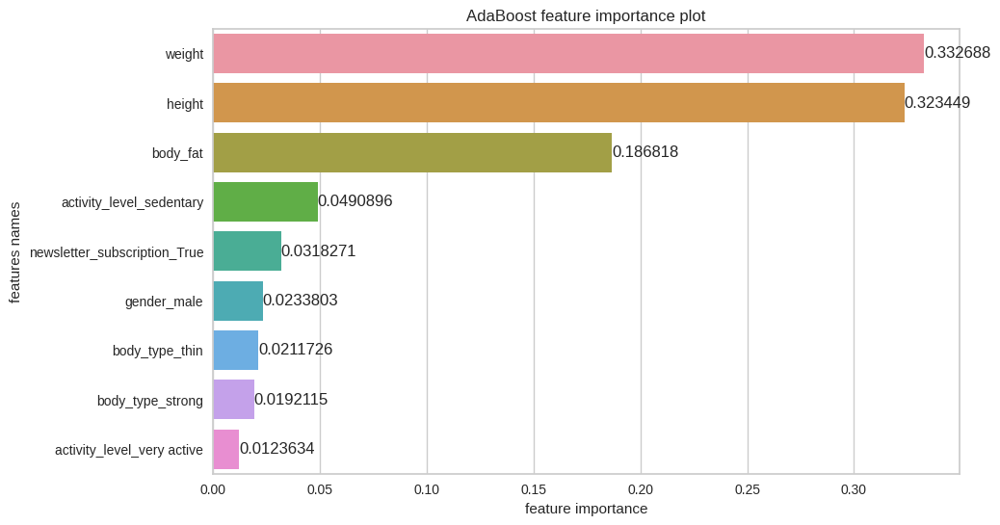

[AdaBoost] Best parameters are {'base_estimator': DecisionTreeClassifier(max_depth=4), 'learning_rate': 0.075, 'n_estimators': 80, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- GradientBoost
[GradientBoost] Features importances: [0.1291492489954965, 0.35436058753583044, 0.24623687493073554, 0.2702532885379374, 0.0, 0.0, 0.0, 0.0, 0.0]


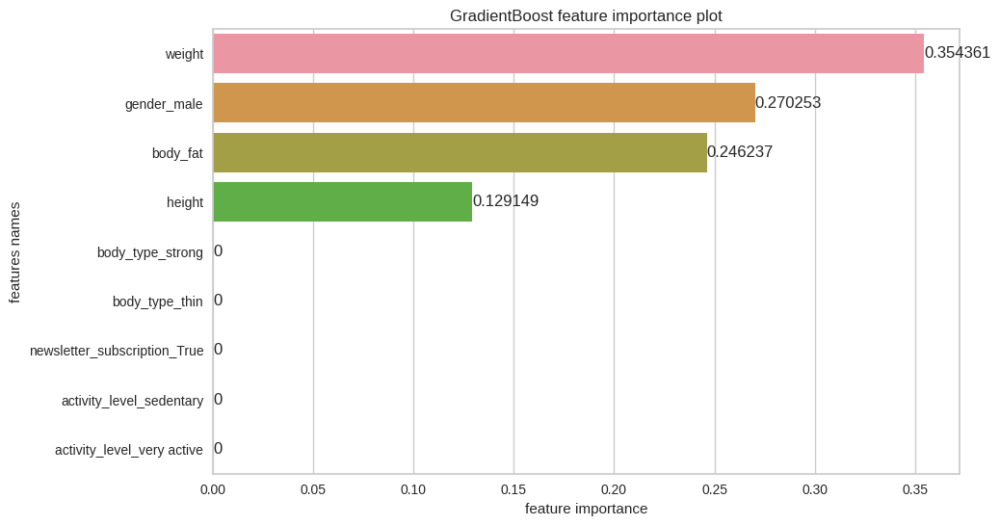

[GradientBoost] Best parameters are {'criterion': 'friedman_mse', 'learning_rate': 0.01, 'loss': 'deviance', 'max_depth': 3, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'n_estimators': 5, 'random_state': 42, 'subsample': 0.5}


In [221]:
estimators_multiclass_3, X_test_3, y_test_3, X_train_3, y_train_3, X_test_inv_3, features_3 = train(X_demo_adh_3, y_demo_adh_3, 
                                                         grid_params_multiclass, 
                                                         seed, feature_selection = False)

In [222]:
evaluation_table_3 = evaluate_multiclass(estimators_multiclass_3, X_test_3, y_test_3, no_of_labels = 3, features_selected = False, features = features_3)


In [223]:
evaluation_table_3

,Overall Accuracy,Balanced Accuracy,Adj Balanced Accuracy,Precision micro,Precision macro,Precision weighted,Recall micro,Recall macro,Recall weighted,Cohen's kappa,Mathews Correlation Coefficient
SGD,0.60,0.50,0.00,0.60,0.30,0.36,0.60,0.50,0.60,0.00,0.00
Logistic Regression,0.61,0.54,0.08,0.61,0.58,0.59,0.61,0.54,0.61,0.08,0.11
Decision Tree,0.60,0.50,0.00,0.60,0.30,0.36,0.60,0.50,0.60,0.00,0.00
Random Forest,0.60,0.50,0.00,0.60,0.30,0.36,0.60,0.50,0.60,0.00,0.00
AdaBoost,0.57,0.51,0.03,0.57,0.52,0.54,0.57,0.51,0.57,0.03,0.03
GradientBoost,0.60,0.50,0.00,0.60,0.30,0.36,0.60,0.50,0.60,0.00,0.00


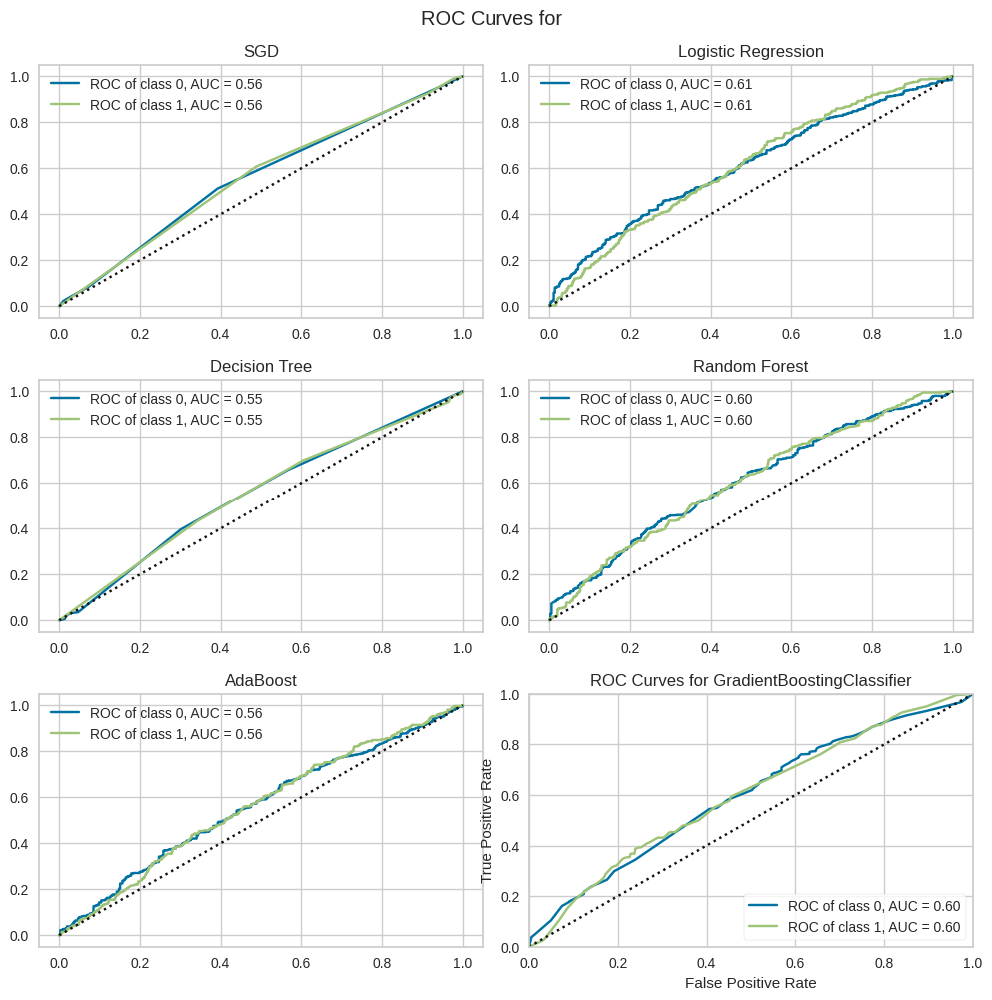

<AxesSubplot: title={'center': 'ROC Curves for GradientBoostingClassifier'}, xlabel='False Positive Rate', ylabel='True Positive Rate'>

In [224]:
ROC_curves(estimators_multiclass_3, X_train_3, y_train_3, X_test_3, y_test_3, np.unique(y_demo_adh_3), name = 'all', features_selected = False, features = features_3)


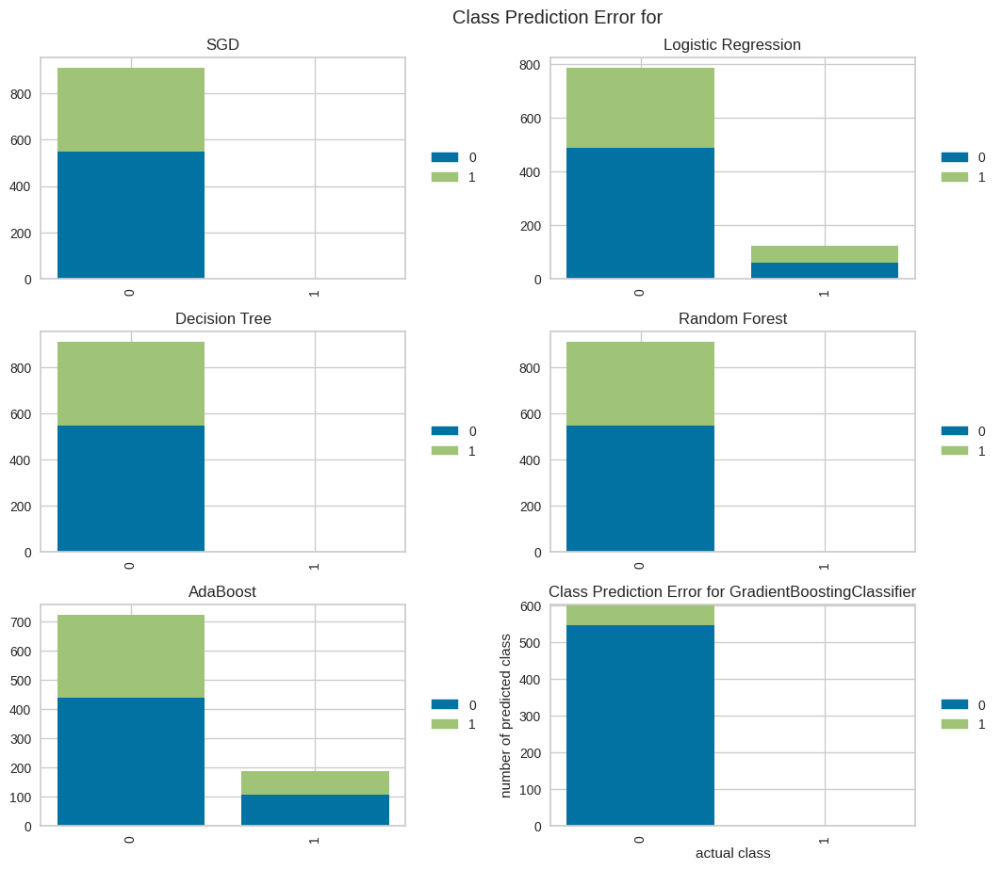

<AxesSubplot: title={'center': 'Class Prediction Error for GradientBoostingClassifier'}, xlabel='actual class', ylabel='number of predicted class'>

In [225]:
prediction_error_plot(estimators_multiclass_3, X_train_3, y_train_3, X_test_3, y_test_3, np.unique(y_demo_adh_3), name = 'all', features_selected = False, features = features_3)


#### With feature selection (by Univariate)

[INFO] Performing Grid-Search CV ---- SGD
[SGD] Features selected: Index(['height', 'weight', 'body_fat'], dtype='object')
[SGD] Features importances: [3.40629974e-06 0.00000000e+00 3.03570823e-08]


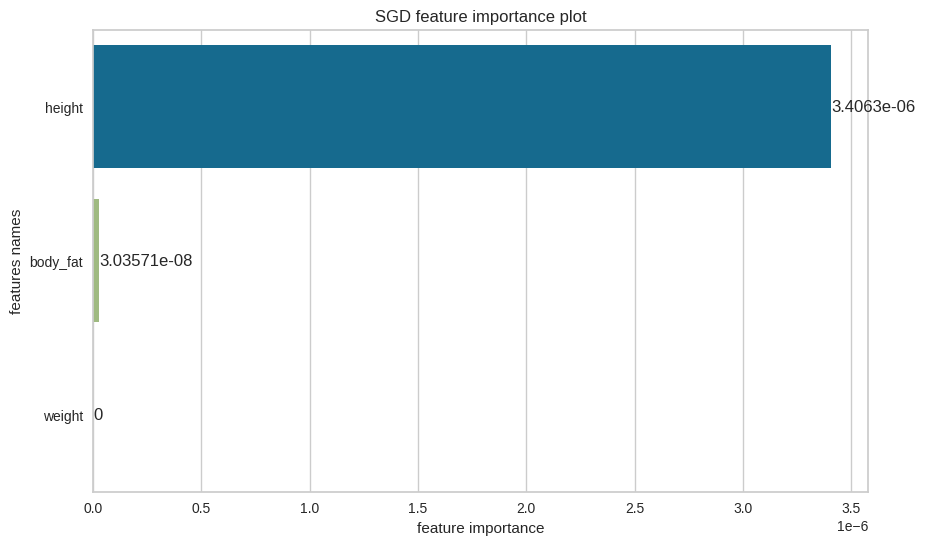

[SGD] Best parameters are {'alpha': 1e-05, 'eta0': 0.0001, 'learning_rate': 'adaptive', 'penalty': 'l1', 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Logistic Regression
[Logistic Regression] Features selected: Index(['height', 'weight', 'body_fat'], dtype='object')
[Logistic Regression] Features importances: [0.19103438 0.18527934 0.13530756]


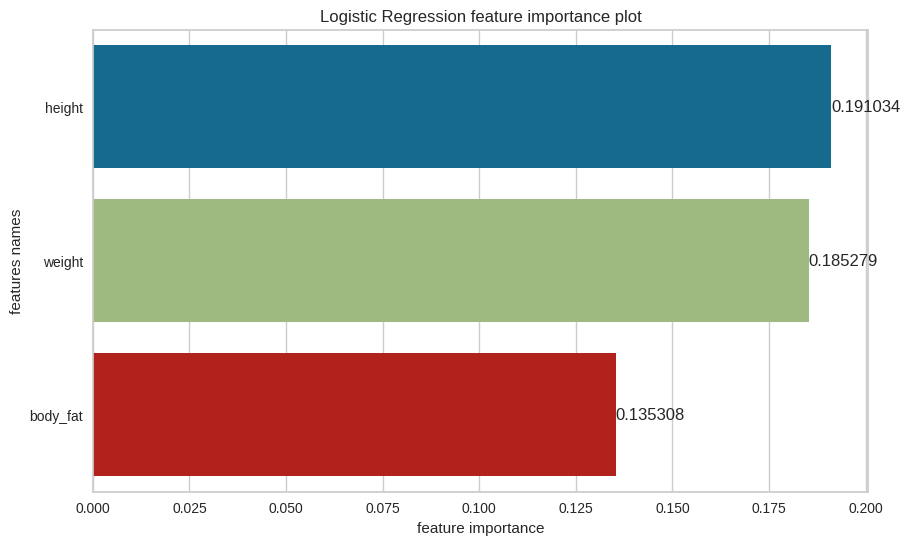

[Logistic Regression] Best parameters are {'C': 1, 'penalty': 'l1', 'random_state': 42, 'solver': 'liblinear'}
[INFO] Performing Grid-Search CV ---- Decision Tree
[Decision Tree] Features selected: Index(['height', 'weight', 'body_fat'], dtype='object')
[Decision Tree] Features importances: [0.08314732212989122, 0.4776846895587447, 0.439167988311364]


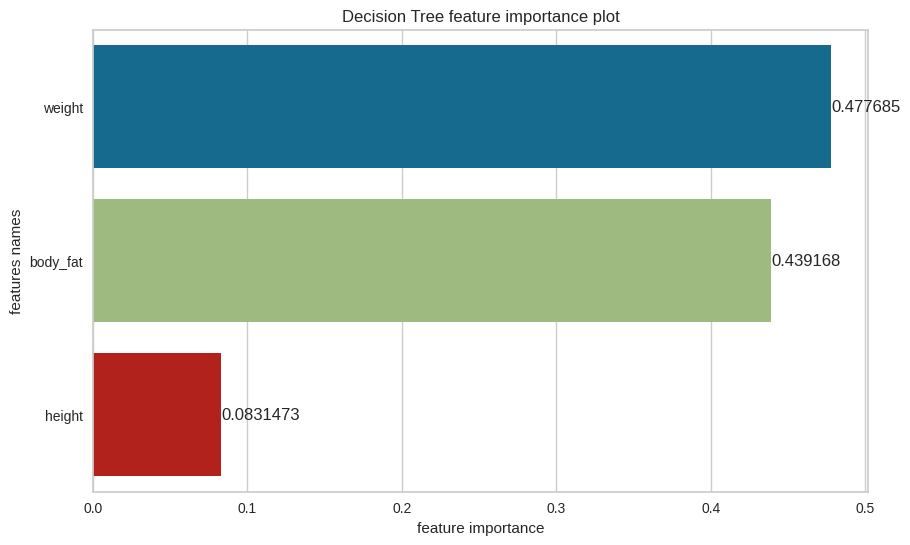

[Decision Tree] Best parameters are {'criterion': 'gini', 'max_depth': 3, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Random Forest
[Random Forest] Features selected: Index(['height', 'weight', 'body_fat'], dtype='object')
[Random Forest] Features importances: [0.2552930053960234, 0.37307908536234746, 0.3716279092416292]


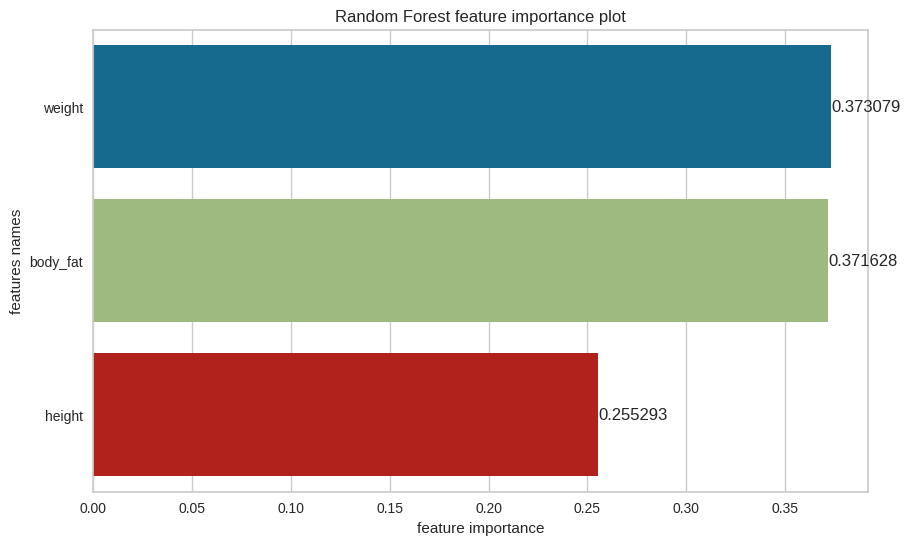

[Random Forest] Best parameters are {'criterion': 'gini', 'max_depth': 3, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- AdaBoost
[AdaBoost] Features selected: Index(['height', 'weight', 'body_fat'], dtype='object')
[AdaBoost] Features importances: [0.0, 0.55, 0.45]


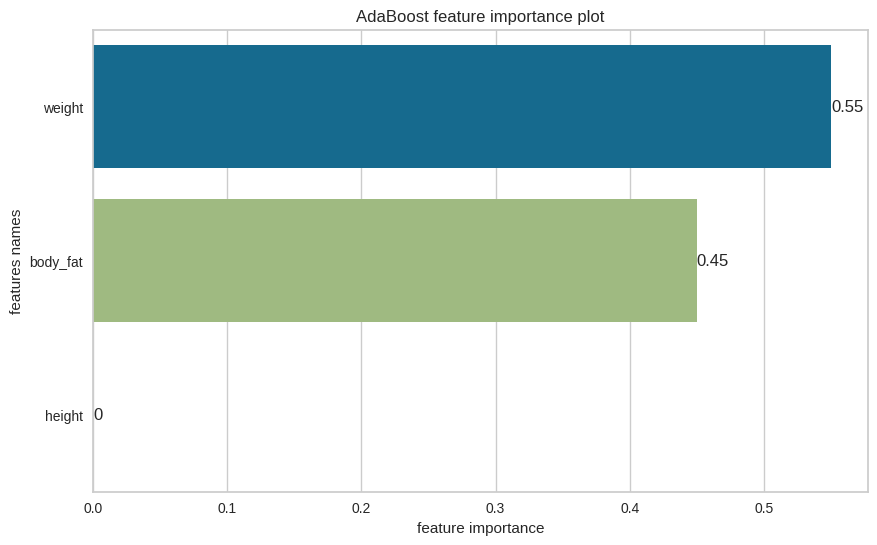

[AdaBoost] Best parameters are {'base_estimator': DecisionTreeClassifier(max_depth=1), 'learning_rate': 0.01, 'n_estimators': 20, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- GradientBoost
[GradientBoost] Features selected: Index(['height', 'weight', 'body_fat'], dtype='object')
[GradientBoost] Features importances: [0.03470668822610104, 0.40333777039082735, 0.5619555413830716]


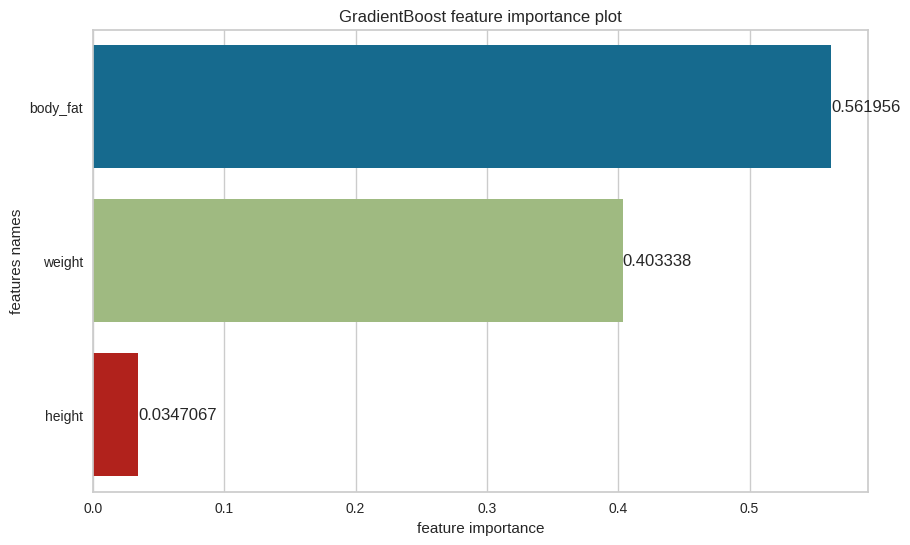

[GradientBoost] Best parameters are {'criterion': 'friedman_mse', 'learning_rate': 0.01, 'loss': 'deviance', 'max_depth': 3, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'n_estimators': 5, 'random_state': 42, 'subsample': 0.5}


In [226]:
estimators_multiclass_sel_3_u, X_test_sel_3_u, y_test_sel_3_u, X_train_sel_3_u, y_train_sel_3_u, X_test_inv_sel_3_u, features_sel_3_u = train(X_demo_adh_3, y_demo_adh_3, 
                                                         grid_params_multiclass, 
                                                         seed, feature_selection = True, 
                                                         feature_sel_type = 'UNI')

In [227]:
evaluation_table_sel_3_u = evaluate_multiclass(estimators_multiclass_sel_3_u, X_test_sel_3_u, y_test_sel_3_u, no_of_labels = 3, features_selected = True, feature_sel_type = 'UNI',  features = features_sel_3_u)


In [228]:
evaluation_table_sel_3_u

,Overall Accuracy,Balanced Accuracy,Adj Balanced Accuracy,Precision micro,Precision macro,Precision weighted,Recall micro,Recall macro,Recall weighted,Cohen's kappa,Mathews Correlation Coefficient
SGD,0.60,0.50,0.00,0.60,0.30,0.36,0.60,0.50,0.60,0.00,0.00
Logistic Regression,0.61,0.52,0.04,0.61,0.62,0.62,0.61,0.52,0.61,0.05,0.10
Decision Tree,0.60,0.50,0.00,0.60,0.30,0.36,0.60,0.50,0.60,0.00,0.00
Random Forest,0.60,0.50,0.00,0.60,0.30,0.36,0.60,0.50,0.60,0.00,0.00
AdaBoost,0.60,0.50,0.00,0.60,0.30,0.36,0.60,0.50,0.60,0.00,0.00
GradientBoost,0.60,0.50,0.00,0.60,0.30,0.36,0.60,0.50,0.60,0.00,0.00


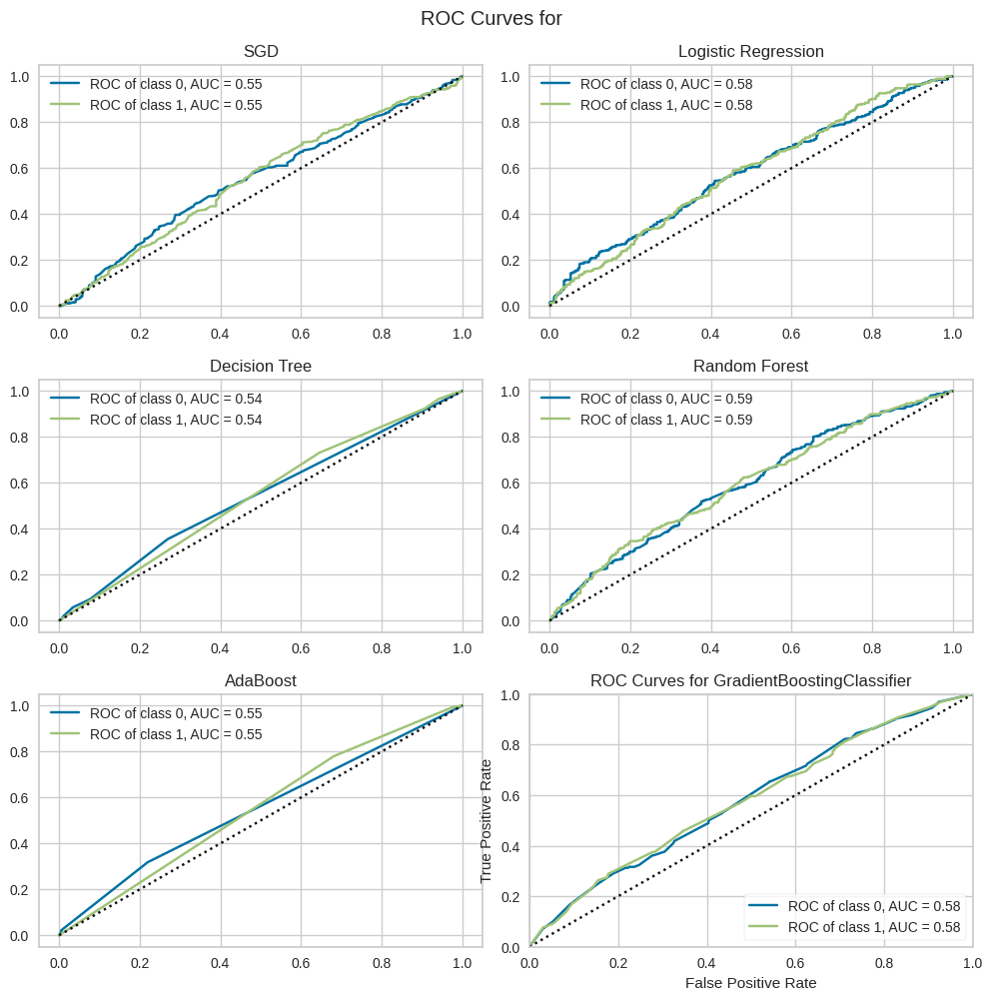

<AxesSubplot: title={'center': 'ROC Curves for GradientBoostingClassifier'}, xlabel='False Positive Rate', ylabel='True Positive Rate'>

In [229]:
ROC_curves(estimators_multiclass_sel_3_u, X_train_sel_3_u, y_train_sel_3_u, X_test_sel_3_u, y_test_sel_3_u, np.unique(y_demo_adh_3), name = 'all', features_selected = True, feature_sel_type = 'UNI', features = features_sel_3_u)


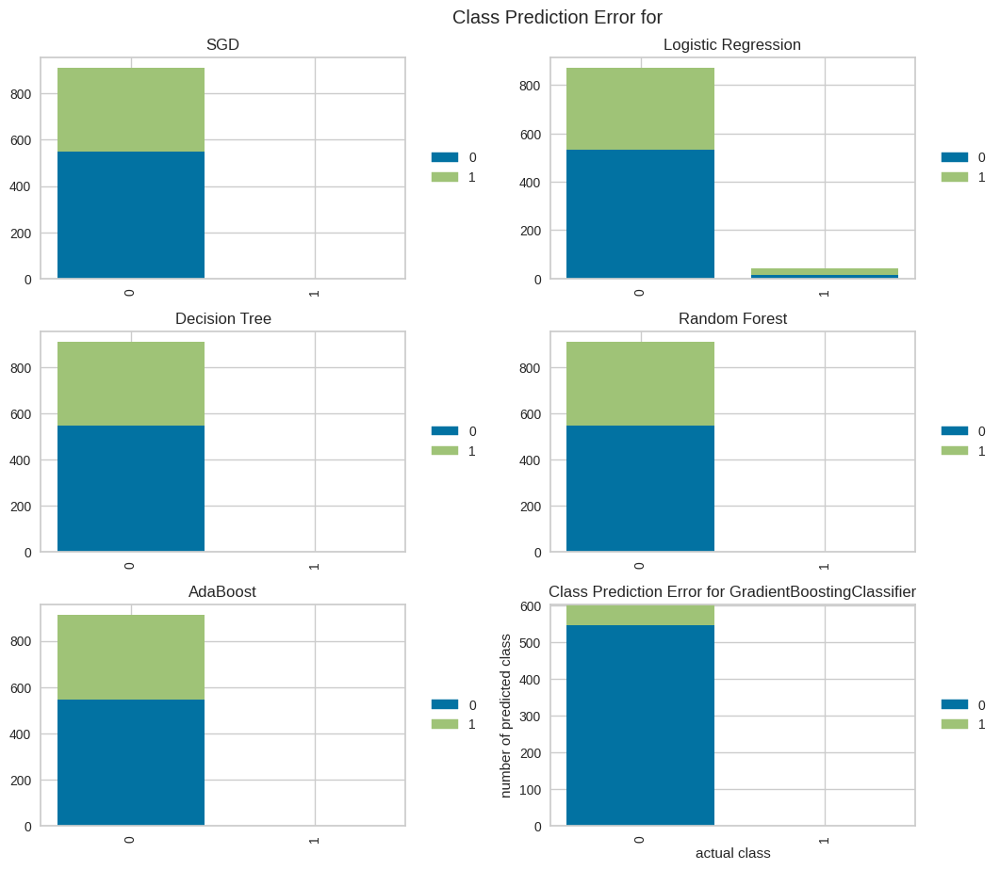

<AxesSubplot: title={'center': 'Class Prediction Error for GradientBoostingClassifier'}, xlabel='actual class', ylabel='number of predicted class'>

In [230]:
prediction_error_plot(estimators_multiclass_sel_3_u, X_train_sel_3_u, y_train_sel_3_u, X_test_sel_3_u, y_test_sel_3_u, np.unique(y_demo_adh_3), name = 'all', features_selected = True, feature_sel_type = 'UNI', features = features_sel_3_u)

#### With feature selection (by SequentialFeatureSelector)

In [231]:
estimators_multiclass_sel_3, X_test_sel_3, y_test_sel_3, X_train_sel_3, y_train_sel_3, X_test_inv_sel_3, features_sel_3 = train(X_demo_adh_3, y_demo_adh_3, 
                                                         grid_params_multiclass, 
                                                         seed, feature_selection = True, 
                                                         feature_sel_type = 'SFS')

[INFO] Performing Grid-Search CV ---- SGD
[SGD] Features selected: Index(['height'], dtype='object')
[SGD] Best parameters are {'alpha': 1e-05, 'eta0': 0.0001, 'learning_rate': 'invscaling', 'penalty': 'l1', 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Logistic Regression
[Logistic Regression] Features selected: Index(['weight', 'body_fat', 'gender_male', 'body_type_strong',
       'body_type_thin', 'newsletter_subscription_True',
       'activity_level_sedentary', 'activity_level_very active'],
      dtype='object')
[Logistic Regression] Best parameters are {'C': 1, 'penalty': 'l1', 'random_state': 42, 'solver': 'liblinear'}
[INFO] Performing Grid-Search CV ---- Decision Tree
[Decision Tree] Features selected: Index(['body_fat'], dtype='object')
[Decision Tree] Best parameters are {'criterion': 'gini', 'max_depth': 12, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Random Forest
[Random Forest] Features selected: Index(['body_fat'], dtype='object')
[Random Fore

In [232]:
evaluation_table_sel_3 = evaluate_multiclass(estimators_multiclass_sel_3, X_test_sel_3, y_test_sel_3, no_of_labels = 3, features_selected = True, feature_sel_type = 'SFS', features = features_sel_3)


In [233]:
evaluation_table_sel_3

,Overall Accuracy,Balanced Accuracy,Adj Balanced Accuracy,Precision micro,Precision macro,Precision weighted,Recall micro,Recall macro,Recall weighted,Cohen's kappa,Mathews Correlation Coefficient
SGD,0.60,0.50,0.00,0.60,0.30,0.36,0.60,0.50,0.60,0.00,0.00
Logistic Regression,0.60,0.53,0.06,0.60,0.57,0.58,0.60,0.53,0.60,0.07,0.09
Decision Tree,0.60,0.50,0.00,0.60,0.51,0.53,0.60,0.50,0.60,0.00,0.00
Random Forest,0.60,0.50,0.00,0.60,0.30,0.36,0.60,0.50,0.60,0.00,0.00
AdaBoost,0.60,0.50,0.00,0.60,0.55,0.56,0.60,0.50,0.60,0.00,0.02
GradientBoost,0.60,0.50,0.00,0.60,0.30,0.36,0.60,0.50,0.60,0.00,0.00


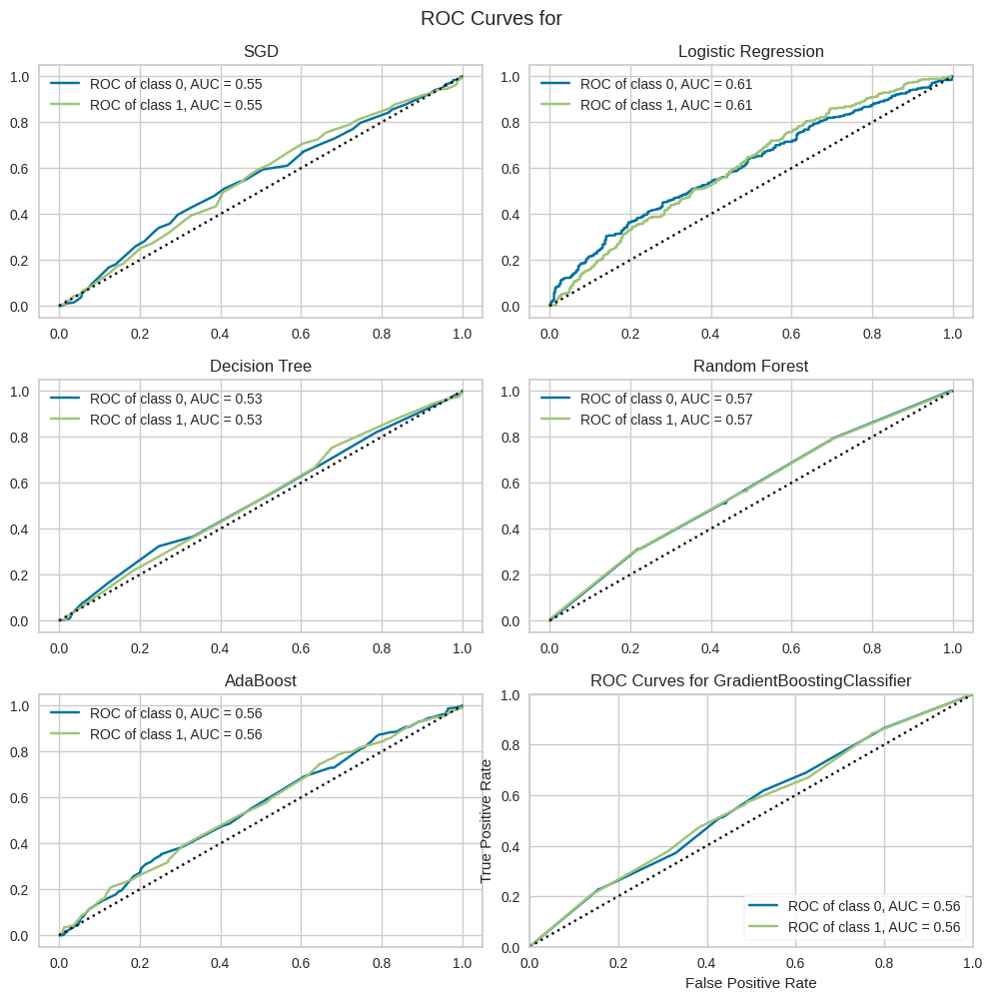

<AxesSubplot: title={'center': 'ROC Curves for GradientBoostingClassifier'}, xlabel='False Positive Rate', ylabel='True Positive Rate'>

In [234]:
ROC_curves(estimators_multiclass_sel_3, X_train_sel_3, y_train_sel_3, X_test_sel_3, y_test_sel_3, np.unique(y_demo_adh_3), name = 'all', features_selected = True, feature_sel_type = 'SFS', features = features_sel_3)


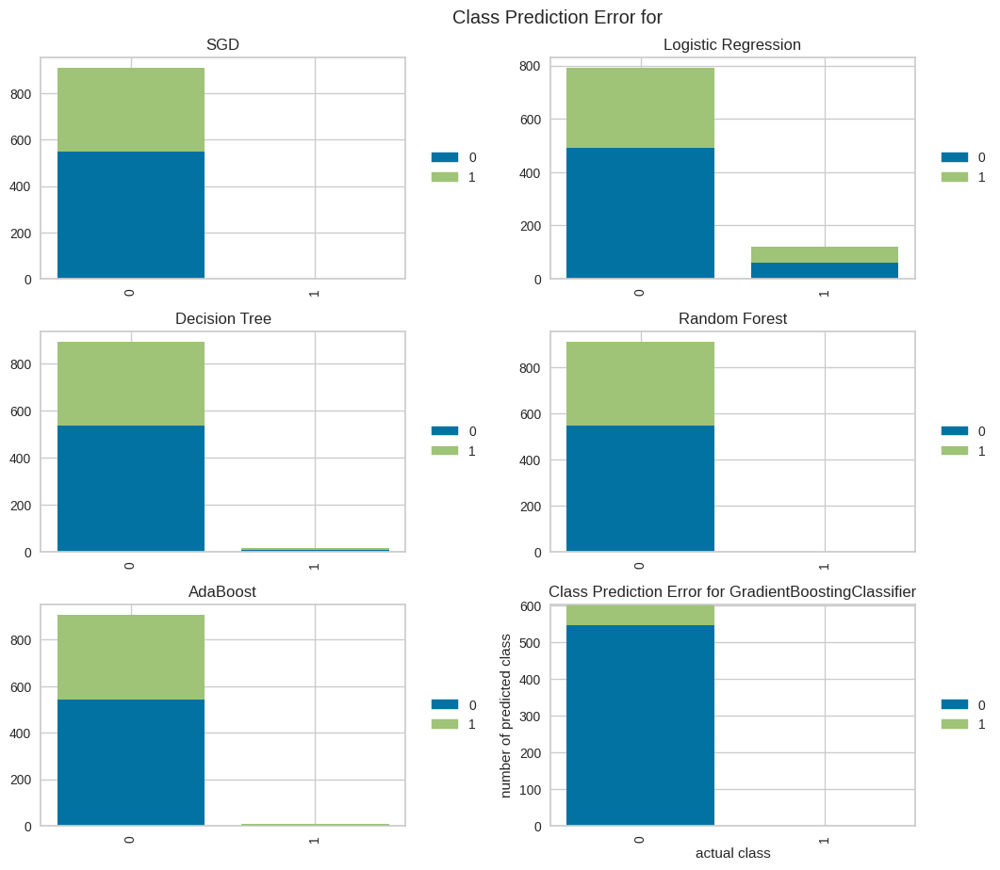

<AxesSubplot: title={'center': 'Class Prediction Error for GradientBoostingClassifier'}, xlabel='actual class', ylabel='number of predicted class'>

In [235]:
prediction_error_plot(estimators_multiclass_sel_3, X_train_sel_3, y_train_sel_3, X_test_sel_3, y_test_sel_3, np.unique(y_demo_adh_3), name = 'all', features_selected = True, feature_sel_type = 'SFS', features = features_sel_3)


#### With feature selection (by Recursive feature elimination with cross-validation - RFECV)

[INFO] Performing Grid-Search CV ---- SGD
[SGD] Features selected: Index(['newsletter_subscription_True', 'activity_level_very active'], dtype='object')
[SGD] Features importances: [8.48063517e-05 2.92171415e-04]


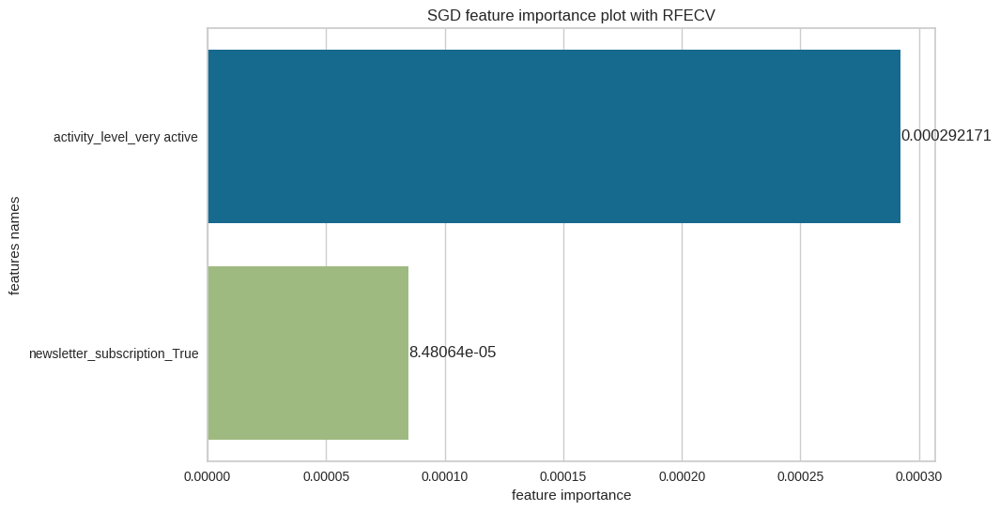

[SGD] Best parameters are {'alpha': 1e-05, 'eta0': 0.0001, 'learning_rate': 'invscaling', 'penalty': 'l1', 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Logistic Regression
[Logistic Regression] Features selected: Index(['height', 'weight', 'body_fat', 'gender_male', 'body_type_strong',
       'activity_level_sedentary', 'activity_level_very active'],
      dtype='object')
[Logistic Regression] Features importances: [0.01760654 0.21272273 0.06521086 0.25494541 0.06259483 0.20591379
 0.02140466]


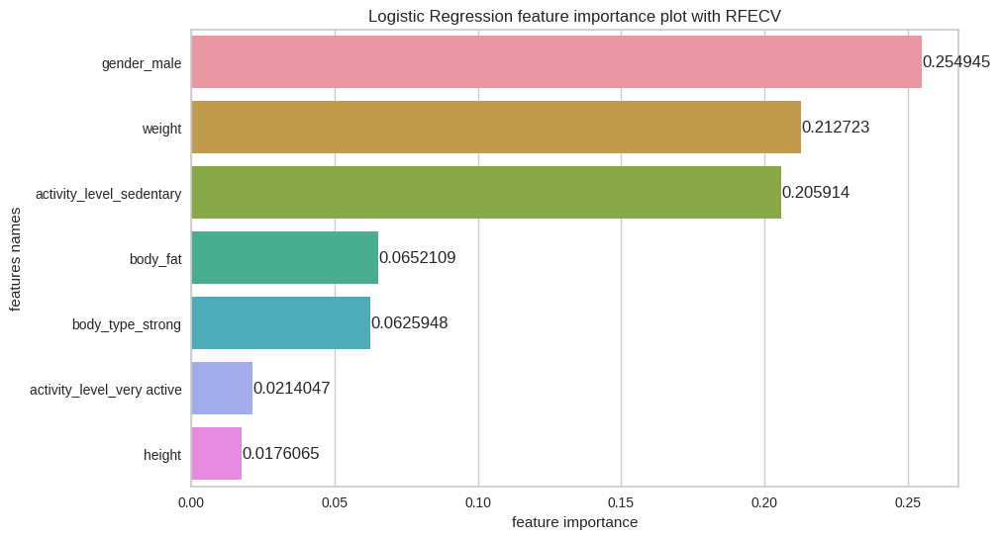

[Logistic Regression] Best parameters are {'C': 1, 'penalty': 'l1', 'random_state': 42, 'solver': 'liblinear'}
[INFO] Performing Grid-Search CV ---- Decision Tree
[Decision Tree] Features selected: Index(['weight'], dtype='object')
[Decision Tree] Features importances: [1.0]


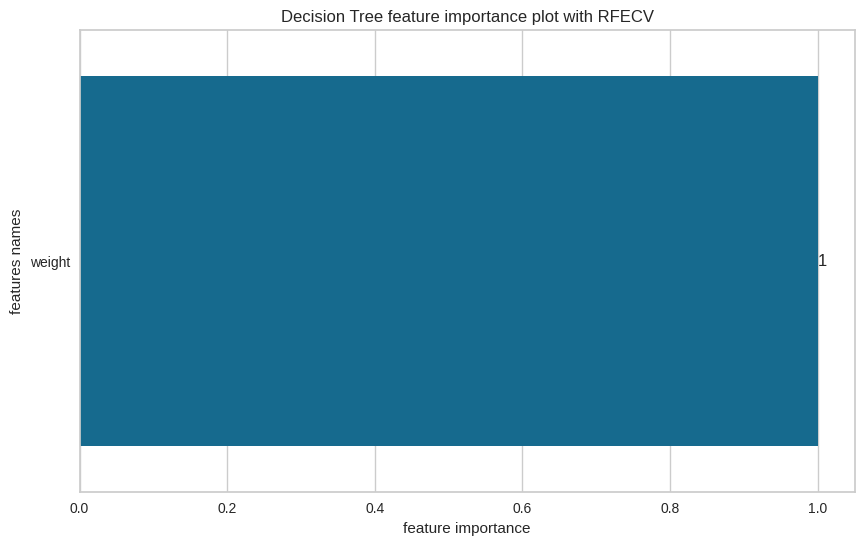

[Decision Tree] Best parameters are {'criterion': 'gini', 'max_depth': 3, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Random Forest
[Random Forest] Features selected: Index(['weight'], dtype='object')
[Random Forest] Features importances: [1.0]


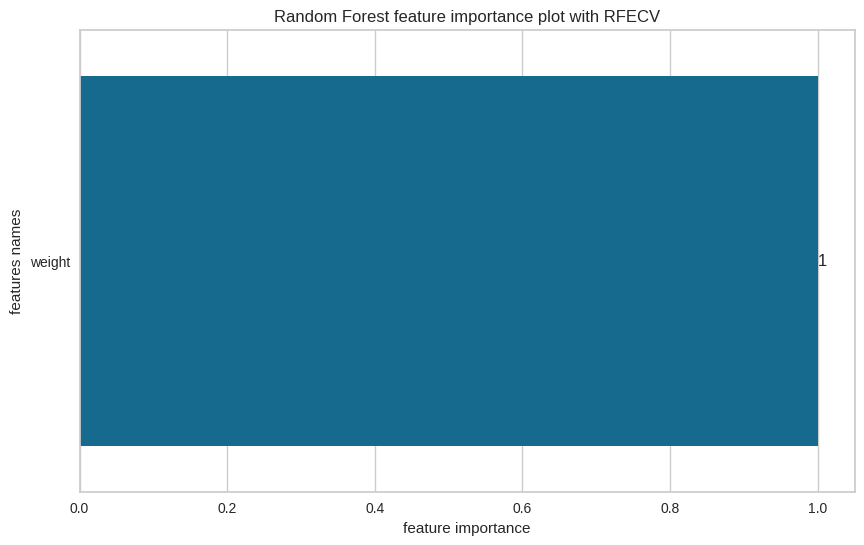

[Random Forest] Best parameters are {'criterion': 'gini', 'max_depth': 3, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- AdaBoost
[AdaBoost] Features selected: Index(['weight'], dtype='object')
[AdaBoost] Features importances: [1.0]


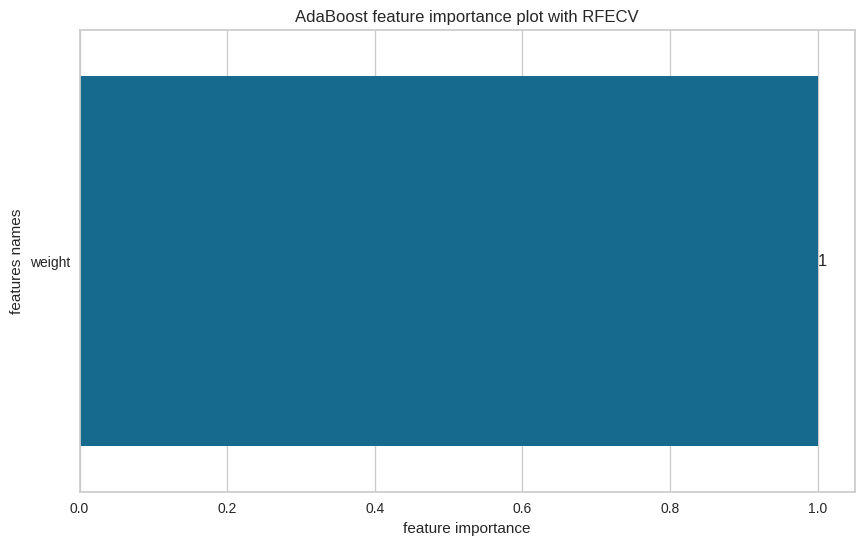

[AdaBoost] Best parameters are {'base_estimator': DecisionTreeClassifier(max_depth=3), 'learning_rate': 0.025, 'n_estimators': 80, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- GradientBoost
[GradientBoost] Features selected: Index(['height', 'weight', 'body_fat', 'gender_male', 'body_type_strong',
       'newsletter_subscription_True', 'activity_level_sedentary'],
      dtype='object')
[GradientBoost] Features importances: [0.029613946338417362, 0.2715187610276743, 0.24660903215091934, 0.09456946107504738, 0.0, 2.5112372235989033e-06, 0.357686288170718]


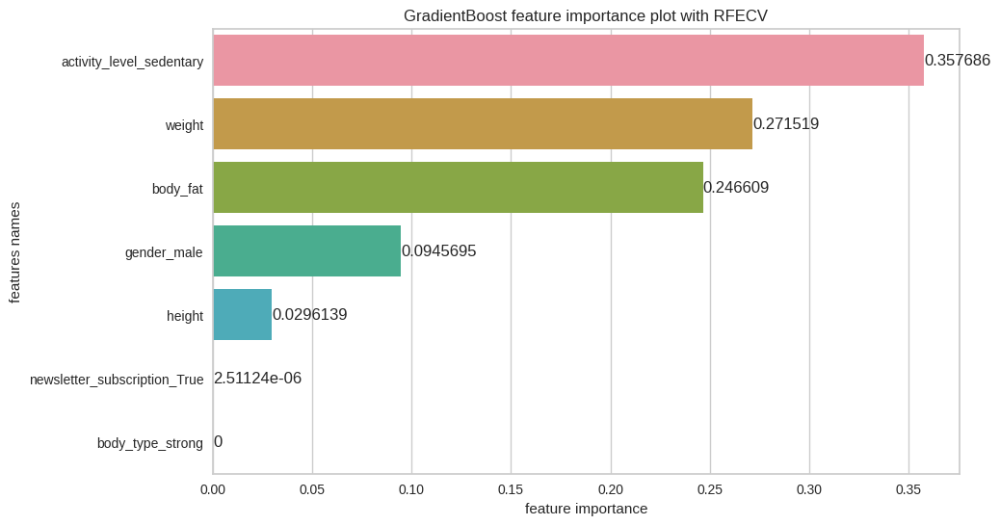

[GradientBoost] Best parameters are {'criterion': 'friedman_mse', 'learning_rate': 0.01, 'loss': 'deviance', 'max_depth': 3, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'n_estimators': 5, 'random_state': 42, 'subsample': 0.5}


In [236]:
estimators_multiclass_sel_3_rfecv, X_test_sel_3_rfecv, y_test_sel_3_rfecv, X_train_sel_3_rfecv, y_train_sel_3_rfecv, X_test_inv_sel_3_rfecv, features_sel_3_rfecv = train(X_demo_adh_3, y_demo_adh_3, 
                                                         grid_params_multiclass, 
                                                         seed, feature_selection = True, 
                                                         feature_sel_type = 'RFECV')

In [237]:
evaluation_table_sel_3_rfecv = evaluate_multiclass(estimators_multiclass_sel_3_rfecv, X_test_sel_3_rfecv, y_test_sel_3_rfecv, no_of_labels = 3, features_selected = True, feature_sel_type = 'RFECV', features = features_sel_3_rfecv)


In [238]:
evaluation_table_sel_3_rfecv

,Overall Accuracy,Balanced Accuracy,Adj Balanced Accuracy,Precision micro,Precision macro,Precision weighted,Recall micro,Recall macro,Recall weighted,Cohen's kappa,Mathews Correlation Coefficient
SGD,0.60,0.50,0.00,0.60,0.30,0.36,0.60,0.50,0.60,0.00,0.00
Logistic Regression,0.61,0.54,0.08,0.61,0.58,0.59,0.61,0.54,0.61,0.08,0.11
Decision Tree,0.60,0.50,-0.00,0.60,0.30,0.36,0.60,0.50,0.60,-0.00,-0.03
Random Forest,0.60,0.50,0.00,0.60,0.30,0.36,0.60,0.50,0.60,0.00,0.00
AdaBoost,0.60,0.50,-0.00,0.60,0.47,0.49,0.60,0.50,0.60,-0.00,-0.01
GradientBoost,0.60,0.50,0.00,0.60,0.30,0.36,0.60,0.50,0.60,0.00,0.00


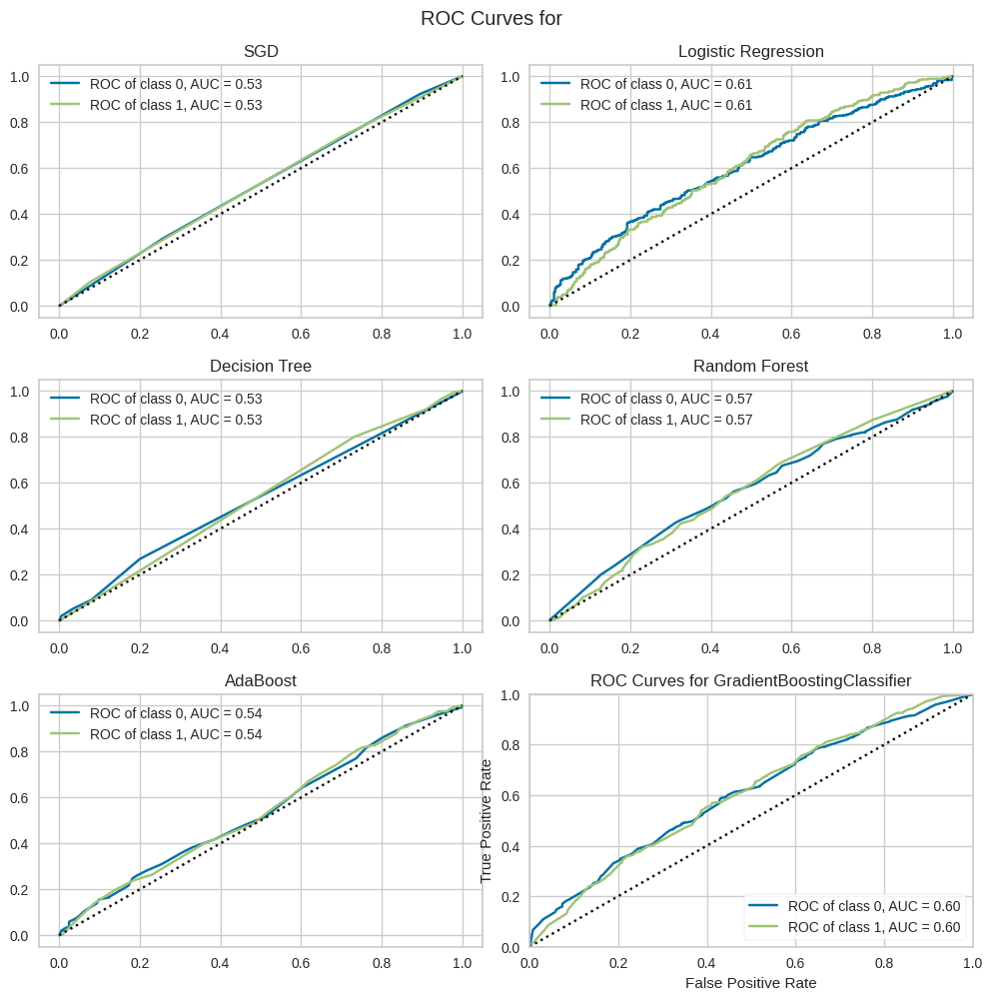

<AxesSubplot: title={'center': 'ROC Curves for GradientBoostingClassifier'}, xlabel='False Positive Rate', ylabel='True Positive Rate'>

In [239]:
ROC_curves(estimators_multiclass_sel_3_rfecv, X_train_sel_3_rfecv, y_train_sel_3_rfecv, X_test_sel_3_rfecv, y_test_sel_3_rfecv, np.unique(y_demo_adh_3), name = 'all', features_selected = True, feature_sel_type = 'RFECV', features = features_sel_3_rfecv)


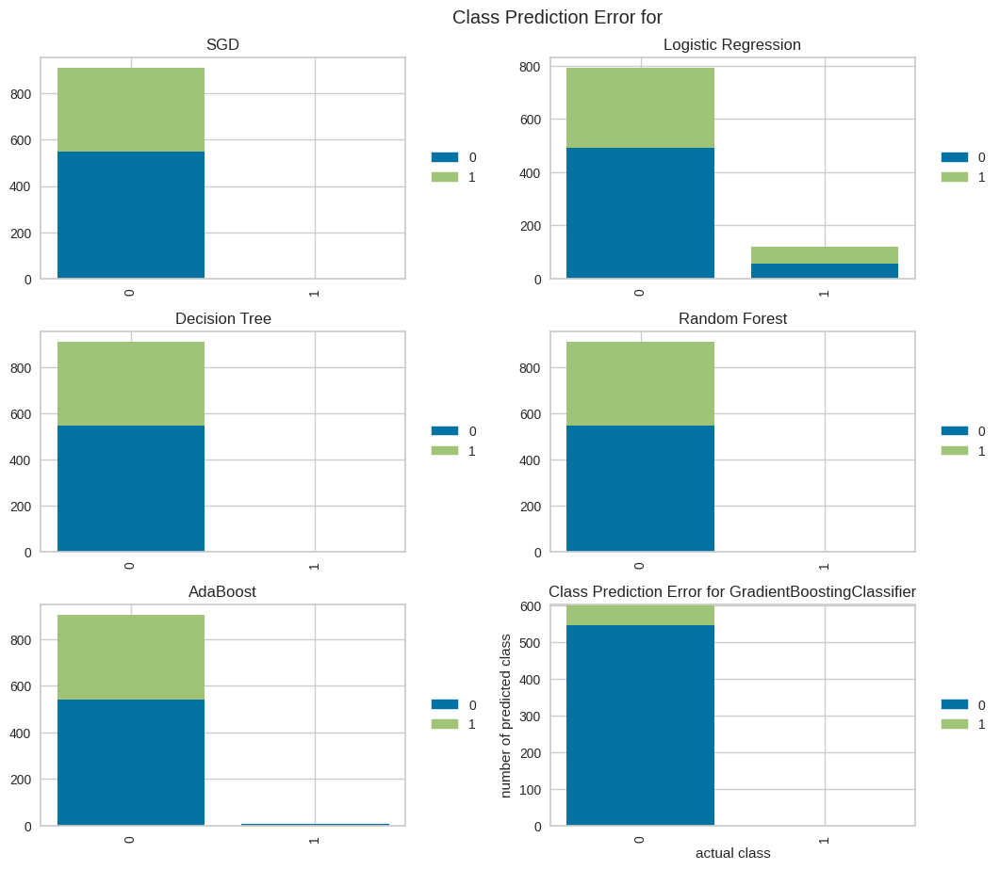

<AxesSubplot: title={'center': 'Class Prediction Error for GradientBoostingClassifier'}, xlabel='actual class', ylabel='number of predicted class'>

In [240]:
prediction_error_plot(estimators_multiclass_sel_3_rfecv, X_train_sel_3_rfecv, y_train_sel_3_rfecv, X_test_sel_3_rfecv, y_test_sel_3_rfecv, np.unique(y_demo_adh_3), name = 'all', features_selected = True, feature_sel_type = 'RFECV', features = features_sel_3_rfecv)


#### With feature selection (by SelectFromModel)

[INFO] Performing Grid-Search CV ---- SGD
[SGD] Features selected: Index(['height', 'gender_male', 'newsletter_subscription_True',
       'activity_level_sedentary', 'activity_level_very active'],
      dtype='object')
[SGD] Features importances: [0.00000000e+00 1.51197380e-05 0.00000000e+00 2.78067735e-06
 0.00000000e+00]


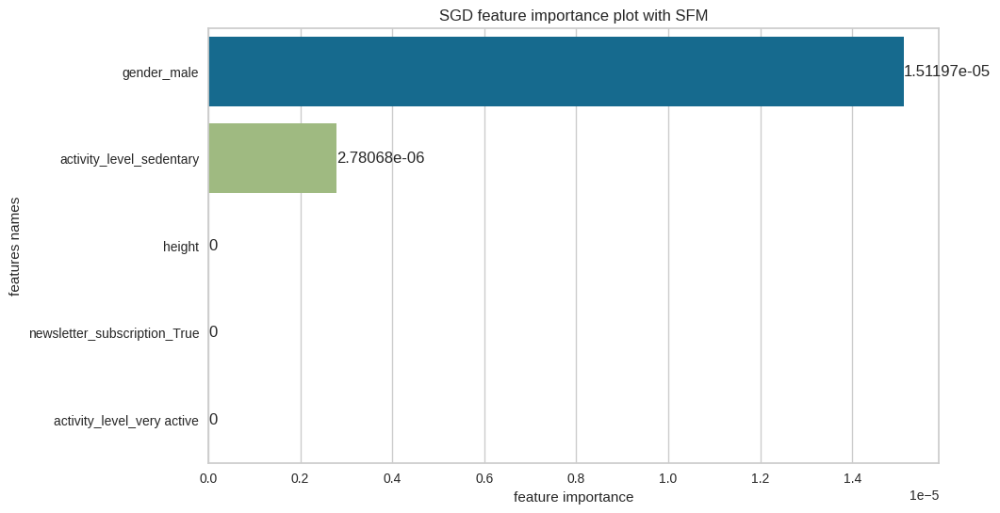

[SGD] Best parameters are {'alpha': 1e-05, 'eta0': 0.0001, 'learning_rate': 'adaptive', 'penalty': 'l1', 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Logistic Regression
[Logistic Regression] Features selected: Index(['weight', 'body_fat', 'gender_male', 'body_type_strong',
       'activity_level_sedentary'],
      dtype='object')
[Logistic Regression] Features importances: [0.20533289 0.06654381 0.26221346 0.06644431 0.20276375]


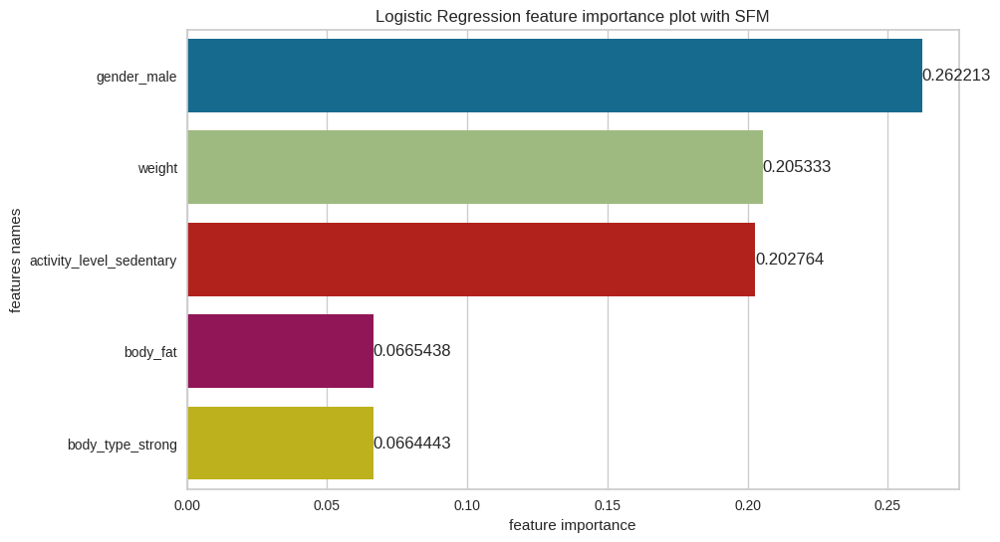

[Logistic Regression] Best parameters are {'C': 1, 'penalty': 'l2', 'random_state': 42, 'solver': 'liblinear'}
[INFO] Performing Grid-Search CV ---- Decision Tree
[Decision Tree] Features selected: Index(['height', 'weight', 'body_fat', 'body_type_thin',
       'newsletter_subscription_True'],
      dtype='object')
[Decision Tree] Features importances: [0.08314732212989122, 0.4776846895587447, 0.439167988311364, 0.0, 0.0]


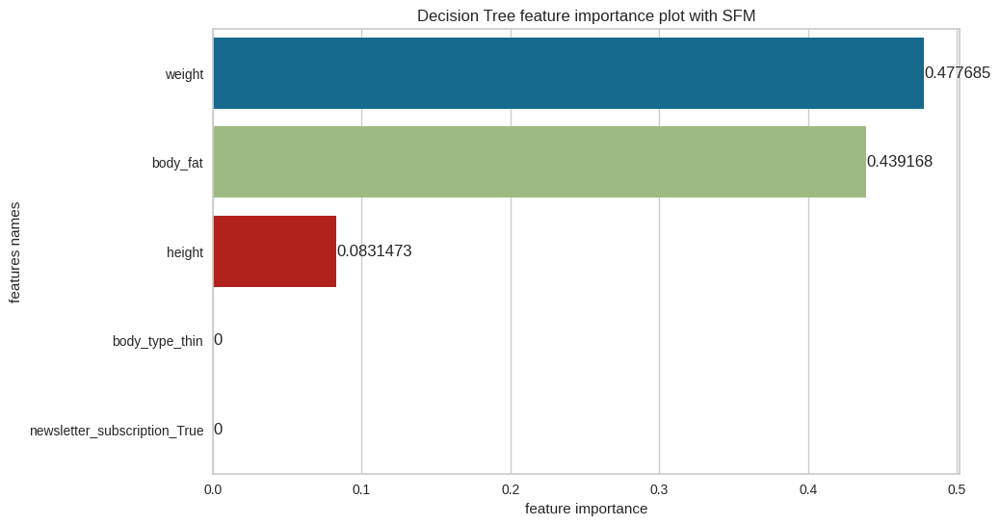

[Decision Tree] Best parameters are {'criterion': 'gini', 'max_depth': 3, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Random Forest
[Random Forest] Features selected: Index(['height', 'weight', 'body_fat', 'body_type_thin',
       'newsletter_subscription_True'],
      dtype='object')
[Random Forest] Features importances: [0.18905679216854934, 0.3219382898356371, 0.44982070883872605, 0.019583576367074248, 0.019600632790013395]


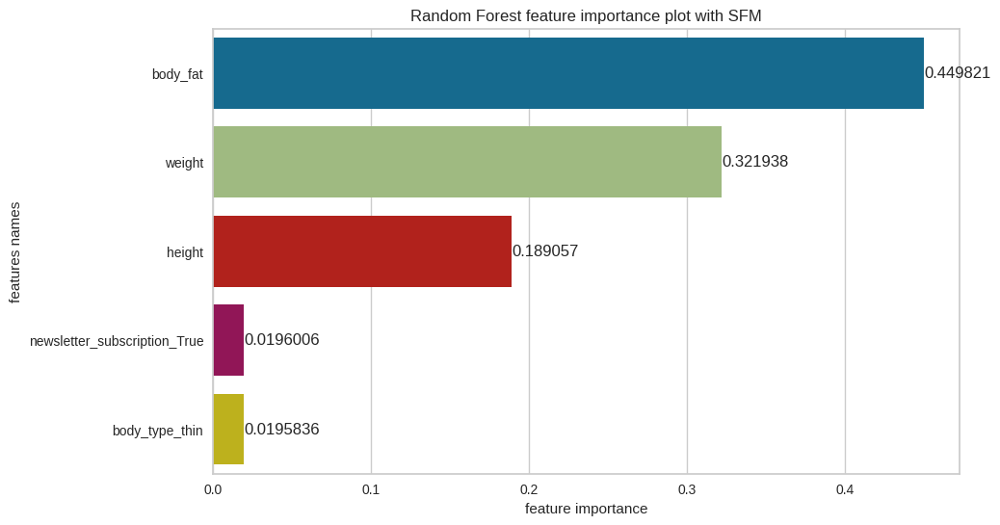

[Random Forest] Best parameters are {'criterion': 'gini', 'max_depth': 3, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- AdaBoost
[AdaBoost] Features selected: Index(['height', 'weight', 'body_fat', 'gender_male',
       'activity_level_sedentary'],
      dtype='object')
[AdaBoost] Features importances: [0.1426682552170994, 0.4262858422649477, 0.19940458978381054, 0.06690055397624937, 0.16474075875789299]


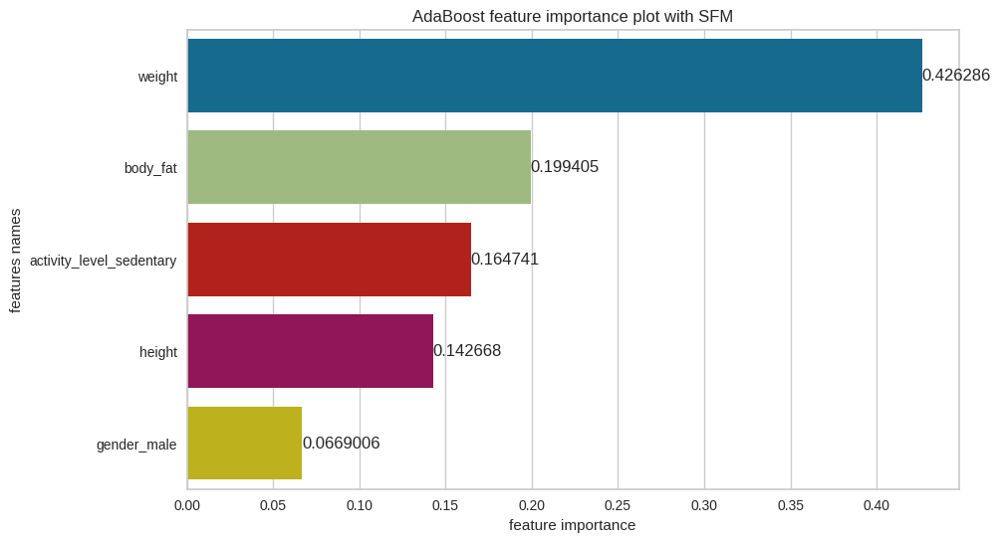

[AdaBoost] Best parameters are {'base_estimator': DecisionTreeClassifier(max_depth=3), 'learning_rate': 0.1, 'n_estimators': 20, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- GradientBoost
[GradientBoost] Features selected: Index(['height', 'weight', 'body_fat', 'gender_male',
       'activity_level_sedentary'],
      dtype='object')
[GradientBoost] Features importances: [0.1651193073831167, 0.01311672079552642, 0.5628863470328802, 0.08715293065241593, 0.17172469413606087]


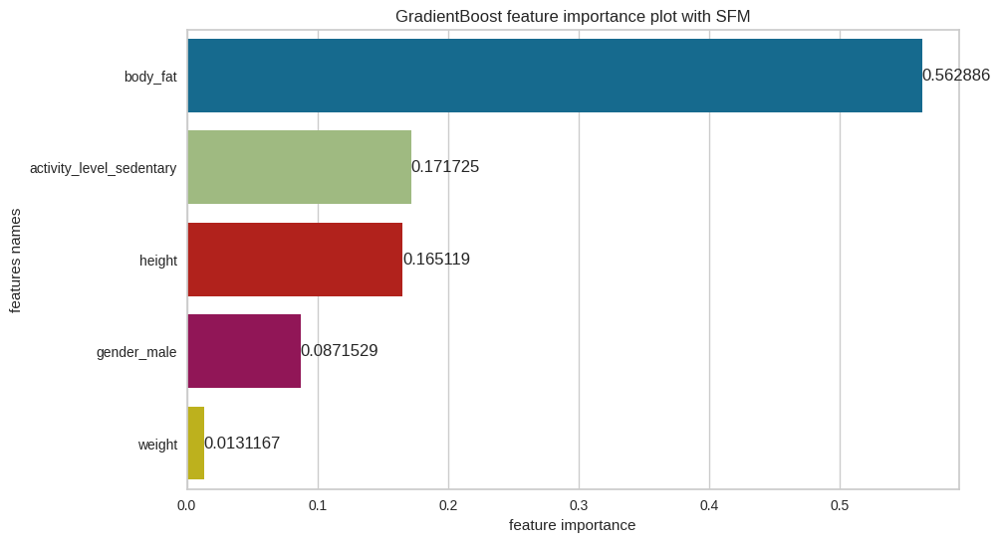

[GradientBoost] Best parameters are {'criterion': 'friedman_mse', 'learning_rate': 0.01, 'loss': 'deviance', 'max_depth': 3, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'n_estimators': 5, 'random_state': 42, 'subsample': 0.5}


In [241]:
estimators_multiclass_sel_3_sfm, X_test_sel_3_sfm, y_test_sel_3_sfm, X_train_sel_3_sfm, y_train_sel_3_sfm, X_test_inv_sel_3_sfm, features_sel_3_sfm = train(X_demo_adh_3, y_demo_adh_3, 
                                                         grid_params_multiclass, 
                                                         seed, feature_selection = True, 
                                                         feature_sel_type = 'SFM')

In [242]:
evaluation_table_sel_3_sfm = evaluate_multiclass(estimators_multiclass_sel_3_sfm, X_test_sel_3_sfm, y_test_sel_3_sfm, no_of_labels = 3, features_selected = True, feature_sel_type = 'SFM', features = features_sel_3_sfm)


In [243]:
evaluation_table_sel_3_sfm

,Overall Accuracy,Balanced Accuracy,Adj Balanced Accuracy,Precision micro,Precision macro,Precision weighted,Recall micro,Recall macro,Recall weighted,Cohen's kappa,Mathews Correlation Coefficient
SGD,0.60,0.50,0.00,0.60,0.30,0.36,0.60,0.50,0.60,0.00,0.00
Logistic Regression,0.60,0.53,0.06,0.60,0.57,0.58,0.60,0.53,0.60,0.07,0.09
Decision Tree,0.60,0.50,0.00,0.60,0.30,0.36,0.60,0.50,0.60,0.00,0.00
Random Forest,0.60,0.50,0.00,0.60,0.30,0.36,0.60,0.50,0.60,0.00,0.00
AdaBoost,0.61,0.53,0.07,0.61,0.58,0.59,0.61,0.53,0.61,0.07,0.10
GradientBoost,0.60,0.50,0.00,0.60,0.30,0.36,0.60,0.50,0.60,0.00,0.00


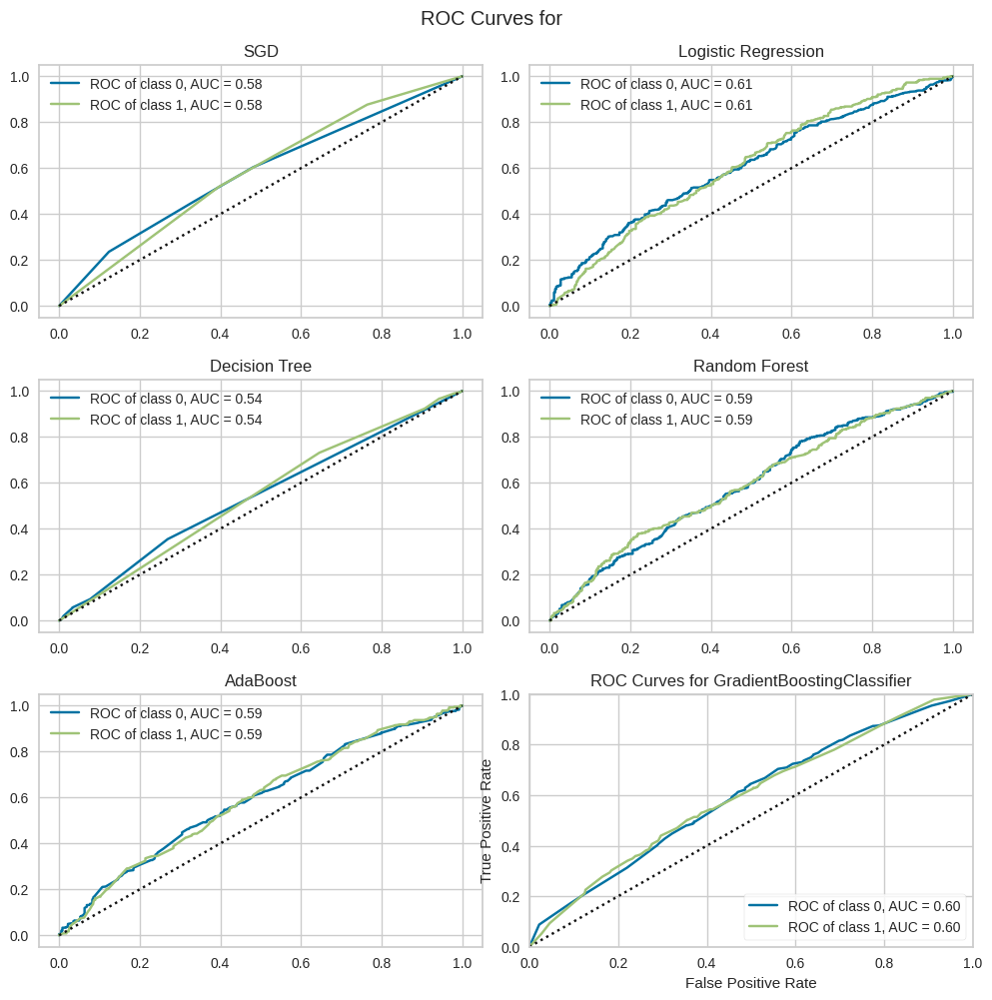

<AxesSubplot: title={'center': 'ROC Curves for GradientBoostingClassifier'}, xlabel='False Positive Rate', ylabel='True Positive Rate'>

In [244]:
ROC_curves(estimators_multiclass_sel_3_sfm, X_train_sel_3_sfm, y_train_sel_3_sfm, X_test_sel_3_sfm, y_test_sel_3_sfm, np.unique(y_demo_adh_3), name = 'all', features_selected = True, feature_sel_type = 'SFM', features = features_sel_3_sfm)


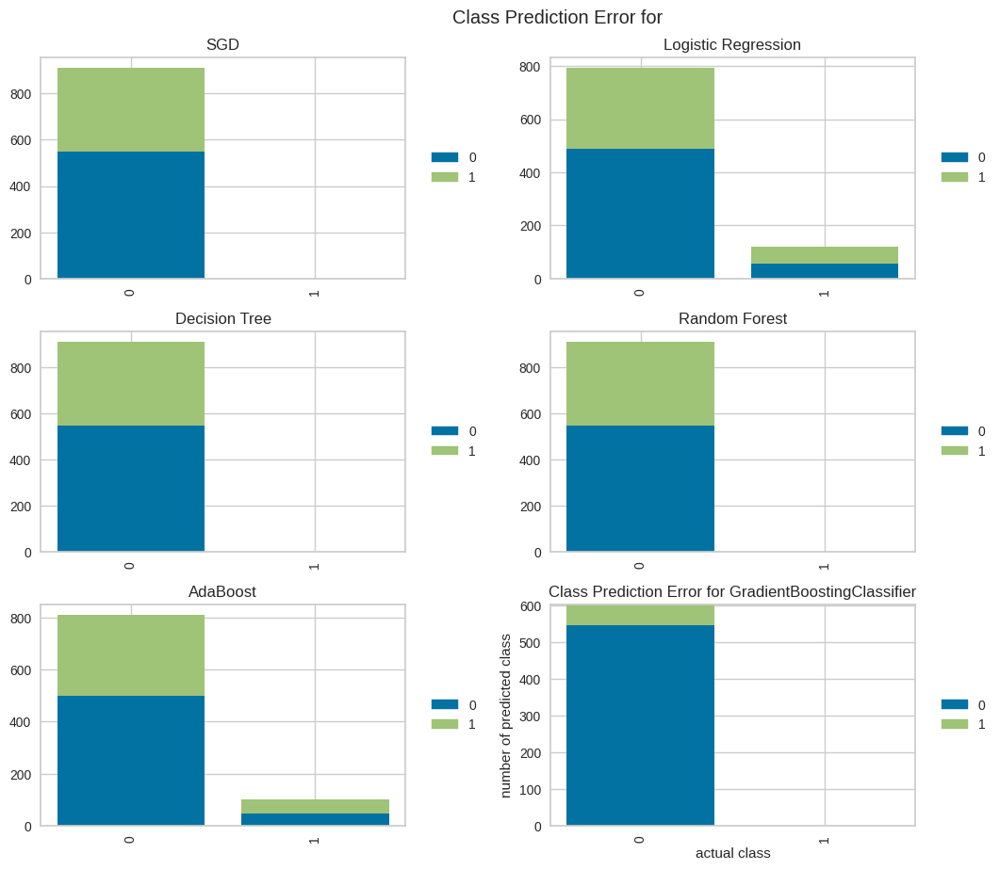

<AxesSubplot: title={'center': 'Class Prediction Error for GradientBoostingClassifier'}, xlabel='actual class', ylabel='number of predicted class'>

In [245]:
prediction_error_plot(estimators_multiclass_sel_3_sfm, X_train_sel_3_sfm, y_train_sel_3_sfm, X_test_sel_3_sfm, y_test_sel_3_sfm, np.unique(y_demo_adh_3), name = 'all', features_selected = True, feature_sel_type = 'SFM', features = features_sel_3_sfm)


### Tenth approach (2 groups, first 8 weeks, workout: at least once a week for 4 weeks)

Here, the user is adherent if during the first 8 weeks he/she worked out at least once a week in a period of 4 weeks.

* Group 0 - users that didn't do workout at least once a week in a period of 4 weeks (in 4 weeks time) - 1902 users,
* Group 1 - users that worked out at least once a week for 4 weeks (adherent users) - 1132 users.

We take into consideration only demographical data.

* gender,
* activity_level,
* body_type,
* newsletter_subscription,
* height,
* weight and
* body fat.

In [246]:
# deleting label from data
X_demo_adh_8_4 = df_users_demo_any_adh_8_4.loc[:, df_users_demo_any_adh_8_4.columns != 'Adh']

# variable only with label
y_demo_adh_8_4 = df_users_demo_any_adh_8_4['Adh'].to_numpy()


cat_cols = ['gender', 'body_type', 'newsletter_subscription', 'activity_level']
X_demo_adh_8_4 = pd.get_dummies(X_demo_adh_8_4, columns = cat_cols, drop_first = True)

#X_demo_adh = OrdinalEncoder().fit_transform(X_demo_adh)
y_demo_ad_8_4 = pd.DataFrame(y_demo_adh_8_4, columns = ['Adherence group'])

[INFO] Performing Grid-Search CV ---- SGD
[SGD] Features importances: [0.05009899 0.0907332  0.10771585 0.14384019 0.0348606  0.09807014
 0.00719761 0.03848937 0.1124233 ]


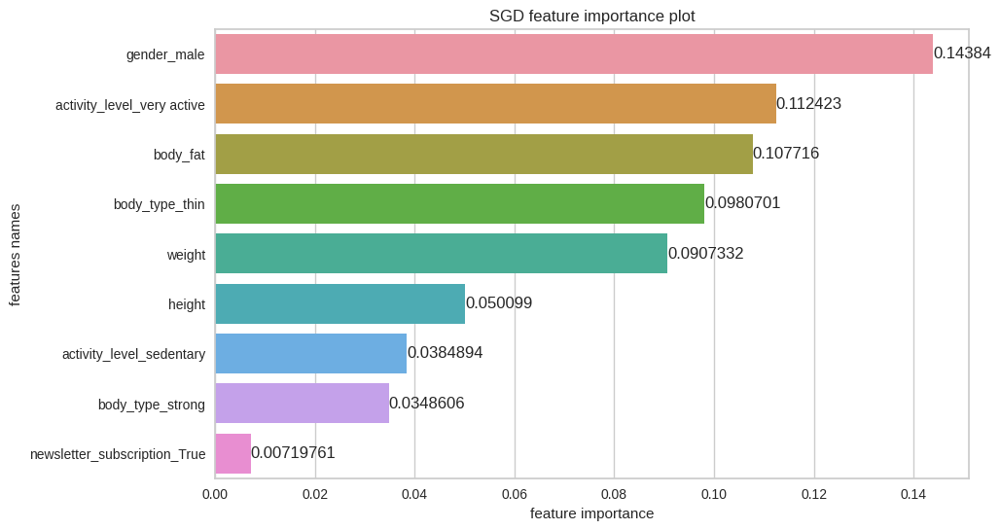

[SGD] Best parameters are {'alpha': 0.0007525, 'eta0': 0.0001, 'learning_rate': 'optimal', 'penalty': 'l2', 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Logistic Regression
[Logistic Regression] Features importances: [0.15060059 0.28364485 0.10388255 0.27024137 0.01843837 0.05791532
 0.07115408 0.28715035 0.02760679]


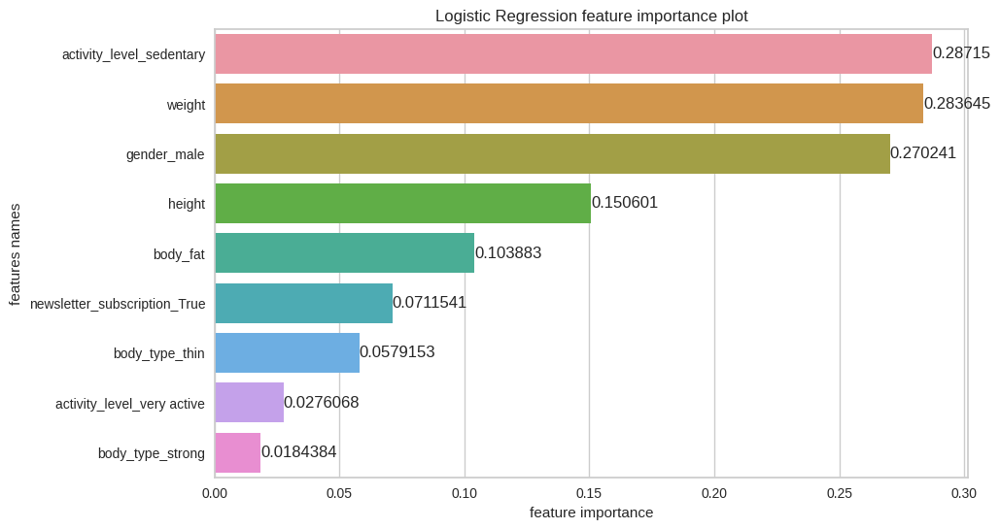

[Logistic Regression] Best parameters are {'C': 1, 'penalty': 'l1', 'random_state': 42, 'solver': 'liblinear'}
[INFO] Performing Grid-Search CV ---- Decision Tree
[Decision Tree] Features importances: [0.08611201251178621, 0.22187167698789473, 0.0, 0.11854970646534208, 0.042182730657661684, 0.0, 0.0, 0.5312838733773153, 0.0]


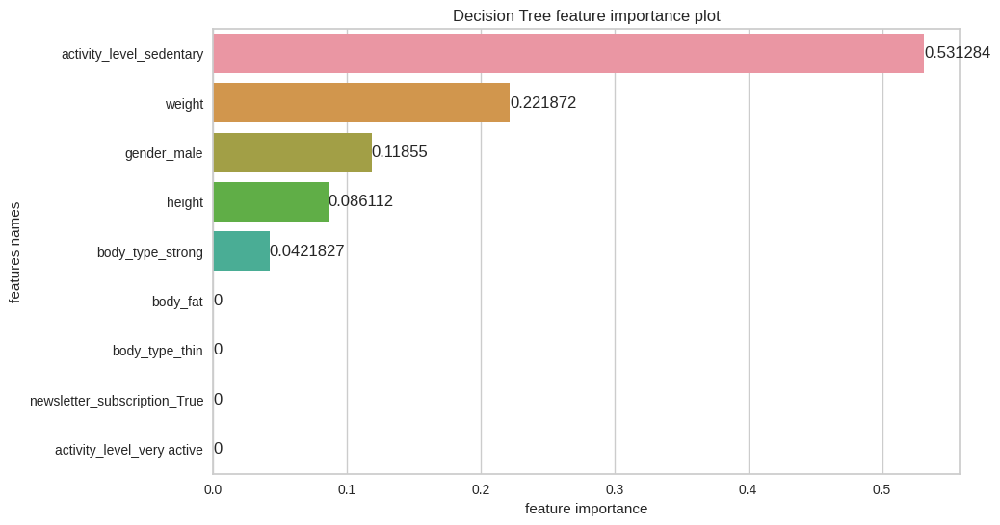

[Decision Tree] Best parameters are {'criterion': 'entropy', 'max_depth': 3, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Random Forest
[Random Forest] Features importances: [0.08441917407757676, 0.16030423014824155, 0.15614939398541272, 0.2042727761754053, 0.0, 0.008309355428337231, 0.00454316651678002, 0.38200190366824643, 0.0]


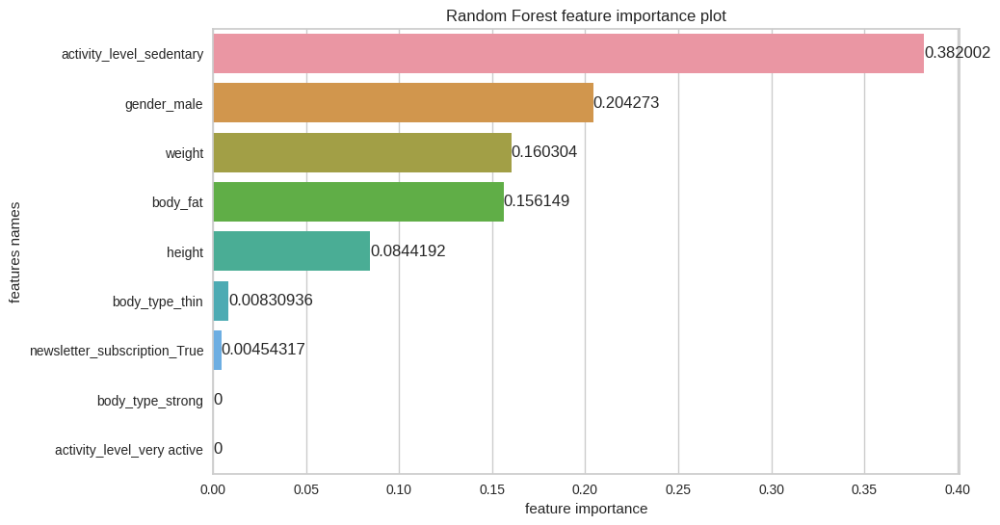

[Random Forest] Best parameters are {'criterion': 'gini', 'max_depth': 3, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- AdaBoost
[AdaBoost] Features importances: [0.18670913107177228, 0.27201916182018826, 0.08269106412752494, 0.12222738538134297, 0.0, 0.0, 0.0, 0.33635325759917156, 0.0]


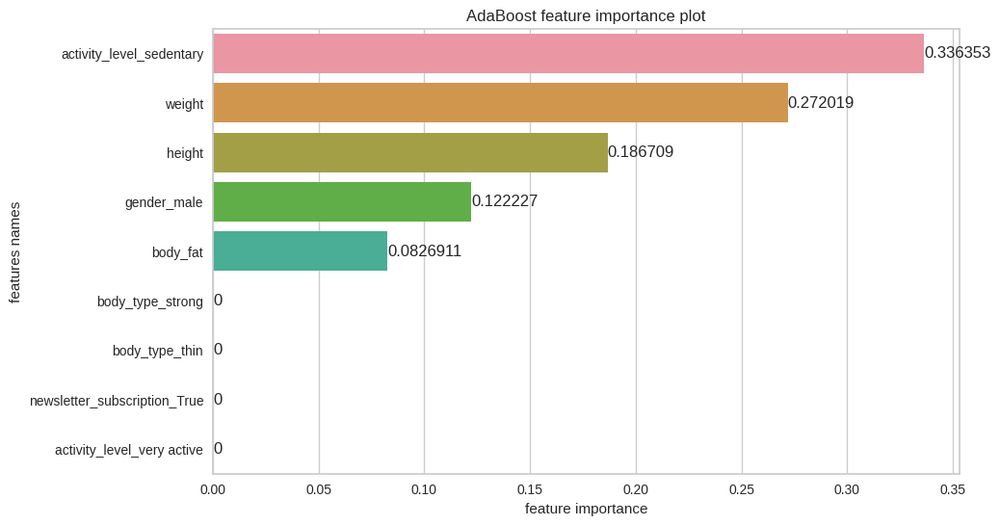

[AdaBoost] Best parameters are {'base_estimator': DecisionTreeClassifier(max_depth=2), 'learning_rate': 0.1, 'n_estimators': 20, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- GradientBoost
[GradientBoost] Features importances: [0.11432195071730288, 0.13136809801809143, 0.34399337153646153, 0.23121937845472518, 0.0, 0.0, 0.0, 0.179097201273419, 0.0]


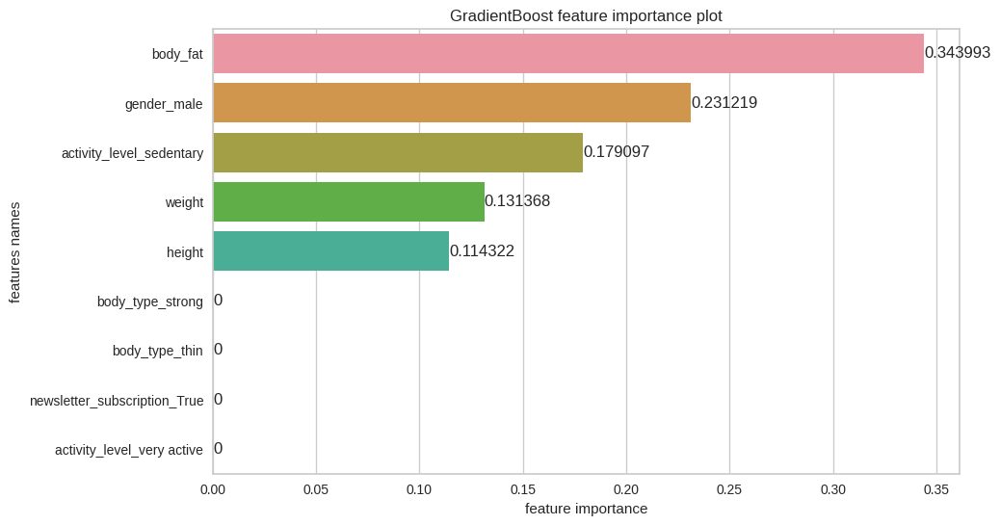

[GradientBoost] Best parameters are {'criterion': 'friedman_mse', 'learning_rate': 0.01, 'loss': 'deviance', 'max_depth': 3, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'n_estimators': 5, 'random_state': 42, 'subsample': 0.5}


In [247]:
estimators_multiclass_8_4, X_test_8_4, y_test_8_4, X_train_8_4, y_train_8_4, X_test_inv_8_4, features_8_4 = train(X_demo_adh_8_4, y_demo_adh_8_4, 
                                                         grid_params_multiclass, 
                                                         seed, feature_selection = False)

In [248]:
evaluation_table_8_4 = evaluate_multiclass(estimators_multiclass_8_4, X_test_8_4, y_test_8_4, no_of_labels = 3, features_selected = False, features = features_8_4)

In [249]:
evaluation_table_8_4

,Overall Accuracy,Balanced Accuracy,Adj Balanced Accuracy,Precision micro,Precision macro,Precision weighted,Recall micro,Recall macro,Recall weighted,Cohen's kappa,Mathews Correlation Coefficient
SGD,0.63,0.50,0.00,0.63,0.31,0.39,0.63,0.50,0.63,0.00,0.00
Logistic Regression,0.63,0.55,0.10,0.63,0.58,0.60,0.63,0.55,0.63,0.11,0.13
Decision Tree,0.63,0.50,0.00,0.63,0.81,0.77,0.63,0.50,0.63,0.00,0.04
Random Forest,0.63,0.50,0.00,0.63,0.31,0.39,0.63,0.50,0.63,0.00,0.00
AdaBoost,0.63,0.52,0.04,0.63,0.58,0.60,0.63,0.52,0.63,0.04,0.08
GradientBoost,0.63,0.50,0.00,0.63,0.31,0.39,0.63,0.50,0.63,0.00,0.00


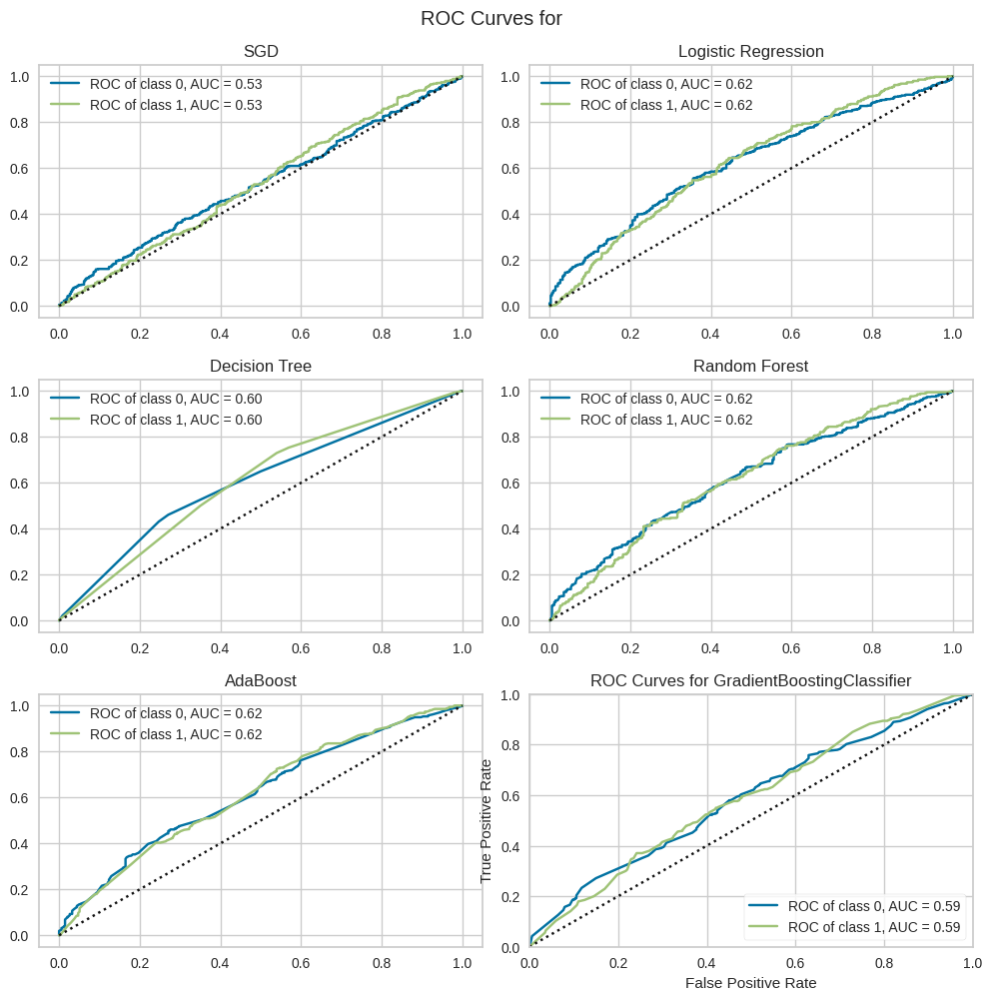

<AxesSubplot: title={'center': 'ROC Curves for GradientBoostingClassifier'}, xlabel='False Positive Rate', ylabel='True Positive Rate'>

In [250]:
ROC_curves(estimators_multiclass_8_4, X_train_8_4, y_train_8_4, X_test_8_4, y_test_8_4, np.unique(y_demo_adh_8_4), name = 'all', features_selected = False, features = features_8_4)


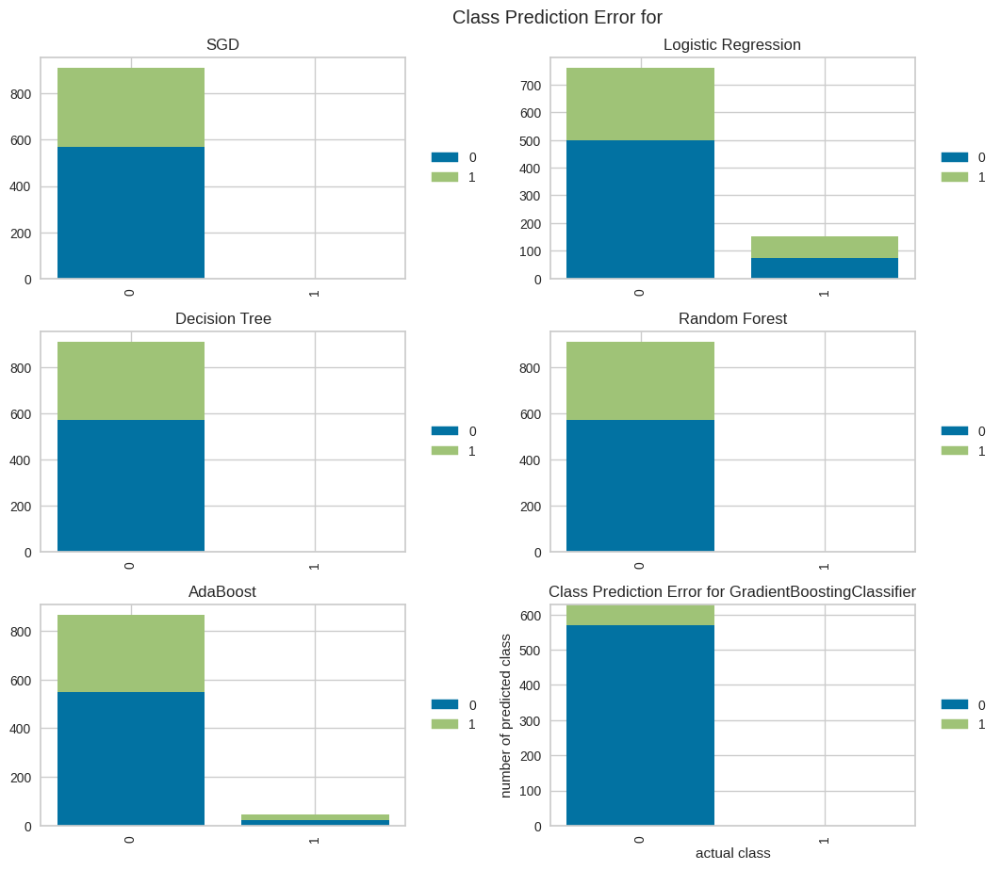

<AxesSubplot: title={'center': 'Class Prediction Error for GradientBoostingClassifier'}, xlabel='actual class', ylabel='number of predicted class'>

In [251]:
prediction_error_plot(estimators_multiclass_8_4, X_train_8_4, y_train_8_4, X_test_8_4, y_test_8_4, np.unique(y_demo_adh_8_4), name = 'all', features_selected = False, features = features_8_4)


#### With feature selection (by Univariate)

[INFO] Performing Grid-Search CV ---- SGD
[SGD] Features selected: Index(['height', 'weight', 'body_fat'], dtype='object')
[SGD] Features importances: [1.70017385e-07 3.40194880e-06 9.20156665e-07]


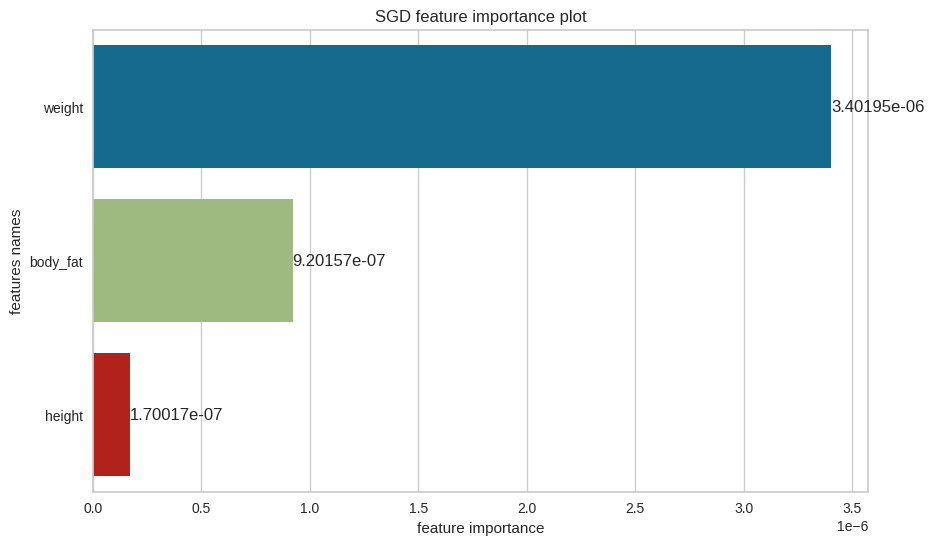

[SGD] Best parameters are {'alpha': 1e-05, 'eta0': 0.0001, 'learning_rate': 'adaptive', 'penalty': 'l1', 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Logistic Regression
[Logistic Regression] Features selected: Index(['height', 'weight', 'body_fat'], dtype='object')
[Logistic Regression] Features importances: [0.29571718 0.18443971 0.19301921]


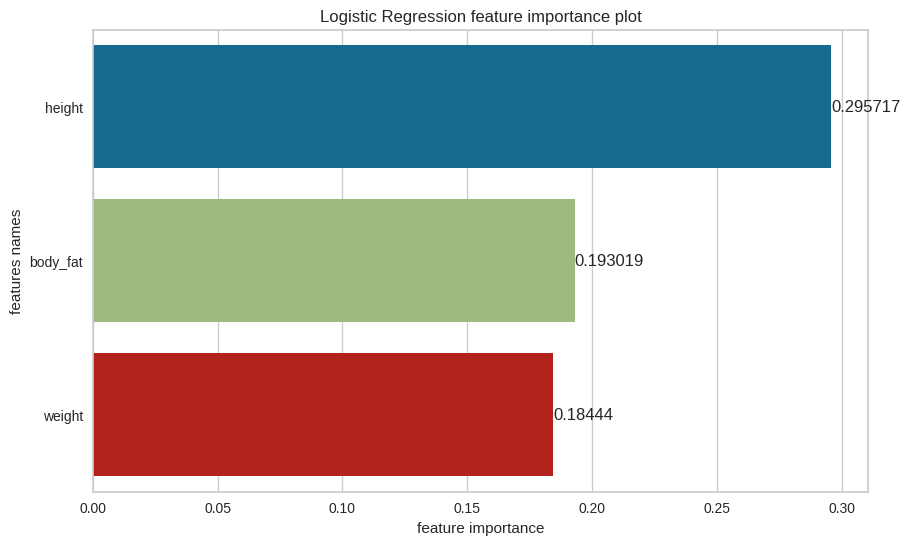

[Logistic Regression] Best parameters are {'C': 1, 'penalty': 'l2', 'random_state': 42, 'solver': 'liblinear'}
[INFO] Performing Grid-Search CV ---- Decision Tree
[Decision Tree] Features selected: Index(['height', 'weight', 'body_fat'], dtype='object')
[Decision Tree] Features importances: [0.4067311299755097, 0.39077348092305575, 0.20249538910143466]


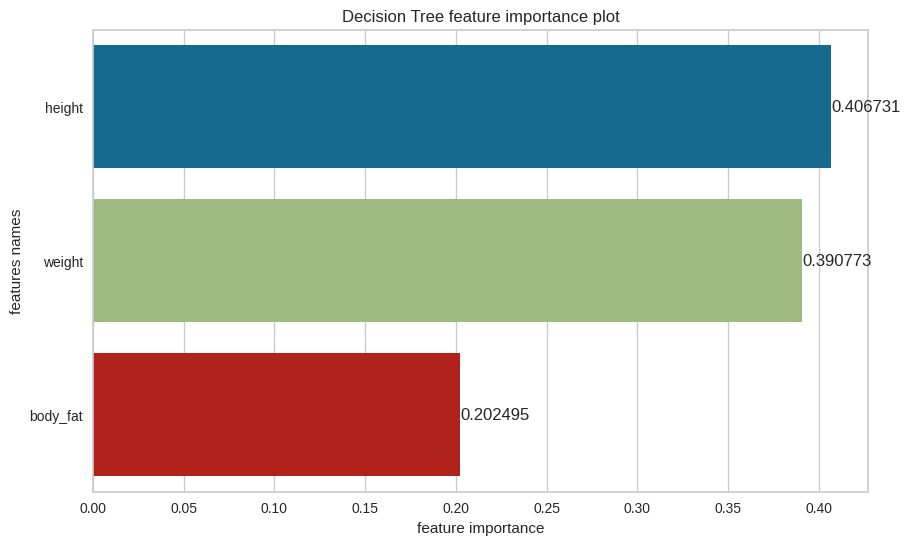

[Decision Tree] Best parameters are {'criterion': 'entropy', 'max_depth': 6, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Random Forest
[Random Forest] Features selected: Index(['height', 'weight', 'body_fat'], dtype='object')
[Random Forest] Features importances: [0.3192914020849595, 0.3543463623452477, 0.3263622355697928]


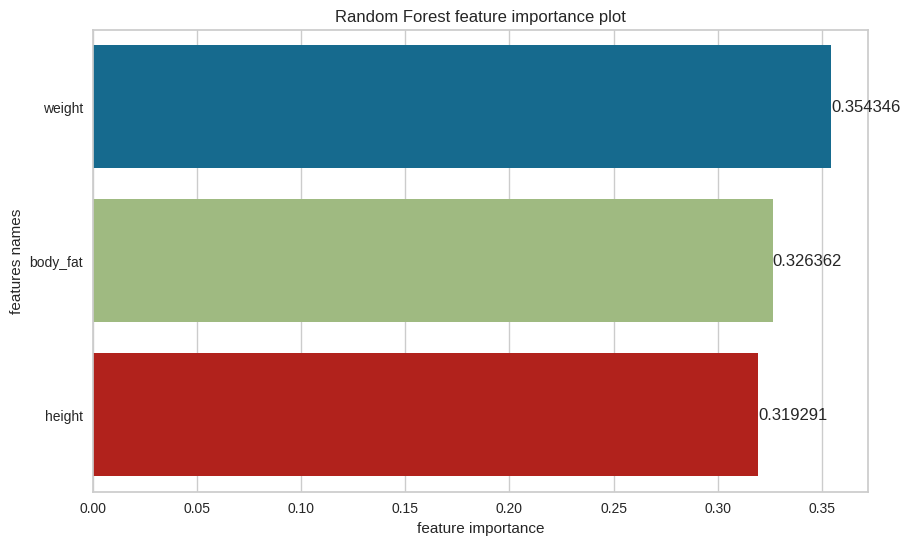

[Random Forest] Best parameters are {'criterion': 'gini', 'max_depth': 3, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- AdaBoost
[AdaBoost] Features selected: Index(['height', 'weight', 'body_fat'], dtype='object')
[AdaBoost] Features importances: [0.3499789251202417, 0.36722494342282874, 0.28279613145692967]


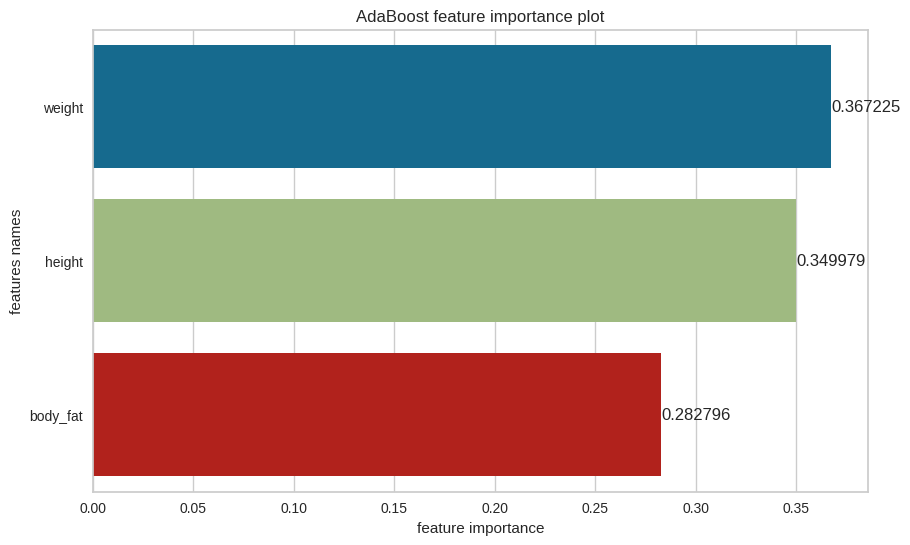

[AdaBoost] Best parameters are {'base_estimator': DecisionTreeClassifier(max_depth=2), 'learning_rate': 0.025, 'n_estimators': 60, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- GradientBoost
[GradientBoost] Features selected: Index(['height', 'weight', 'body_fat'], dtype='object')
[GradientBoost] Features importances: [0.22805283777420374, 0.3989361062043206, 0.3730110560214756]


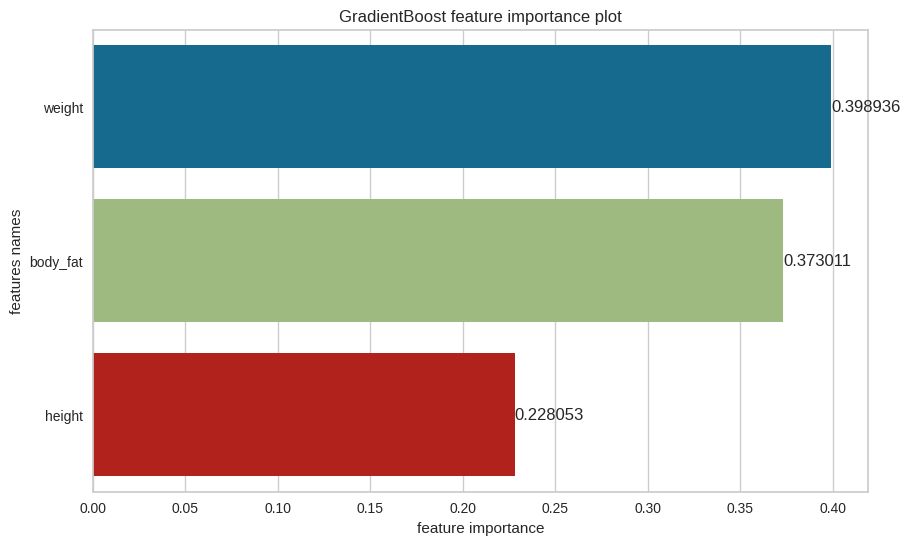

[GradientBoost] Best parameters are {'criterion': 'friedman_mse', 'learning_rate': 0.01, 'loss': 'deviance', 'max_depth': 3, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'n_estimators': 5, 'random_state': 42, 'subsample': 0.5}


In [252]:
estimators_multiclass_sel_8_4_u, X_test_sel_8_4_u, y_test_sel_8_4_u, X_train_sel_8_4_u, y_train_sel_8_4_u, X_test_inv_sel_8_4_u, features_sel_8_4_u = train(X_demo_adh_8_4, y_demo_adh_8_4, 
                                                         grid_params_multiclass, 
                                                         seed, feature_selection = True, 
                                                         feature_sel_type = 'UNI')

In [253]:
evaluation_table_sel_8_4_u = evaluate_multiclass(estimators_multiclass_sel_8_4_u, X_test_sel_8_4_u, y_test_sel_8_4_u, no_of_labels = 3, features_selected = True, feature_sel_type = 'UNI', features = features_sel_8_4_u)

In [254]:
evaluation_table_sel_8_4_u

,Overall Accuracy,Balanced Accuracy,Adj Balanced Accuracy,Precision micro,Precision macro,Precision weighted,Recall micro,Recall macro,Recall weighted,Cohen's kappa,Mathews Correlation Coefficient
SGD,0.63,0.50,0.00,0.63,0.31,0.39,0.63,0.50,0.63,0.00,0.00
Logistic Regression,0.62,0.51,0.03,0.62,0.55,0.57,0.62,0.51,0.62,0.03,0.05
Decision Tree,0.61,0.52,0.03,0.61,0.54,0.56,0.61,0.52,0.61,0.04,0.05
Random Forest,0.63,0.50,0.00,0.63,0.31,0.39,0.63,0.50,0.63,0.00,0.00
AdaBoost,0.63,0.52,0.04,0.63,0.58,0.60,0.63,0.52,0.63,0.04,0.08
GradientBoost,0.63,0.50,0.00,0.63,0.31,0.39,0.63,0.50,0.63,0.00,0.00


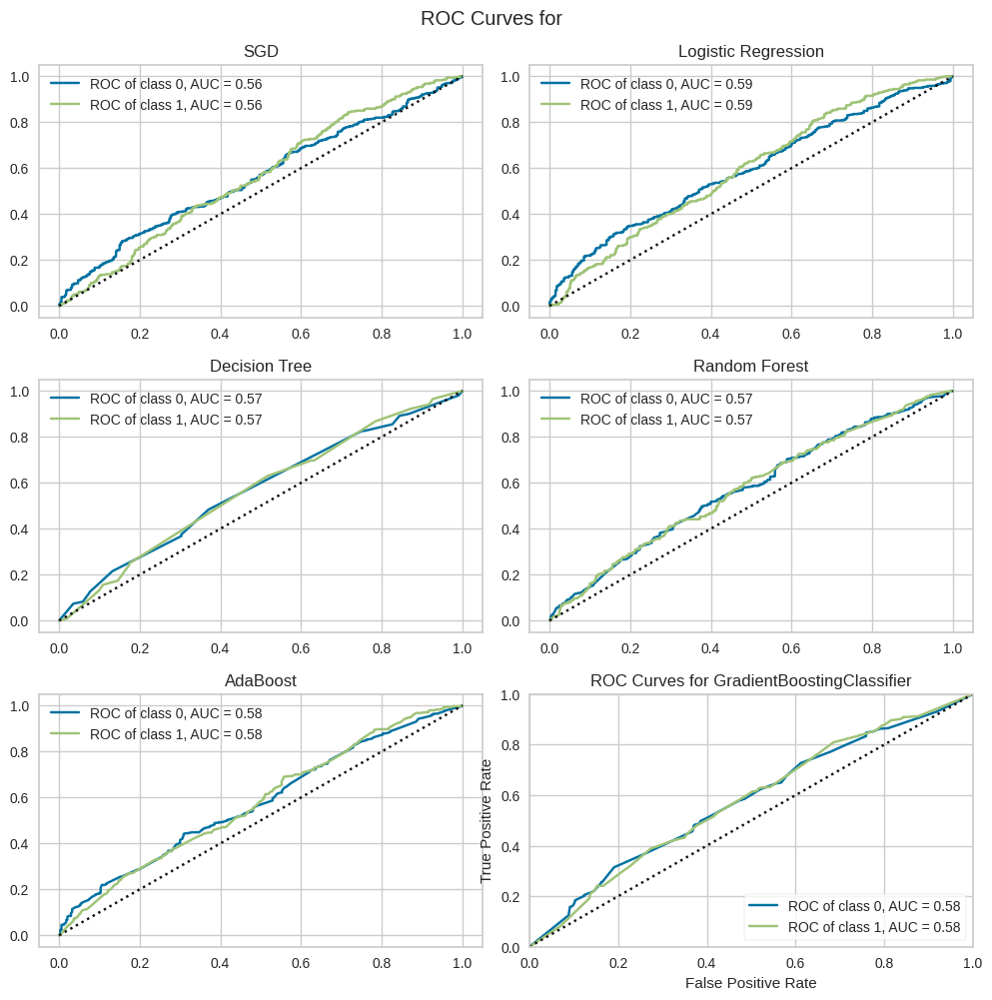

<AxesSubplot: title={'center': 'ROC Curves for GradientBoostingClassifier'}, xlabel='False Positive Rate', ylabel='True Positive Rate'>

In [255]:
ROC_curves(estimators_multiclass_sel_8_4_u, X_train_sel_8_4_u, y_train_sel_8_4_u, X_test_sel_8_4_u, y_test_sel_8_4_u, np.unique(y_demo_adh_8_4), name = 'all', features_selected = True, feature_sel_type = 'UNI', features = features_sel_8_4_u)

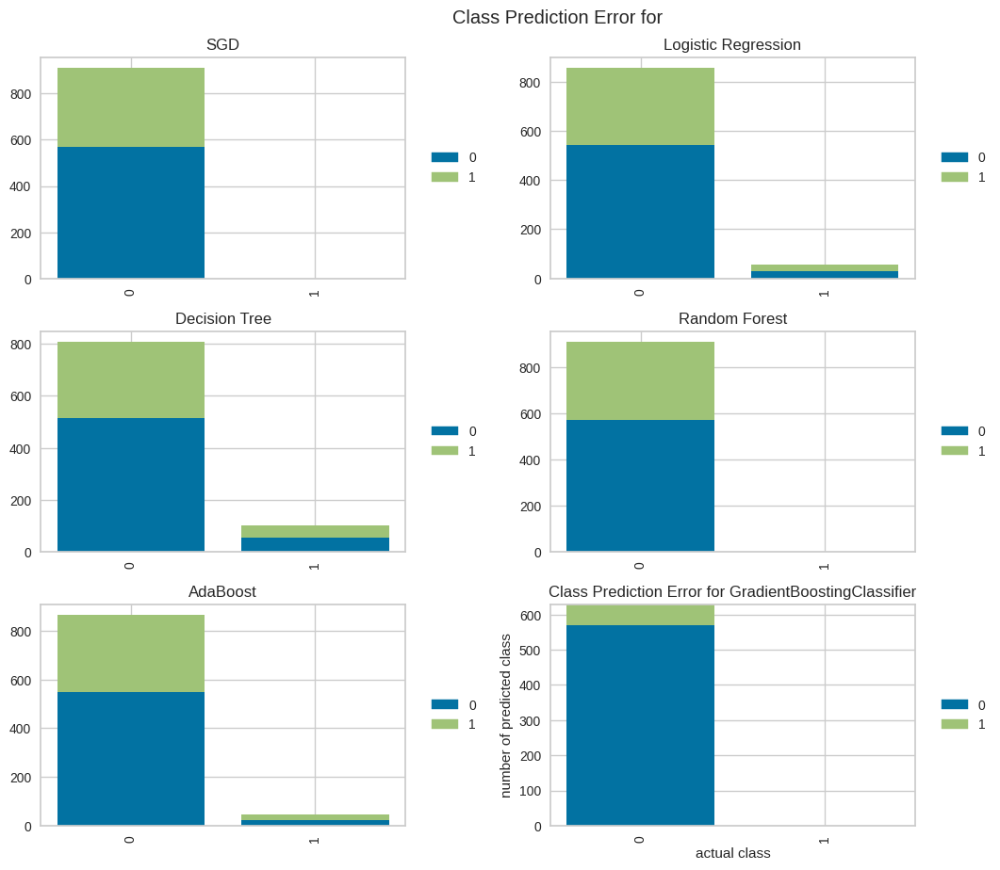

<AxesSubplot: title={'center': 'Class Prediction Error for GradientBoostingClassifier'}, xlabel='actual class', ylabel='number of predicted class'>

In [256]:
prediction_error_plot(estimators_multiclass_sel_8_4_u, X_train_sel_8_4_u, y_train_sel_8_4_u, X_test_sel_8_4_u, y_test_sel_8_4_u, np.unique(y_demo_adh_8_4), name = 'all', features_selected = True, feature_sel_type = 'UNI', features = features_sel_8_4_u)

#### With feature selection (by SequentialFeatureSelector)

In [257]:
estimators_multiclass_sel_8_4, X_test_sel_8_4, y_test_sel_8_4, X_train_sel_8_4, y_train_sel_8_4, X_test_inv_sel_8_4, features_sel_8_4 = train(X_demo_adh_8_4, y_demo_adh_8_4, 
                                                         grid_params_multiclass, 
                                                         seed, feature_selection = True, 
                                                         feature_sel_type = 'SFS')

[INFO] Performing Grid-Search CV ---- SGD
[SGD] Features selected: Index(['height'], dtype='object')
[SGD] Best parameters are {'alpha': 1e-05, 'eta0': 0.0001, 'learning_rate': 'optimal', 'penalty': 'elasticnet', 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Logistic Regression
[Logistic Regression] Features selected: Index(['weight', 'body_fat', 'gender_male', 'activity_level_sedentary',
       'activity_level_very active'],
      dtype='object')
[Logistic Regression] Best parameters are {'C': 2, 'penalty': 'l1', 'random_state': 42, 'solver': 'liblinear'}
[INFO] Performing Grid-Search CV ---- Decision Tree
[Decision Tree] Features selected: Index(['body_fat', 'gender_male', 'body_type_strong',
       'activity_level_very active'],
      dtype='object')
[Decision Tree] Best parameters are {'criterion': 'entropy', 'max_depth': 12, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Random Forest
[Random Forest] Features selected: Index(['body_fat', 'gender_male', 'acti

In [258]:
evaluation_table_sel_8_4 = evaluate_multiclass(estimators_multiclass_sel_8_4, X_test_sel_8_4, y_test_sel_8_4, no_of_labels = 3, features_selected = True, feature_sel_type = 'SFS', features = features_sel_8_4)


In [259]:
evaluation_table_sel_8_4

,Overall Accuracy,Balanced Accuracy,Adj Balanced Accuracy,Precision micro,Precision macro,Precision weighted,Recall micro,Recall macro,Recall weighted,Cohen's kappa,Mathews Correlation Coefficient
SGD,0.59,0.50,0.01,0.59,0.51,0.54,0.59,0.50,0.59,0.01,0.01
Logistic Regression,0.63,0.54,0.09,0.63,0.58,0.60,0.63,0.54,0.63,0.10,0.12
Decision Tree,0.61,0.52,0.04,0.61,0.54,0.56,0.61,0.52,0.61,0.04,0.05
Random Forest,0.63,0.50,0.00,0.63,0.31,0.39,0.63,0.50,0.63,0.00,0.00
AdaBoost,0.62,0.51,0.03,0.62,0.55,0.57,0.62,0.51,0.62,0.03,0.05
GradientBoost,0.63,0.50,0.00,0.63,0.31,0.39,0.63,0.50,0.63,0.00,0.00


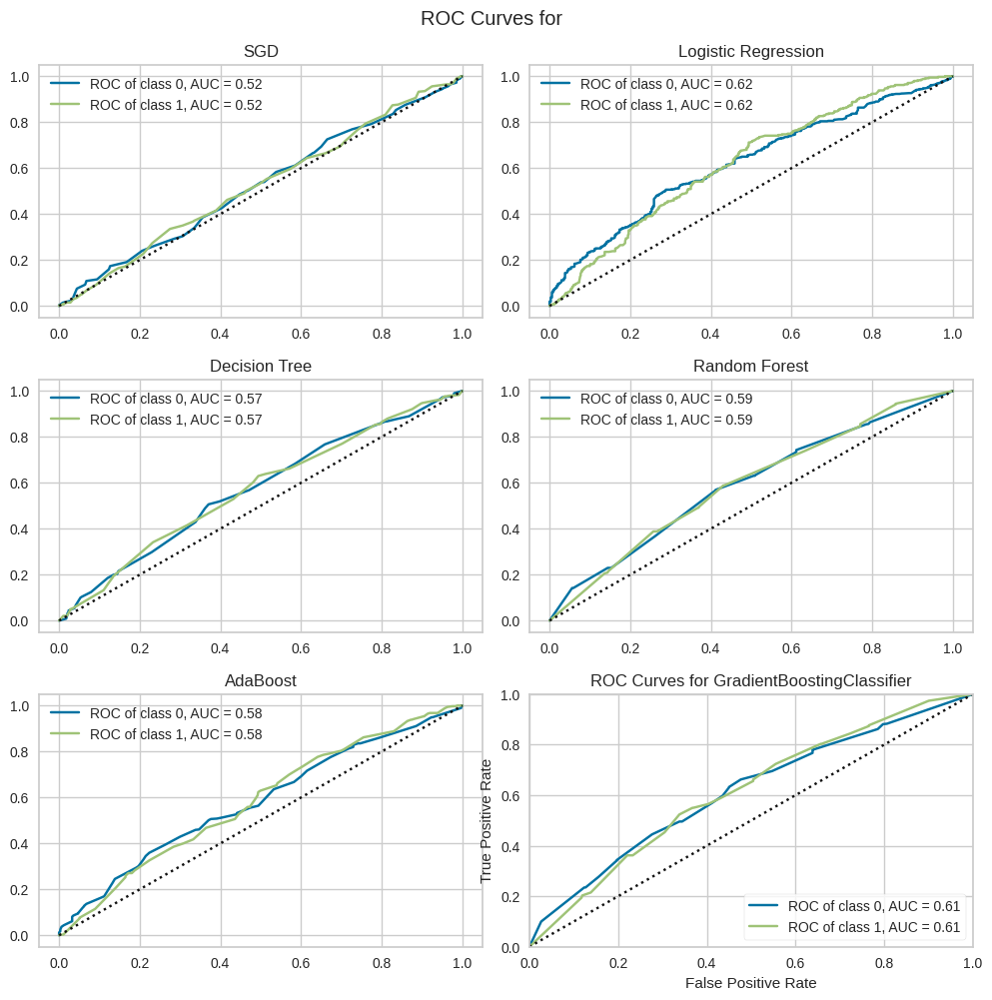

<AxesSubplot: title={'center': 'ROC Curves for GradientBoostingClassifier'}, xlabel='False Positive Rate', ylabel='True Positive Rate'>

In [260]:
ROC_curves(estimators_multiclass_sel_8_4, X_train_sel_8_4, y_train_sel_8_4, X_test_sel_8_4, y_test_sel_8_4, np.unique(y_demo_adh_8_4), name = 'all', features_selected = True, feature_sel_type = 'SFS', features = features_sel_8_4)


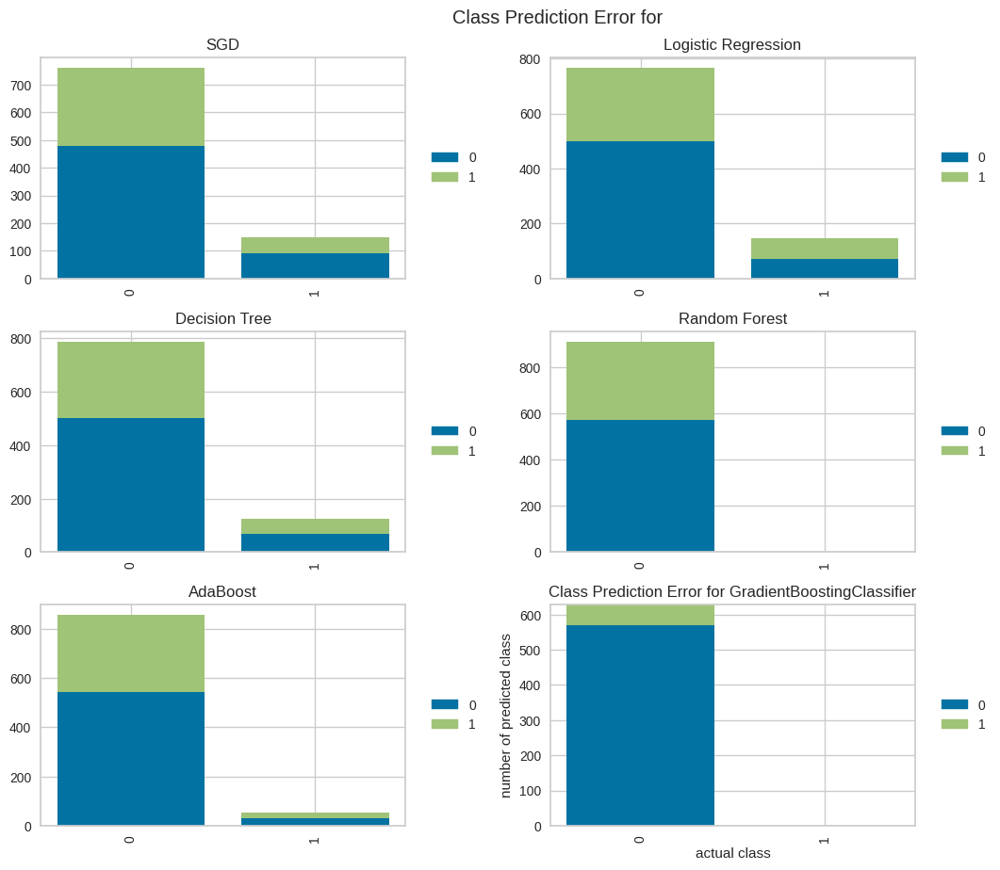

<AxesSubplot: title={'center': 'Class Prediction Error for GradientBoostingClassifier'}, xlabel='actual class', ylabel='number of predicted class'>

In [261]:
prediction_error_plot(estimators_multiclass_sel_8_4, X_train_sel_8_4, y_train_sel_8_4, X_test_sel_8_4, y_test_sel_8_4, np.unique(y_demo_adh_8_4), name = 'all', features_selected = True, feature_sel_type = 'SFS', features = features_sel_8_4)


#### With feature selection (by Recursive feature elimination with cross-validation - RFECV)

[INFO] Performing Grid-Search CV ---- SGD
[SGD] Features selected: Index(['body_type_strong'], dtype='object')
[SGD] Features importances: [0.00065015]


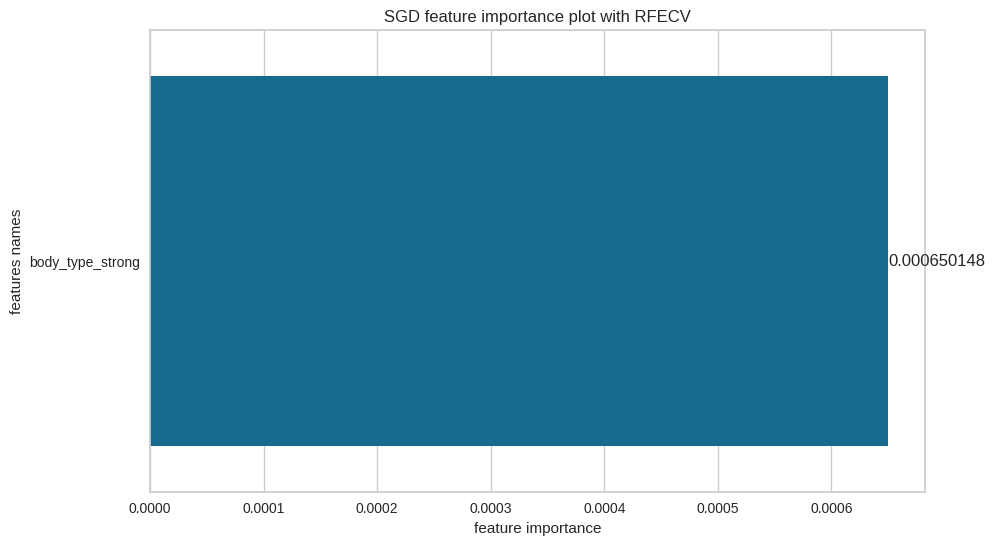

[SGD] Best parameters are {'alpha': 1e-05, 'eta0': 0.0001, 'learning_rate': 'invscaling', 'penalty': 'l1', 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Logistic Regression
[Logistic Regression] Features selected: Index(['height', 'weight', 'body_fat', 'gender_male',
       'activity_level_sedentary'],
      dtype='object')
[Logistic Regression] Features importances: [0.13941925 0.26880005 0.0938847  0.27549942 0.28850414]


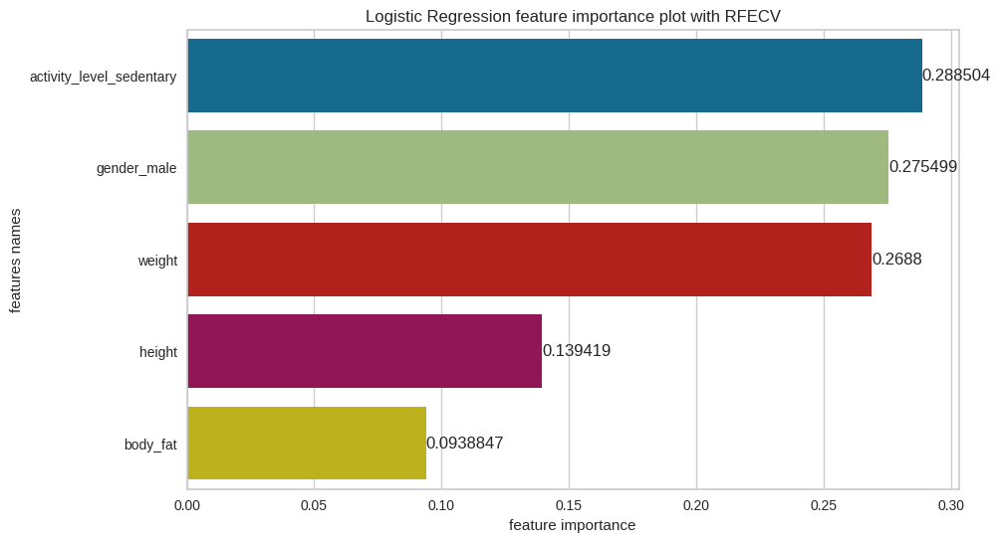

[Logistic Regression] Best parameters are {'C': 2, 'penalty': 'l1', 'random_state': 42, 'solver': 'liblinear'}
[INFO] Performing Grid-Search CV ---- Decision Tree
[Decision Tree] Features selected: Index(['weight'], dtype='object')
[Decision Tree] Features importances: [1.0]


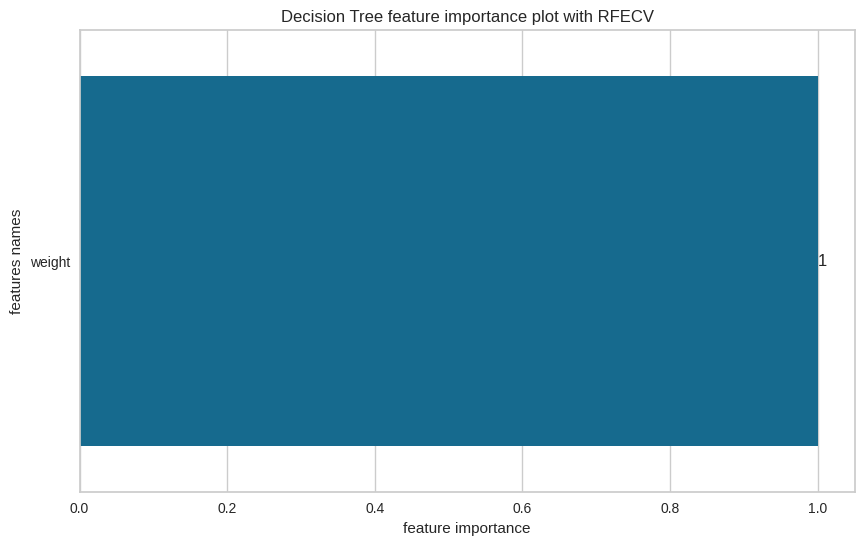

[Decision Tree] Best parameters are {'criterion': 'entropy', 'max_depth': 3, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Random Forest
[Random Forest] Features selected: Index(['weight'], dtype='object')
[Random Forest] Features importances: [1.0]


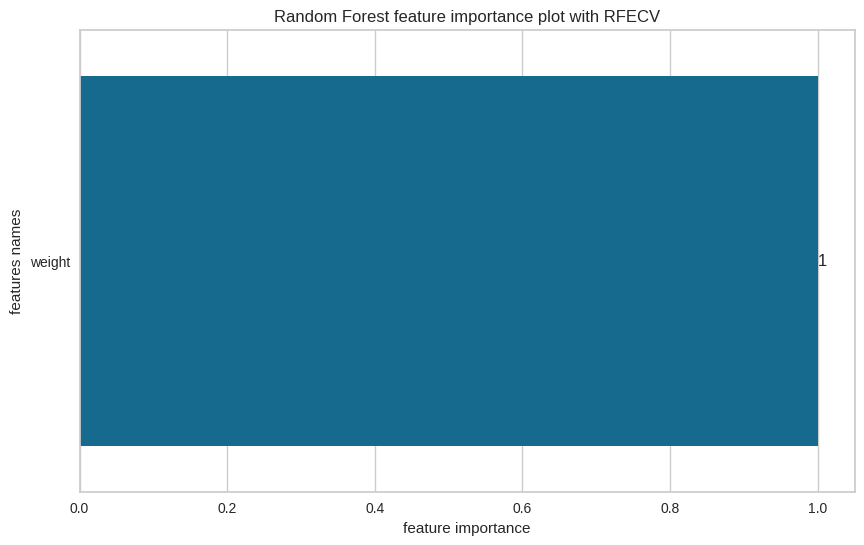

[Random Forest] Best parameters are {'criterion': 'gini', 'max_depth': 3, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- AdaBoost
[AdaBoost] Features selected: Index(['height', 'weight', 'body_fat'], dtype='object')
[AdaBoost] Features importances: [0.3499789251202417, 0.36722494342282874, 0.28279613145692967]


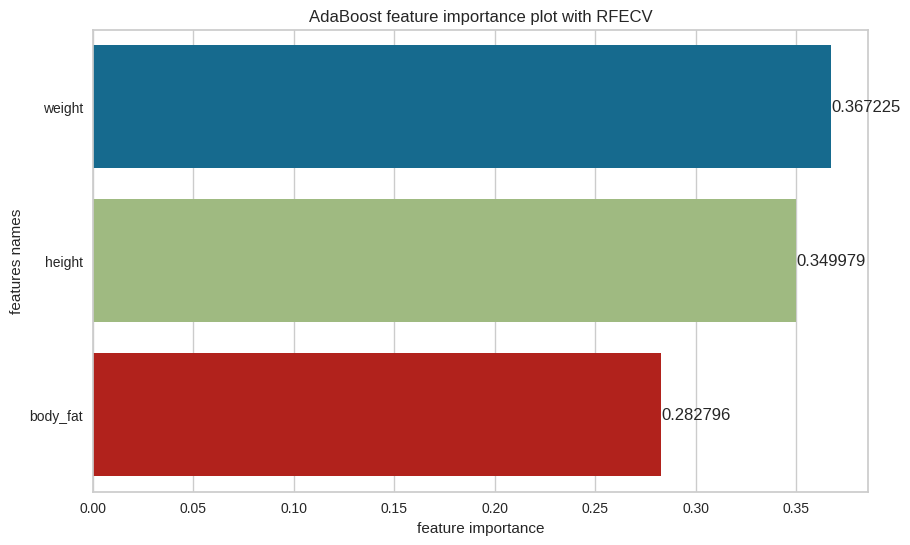

[AdaBoost] Best parameters are {'base_estimator': DecisionTreeClassifier(max_depth=2), 'learning_rate': 0.025, 'n_estimators': 60, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- GradientBoost
[GradientBoost] Features selected: Index(['height', 'weight', 'body_fat', 'gender_male', 'body_type_thin',
       'newsletter_subscription_True', 'activity_level_sedentary',
       'activity_level_very active'],
      dtype='object')
[GradientBoost] Features importances: [0.04143333219696268, 0.14925980627757918, 0.08644706863498358, 0.0, 1.82752678190423e-05, 0.0, 0.7228415176226556, 0.0]


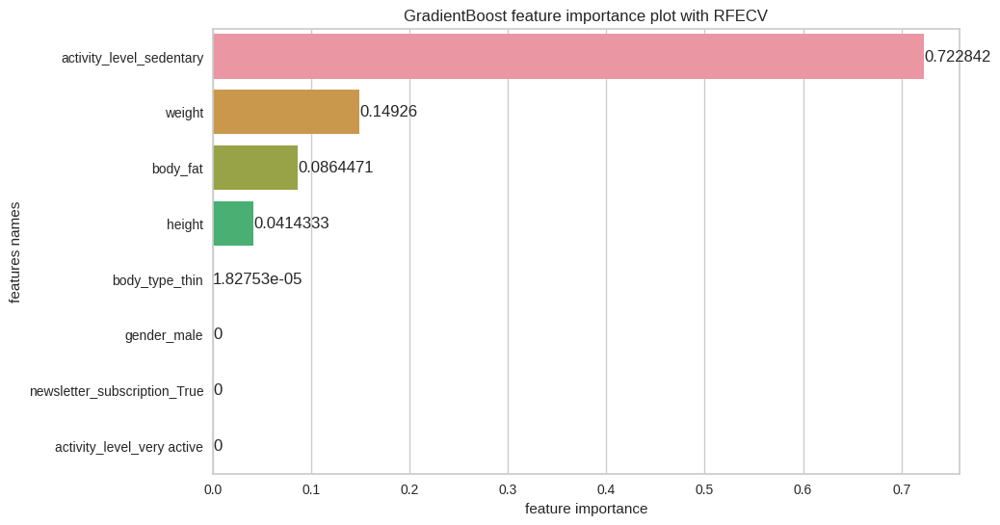

[GradientBoost] Best parameters are {'criterion': 'friedman_mse', 'learning_rate': 0.01, 'loss': 'deviance', 'max_depth': 3, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'n_estimators': 5, 'random_state': 42, 'subsample': 0.5}


In [262]:
estimators_multiclass_sel_8_4_rfecv, X_test_sel_8_4_rfecv, y_test_sel_8_4_rfecv, X_train_sel_8_4_rfecv, y_train_sel_8_4_rfecv, X_test_inv_sel_8_4_rfecv, features_sel_8_4_rfecv = train(X_demo_adh_8_4, y_demo_adh_8_4, 
                                                         grid_params_multiclass, 
                                                         seed, feature_selection = True, 
                                                         feature_sel_type = 'RFECV')

In [263]:
evaluation_table_sel_8_4_rfecv = evaluate_multiclass(estimators_multiclass_sel_8_4_rfecv, X_test_sel_8_4_rfecv, y_test_sel_8_4_rfecv, no_of_labels = 3, features_selected = True, feature_sel_type = 'RFECV', features = features_sel_8_4_rfecv)


In [264]:
evaluation_table_sel_8_4_rfecv

,Overall Accuracy,Balanced Accuracy,Adj Balanced Accuracy,Precision micro,Precision macro,Precision weighted,Recall micro,Recall macro,Recall weighted,Cohen's kappa,Mathews Correlation Coefficient
SGD,0.63,0.50,0.00,0.63,0.31,0.39,0.63,0.50,0.63,0.00,0.00
Logistic Regression,0.62,0.53,0.06,0.62,0.56,0.58,0.62,0.53,0.62,0.07,0.09
Decision Tree,0.63,0.50,0.00,0.63,0.31,0.39,0.63,0.50,0.63,0.00,0.00
Random Forest,0.63,0.50,0.00,0.63,0.31,0.39,0.63,0.50,0.63,0.00,0.00
AdaBoost,0.63,0.52,0.04,0.63,0.58,0.60,0.63,0.52,0.63,0.04,0.08
GradientBoost,0.63,0.50,0.00,0.63,0.31,0.39,0.63,0.50,0.63,0.00,0.00


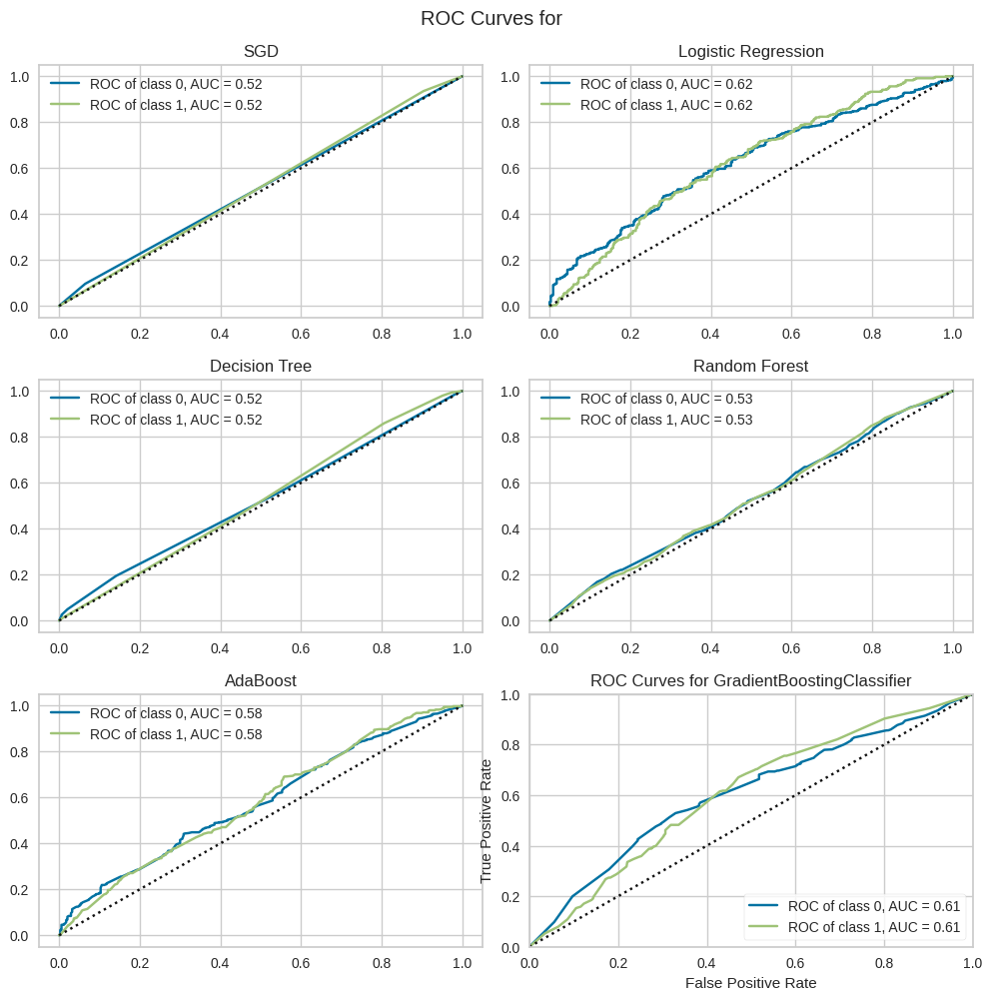

<AxesSubplot: title={'center': 'ROC Curves for GradientBoostingClassifier'}, xlabel='False Positive Rate', ylabel='True Positive Rate'>

In [265]:
ROC_curves(estimators_multiclass_sel_8_4_rfecv, X_train_sel_8_4_rfecv, y_train_sel_8_4_rfecv, X_test_sel_8_4_rfecv, y_test_sel_8_4_rfecv, np.unique(y_demo_adh_8_4), name = 'all', features_selected = True, feature_sel_type = 'RFECV', features = features_sel_8_4_rfecv)


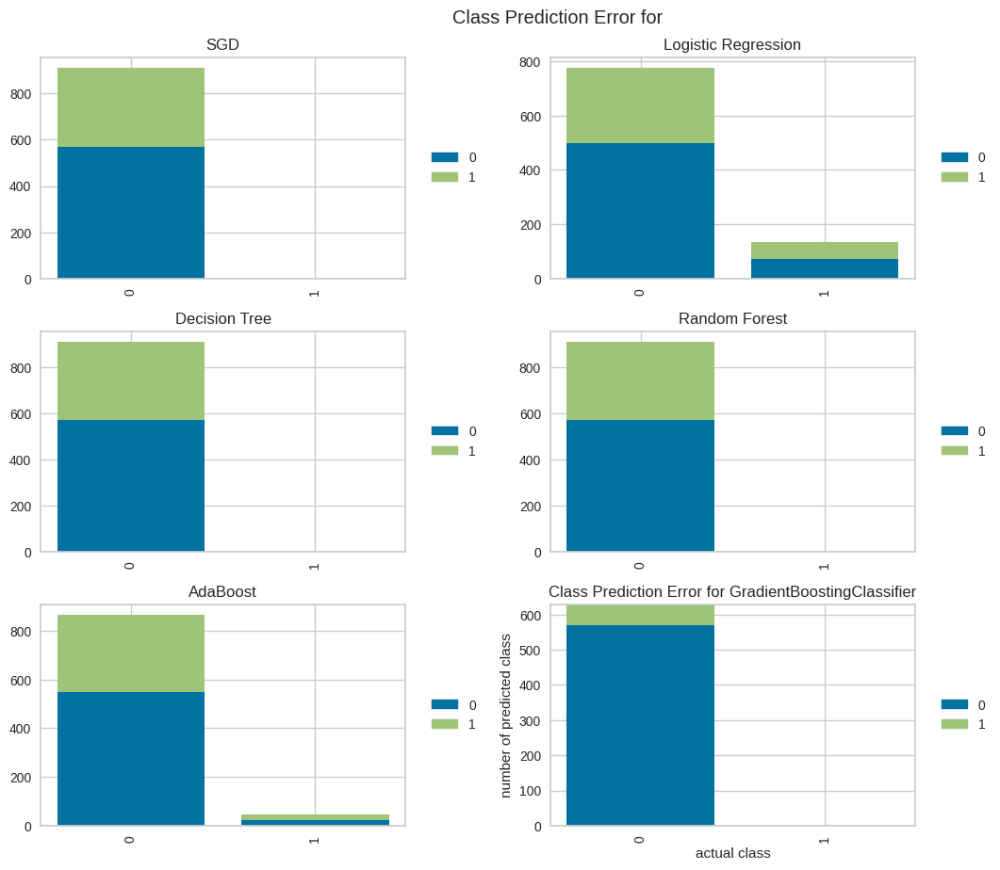

<AxesSubplot: title={'center': 'Class Prediction Error for GradientBoostingClassifier'}, xlabel='actual class', ylabel='number of predicted class'>

In [266]:
prediction_error_plot(estimators_multiclass_sel_8_4_rfecv, X_train_sel_8_4_rfecv, y_train_sel_8_4_rfecv, X_test_sel_8_4_rfecv, y_test_sel_8_4_rfecv, np.unique(y_demo_adh_8_4), name = 'all', features_selected = True, feature_sel_type = 'RFECV', features = features_sel_8_4_rfecv)


#### With feature selection (by SelectFromModel)

[INFO] Performing Grid-Search CV ---- SGD
[SGD] Features selected: Index(['weight', 'body_type_strong', 'body_type_thin',
       'newsletter_subscription_True', 'activity_level_sedentary'],
      dtype='object')
[SGD] Features importances: [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 9.84502131e-07]


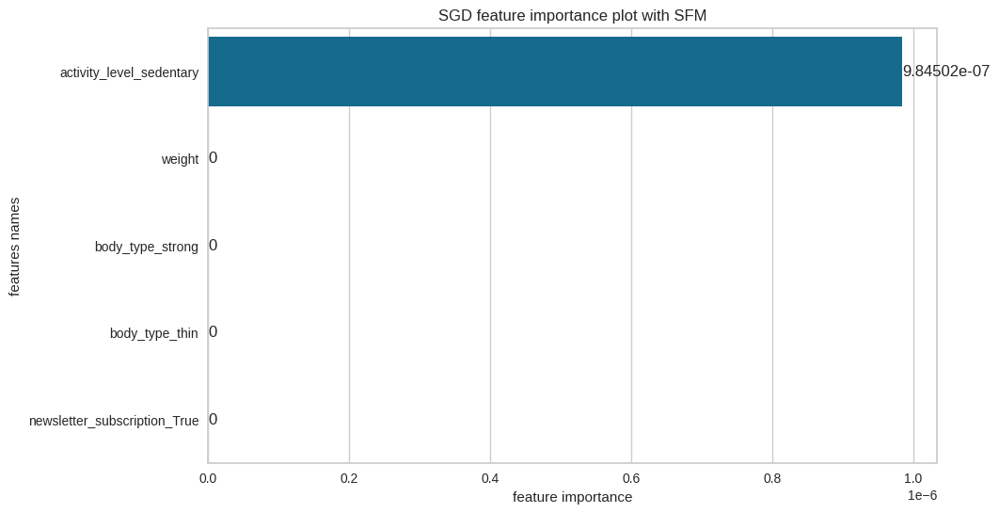

[SGD] Best parameters are {'alpha': 1e-05, 'eta0': 0.0001, 'learning_rate': 'adaptive', 'penalty': 'l1', 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Logistic Regression
[Logistic Regression] Features selected: Index(['height', 'weight', 'body_fat', 'gender_male',
       'activity_level_sedentary'],
      dtype='object')
[Logistic Regression] Features importances: [0.13941925 0.26880005 0.0938847  0.27549942 0.28850414]


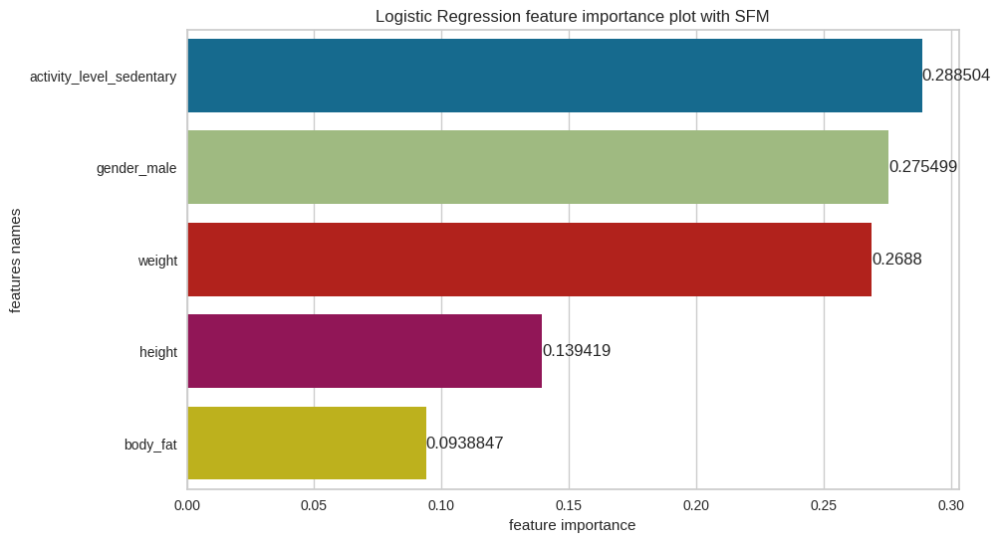

[Logistic Regression] Best parameters are {'C': 2, 'penalty': 'l1', 'random_state': 42, 'solver': 'liblinear'}
[INFO] Performing Grid-Search CV ---- Decision Tree
[Decision Tree] Features selected: Index(['height', 'weight', 'body_fat', 'body_type_thin',
       'newsletter_subscription_True'],
      dtype='object')
[Decision Tree] Features importances: [0.3556555314386208, 0.35941926301855337, 0.20358962736252323, 0.05582867336399661, 0.025506904816306034]


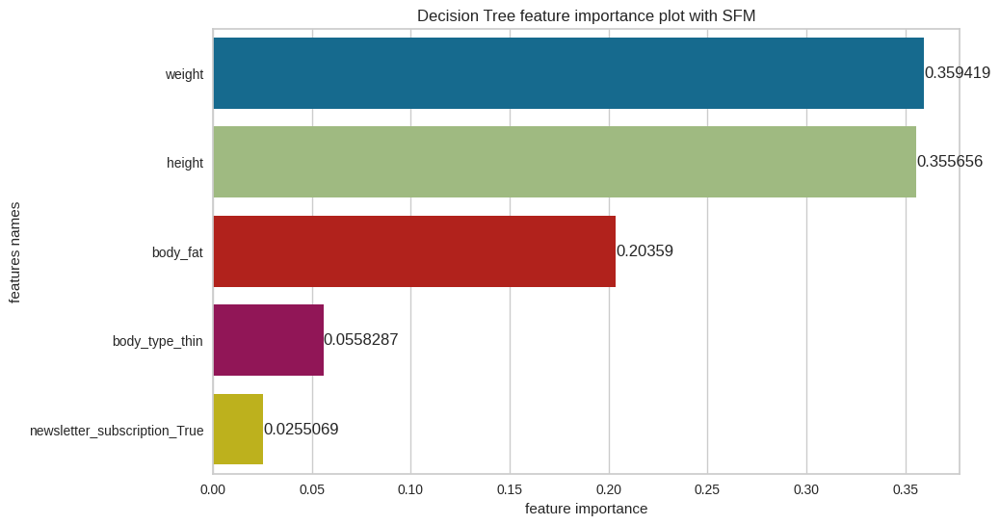

[Decision Tree] Best parameters are {'criterion': 'entropy', 'max_depth': 6, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Random Forest
[Random Forest] Features selected: Index(['height', 'weight', 'body_fat', 'body_type_thin',
       'newsletter_subscription_True'],
      dtype='object')
[Random Forest] Features importances: [0.25616563555820526, 0.3302820969940231, 0.358595932262788, 0.021404573375510227, 0.03355176180947338]


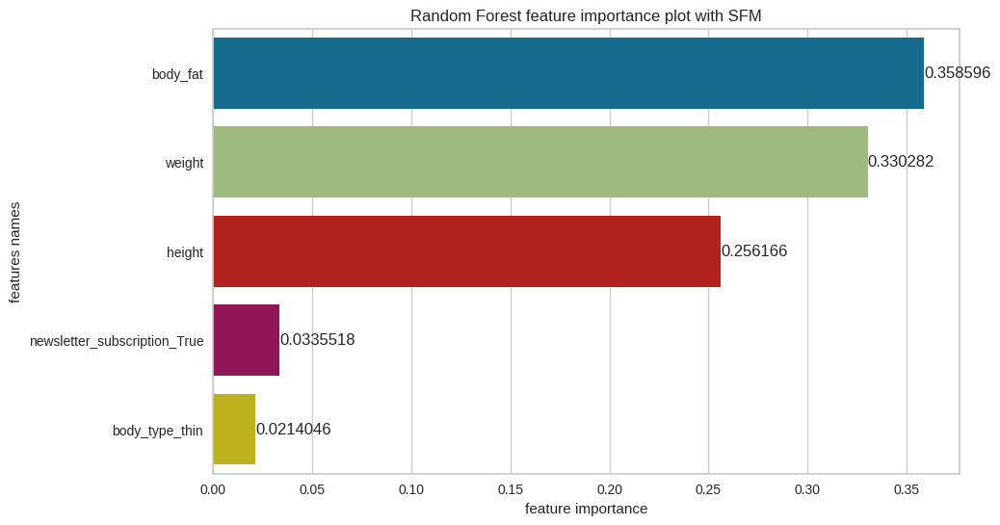

[Random Forest] Best parameters are {'criterion': 'gini', 'max_depth': 3, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- AdaBoost
[AdaBoost] Features selected: Index(['height', 'weight', 'body_fat', 'gender_male', 'body_type_thin',
       'newsletter_subscription_True', 'activity_level_sedentary'],
      dtype='object')
[AdaBoost] Features importances: [0.18670913107177828, 0.27201916182020236, 0.08269106412754433, 0.12222738538131277, 0.0, 0.0, 0.33635325759916224]


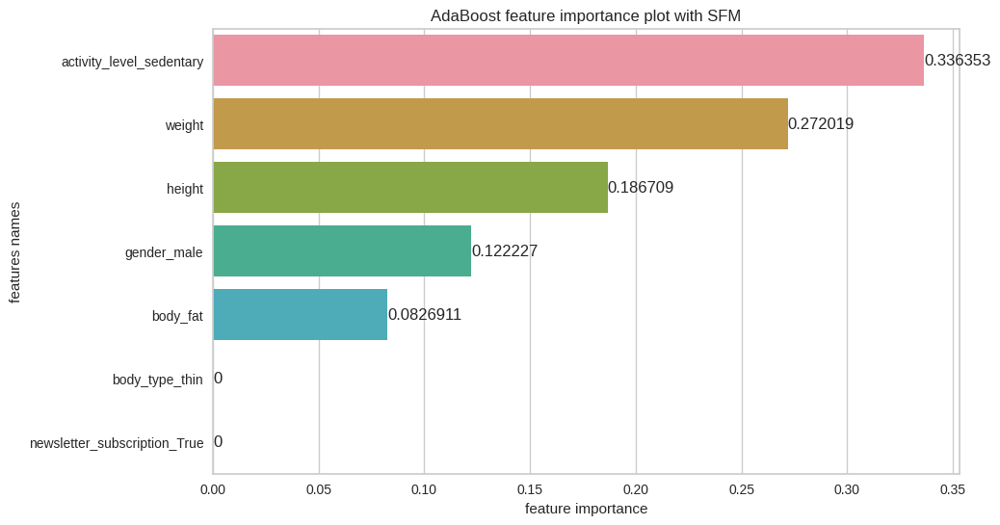

[AdaBoost] Best parameters are {'base_estimator': DecisionTreeClassifier(max_depth=2), 'learning_rate': 0.1, 'n_estimators': 20, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- GradientBoost
[GradientBoost] Features selected: Index(['height', 'weight', 'body_fat', 'gender_male',
       'activity_level_sedentary'],
      dtype='object')
[GradientBoost] Features importances: [0.11151814147451476, 0.14375739940108723, 0.40198367842663774, 0.10521008773471233, 0.23753069296304785]


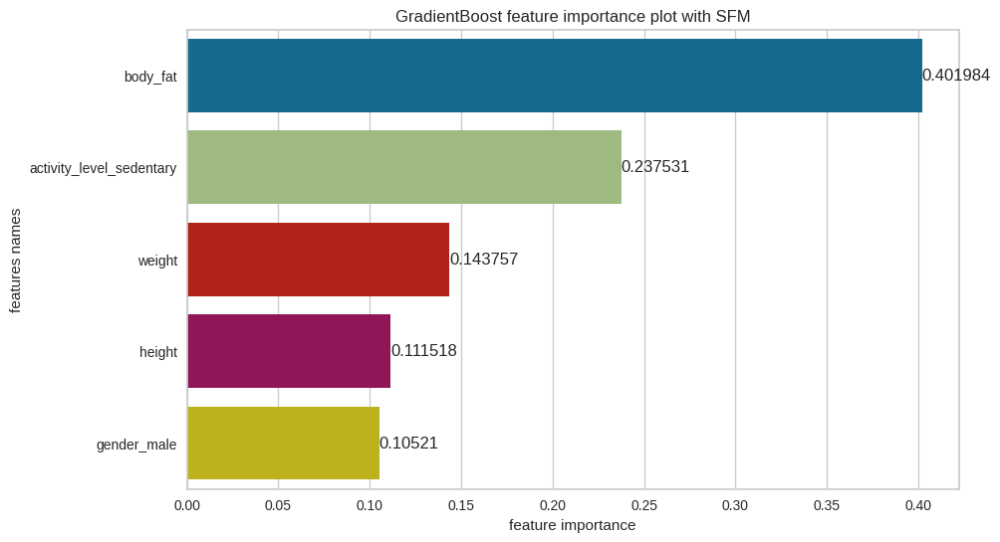

[GradientBoost] Best parameters are {'criterion': 'friedman_mse', 'learning_rate': 0.01, 'loss': 'deviance', 'max_depth': 3, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'n_estimators': 5, 'random_state': 42, 'subsample': 0.5}


In [267]:
estimators_multiclass_sel_8_4_sfm, X_test_sel_8_4_sfm, y_test_sel_8_4_sfm, X_train_sel_8_4_sfm, y_train_sel_8_4_sfm, X_test_inv_sel_8_4_sfm, features_sel_8_4_sfm = train(X_demo_adh_8_4, y_demo_adh_8_4, 
                                                         grid_params_multiclass, 
                                                         seed, feature_selection = True, 
                                                         feature_sel_type = 'SFM')

In [268]:
evaluation_table_sel_8_4_sfm = evaluate_multiclass(estimators_multiclass_sel_8_4_sfm, X_test_sel_8_4_sfm, y_test_sel_8_4_sfm, no_of_labels = 3, features_selected = True, feature_sel_type = 'SFM', features = features_sel_8_4_sfm)


In [269]:
evaluation_table_sel_8_4_sfm

,Overall Accuracy,Balanced Accuracy,Adj Balanced Accuracy,Precision micro,Precision macro,Precision weighted,Recall micro,Recall macro,Recall weighted,Cohen's kappa,Mathews Correlation Coefficient
SGD,0.63,0.50,0.00,0.63,0.31,0.39,0.63,0.50,0.63,0.00,0.00
Logistic Regression,0.62,0.53,0.06,0.62,0.56,0.58,0.62,0.53,0.62,0.07,0.09
Decision Tree,0.62,0.52,0.04,0.62,0.54,0.57,0.62,0.52,0.62,0.04,0.06
Random Forest,0.63,0.50,0.00,0.63,0.31,0.39,0.63,0.50,0.63,0.00,0.00
AdaBoost,0.63,0.52,0.04,0.63,0.58,0.60,0.63,0.52,0.63,0.04,0.08
GradientBoost,0.63,0.50,0.00,0.63,0.31,0.39,0.63,0.50,0.63,0.00,0.00


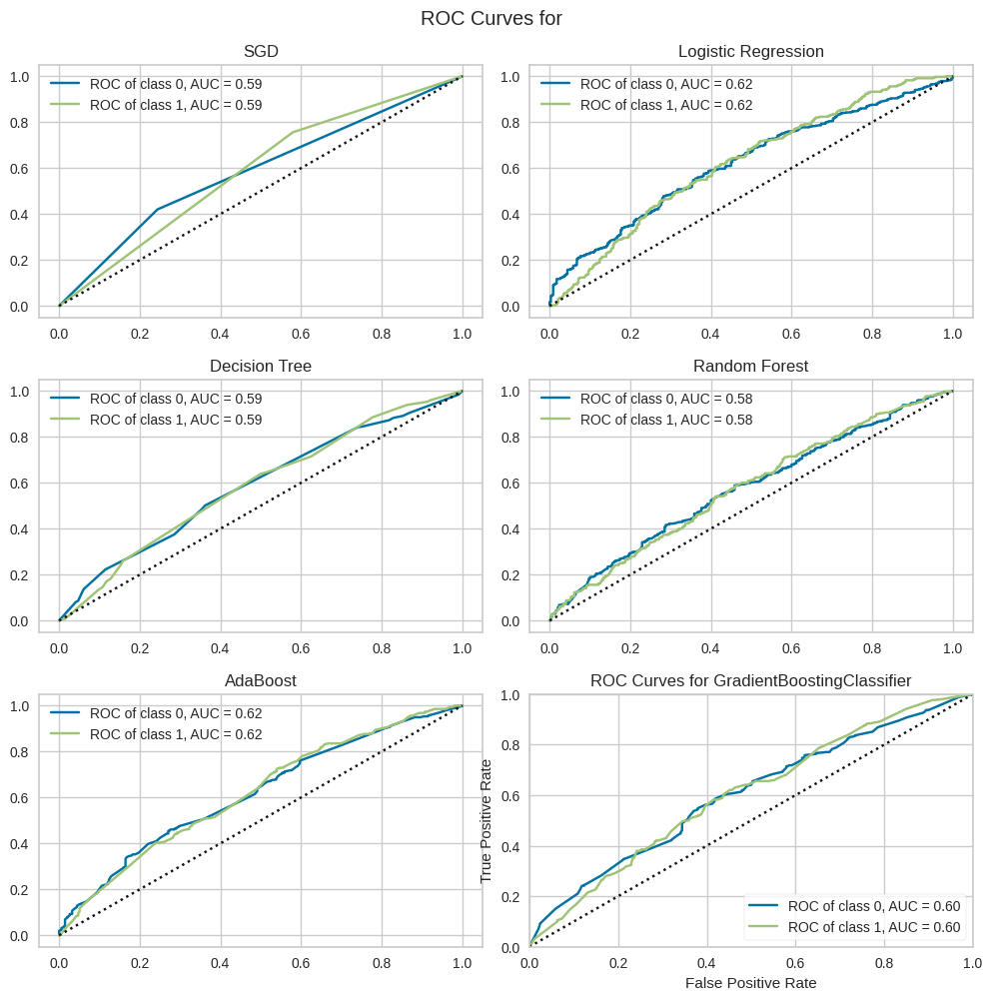

<AxesSubplot: title={'center': 'ROC Curves for GradientBoostingClassifier'}, xlabel='False Positive Rate', ylabel='True Positive Rate'>

In [270]:
ROC_curves(estimators_multiclass_sel_8_4_sfm, X_train_sel_8_4_sfm, y_train_sel_8_4_sfm, X_test_sel_8_4_sfm, y_test_sel_8_4_sfm, np.unique(y_demo_adh_8_4), name = 'all', features_selected = True, feature_sel_type = 'SFM', features = features_sel_8_4_sfm)


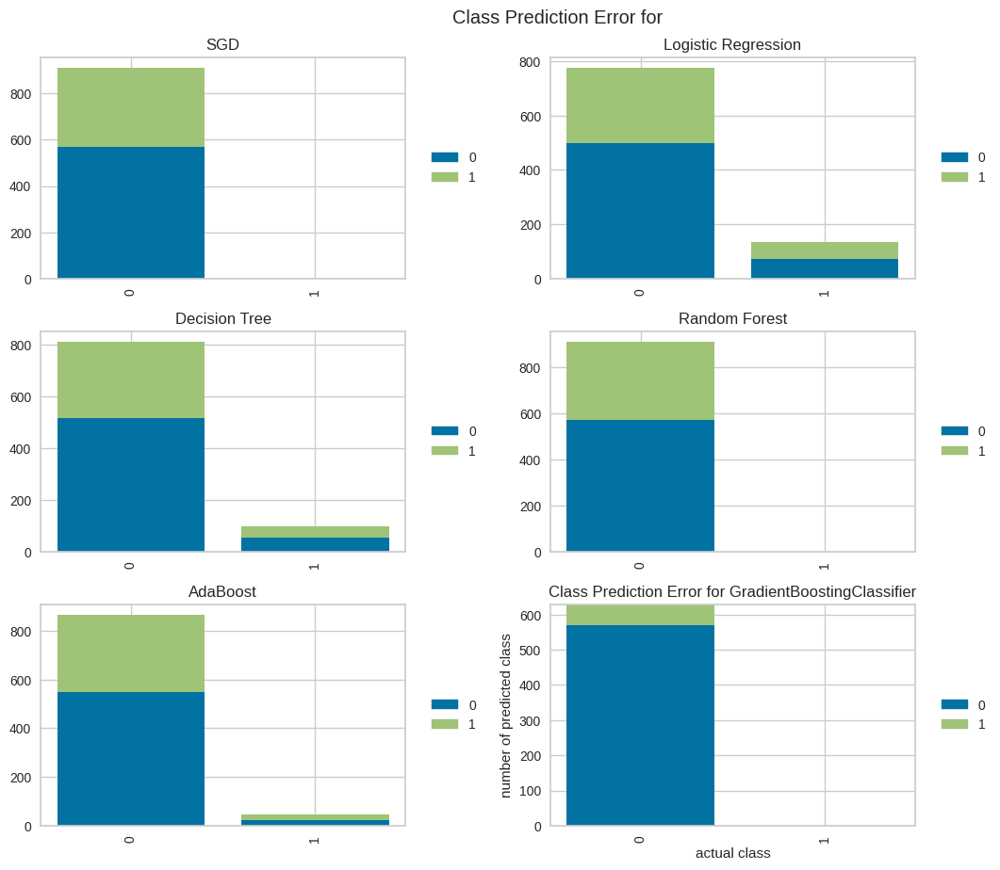

<AxesSubplot: title={'center': 'Class Prediction Error for GradientBoostingClassifier'}, xlabel='actual class', ylabel='number of predicted class'>

In [271]:
prediction_error_plot(estimators_multiclass_sel_8_4_sfm, X_train_sel_8_4_sfm, y_train_sel_8_4_sfm, X_test_sel_8_4_sfm, y_test_sel_8_4_sfm, np.unique(y_demo_adh_8_4), name = 'all', features_selected = True, feature_sel_type = 'SFM', features = features_sel_8_4_sfm)
